# Imports

In [5]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0"

%reload_ext autoreload
%autoreload 2
#%matplotlib notebook
%matplotlib inline

from typing import List, Tuple, Union, Sequence

import sys
import os

#https://github.com/FAU-DLM/wsi_processing_pipeline
sys.path.append("../")
sys.path.append("../wsi_processing_pipeline/")
sys.path.append("../wsi_processing_pipeline/tile_extraction")
sys.path.append("../wsi_processing_pipeline/shared")
import wsi_processing_pipeline
import tile_extraction
import preprocessing
import postprocessing
import shared
from wsi_processing_pipeline.shared import roi
from wsi_processing_pipeline.tile_extraction import tiles, util, slide, filter
from wsi_processing_pipeline.preprocessing import *
import wsi_processing_pipeline.preprocessing.files_getter
import wsi_processing_pipeline.preprocessing.name_getter
from wsi_processing_pipeline.preprocessing.name_getter import NameGetter
from wsi_processing_pipeline.preprocessing.tile_image_block import TileImage, label_tl_image, tile_image, TileTransform
from wsi_processing_pipeline.preprocessing.tile_image_block import show_batch, TileImageBlock
from shared.patient_manager import PatientManager
from shared.enums import DatasetType, EvaluationLevel

sys.path.append('../models-pytorch/pretrained-models.pytorch')
import pretrainedmodels
from pretrainedmodels import *

import PIL


import fastai
from fastai.vision.all import *
from typing import Dict
import pandas
import pandas as pd
import numpy
import numpy as np
import os
import torch
torch.backends.cudnn.benchmark=True
import torchvision
from torchvision.models import *
from torchsummary import summary
from functools import partial, update_wrapper
from tqdm import tqdm_notebook as tqdm
import matplotlib.image as mpimg
import shutil

# to fix python OSError: broken data stream when reading image file
# https://stackoverflow.com/questions/42462431/oserror-broken-data-stream-when-reading-image-file
from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

import sklearn
from sklearn.metrics import roc_curve, auc, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold, KFold
from tqdm.notebook import tqdm

import pathlib
from pathlib import Path
Path.ls = lambda x: [p for p in list(x.iterdir()) if '.ipynb_checkpoints' not in p.name]


from concurrent.futures import as_completed, ProcessPoolExecutor
from tqdm import tqdm
import json

#against DecompressionBombWarning
Image.MAX_IMAGE_PIXELS = 10000000000   

PATH = Path('/home/Deep_Learner/private/datasets/urothel_ca')
PATH_WSIS = PATH/'Neue_Scans_Urothelkarzinome'
#PATH_ROIS = PATH/'Rois_Christoph'
PATH_ROIS = PATH/'Rois_Samir'
PATH_ROIS_ADJUSTED = PATH/'Rois_Samir_adjusted'
PATH_EXCEL_SHEET = PATH/'Data_Sheet_MIER_22112021.xlsx'


seed = 42
np.random.seed(seed)

# Data

In [6]:
wsi_mrxs_paths = [p for p in PATH_WSIS.ls() if p.suffix == '.mrxs']
len(wsi_mrxs_paths)

239

In [7]:
wsi_dir_paths = [p for p in PATH_WSIS.ls() if p.suffix == '']
len(wsi_dir_paths)

239

In [8]:
json_paths = PATH_ROIS.ls()
len(json_paths)

233

## rename files and directories

### json paths

In [9]:
p = json_paths[0]; p

Path('/home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir/MIER_237_M4.json')

In [10]:
new_name = p.name.replace('%20', '_');new_name

'MIER_237_M4.json'

In [11]:
new_p = p.parent/new_name; new_p

Path('/home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir/MIER_237_M4.json')

In [12]:
p.replace(new_p)

In [13]:
for p in json_paths:
    new_name = p.name.replace('%20', '_')
    new_p = p.parent/new_name
    p.replace(new_p)

### mrxs files

In [11]:
for p in wsi_mrxs_paths:
    new_name = p.name.replace(' ', '_')
    new_p = p.parent/new_name
    p.replace(new_p)

### corresponding mrxs dirs

In [44]:
for p in wsi_dir_paths:
    new_name = p.name.replace(' ', '_')
    new_p = p.parent/new_name
    p.replace(new_p)

## get rois for each wsi path

### wsi path to json file mapping

In [10]:
def find_json_path(mrxs_path:pathlib.Path)->pathlib.Path:
    stem = mrxs_path.stem
    for jp in json_paths:
        if(jp.stem == stem):
            return jp
    return None

In [11]:
wsi_mrxs_to_json_path = {}
wsi_mrxs_paths_without_corresponding_json_file = []
for mrxs_p in wsi_mrxs_paths:
    jp = find_json_path(mrxs_path=mrxs_p)
    if(jp is not None):
        wsi_mrxs_to_json_path[mrxs_p] = jp
    else:
        wsi_mrxs_paths_without_corresponding_json_file.append(mrxs_p)

In [12]:
len(wsi_mrxs_to_json_path)

233

In [13]:
len(wsi_mrxs_paths_without_corresponding_json_file)

6

### custom function that creates PolygonHelper objects from a given json file with the roi coordinates

In [14]:
class __PolygonHelper:
    def __init__(self, level:int, vertices:Sequence[Tuple[float, float]]):
        self.level = level
        self.vertices = vertices

def get_polygons_from_json(json_path:pathlib.Path)->List[__PolygonHelper]:
    """
    Reads the json file and returns a list of __PolygonHelper objects. 
    This should be a specialized function for the specific structure of your json files.
    
    Arguments:
        json_path: path to json file
        
    Returns:
        List of __PolygonHelper objects
    """
    polygons = []
    with open(json_path) as json_file:
        for i, annotation in enumerate(json.load(json_file)):
            #some annotations do not have a "classification" prop
            # => just skip them
            try:
                annotation["properties"]["classification"]
            except KeyError as ke:
                print(ke)
                print(f'annotation num: {i}')
                continue
                
            #skip rois that are not classified as Tumor
            if(annotation["properties"]["classification"]["name"] == "Tumor"):
                if(annotation["geometry"]["type"] == 'MultiPolygon'):
                    multi_polygon_vertices = annotation["geometry"]["coordinates"]
                    #print(f'Multi Polygon: {np.array(multi_polygon_vertices).squeeze().shape}')
                    ##QuPath produces Polygons and Multipolygons 
                    ##(see difference here: https://gis.stackexchange.com/questions/225368/understanding-difference-between-polygon-and-
                    ##multipolygon-for-shapefiles-in-qgis/225373)
                    ##This loop separates Multipolygons into individual Polygons
                    for sub_polygon_vertices in multi_polygon_vertices:
                        sub_polygon_vertices_array = np.array(sub_polygon_vertices, dtype=object).squeeze()
                        if(len(sub_polygon_vertices_array.shape) == 2 and sub_polygon_vertices_array.shape[1] == 2):
                            #print(f'/1/: {sub_polygon_vertices_array.shape}')
                            polygons.append(__PolygonHelper(level=0, vertices=sub_polygon_vertices_array))
                        else:
                            for elem in sub_polygon_vertices_array:
                                elem_array = np.array(elem).squeeze()
                                #print(f'/2/: {elem_array.shape}')
                                polygons.append(__PolygonHelper(level=0, vertices=elem_array))
                    
                elif(annotation["geometry"]["type"] == 'Polygon'):
                    vertices = annotation["geometry"]["coordinates"]
                    #print(f'/3/ len of vertices: {len(vertices)}')
                    for ls in vertices:               
                        #print(f'/4/: {np.array(ls).squeeze().shape}')
                        polygons.append(__PolygonHelper(level=0, vertices=np.array(ls, dtype=object).squeeze()))
                else:
                    assert False
    return polygons

### adjust misalligned rois because of black and white padding when mrxs files are opened by openslide

In [15]:
def is_row_black(img:Union[PIL.Image.Image, numpy.ndarray], row_num:int)->bool:
    if(type(img) is PIL.Image.Image):
        img = util.pil_to_np_rgb(img)
    return np.all(img[row_num, :, :] == [0,0,0])

def is_column_black(img:Union[PIL.Image.Image, numpy.ndarray], column_num:int)->bool:
    if(type(img) is PIL.Image.Image):
        img = util.pil_to_np_rgb(img)
    return np.all(img[:, column_num, :] == [0,0,0])

def get_num_of_black_rows_at_top(img:Union[PIL.Image.Image, numpy.ndarray])->int:
    n_rows = 0
    while(is_row_black(img=img, row_num=n_rows)):
        n_rows += 1
    return n_rows

def get_num_of_black_columns_at_left(img:Union[PIL.Image.Image, numpy.ndarray])->int:
    n_columns = 0
    while(is_column_black(img=img, column_num=n_columns)):
        n_columns += 1
    return n_columns

class Row_or_col(Enum):
    ROW = 1
    COLUMN = 2
    
def is_only_black_white(img:Union[PIL.Image.Image, numpy.ndarray], index:int, row_or_col:Row_or_col)->bool:
    """
    checks if the by index specified row or column in the image contains only [0,0,0] == black
    or [255,255,255] == white RGB values
    """
    if(type(img) is PIL.Image.Image):
        img = util.pil_to_np_rgb(img)
    a = None
    if(row_or_col is Row_or_col.ROW):
        a = img[index, :, :]
    elif(row_or_col is Row_or_col.COLUMN):
        a = img[:, index, :]
    else:
        raise ValueError('row_or_col has insufficient value')
    return np.where(np.logical_and(np.ravel(a) > 0, np.ravel(a) < 255))[0].size == 0

def get_num_of_only_black_white(img:Union[PIL.Image.Image, numpy.ndarray], row_or_col:Row_or_col)->int:
    n = 0
    while(is_only_black_white(img=img, index=n, row_or_col=row_or_col)):
        n += 1
    return n

def adjust_rois(wsi_img:Union[PIL.Image.Image, numpy.ndarray], 
                wsi_img_level:int, 
                rois:List[roi.RegionOfInterestPolygon]):
    """
    returns new RegionOfInterestPolygon objects
    """
    cols_left = get_num_of_only_black_white(img=wsi_img, row_or_col=Row_or_col.COLUMN)
    rows_top = get_num_of_only_black_white(img=wsi_img, row_or_col=Row_or_col.ROW)
    rois_adjusted = []
    for r in rois:
        new_vertices = util.polygon_to_numpy(r.polygon)
        new_vertices += [util.adjust_level(value_to_adjust=cols_left, from_level=wsi_img_level, to_level=r.level), 
                         util.adjust_level(value_to_adjust=rows_top, from_level=wsi_img_level, to_level=r.level)]
        r_new = roi.RegionOfInterestPolygon(roi_id=r.roi_id, vertices=new_vertices, level=r.level)
        rois_adjusted.append(r_new)

    return rois_adjusted

def save_as_pickle(obj:object, path):
    with open(path, 'wb') as file:
        pickle.dump(obj, file)

def load_pickle(path):
    with open(path, 'rb') as file:
        return pickle.load(file)

def adjust_and_save_rois(wsi_path, json_path):
    print(f'wsi: {wsi_path.name}')
    print(f'json: {json_path.name}')
        
    save_name = f'{wsi_path.stem}-rois_adjusted.pickle'
    save_path = PATH_ROIS_ADJUSTED/save_name
    if(not save_path.exists()):    
        wh = tiles.WsiHandler(wsi_path=wsi_path)
        rois = roi.get_list_of_RegionOfInterestPolygon_from_json(json_path=json_path, 
                                        polygons_from_json_func=get_polygons_from_json)       
        rois_adjusted = adjust_rois(wsi_img=wh.get_wsi_as_pil_image(level=5), wsi_img_level=5, rois=rois)               
        save_as_pickle(rois_adjusted, save_path)
    else:
        print(f'Already exists: {save_path}')    

In [16]:
failed = []
for wsi_path, json_path in tqdm(list(wsi_mrxs_to_json_path.items())[:]):
    try:
        adjust_and_save_rois(wsi_path, json_path)
    except:
        failed.append(wsi_path)

100%|██████████| 233/233 [00:00<00:00, 1457.52it/s]

wsi: MIER_140_M17.mrxs
json: MIER_140_M17.json
Already exists: /home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir_adjusted/MIER_140_M17-rois_adjusted.pickle
wsi: MIER_151_M3.mrxs
json: MIER_151_M3.json
Already exists: /home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir_adjusted/MIER_151_M3-rois_adjusted.pickle
wsi: MIER_158_TUR2.mrxs
json: MIER_158_TUR2.json
Already exists: /home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir_adjusted/MIER_158_TUR2-rois_adjusted.pickle
wsi: MIER_175_M12.mrxs
json: MIER_175_M12.json
Already exists: /home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir_adjusted/MIER_175_M12-rois_adjusted.pickle
wsi: MIER_200_M9.mrxs
json: MIER_200_M9.json
Already exists: /home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir_adjusted/MIER_200_M9-rois_adjusted.pickle
wsi: MIER_211_C.mrxs
json: MIER_211_C.json
Already exists: /home/Deep_Learner/private/datasets/urothel_ca/Rois_Samir_adjusted/MIER_211_C-rois_adjusted.pickle
wsi: MIER_217_C.mrxs
json

In [17]:
#for wsi_path, json_path in tqdm(list(wsi_mrxs_to_json_path.items())[:20]):
#    save_name = f'{wsi_path.stem}-rois_adjusted.pickle'
#    save_path = PATH_ROIS_ADJUSTED/save_name
#    rois = load_pickle(save_path)
#    util.show_wsi_with_rois(wsi_path=wsi_path, rois=rois, figsize=(5,5), scale_factor=128)

In [18]:
#no stroma rois
wsi_path_to_rois = {}
for wsi_path, json_path in tqdm(list(wsi_mrxs_to_json_path.items())[:]):
    save_name = f'{wsi_path.stem}-rois_adjusted.pickle'
    save_path = PATH_ROIS_ADJUSTED/save_name
    rois = load_pickle(save_path)
    wsi_path_to_rois[wsi_path] = rois

100%|██████████| 233/233 [00:16<00:00, 14.16it/s]


## playground

In [23]:
data_sheet = pd.read_excel(PATH_EXCEL_SHEET, engine='openpyxl')

In [24]:
data_sheet

,TMA_Nr,Survival Time (months),OS_Censor,DSS_Censor,Recurrence Free Survival (months),RFS_Censor,1°/2°-MIBC,Initial pT-Stage,pT-Stage Summary,pN-Stage,...,Adjuvant chemotherapy,Histology,Variant Histology,%_Variant Histology,Variant Summary,FGFR3_Mutation,FGFR3_Fusion,FGFR3_Summary,Meta_Immune Phenotypes,Consensus Cluster
0,1,88.07,0,0,79.53,0,Primary,pT2,pT4,pN0,...,No,Urothelial,NOS,NaN,Urothelial - NOS,WT,WT,WT,Uninflamed,NaN
1,2,5.00,0,1,5.00,1,Primary,pT2,pT2,pN0,...,No,Urothelial,Lymphoepithelioma-like,NaN,Urothelial - Variant Histology,WT,WT,WT,Evasion Phenotype,Ba/Sq
2,3,129.47,0,1,129.47,1,Primary,pT2,pT3,pN0,...,No,Urothelial,Squamous,0.6,Urothelial - Squamous,WT,WT,WT,Inflamed: High,LumU
3,4,6.63,0,0,6.63,0,Primary,pT2,pT3,pN2,...,No,Neuroendocrine,Neuroendocrine,NaN,Neuroendocrine,WT,WT,WT,Uninflamed,NE-like
4,5,27.77,0,0,16.37,0,Secondary,"pT1/ pTa, CIS",pT3,pNX,...,Yes,Urothelial,Squamous,0.4,Urothelial - Squamous,WT,WT,WT,Uninflamed,Ba/Sq
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
242,243,14.47,1,1,7.47,0,Primary,pT2,pT2,pN2,...,Yes,Urothelial,NOS,NaN,Urothelial - NOS,G372C,WT,Altered,Inflamed: Low,LumP
243,244,14.70,1,1,12.40,0,Primary,pT2,pT2,pN0,...,No,Urothelial,Neuroendocrine,0.9,Urothelial - Variant Histology,WT,WT,WT,Inflamed: Low,NE-like
244,245,4.73,1,1,4.73,1,Primary,pT2,pT2,pNX,...,No,Urothelial,NOS,NaN,Urothelial - NOS,WT,WT,WT,Inflamed: Low,LumNS
245,246,4.50,0,0,3.27,0,Primary,pT2,pT3,pN0,...,No,Urothelial,Squamous,0.3,Urothelial - Squamous,WT,WT,WT,Uninflamed,Ba/Sq


In [28]:
s.split('_')

['MIER', '140', 'M17']

In [41]:
stems = []
tma_nrs = []
for wsi_path in list(wsi_path_to_rois.keys()):
    stem = wsi_path.stem
    stems.append(stem)
    split = stem.split('_')
    tma_nr = split[1]
    tma_nrs.append(tma_nr)

In [88]:
tma_nr = 247

In [61]:
data_sheet.iloc[0]['Histology']

'Urothelial'

In [63]:
data_sheet.iloc[0]['Variant Histology']

'NOS'

In [76]:
data_sheet.max()['TMA_Nr']

247

In [78]:
len(data_sheet.index)

247

In [91]:
histos = []
v_histos = []

for i in range(len(data_sheet.index)):
    row = data_sheet.iloc[i]
    histology = row['Histology']
    variant_histology = row['Variant Histology']
    
    histos.append(histology)
    v_histos.append(variant_histology)

In [85]:
set(histos)

{'Neuroendocrine', 'Urothelial'}

In [87]:
set(v_histos)

{'Glandular',
 'Glycogen rich',
 'LNUC',
 'Lymphoepithelioma-like',
 'MPUC',
 'NOS',
 'NUC',
 'Neuroendocrine',
 'PUC',
 'Sarcomatoid',
 'Squamous',
 'Trophoblastoid'}

## id and label funcs

In [19]:
data_sheet = pd.read_excel(PATH_EXCEL_SHEET, engine='openpyxl')

# one case per patient => patient id == case id
def get_patient_id_from_wsi_path(wsi_path:pathlib.Path)->str:
    return get_case_id_from_wsi_path(wsi_path=wsi_path)
    
def get_case_id_from_wsi_path(wsi_path:pathlib.Path)->str:
    split = wsi_path.stem.split('_')
    return f'{split[0]}_{split[1]}'    

def get_slide_id_from_wsi_path(wsi_path:pathlib.Path)->str:
    return wsi_path.stem

def get_labels_from_wsi_path(wsi_path:pathlib.Path, roi=None)->List[int]:
    tma_nr = wsi_path.stem.split('_')[1]
    row = data_sheet.iloc[int(tma_nr)-1]
    histology = row['Histology']
    variant_histology = row['Variant Histology']
    return [histology, variant_histology]

## tiles

In [20]:
tilesummaries_save_path = Path(f'./tilesummaries/001/')
tilesummaries = []

tilesummaries_saved_names = [p.stem for p in tilesummaries_save_path.ls()]

for wsi_path in tqdm(list(wsi_path_to_rois.keys())):
#for wsi_path in tqdm(list(failed_wsi_paths.keys())[:]):
    if(f'{wsi_path.stem}_tilesummary' in tilesummaries_saved_names):
        print(f'{wsi_path.stem} is loaded ...')
        tilesummaries.append(load_pickle(tilesummaries_save_path/f'{wsi_path.stem}_tilesummary.pickle'))
        pass
    else:
        print(f'{wsi_path.stem} tiles are calculated ...')    
        t = tiles.WsisToTilesParallel(wsi_paths=[wsi_path],
                                          tile_height=1024, 
                                          tile_width=1024, 
                                          tile_scoring_function=tiles.score_tile_1,
                                          tile_score_thresh=0.2, 
                                          level=0, 
                                          wsi_path_to_rois=wsi_path_to_rois,
                                          minimal_tile_roi_intersection_ratio=0.95, 
                                          verbose=True, 
                                          grids_per_roi=1, 
                                          optimize_grid_angles=False)[0]
        tilesummaries.append(t)
        p = tilesummaries_save_path/f'{t.wsi_path.stem}_tilesummary.pickle'
        save_as_pickle(t, p)

  0%|          | 0/233 [00:00<?, ?it/s]

MIER_140_M17 is loaded ...
MIER_151_M3 is loaded ...


  1%|          | 2/233 [00:00<00:24,  9.36it/s]

MIER_158_TUR2 is loaded ...


  3%|▎         | 6/233 [00:00<00:26,  8.63it/s]

MIER_175_M12 is loaded ...
MIER_200_M9 is loaded ...
MIER_211_C is loaded ...
MIER_217_C is loaded ...
MIER_236_C is loaded ...


  3%|▎         | 8/233 [00:00<00:21, 10.26it/s]

MIER_40_D is loaded ...
MIER_52_B is loaded ...


  4%|▍         | 10/233 [00:00<00:24,  9.09it/s]

MIER_74_M10 is loaded ...
MIER_184_I is loaded ...


  5%|▌         | 12/233 [00:01<00:26,  8.23it/s]

MIER_46_A is loaded ...
MIER_134_TUR1 is loaded ...


  6%|▋         | 15/233 [00:01<00:30,  7.16it/s]

MIER_130_C is loaded ...
MIER_233_TUR1 is loaded ...


  7%|▋         | 17/233 [00:01<00:26,  8.27it/s]

MIER_127_G is loaded ...
MIER_41_A is loaded ...


  8%|▊         | 18/233 [00:01<00:26,  7.97it/s]

MIER_115_C is loaded ...
MIER_147_A is loaded ...
MIER_17_C is loaded ...


 10%|▉         | 23/233 [00:02<00:23,  8.89it/s]

MIER_183_A is loaded ...
MIER_222_M13 is loaded ...
MIER_50_A is loaded ...


 10%|█         | 24/233 [00:02<00:24,  8.36it/s]

MIER_79_D is loaded ...
MIER_167_L is loaded ...


 12%|█▏        | 27/233 [00:03<00:29,  6.99it/s]

MIER_187_M13 is loaded ...
MIER_145_B is loaded ...


 12%|█▏        | 29/233 [00:03<00:24,  8.41it/s]

MIER_71_H is loaded ...
MIER_6_C is loaded ...


 13%|█▎        | 31/233 [00:03<00:31,  6.42it/s]

MIER_229_TUR2 is loaded ...
MIER_154_M21 is loaded ...


 14%|█▍        | 33/233 [00:04<00:39,  5.12it/s]

MIER_8_B is loaded ...
MIER_36_A is loaded ...
MIER_22_E is loaded ...


 16%|█▌        | 37/233 [00:04<00:27,  7.02it/s]

MIER_221_C is loaded ...
MIER_70_B is loaded ...
MIER_35_F is loaded ...


 18%|█▊        | 41/233 [00:04<00:21,  9.06it/s]

MIER_142_M13 is loaded ...
MIER_29_C is loaded ...
MIER_164_C is loaded ...
MIER_225_G is loaded ...
MIER_131_B is loaded ...


 19%|█▉        | 44/233 [00:05<00:18, 10.23it/s]

MIER_91_C is loaded ...
MIER_13_C is loaded ...


 21%|██        | 48/233 [00:05<00:17, 10.40it/s]

MIER_14_A is loaded ...
MIER_201_B is loaded ...
MIER_110_TUR3 is loaded ...
MIER_117_E is loaded ...
MIER_202_G is loaded ...


 23%|██▎       | 53/233 [00:06<00:20,  8.92it/s]

MIER_182_TUR4 is loaded ...
MIER_161_B is loaded ...
MIER_107_M22 is loaded ...
MIER_51_C is loaded ...


 24%|██▎       | 55/233 [00:06<00:20,  8.81it/s]

MIER_82_TUR1 is loaded ...
MIER_95_B is loaded ...
MIER_237_M4 is loaded ...


 25%|██▌       | 59/233 [00:06<00:15, 11.37it/s]

MIER_23_G is loaded ...
MIER_199_M10 is loaded ...
MIER_15_B is loaded ...
MIER_16_B is loaded ...


 27%|██▋       | 63/233 [00:07<00:16, 10.45it/s]

MIER_26_B is loaded ...
MIER_75_B is loaded ...
MIER_85_M12 is loaded ...


 28%|██▊       | 65/233 [00:07<00:14, 11.94it/s]

MIER_156_M15 is loaded ...
MIER_189_TUR is loaded ...
MIER_170_TUR1 is loaded ...
MIER_196_D is loaded ...


 29%|██▉       | 68/233 [00:07<00:13, 12.62it/s]

MIER_190_D is loaded ...
MIER_144_TUR is loaded ...
MIER_206_M11 is loaded ...


 31%|███▏      | 73/233 [00:08<00:16,  9.42it/s]

MIER_128_C is loaded ...
MIER_195_A is loaded ...
MIER_223_TUR is loaded ...


 32%|███▏      | 75/233 [00:08<00:14, 10.64it/s]

MIER_11_A is loaded ...
MIER_125_B is loaded ...
MIER_109_A is loaded ...


 33%|███▎      | 77/233 [00:08<00:14, 10.71it/s]

MIER_112_TUR1 is loaded ...
MIER_108_J is loaded ...


 35%|███▍      | 81/233 [00:08<00:14, 10.84it/s]

MIER_169_TUR is loaded ...
MIER_101_TUR3 is loaded ...
MIER_235_C is loaded ...
MIER_241_M5 is loaded ...


 36%|███▌      | 84/233 [00:08<00:11, 12.70it/s]

MIER_39_D is loaded ...
MIER_100_B is loaded ...


 38%|███▊      | 88/233 [00:09<00:17,  8.16it/s]

MIER_136_A is loaded ...
MIER_218_A is loaded ...
MIER_244_A is loaded ...
MIER_193_TUR2 is loaded ...


 39%|███▊      | 90/233 [00:09<00:17,  8.38it/s]

MIER_162_TUR2 is loaded ...
MIER_7_E is loaded ...
MIER_4_A is loaded ...


 40%|████      | 94/233 [00:10<00:13, 10.23it/s]

MIER_73_B is loaded ...
MIER_28_E is loaded ...
MIER_3_D is loaded ...
MIER_168_M3 is loaded ...


 42%|████▏     | 98/233 [00:10<00:13,  9.69it/s]

MIER_133_B is loaded ...
MIER_163_M4 is loaded ...
MIER_62_A is loaded ...
MIER_242_TUR2 is loaded ...


 44%|████▍     | 102/233 [00:10<00:11, 11.79it/s]

MIER_63_M17 is loaded ...
MIER_57_M21 is loaded ...
MIER_58_C is loaded ...


 45%|████▌     | 106/233 [00:11<00:09, 13.84it/s]

MIER_231_M11 is loaded ...
MIER_150_M16 is loaded ...
MIER_213_C is loaded ...
MIER_116_A is loaded ...


 46%|████▋     | 108/233 [00:11<00:09, 13.56it/s]

MIER_234_TUR8 is loaded ...
MIER_137_D is loaded ...
MIER_111_TUR5 is loaded ...


 47%|████▋     | 110/233 [00:11<00:08, 13.68it/s]

MIER_56_M16 is loaded ...
MIER_68_TUR2 is loaded ...


 48%|████▊     | 112/233 [00:11<00:10, 11.15it/s]

MIER_103_B is loaded ...


 49%|████▉     | 114/233 [00:12<00:21,  5.51it/s]

MIER_105_F is loaded ...
MIER_113_M16 is loaded ...
MIER_185_TUR1 is loaded ...
MIER_186_M10 is loaded ...


 51%|█████     | 119/233 [00:12<00:15,  7.60it/s]

MIER_2_B is loaded ...
MIER_207_E is loaded ...
MIER_226_A is loaded ...
MIER_228_A is loaded ...


 52%|█████▏    | 121/233 [00:13<00:12,  8.78it/s]

MIER_239_M1 is loaded ...
MIER_59_B is loaded ...


 54%|█████▎    | 125/233 [00:13<00:11,  9.41it/s]

MIER_83_M13 is loaded ...
MIER_92_TUR2 is loaded ...
MIER_55_M11 is loaded ...
MIER_66_TUR1 is loaded ...


 55%|█████▌    | 129/233 [00:13<00:09, 10.57it/s]

MIER_138_TUR is loaded ...
MIER_34_B is loaded ...
MIER_37_A is loaded ...


 57%|█████▋    | 132/233 [00:14<00:08, 12.19it/s]

MIER_42_C is loaded ...
MIER_87_M15 is loaded ...
MIER_165_B is loaded ...
MIER_20_A is loaded ...


 58%|█████▊    | 136/233 [00:14<00:08, 11.51it/s]

MIER_238_TUR2 is loaded ...
MIER_209_M16 is loaded ...
MIER_114_M21 is loaded ...
MIER_33_C is loaded ...


 60%|█████▉    | 139/233 [00:14<00:06, 13.95it/s]

MIER_198_A is loaded ...
MIER_179_M13 is loaded ...
MIER_97_TUR1 is loaded ...


 61%|██████    | 141/233 [00:14<00:07, 12.85it/s]

MIER_157_M2 is loaded ...


 61%|██████▏   | 143/233 [00:15<00:17,  5.02it/s]

MIER_141_F is loaded ...
MIER_177_TUR2 is loaded ...
MIER_18_A is loaded ...


 64%|██████▎   | 148/233 [00:16<00:13,  6.26it/s]

MIER_227_E is loaded ...
MIER_159_TUR4 is loaded ...
MIER_152_TUR2 is loaded ...
MIER_27_A is loaded ...
MIER_30_A is loaded ...


 64%|██████▍   | 150/233 [00:16<00:11,  7.46it/s]

MIER_230_M12 is loaded ...
MIER_60_G is loaded ...


 65%|██████▌   | 152/233 [00:16<00:10,  7.36it/s]

MIER_9_B is loaded ...


 67%|██████▋   | 156/233 [00:17<00:10,  7.67it/s]

MIER_99_TUR1 is loaded ...
MIER_129_C is loaded ...
MIER_172_F is loaded ...
MIER_173_B is loaded ...


 68%|██████▊   | 159/233 [00:17<00:07,  9.44it/s]

MIER_176_TUR is loaded ...
MIER_180_F is loaded ...
MIER_215_M18 is loaded ...


 69%|██████▉   | 161/233 [00:17<00:07,  9.85it/s]

MIER_219_A is loaded ...
MIER_246_C is loaded ...
MIER_38_G is loaded ...


 71%|███████   | 165/233 [00:17<00:06, 10.44it/s]

MIER_61_A is loaded ...
MIER_240_M16 is loaded ...
MIER_126_E is loaded ...


 72%|███████▏  | 167/233 [00:18<00:05, 11.41it/s]

MIER_174_D is loaded ...
MIER_203_M13 is loaded ...
MIER_10_A is loaded ...


 74%|███████▍  | 172/233 [00:18<00:06,  8.87it/s]

MIER_232_M10 is loaded ...
MIER_72_A is loaded ...
MIER_76_B is loaded ...
MIER_77_A is loaded ...


 76%|███████▌  | 176/233 [00:19<00:05, 10.66it/s]

MIER_102_D is loaded ...
MIER_32_A is loaded ...
MIER_84_TUR2 is loaded ...
MIER_245_TUR1 is loaded ...


 76%|███████▋  | 178/233 [00:19<00:04, 12.01it/s]

MIER_123_LK1 is loaded ...
MIER_192_D is loaded ...
MIER_67_M20 is loaded ...


 77%|███████▋  | 180/233 [00:19<00:04, 11.57it/s]

MIER_160_D is loaded ...
MIER_214_A is loaded ...
MIER_139_TUR is loaded ...
MIER_188_M14 is loaded ...


 79%|███████▉  | 184/233 [00:20<00:07,  6.90it/s]

MIER_149_C is loaded ...
MIER_45_D is loaded ...


 81%|████████  | 188/233 [00:20<00:05,  8.48it/s]

MIER_143_TUR1 is loaded ...
MIER_224_TUR3 is loaded ...
MIER_69_TUR6 is loaded ...


 82%|████████▏ | 190/233 [00:21<00:04,  8.98it/s]

MIER_88_M6 is loaded ...
MIER_90_A is loaded ...
MIER_12_A is loaded ...


 83%|████████▎ | 194/233 [00:21<00:03, 11.35it/s]

MIER_124_TUR4 is loaded ...
MIER_171_M18 is loaded ...
MIER_19_B is loaded ...
MIER_208_TUR4 is loaded ...


 85%|████████▍ | 198/233 [00:21<00:03, 11.59it/s]

MIER_21_A is loaded ...
MIER_243_TUR5 is loaded ...
MIER_43_B is loaded ...


 86%|████████▌ | 200/233 [00:21<00:02, 13.00it/s]

MIER_44_B is loaded ...
MIER_48_A is loaded ...
MIER_96_M7 is loaded ...


 87%|████████▋ | 202/233 [00:21<00:02, 12.42it/s]

MIER_98_TUR2 is loaded ...
MIER_93_M9 is loaded ...


 88%|████████▊ | 206/233 [00:22<00:02, 12.19it/s]

MIER_155_A is loaded ...
MIER_191_M2 is loaded ...
MIER_216_TUR3 is loaded ...
MIER_220_D is loaded ...


 89%|████████▉ | 208/233 [00:22<00:01, 13.52it/s]

MIER_49_A is loaded ...
MIER_5_A is loaded ...


 90%|█████████ | 210/233 [00:22<00:02, 10.49it/s]

MIER_197_TUR1 is loaded ...
MIER_65_A is loaded ...


 92%|█████████▏| 214/233 [00:23<00:01, 10.38it/s]

MIER_81_TUR1 is loaded ...
MIER_212_M10 is loaded ...
MIER_146_B is loaded ...


 93%|█████████▎| 216/233 [00:23<00:01, 10.49it/s]

MIER_181_M10 is loaded ...
MIER_24_B is loaded ...
MIER_247_M11 is loaded ...


 94%|█████████▍| 220/233 [00:23<00:01, 11.29it/s]

MIER_104_E is loaded ...
MIER_25_B is loaded ...
MIER_64_M4 is loaded ...
MIER_210_B is loaded ...


 96%|█████████▌| 223/233 [00:23<00:00, 11.45it/s]

MIER_47_C is loaded ...
MIER_204_A is loaded ...


 97%|█████████▋| 226/233 [00:24<00:00, 13.47it/s]

MIER_178_TUR1 is loaded ...
MIER_121_D is loaded ...
MIER_53_G is loaded ...


 98%|█████████▊| 228/233 [00:25<00:01,  4.16it/s]

MIER_80_TUR3 is loaded ...
MIER_148_A is loaded ...
MIER_166_M21 is loaded ...
MIER_89_TUR3 is loaded ...


100%|██████████| 233/233 [00:25<00:00,  9.09it/s]

MIER_78_M17 is loaded ...
MIER_94_G is loaded ...


In [21]:
len(tilesummaries)

233

In [22]:
#tilesummaries = []
#failed_wsi_paths = {}

In [23]:
#for wsi_path in tqdm(list(wsi_path_to_rois.keys())):
##for wsi_path in tqdm(list(failed_wsi_paths.keys())[:]):
#    rois = wsi_path_to_rois[wsi_path]
#    try:
#        ts = tiles.WsiToTiles(wsi_path=wsi_path,
#                              tile_height=1024, 
#                                              tile_width=1024, 
#                                              tile_scoring_function=tiles.score_tile_1,
#                                              tile_score_thresh=0.2, 
#                                              level=0, 
#                                              rois=rois,
#                                              minimal_tile_roi_intersection_ratio=0.95, 
#                                              verbose=True, 
#                                              grids_per_roi=1)
#        tilesummaries.append(ts)
#        try:
#            del failed_wsi_paths[wsi_path]
#        except:
#            pass
#    except Exception as e:
#        failed_wsi_paths[wsi_path] = e

## patient manager

In [24]:
patient_manager = PatientManager()

patient_manager.create_from_tilesummaries(tilesummaries=tilesummaries, 
                                          patient_id_getter=get_patient_id_from_wsi_path, 
                                          case_id_getter=get_case_id_from_wsi_path, 
                                          slide_id_getter=get_slide_id_from_wsi_path, 
                                          labels_getter=get_labels_from_wsi_path)

100%|██████████| 233/233 [00:42<00:00,  5.46it/s]


In [25]:
class_distribution_all_tiles = patient_manager.get_class_distribution(level=shared.enums.EvaluationLevel.tile, 
                                                            dataset_type=shared.enums.DatasetType.all)
class_distribution_all_tiles

(187430,
 {'Glandular': 1462,
  'Glycogen rich': 933,
  'LNUC': 6619,
  'Lymphoepithelioma-like': 682,
  'MPUC': 14690,
  'NOS': 75409,
  'NUC': 2059,
  'Neuroendocrine': 13829,
  'PUC': 6387,
  'Sarcomatoid': 22154,
  'Squamous': 48446,
  'Trophoblastoid': 757,
  'Urothelial': 181433},
 {'Glandular': 0.0078002454249586515,
  'Glycogen rich': 0.004977858400469508,
  'LNUC': 0.03531451741983674,
  'Lymphoepithelioma-like': 0.003638691778263885,
  'MPUC': 0.07837592701275142,
  'NOS': 0.40233153710718667,
  'NUC': 0.010985434562236569,
  'Neuroendocrine': 0.07378221202582297,
  'PUC': 0.03407672197620445,
  'Sarcomatoid': 0.1181987942165075,
  'Squamous': 0.25847516406124954,
  'Trophoblastoid': 0.004038841167369151,
  'Urothelial': 0.9680040548471429})

In [26]:
class_distribution_all_slides = patient_manager.get_class_distribution(level=shared.enums.EvaluationLevel.slide, 
                                                            dataset_type=shared.enums.DatasetType.all)
class_distribution_all_slides

(232,
 {'Glandular': 4,
  'Glycogen rich': 2,
  'LNUC': 7,
  'Lymphoepithelioma-like': 3,
  'MPUC': 12,
  'NOS': 96,
  'NUC': 5,
  'Neuroendocrine': 10,
  'PUC': 11,
  'Sarcomatoid': 21,
  'Squamous': 60,
  'Trophoblastoid': 1,
  'Urothelial': 225},
 {'Glandular': 0.017241379310344827,
  'Glycogen rich': 0.008620689655172414,
  'LNUC': 0.03017241379310345,
  'Lymphoepithelioma-like': 0.01293103448275862,
  'MPUC': 0.05172413793103448,
  'NOS': 0.41379310344827586,
  'NUC': 0.021551724137931036,
  'Neuroendocrine': 0.04310344827586207,
  'PUC': 0.04741379310344827,
  'Sarcomatoid': 0.09051724137931035,
  'Squamous': 0.25862068965517243,
  'Trophoblastoid': 0.004310344827586207,
  'Urothelial': 0.9698275862068966})

In [27]:
train_size = 0.8
validation_size = 0.1
test_size = 0.1

patient_manager.split(train_size=train_size, validation_size=validation_size, test_size=test_size, random_state=seed)

## data block api

In [28]:
final_size = 512
bs = 35


data = fastai.data.block.DataBlock(
        blocks=(TileImageBlock, fastai.data.block.MultiCategoryBlock),
        get_x=lambda x: x, 
        get_y=lambda x: x.get_labels(),
        splitter=fastai.data.transforms.FuncSplitter(lambda x: x.get_dataset_type() == shared.enums.DatasetType.validation),
        item_tfms=fastai.vision.augment.Resize(size=final_size, method = 'squish'),
        batch_tfms=fastai.vision.augment.aug_transforms(flip_vert=True))

In [29]:
dls = data.dataloaders(patient_manager.get_tiles(dataset_type=DatasetType.train)\
                        +patient_manager.get_tiles(dataset_type=DatasetType.validation), 
                       bs=bs, 
                       verbose=True)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Setting up Pipeline: <lambda> -> MultiCategorize -- {'vocab': None, 'sort': True, 'add_na': False} -> OneHotEncode -- {'c': None}
Setting up after_item: Pipeline: Resize -- {'size': (512, 512), 'method': 'squish', 'pad_mode': 'reflection', 'resamples': (2, 0), 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Dihedral -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 1.0} -> Brightness -- {'max_lighting': 0.2, 'p': 1.0, 'draw': None, 'batch': False}


/opt/conda/envs/DLM_Py3/lib/python3.7/site-packages/torch/_tensor.py:1023: UserWarning: torch.solve is deprecated in favor of torch.linalg.solveand will be removed in a future PyTorch release.
torch.linalg.solve has its arguments reversed and does not return the LU factorization.
To get the LU factorization see torch.lu, which can be used with torch.lu_solve or torch.lu_unpack.
X = torch.solve(B, A).solution
should be replaced with
X = torch.linalg.solve(A, B) (Triggered internally at  ../aten/src/ATen/native/BatchLinearAlgebra.cpp:760.)
  ret = func(*args, **kwargs)


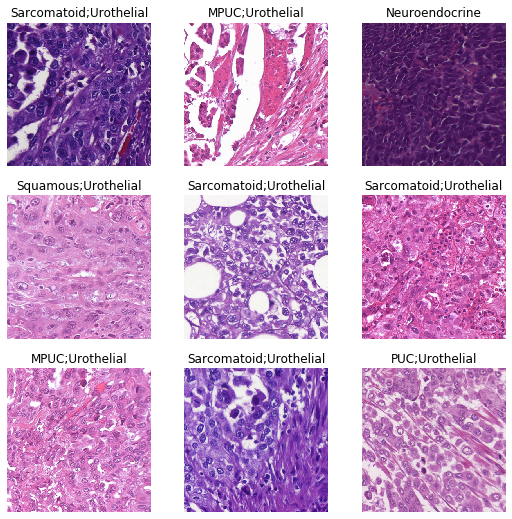

In [35]:
dls.show_batch()

# learner

## n

In [30]:
n=1

## create

In [31]:
arch = torchvision.models.resnet50

In [32]:
learner = cnn_learner(dls=dls, 
                     arch=arch, 
                     metrics=[fastai.metrics.accuracy_multi],
                     pretrained=True,
                     path=PATH/'models'/f'{n}-{arch.__name__}')

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /home/Deep_Learner/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


In [33]:
learner.to_fp16()
learner.path
learner.path.parent.mkdir(exist_ok=True)
learner.path.mkdir(exist_ok=True)

## name

In [34]:
epochs_frozen = 5
epochs_unfrozen = 10

In [35]:
nameBase = f'{n}-{arch.__name__}'
nameBase

'1-resnet50'

## train

In [ ]:
learner.lr_find(start_lr=1e-15, end_lr=10, num_it=200)

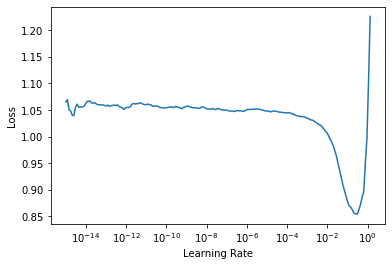

In [41]:
learner.recorder.plot_lr_find()

In [42]:
lr1 = 6e-1

In [43]:
log_head_name = 'log-head.csv'

In [ ]:
learner.fit_one_cycle(n_epoch=epochs_frozen, 
                      lr_max=lr1, 
                      cbs=[CSVLogger(fname=log_head_name, append=True), SaveModelCallback(every_epoch=True, fname='head')])

epoch,train_loss,valid_loss,accuracy_multi,time


In [46]:
pd.read_csv(learner.path/log_head_name)

,epoch,train_loss,valid_loss,accuracy_multi,time
0,0,NaN,NaN,0.856509,4:47:27
1,1,NaN,NaN,0.856509,3:55:43
2,2,NaN,NaN,0.856509,3:53:42
3,3,NaN,NaN,0.856509,3:58:13
4,4,NaN,NaN,0.856509,3:51:30


In [47]:
nameHead = f'{nameBase}-head';nameHead

'1-resnet50-head'

In [48]:
learner.save(nameHead)

Path('/home/Deep_Learner/private/datasets/urothel_ca/models/1-resnet50/models/1-resnet50-head.pth')

In [49]:
learner.unfreeze()

SuggestedLRs(valley=2.844461050699465e-06)

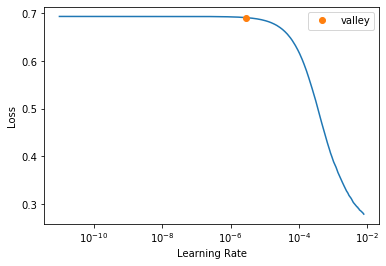

In [50]:
learner.lr_find(start_lr=1e-11, end_lr=1e-2, num_it=500)

In [ ]:
lr2 = 1e-4
lr3 = 5e-3
lr4 = 1e-3

In [ ]:
log_complete_name = 'log-complete.csv'

In [ ]:
learner.fit_one_cycle(n_epoch=epochs_unfrozen, 
                      lr_max=[lr2, lr3, lr4], 
                      cbs=[CSVLogger(fname=log_complete_name, append=True), SaveModelCallback(every_epoch=True, fname='complete')])

In [54]:
pd.read_csv(learner.path/log_complete_name)

,epoch,train_loss,valid_loss,accuracy_multi,time
0,0,0.203939,NaN,0.856509,3:45:06
1,1,0.206666,NaN,0.856509,3:43:42
2,2,0.204709,NaN,0.856509,3:43:30
3,3,0.202614,NaN,0.856509,3:46:29
4,4,0.206851,NaN,0.856509,3:46:56
5,5,0.205751,NaN,0.856509,3:45:15
6,6,0.206229,NaN,0.856509,3:46:34
7,7,0.202713,NaN,0.856509,3:46:02
8,8,0.203815,NaN,0.856509,3:47:28
9,9,0.206351,NaN,0.856509,3:46:53


In [36]:
nameComplete = f'{nameBase}-complete'; nameComplete

'1-resnet50-complete'

In [37]:
#learner.save(nameComplete)
learner.load(nameComplete)

# prediction

In [38]:
from postprocessing.predictor import Predictor

In [39]:
predictor = Predictor(learner=learner, patient_manager=patient_manager)

In [47]:
predictor.predict_on_tiles(prediction_type=shared.enums.PredictionType.tiles_on_the_fly, 
                          dataset_type=shared.enums.DatasetType.validation,
                          tile_size=final_size, 
                          batch_size=bs)

  0%|          | 0/21082 [00:00<?, ?it/s]

  0%|          | 1/21082 [00:01<7:57:43,  1.36s/it]

  0%|          | 2/21082 [00:01<6:06:26,  1.04s/it]

  0%|          | 3/21082 [00:01<4:49:07,  1.22it/s]

  0%|          | 4/21082 [00:02<3:54:56,  1.50it/s]

  0%|          | 5/21082 [00:02<3:18:06,  1.77it/s]

  0%|          | 6/21082 [00:02<2:49:09,  2.08it/s]

  0%|          | 7/21082 [00:03<2:31:15,  2.32it/s]

  0%|          | 8/21082 [00:03<2:19:38,  2.52it/s]

  0%|          | 9/21082 [00:03<2:10:00,  2.70it/s]

  0%|          | 10/21082 [00:04<2:03:30,  2.84it/s]

  0%|          | 11/21082 [00:04<1:56:32,  3.01it/s]

  0%|          | 12/21082 [00:04<1:54:35,  3.06it/s]

  0%|          | 13/21082 [00:05<1:50:24,  3.18it/s]

  0%|          | 14/21082 [00:05<1:49:56,  3.19it/s]

  0%|          | 15/21082 [00:05<2:09:18,  2.72it/s]

  0%|          | 16/21082 [00:06<2:02:15,  2.87it/s]

  0%|          | 17/21082 [00:06<1:58:46,  2.96it/s]

  0%|          | 18/21082 [00:06<1:54:09,  3.08it/s]

  0%|          | 19/21082 [00:07<1:52:47,  3.11it/s]

  0%|          | 20/21082 [00:07<1:49:13,  3.21it/s]

  0%|          | 21/21082 [00:07<1:50:57,  3.16it/s]

  0%|          | 22/21082 [00:07<1:49:47,  3.20it/s]

  0%|          | 23/21082 [00:08<1:48:22,  3.24it/s]

  0%|          | 24/21082 [00:08<1:47:07,  3.28it/s]

  0%|          | 25/21082 [00:08<1:46:30,  3.30it/s]

  0%|          | 26/21082 [00:09<1:47:03,  3.28it/s]

  0%|          | 27/21082 [00:09<1:46:17,  3.30it/s]

  0%|          | 28/21082 [00:09<1:49:33,  3.20it/s]

  0%|          | 29/21082 [00:10<1:47:59,  3.25it/s]

  0%|          | 30/21082 [00:10<1:45:50,  3.32it/s]

  0%|          | 31/21082 [00:10<1:48:43,  3.23it/s]

  0%|          | 32/21082 [00:11<1:52:56,  3.11it/s]

  0%|          | 33/21082 [00:11<1:51:10,  3.16it/s]

  0%|          | 34/21082 [00:11<1:50:28,  3.18it/s]

  0%|          | 35/21082 [00:11<1:49:09,  3.21it/s]

  0%|          | 36/21082 [00:12<1:47:52,  3.25it/s]

  0%|          | 37/21082 [00:12<1:46:57,  3.28it/s]

  0%|          | 38/21082 [00:12<1:45:37,  3.32it/s]

  0%|          | 39/21082 [00:13<1:44:50,  3.35it/s]

  0%|          | 40/21082 [00:13<1:44:39,  3.35it/s]

  0%|          | 41/21082 [00:13<1:42:40,  3.42it/s]

  0%|          | 42/21082 [00:14<1:44:19,  3.36it/s]

  0%|          | 43/21082 [00:14<1:49:09,  3.21it/s]

  0%|          | 44/21082 [00:14<1:49:46,  3.19it/s]

  0%|          | 45/21082 [00:15<1:49:57,  3.19it/s]

  0%|          | 46/21082 [00:15<1:49:48,  3.19it/s]

  0%|          | 47/21082 [00:15<1:46:51,  3.28it/s]

  0%|          | 48/21082 [00:15<1:45:04,  3.34it/s]

  0%|          | 49/21082 [00:16<1:42:58,  3.40it/s]

  0%|          | 50/21082 [00:16<1:40:57,  3.47it/s]

  0%|          | 51/21082 [00:16<1:40:41,  3.48it/s]

  0%|          | 52/21082 [00:17<1:40:00,  3.50it/s]

  0%|          | 53/21082 [00:17<1:41:41,  3.45it/s]

  0%|          | 54/21082 [00:17<1:42:37,  3.41it/s]

  0%|          | 55/21082 [00:17<1:44:08,  3.36it/s]

  0%|          | 56/21082 [00:18<1:42:38,  3.41it/s]

  0%|          | 57/21082 [00:18<1:41:05,  3.47it/s]

  0%|          | 58/21082 [00:18<1:40:05,  3.50it/s]

  0%|          | 59/21082 [00:19<1:39:06,  3.54it/s]

  0%|          | 60/21082 [00:19<1:37:57,  3.58it/s]

  0%|          | 61/21082 [00:19<1:38:52,  3.54it/s]

  0%|          | 62/21082 [00:19<1:37:54,  3.58it/s]

  0%|          | 63/21082 [00:20<1:38:36,  3.55it/s]

  0%|          | 64/21082 [00:20<1:40:19,  3.49it/s]

  0%|          | 65/21082 [00:20<1:41:11,  3.46it/s]

  0%|          | 66/21082 [00:21<1:39:17,  3.53it/s]

  0%|          | 67/21082 [00:21<1:37:56,  3.58it/s]

  0%|          | 68/21082 [00:21<1:38:13,  3.57it/s]

  0%|          | 69/21082 [00:21<1:38:11,  3.57it/s]

  0%|          | 70/21082 [00:22<1:40:03,  3.50it/s]

  0%|          | 71/21082 [00:22<1:39:51,  3.51it/s]

  0%|          | 72/21082 [00:22<1:43:26,  3.39it/s]

  0%|          | 73/21082 [00:23<1:41:43,  3.44it/s]

  0%|          | 74/21082 [00:23<1:39:33,  3.52it/s]

  0%|          | 75/21082 [00:23<1:42:38,  3.41it/s]

  0%|          | 76/21082 [00:23<1:40:29,  3.48it/s]

  0%|          | 77/21082 [00:24<1:39:18,  3.53it/s]

  0%|          | 78/21082 [00:24<1:38:08,  3.57it/s]

  0%|          | 79/21082 [00:24<1:42:51,  3.40it/s]

  0%|          | 80/21082 [00:25<1:45:03,  3.33it/s]

  0%|          | 81/21082 [00:25<1:46:45,  3.28it/s]

  0%|          | 82/21082 [00:25<1:47:53,  3.24it/s]

  0%|          | 83/21082 [00:26<1:46:43,  3.28it/s]

  0%|          | 84/21082 [00:26<1:45:40,  3.31it/s]

  0%|          | 85/21082 [00:26<1:44:44,  3.34it/s]

  0%|          | 86/21082 [00:26<1:44:04,  3.36it/s]

  0%|          | 87/21082 [00:27<1:43:06,  3.39it/s]

  0%|          | 88/21082 [00:27<1:42:46,  3.40it/s]

  0%|          | 89/21082 [00:27<1:44:40,  3.34it/s]

  0%|          | 90/21082 [00:28<1:43:21,  3.39it/s]

  0%|          | 91/21082 [00:28<1:43:59,  3.36it/s]

  0%|          | 92/21082 [00:28<1:43:27,  3.38it/s]

  0%|          | 93/21082 [00:28<1:43:12,  3.39it/s]

  0%|          | 94/21082 [00:29<1:42:45,  3.40it/s]

  0%|          | 95/21082 [00:29<1:42:15,  3.42it/s]

  0%|          | 96/21082 [00:29<1:42:06,  3.43it/s]

  0%|          | 97/21082 [00:30<1:39:53,  3.50it/s]

  0%|          | 98/21082 [00:30<1:41:15,  3.45it/s]

  0%|          | 99/21082 [00:30<1:42:37,  3.41it/s]

  0%|          | 100/21082 [00:31<1:44:49,  3.34it/s]

  0%|          | 101/21082 [00:31<1:45:20,  3.32it/s]

  0%|          | 102/21082 [00:31<1:45:35,  3.31it/s]

  0%|          | 103/21082 [00:31<1:46:27,  3.28it/s]

  0%|          | 104/21082 [00:32<1:45:06,  3.33it/s]

  0%|          | 105/21082 [00:32<1:45:43,  3.31it/s]

  1%|          | 106/21082 [00:32<1:46:08,  3.29it/s]

  1%|          | 107/21082 [00:33<1:48:33,  3.22it/s]

  1%|          | 108/21082 [00:33<1:53:37,  3.08it/s]

  1%|          | 109/21082 [00:33<1:53:01,  3.09it/s]

  1%|          | 110/21082 [00:34<1:55:13,  3.03it/s]

  1%|          | 111/21082 [00:34<1:54:18,  3.06it/s]

  1%|          | 112/21082 [00:34<1:52:58,  3.09it/s]

  1%|          | 113/21082 [00:35<1:53:23,  3.08it/s]

  1%|          | 114/21082 [00:35<1:53:45,  3.07it/s]

  1%|          | 115/21082 [00:35<1:56:43,  2.99it/s]

  1%|          | 116/21082 [00:36<1:57:27,  2.98it/s]

  1%|          | 117/21082 [00:36<1:57:33,  2.97it/s]

  1%|          | 118/21082 [00:36<1:52:52,  3.10it/s]

  1%|          | 119/21082 [00:37<1:49:44,  3.18it/s]

  1%|          | 120/21082 [00:37<1:46:34,  3.28it/s]

  1%|          | 121/21082 [00:37<1:45:03,  3.33it/s]

  1%|          | 122/21082 [00:37<1:44:06,  3.36it/s]

  1%|          | 123/21082 [00:38<1:44:36,  3.34it/s]

  1%|          | 124/21082 [00:38<1:45:27,  3.31it/s]

  1%|          | 125/21082 [00:38<1:45:02,  3.33it/s]

  1%|          | 126/21082 [00:39<1:44:23,  3.35it/s]

  1%|          | 127/21082 [00:39<1:43:38,  3.37it/s]

  1%|          | 128/21082 [00:39<1:43:52,  3.36it/s]

  1%|          | 129/21082 [00:40<1:42:19,  3.41it/s]

  1%|          | 130/21082 [00:40<1:44:02,  3.36it/s]

  1%|          | 131/21082 [00:40<1:43:40,  3.37it/s]

  1%|          | 132/21082 [00:40<1:45:07,  3.32it/s]

  1%|          | 133/21082 [00:41<1:45:15,  3.32it/s]

  1%|          | 134/21082 [00:41<1:44:34,  3.34it/s]

  1%|          | 135/21082 [00:41<1:44:08,  3.35it/s]

  1%|          | 136/21082 [00:42<1:43:06,  3.39it/s]

  1%|          | 137/21082 [00:42<1:44:35,  3.34it/s]

  1%|          | 138/21082 [00:42<1:45:43,  3.30it/s]

  1%|          | 139/21082 [00:43<1:44:16,  3.35it/s]

  1%|          | 140/21082 [00:43<1:45:38,  3.30it/s]

  1%|          | 141/21082 [00:43<1:46:10,  3.29it/s]

  1%|          | 142/21082 [00:43<1:44:42,  3.33it/s]

  1%|          | 143/21082 [00:44<1:42:55,  3.39it/s]

  1%|          | 144/21082 [00:44<1:45:04,  3.32it/s]

  1%|          | 145/21082 [00:44<1:46:24,  3.28it/s]

  1%|          | 146/21082 [00:45<1:45:31,  3.31it/s]

  1%|          | 147/21082 [00:45<1:47:13,  3.25it/s]

  1%|          | 148/21082 [00:45<1:46:21,  3.28it/s]

  1%|          | 149/21082 [00:46<1:45:23,  3.31it/s]

  1%|          | 150/21082 [00:46<1:44:25,  3.34it/s]

  1%|          | 151/21082 [00:46<1:43:58,  3.36it/s]

  1%|          | 152/21082 [00:47<1:45:43,  3.30it/s]

  1%|          | 153/21082 [00:47<1:46:31,  3.27it/s]

  1%|          | 154/21082 [00:47<1:44:58,  3.32it/s]

  1%|          | 155/21082 [00:47<1:42:56,  3.39it/s]

  1%|          | 156/21082 [00:48<1:41:59,  3.42it/s]

  1%|          | 157/21082 [00:48<1:41:22,  3.44it/s]

  1%|          | 158/21082 [00:48<1:41:12,  3.45it/s]

  1%|          | 159/21082 [00:49<1:39:45,  3.50it/s]

  1%|          | 160/21082 [00:49<1:39:34,  3.50it/s]

  1%|          | 161/21082 [00:49<1:41:00,  3.45it/s]

  1%|          | 162/21082 [00:49<1:40:34,  3.47it/s]

  1%|          | 163/21082 [00:50<1:40:40,  3.46it/s]

  1%|          | 164/21082 [00:50<1:40:54,  3.46it/s]

  1%|          | 165/21082 [00:50<1:41:03,  3.45it/s]

  1%|          | 166/21082 [00:51<1:39:38,  3.50it/s]

  1%|          | 167/21082 [00:51<1:39:24,  3.51it/s]

  1%|          | 168/21082 [00:51<1:39:38,  3.50it/s]

  1%|          | 169/21082 [00:51<1:40:41,  3.46it/s]

  1%|          | 170/21082 [00:52<1:40:06,  3.48it/s]

  1%|          | 171/21082 [00:52<1:40:08,  3.48it/s]

  1%|          | 172/21082 [00:52<1:40:31,  3.47it/s]

  1%|          | 173/21082 [00:53<1:43:21,  3.37it/s]

  1%|          | 174/21082 [00:53<1:45:10,  3.31it/s]

  1%|          | 175/21082 [00:53<1:44:34,  3.33it/s]

  1%|          | 176/21082 [00:53<1:43:35,  3.36it/s]

  1%|          | 177/21082 [00:54<1:44:10,  3.34it/s]

  1%|          | 178/21082 [00:54<1:44:37,  3.33it/s]

  1%|          | 179/21082 [00:54<1:45:04,  3.32it/s]

  1%|          | 180/21082 [00:55<1:43:41,  3.36it/s]

  1%|          | 181/21082 [00:55<1:44:29,  3.33it/s]

  1%|          | 182/21082 [00:55<1:43:23,  3.37it/s]

  1%|          | 183/21082 [00:56<1:44:44,  3.33it/s]

  1%|          | 184/21082 [00:56<1:44:06,  3.35it/s]

  1%|          | 185/21082 [00:56<1:44:31,  3.33it/s]

  1%|          | 186/21082 [00:56<1:45:06,  3.31it/s]

  1%|          | 187/21082 [00:57<1:44:31,  3.33it/s]

  1%|          | 188/21082 [00:57<1:46:48,  3.26it/s]

  1%|          | 189/21082 [00:57<1:51:12,  3.13it/s]

  1%|          | 190/21082 [00:58<1:50:52,  3.14it/s]

  1%|          | 191/21082 [00:58<1:50:28,  3.15it/s]

  1%|          | 192/21082 [00:58<1:46:52,  3.26it/s]

  1%|          | 193/21082 [00:59<1:45:34,  3.30it/s]

  1%|          | 194/21082 [00:59<1:46:45,  3.26it/s]

  1%|          | 195/21082 [00:59<1:45:01,  3.31it/s]

  1%|          | 196/21082 [01:00<1:45:51,  3.29it/s]

  1%|          | 197/21082 [01:00<1:45:30,  3.30it/s]

  1%|          | 198/21082 [01:00<1:44:25,  3.33it/s]

  1%|          | 199/21082 [01:00<1:44:35,  3.33it/s]

  1%|          | 200/21082 [01:01<1:43:24,  3.37it/s]

  1%|          | 201/21082 [01:01<1:44:06,  3.34it/s]

  1%|          | 202/21082 [01:01<1:43:52,  3.35it/s]

  1%|          | 203/21082 [01:02<1:43:43,  3.36it/s]

  1%|          | 204/21082 [01:02<1:43:39,  3.36it/s]

  1%|          | 205/21082 [01:02<1:43:05,  3.38it/s]

  1%|          | 206/21082 [01:03<1:42:46,  3.39it/s]

  1%|          | 207/21082 [01:03<1:44:54,  3.32it/s]

  1%|          | 208/21082 [01:03<1:44:50,  3.32it/s]

  1%|          | 209/21082 [01:03<1:44:15,  3.34it/s]

  1%|          | 210/21082 [01:04<1:44:00,  3.34it/s]

  1%|          | 211/21082 [01:04<1:44:24,  3.33it/s]

  1%|          | 212/21082 [01:04<1:42:54,  3.38it/s]

  1%|          | 213/21082 [01:05<1:42:14,  3.40it/s]

  1%|          | 214/21082 [01:05<1:43:36,  3.36it/s]

  1%|          | 215/21082 [01:05<1:44:22,  3.33it/s]

  1%|          | 216/21082 [01:06<1:43:26,  3.36it/s]

  1%|          | 217/21082 [01:06<1:44:23,  3.33it/s]

  1%|          | 218/21082 [01:06<1:43:21,  3.36it/s]

  1%|          | 219/21082 [01:06<1:42:35,  3.39it/s]

  1%|          | 220/21082 [01:07<1:43:27,  3.36it/s]

  1%|          | 221/21082 [01:07<1:44:54,  3.31it/s]

  1%|          | 222/21082 [01:07<1:47:01,  3.25it/s]

  1%|          | 223/21082 [01:08<1:47:59,  3.22it/s]

  1%|          | 224/21082 [01:08<1:48:37,  3.20it/s]

  1%|          | 225/21082 [01:08<1:48:52,  3.19it/s]

  1%|          | 226/21082 [01:09<1:48:11,  3.21it/s]

  1%|          | 227/21082 [01:09<1:47:10,  3.24it/s]

  1%|          | 228/21082 [01:09<1:46:01,  3.28it/s]

  1%|          | 229/21082 [01:10<1:44:18,  3.33it/s]

  1%|          | 230/21082 [01:10<1:41:50,  3.41it/s]

  1%|          | 231/21082 [01:10<1:43:51,  3.35it/s]

  1%|          | 232/21082 [01:10<1:43:48,  3.35it/s]

  1%|          | 233/21082 [01:11<1:44:06,  3.34it/s]

  1%|          | 234/21082 [01:11<1:44:39,  3.32it/s]

  1%|          | 235/21082 [01:11<1:44:54,  3.31it/s]

  1%|          | 236/21082 [01:12<1:44:03,  3.34it/s]

  1%|          | 237/21082 [01:12<1:45:16,  3.30it/s]

  1%|          | 238/21082 [01:12<1:43:40,  3.35it/s]

  1%|          | 239/21082 [01:13<1:46:10,  3.27it/s]

  1%|          | 240/21082 [01:13<1:45:11,  3.30it/s]

  1%|          | 241/21082 [01:13<1:45:54,  3.28it/s]

  1%|          | 242/21082 [01:13<1:43:45,  3.35it/s]

  1%|          | 243/21082 [01:14<1:43:03,  3.37it/s]

  1%|          | 244/21082 [01:14<1:43:33,  3.35it/s]

  1%|          | 245/21082 [01:14<1:43:40,  3.35it/s]

  1%|          | 246/21082 [01:15<1:42:54,  3.37it/s]

  1%|          | 247/21082 [01:15<1:43:14,  3.36it/s]

  1%|          | 248/21082 [01:15<1:43:35,  3.35it/s]

  1%|          | 249/21082 [01:15<1:42:34,  3.39it/s]

  1%|          | 250/21082 [01:16<1:43:45,  3.35it/s]

  1%|          | 251/21082 [01:16<1:44:07,  3.33it/s]

  1%|          | 252/21082 [01:16<1:43:01,  3.37it/s]

  1%|          | 253/21082 [01:17<1:44:05,  3.33it/s]

  1%|          | 254/21082 [01:17<1:43:14,  3.36it/s]

  1%|          | 255/21082 [01:17<1:43:07,  3.37it/s]

  1%|          | 256/21082 [01:18<1:42:13,  3.40it/s]

  1%|          | 257/21082 [01:18<1:40:47,  3.44it/s]

  1%|          | 258/21082 [01:18<1:42:32,  3.38it/s]

  1%|          | 259/21082 [01:18<1:45:26,  3.29it/s]

  1%|          | 260/21082 [01:19<1:47:27,  3.23it/s]

  1%|          | 261/21082 [01:19<1:48:02,  3.21it/s]

  1%|          | 262/21082 [01:19<1:47:43,  3.22it/s]

  1%|          | 263/21082 [01:20<1:46:03,  3.27it/s]

  1%|▏         | 264/21082 [01:20<1:46:10,  3.27it/s]

  1%|▏         | 265/21082 [01:20<1:44:51,  3.31it/s]

  1%|▏         | 266/21082 [01:21<1:45:24,  3.29it/s]

  1%|▏         | 267/21082 [01:21<1:45:05,  3.30it/s]

  1%|▏         | 268/21082 [01:21<1:45:57,  3.27it/s]

  1%|▏         | 269/21082 [01:22<1:44:56,  3.31it/s]

  1%|▏         | 270/21082 [01:22<1:44:08,  3.33it/s]

  1%|▏         | 271/21082 [01:22<1:44:17,  3.33it/s]

  1%|▏         | 272/21082 [01:22<1:44:20,  3.32it/s]

  1%|▏         | 273/21082 [01:23<1:44:30,  3.32it/s]

  1%|▏         | 274/21082 [01:23<1:44:25,  3.32it/s]

  1%|▏         | 275/21082 [01:23<1:45:33,  3.29it/s]

  1%|▏         | 276/21082 [01:24<1:45:08,  3.30it/s]

  1%|▏         | 277/21082 [01:24<1:45:02,  3.30it/s]

  1%|▏         | 278/21082 [01:24<1:43:16,  3.36it/s]

  1%|▏         | 279/21082 [01:25<1:43:24,  3.35it/s]

  1%|▏         | 280/21082 [01:25<1:43:50,  3.34it/s]

  1%|▏         | 281/21082 [01:25<1:43:26,  3.35it/s]

  1%|▏         | 282/21082 [01:25<1:43:08,  3.36it/s]

  1%|▏         | 283/21082 [01:26<1:42:42,  3.37it/s]

  1%|▏         | 284/21082 [01:26<1:42:37,  3.38it/s]

  1%|▏         | 285/21082 [01:26<1:42:54,  3.37it/s]

  1%|▏         | 286/21082 [01:27<1:43:28,  3.35it/s]

  1%|▏         | 287/21082 [01:27<1:42:45,  3.37it/s]

  1%|▏         | 288/21082 [01:27<1:41:51,  3.40it/s]

  1%|▏         | 289/21082 [01:27<1:41:42,  3.41it/s]

  1%|▏         | 290/21082 [01:28<1:43:23,  3.35it/s]

  1%|▏         | 291/21082 [01:28<1:42:14,  3.39it/s]

  1%|▏         | 292/21082 [01:28<1:42:21,  3.39it/s]

  1%|▏         | 293/21082 [01:29<1:42:05,  3.39it/s]

  1%|▏         | 294/21082 [01:29<1:41:37,  3.41it/s]

  1%|▏         | 295/21082 [01:29<1:42:01,  3.40it/s]

  1%|▏         | 296/21082 [01:30<1:43:27,  3.35it/s]

  1%|▏         | 297/21082 [01:30<1:43:13,  3.36it/s]

  1%|▏         | 298/21082 [01:30<1:43:32,  3.35it/s]

  1%|▏         | 299/21082 [01:30<1:45:48,  3.27it/s]

  1%|▏         | 300/21082 [01:31<1:44:57,  3.30it/s]

  1%|▏         | 301/21082 [01:31<1:43:36,  3.34it/s]

  1%|▏         | 302/21082 [01:31<1:41:18,  3.42it/s]

  1%|▏         | 303/21082 [01:32<1:41:25,  3.41it/s]

  1%|▏         | 304/21082 [01:32<1:42:30,  3.38it/s]

  1%|▏         | 305/21082 [01:32<1:41:48,  3.40it/s]

  1%|▏         | 306/21082 [01:33<1:41:37,  3.41it/s]

  1%|▏         | 307/21082 [01:33<1:44:55,  3.30it/s]

  1%|▏         | 308/21082 [01:33<1:46:05,  3.26it/s]

  1%|▏         | 309/21082 [01:33<1:43:23,  3.35it/s]

  1%|▏         | 310/21082 [01:34<1:43:43,  3.34it/s]

  1%|▏         | 311/21082 [01:34<1:44:27,  3.31it/s]

  1%|▏         | 312/21082 [01:34<1:44:02,  3.33it/s]

  1%|▏         | 313/21082 [01:35<1:44:18,  3.32it/s]

  1%|▏         | 314/21082 [01:35<1:43:20,  3.35it/s]

  1%|▏         | 315/21082 [01:35<1:41:58,  3.39it/s]

  1%|▏         | 316/21082 [01:36<1:41:39,  3.40it/s]

  2%|▏         | 317/21082 [01:36<1:40:18,  3.45it/s]

  2%|▏         | 318/21082 [01:36<1:40:35,  3.44it/s]

  2%|▏         | 319/21082 [01:36<1:40:35,  3.44it/s]

  2%|▏         | 320/21082 [01:37<1:40:28,  3.44it/s]

  2%|▏         | 321/21082 [01:37<1:39:19,  3.48it/s]

  2%|▏         | 322/21082 [01:37<1:39:23,  3.48it/s]

  2%|▏         | 323/21082 [01:38<1:38:57,  3.50it/s]

  2%|▏         | 324/21082 [01:38<1:39:40,  3.47it/s]

  2%|▏         | 325/21082 [01:38<1:39:43,  3.47it/s]

  2%|▏         | 326/21082 [01:38<1:40:05,  3.46it/s]

  2%|▏         | 327/21082 [01:39<1:39:55,  3.46it/s]

  2%|▏         | 328/21082 [01:39<1:42:18,  3.38it/s]

  2%|▏         | 329/21082 [01:39<1:41:47,  3.40it/s]

  2%|▏         | 330/21082 [01:40<1:41:11,  3.42it/s]

  2%|▏         | 331/21082 [01:40<1:42:04,  3.39it/s]

  2%|▏         | 332/21082 [01:40<1:41:35,  3.40it/s]

  2%|▏         | 333/21082 [01:40<1:41:32,  3.41it/s]

  2%|▏         | 334/21082 [01:41<1:42:26,  3.38it/s]

  2%|▏         | 335/21082 [01:41<1:43:24,  3.34it/s]

  2%|▏         | 336/21082 [01:41<1:42:56,  3.36it/s]

  2%|▏         | 337/21082 [01:42<1:42:59,  3.36it/s]

  2%|▏         | 338/21082 [01:42<1:43:08,  3.35it/s]

  2%|▏         | 339/21082 [01:42<1:43:13,  3.35it/s]

  2%|▏         | 340/21082 [01:43<1:43:02,  3.36it/s]

  2%|▏         | 341/21082 [01:43<1:41:50,  3.39it/s]

  2%|▏         | 342/21082 [01:43<1:41:39,  3.40it/s]

  2%|▏         | 343/21082 [01:43<1:41:28,  3.41it/s]

  2%|▏         | 344/21082 [01:44<1:40:55,  3.42it/s]

  2%|▏         | 345/21082 [01:44<1:40:44,  3.43it/s]

  2%|▏         | 346/21082 [01:44<1:40:44,  3.43it/s]

  2%|▏         | 347/21082 [01:45<1:40:45,  3.43it/s]

  2%|▏         | 348/21082 [01:45<1:39:42,  3.47it/s]

  2%|▏         | 349/21082 [01:45<1:40:52,  3.43it/s]

  2%|▏         | 350/21082 [01:45<1:41:48,  3.39it/s]

  2%|▏         | 351/21082 [01:46<1:42:33,  3.37it/s]

  2%|▏         | 352/21082 [01:46<1:42:16,  3.38it/s]

  2%|▏         | 353/21082 [01:46<1:42:49,  3.36it/s]

  2%|▏         | 354/21082 [01:47<1:42:39,  3.37it/s]

  2%|▏         | 355/21082 [01:47<1:42:45,  3.36it/s]

  2%|▏         | 356/21082 [01:47<1:42:27,  3.37it/s]

  2%|▏         | 357/21082 [01:48<1:41:59,  3.39it/s]

  2%|▏         | 358/21082 [01:48<1:42:30,  3.37it/s]

  2%|▏         | 359/21082 [01:48<1:42:30,  3.37it/s]

  2%|▏         | 360/21082 [01:48<1:42:15,  3.38it/s]

  2%|▏         | 361/21082 [01:49<1:41:53,  3.39it/s]

  2%|▏         | 362/21082 [01:49<1:41:16,  3.41it/s]

  2%|▏         | 363/21082 [01:49<1:41:47,  3.39it/s]

  2%|▏         | 364/21082 [01:50<1:44:40,  3.30it/s]

  2%|▏         | 365/21082 [01:50<1:45:55,  3.26it/s]

  2%|▏         | 366/21082 [01:50<1:45:36,  3.27it/s]

  2%|▏         | 367/21082 [01:51<1:45:40,  3.27it/s]

  2%|▏         | 368/21082 [01:51<1:43:08,  3.35it/s]

  2%|▏         | 369/21082 [01:51<1:40:34,  3.43it/s]

  2%|▏         | 370/21082 [01:51<1:40:36,  3.43it/s]

  2%|▏         | 371/21082 [01:52<1:41:51,  3.39it/s]

  2%|▏         | 372/21082 [01:52<1:42:17,  3.37it/s]

  2%|▏         | 373/21082 [01:52<1:41:44,  3.39it/s]

  2%|▏         | 374/21082 [01:53<1:42:58,  3.35it/s]

  2%|▏         | 375/21082 [01:53<1:43:17,  3.34it/s]

  2%|▏         | 376/21082 [01:53<1:43:38,  3.33it/s]

  2%|▏         | 377/21082 [01:54<1:43:15,  3.34it/s]

  2%|▏         | 378/21082 [01:54<1:42:55,  3.35it/s]

  2%|▏         | 379/21082 [01:54<1:43:16,  3.34it/s]

  2%|▏         | 380/21082 [01:54<1:42:35,  3.36it/s]

  2%|▏         | 381/21082 [01:55<1:42:05,  3.38it/s]

  2%|▏         | 382/21082 [01:55<1:41:24,  3.40it/s]

  2%|▏         | 383/21082 [01:55<1:42:18,  3.37it/s]

  2%|▏         | 384/21082 [01:56<1:44:42,  3.29it/s]

  2%|▏         | 385/21082 [01:56<1:43:53,  3.32it/s]

  2%|▏         | 386/21082 [01:56<1:42:13,  3.37it/s]

  2%|▏         | 387/21082 [01:57<1:42:20,  3.37it/s]

  2%|▏         | 388/21082 [01:57<1:41:32,  3.40it/s]

  2%|▏         | 389/21082 [01:57<1:40:40,  3.43it/s]

  2%|▏         | 390/21082 [01:57<1:40:11,  3.44it/s]

  2%|▏         | 391/21082 [01:58<1:40:51,  3.42it/s]

  2%|▏         | 392/21082 [01:58<1:40:32,  3.43it/s]

  2%|▏         | 393/21082 [01:58<1:42:50,  3.35it/s]

  2%|▏         | 394/21082 [01:59<1:45:34,  3.27it/s]

  2%|▏         | 395/21082 [01:59<1:43:28,  3.33it/s]

  2%|▏         | 396/21082 [01:59<1:44:32,  3.30it/s]

  2%|▏         | 397/21082 [02:00<1:48:31,  3.18it/s]

  2%|▏         | 398/21082 [02:00<1:46:49,  3.23it/s]

  2%|▏         | 399/21082 [02:00<1:46:26,  3.24it/s]

  2%|▏         | 400/21082 [02:00<1:45:24,  3.27it/s]

  2%|▏         | 401/21082 [02:01<1:46:18,  3.24it/s]

  2%|▏         | 402/21082 [02:01<1:45:36,  3.26it/s]

  2%|▏         | 403/21082 [02:01<1:44:58,  3.28it/s]

  2%|▏         | 404/21082 [02:02<1:43:39,  3.32it/s]

  2%|▏         | 405/21082 [02:02<1:45:20,  3.27it/s]

  2%|▏         | 406/21082 [02:02<1:46:30,  3.24it/s]

  2%|▏         | 407/21082 [02:03<1:47:38,  3.20it/s]

  2%|▏         | 408/21082 [02:03<1:47:50,  3.20it/s]

  2%|▏         | 409/21082 [02:03<1:45:20,  3.27it/s]

  2%|▏         | 410/21082 [02:03<1:43:44,  3.32it/s]

  2%|▏         | 411/21082 [02:04<1:44:17,  3.30it/s]

  2%|▏         | 412/21082 [02:04<1:45:48,  3.26it/s]

  2%|▏         | 413/21082 [02:04<1:44:32,  3.30it/s]

  2%|▏         | 414/21082 [02:05<1:44:05,  3.31it/s]

  2%|▏         | 415/21082 [02:05<1:43:31,  3.33it/s]

  2%|▏         | 416/21082 [02:05<1:42:16,  3.37it/s]

  2%|▏         | 417/21082 [02:06<1:40:36,  3.42it/s]

  2%|▏         | 418/21082 [02:06<1:44:01,  3.31it/s]

  2%|▏         | 419/21082 [02:06<1:45:17,  3.27it/s]

  2%|▏         | 420/21082 [02:07<1:44:25,  3.30it/s]

  2%|▏         | 421/21082 [02:07<1:44:14,  3.30it/s]

  2%|▏         | 422/21082 [02:07<1:42:52,  3.35it/s]

  2%|▏         | 423/21082 [02:07<1:43:31,  3.33it/s]

  2%|▏         | 424/21082 [02:08<1:43:27,  3.33it/s]

  2%|▏         | 425/21082 [02:08<1:43:18,  3.33it/s]

  2%|▏         | 426/21082 [02:08<1:41:20,  3.40it/s]

  2%|▏         | 427/21082 [02:09<1:41:54,  3.38it/s]

  2%|▏         | 428/21082 [02:09<1:41:46,  3.38it/s]

  2%|▏         | 429/21082 [02:09<1:41:47,  3.38it/s]

  2%|▏         | 430/21082 [02:10<1:44:03,  3.31it/s]

  2%|▏         | 431/21082 [02:10<1:45:36,  3.26it/s]

  2%|▏         | 432/21082 [02:10<1:45:17,  3.27it/s]

  2%|▏         | 433/21082 [02:10<1:43:53,  3.31it/s]

  2%|▏         | 434/21082 [02:11<1:43:35,  3.32it/s]

  2%|▏         | 435/21082 [02:11<1:43:31,  3.32it/s]

  2%|▏         | 436/21082 [02:11<1:41:14,  3.40it/s]

  2%|▏         | 437/21082 [02:12<1:40:07,  3.44it/s]

  2%|▏         | 438/21082 [02:12<1:39:02,  3.47it/s]

  2%|▏         | 439/21082 [02:12<1:41:48,  3.38it/s]

  2%|▏         | 440/21082 [02:12<1:42:48,  3.35it/s]

  2%|▏         | 441/21082 [02:13<1:44:29,  3.29it/s]

  2%|▏         | 442/21082 [02:13<1:44:34,  3.29it/s]

  2%|▏         | 443/21082 [02:13<1:43:52,  3.31it/s]

  2%|▏         | 444/21082 [02:14<1:44:15,  3.30it/s]

  2%|▏         | 445/21082 [02:14<1:42:35,  3.35it/s]

  2%|▏         | 446/21082 [02:14<1:41:07,  3.40it/s]

  2%|▏         | 447/21082 [02:15<1:40:44,  3.41it/s]

  2%|▏         | 448/21082 [02:15<1:42:08,  3.37it/s]

  2%|▏         | 449/21082 [02:15<1:41:00,  3.40it/s]

  2%|▏         | 450/21082 [02:15<1:41:15,  3.40it/s]

  2%|▏         | 451/21082 [02:16<1:41:46,  3.38it/s]

  2%|▏         | 452/21082 [02:16<1:43:44,  3.31it/s]

  2%|▏         | 453/21082 [02:16<1:42:54,  3.34it/s]

  2%|▏         | 454/21082 [02:17<1:45:09,  3.27it/s]

  2%|▏         | 455/21082 [02:17<1:44:01,  3.30it/s]

  2%|▏         | 456/21082 [02:17<1:45:34,  3.26it/s]

  2%|▏         | 457/21082 [02:18<1:44:29,  3.29it/s]

  2%|▏         | 458/21082 [02:18<1:43:49,  3.31it/s]

  2%|▏         | 459/21082 [02:18<1:42:33,  3.35it/s]

  2%|▏         | 460/21082 [02:18<1:41:59,  3.37it/s]

  2%|▏         | 461/21082 [02:19<1:41:11,  3.40it/s]

  2%|▏         | 462/21082 [02:19<1:42:48,  3.34it/s]

  2%|▏         | 463/21082 [02:19<1:43:55,  3.31it/s]

  2%|▏         | 464/21082 [02:20<1:44:50,  3.28it/s]

  2%|▏         | 465/21082 [02:20<1:46:14,  3.23it/s]

  2%|▏         | 466/21082 [02:20<1:48:26,  3.17it/s]

  2%|▏         | 467/21082 [02:21<1:44:34,  3.29it/s]

  2%|▏         | 468/21082 [02:21<1:42:45,  3.34it/s]

  2%|▏         | 469/21082 [02:21<1:43:20,  3.32it/s]

  2%|▏         | 470/21082 [02:22<1:42:16,  3.36it/s]

  2%|▏         | 471/21082 [02:22<1:41:11,  3.39it/s]

  2%|▏         | 472/21082 [02:22<1:39:22,  3.46it/s]

  2%|▏         | 473/21082 [02:22<1:40:07,  3.43it/s]

  2%|▏         | 474/21082 [02:23<1:38:24,  3.49it/s]

  2%|▏         | 475/21082 [02:23<1:41:17,  3.39it/s]

  2%|▏         | 476/21082 [02:23<1:41:38,  3.38it/s]

  2%|▏         | 477/21082 [02:24<1:43:03,  3.33it/s]

  2%|▏         | 478/21082 [02:24<1:41:48,  3.37it/s]

  2%|▏         | 479/21082 [02:24<1:42:33,  3.35it/s]

  2%|▏         | 480/21082 [02:24<1:43:05,  3.33it/s]

  2%|▏         | 481/21082 [02:25<1:45:26,  3.26it/s]

  2%|▏         | 482/21082 [02:25<1:45:46,  3.25it/s]

  2%|▏         | 483/21082 [02:25<1:45:58,  3.24it/s]

  2%|▏         | 484/21082 [02:26<1:46:25,  3.23it/s]

  2%|▏         | 485/21082 [02:26<1:44:33,  3.28it/s]

  2%|▏         | 486/21082 [02:26<1:43:04,  3.33it/s]

  2%|▏         | 487/21082 [02:27<1:43:26,  3.32it/s]

  2%|▏         | 488/21082 [02:27<1:45:13,  3.26it/s]

  2%|▏         | 489/21082 [02:27<1:43:43,  3.31it/s]

  2%|▏         | 490/21082 [02:28<1:42:35,  3.35it/s]

  2%|▏         | 491/21082 [02:28<1:43:11,  3.33it/s]

  2%|▏         | 492/21082 [02:28<1:42:53,  3.34it/s]

  2%|▏         | 493/21082 [02:28<1:43:00,  3.33it/s]

  2%|▏         | 494/21082 [02:29<1:42:40,  3.34it/s]

  2%|▏         | 495/21082 [02:29<1:41:50,  3.37it/s]

  2%|▏         | 496/21082 [02:29<1:42:25,  3.35it/s]

  2%|▏         | 497/21082 [02:30<1:41:40,  3.37it/s]

  2%|▏         | 498/21082 [02:30<1:41:29,  3.38it/s]

  2%|▏         | 499/21082 [02:30<1:40:57,  3.40it/s]

  2%|▏         | 500/21082 [02:30<1:42:28,  3.35it/s]

  2%|▏         | 501/21082 [02:31<1:43:19,  3.32it/s]

  2%|▏         | 502/21082 [02:31<1:45:30,  3.25it/s]

  2%|▏         | 503/21082 [02:31<1:45:00,  3.27it/s]

  2%|▏         | 504/21082 [02:32<1:45:27,  3.25it/s]

  2%|▏         | 505/21082 [02:32<1:45:16,  3.26it/s]

  2%|▏         | 506/21082 [02:32<1:44:00,  3.30it/s]

  2%|▏         | 507/21082 [02:33<1:43:56,  3.30it/s]

  2%|▏         | 508/21082 [02:33<1:46:55,  3.21it/s]

  2%|▏         | 509/21082 [02:33<1:45:30,  3.25it/s]

  2%|▏         | 510/21082 [02:34<1:45:01,  3.26it/s]

  2%|▏         | 511/21082 [02:34<1:46:08,  3.23it/s]

  2%|▏         | 512/21082 [02:34<1:44:41,  3.27it/s]

  2%|▏         | 513/21082 [02:34<1:43:09,  3.32it/s]

  2%|▏         | 514/21082 [02:35<1:42:14,  3.35it/s]

  2%|▏         | 515/21082 [02:35<1:42:17,  3.35it/s]

  2%|▏         | 516/21082 [02:35<1:42:10,  3.35it/s]

  2%|▏         | 517/21082 [02:36<1:41:11,  3.39it/s]

  2%|▏         | 518/21082 [02:36<1:41:04,  3.39it/s]

  2%|▏         | 519/21082 [02:36<1:40:44,  3.40it/s]

  2%|▏         | 520/21082 [02:37<1:41:42,  3.37it/s]

  2%|▏         | 521/21082 [02:37<1:40:49,  3.40it/s]

  2%|▏         | 522/21082 [02:37<1:39:59,  3.43it/s]

  2%|▏         | 523/21082 [02:37<1:39:00,  3.46it/s]

  2%|▏         | 524/21082 [02:38<1:39:14,  3.45it/s]

  2%|▏         | 525/21082 [02:38<1:38:58,  3.46it/s]

  2%|▏         | 526/21082 [02:38<1:37:34,  3.51it/s]

  2%|▏         | 527/21082 [02:39<1:36:41,  3.54it/s]

  3%|▎         | 528/21082 [02:39<1:37:40,  3.51it/s]

  3%|▎         | 529/21082 [02:39<1:39:14,  3.45it/s]

  3%|▎         | 530/21082 [02:39<1:37:12,  3.52it/s]

  3%|▎         | 531/21082 [02:40<1:37:13,  3.52it/s]

  3%|▎         | 532/21082 [02:40<1:37:16,  3.52it/s]

  3%|▎         | 533/21082 [02:40<1:39:46,  3.43it/s]

  3%|▎         | 534/21082 [02:41<1:40:44,  3.40it/s]

  3%|▎         | 535/21082 [02:41<1:39:33,  3.44it/s]

  3%|▎         | 536/21082 [02:41<1:41:33,  3.37it/s]

  3%|▎         | 537/21082 [02:41<1:42:13,  3.35it/s]

  3%|▎         | 538/21082 [02:42<1:42:26,  3.34it/s]

  3%|▎         | 539/21082 [02:42<1:41:19,  3.38it/s]

  3%|▎         | 540/21082 [02:42<1:41:15,  3.38it/s]

  3%|▎         | 541/21082 [02:43<1:41:08,  3.38it/s]

  3%|▎         | 542/21082 [02:43<1:40:05,  3.42it/s]

  3%|▎         | 543/21082 [02:43<1:41:06,  3.39it/s]

  3%|▎         | 544/21082 [02:44<1:40:39,  3.40it/s]

  3%|▎         | 545/21082 [02:44<1:40:01,  3.42it/s]

  3%|▎         | 546/21082 [02:44<1:39:31,  3.44it/s]

  3%|▎         | 547/21082 [02:44<1:40:10,  3.42it/s]

  3%|▎         | 548/21082 [02:45<1:39:11,  3.45it/s]

  3%|▎         | 549/21082 [02:45<1:38:23,  3.48it/s]

  3%|▎         | 550/21082 [02:45<1:41:23,  3.37it/s]

  3%|▎         | 551/21082 [02:46<1:41:09,  3.38it/s]

  3%|▎         | 552/21082 [02:46<1:41:47,  3.36it/s]

  3%|▎         | 553/21082 [02:46<1:42:20,  3.34it/s]

  3%|▎         | 554/21082 [02:46<1:42:01,  3.35it/s]

  3%|▎         | 555/21082 [02:47<1:41:43,  3.36it/s]

  3%|▎         | 556/21082 [02:47<1:41:22,  3.37it/s]

  3%|▎         | 557/21082 [02:47<1:40:38,  3.40it/s]

  3%|▎         | 558/21082 [02:48<1:39:31,  3.44it/s]

  3%|▎         | 559/21082 [02:48<1:38:18,  3.48it/s]

  3%|▎         | 560/21082 [02:48<1:39:23,  3.44it/s]

  3%|▎         | 561/21082 [02:48<1:39:54,  3.42it/s]

  3%|▎         | 562/21082 [02:49<1:40:04,  3.42it/s]

  3%|▎         | 563/21082 [02:49<1:39:35,  3.43it/s]

  3%|▎         | 564/21082 [02:49<1:41:05,  3.38it/s]

  3%|▎         | 565/21082 [02:50<1:41:07,  3.38it/s]

  3%|▎         | 566/21082 [02:50<1:40:58,  3.39it/s]

  3%|▎         | 567/21082 [02:50<1:40:56,  3.39it/s]

  3%|▎         | 568/21082 [02:51<1:40:31,  3.40it/s]

  3%|▎         | 569/21082 [02:51<1:41:33,  3.37it/s]

  3%|▎         | 570/21082 [02:51<1:43:27,  3.30it/s]

  3%|▎         | 571/21082 [02:51<1:43:47,  3.29it/s]

  3%|▎         | 572/21082 [02:52<1:41:58,  3.35it/s]

  3%|▎         | 573/21082 [02:52<1:41:15,  3.38it/s]

  3%|▎         | 574/21082 [02:52<1:41:26,  3.37it/s]

  3%|▎         | 575/21082 [02:53<1:41:16,  3.38it/s]

  3%|▎         | 576/21082 [02:53<1:40:40,  3.39it/s]

  3%|▎         | 577/21082 [02:53<1:39:59,  3.42it/s]

  3%|▎         | 578/21082 [02:54<1:40:09,  3.41it/s]

  3%|▎         | 579/21082 [02:54<1:41:02,  3.38it/s]

  3%|▎         | 580/21082 [02:54<1:40:46,  3.39it/s]

  3%|▎         | 581/21082 [02:54<1:39:47,  3.42it/s]

  3%|▎         | 582/21082 [02:55<1:38:25,  3.47it/s]

  3%|▎         | 583/21082 [02:55<1:40:28,  3.40it/s]

  3%|▎         | 584/21082 [02:55<1:40:04,  3.41it/s]

  3%|▎         | 585/21082 [02:56<1:40:08,  3.41it/s]

  3%|▎         | 586/21082 [02:56<1:38:16,  3.48it/s]

  3%|▎         | 587/21082 [02:56<1:39:57,  3.42it/s]

  3%|▎         | 588/21082 [02:56<1:41:38,  3.36it/s]

  3%|▎         | 589/21082 [02:57<1:42:06,  3.34it/s]

  3%|▎         | 590/21082 [02:57<1:42:31,  3.33it/s]

  3%|▎         | 591/21082 [02:57<1:42:43,  3.32it/s]

  3%|▎         | 592/21082 [02:58<1:43:39,  3.29it/s]

  3%|▎         | 593/21082 [02:58<1:42:09,  3.34it/s]

  3%|▎         | 594/21082 [02:58<1:42:00,  3.35it/s]

  3%|▎         | 595/21082 [02:59<1:41:31,  3.36it/s]

  3%|▎         | 596/21082 [02:59<1:41:05,  3.38it/s]

  3%|▎         | 597/21082 [02:59<1:40:44,  3.39it/s]

  3%|▎         | 598/21082 [02:59<1:41:28,  3.36it/s]

  3%|▎         | 599/21082 [03:00<1:42:03,  3.35it/s]

  3%|▎         | 600/21082 [03:00<1:42:23,  3.33it/s]

  3%|▎         | 601/21082 [03:00<1:43:53,  3.29it/s]

  3%|▎         | 602/21082 [03:01<1:43:06,  3.31it/s]

  3%|▎         | 603/21082 [03:01<1:43:06,  3.31it/s]

  3%|▎         | 604/21082 [03:01<1:41:57,  3.35it/s]

  3%|▎         | 605/21082 [03:02<1:40:52,  3.38it/s]

  3%|▎         | 606/21082 [03:02<1:40:29,  3.40it/s]

  3%|▎         | 607/21082 [03:02<1:40:48,  3.39it/s]

  3%|▎         | 608/21082 [03:02<1:40:13,  3.40it/s]

  3%|▎         | 609/21082 [03:03<1:39:17,  3.44it/s]

  3%|▎         | 610/21082 [03:03<1:40:33,  3.39it/s]

  3%|▎         | 611/21082 [03:03<1:39:56,  3.41it/s]

  3%|▎         | 612/21082 [03:04<1:39:28,  3.43it/s]

  3%|▎         | 613/21082 [03:04<1:39:59,  3.41it/s]

  3%|▎         | 614/21082 [03:04<1:40:52,  3.38it/s]

  3%|▎         | 615/21082 [03:05<1:44:02,  3.28it/s]

  3%|▎         | 616/21082 [03:05<1:44:18,  3.27it/s]

  3%|▎         | 617/21082 [03:05<1:42:36,  3.32it/s]

  3%|▎         | 618/21082 [03:05<1:40:20,  3.40it/s]

  3%|▎         | 619/21082 [03:06<1:40:23,  3.40it/s]

  3%|▎         | 620/21082 [03:06<1:41:40,  3.35it/s]

  3%|▎         | 621/21082 [03:06<1:42:55,  3.31it/s]

  3%|▎         | 622/21082 [03:07<1:43:32,  3.29it/s]

  3%|▎         | 623/21082 [03:07<1:42:51,  3.32it/s]

  3%|▎         | 624/21082 [03:07<1:42:19,  3.33it/s]

  3%|▎         | 625/21082 [03:08<1:41:59,  3.34it/s]

  3%|▎         | 626/21082 [03:08<1:42:55,  3.31it/s]

  3%|▎         | 627/21082 [03:08<1:42:52,  3.31it/s]

  3%|▎         | 628/21082 [03:08<1:42:47,  3.32it/s]

  3%|▎         | 629/21082 [03:09<1:42:23,  3.33it/s]

  3%|▎         | 630/21082 [03:09<1:42:01,  3.34it/s]

  3%|▎         | 631/21082 [03:09<1:42:17,  3.33it/s]

  3%|▎         | 632/21082 [03:10<1:41:36,  3.35it/s]

  3%|▎         | 633/21082 [03:10<1:42:27,  3.33it/s]

  3%|▎         | 634/21082 [03:10<1:42:42,  3.32it/s]

  3%|▎         | 635/21082 [03:11<1:43:17,  3.30it/s]

  3%|▎         | 636/21082 [03:11<1:42:33,  3.32it/s]

  3%|▎         | 637/21082 [03:11<1:42:51,  3.31it/s]

  3%|▎         | 638/21082 [03:11<1:42:33,  3.32it/s]

  3%|▎         | 639/21082 [03:12<1:43:16,  3.30it/s]

  3%|▎         | 640/21082 [03:12<1:43:14,  3.30it/s]

  3%|▎         | 641/21082 [03:12<1:41:41,  3.35it/s]

  3%|▎         | 642/21082 [03:13<1:41:03,  3.37it/s]

  3%|▎         | 643/21082 [03:13<1:41:42,  3.35it/s]

  3%|▎         | 644/21082 [03:13<1:42:23,  3.33it/s]

  3%|▎         | 645/21082 [03:14<1:41:49,  3.35it/s]

  3%|▎         | 646/21082 [03:14<1:41:42,  3.35it/s]

  3%|▎         | 647/21082 [03:14<1:41:11,  3.37it/s]

  3%|▎         | 648/21082 [03:14<1:41:36,  3.35it/s]

  3%|▎         | 649/21082 [03:15<1:41:25,  3.36it/s]

  3%|▎         | 650/21082 [03:15<1:40:45,  3.38it/s]

  3%|▎         | 651/21082 [03:15<1:43:08,  3.30it/s]

  3%|▎         | 652/21082 [03:16<1:42:05,  3.34it/s]

  3%|▎         | 653/21082 [03:16<1:41:42,  3.35it/s]

  3%|▎         | 654/21082 [03:16<1:40:37,  3.38it/s]

  3%|▎         | 655/21082 [03:17<1:42:06,  3.33it/s]

  3%|▎         | 656/21082 [03:17<1:41:10,  3.36it/s]

  3%|▎         | 657/21082 [03:17<1:40:37,  3.38it/s]

  3%|▎         | 658/21082 [03:17<1:41:37,  3.35it/s]

  3%|▎         | 659/21082 [03:18<1:40:33,  3.38it/s]

  3%|▎         | 660/21082 [03:18<1:39:59,  3.40it/s]

  3%|▎         | 661/21082 [03:18<1:40:11,  3.40it/s]

  3%|▎         | 662/21082 [03:19<1:41:16,  3.36it/s]

  3%|▎         | 663/21082 [03:19<1:45:11,  3.23it/s]

  3%|▎         | 664/21082 [03:19<1:44:26,  3.26it/s]

  3%|▎         | 665/21082 [03:20<1:43:15,  3.30it/s]

  3%|▎         | 666/21082 [03:20<1:43:44,  3.28it/s]

  3%|▎         | 667/21082 [03:20<1:42:16,  3.33it/s]

  3%|▎         | 668/21082 [03:20<1:42:26,  3.32it/s]

  3%|▎         | 669/21082 [03:21<1:41:29,  3.35it/s]

  3%|▎         | 670/21082 [03:21<1:41:29,  3.35it/s]

  3%|▎         | 671/21082 [03:21<1:42:22,  3.32it/s]

  3%|▎         | 672/21082 [03:22<1:43:23,  3.29it/s]

  3%|▎         | 673/21082 [03:22<1:45:22,  3.23it/s]

  3%|▎         | 674/21082 [03:22<1:43:06,  3.30it/s]

  3%|▎         | 675/21082 [03:23<1:41:17,  3.36it/s]

  3%|▎         | 676/21082 [03:23<1:40:27,  3.39it/s]

  3%|▎         | 677/21082 [03:23<1:39:26,  3.42it/s]

  3%|▎         | 678/21082 [03:23<1:41:47,  3.34it/s]

  3%|▎         | 679/21082 [03:24<1:41:59,  3.33it/s]

  3%|▎         | 680/21082 [03:24<1:41:41,  3.34it/s]

  3%|▎         | 681/21082 [03:24<1:41:25,  3.35it/s]

  3%|▎         | 682/21082 [03:25<1:43:00,  3.30it/s]

  3%|▎         | 683/21082 [03:25<1:41:13,  3.36it/s]

  3%|▎         | 684/21082 [03:25<1:40:57,  3.37it/s]

  3%|▎         | 685/21082 [03:25<1:38:58,  3.43it/s]

  3%|▎         | 686/21082 [03:26<1:38:15,  3.46it/s]

  3%|▎         | 687/21082 [03:26<1:38:51,  3.44it/s]

  3%|▎         | 688/21082 [03:26<1:38:46,  3.44it/s]

  3%|▎         | 689/21082 [03:27<1:38:23,  3.45it/s]

  3%|▎         | 690/21082 [03:27<1:38:12,  3.46it/s]

  3%|▎         | 691/21082 [03:27<1:39:51,  3.40it/s]

  3%|▎         | 692/21082 [03:28<1:39:12,  3.43it/s]

  3%|▎         | 693/21082 [03:28<1:41:46,  3.34it/s]

  3%|▎         | 694/21082 [03:28<1:42:06,  3.33it/s]

  3%|▎         | 695/21082 [03:28<1:40:53,  3.37it/s]

  3%|▎         | 696/21082 [03:29<1:40:17,  3.39it/s]

  3%|▎         | 697/21082 [03:29<1:41:42,  3.34it/s]

  3%|▎         | 698/21082 [03:29<1:44:13,  3.26it/s]

  3%|▎         | 699/21082 [03:30<1:44:34,  3.25it/s]

  3%|▎         | 700/21082 [03:30<1:44:23,  3.25it/s]

  3%|▎         | 701/21082 [03:30<1:45:27,  3.22it/s]

  3%|▎         | 702/21082 [03:31<1:43:57,  3.27it/s]

  3%|▎         | 703/21082 [03:31<1:43:09,  3.29it/s]

  3%|▎         | 704/21082 [03:31<1:44:21,  3.25it/s]

  3%|▎         | 705/21082 [03:31<1:42:41,  3.31it/s]

  3%|▎         | 706/21082 [03:32<1:39:32,  3.41it/s]

  3%|▎         | 707/21082 [03:32<1:39:04,  3.43it/s]

  3%|▎         | 708/21082 [03:32<1:38:56,  3.43it/s]

  3%|▎         | 709/21082 [03:33<1:39:06,  3.43it/s]

  3%|▎         | 710/21082 [03:33<1:40:43,  3.37it/s]

  3%|▎         | 711/21082 [03:33<1:40:30,  3.38it/s]

  3%|▎         | 712/21082 [03:34<1:42:50,  3.30it/s]

  3%|▎         | 713/21082 [03:34<1:44:11,  3.26it/s]

  3%|▎         | 714/21082 [03:34<1:44:46,  3.24it/s]

  3%|▎         | 715/21082 [03:34<1:43:09,  3.29it/s]

  3%|▎         | 716/21082 [03:35<1:43:36,  3.28it/s]

  3%|▎         | 717/21082 [03:35<1:42:35,  3.31it/s]

  3%|▎         | 718/21082 [03:35<1:44:00,  3.26it/s]

  3%|▎         | 719/21082 [03:36<1:43:17,  3.29it/s]

  3%|▎         | 720/21082 [03:36<1:42:22,  3.31it/s]

  3%|▎         | 721/21082 [03:36<1:41:41,  3.34it/s]

  3%|▎         | 722/21082 [03:37<1:40:31,  3.38it/s]

  3%|▎         | 723/21082 [03:37<1:39:39,  3.40it/s]

  3%|▎         | 724/21082 [03:37<1:40:48,  3.37it/s]

  3%|▎         | 725/21082 [03:37<1:40:37,  3.37it/s]

  3%|▎         | 726/21082 [03:38<1:40:01,  3.39it/s]

  3%|▎         | 727/21082 [03:38<1:38:36,  3.44it/s]

  3%|▎         | 728/21082 [03:38<1:39:26,  3.41it/s]

  3%|▎         | 729/21082 [03:39<1:39:17,  3.42it/s]

  3%|▎         | 730/21082 [03:39<1:38:58,  3.43it/s]

  3%|▎         | 731/21082 [03:39<1:38:45,  3.43it/s]

  3%|▎         | 732/21082 [03:39<1:39:21,  3.41it/s]

  3%|▎         | 733/21082 [03:40<1:39:11,  3.42it/s]

  3%|▎         | 734/21082 [03:40<1:39:48,  3.40it/s]

  3%|▎         | 735/21082 [03:40<1:39:16,  3.42it/s]

  3%|▎         | 736/21082 [03:41<1:41:47,  3.33it/s]

  3%|▎         | 737/21082 [03:41<1:40:47,  3.36it/s]

  4%|▎         | 738/21082 [03:41<1:42:05,  3.32it/s]

  4%|▎         | 739/21082 [03:42<1:41:51,  3.33it/s]

  4%|▎         | 740/21082 [03:42<1:42:19,  3.31it/s]

  4%|▎         | 741/21082 [03:42<1:40:43,  3.37it/s]

  4%|▎         | 742/21082 [03:42<1:41:01,  3.36it/s]

  4%|▎         | 743/21082 [03:43<1:40:52,  3.36it/s]

  4%|▎         | 744/21082 [03:43<1:41:18,  3.35it/s]

  4%|▎         | 745/21082 [03:43<1:40:50,  3.36it/s]

  4%|▎         | 746/21082 [03:44<1:42:50,  3.30it/s]

  4%|▎         | 747/21082 [03:44<1:41:41,  3.33it/s]

  4%|▎         | 748/21082 [03:44<1:41:30,  3.34it/s]

  4%|▎         | 749/21082 [03:45<1:40:49,  3.36it/s]

  4%|▎         | 750/21082 [03:45<1:40:49,  3.36it/s]

  4%|▎         | 751/21082 [03:45<1:43:32,  3.27it/s]

  4%|▎         | 752/21082 [03:46<1:46:51,  3.17it/s]

  4%|▎         | 753/21082 [03:46<1:44:41,  3.24it/s]

  4%|▎         | 754/21082 [03:46<1:46:07,  3.19it/s]

  4%|▎         | 755/21082 [03:46<1:43:59,  3.26it/s]

  4%|▎         | 756/21082 [03:47<1:43:50,  3.26it/s]

  4%|▎         | 757/21082 [03:47<1:41:35,  3.33it/s]

  4%|▎         | 758/21082 [03:47<1:41:29,  3.34it/s]

  4%|▎         | 759/21082 [03:48<1:41:49,  3.33it/s]

  4%|▎         | 760/21082 [03:48<1:40:53,  3.36it/s]

  4%|▎         | 761/21082 [03:48<1:39:38,  3.40it/s]

  4%|▎         | 762/21082 [03:49<1:40:30,  3.37it/s]

  4%|▎         | 763/21082 [03:49<1:40:44,  3.36it/s]

  4%|▎         | 764/21082 [03:49<1:40:38,  3.36it/s]

  4%|▎         | 765/21082 [03:49<1:40:37,  3.37it/s]

  4%|▎         | 766/21082 [03:50<1:39:47,  3.39it/s]

  4%|▎         | 767/21082 [03:50<1:41:53,  3.32it/s]

  4%|▎         | 768/21082 [03:50<1:42:54,  3.29it/s]

  4%|▎         | 769/21082 [03:51<1:42:58,  3.29it/s]

  4%|▎         | 770/21082 [03:51<1:45:40,  3.20it/s]

  4%|▎         | 771/21082 [03:51<1:47:43,  3.14it/s]

  4%|▎         | 772/21082 [03:52<1:48:03,  3.13it/s]

  4%|▎         | 773/21082 [03:52<1:45:34,  3.21it/s]

  4%|▎         | 774/21082 [03:52<1:43:47,  3.26it/s]

  4%|▎         | 775/21082 [03:52<1:42:09,  3.31it/s]

  4%|▎         | 776/21082 [03:53<1:42:32,  3.30it/s]

  4%|▎         | 777/21082 [03:53<1:42:08,  3.31it/s]

  4%|▎         | 778/21082 [03:53<1:41:04,  3.35it/s]

  4%|▎         | 779/21082 [03:54<1:40:28,  3.37it/s]

  4%|▎         | 780/21082 [03:54<1:40:01,  3.38it/s]

  4%|▎         | 781/21082 [03:54<1:41:32,  3.33it/s]

  4%|▎         | 782/21082 [03:55<1:42:04,  3.31it/s]

  4%|▎         | 783/21082 [03:55<1:43:41,  3.26it/s]

  4%|▎         | 784/21082 [03:55<1:44:30,  3.24it/s]

  4%|▎         | 785/21082 [03:56<1:44:52,  3.23it/s]

  4%|▎         | 786/21082 [03:56<1:44:56,  3.22it/s]

  4%|▎         | 787/21082 [03:56<1:45:15,  3.21it/s]

  4%|▎         | 788/21082 [03:56<1:46:12,  3.18it/s]

  4%|▎         | 789/21082 [03:57<1:45:32,  3.20it/s]

  4%|▎         | 790/21082 [03:57<1:48:20,  3.12it/s]

  4%|▍         | 791/21082 [03:57<1:45:58,  3.19it/s]

  4%|▍         | 792/21082 [03:58<1:45:02,  3.22it/s]

  4%|▍         | 793/21082 [03:58<1:45:02,  3.22it/s]

  4%|▍         | 794/21082 [03:58<1:42:43,  3.29it/s]

  4%|▍         | 795/21082 [03:59<1:41:15,  3.34it/s]

  4%|▍         | 796/21082 [03:59<1:40:24,  3.37it/s]

  4%|▍         | 797/21082 [03:59<1:40:06,  3.38it/s]

  4%|▍         | 798/21082 [03:59<1:39:48,  3.39it/s]

  4%|▍         | 799/21082 [04:00<1:41:02,  3.35it/s]

  4%|▍         | 800/21082 [04:00<1:40:11,  3.37it/s]

  4%|▍         | 801/21082 [04:00<1:40:20,  3.37it/s]

  4%|▍         | 802/21082 [04:01<1:41:34,  3.33it/s]

  4%|▍         | 803/21082 [04:01<1:42:56,  3.28it/s]

  4%|▍         | 804/21082 [04:01<1:44:46,  3.23it/s]

  4%|▍         | 805/21082 [04:02<1:46:25,  3.18it/s]

  4%|▍         | 806/21082 [04:02<1:45:22,  3.21it/s]

  4%|▍         | 807/21082 [04:02<1:45:40,  3.20it/s]

  4%|▍         | 808/21082 [04:03<1:44:52,  3.22it/s]

  4%|▍         | 809/21082 [04:03<1:46:07,  3.18it/s]

  4%|▍         | 810/21082 [04:03<1:43:24,  3.27it/s]

  4%|▍         | 811/21082 [04:03<1:42:13,  3.30it/s]

  4%|▍         | 812/21082 [04:04<1:40:59,  3.35it/s]

  4%|▍         | 813/21082 [04:04<1:39:28,  3.40it/s]

  4%|▍         | 814/21082 [04:04<1:39:41,  3.39it/s]

  4%|▍         | 815/21082 [04:05<1:39:53,  3.38it/s]

  4%|▍         | 816/21082 [04:05<1:39:33,  3.39it/s]

  4%|▍         | 817/21082 [04:05<1:40:26,  3.36it/s]

  4%|▍         | 818/21082 [04:06<1:39:47,  3.38it/s]

  4%|▍         | 819/21082 [04:06<1:39:48,  3.38it/s]

  4%|▍         | 820/21082 [04:06<1:40:48,  3.35it/s]

  4%|▍         | 821/21082 [04:06<1:40:48,  3.35it/s]

  4%|▍         | 822/21082 [04:07<1:40:41,  3.35it/s]

  4%|▍         | 823/21082 [04:07<1:40:28,  3.36it/s]

  4%|▍         | 824/21082 [04:07<1:40:04,  3.37it/s]

  4%|▍         | 825/21082 [04:08<1:39:46,  3.38it/s]

  4%|▍         | 826/21082 [04:08<1:40:27,  3.36it/s]

  4%|▍         | 827/21082 [04:08<1:39:08,  3.40it/s]

  4%|▍         | 828/21082 [04:09<1:42:29,  3.29it/s]

  4%|▍         | 829/21082 [04:09<1:41:46,  3.32it/s]

  4%|▍         | 830/21082 [04:09<1:40:28,  3.36it/s]

  4%|▍         | 831/21082 [04:09<1:39:12,  3.40it/s]

  4%|▍         | 832/21082 [04:10<1:39:03,  3.41it/s]

  4%|▍         | 833/21082 [04:10<1:38:16,  3.43it/s]

  4%|▍         | 834/21082 [04:10<1:37:46,  3.45it/s]

  4%|▍         | 835/21082 [04:11<1:39:18,  3.40it/s]

  4%|▍         | 836/21082 [04:11<1:39:17,  3.40it/s]

  4%|▍         | 837/21082 [04:11<1:38:58,  3.41it/s]

  4%|▍         | 838/21082 [04:11<1:39:25,  3.39it/s]

  4%|▍         | 839/21082 [04:12<1:40:09,  3.37it/s]

  4%|▍         | 840/21082 [04:12<1:38:29,  3.43it/s]

  4%|▍         | 841/21082 [04:12<1:37:55,  3.44it/s]

  4%|▍         | 842/21082 [04:13<1:38:30,  3.42it/s]

  4%|▍         | 843/21082 [04:13<1:39:38,  3.39it/s]

  4%|▍         | 844/21082 [04:13<1:41:42,  3.32it/s]

  4%|▍         | 845/21082 [04:14<1:41:00,  3.34it/s]

  4%|▍         | 846/21082 [04:14<1:41:36,  3.32it/s]

  4%|▍         | 847/21082 [04:14<1:41:21,  3.33it/s]

  4%|▍         | 848/21082 [04:14<1:38:43,  3.42it/s]

  4%|▍         | 849/21082 [04:15<1:38:12,  3.43it/s]

  4%|▍         | 850/21082 [04:15<1:37:37,  3.45it/s]

  4%|▍         | 851/21082 [04:15<1:37:16,  3.47it/s]

  4%|▍         | 852/21082 [04:16<1:36:43,  3.49it/s]

  4%|▍         | 853/21082 [04:16<1:37:42,  3.45it/s]

  4%|▍         | 854/21082 [04:16<1:36:32,  3.49it/s]

  4%|▍         | 855/21082 [04:16<1:36:59,  3.48it/s]

  4%|▍         | 856/21082 [04:17<1:36:43,  3.49it/s]

  4%|▍         | 857/21082 [04:17<1:36:05,  3.51it/s]

  4%|▍         | 858/21082 [04:17<1:35:14,  3.54it/s]

  4%|▍         | 859/21082 [04:18<1:34:49,  3.55it/s]

  4%|▍         | 860/21082 [04:18<1:35:47,  3.52it/s]

  4%|▍         | 861/21082 [04:18<1:35:45,  3.52it/s]

  4%|▍         | 862/21082 [04:18<1:36:43,  3.48it/s]

  4%|▍         | 863/21082 [04:19<1:36:53,  3.48it/s]

  4%|▍         | 864/21082 [04:19<1:37:35,  3.45it/s]

  4%|▍         | 865/21082 [04:19<1:37:15,  3.46it/s]

  4%|▍         | 866/21082 [04:20<1:37:36,  3.45it/s]

  4%|▍         | 867/21082 [04:20<1:37:29,  3.46it/s]

  4%|▍         | 868/21082 [04:20<1:36:57,  3.47it/s]

  4%|▍         | 869/21082 [04:20<1:37:16,  3.46it/s]

  4%|▍         | 870/21082 [04:21<1:38:12,  3.43it/s]

  4%|▍         | 871/21082 [04:21<1:38:27,  3.42it/s]

  4%|▍         | 872/21082 [04:21<1:37:35,  3.45it/s]

  4%|▍         | 873/21082 [04:22<1:37:23,  3.46it/s]

  4%|▍         | 874/21082 [04:22<1:37:48,  3.44it/s]

  4%|▍         | 875/21082 [04:22<1:37:11,  3.47it/s]

  4%|▍         | 876/21082 [04:22<1:37:10,  3.47it/s]

  4%|▍         | 877/21082 [04:23<1:38:58,  3.40it/s]

  4%|▍         | 878/21082 [04:23<1:39:45,  3.38it/s]

  4%|▍         | 879/21082 [04:23<1:42:13,  3.29it/s]

  4%|▍         | 880/21082 [04:24<1:43:13,  3.26it/s]

  4%|▍         | 881/21082 [04:24<1:43:03,  3.27it/s]

  4%|▍         | 882/21082 [04:24<1:41:23,  3.32it/s]

  4%|▍         | 883/21082 [04:25<1:41:01,  3.33it/s]

  4%|▍         | 884/21082 [04:25<1:40:11,  3.36it/s]

  4%|▍         | 885/21082 [04:25<1:39:04,  3.40it/s]

  4%|▍         | 886/21082 [04:25<1:40:06,  3.36it/s]

  4%|▍         | 887/21082 [04:26<1:39:42,  3.38it/s]

  4%|▍         | 888/21082 [04:26<1:39:58,  3.37it/s]

  4%|▍         | 889/21082 [04:26<1:41:53,  3.30it/s]

  4%|▍         | 890/21082 [04:27<1:41:33,  3.31it/s]

  4%|▍         | 891/21082 [04:27<1:40:00,  3.37it/s]

  4%|▍         | 892/21082 [04:27<1:42:26,  3.28it/s]

  4%|▍         | 893/21082 [04:28<1:39:51,  3.37it/s]

  4%|▍         | 894/21082 [04:28<1:40:00,  3.36it/s]

  4%|▍         | 895/21082 [04:28<1:40:59,  3.33it/s]

  4%|▍         | 896/21082 [04:28<1:40:50,  3.34it/s]

  4%|▍         | 897/21082 [04:29<1:40:41,  3.34it/s]

  4%|▍         | 898/21082 [04:29<1:40:26,  3.35it/s]

  4%|▍         | 899/21082 [04:29<1:41:33,  3.31it/s]

  4%|▍         | 900/21082 [04:30<1:41:42,  3.31it/s]

  4%|▍         | 901/21082 [04:30<1:40:47,  3.34it/s]

  4%|▍         | 902/21082 [04:30<1:39:21,  3.39it/s]

  4%|▍         | 903/21082 [04:31<1:39:28,  3.38it/s]

  4%|▍         | 904/21082 [04:31<1:39:40,  3.37it/s]

  4%|▍         | 905/21082 [04:31<1:39:43,  3.37it/s]

  4%|▍         | 906/21082 [04:31<1:40:25,  3.35it/s]

  4%|▍         | 907/21082 [04:32<1:42:28,  3.28it/s]

  4%|▍         | 908/21082 [04:32<1:40:09,  3.36it/s]

  4%|▍         | 909/21082 [04:32<1:42:18,  3.29it/s]

  4%|▍         | 910/21082 [04:33<1:46:23,  3.16it/s]

  4%|▍         | 911/21082 [04:33<1:47:53,  3.12it/s]

  4%|▍         | 912/21082 [04:33<1:47:57,  3.11it/s]

  4%|▍         | 913/21082 [04:34<1:47:31,  3.13it/s]

  4%|▍         | 914/21082 [04:34<1:46:16,  3.16it/s]

  4%|▍         | 915/21082 [04:34<1:46:23,  3.16it/s]

  4%|▍         | 916/21082 [04:35<1:45:58,  3.17it/s]

  4%|▍         | 917/21082 [04:35<1:44:47,  3.21it/s]

  4%|▍         | 918/21082 [04:35<1:43:54,  3.23it/s]

  4%|▍         | 919/21082 [04:36<1:42:39,  3.27it/s]

  4%|▍         | 920/21082 [04:36<1:42:18,  3.28it/s]

  4%|▍         | 921/21082 [04:36<1:42:17,  3.28it/s]

  4%|▍         | 922/21082 [04:36<1:41:30,  3.31it/s]

  4%|▍         | 923/21082 [04:37<1:40:11,  3.35it/s]

  4%|▍         | 924/21082 [04:37<1:39:32,  3.37it/s]

  4%|▍         | 925/21082 [04:37<1:39:59,  3.36it/s]

  4%|▍         | 926/21082 [04:38<1:39:41,  3.37it/s]

  4%|▍         | 927/21082 [04:38<1:39:40,  3.37it/s]

  4%|▍         | 928/21082 [04:38<1:39:36,  3.37it/s]

  4%|▍         | 929/21082 [04:39<1:40:20,  3.35it/s]

  4%|▍         | 930/21082 [04:39<1:42:03,  3.29it/s]

  4%|▍         | 931/21082 [04:39<1:40:16,  3.35it/s]

  4%|▍         | 932/21082 [04:39<1:41:08,  3.32it/s]

  4%|▍         | 933/21082 [04:40<1:40:01,  3.36it/s]

  4%|▍         | 934/21082 [04:40<1:41:52,  3.30it/s]

  4%|▍         | 935/21082 [04:40<1:42:59,  3.26it/s]

  4%|▍         | 936/21082 [04:41<1:43:50,  3.23it/s]

  4%|▍         | 937/21082 [04:41<1:41:33,  3.31it/s]

  4%|▍         | 938/21082 [04:41<1:40:17,  3.35it/s]

  4%|▍         | 939/21082 [04:42<1:39:03,  3.39it/s]

  4%|▍         | 940/21082 [04:42<1:40:24,  3.34it/s]

  4%|▍         | 941/21082 [04:42<1:40:56,  3.33it/s]

  4%|▍         | 942/21082 [04:42<1:39:52,  3.36it/s]

  4%|▍         | 943/21082 [04:43<1:41:05,  3.32it/s]

  4%|▍         | 944/21082 [04:43<1:42:52,  3.26it/s]

  4%|▍         | 945/21082 [04:43<1:44:45,  3.20it/s]

  4%|▍         | 946/21082 [04:44<1:45:11,  3.19it/s]

  4%|▍         | 947/21082 [04:44<1:42:22,  3.28it/s]

  4%|▍         | 948/21082 [04:44<1:42:13,  3.28it/s]

  5%|▍         | 949/21082 [04:45<1:42:54,  3.26it/s]

  5%|▍         | 950/21082 [04:45<1:40:37,  3.33it/s]

  5%|▍         | 951/21082 [04:45<1:42:36,  3.27it/s]

  5%|▍         | 952/21082 [04:46<1:43:48,  3.23it/s]

  5%|▍         | 953/21082 [04:46<1:44:06,  3.22it/s]

  5%|▍         | 954/21082 [04:46<1:42:37,  3.27it/s]

  5%|▍         | 955/21082 [04:46<1:41:57,  3.29it/s]

  5%|▍         | 956/21082 [04:47<1:40:45,  3.33it/s]

  5%|▍         | 957/21082 [04:47<1:41:29,  3.31it/s]

  5%|▍         | 958/21082 [04:47<1:41:11,  3.31it/s]

  5%|▍         | 959/21082 [04:48<1:39:56,  3.36it/s]

  5%|▍         | 960/21082 [04:48<1:42:21,  3.28it/s]

  5%|▍         | 961/21082 [04:48<1:41:49,  3.29it/s]

  5%|▍         | 962/21082 [04:49<1:40:58,  3.32it/s]

  5%|▍         | 963/21082 [04:49<1:39:14,  3.38it/s]

  5%|▍         | 964/21082 [04:49<1:38:34,  3.40it/s]

  5%|▍         | 965/21082 [04:49<1:38:09,  3.42it/s]

  5%|▍         | 966/21082 [04:50<1:37:30,  3.44it/s]

  5%|▍         | 967/21082 [04:50<1:38:27,  3.41it/s]

  5%|▍         | 968/21082 [04:50<1:37:41,  3.43it/s]

  5%|▍         | 969/21082 [04:51<1:37:25,  3.44it/s]

  5%|▍         | 970/21082 [04:51<1:40:54,  3.32it/s]

  5%|▍         | 971/21082 [04:51<1:40:49,  3.32it/s]

  5%|▍         | 972/21082 [04:51<1:42:00,  3.29it/s]

  5%|▍         | 973/21082 [04:52<1:42:42,  3.26it/s]

  5%|▍         | 974/21082 [04:52<1:43:03,  3.25it/s]

  5%|▍         | 975/21082 [04:52<1:41:33,  3.30it/s]

  5%|▍         | 976/21082 [04:53<1:42:41,  3.26it/s]

  5%|▍         | 977/21082 [04:53<1:42:56,  3.26it/s]

  5%|▍         | 978/21082 [04:53<1:43:38,  3.23it/s]

  5%|▍         | 979/21082 [04:54<1:42:18,  3.28it/s]

  5%|▍         | 980/21082 [04:54<1:43:12,  3.25it/s]

  5%|▍         | 981/21082 [04:54<1:44:27,  3.21it/s]

  5%|▍         | 982/21082 [04:55<1:42:24,  3.27it/s]

  5%|▍         | 983/21082 [04:55<1:40:37,  3.33it/s]

  5%|▍         | 984/21082 [04:55<1:39:26,  3.37it/s]

  5%|▍         | 985/21082 [04:55<1:39:30,  3.37it/s]

  5%|▍         | 986/21082 [04:56<1:39:06,  3.38it/s]

  5%|▍         | 987/21082 [04:56<1:41:34,  3.30it/s]

  5%|▍         | 988/21082 [04:56<1:43:58,  3.22it/s]

  5%|▍         | 989/21082 [04:57<1:42:47,  3.26it/s]

  5%|▍         | 990/21082 [04:57<1:42:22,  3.27it/s]

  5%|▍         | 991/21082 [04:57<1:40:13,  3.34it/s]

  5%|▍         | 992/21082 [04:58<1:38:46,  3.39it/s]

  5%|▍         | 993/21082 [04:58<1:37:57,  3.42it/s]

  5%|▍         | 994/21082 [04:58<1:37:01,  3.45it/s]

  5%|▍         | 995/21082 [04:58<1:37:01,  3.45it/s]

  5%|▍         | 996/21082 [04:59<1:37:59,  3.42it/s]

  5%|▍         | 997/21082 [04:59<1:38:55,  3.38it/s]

  5%|▍         | 998/21082 [04:59<1:38:22,  3.40it/s]

  5%|▍         | 999/21082 [05:00<1:37:41,  3.43it/s]

  5%|▍         | 1000/21082 [05:00<1:37:25,  3.44it/s]

  5%|▍         | 1001/21082 [05:00<1:37:56,  3.42it/s]

  5%|▍         | 1002/21082 [05:00<1:37:38,  3.43it/s]

  5%|▍         | 1003/21082 [05:01<1:37:07,  3.45it/s]

  5%|▍         | 1004/21082 [05:01<1:37:33,  3.43it/s]

  5%|▍         | 1005/21082 [05:01<1:37:07,  3.45it/s]

  5%|▍         | 1006/21082 [05:02<1:38:02,  3.41it/s]

  5%|▍         | 1007/21082 [05:02<1:38:29,  3.40it/s]

  5%|▍         | 1008/21082 [05:02<1:39:06,  3.38it/s]

  5%|▍         | 1009/21082 [05:03<1:39:17,  3.37it/s]

  5%|▍         | 1010/21082 [05:03<1:38:05,  3.41it/s]

  5%|▍         | 1011/21082 [05:03<1:38:43,  3.39it/s]

  5%|▍         | 1012/21082 [05:03<1:39:42,  3.36it/s]

  5%|▍         | 1013/21082 [05:04<1:39:11,  3.37it/s]

  5%|▍         | 1014/21082 [05:04<1:38:37,  3.39it/s]

  5%|▍         | 1015/21082 [05:04<1:39:41,  3.36it/s]

  5%|▍         | 1016/21082 [05:05<1:38:43,  3.39it/s]

  5%|▍         | 1017/21082 [05:05<1:37:55,  3.42it/s]

  5%|▍         | 1018/21082 [05:05<1:37:37,  3.43it/s]

  5%|▍         | 1019/21082 [05:05<1:37:19,  3.44it/s]

  5%|▍         | 1020/21082 [05:06<1:37:07,  3.44it/s]

  5%|▍         | 1021/21082 [05:06<1:37:02,  3.45it/s]

  5%|▍         | 1022/21082 [05:06<1:35:27,  3.50it/s]

  5%|▍         | 1023/21082 [05:07<1:36:19,  3.47it/s]

  5%|▍         | 1024/21082 [05:07<1:38:32,  3.39it/s]

  5%|▍         | 1025/21082 [05:07<1:39:16,  3.37it/s]

  5%|▍         | 1026/21082 [05:08<1:39:56,  3.34it/s]

  5%|▍         | 1027/21082 [05:08<1:39:19,  3.37it/s]

  5%|▍         | 1028/21082 [05:08<1:41:07,  3.31it/s]

  5%|▍         | 1029/21082 [05:08<1:40:21,  3.33it/s]

  5%|▍         | 1030/21082 [05:09<1:40:34,  3.32it/s]

  5%|▍         | 1031/21082 [05:09<1:39:15,  3.37it/s]

  5%|▍         | 1032/21082 [05:09<1:38:28,  3.39it/s]

  5%|▍         | 1033/21082 [05:10<1:39:06,  3.37it/s]

  5%|▍         | 1034/21082 [05:10<1:39:34,  3.36it/s]

  5%|▍         | 1035/21082 [05:10<1:38:55,  3.38it/s]

  5%|▍         | 1036/21082 [05:11<1:38:36,  3.39it/s]

  5%|▍         | 1037/21082 [05:11<1:41:20,  3.30it/s]

  5%|▍         | 1038/21082 [05:11<1:39:39,  3.35it/s]

  5%|▍         | 1039/21082 [05:11<1:39:02,  3.37it/s]

  5%|▍         | 1040/21082 [05:12<1:38:43,  3.38it/s]

  5%|▍         | 1041/21082 [05:12<1:38:57,  3.38it/s]

  5%|▍         | 1042/21082 [05:12<1:38:41,  3.38it/s]

  5%|▍         | 1043/21082 [05:13<1:41:08,  3.30it/s]

  5%|▍         | 1044/21082 [05:13<1:39:18,  3.36it/s]

  5%|▍         | 1045/21082 [05:13<1:40:59,  3.31it/s]

  5%|▍         | 1046/21082 [05:14<1:41:04,  3.30it/s]

  5%|▍         | 1047/21082 [05:14<1:42:06,  3.27it/s]

  5%|▍         | 1048/21082 [05:14<1:43:08,  3.24it/s]

  5%|▍         | 1049/21082 [05:14<1:40:32,  3.32it/s]

  5%|▍         | 1050/21082 [05:15<1:39:15,  3.36it/s]

  5%|▍         | 1051/21082 [05:15<1:39:29,  3.36it/s]

  5%|▍         | 1052/21082 [05:15<1:37:51,  3.41it/s]

  5%|▍         | 1053/21082 [05:16<1:37:22,  3.43it/s]

  5%|▍         | 1054/21082 [05:16<1:38:10,  3.40it/s]

  5%|▌         | 1055/21082 [05:16<1:38:17,  3.40it/s]

  5%|▌         | 1056/21082 [05:16<1:39:01,  3.37it/s]

  5%|▌         | 1057/21082 [05:17<1:39:34,  3.35it/s]

  5%|▌         | 1058/21082 [05:17<1:38:12,  3.40it/s]

  5%|▌         | 1059/21082 [05:17<1:39:16,  3.36it/s]

  5%|▌         | 1060/21082 [05:18<1:40:27,  3.32it/s]

  5%|▌         | 1061/21082 [05:18<1:40:15,  3.33it/s]

  5%|▌         | 1062/21082 [05:18<1:40:37,  3.32it/s]

  5%|▌         | 1063/21082 [05:19<1:40:04,  3.33it/s]

  5%|▌         | 1064/21082 [05:19<1:39:29,  3.35it/s]

  5%|▌         | 1065/21082 [05:19<1:39:44,  3.35it/s]

  5%|▌         | 1066/21082 [05:19<1:38:37,  3.38it/s]

  5%|▌         | 1067/21082 [05:20<1:38:10,  3.40it/s]

  5%|▌         | 1068/21082 [05:20<1:37:53,  3.41it/s]

  5%|▌         | 1069/21082 [05:20<1:38:17,  3.39it/s]

  5%|▌         | 1070/21082 [05:21<1:38:32,  3.38it/s]

  5%|▌         | 1071/21082 [05:21<1:37:00,  3.44it/s]

  5%|▌         | 1072/21082 [05:21<1:38:58,  3.37it/s]

  5%|▌         | 1073/21082 [05:22<1:38:12,  3.40it/s]

  5%|▌         | 1074/21082 [05:22<1:37:29,  3.42it/s]

  5%|▌         | 1075/21082 [05:22<1:37:20,  3.43it/s]

  5%|▌         | 1076/21082 [05:22<1:38:46,  3.38it/s]

  5%|▌         | 1077/21082 [05:23<1:38:41,  3.38it/s]

  5%|▌         | 1078/21082 [05:23<1:40:22,  3.32it/s]

  5%|▌         | 1079/21082 [05:23<1:39:58,  3.33it/s]

  5%|▌         | 1080/21082 [05:24<1:39:58,  3.33it/s]

  5%|▌         | 1081/21082 [05:24<1:37:47,  3.41it/s]

  5%|▌         | 1082/21082 [05:24<1:38:26,  3.39it/s]

  5%|▌         | 1083/21082 [05:24<1:38:07,  3.40it/s]

  5%|▌         | 1084/21082 [05:25<1:37:33,  3.42it/s]

  5%|▌         | 1085/21082 [05:25<1:36:48,  3.44it/s]

  5%|▌         | 1086/21082 [05:25<1:36:41,  3.45it/s]

  5%|▌         | 1087/21082 [05:26<1:37:50,  3.41it/s]

  5%|▌         | 1088/21082 [05:26<1:37:00,  3.44it/s]

  5%|▌         | 1089/21082 [05:26<1:36:15,  3.46it/s]

  5%|▌         | 1090/21082 [05:27<1:37:43,  3.41it/s]

  5%|▌         | 1091/21082 [05:27<1:36:54,  3.44it/s]

  5%|▌         | 1092/21082 [05:27<1:36:14,  3.46it/s]

  5%|▌         | 1093/21082 [05:27<1:36:12,  3.46it/s]

  5%|▌         | 1094/21082 [05:28<1:39:00,  3.36it/s]

  5%|▌         | 1095/21082 [05:28<1:38:43,  3.37it/s]

  5%|▌         | 1096/21082 [05:28<1:40:40,  3.31it/s]

  5%|▌         | 1097/21082 [05:29<1:41:16,  3.29it/s]

  5%|▌         | 1098/21082 [05:29<1:41:47,  3.27it/s]

  5%|▌         | 1099/21082 [05:29<1:42:50,  3.24it/s]

  5%|▌         | 1100/21082 [05:30<1:43:18,  3.22it/s]

  5%|▌         | 1101/21082 [05:30<1:43:28,  3.22it/s]

  5%|▌         | 1102/21082 [05:30<1:40:14,  3.32it/s]

  5%|▌         | 1103/21082 [05:30<1:39:29,  3.35it/s]

  5%|▌         | 1104/21082 [05:31<1:38:26,  3.38it/s]

  5%|▌         | 1105/21082 [05:31<1:40:50,  3.30it/s]

  5%|▌         | 1106/21082 [05:31<1:39:08,  3.36it/s]

  5%|▌         | 1107/21082 [05:32<1:39:11,  3.36it/s]

  5%|▌         | 1108/21082 [05:32<1:38:28,  3.38it/s]

  5%|▌         | 1109/21082 [05:32<1:38:54,  3.37it/s]

  5%|▌         | 1110/21082 [05:33<1:37:48,  3.40it/s]

  5%|▌         | 1111/21082 [05:33<1:40:10,  3.32it/s]

  5%|▌         | 1112/21082 [05:33<1:41:29,  3.28it/s]

  5%|▌         | 1113/21082 [05:33<1:43:04,  3.23it/s]

  5%|▌         | 1114/21082 [05:34<1:43:09,  3.23it/s]

  5%|▌         | 1115/21082 [05:34<1:42:10,  3.26it/s]

  5%|▌         | 1116/21082 [05:34<1:40:39,  3.31it/s]

  5%|▌         | 1117/21082 [05:35<1:38:50,  3.37it/s]

  5%|▌         | 1118/21082 [05:35<1:37:19,  3.42it/s]

  5%|▌         | 1119/21082 [05:35<1:37:28,  3.41it/s]

  5%|▌         | 1120/21082 [05:36<1:39:19,  3.35it/s]

  5%|▌         | 1121/21082 [05:36<1:39:21,  3.35it/s]

  5%|▌         | 1122/21082 [05:36<1:39:37,  3.34it/s]

  5%|▌         | 1123/21082 [05:36<1:41:14,  3.29it/s]

  5%|▌         | 1124/21082 [05:37<1:40:32,  3.31it/s]

  5%|▌         | 1125/21082 [05:37<1:39:13,  3.35it/s]

  5%|▌         | 1126/21082 [05:37<1:39:36,  3.34it/s]

  5%|▌         | 1127/21082 [05:38<1:40:29,  3.31it/s]

  5%|▌         | 1128/21082 [05:38<1:38:49,  3.37it/s]

  5%|▌         | 1129/21082 [05:38<1:36:34,  3.44it/s]

  5%|▌         | 1130/21082 [05:38<1:35:01,  3.50it/s]

  5%|▌         | 1131/21082 [05:39<1:33:29,  3.56it/s]

  5%|▌         | 1132/21082 [05:39<1:35:17,  3.49it/s]

  5%|▌         | 1133/21082 [05:39<1:37:22,  3.41it/s]

  5%|▌         | 1134/21082 [05:40<1:38:34,  3.37it/s]

  5%|▌         | 1135/21082 [05:40<1:39:59,  3.32it/s]

  5%|▌         | 1136/21082 [05:40<1:38:44,  3.37it/s]

  5%|▌         | 1137/21082 [05:41<1:37:43,  3.40it/s]

  5%|▌         | 1138/21082 [05:41<1:36:55,  3.43it/s]

  5%|▌         | 1139/21082 [05:41<1:36:51,  3.43it/s]

  5%|▌         | 1140/21082 [05:41<1:37:35,  3.41it/s]

  5%|▌         | 1141/21082 [05:42<1:38:38,  3.37it/s]

  5%|▌         | 1142/21082 [05:42<1:38:05,  3.39it/s]

  5%|▌         | 1143/21082 [05:42<1:37:18,  3.42it/s]

  5%|▌         | 1144/21082 [05:43<1:36:57,  3.43it/s]

  5%|▌         | 1145/21082 [05:43<1:35:56,  3.46it/s]

  5%|▌         | 1146/21082 [05:43<1:34:18,  3.52it/s]

  5%|▌         | 1147/21082 [05:43<1:33:26,  3.56it/s]

  5%|▌         | 1148/21082 [05:44<1:34:06,  3.53it/s]

  5%|▌         | 1149/21082 [05:44<1:35:10,  3.49it/s]

  5%|▌         | 1150/21082 [05:44<1:35:55,  3.46it/s]

  5%|▌         | 1151/21082 [05:45<1:41:01,  3.29it/s]

  5%|▌         | 1152/21082 [05:45<1:42:57,  3.23it/s]

  5%|▌         | 1153/21082 [05:45<1:44:29,  3.18it/s]

  5%|▌         | 1154/21082 [05:46<1:46:10,  3.13it/s]

  5%|▌         | 1155/21082 [05:46<1:47:14,  3.10it/s]

  5%|▌         | 1156/21082 [05:46<1:50:44,  3.00it/s]

  5%|▌         | 1157/21082 [05:47<1:53:15,  2.93it/s]

  5%|▌         | 1158/21082 [05:47<1:57:33,  2.82it/s]

  5%|▌         | 1159/21082 [05:47<1:57:37,  2.82it/s]

  6%|▌         | 1160/21082 [05:48<1:58:22,  2.80it/s]

  6%|▌         | 1161/21082 [05:48<1:55:09,  2.88it/s]

  6%|▌         | 1162/21082 [05:48<1:55:07,  2.88it/s]

  6%|▌         | 1163/21082 [05:49<1:54:55,  2.89it/s]

  6%|▌         | 1164/21082 [05:49<1:54:09,  2.91it/s]

  6%|▌         | 1165/21082 [05:49<1:53:41,  2.92it/s]

  6%|▌         | 1166/21082 [05:50<1:52:45,  2.94it/s]

  6%|▌         | 1167/21082 [05:50<1:53:03,  2.94it/s]

  6%|▌         | 1168/21082 [05:51<1:55:22,  2.88it/s]

  6%|▌         | 1169/21082 [05:51<1:54:04,  2.91it/s]

  6%|▌         | 1170/21082 [05:51<1:53:01,  2.94it/s]

  6%|▌         | 1171/21082 [05:52<1:52:41,  2.94it/s]

  6%|▌         | 1172/21082 [05:52<1:52:29,  2.95it/s]

  6%|▌         | 1173/21082 [05:52<1:52:39,  2.95it/s]

  6%|▌         | 1174/21082 [05:53<1:51:37,  2.97it/s]

  6%|▌         | 1175/21082 [05:53<1:51:43,  2.97it/s]

  6%|▌         | 1176/21082 [05:53<1:50:32,  3.00it/s]

  6%|▌         | 1177/21082 [05:54<1:51:15,  2.98it/s]

  6%|▌         | 1178/21082 [05:54<1:51:20,  2.98it/s]

  6%|▌         | 1179/21082 [05:54<1:49:05,  3.04it/s]

  6%|▌         | 1180/21082 [05:54<1:48:55,  3.05it/s]

  6%|▌         | 1181/21082 [05:55<1:48:44,  3.05it/s]

  6%|▌         | 1182/21082 [05:55<1:52:35,  2.95it/s]

  6%|▌         | 1183/21082 [05:56<1:55:19,  2.88it/s]

  6%|▌         | 1184/21082 [05:56<1:56:52,  2.84it/s]

  6%|▌         | 1185/21082 [05:56<1:57:05,  2.83it/s]

  6%|▌         | 1186/21082 [05:57<1:56:51,  2.84it/s]

  6%|▌         | 1187/21082 [05:57<1:55:13,  2.88it/s]

  6%|▌         | 1188/21082 [05:57<1:54:03,  2.91it/s]

  6%|▌         | 1189/21082 [05:58<1:52:51,  2.94it/s]

  6%|▌         | 1190/21082 [05:58<1:52:26,  2.95it/s]

  6%|▌         | 1191/21082 [05:58<1:52:06,  2.96it/s]

  6%|▌         | 1192/21082 [05:59<1:51:19,  2.98it/s]

  6%|▌         | 1193/21082 [05:59<1:50:27,  3.00it/s]

  6%|▌         | 1194/21082 [05:59<1:49:37,  3.02it/s]

  6%|▌         | 1195/21082 [06:00<1:51:34,  2.97it/s]

  6%|▌         | 1196/21082 [06:00<1:51:28,  2.97it/s]

  6%|▌         | 1197/21082 [06:00<1:50:53,  2.99it/s]

  6%|▌         | 1198/21082 [06:01<1:51:03,  2.98it/s]

  6%|▌         | 1199/21082 [06:01<1:50:30,  3.00it/s]

  6%|▌         | 1200/21082 [06:01<1:50:33,  3.00it/s]

  6%|▌         | 1201/21082 [06:02<1:50:57,  2.99it/s]

  6%|▌         | 1202/21082 [06:02<1:51:26,  2.97it/s]

  6%|▌         | 1203/21082 [06:02<1:51:36,  2.97it/s]

  6%|▌         | 1204/21082 [06:03<1:52:17,  2.95it/s]

  6%|▌         | 1205/21082 [06:03<1:50:49,  2.99it/s]

  6%|▌         | 1206/21082 [06:03<1:51:09,  2.98it/s]

  6%|▌         | 1207/21082 [06:04<1:50:46,  2.99it/s]

  6%|▌         | 1208/21082 [06:04<1:50:08,  3.01it/s]

  6%|▌         | 1209/21082 [06:04<1:51:01,  2.98it/s]

  6%|▌         | 1210/21082 [06:05<1:50:46,  2.99it/s]

  6%|▌         | 1211/21082 [06:05<1:50:16,  3.00it/s]

  6%|▌         | 1212/21082 [06:05<1:49:49,  3.02it/s]

  6%|▌         | 1213/21082 [06:06<1:50:42,  2.99it/s]

  6%|▌         | 1214/21082 [06:06<1:49:53,  3.01it/s]

  6%|▌         | 1215/21082 [06:06<1:49:38,  3.02it/s]

  6%|▌         | 1216/21082 [06:07<1:49:09,  3.03it/s]

  6%|▌         | 1217/21082 [06:07<1:48:11,  3.06it/s]

  6%|▌         | 1218/21082 [06:07<1:49:48,  3.01it/s]

  6%|▌         | 1219/21082 [06:08<1:52:20,  2.95it/s]

  6%|▌         | 1220/21082 [06:08<1:52:48,  2.93it/s]

  6%|▌         | 1221/21082 [06:08<1:53:10,  2.92it/s]

  6%|▌         | 1222/21082 [06:09<1:52:13,  2.95it/s]

  6%|▌         | 1223/21082 [06:09<1:52:09,  2.95it/s]

  6%|▌         | 1224/21082 [06:09<1:51:29,  2.97it/s]

  6%|▌         | 1225/21082 [06:10<1:51:01,  2.98it/s]

  6%|▌         | 1226/21082 [06:10<1:49:38,  3.02it/s]

  6%|▌         | 1227/21082 [06:10<1:48:39,  3.05it/s]

  6%|▌         | 1228/21082 [06:11<1:48:27,  3.05it/s]

  6%|▌         | 1229/21082 [06:11<1:48:14,  3.06it/s]

  6%|▌         | 1230/21082 [06:11<1:48:41,  3.04it/s]

  6%|▌         | 1231/21082 [06:12<1:51:22,  2.97it/s]

  6%|▌         | 1232/21082 [06:12<1:50:53,  2.98it/s]

  6%|▌         | 1233/21082 [06:12<1:50:49,  2.99it/s]

  6%|▌         | 1234/21082 [06:13<1:50:50,  2.98it/s]

  6%|▌         | 1235/21082 [06:13<1:49:56,  3.01it/s]

  6%|▌         | 1236/21082 [06:13<1:49:20,  3.02it/s]

  6%|▌         | 1237/21082 [06:14<1:49:07,  3.03it/s]

  6%|▌         | 1238/21082 [06:14<1:49:17,  3.03it/s]

  6%|▌         | 1239/21082 [06:14<1:48:58,  3.03it/s]

  6%|▌         | 1240/21082 [06:15<1:49:35,  3.02it/s]

  6%|▌         | 1241/21082 [06:15<1:49:14,  3.03it/s]

  6%|▌         | 1242/21082 [06:15<1:49:06,  3.03it/s]

  6%|▌         | 1243/21082 [06:16<1:48:23,  3.05it/s]

  6%|▌         | 1244/21082 [06:16<1:48:49,  3.04it/s]

  6%|▌         | 1245/21082 [06:16<1:50:22,  3.00it/s]

  6%|▌         | 1246/21082 [06:17<1:49:51,  3.01it/s]

  6%|▌         | 1247/21082 [06:17<1:49:53,  3.01it/s]

  6%|▌         | 1248/21082 [06:17<1:50:30,  2.99it/s]

  6%|▌         | 1249/21082 [06:18<1:51:05,  2.98it/s]

  6%|▌         | 1250/21082 [06:18<1:50:25,  2.99it/s]

  6%|▌         | 1251/21082 [06:18<1:49:40,  3.01it/s]

  6%|▌         | 1252/21082 [06:19<1:49:44,  3.01it/s]

  6%|▌         | 1253/21082 [06:19<1:49:05,  3.03it/s]

  6%|▌         | 1254/21082 [06:19<1:48:59,  3.03it/s]

  6%|▌         | 1255/21082 [06:20<1:50:39,  2.99it/s]

  6%|▌         | 1256/21082 [06:20<1:52:13,  2.94it/s]

  6%|▌         | 1257/21082 [06:20<1:50:48,  2.98it/s]

  6%|▌         | 1258/21082 [06:21<1:52:09,  2.95it/s]

  6%|▌         | 1259/21082 [06:21<1:50:48,  2.98it/s]

  6%|▌         | 1260/21082 [06:21<1:49:59,  3.00it/s]

  6%|▌         | 1261/21082 [06:22<1:49:35,  3.01it/s]

  6%|▌         | 1262/21082 [06:22<1:49:09,  3.03it/s]

  6%|▌         | 1263/21082 [06:22<1:48:45,  3.04it/s]

  6%|▌         | 1264/21082 [06:23<1:48:44,  3.04it/s]

  6%|▌         | 1265/21082 [06:23<1:49:41,  3.01it/s]

  6%|▌         | 1266/21082 [06:23<1:50:13,  3.00it/s]

  6%|▌         | 1267/21082 [06:24<1:50:41,  2.98it/s]

  6%|▌         | 1268/21082 [06:24<1:51:06,  2.97it/s]

  6%|▌         | 1269/21082 [06:24<1:51:33,  2.96it/s]

  6%|▌         | 1270/21082 [06:25<1:52:13,  2.94it/s]

  6%|▌         | 1271/21082 [06:25<1:50:55,  2.98it/s]

  6%|▌         | 1272/21082 [06:25<1:48:12,  3.05it/s]

  6%|▌         | 1273/21082 [06:26<1:46:43,  3.09it/s]

  6%|▌         | 1274/21082 [06:26<1:44:43,  3.15it/s]

  6%|▌         | 1275/21082 [06:26<1:45:20,  3.13it/s]

  6%|▌         | 1276/21082 [06:27<1:47:41,  3.07it/s]

  6%|▌         | 1277/21082 [06:27<1:47:13,  3.08it/s]

  6%|▌         | 1278/21082 [06:27<1:46:09,  3.11it/s]

  6%|▌         | 1279/21082 [06:28<1:46:45,  3.09it/s]

  6%|▌         | 1280/21082 [06:28<1:48:38,  3.04it/s]

  6%|▌         | 1281/21082 [06:28<1:48:48,  3.03it/s]

  6%|▌         | 1282/21082 [06:29<1:49:28,  3.01it/s]

  6%|▌         | 1283/21082 [06:29<1:49:37,  3.01it/s]

  6%|▌         | 1284/21082 [06:29<1:51:33,  2.96it/s]

  6%|▌         | 1285/21082 [06:30<1:53:10,  2.92it/s]

  6%|▌         | 1286/21082 [06:30<1:51:50,  2.95it/s]

  6%|▌         | 1287/21082 [06:30<1:51:20,  2.96it/s]

  6%|▌         | 1288/21082 [06:31<1:49:52,  3.00it/s]

  6%|▌         | 1289/21082 [06:31<1:49:09,  3.02it/s]

  6%|▌         | 1290/21082 [06:31<1:49:00,  3.03it/s]

  6%|▌         | 1291/21082 [06:32<1:49:04,  3.02it/s]

  6%|▌         | 1292/21082 [06:32<1:48:11,  3.05it/s]

  6%|▌         | 1293/21082 [06:32<1:48:28,  3.04it/s]

  6%|▌         | 1294/21082 [06:33<1:49:59,  3.00it/s]

  6%|▌         | 1295/21082 [06:33<1:51:00,  2.97it/s]

  6%|▌         | 1296/21082 [06:33<1:52:15,  2.94it/s]

  6%|▌         | 1297/21082 [06:34<1:54:27,  2.88it/s]

  6%|▌         | 1298/21082 [06:34<1:54:23,  2.88it/s]

  6%|▌         | 1299/21082 [06:34<1:53:44,  2.90it/s]

  6%|▌         | 1300/21082 [06:35<1:51:48,  2.95it/s]

  6%|▌         | 1301/21082 [06:35<1:50:30,  2.98it/s]

  6%|▌         | 1302/21082 [06:35<1:50:02,  3.00it/s]

  6%|▌         | 1303/21082 [06:36<1:50:47,  2.98it/s]

  6%|▌         | 1304/21082 [06:36<1:50:21,  2.99it/s]

  6%|▌         | 1305/21082 [06:36<1:50:11,  2.99it/s]

  6%|▌         | 1306/21082 [06:37<1:49:31,  3.01it/s]

  6%|▌         | 1307/21082 [06:37<1:48:55,  3.03it/s]

  6%|▌         | 1308/21082 [06:37<1:49:04,  3.02it/s]

  6%|▌         | 1309/21082 [06:38<1:49:11,  3.02it/s]

  6%|▌         | 1310/21082 [06:38<1:48:57,  3.02it/s]

  6%|▌         | 1311/21082 [06:38<1:48:12,  3.05it/s]

  6%|▌         | 1312/21082 [06:39<1:49:15,  3.02it/s]

  6%|▌         | 1313/21082 [06:39<1:49:02,  3.02it/s]

  6%|▌         | 1314/21082 [06:39<1:49:13,  3.02it/s]

  6%|▌         | 1315/21082 [06:40<1:48:26,  3.04it/s]

  6%|▌         | 1316/21082 [06:40<1:48:00,  3.05it/s]

  6%|▌         | 1317/21082 [06:40<1:47:38,  3.06it/s]

  6%|▋         | 1318/21082 [06:41<1:48:23,  3.04it/s]

  6%|▋         | 1319/21082 [06:41<1:48:22,  3.04it/s]

  6%|▋         | 1320/21082 [06:41<1:48:35,  3.03it/s]

  6%|▋         | 1321/21082 [06:42<1:49:00,  3.02it/s]

  6%|▋         | 1322/21082 [06:42<1:47:57,  3.05it/s]

  6%|▋         | 1323/21082 [06:42<1:47:50,  3.05it/s]

  6%|▋         | 1324/21082 [06:43<1:48:22,  3.04it/s]

  6%|▋         | 1325/21082 [06:43<1:48:14,  3.04it/s]

  6%|▋         | 1326/21082 [06:43<1:47:49,  3.05it/s]

  6%|▋         | 1327/21082 [06:44<1:49:24,  3.01it/s]

  6%|▋         | 1328/21082 [06:44<1:48:11,  3.04it/s]

  6%|▋         | 1329/21082 [06:44<1:47:33,  3.06it/s]

  6%|▋         | 1330/21082 [06:45<1:50:45,  2.97it/s]

  6%|▋         | 1331/21082 [06:45<1:50:55,  2.97it/s]

  6%|▋         | 1332/21082 [06:45<1:50:59,  2.97it/s]

  6%|▋         | 1333/21082 [06:46<1:49:56,  2.99it/s]

  6%|▋         | 1334/21082 [06:46<1:48:55,  3.02it/s]

  6%|▋         | 1335/21082 [06:46<1:48:13,  3.04it/s]

  6%|▋         | 1336/21082 [06:47<1:47:58,  3.05it/s]

  6%|▋         | 1337/21082 [06:47<1:48:22,  3.04it/s]

  6%|▋         | 1338/21082 [06:47<1:48:13,  3.04it/s]

  6%|▋         | 1339/21082 [06:48<1:50:29,  2.98it/s]

  6%|▋         | 1340/21082 [06:48<1:49:21,  3.01it/s]

  6%|▋         | 1341/21082 [06:48<1:49:03,  3.02it/s]

  6%|▋         | 1342/21082 [06:49<1:50:43,  2.97it/s]

  6%|▋         | 1343/21082 [06:49<1:49:26,  3.01it/s]

  6%|▋         | 1344/21082 [06:49<1:48:23,  3.03it/s]

  6%|▋         | 1345/21082 [06:50<1:48:37,  3.03it/s]

  6%|▋         | 1346/21082 [06:50<1:51:08,  2.96it/s]

  6%|▋         | 1347/21082 [06:50<1:49:47,  3.00it/s]

  6%|▋         | 1348/21082 [06:51<1:49:50,  2.99it/s]

  6%|▋         | 1349/21082 [06:51<1:52:23,  2.93it/s]

  6%|▋         | 1350/21082 [06:51<1:53:03,  2.91it/s]

  6%|▋         | 1351/21082 [06:52<1:52:55,  2.91it/s]

  6%|▋         | 1352/21082 [06:52<1:49:50,  2.99it/s]

  6%|▋         | 1353/21082 [06:52<1:50:24,  2.98it/s]

  6%|▋         | 1354/21082 [06:53<1:51:56,  2.94it/s]

  6%|▋         | 1355/21082 [06:53<1:51:14,  2.96it/s]

  6%|▋         | 1356/21082 [06:53<1:49:43,  3.00it/s]

  6%|▋         | 1357/21082 [06:54<1:53:26,  2.90it/s]

  6%|▋         | 1358/21082 [06:54<1:58:13,  2.78it/s]

  6%|▋         | 1359/21082 [06:54<1:59:46,  2.74it/s]

  6%|▋         | 1360/21082 [06:55<2:00:24,  2.73it/s]

  6%|▋         | 1361/21082 [06:55<1:59:41,  2.75it/s]

  6%|▋         | 1362/21082 [06:55<1:56:02,  2.83it/s]

  6%|▋         | 1363/21082 [06:56<1:57:10,  2.80it/s]

  6%|▋         | 1364/21082 [06:56<1:56:51,  2.81it/s]

  6%|▋         | 1365/21082 [06:56<1:54:30,  2.87it/s]

  6%|▋         | 1366/21082 [06:57<1:54:33,  2.87it/s]

  6%|▋         | 1367/21082 [06:57<1:53:28,  2.90it/s]

  6%|▋         | 1368/21082 [06:58<1:52:42,  2.92it/s]

  6%|▋         | 1369/21082 [06:58<1:51:39,  2.94it/s]

  6%|▋         | 1370/21082 [06:58<1:53:25,  2.90it/s]

  7%|▋         | 1371/21082 [06:59<1:52:15,  2.93it/s]

  7%|▋         | 1372/21082 [06:59<1:51:30,  2.95it/s]

  7%|▋         | 1373/21082 [06:59<1:51:27,  2.95it/s]

  7%|▋         | 1374/21082 [07:00<1:50:58,  2.96it/s]

  7%|▋         | 1375/21082 [07:00<1:52:15,  2.93it/s]

  7%|▋         | 1376/21082 [07:00<1:50:56,  2.96it/s]

  7%|▋         | 1377/21082 [07:01<1:51:44,  2.94it/s]

  7%|▋         | 1378/21082 [07:01<1:52:13,  2.93it/s]

  7%|▋         | 1379/21082 [07:01<1:52:33,  2.92it/s]

  7%|▋         | 1380/21082 [07:02<1:51:58,  2.93it/s]

  7%|▋         | 1381/21082 [07:02<1:51:19,  2.95it/s]

  7%|▋         | 1382/21082 [07:02<1:51:13,  2.95it/s]

  7%|▋         | 1383/21082 [07:03<1:53:45,  2.89it/s]

  7%|▋         | 1384/21082 [07:03<1:54:58,  2.86it/s]

  7%|▋         | 1385/21082 [07:03<1:53:30,  2.89it/s]

  7%|▋         | 1386/21082 [07:04<1:52:42,  2.91it/s]

  7%|▋         | 1387/21082 [07:04<1:53:02,  2.90it/s]

  7%|▋         | 1388/21082 [07:04<1:55:05,  2.85it/s]

  7%|▋         | 1389/21082 [07:05<1:54:20,  2.87it/s]

  7%|▋         | 1390/21082 [07:05<1:51:15,  2.95it/s]

  7%|▋         | 1391/21082 [07:05<1:49:01,  3.01it/s]

  7%|▋         | 1392/21082 [07:06<1:48:30,  3.02it/s]

  7%|▋         | 1393/21082 [07:06<1:49:42,  2.99it/s]

  7%|▋         | 1394/21082 [07:06<1:52:14,  2.92it/s]

  7%|▋         | 1395/21082 [07:07<1:52:57,  2.90it/s]

  7%|▋         | 1396/21082 [07:07<1:52:10,  2.92it/s]

  7%|▋         | 1397/21082 [07:07<1:52:00,  2.93it/s]

  7%|▋         | 1398/21082 [07:08<1:51:36,  2.94it/s]

  7%|▋         | 1399/21082 [07:08<1:49:39,  2.99it/s]

  7%|▋         | 1400/21082 [07:08<1:47:38,  3.05it/s]

  7%|▋         | 1401/21082 [07:09<1:45:55,  3.10it/s]

  7%|▋         | 1402/21082 [07:09<1:47:33,  3.05it/s]

  7%|▋         | 1403/21082 [07:09<1:51:43,  2.94it/s]

  7%|▋         | 1404/21082 [07:10<1:50:23,  2.97it/s]

  7%|▋         | 1405/21082 [07:10<1:50:42,  2.96it/s]

  7%|▋         | 1406/21082 [07:10<1:51:10,  2.95it/s]

  7%|▋         | 1407/21082 [07:11<1:51:09,  2.95it/s]

  7%|▋         | 1408/21082 [07:11<1:50:19,  2.97it/s]

  7%|▋         | 1409/21082 [07:11<1:50:28,  2.97it/s]

  7%|▋         | 1410/21082 [07:12<1:49:31,  2.99it/s]

  7%|▋         | 1411/21082 [07:12<1:50:49,  2.96it/s]

  7%|▋         | 1412/21082 [07:12<1:51:40,  2.94it/s]

  7%|▋         | 1413/21082 [07:13<1:49:47,  2.99it/s]

  7%|▋         | 1414/21082 [07:13<1:50:18,  2.97it/s]

  7%|▋         | 1415/21082 [07:13<1:49:13,  3.00it/s]

  7%|▋         | 1416/21082 [07:14<1:49:13,  3.00it/s]

  7%|▋         | 1417/21082 [07:14<1:48:02,  3.03it/s]

  7%|▋         | 1418/21082 [07:14<1:48:19,  3.03it/s]

  7%|▋         | 1419/21082 [07:15<1:48:51,  3.01it/s]

  7%|▋         | 1420/21082 [07:15<1:53:09,  2.90it/s]

  7%|▋         | 1421/21082 [07:15<1:52:19,  2.92it/s]

  7%|▋         | 1422/21082 [07:16<1:50:24,  2.97it/s]

  7%|▋         | 1423/21082 [07:16<1:50:29,  2.97it/s]

  7%|▋         | 1424/21082 [07:16<1:50:15,  2.97it/s]

  7%|▋         | 1425/21082 [07:17<1:50:05,  2.98it/s]

  7%|▋         | 1426/21082 [07:17<1:53:21,  2.89it/s]

  7%|▋         | 1427/21082 [07:18<1:53:29,  2.89it/s]

  7%|▋         | 1428/21082 [07:18<1:56:17,  2.82it/s]

  7%|▋         | 1429/21082 [07:18<1:54:55,  2.85it/s]

  7%|▋         | 1430/21082 [07:19<1:53:31,  2.89it/s]

  7%|▋         | 1431/21082 [07:19<1:53:20,  2.89it/s]

  7%|▋         | 1432/21082 [07:19<1:53:23,  2.89it/s]

  7%|▋         | 1433/21082 [07:20<1:52:48,  2.90it/s]

  7%|▋         | 1434/21082 [07:20<1:51:56,  2.93it/s]

  7%|▋         | 1435/21082 [07:20<1:52:21,  2.91it/s]

  7%|▋         | 1436/21082 [07:21<1:52:57,  2.90it/s]

  7%|▋         | 1437/21082 [07:21<1:55:30,  2.83it/s]

  7%|▋         | 1438/21082 [07:21<1:55:21,  2.84it/s]

  7%|▋         | 1439/21082 [07:22<1:53:38,  2.88it/s]

  7%|▋         | 1440/21082 [07:22<1:52:02,  2.92it/s]

  7%|▋         | 1441/21082 [07:22<1:51:00,  2.95it/s]

  7%|▋         | 1442/21082 [07:23<1:50:19,  2.97it/s]

  7%|▋         | 1443/21082 [07:23<1:50:55,  2.95it/s]

  7%|▋         | 1444/21082 [07:23<1:49:47,  2.98it/s]

  7%|▋         | 1445/21082 [07:24<1:50:08,  2.97it/s]

  7%|▋         | 1446/21082 [07:24<1:50:11,  2.97it/s]

  7%|▋         | 1447/21082 [07:24<1:52:28,  2.91it/s]

  7%|▋         | 1448/21082 [07:25<1:52:16,  2.91it/s]

  7%|▋         | 1449/21082 [07:25<1:54:11,  2.87it/s]

  7%|▋         | 1450/21082 [07:25<1:52:09,  2.92it/s]

  7%|▋         | 1451/21082 [07:26<1:50:28,  2.96it/s]

  7%|▋         | 1452/21082 [07:26<1:49:57,  2.98it/s]

  7%|▋         | 1453/21082 [07:26<1:49:18,  2.99it/s]

  7%|▋         | 1454/21082 [07:27<1:50:01,  2.97it/s]

  7%|▋         | 1455/21082 [07:27<1:51:33,  2.93it/s]

  7%|▋         | 1456/21082 [07:27<1:52:23,  2.91it/s]

  7%|▋         | 1457/21082 [07:28<1:51:28,  2.93it/s]

  7%|▋         | 1458/21082 [07:28<1:51:06,  2.94it/s]

  7%|▋         | 1459/21082 [07:28<1:53:24,  2.88it/s]

  7%|▋         | 1460/21082 [07:29<1:53:58,  2.87it/s]

  7%|▋         | 1461/21082 [07:29<1:53:27,  2.88it/s]

  7%|▋         | 1462/21082 [07:30<1:51:53,  2.92it/s]

  7%|▋         | 1463/21082 [07:30<1:51:29,  2.93it/s]

  7%|▋         | 1464/21082 [07:30<1:50:00,  2.97it/s]

  7%|▋         | 1465/21082 [07:30<1:49:40,  2.98it/s]

  7%|▋         | 1466/21082 [07:31<1:49:57,  2.97it/s]

  7%|▋         | 1467/21082 [07:31<1:49:10,  2.99it/s]

  7%|▋         | 1468/21082 [07:32<1:50:47,  2.95it/s]

  7%|▋         | 1469/21082 [07:32<1:50:23,  2.96it/s]

  7%|▋         | 1470/21082 [07:32<1:50:26,  2.96it/s]

  7%|▋         | 1471/21082 [07:33<1:50:09,  2.97it/s]

  7%|▋         | 1472/21082 [07:33<1:51:46,  2.92it/s]

  7%|▋         | 1473/21082 [07:33<1:51:14,  2.94it/s]

  7%|▋         | 1474/21082 [07:34<1:53:22,  2.88it/s]

  7%|▋         | 1475/21082 [07:34<1:52:42,  2.90it/s]

  7%|▋         | 1476/21082 [07:34<1:50:29,  2.96it/s]

  7%|▋         | 1477/21082 [07:35<1:49:17,  2.99it/s]

  7%|▋         | 1478/21082 [07:35<1:48:42,  3.01it/s]

  7%|▋         | 1479/21082 [07:35<1:47:11,  3.05it/s]

  7%|▋         | 1480/21082 [07:36<1:47:31,  3.04it/s]

  7%|▋         | 1481/21082 [07:36<1:47:52,  3.03it/s]

  7%|▋         | 1482/21082 [07:36<1:47:56,  3.03it/s]

  7%|▋         | 1483/21082 [07:37<1:48:18,  3.02it/s]

  7%|▋         | 1484/21082 [07:37<1:47:57,  3.03it/s]

  7%|▋         | 1485/21082 [07:37<1:46:16,  3.07it/s]

  7%|▋         | 1486/21082 [07:38<1:47:47,  3.03it/s]

  7%|▋         | 1487/21082 [07:38<1:49:20,  2.99it/s]

  7%|▋         | 1488/21082 [07:38<1:50:39,  2.95it/s]

  7%|▋         | 1489/21082 [07:39<1:52:40,  2.90it/s]

  7%|▋         | 1490/21082 [07:39<1:52:04,  2.91it/s]

  7%|▋         | 1491/21082 [07:39<1:51:28,  2.93it/s]

  7%|▋         | 1492/21082 [07:40<1:51:02,  2.94it/s]

  7%|▋         | 1493/21082 [07:40<1:49:15,  2.99it/s]

  7%|▋         | 1494/21082 [07:40<1:48:39,  3.00it/s]

  7%|▋         | 1495/21082 [07:41<1:48:05,  3.02it/s]

  7%|▋         | 1496/21082 [07:41<1:50:07,  2.96it/s]

  7%|▋         | 1497/21082 [07:41<1:48:21,  3.01it/s]

  7%|▋         | 1498/21082 [07:42<1:48:16,  3.01it/s]

  7%|▋         | 1499/21082 [07:42<1:48:51,  3.00it/s]

  7%|▋         | 1500/21082 [07:42<1:48:40,  3.00it/s]

  7%|▋         | 1501/21082 [07:43<1:49:08,  2.99it/s]

  7%|▋         | 1502/21082 [07:43<1:51:08,  2.94it/s]

  7%|▋         | 1503/21082 [07:43<1:50:21,  2.96it/s]

  7%|▋         | 1504/21082 [07:44<1:49:35,  2.98it/s]

  7%|▋         | 1505/21082 [07:44<1:49:42,  2.97it/s]

  7%|▋         | 1506/21082 [07:44<1:49:25,  2.98it/s]

  7%|▋         | 1507/21082 [07:45<1:48:52,  3.00it/s]

  7%|▋         | 1508/21082 [07:45<1:49:03,  2.99it/s]

  7%|▋         | 1509/21082 [07:45<1:49:51,  2.97it/s]

  7%|▋         | 1510/21082 [07:46<1:50:57,  2.94it/s]

  7%|▋         | 1511/21082 [07:46<1:49:51,  2.97it/s]

  7%|▋         | 1512/21082 [07:46<1:49:09,  2.99it/s]

  7%|▋         | 1513/21082 [07:47<1:48:37,  3.00it/s]

  7%|▋         | 1514/21082 [07:47<1:48:36,  3.00it/s]

  7%|▋         | 1515/21082 [07:47<1:49:18,  2.98it/s]

  7%|▋         | 1516/21082 [07:48<1:48:52,  3.00it/s]

  7%|▋         | 1517/21082 [07:48<1:49:29,  2.98it/s]

  7%|▋         | 1518/21082 [07:48<1:49:40,  2.97it/s]

  7%|▋         | 1519/21082 [07:49<1:51:43,  2.92it/s]

  7%|▋         | 1520/21082 [07:49<1:52:04,  2.91it/s]

  7%|▋         | 1521/21082 [07:49<1:50:38,  2.95it/s]

  7%|▋         | 1522/21082 [07:50<1:52:10,  2.91it/s]

  7%|▋         | 1523/21082 [07:50<1:51:54,  2.91it/s]

  7%|▋         | 1524/21082 [07:50<1:51:39,  2.92it/s]

  7%|▋         | 1525/21082 [07:51<1:50:58,  2.94it/s]

  7%|▋         | 1526/21082 [07:51<1:49:38,  2.97it/s]

  7%|▋         | 1527/21082 [07:51<1:48:40,  3.00it/s]

  7%|▋         | 1528/21082 [07:52<1:49:30,  2.98it/s]

  7%|▋         | 1529/21082 [07:52<1:49:07,  2.99it/s]

  7%|▋         | 1530/21082 [07:52<1:47:50,  3.02it/s]

  7%|▋         | 1531/21082 [07:53<1:47:12,  3.04it/s]

  7%|▋         | 1532/21082 [07:53<1:46:57,  3.05it/s]

  7%|▋         | 1533/21082 [07:53<1:47:03,  3.04it/s]

  7%|▋         | 1534/21082 [07:54<1:47:30,  3.03it/s]

  7%|▋         | 1535/21082 [07:54<1:47:10,  3.04it/s]

  7%|▋         | 1536/21082 [07:54<1:46:59,  3.04it/s]

  7%|▋         | 1537/21082 [07:55<1:47:09,  3.04it/s]

  7%|▋         | 1538/21082 [07:55<1:46:52,  3.05it/s]

  7%|▋         | 1539/21082 [07:55<1:46:07,  3.07it/s]

  7%|▋         | 1540/21082 [07:56<1:48:16,  3.01it/s]

  7%|▋         | 1541/21082 [07:56<1:47:10,  3.04it/s]

  7%|▋         | 1542/21082 [07:56<1:46:35,  3.06it/s]

  7%|▋         | 1543/21082 [07:57<1:46:59,  3.04it/s]

  7%|▋         | 1544/21082 [07:57<1:46:49,  3.05it/s]

  7%|▋         | 1545/21082 [07:57<1:46:32,  3.06it/s]

  7%|▋         | 1546/21082 [07:58<1:46:58,  3.04it/s]

  7%|▋         | 1547/21082 [07:58<1:47:25,  3.03it/s]

  7%|▋         | 1548/21082 [07:58<1:46:46,  3.05it/s]

  7%|▋         | 1549/21082 [07:59<1:46:28,  3.06it/s]

  7%|▋         | 1550/21082 [07:59<1:46:43,  3.05it/s]

  7%|▋         | 1551/21082 [07:59<1:47:08,  3.04it/s]

  7%|▋         | 1552/21082 [08:00<1:47:01,  3.04it/s]

  7%|▋         | 1553/21082 [08:00<1:47:55,  3.02it/s]

  7%|▋         | 1554/21082 [08:00<1:49:11,  2.98it/s]

  7%|▋         | 1555/21082 [08:01<1:52:05,  2.90it/s]

  7%|▋         | 1556/21082 [08:01<1:51:37,  2.92it/s]

  7%|▋         | 1557/21082 [08:01<1:50:56,  2.93it/s]

  7%|▋         | 1558/21082 [08:02<1:49:39,  2.97it/s]

  7%|▋         | 1559/21082 [08:02<1:48:48,  2.99it/s]

  7%|▋         | 1560/21082 [08:02<1:48:32,  3.00it/s]

  7%|▋         | 1561/21082 [08:03<1:48:18,  3.00it/s]

  7%|▋         | 1562/21082 [08:03<1:48:47,  2.99it/s]

  7%|▋         | 1563/21082 [08:03<1:48:14,  3.01it/s]

  7%|▋         | 1564/21082 [08:04<1:47:28,  3.03it/s]

  7%|▋         | 1565/21082 [08:04<1:47:45,  3.02it/s]

  7%|▋         | 1566/21082 [08:04<1:47:19,  3.03it/s]

  7%|▋         | 1567/21082 [08:05<1:47:11,  3.03it/s]

  7%|▋         | 1568/21082 [08:05<1:47:23,  3.03it/s]

  7%|▋         | 1569/21082 [08:05<1:46:58,  3.04it/s]

  7%|▋         | 1570/21082 [08:06<1:48:50,  2.99it/s]

  7%|▋         | 1571/21082 [08:06<1:49:13,  2.98it/s]

  7%|▋         | 1572/21082 [08:06<1:49:37,  2.97it/s]

  7%|▋         | 1573/21082 [08:07<1:50:22,  2.95it/s]

  7%|▋         | 1574/21082 [08:07<1:49:34,  2.97it/s]

  7%|▋         | 1575/21082 [08:07<1:48:51,  2.99it/s]

  7%|▋         | 1576/21082 [08:08<1:48:02,  3.01it/s]

  7%|▋         | 1577/21082 [08:08<1:47:17,  3.03it/s]

  7%|▋         | 1578/21082 [08:08<1:47:00,  3.04it/s]

  7%|▋         | 1579/21082 [08:09<1:47:26,  3.03it/s]

  7%|▋         | 1580/21082 [08:09<1:47:00,  3.04it/s]

  7%|▋         | 1581/21082 [08:09<1:47:30,  3.02it/s]

  8%|▊         | 1582/21082 [08:10<1:48:13,  3.00it/s]

  8%|▊         | 1583/21082 [08:10<1:48:08,  3.01it/s]

  8%|▊         | 1584/21082 [08:10<1:48:51,  2.99it/s]

  8%|▊         | 1585/21082 [08:11<1:48:40,  2.99it/s]

  8%|▊         | 1586/21082 [08:11<1:48:11,  3.00it/s]

  8%|▊         | 1587/21082 [08:11<1:47:46,  3.01it/s]

  8%|▊         | 1588/21082 [08:12<1:47:20,  3.03it/s]

  8%|▊         | 1589/21082 [08:12<1:45:42,  3.07it/s]

  8%|▊         | 1590/21082 [08:12<1:46:19,  3.06it/s]

  8%|▊         | 1591/21082 [08:13<1:47:03,  3.03it/s]

  8%|▊         | 1592/21082 [08:13<1:48:40,  2.99it/s]

  8%|▊         | 1593/21082 [08:13<1:49:40,  2.96it/s]

  8%|▊         | 1594/21082 [08:14<1:48:40,  2.99it/s]

  8%|▊         | 1595/21082 [08:14<1:47:49,  3.01it/s]

  8%|▊         | 1596/21082 [08:14<1:47:10,  3.03it/s]

  8%|▊         | 1597/21082 [08:15<1:47:04,  3.03it/s]

  8%|▊         | 1598/21082 [08:15<1:47:01,  3.03it/s]

  8%|▊         | 1599/21082 [08:15<1:47:09,  3.03it/s]

  8%|▊         | 1600/21082 [08:16<1:47:31,  3.02it/s]

  8%|▊         | 1601/21082 [08:16<1:46:54,  3.04it/s]

  8%|▊         | 1602/21082 [08:16<1:46:25,  3.05it/s]

  8%|▊         | 1603/21082 [08:17<1:46:59,  3.03it/s]

  8%|▊         | 1604/21082 [08:17<1:47:34,  3.02it/s]

  8%|▊         | 1605/21082 [08:17<1:48:35,  2.99it/s]

  8%|▊         | 1606/21082 [08:18<1:48:38,  2.99it/s]

  8%|▊         | 1607/21082 [08:18<1:47:51,  3.01it/s]

  8%|▊         | 1608/21082 [08:18<1:47:44,  3.01it/s]

  8%|▊         | 1609/21082 [08:19<1:48:45,  2.98it/s]

  8%|▊         | 1610/21082 [08:19<1:48:14,  3.00it/s]

  8%|▊         | 1611/21082 [08:19<1:46:45,  3.04it/s]

  8%|▊         | 1612/21082 [08:20<1:45:40,  3.07it/s]

  8%|▊         | 1613/21082 [08:20<1:45:56,  3.06it/s]

  8%|▊         | 1614/21082 [08:20<1:45:55,  3.06it/s]

  8%|▊         | 1615/21082 [08:21<1:47:24,  3.02it/s]

  8%|▊         | 1616/21082 [08:21<1:47:35,  3.02it/s]

  8%|▊         | 1617/21082 [08:21<1:47:39,  3.01it/s]

  8%|▊         | 1618/21082 [08:22<1:47:51,  3.01it/s]

  8%|▊         | 1619/21082 [08:22<1:47:26,  3.02it/s]

  8%|▊         | 1620/21082 [08:22<1:47:04,  3.03it/s]

  8%|▊         | 1621/21082 [08:23<1:48:29,  2.99it/s]

  8%|▊         | 1622/21082 [08:23<1:48:18,  2.99it/s]

  8%|▊         | 1623/21082 [08:23<1:47:40,  3.01it/s]

  8%|▊         | 1624/21082 [08:24<1:47:41,  3.01it/s]

  8%|▊         | 1625/21082 [08:24<1:49:31,  2.96it/s]

  8%|▊         | 1626/21082 [08:24<1:47:47,  3.01it/s]

  8%|▊         | 1627/21082 [08:25<1:48:37,  2.98it/s]

  8%|▊         | 1628/21082 [08:25<1:48:35,  2.99it/s]

  8%|▊         | 1629/21082 [08:25<1:48:17,  2.99it/s]

  8%|▊         | 1630/21082 [08:26<1:48:11,  3.00it/s]

  8%|▊         | 1631/21082 [08:26<1:47:56,  3.00it/s]

  8%|▊         | 1632/21082 [08:26<1:46:11,  3.05it/s]

  8%|▊         | 1633/21082 [08:26<1:45:58,  3.06it/s]

  8%|▊         | 1634/21082 [08:27<1:46:06,  3.05it/s]

  8%|▊         | 1635/21082 [08:27<1:46:17,  3.05it/s]

  8%|▊         | 1636/21082 [08:27<1:47:26,  3.02it/s]

  8%|▊         | 1637/21082 [08:28<1:47:39,  3.01it/s]

  8%|▊         | 1638/21082 [08:28<1:47:32,  3.01it/s]

  8%|▊         | 1639/21082 [08:28<1:46:09,  3.05it/s]

  8%|▊         | 1640/21082 [08:29<1:46:39,  3.04it/s]

  8%|▊         | 1641/21082 [08:29<1:46:16,  3.05it/s]

  8%|▊         | 1642/21082 [08:29<1:45:52,  3.06it/s]

  8%|▊         | 1643/21082 [08:30<1:46:02,  3.06it/s]

  8%|▊         | 1644/21082 [08:30<1:47:03,  3.03it/s]

  8%|▊         | 1645/21082 [08:30<1:48:19,  2.99it/s]

  8%|▊         | 1646/21082 [08:31<1:47:17,  3.02it/s]

  8%|▊         | 1647/21082 [08:31<1:41:35,  3.19it/s]

  8%|▊         | 1648/21082 [08:31<1:36:06,  3.37it/s]

  8%|▊         | 1649/21082 [08:32<1:34:39,  3.42it/s]

  8%|▊         | 1650/21082 [08:32<1:33:51,  3.45it/s]

  8%|▊         | 1651/21082 [08:32<1:32:44,  3.49it/s]

  8%|▊         | 1652/21082 [08:32<1:29:54,  3.60it/s]

  8%|▊         | 1653/21082 [08:33<1:30:30,  3.58it/s]

  8%|▊         | 1654/21082 [08:33<1:32:14,  3.51it/s]

  8%|▊         | 1655/21082 [08:33<1:31:47,  3.53it/s]

  8%|▊         | 1656/21082 [08:34<1:32:53,  3.49it/s]

  8%|▊         | 1657/21082 [08:34<1:31:55,  3.52it/s]

  8%|▊         | 1658/21082 [08:34<1:31:02,  3.56it/s]

  8%|▊         | 1659/21082 [08:34<1:29:06,  3.63it/s]

  8%|▊         | 1660/21082 [08:35<1:28:07,  3.67it/s]

  8%|▊         | 1661/21082 [08:35<1:26:44,  3.73it/s]

  8%|▊         | 1662/21082 [08:35<1:27:27,  3.70it/s]

  8%|▊         | 1663/21082 [08:35<1:28:10,  3.67it/s]

  8%|▊         | 1664/21082 [08:36<1:26:57,  3.72it/s]

  8%|▊         | 1665/21082 [08:36<1:25:55,  3.77it/s]

  8%|▊         | 1666/21082 [08:36<1:24:47,  3.82it/s]

  8%|▊         | 1667/21082 [08:37<1:25:03,  3.80it/s]

  8%|▊         | 1668/21082 [08:37<1:24:38,  3.82it/s]

  8%|▊         | 1669/21082 [08:37<1:24:45,  3.82it/s]

  8%|▊         | 1670/21082 [08:37<1:24:21,  3.83it/s]

  8%|▊         | 1671/21082 [08:38<1:24:07,  3.85it/s]

  8%|▊         | 1672/21082 [08:38<1:25:51,  3.77it/s]

  8%|▊         | 1673/21082 [08:38<1:25:00,  3.81it/s]

  8%|▊         | 1674/21082 [08:38<1:25:29,  3.78it/s]

  8%|▊         | 1675/21082 [08:39<1:24:41,  3.82it/s]

  8%|▊         | 1676/21082 [08:39<1:24:09,  3.84it/s]

  8%|▊         | 1677/21082 [08:39<1:24:45,  3.82it/s]

  8%|▊         | 1678/21082 [08:39<1:24:17,  3.84it/s]

  8%|▊         | 1679/21082 [08:40<1:23:51,  3.86it/s]

  8%|▊         | 1680/21082 [08:40<1:24:24,  3.83it/s]

  8%|▊         | 1681/21082 [08:40<1:25:18,  3.79it/s]

  8%|▊         | 1682/21082 [08:40<1:25:47,  3.77it/s]

  8%|▊         | 1683/21082 [08:41<1:25:32,  3.78it/s]

  8%|▊         | 1684/21082 [08:41<1:27:56,  3.68it/s]

  8%|▊         | 1685/21082 [08:41<1:26:58,  3.72it/s]

  8%|▊         | 1686/21082 [08:42<1:28:25,  3.66it/s]

  8%|▊         | 1687/21082 [08:42<1:25:30,  3.78it/s]

  8%|▊         | 1688/21082 [08:42<1:25:30,  3.78it/s]

  8%|▊         | 1689/21082 [08:42<1:25:11,  3.79it/s]

  8%|▊         | 1690/21082 [08:43<1:25:28,  3.78it/s]

  8%|▊         | 1691/21082 [08:43<1:25:14,  3.79it/s]

  8%|▊         | 1692/21082 [08:43<1:25:28,  3.78it/s]

  8%|▊         | 1693/21082 [08:43<1:26:37,  3.73it/s]

  8%|▊         | 1694/21082 [08:44<1:26:37,  3.73it/s]

  8%|▊         | 1695/21082 [08:44<1:30:03,  3.59it/s]

  8%|▊         | 1696/21082 [08:44<1:27:39,  3.69it/s]

  8%|▊         | 1697/21082 [08:44<1:26:02,  3.75it/s]

  8%|▊         | 1698/21082 [08:45<1:25:36,  3.77it/s]

  8%|▊         | 1699/21082 [08:45<1:27:58,  3.67it/s]

  8%|▊         | 1700/21082 [08:45<1:25:29,  3.78it/s]

  8%|▊         | 1701/21082 [08:46<1:27:55,  3.67it/s]

  8%|▊         | 1702/21082 [08:46<1:26:57,  3.71it/s]

  8%|▊         | 1703/21082 [08:46<1:27:26,  3.69it/s]

  8%|▊         | 1704/21082 [08:46<1:27:32,  3.69it/s]

  8%|▊         | 1705/21082 [08:47<1:26:55,  3.71it/s]

  8%|▊         | 1706/21082 [08:47<1:26:49,  3.72it/s]

  8%|▊         | 1707/21082 [08:47<1:27:54,  3.67it/s]

  8%|▊         | 1708/21082 [08:47<1:28:16,  3.66it/s]

  8%|▊         | 1709/21082 [08:48<1:26:51,  3.72it/s]

  8%|▊         | 1710/21082 [08:48<1:26:23,  3.74it/s]

  8%|▊         | 1711/21082 [08:48<1:25:41,  3.77it/s]

  8%|▊         | 1712/21082 [08:49<1:26:46,  3.72it/s]

  8%|▊         | 1713/21082 [08:49<1:26:23,  3.74it/s]

  8%|▊         | 1714/21082 [08:49<1:25:29,  3.78it/s]

  8%|▊         | 1715/21082 [08:49<1:26:36,  3.73it/s]

  8%|▊         | 1716/21082 [08:50<1:26:54,  3.71it/s]

  8%|▊         | 1717/21082 [08:50<1:27:05,  3.71it/s]

  8%|▊         | 1718/21082 [08:50<1:26:53,  3.71it/s]

  8%|▊         | 1719/21082 [08:50<1:28:41,  3.64it/s]

  8%|▊         | 1720/21082 [08:51<1:25:49,  3.76it/s]

  8%|▊         | 1721/21082 [08:51<1:26:31,  3.73it/s]

  8%|▊         | 1722/21082 [08:51<1:28:45,  3.64it/s]

  8%|▊         | 1723/21082 [08:51<1:28:25,  3.65it/s]

  8%|▊         | 1724/21082 [08:52<1:26:54,  3.71it/s]

  8%|▊         | 1725/21082 [08:52<1:26:52,  3.71it/s]

  8%|▊         | 1726/21082 [08:52<1:27:19,  3.69it/s]

  8%|▊         | 1727/21082 [08:53<1:26:50,  3.71it/s]

  8%|▊         | 1728/21082 [08:53<1:26:00,  3.75it/s]

  8%|▊         | 1729/21082 [08:53<1:26:59,  3.71it/s]

  8%|▊         | 1730/21082 [08:53<1:27:30,  3.69it/s]

  8%|▊         | 1731/21082 [08:54<1:25:50,  3.76it/s]

  8%|▊         | 1732/21082 [08:54<1:26:00,  3.75it/s]

  8%|▊         | 1733/21082 [08:54<1:27:07,  3.70it/s]

  8%|▊         | 1734/21082 [08:54<1:25:23,  3.78it/s]

  8%|▊         | 1735/21082 [08:55<1:26:42,  3.72it/s]

  8%|▊         | 1736/21082 [08:55<1:27:18,  3.69it/s]

  8%|▊         | 1737/21082 [08:55<1:29:06,  3.62it/s]

  8%|▊         | 1738/21082 [08:56<1:28:13,  3.65it/s]

  8%|▊         | 1739/21082 [08:56<1:27:24,  3.69it/s]

  8%|▊         | 1740/21082 [08:56<1:25:42,  3.76it/s]

  8%|▊         | 1741/21082 [08:56<1:26:08,  3.74it/s]

  8%|▊         | 1742/21082 [08:57<1:26:27,  3.73it/s]

  8%|▊         | 1743/21082 [08:57<1:26:27,  3.73it/s]

  8%|▊         | 1744/21082 [08:57<1:27:36,  3.68it/s]

  8%|▊         | 1745/21082 [08:57<1:27:53,  3.67it/s]

  8%|▊         | 1746/21082 [08:58<1:26:26,  3.73it/s]

  8%|▊         | 1747/21082 [08:58<1:24:58,  3.79it/s]

  8%|▊         | 1748/21082 [08:58<1:24:23,  3.82it/s]

  8%|▊         | 1749/21082 [08:58<1:24:00,  3.84it/s]

  8%|▊         | 1750/21082 [08:59<1:23:10,  3.87it/s]

  8%|▊         | 1751/21082 [08:59<1:22:53,  3.89it/s]

  8%|▊         | 1752/21082 [08:59<1:23:38,  3.85it/s]

  8%|▊         | 1753/21082 [08:59<1:24:38,  3.81it/s]

  8%|▊         | 1754/21082 [09:00<1:24:28,  3.81it/s]

  8%|▊         | 1755/21082 [09:00<1:24:18,  3.82it/s]

  8%|▊         | 1756/21082 [09:00<1:23:32,  3.86it/s]

  8%|▊         | 1757/21082 [09:01<1:26:06,  3.74it/s]

  8%|▊         | 1758/21082 [09:01<1:25:17,  3.78it/s]

  8%|▊         | 1759/21082 [09:01<1:24:46,  3.80it/s]

  8%|▊         | 1760/21082 [09:01<1:24:35,  3.81it/s]

  8%|▊         | 1761/21082 [09:02<1:24:49,  3.80it/s]

  8%|▊         | 1762/21082 [09:02<1:25:02,  3.79it/s]

  8%|▊         | 1763/21082 [09:02<1:25:47,  3.75it/s]

  8%|▊         | 1764/21082 [09:02<1:25:29,  3.77it/s]

  8%|▊         | 1765/21082 [09:03<1:27:13,  3.69it/s]

  8%|▊         | 1766/21082 [09:03<1:28:37,  3.63it/s]

  8%|▊         | 1767/21082 [09:03<1:28:01,  3.66it/s]

  8%|▊         | 1768/21082 [09:03<1:27:22,  3.68it/s]

  8%|▊         | 1769/21082 [09:04<1:26:25,  3.72it/s]

  8%|▊         | 1770/21082 [09:04<1:25:49,  3.75it/s]

  8%|▊         | 1771/21082 [09:04<1:30:05,  3.57it/s]

  8%|▊         | 1772/21082 [09:05<1:31:06,  3.53it/s]

  8%|▊         | 1773/21082 [09:05<1:30:39,  3.55it/s]

  8%|▊         | 1774/21082 [09:05<1:27:28,  3.68it/s]

  8%|▊         | 1775/21082 [09:05<1:26:26,  3.72it/s]

  8%|▊         | 1776/21082 [09:06<1:26:34,  3.72it/s]

  8%|▊         | 1777/21082 [09:06<1:25:56,  3.74it/s]

  8%|▊         | 1778/21082 [09:06<1:25:58,  3.74it/s]

  8%|▊         | 1779/21082 [09:06<1:26:01,  3.74it/s]

  8%|▊         | 1780/21082 [09:07<1:25:56,  3.74it/s]

  8%|▊         | 1781/21082 [09:07<1:24:52,  3.79it/s]

  8%|▊         | 1782/21082 [09:07<1:24:24,  3.81it/s]

  8%|▊         | 1783/21082 [09:08<1:23:40,  3.84it/s]

  8%|▊         | 1784/21082 [09:08<1:23:53,  3.83it/s]

  8%|▊         | 1785/21082 [09:08<1:24:30,  3.81it/s]

  8%|▊         | 1786/21082 [09:08<1:25:18,  3.77it/s]

  8%|▊         | 1787/21082 [09:09<1:25:32,  3.76it/s]

  8%|▊         | 1788/21082 [09:09<1:25:16,  3.77it/s]

  8%|▊         | 1789/21082 [09:09<1:25:56,  3.74it/s]

  8%|▊         | 1790/21082 [09:09<1:27:33,  3.67it/s]

  8%|▊         | 1791/21082 [09:10<1:26:01,  3.74it/s]

  9%|▊         | 1792/21082 [09:10<1:26:58,  3.70it/s]

  9%|▊         | 1793/21082 [09:10<1:26:30,  3.72it/s]

  9%|▊         | 1794/21082 [09:10<1:26:09,  3.73it/s]

  9%|▊         | 1795/21082 [09:11<1:27:14,  3.68it/s]

  9%|▊         | 1796/21082 [09:11<1:28:10,  3.65it/s]

  9%|▊         | 1797/21082 [09:11<1:27:23,  3.68it/s]

  9%|▊         | 1798/21082 [09:12<1:29:51,  3.58it/s]

  9%|▊         | 1799/21082 [09:12<1:27:53,  3.66it/s]

  9%|▊         | 1800/21082 [09:12<1:27:33,  3.67it/s]

  9%|▊         | 1801/21082 [09:12<1:25:57,  3.74it/s]

  9%|▊         | 1802/21082 [09:13<1:26:33,  3.71it/s]

  9%|▊         | 1803/21082 [09:13<1:25:34,  3.75it/s]

  9%|▊         | 1804/21082 [09:13<1:24:11,  3.82it/s]

  9%|▊         | 1805/21082 [09:13<1:26:01,  3.74it/s]

  9%|▊         | 1806/21082 [09:14<1:27:33,  3.67it/s]

  9%|▊         | 1807/21082 [09:14<1:28:31,  3.63it/s]

  9%|▊         | 1808/21082 [09:14<1:28:38,  3.62it/s]

  9%|▊         | 1809/21082 [09:15<1:29:05,  3.61it/s]

  9%|▊         | 1810/21082 [09:15<1:27:15,  3.68it/s]

  9%|▊         | 1811/21082 [09:15<1:25:46,  3.74it/s]

  9%|▊         | 1812/21082 [09:15<1:25:29,  3.76it/s]

  9%|▊         | 1813/21082 [09:16<1:24:48,  3.79it/s]

  9%|▊         | 1814/21082 [09:16<1:24:12,  3.81it/s]

  9%|▊         | 1815/21082 [09:16<1:24:11,  3.81it/s]

  9%|▊         | 1816/21082 [09:16<1:25:32,  3.75it/s]

  9%|▊         | 1817/21082 [09:17<1:27:04,  3.69it/s]

  9%|▊         | 1818/21082 [09:17<1:29:52,  3.57it/s]

  9%|▊         | 1819/21082 [09:17<1:28:39,  3.62it/s]

  9%|▊         | 1820/21082 [09:18<1:28:30,  3.63it/s]

  9%|▊         | 1821/21082 [09:18<1:29:21,  3.59it/s]

  9%|▊         | 1822/21082 [09:18<1:27:20,  3.68it/s]

  9%|▊         | 1823/21082 [09:18<1:27:43,  3.66it/s]

  9%|▊         | 1824/21082 [09:19<1:26:11,  3.72it/s]

  9%|▊         | 1825/21082 [09:19<1:26:26,  3.71it/s]

  9%|▊         | 1826/21082 [09:19<1:26:41,  3.70it/s]

  9%|▊         | 1827/21082 [09:19<1:27:44,  3.66it/s]

  9%|▊         | 1828/21082 [09:20<1:26:05,  3.73it/s]

  9%|▊         | 1829/21082 [09:20<1:24:10,  3.81it/s]

  9%|▊         | 1830/21082 [09:20<1:24:02,  3.82it/s]

  9%|▊         | 1831/21082 [09:20<1:23:57,  3.82it/s]

  9%|▊         | 1832/21082 [09:21<1:23:30,  3.84it/s]

  9%|▊         | 1833/21082 [09:21<1:23:00,  3.87it/s]

  9%|▊         | 1834/21082 [09:21<1:23:20,  3.85it/s]

  9%|▊         | 1835/21082 [09:21<1:22:44,  3.88it/s]

  9%|▊         | 1836/21082 [09:22<1:22:24,  3.89it/s]

  9%|▊         | 1837/21082 [09:22<1:23:25,  3.84it/s]

  9%|▊         | 1838/21082 [09:22<1:23:49,  3.83it/s]

  9%|▊         | 1839/21082 [09:23<1:23:41,  3.83it/s]

  9%|▊         | 1840/21082 [09:23<1:22:54,  3.87it/s]

  9%|▊         | 1841/21082 [09:23<1:26:28,  3.71it/s]

  9%|▊         | 1842/21082 [09:23<1:26:50,  3.69it/s]

  9%|▊         | 1843/21082 [09:24<1:28:39,  3.62it/s]

  9%|▊         | 1844/21082 [09:24<1:29:31,  3.58it/s]

  9%|▉         | 1845/21082 [09:24<1:29:13,  3.59it/s]

  9%|▉         | 1846/21082 [09:24<1:27:47,  3.65it/s]

  9%|▉         | 1847/21082 [09:25<1:27:18,  3.67it/s]

  9%|▉         | 1848/21082 [09:25<1:28:12,  3.63it/s]

  9%|▉         | 1849/21082 [09:25<1:27:45,  3.65it/s]

  9%|▉         | 1850/21082 [09:26<1:29:59,  3.56it/s]

  9%|▉         | 1851/21082 [09:26<1:29:39,  3.57it/s]

  9%|▉         | 1852/21082 [09:26<1:28:52,  3.61it/s]

  9%|▉         | 1853/21082 [09:26<1:27:40,  3.66it/s]

  9%|▉         | 1854/21082 [09:27<1:29:50,  3.57it/s]

  9%|▉         | 1855/21082 [09:27<1:29:37,  3.58it/s]

  9%|▉         | 1856/21082 [09:27<1:28:11,  3.63it/s]

  9%|▉         | 1857/21082 [09:28<1:28:20,  3.63it/s]

  9%|▉         | 1858/21082 [09:28<1:29:03,  3.60it/s]

  9%|▉         | 1859/21082 [09:28<1:28:11,  3.63it/s]

  9%|▉         | 1860/21082 [09:28<1:26:55,  3.69it/s]

  9%|▉         | 1861/21082 [09:29<1:28:12,  3.63it/s]

  9%|▉         | 1862/21082 [09:29<1:29:01,  3.60it/s]

  9%|▉         | 1863/21082 [09:29<1:29:27,  3.58it/s]

  9%|▉         | 1864/21082 [09:30<1:37:51,  3.27it/s]

  9%|▉         | 1865/21082 [09:30<1:34:09,  3.40it/s]

  9%|▉         | 1866/21082 [09:30<1:33:00,  3.44it/s]

  9%|▉         | 1867/21082 [09:30<1:30:48,  3.53it/s]

  9%|▉         | 1868/21082 [09:31<1:28:49,  3.60it/s]

  9%|▉         | 1869/21082 [09:31<1:28:37,  3.61it/s]

  9%|▉         | 1870/21082 [09:31<1:29:36,  3.57it/s]

  9%|▉         | 1871/21082 [09:31<1:27:23,  3.66it/s]

  9%|▉         | 1872/21082 [09:32<1:26:30,  3.70it/s]

  9%|▉         | 1873/21082 [09:32<1:27:08,  3.67it/s]

  9%|▉         | 1874/21082 [09:32<1:27:22,  3.66it/s]

  9%|▉         | 1875/21082 [09:33<1:26:54,  3.68it/s]

  9%|▉         | 1876/21082 [09:33<1:29:53,  3.56it/s]

  9%|▉         | 1877/21082 [09:33<1:29:35,  3.57it/s]

  9%|▉         | 1878/21082 [09:33<1:29:15,  3.59it/s]

  9%|▉         | 1879/21082 [09:34<1:30:44,  3.53it/s]

  9%|▉         | 1880/21082 [09:34<1:30:08,  3.55it/s]

  9%|▉         | 1881/21082 [09:34<1:28:32,  3.61it/s]

  9%|▉         | 1882/21082 [09:35<1:36:11,  3.33it/s]

  9%|▉         | 1883/21082 [09:35<1:31:56,  3.48it/s]

  9%|▉         | 1884/21082 [09:35<1:31:22,  3.50it/s]

  9%|▉         | 1885/21082 [09:35<1:30:28,  3.54it/s]

  9%|▉         | 1886/21082 [09:36<1:29:04,  3.59it/s]

  9%|▉         | 1887/21082 [09:36<1:27:36,  3.65it/s]

  9%|▉         | 1888/21082 [09:36<1:27:42,  3.65it/s]

  9%|▉         | 1889/21082 [09:36<1:27:21,  3.66it/s]

  9%|▉         | 1890/21082 [09:37<1:27:24,  3.66it/s]

  9%|▉         | 1891/21082 [09:37<1:26:44,  3.69it/s]

  9%|▉         | 1892/21082 [09:37<1:26:14,  3.71it/s]

  9%|▉         | 1893/21082 [09:38<1:25:40,  3.73it/s]

  9%|▉         | 1894/21082 [09:38<1:25:24,  3.74it/s]

  9%|▉         | 1895/21082 [09:38<1:24:18,  3.79it/s]

  9%|▉         | 1896/21082 [09:38<1:25:41,  3.73it/s]

  9%|▉         | 1897/21082 [09:39<1:26:27,  3.70it/s]

  9%|▉         | 1898/21082 [09:39<1:27:22,  3.66it/s]

  9%|▉         | 1899/21082 [09:39<1:26:29,  3.70it/s]

  9%|▉         | 1900/21082 [09:39<1:27:25,  3.66it/s]

  9%|▉         | 1901/21082 [09:40<1:25:33,  3.74it/s]

  9%|▉         | 1902/21082 [09:40<1:25:10,  3.75it/s]

  9%|▉         | 1903/21082 [09:40<1:24:12,  3.80it/s]

  9%|▉         | 1904/21082 [09:40<1:23:32,  3.83it/s]

  9%|▉         | 1905/21082 [09:41<1:23:24,  3.83it/s]

  9%|▉         | 1906/21082 [09:41<1:24:44,  3.77it/s]

  9%|▉         | 1907/21082 [09:41<1:23:43,  3.82it/s]

  9%|▉         | 1908/21082 [09:42<1:23:30,  3.83it/s]

  9%|▉         | 1909/21082 [09:42<1:23:17,  3.84it/s]

  9%|▉         | 1910/21082 [09:42<1:24:58,  3.76it/s]

  9%|▉         | 1911/21082 [09:42<1:24:12,  3.79it/s]

  9%|▉         | 1912/21082 [09:43<1:24:01,  3.80it/s]

  9%|▉         | 1913/21082 [09:43<1:25:01,  3.76it/s]

  9%|▉         | 1914/21082 [09:43<1:24:40,  3.77it/s]

  9%|▉         | 1915/21082 [09:43<1:24:53,  3.76it/s]

  9%|▉         | 1916/21082 [09:44<1:23:59,  3.80it/s]

  9%|▉         | 1917/21082 [09:44<1:24:48,  3.77it/s]

  9%|▉         | 1918/21082 [09:44<1:22:30,  3.87it/s]

  9%|▉         | 1919/21082 [09:44<1:23:17,  3.83it/s]

  9%|▉         | 1920/21082 [09:45<1:22:58,  3.85it/s]

  9%|▉         | 1921/21082 [09:45<1:23:30,  3.82it/s]

  9%|▉         | 1922/21082 [09:45<1:23:41,  3.82it/s]

  9%|▉         | 1923/21082 [09:45<1:23:47,  3.81it/s]

  9%|▉         | 1924/21082 [09:46<1:24:44,  3.77it/s]

  9%|▉         | 1925/21082 [09:46<1:24:34,  3.77it/s]

  9%|▉         | 1926/21082 [09:46<1:33:05,  3.43it/s]

  9%|▉         | 1927/21082 [09:47<1:30:29,  3.53it/s]

  9%|▉         | 1928/21082 [09:47<1:29:43,  3.56it/s]

  9%|▉         | 1929/21082 [09:47<1:28:44,  3.60it/s]

  9%|▉         | 1930/21082 [09:47<1:27:59,  3.63it/s]

  9%|▉         | 1931/21082 [09:48<1:30:19,  3.53it/s]

  9%|▉         | 1932/21082 [09:48<1:30:33,  3.52it/s]

  9%|▉         | 1933/21082 [09:48<1:29:29,  3.57it/s]

  9%|▉         | 1934/21082 [09:49<1:27:48,  3.63it/s]

  9%|▉         | 1935/21082 [09:49<1:27:44,  3.64it/s]

  9%|▉         | 1936/21082 [09:49<1:28:27,  3.61it/s]

  9%|▉         | 1937/21082 [09:49<1:29:31,  3.56it/s]

  9%|▉         | 1938/21082 [09:50<1:29:46,  3.55it/s]

  9%|▉         | 1939/21082 [09:50<1:30:49,  3.51it/s]

  9%|▉         | 1940/21082 [09:50<1:28:32,  3.60it/s]

  9%|▉         | 1941/21082 [09:50<1:26:55,  3.67it/s]

  9%|▉         | 1942/21082 [09:51<1:28:24,  3.61it/s]

  9%|▉         | 1943/21082 [09:51<1:26:44,  3.68it/s]

  9%|▉         | 1944/21082 [09:51<1:26:32,  3.69it/s]

  9%|▉         | 1945/21082 [09:52<1:25:37,  3.73it/s]

  9%|▉         | 1946/21082 [09:52<1:24:49,  3.76it/s]

  9%|▉         | 1947/21082 [09:52<1:24:23,  3.78it/s]

  9%|▉         | 1948/21082 [09:52<1:23:42,  3.81it/s]

  9%|▉         | 1949/21082 [09:53<1:23:42,  3.81it/s]

  9%|▉         | 1950/21082 [09:53<1:23:41,  3.81it/s]

  9%|▉         | 1951/21082 [09:53<1:24:43,  3.76it/s]

  9%|▉         | 1952/21082 [09:53<1:23:54,  3.80it/s]

  9%|▉         | 1953/21082 [09:54<1:23:43,  3.81it/s]

  9%|▉         | 1954/21082 [09:54<1:23:45,  3.81it/s]

  9%|▉         | 1955/21082 [09:54<1:23:38,  3.81it/s]

  9%|▉         | 1956/21082 [09:54<1:23:25,  3.82it/s]

  9%|▉         | 1957/21082 [09:55<1:22:58,  3.84it/s]

  9%|▉         | 1958/21082 [09:55<1:23:37,  3.81it/s]

  9%|▉         | 1959/21082 [09:55<1:23:18,  3.83it/s]

  9%|▉         | 1960/21082 [09:55<1:23:17,  3.83it/s]

  9%|▉         | 1961/21082 [09:56<1:23:40,  3.81it/s]

  9%|▉         | 1962/21082 [09:56<1:26:00,  3.70it/s]

  9%|▉         | 1963/21082 [09:56<1:25:47,  3.71it/s]

  9%|▉         | 1964/21082 [09:57<1:27:02,  3.66it/s]

  9%|▉         | 1965/21082 [09:57<1:26:19,  3.69it/s]

  9%|▉         | 1966/21082 [09:57<1:25:41,  3.72it/s]

  9%|▉         | 1967/21082 [09:57<1:26:58,  3.66it/s]

  9%|▉         | 1968/21082 [09:58<1:25:34,  3.72it/s]

  9%|▉         | 1969/21082 [09:58<1:24:47,  3.76it/s]

  9%|▉         | 1970/21082 [09:58<1:24:32,  3.77it/s]

  9%|▉         | 1971/21082 [09:58<1:25:08,  3.74it/s]

  9%|▉         | 1972/21082 [09:59<1:25:42,  3.72it/s]

  9%|▉         | 1973/21082 [09:59<1:27:09,  3.65it/s]

  9%|▉         | 1974/21082 [09:59<1:29:33,  3.56it/s]

  9%|▉         | 1975/21082 [10:00<1:28:04,  3.62it/s]

  9%|▉         | 1976/21082 [10:00<1:26:33,  3.68it/s]

  9%|▉         | 1977/21082 [10:00<1:26:23,  3.69it/s]

  9%|▉         | 1978/21082 [10:00<1:29:17,  3.57it/s]

  9%|▉         | 1979/21082 [10:01<1:29:42,  3.55it/s]

  9%|▉         | 1980/21082 [10:01<1:28:33,  3.60it/s]

  9%|▉         | 1981/21082 [10:01<1:28:10,  3.61it/s]

  9%|▉         | 1982/21082 [10:02<1:27:52,  3.62it/s]

  9%|▉         | 1983/21082 [10:02<1:27:29,  3.64it/s]

  9%|▉         | 1984/21082 [10:02<1:27:25,  3.64it/s]

  9%|▉         | 1985/21082 [10:02<1:28:57,  3.58it/s]

  9%|▉         | 1986/21082 [10:03<1:29:27,  3.56it/s]

  9%|▉         | 1987/21082 [10:03<1:30:17,  3.52it/s]

  9%|▉         | 1988/21082 [10:03<1:28:52,  3.58it/s]

  9%|▉         | 1989/21082 [10:03<1:29:17,  3.56it/s]

  9%|▉         | 1990/21082 [10:04<1:28:21,  3.60it/s]

  9%|▉         | 1991/21082 [10:04<1:27:06,  3.65it/s]

  9%|▉         | 1992/21082 [10:04<1:25:35,  3.72it/s]

  9%|▉         | 1993/21082 [10:05<1:25:37,  3.72it/s]

  9%|▉         | 1994/21082 [10:05<1:24:59,  3.74it/s]

  9%|▉         | 1995/21082 [10:05<1:24:38,  3.76it/s]

  9%|▉         | 1996/21082 [10:05<1:25:22,  3.73it/s]

  9%|▉         | 1997/21082 [10:06<1:26:36,  3.67it/s]

  9%|▉         | 1998/21082 [10:06<1:26:01,  3.70it/s]

  9%|▉         | 1999/21082 [10:06<1:25:29,  3.72it/s]

  9%|▉         | 2000/21082 [10:06<1:24:37,  3.76it/s]

  9%|▉         | 2001/21082 [10:07<1:24:09,  3.78it/s]

  9%|▉         | 2002/21082 [10:07<1:23:50,  3.79it/s]

 10%|▉         | 2003/21082 [10:07<1:23:50,  3.79it/s]

 10%|▉         | 2004/21082 [10:07<1:25:52,  3.70it/s]

 10%|▉         | 2005/21082 [10:08<1:26:13,  3.69it/s]

 10%|▉         | 2006/21082 [10:08<1:28:50,  3.58it/s]

 10%|▉         | 2007/21082 [10:08<1:27:55,  3.62it/s]

 10%|▉         | 2008/21082 [10:09<1:28:18,  3.60it/s]

 10%|▉         | 2009/21082 [10:09<1:28:42,  3.58it/s]

 10%|▉         | 2010/21082 [10:09<1:29:06,  3.57it/s]

 10%|▉         | 2011/21082 [10:09<1:26:57,  3.66it/s]

 10%|▉         | 2012/21082 [10:10<1:28:12,  3.60it/s]

 10%|▉         | 2013/21082 [10:10<1:27:11,  3.65it/s]

 10%|▉         | 2014/21082 [10:10<1:27:12,  3.64it/s]

 10%|▉         | 2015/21082 [10:11<1:26:34,  3.67it/s]

 10%|▉         | 2016/21082 [10:11<1:28:02,  3.61it/s]

 10%|▉         | 2017/21082 [10:11<1:28:52,  3.58it/s]

 10%|▉         | 2018/21082 [10:11<1:28:55,  3.57it/s]

 10%|▉         | 2019/21082 [10:12<1:27:24,  3.63it/s]

 10%|▉         | 2020/21082 [10:12<1:25:47,  3.70it/s]

 10%|▉         | 2021/21082 [10:12<1:25:43,  3.71it/s]

 10%|▉         | 2022/21082 [10:12<1:24:54,  3.74it/s]

 10%|▉         | 2023/21082 [10:13<1:25:08,  3.73it/s]

 10%|▉         | 2024/21082 [10:13<1:25:51,  3.70it/s]

 10%|▉         | 2025/21082 [10:13<1:25:04,  3.73it/s]

 10%|▉         | 2026/21082 [10:14<1:23:39,  3.80it/s]

 10%|▉         | 2027/21082 [10:14<1:23:17,  3.81it/s]

 10%|▉         | 2028/21082 [10:14<1:23:09,  3.82it/s]

 10%|▉         | 2029/21082 [10:14<1:22:38,  3.84it/s]

 10%|▉         | 2030/21082 [10:15<1:21:34,  3.89it/s]

 10%|▉         | 2031/21082 [10:15<1:23:18,  3.81it/s]

 10%|▉         | 2032/21082 [10:15<1:24:22,  3.76it/s]

 10%|▉         | 2033/21082 [10:15<1:23:25,  3.81it/s]

 10%|▉         | 2034/21082 [10:16<1:24:29,  3.76it/s]

 10%|▉         | 2035/21082 [10:16<1:24:52,  3.74it/s]

 10%|▉         | 2036/21082 [10:16<1:24:10,  3.77it/s]

 10%|▉         | 2037/21082 [10:16<1:23:57,  3.78it/s]

 10%|▉         | 2038/21082 [10:17<1:23:11,  3.82it/s]

 10%|▉         | 2039/21082 [10:17<1:22:32,  3.84it/s]

 10%|▉         | 2040/21082 [10:17<1:23:57,  3.78it/s]

 10%|▉         | 2041/21082 [10:17<1:25:09,  3.73it/s]

 10%|▉         | 2042/21082 [10:18<1:24:22,  3.76it/s]

 10%|▉         | 2043/21082 [10:18<1:23:09,  3.82it/s]

 10%|▉         | 2044/21082 [10:18<1:24:26,  3.76it/s]

 10%|▉         | 2045/21082 [10:19<1:23:35,  3.80it/s]

 10%|▉         | 2046/21082 [10:19<1:23:08,  3.82it/s]

 10%|▉         | 2047/21082 [10:19<1:22:54,  3.83it/s]

 10%|▉         | 2048/21082 [10:19<1:22:51,  3.83it/s]

 10%|▉         | 2049/21082 [10:20<1:22:43,  3.83it/s]

 10%|▉         | 2050/21082 [10:20<1:25:01,  3.73it/s]

 10%|▉         | 2051/21082 [10:20<1:24:10,  3.77it/s]

 10%|▉         | 2052/21082 [10:20<1:25:42,  3.70it/s]

 10%|▉         | 2053/21082 [10:21<1:25:16,  3.72it/s]

 10%|▉         | 2054/21082 [10:21<1:23:36,  3.79it/s]

 10%|▉         | 2055/21082 [10:21<1:24:22,  3.76it/s]

 10%|▉         | 2056/21082 [10:21<1:23:56,  3.78it/s]

 10%|▉         | 2057/21082 [10:22<1:23:15,  3.81it/s]

 10%|▉         | 2058/21082 [10:22<1:22:56,  3.82it/s]

 10%|▉         | 2059/21082 [10:22<1:22:49,  3.83it/s]

 10%|▉         | 2060/21082 [10:22<1:23:56,  3.78it/s]

 10%|▉         | 2061/21082 [10:23<1:24:10,  3.77it/s]

 10%|▉         | 2062/21082 [10:23<1:23:28,  3.80it/s]

 10%|▉         | 2063/21082 [10:23<1:23:17,  3.81it/s]

 10%|▉         | 2064/21082 [10:24<1:23:20,  3.80it/s]

 10%|▉         | 2065/21082 [10:24<1:24:44,  3.74it/s]

 10%|▉         | 2066/21082 [10:24<1:25:27,  3.71it/s]

 10%|▉         | 2067/21082 [10:24<1:25:32,  3.70it/s]

 10%|▉         | 2068/21082 [10:25<1:26:55,  3.65it/s]

 10%|▉         | 2069/21082 [10:25<1:25:14,  3.72it/s]

 10%|▉         | 2070/21082 [10:25<1:26:00,  3.68it/s]

 10%|▉         | 2071/21082 [10:25<1:26:35,  3.66it/s]

 10%|▉         | 2072/21082 [10:26<1:25:25,  3.71it/s]

 10%|▉         | 2073/21082 [10:26<1:24:17,  3.76it/s]

 10%|▉         | 2074/21082 [10:26<1:25:27,  3.71it/s]

 10%|▉         | 2075/21082 [10:27<1:25:04,  3.72it/s]

 10%|▉         | 2076/21082 [10:27<1:23:45,  3.78it/s]

 10%|▉         | 2077/21082 [10:27<1:23:56,  3.77it/s]

 10%|▉         | 2078/21082 [10:27<1:22:38,  3.83it/s]

 10%|▉         | 2079/21082 [10:28<1:23:16,  3.80it/s]

 10%|▉         | 2080/21082 [10:28<1:22:58,  3.82it/s]

 10%|▉         | 2081/21082 [10:28<1:22:25,  3.84it/s]

 10%|▉         | 2082/21082 [10:28<1:21:16,  3.90it/s]

 10%|▉         | 2083/21082 [10:29<1:22:36,  3.83it/s]

 10%|▉         | 2084/21082 [10:29<1:33:51,  3.37it/s]

 10%|▉         | 2085/21082 [10:29<1:36:19,  3.29it/s]

 10%|▉         | 2086/21082 [10:30<1:40:08,  3.16it/s]

 10%|▉         | 2087/21082 [10:30<1:41:45,  3.11it/s]

 10%|▉         | 2088/21082 [10:30<1:45:55,  2.99it/s]

 10%|▉         | 2089/21082 [10:31<1:45:31,  3.00it/s]

 10%|▉         | 2090/21082 [10:31<1:45:16,  3.01it/s]

 10%|▉         | 2091/21082 [10:31<1:45:26,  3.00it/s]

 10%|▉         | 2092/21082 [10:32<1:47:08,  2.95it/s]

 10%|▉         | 2093/21082 [10:32<1:48:16,  2.92it/s]

 10%|▉         | 2094/21082 [10:32<1:47:18,  2.95it/s]

 10%|▉         | 2095/21082 [10:33<1:51:01,  2.85it/s]

 10%|▉         | 2096/21082 [10:33<1:52:54,  2.80it/s]

 10%|▉         | 2097/21082 [10:33<1:53:30,  2.79it/s]

 10%|▉         | 2098/21082 [10:34<1:57:43,  2.69it/s]

 10%|▉         | 2099/21082 [10:34<1:58:50,  2.66it/s]

 10%|▉         | 2100/21082 [10:35<1:58:11,  2.68it/s]

 10%|▉         | 2101/21082 [10:35<1:58:11,  2.68it/s]

 10%|▉         | 2102/21082 [10:35<1:56:10,  2.72it/s]

 10%|▉         | 2103/21082 [10:36<1:56:23,  2.72it/s]

 10%|▉         | 2104/21082 [10:36<1:56:01,  2.73it/s]

 10%|▉         | 2105/21082 [10:36<1:52:56,  2.80it/s]

 10%|▉         | 2106/21082 [10:37<1:52:43,  2.81it/s]

 10%|▉         | 2107/21082 [10:37<1:54:37,  2.76it/s]

 10%|▉         | 2108/21082 [10:38<1:53:25,  2.79it/s]

 10%|█         | 2109/21082 [10:38<1:50:32,  2.86it/s]

 10%|█         | 2110/21082 [10:38<1:49:03,  2.90it/s]

 10%|█         | 2111/21082 [10:39<1:49:52,  2.88it/s]

 10%|█         | 2112/21082 [10:39<1:48:21,  2.92it/s]

 10%|█         | 2113/21082 [10:39<1:48:44,  2.91it/s]

 10%|█         | 2114/21082 [10:40<1:47:53,  2.93it/s]

 10%|█         | 2115/21082 [10:40<1:49:57,  2.87it/s]

 10%|█         | 2116/21082 [10:40<1:48:49,  2.90it/s]

 10%|█         | 2117/21082 [10:41<1:48:24,  2.92it/s]

 10%|█         | 2118/21082 [10:41<1:47:45,  2.93it/s]

 10%|█         | 2119/21082 [10:41<1:47:01,  2.95it/s]

 10%|█         | 2120/21082 [10:42<1:46:50,  2.96it/s]

 10%|█         | 2121/21082 [10:42<1:46:05,  2.98it/s]

 10%|█         | 2122/21082 [10:42<1:46:24,  2.97it/s]

 10%|█         | 2123/21082 [10:43<1:46:37,  2.96it/s]

 10%|█         | 2124/21082 [10:43<1:46:15,  2.97it/s]

 10%|█         | 2125/21082 [10:43<1:45:29,  2.99it/s]

 10%|█         | 2126/21082 [10:44<1:45:31,  2.99it/s]

 10%|█         | 2127/21082 [10:44<1:45:30,  2.99it/s]

 10%|█         | 2128/21082 [10:44<1:47:30,  2.94it/s]

 10%|█         | 2129/21082 [10:45<1:47:21,  2.94it/s]

 10%|█         | 2130/21082 [10:45<1:47:16,  2.94it/s]

 10%|█         | 2131/21082 [10:45<1:47:37,  2.93it/s]

 10%|█         | 2132/21082 [10:46<1:46:56,  2.95it/s]

 10%|█         | 2133/21082 [10:46<1:46:36,  2.96it/s]

 10%|█         | 2134/21082 [10:46<1:45:33,  2.99it/s]

 10%|█         | 2135/21082 [10:47<1:46:02,  2.98it/s]

 10%|█         | 2136/21082 [10:47<1:45:49,  2.98it/s]

 10%|█         | 2137/21082 [10:47<1:46:05,  2.98it/s]

 10%|█         | 2138/21082 [10:48<1:47:02,  2.95it/s]

 10%|█         | 2139/21082 [10:48<1:46:40,  2.96it/s]

 10%|█         | 2140/21082 [10:48<1:47:10,  2.95it/s]

 10%|█         | 2141/21082 [10:49<1:47:32,  2.94it/s]

 10%|█         | 2142/21082 [10:49<1:46:49,  2.95it/s]

 10%|█         | 2143/21082 [10:49<1:47:19,  2.94it/s]

 10%|█         | 2144/21082 [10:50<1:47:36,  2.93it/s]

 10%|█         | 2145/21082 [10:50<1:47:09,  2.95it/s]

 10%|█         | 2146/21082 [10:50<1:48:51,  2.90it/s]

 10%|█         | 2147/21082 [10:51<1:50:35,  2.85it/s]

 10%|█         | 2148/21082 [10:51<1:51:01,  2.84it/s]

 10%|█         | 2149/21082 [10:51<1:50:36,  2.85it/s]

 10%|█         | 2150/21082 [10:52<1:49:48,  2.87it/s]

 10%|█         | 2151/21082 [10:52<1:48:31,  2.91it/s]

 10%|█         | 2152/21082 [10:52<1:48:10,  2.92it/s]

 10%|█         | 2153/21082 [10:53<1:48:14,  2.91it/s]

 10%|█         | 2154/21082 [10:53<1:49:14,  2.89it/s]

 10%|█         | 2155/21082 [10:53<1:47:52,  2.92it/s]

 10%|█         | 2156/21082 [10:54<1:46:52,  2.95it/s]

 10%|█         | 2157/21082 [10:54<1:46:38,  2.96it/s]

 10%|█         | 2158/21082 [10:55<1:47:06,  2.94it/s]

 10%|█         | 2159/21082 [10:55<1:47:09,  2.94it/s]

 10%|█         | 2160/21082 [10:55<1:47:54,  2.92it/s]

 10%|█         | 2161/21082 [10:56<1:48:25,  2.91it/s]

 10%|█         | 2162/21082 [10:56<1:47:05,  2.94it/s]

 10%|█         | 2163/21082 [10:56<1:48:19,  2.91it/s]

 10%|█         | 2164/21082 [10:57<1:48:17,  2.91it/s]

 10%|█         | 2165/21082 [10:57<1:48:51,  2.90it/s]

 10%|█         | 2166/21082 [10:57<1:47:00,  2.95it/s]

 10%|█         | 2167/21082 [10:58<1:46:44,  2.95it/s]

 10%|█         | 2168/21082 [10:58<1:46:31,  2.96it/s]

 10%|█         | 2169/21082 [10:58<1:46:08,  2.97it/s]

 10%|█         | 2170/21082 [10:59<1:46:01,  2.97it/s]

 10%|█         | 2171/21082 [10:59<1:46:01,  2.97it/s]

 10%|█         | 2172/21082 [10:59<1:46:39,  2.96it/s]

 10%|█         | 2173/21082 [11:00<1:45:25,  2.99it/s]

 10%|█         | 2174/21082 [11:00<1:44:35,  3.01it/s]

 10%|█         | 2175/21082 [11:00<1:45:35,  2.98it/s]

 10%|█         | 2176/21082 [11:01<1:46:32,  2.96it/s]

 10%|█         | 2177/21082 [11:01<1:46:41,  2.95it/s]

 10%|█         | 2178/21082 [11:01<1:45:25,  2.99it/s]

 10%|█         | 2179/21082 [11:02<1:45:54,  2.97it/s]

 10%|█         | 2180/21082 [11:02<1:46:14,  2.97it/s]

 10%|█         | 2181/21082 [11:02<1:45:04,  3.00it/s]

 10%|█         | 2182/21082 [11:03<1:43:23,  3.05it/s]

 10%|█         | 2183/21082 [11:03<1:45:46,  2.98it/s]

 10%|█         | 2184/21082 [11:03<1:45:23,  2.99it/s]

 10%|█         | 2185/21082 [11:04<1:45:35,  2.98it/s]

 10%|█         | 2186/21082 [11:04<1:48:55,  2.89it/s]

 10%|█         | 2187/21082 [11:04<1:47:02,  2.94it/s]

 10%|█         | 2188/21082 [11:05<1:45:23,  2.99it/s]

 10%|█         | 2189/21082 [11:05<1:44:50,  3.00it/s]

 10%|█         | 2190/21082 [11:05<1:44:39,  3.01it/s]

 10%|█         | 2191/21082 [11:06<1:48:39,  2.90it/s]

 10%|█         | 2192/21082 [11:06<1:51:57,  2.81it/s]

 10%|█         | 2193/21082 [11:06<1:51:34,  2.82it/s]

 10%|█         | 2194/21082 [11:07<1:50:00,  2.86it/s]

 10%|█         | 2195/21082 [11:07<1:48:45,  2.89it/s]

 10%|█         | 2196/21082 [11:07<1:47:54,  2.92it/s]

 10%|█         | 2197/21082 [11:08<1:48:29,  2.90it/s]

 10%|█         | 2198/21082 [11:08<1:48:32,  2.90it/s]

 10%|█         | 2199/21082 [11:08<1:46:54,  2.94it/s]

 10%|█         | 2200/21082 [11:09<1:45:51,  2.97it/s]

 10%|█         | 2201/21082 [11:09<1:46:40,  2.95it/s]

 10%|█         | 2202/21082 [11:09<1:46:38,  2.95it/s]

 10%|█         | 2203/21082 [11:10<1:47:38,  2.92it/s]

 10%|█         | 2204/21082 [11:10<1:50:51,  2.84it/s]

 10%|█         | 2205/21082 [11:11<1:51:16,  2.83it/s]

 10%|█         | 2206/21082 [11:11<1:48:59,  2.89it/s]

 10%|█         | 2207/21082 [11:11<1:49:14,  2.88it/s]

 10%|█         | 2208/21082 [11:12<1:47:33,  2.92it/s]

 10%|█         | 2209/21082 [11:12<1:46:33,  2.95it/s]

 10%|█         | 2210/21082 [11:12<1:46:08,  2.96it/s]

 10%|█         | 2211/21082 [11:13<1:44:57,  3.00it/s]

 10%|█         | 2212/21082 [11:13<1:45:23,  2.98it/s]

 10%|█         | 2213/21082 [11:13<1:44:52,  3.00it/s]

 11%|█         | 2214/21082 [11:14<1:45:31,  2.98it/s]

 11%|█         | 2215/21082 [11:14<1:44:56,  3.00it/s]

 11%|█         | 2216/21082 [11:14<1:44:11,  3.02it/s]

 11%|█         | 2217/21082 [11:15<1:44:24,  3.01it/s]

 11%|█         | 2218/21082 [11:15<1:43:42,  3.03it/s]

 11%|█         | 2219/21082 [11:15<1:43:34,  3.04it/s]

 11%|█         | 2220/21082 [11:15<1:43:10,  3.05it/s]

 11%|█         | 2221/21082 [11:16<1:46:25,  2.95it/s]

 11%|█         | 2222/21082 [11:16<1:46:14,  2.96it/s]

 11%|█         | 2223/21082 [11:17<1:45:46,  2.97it/s]

 11%|█         | 2224/21082 [11:17<1:46:44,  2.94it/s]

 11%|█         | 2225/21082 [11:17<1:47:09,  2.93it/s]

 11%|█         | 2226/21082 [11:18<1:47:14,  2.93it/s]

 11%|█         | 2227/21082 [11:18<1:45:23,  2.98it/s]

 11%|█         | 2228/21082 [11:18<1:45:15,  2.99it/s]

 11%|█         | 2229/21082 [11:19<1:44:32,  3.01it/s]

 11%|█         | 2230/21082 [11:19<1:46:06,  2.96it/s]

 11%|█         | 2231/21082 [11:19<1:46:53,  2.94it/s]

 11%|█         | 2232/21082 [11:20<1:47:10,  2.93it/s]

 11%|█         | 2233/21082 [11:20<1:45:32,  2.98it/s]

 11%|█         | 2234/21082 [11:20<1:45:31,  2.98it/s]

 11%|█         | 2235/21082 [11:21<1:44:35,  3.00it/s]

 11%|█         | 2236/21082 [11:21<1:44:42,  3.00it/s]

 11%|█         | 2237/21082 [11:21<1:45:38,  2.97it/s]

 11%|█         | 2238/21082 [11:22<1:44:27,  3.01it/s]

 11%|█         | 2239/21082 [11:22<1:44:29,  3.01it/s]

 11%|█         | 2240/21082 [11:22<1:44:16,  3.01it/s]

 11%|█         | 2241/21082 [11:23<1:44:12,  3.01it/s]

 11%|█         | 2242/21082 [11:23<1:44:24,  3.01it/s]

 11%|█         | 2243/21082 [11:23<1:45:47,  2.97it/s]

 11%|█         | 2244/21082 [11:24<1:46:03,  2.96it/s]

 11%|█         | 2245/21082 [11:24<1:45:45,  2.97it/s]

 11%|█         | 2246/21082 [11:24<1:45:39,  2.97it/s]

 11%|█         | 2247/21082 [11:25<1:45:24,  2.98it/s]

 11%|█         | 2248/21082 [11:25<1:46:40,  2.94it/s]

 11%|█         | 2249/21082 [11:25<1:46:12,  2.96it/s]

 11%|█         | 2250/21082 [11:26<1:45:05,  2.99it/s]

 11%|█         | 2251/21082 [11:26<1:45:37,  2.97it/s]

 11%|█         | 2252/21082 [11:26<1:44:28,  3.00it/s]

 11%|█         | 2253/21082 [11:27<1:43:46,  3.02it/s]

 11%|█         | 2254/21082 [11:27<1:43:41,  3.03it/s]

 11%|█         | 2255/21082 [11:27<1:44:29,  3.00it/s]

 11%|█         | 2256/21082 [11:28<1:44:40,  3.00it/s]

 11%|█         | 2257/21082 [11:28<1:48:58,  2.88it/s]

 11%|█         | 2258/21082 [11:28<1:51:18,  2.82it/s]

 11%|█         | 2259/21082 [11:29<1:49:16,  2.87it/s]

 11%|█         | 2260/21082 [11:29<1:47:58,  2.91it/s]

 11%|█         | 2261/21082 [11:29<1:48:51,  2.88it/s]

 11%|█         | 2262/21082 [11:30<1:47:26,  2.92it/s]

 11%|█         | 2263/21082 [11:30<1:47:21,  2.92it/s]

 11%|█         | 2264/21082 [11:30<1:46:35,  2.94it/s]

 11%|█         | 2265/21082 [11:31<1:46:23,  2.95it/s]

 11%|█         | 2266/21082 [11:31<1:46:50,  2.94it/s]

 11%|█         | 2267/21082 [11:31<1:45:36,  2.97it/s]

 11%|█         | 2268/21082 [11:32<1:44:54,  2.99it/s]

 11%|█         | 2269/21082 [11:32<1:44:09,  3.01it/s]

 11%|█         | 2270/21082 [11:32<1:44:48,  2.99it/s]

 11%|█         | 2271/21082 [11:33<1:46:14,  2.95it/s]

 11%|█         | 2272/21082 [11:33<1:46:30,  2.94it/s]

 11%|█         | 2273/21082 [11:33<1:47:18,  2.92it/s]

 11%|█         | 2274/21082 [11:34<1:47:26,  2.92it/s]

 11%|█         | 2275/21082 [11:34<1:47:38,  2.91it/s]

 11%|█         | 2276/21082 [11:34<1:46:31,  2.94it/s]

 11%|█         | 2277/21082 [11:35<1:45:46,  2.96it/s]

 11%|█         | 2278/21082 [11:35<1:44:36,  3.00it/s]

 11%|█         | 2279/21082 [11:35<1:45:04,  2.98it/s]

 11%|█         | 2280/21082 [11:36<1:44:40,  2.99it/s]

 11%|█         | 2281/21082 [11:36<1:44:50,  2.99it/s]

 11%|█         | 2282/21082 [11:36<1:43:50,  3.02it/s]

 11%|█         | 2283/21082 [11:37<1:43:49,  3.02it/s]

 11%|█         | 2284/21082 [11:37<1:45:48,  2.96it/s]

 11%|█         | 2285/21082 [11:37<1:45:57,  2.96it/s]

 11%|█         | 2286/21082 [11:38<1:47:36,  2.91it/s]

 11%|█         | 2287/21082 [11:38<1:47:06,  2.92it/s]

 11%|█         | 2288/21082 [11:39<1:48:23,  2.89it/s]

 11%|█         | 2289/21082 [11:39<1:46:40,  2.94it/s]

 11%|█         | 2290/21082 [11:39<1:46:31,  2.94it/s]

 11%|█         | 2291/21082 [11:39<1:45:37,  2.97it/s]

 11%|█         | 2292/21082 [11:40<1:45:04,  2.98it/s]

 11%|█         | 2293/21082 [11:40<1:46:26,  2.94it/s]

 11%|█         | 2294/21082 [11:41<1:45:40,  2.96it/s]

 11%|█         | 2295/21082 [11:41<1:44:47,  2.99it/s]

 11%|█         | 2296/21082 [11:41<1:44:20,  3.00it/s]

 11%|█         | 2297/21082 [11:42<1:45:06,  2.98it/s]

 11%|█         | 2298/21082 [11:42<1:44:09,  3.01it/s]

 11%|█         | 2299/21082 [11:42<1:46:24,  2.94it/s]

 11%|█         | 2300/21082 [11:43<1:45:41,  2.96it/s]

 11%|█         | 2301/21082 [11:43<1:44:58,  2.98it/s]

 11%|█         | 2302/21082 [11:43<1:47:34,  2.91it/s]

 11%|█         | 2303/21082 [11:44<1:46:28,  2.94it/s]

 11%|█         | 2304/21082 [11:44<1:46:18,  2.94it/s]

 11%|█         | 2305/21082 [11:44<1:45:54,  2.95it/s]

 11%|█         | 2306/21082 [11:45<1:45:51,  2.96it/s]

 11%|█         | 2307/21082 [11:45<1:45:14,  2.97it/s]

 11%|█         | 2308/21082 [11:45<1:44:25,  3.00it/s]

 11%|█         | 2309/21082 [11:46<1:44:08,  3.00it/s]

 11%|█         | 2310/21082 [11:46<1:43:57,  3.01it/s]

 11%|█         | 2311/21082 [11:46<1:45:53,  2.95it/s]

 11%|█         | 2312/21082 [11:47<1:45:31,  2.96it/s]

 11%|█         | 2313/21082 [11:47<1:45:56,  2.95it/s]

 11%|█         | 2314/21082 [11:47<1:44:53,  2.98it/s]

 11%|█         | 2315/21082 [11:48<1:44:28,  2.99it/s]

 11%|█         | 2316/21082 [11:48<1:44:26,  2.99it/s]

 11%|█         | 2317/21082 [11:48<1:44:17,  3.00it/s]

 11%|█         | 2318/21082 [11:49<1:43:50,  3.01it/s]

 11%|█         | 2319/21082 [11:49<1:45:38,  2.96it/s]

 11%|█         | 2320/21082 [11:49<1:47:10,  2.92it/s]

 11%|█         | 2321/21082 [11:50<1:46:32,  2.93it/s]

 11%|█         | 2322/21082 [11:50<1:45:25,  2.97it/s]

 11%|█         | 2323/21082 [11:50<1:46:37,  2.93it/s]

 11%|█         | 2324/21082 [11:51<1:49:21,  2.86it/s]

 11%|█         | 2325/21082 [11:51<1:47:27,  2.91it/s]

 11%|█         | 2326/21082 [11:51<1:45:55,  2.95it/s]

 11%|█         | 2327/21082 [11:52<1:44:46,  2.98it/s]

 11%|█         | 2328/21082 [11:52<1:44:35,  2.99it/s]

 11%|█         | 2329/21082 [11:52<1:44:56,  2.98it/s]

 11%|█         | 2330/21082 [11:53<1:45:16,  2.97it/s]

 11%|█         | 2331/21082 [11:53<1:44:52,  2.98it/s]

 11%|█         | 2332/21082 [11:53<1:45:19,  2.97it/s]

 11%|█         | 2333/21082 [11:54<1:46:36,  2.93it/s]

 11%|█         | 2334/21082 [11:54<1:46:43,  2.93it/s]

 11%|█         | 2335/21082 [11:54<1:46:52,  2.92it/s]

 11%|█         | 2336/21082 [11:55<1:46:25,  2.94it/s]

 11%|█         | 2337/21082 [11:55<1:46:08,  2.94it/s]

 11%|█         | 2338/21082 [11:55<1:44:47,  2.98it/s]

 11%|█         | 2339/21082 [11:56<1:43:10,  3.03it/s]

 11%|█         | 2340/21082 [11:56<1:44:02,  3.00it/s]

 11%|█         | 2341/21082 [11:56<1:45:16,  2.97it/s]

 11%|█         | 2342/21082 [11:57<1:44:45,  2.98it/s]

 11%|█         | 2343/21082 [11:57<1:43:39,  3.01it/s]

 11%|█         | 2344/21082 [11:57<1:43:55,  3.01it/s]

 11%|█         | 2345/21082 [11:58<1:44:00,  3.00it/s]

 11%|█         | 2346/21082 [11:58<1:43:40,  3.01it/s]

 11%|█         | 2347/21082 [11:58<1:45:05,  2.97it/s]

 11%|█         | 2348/21082 [11:59<1:45:27,  2.96it/s]

 11%|█         | 2349/21082 [11:59<1:45:21,  2.96it/s]

 11%|█         | 2350/21082 [11:59<1:46:55,  2.92it/s]

 11%|█         | 2351/21082 [12:00<1:49:44,  2.84it/s]

 11%|█         | 2352/21082 [12:00<1:47:56,  2.89it/s]

 11%|█         | 2353/21082 [12:00<1:48:08,  2.89it/s]

 11%|█         | 2354/21082 [12:01<1:47:00,  2.92it/s]

 11%|█         | 2355/21082 [12:01<1:46:29,  2.93it/s]

 11%|█         | 2356/21082 [12:01<1:46:37,  2.93it/s]

 11%|█         | 2357/21082 [12:02<1:48:21,  2.88it/s]

 11%|█         | 2358/21082 [12:02<1:46:36,  2.93it/s]

 11%|█         | 2359/21082 [12:02<1:45:13,  2.97it/s]

 11%|█         | 2360/21082 [12:03<1:44:26,  2.99it/s]

 11%|█         | 2361/21082 [12:03<1:45:15,  2.96it/s]

 11%|█         | 2362/21082 [12:03<1:44:45,  2.98it/s]

 11%|█         | 2363/21082 [12:04<1:45:43,  2.95it/s]

 11%|█         | 2364/21082 [12:04<1:45:18,  2.96it/s]

 11%|█         | 2365/21082 [12:05<1:46:30,  2.93it/s]

 11%|█         | 2366/21082 [12:05<1:45:49,  2.95it/s]

 11%|█         | 2367/21082 [12:05<1:44:53,  2.97it/s]

 11%|█         | 2368/21082 [12:06<1:43:54,  3.00it/s]

 11%|█         | 2369/21082 [12:06<1:45:41,  2.95it/s]

 11%|█         | 2370/21082 [12:06<1:45:09,  2.97it/s]

 11%|█         | 2371/21082 [12:07<1:49:05,  2.86it/s]

 11%|█▏        | 2372/21082 [12:07<1:48:19,  2.88it/s]

 11%|█▏        | 2373/21082 [12:07<1:46:25,  2.93it/s]

 11%|█▏        | 2374/21082 [12:08<1:46:05,  2.94it/s]

 11%|█▏        | 2375/21082 [12:08<1:45:08,  2.97it/s]

 11%|█▏        | 2376/21082 [12:08<1:44:16,  2.99it/s]

 11%|█▏        | 2377/21082 [12:09<1:44:38,  2.98it/s]

 11%|█▏        | 2378/21082 [12:09<1:45:55,  2.94it/s]

 11%|█▏        | 2379/21082 [12:09<1:46:05,  2.94it/s]

 11%|█▏        | 2380/21082 [12:10<1:45:45,  2.95it/s]

 11%|█▏        | 2381/21082 [12:10<1:45:40,  2.95it/s]

 11%|█▏        | 2382/21082 [12:10<1:45:06,  2.97it/s]

 11%|█▏        | 2383/21082 [12:11<1:48:19,  2.88it/s]

 11%|█▏        | 2384/21082 [12:11<1:49:47,  2.84it/s]

 11%|█▏        | 2385/21082 [12:11<1:47:32,  2.90it/s]

 11%|█▏        | 2386/21082 [12:12<1:46:18,  2.93it/s]

 11%|█▏        | 2387/21082 [12:12<1:48:57,  2.86it/s]

 11%|█▏        | 2388/21082 [12:12<1:47:24,  2.90it/s]

 11%|█▏        | 2389/21082 [12:13<1:45:51,  2.94it/s]

 11%|█▏        | 2390/21082 [12:13<1:45:09,  2.96it/s]

 11%|█▏        | 2391/21082 [12:13<1:44:39,  2.98it/s]

 11%|█▏        | 2392/21082 [12:14<1:46:23,  2.93it/s]

 11%|█▏        | 2393/21082 [12:14<1:45:25,  2.95it/s]

 11%|█▏        | 2394/21082 [12:14<1:44:44,  2.97it/s]

 11%|█▏        | 2395/21082 [12:15<1:44:54,  2.97it/s]

 11%|█▏        | 2396/21082 [12:15<1:43:38,  3.00it/s]

 11%|█▏        | 2397/21082 [12:15<1:45:37,  2.95it/s]

 11%|█▏        | 2398/21082 [12:16<1:45:19,  2.96it/s]

 11%|█▏        | 2399/21082 [12:16<1:44:46,  2.97it/s]

 11%|█▏        | 2400/21082 [12:16<1:44:13,  2.99it/s]

 11%|█▏        | 2401/21082 [12:17<1:49:12,  2.85it/s]

 11%|█▏        | 2402/21082 [12:17<1:50:05,  2.83it/s]

 11%|█▏        | 2403/21082 [12:17<1:48:57,  2.86it/s]

 11%|█▏        | 2404/21082 [12:18<1:48:06,  2.88it/s]

 11%|█▏        | 2405/21082 [12:18<1:46:42,  2.92it/s]

 11%|█▏        | 2406/21082 [12:18<1:45:28,  2.95it/s]

 11%|█▏        | 2407/21082 [12:19<1:46:15,  2.93it/s]

 11%|█▏        | 2408/21082 [12:19<1:45:05,  2.96it/s]

 11%|█▏        | 2409/21082 [12:19<1:44:25,  2.98it/s]

 11%|█▏        | 2410/21082 [12:20<1:45:17,  2.96it/s]

 11%|█▏        | 2411/21082 [12:20<1:46:17,  2.93it/s]

 11%|█▏        | 2412/21082 [12:21<1:46:43,  2.92it/s]

 11%|█▏        | 2413/21082 [12:21<1:44:48,  2.97it/s]

 11%|█▏        | 2414/21082 [12:21<1:44:42,  2.97it/s]

 11%|█▏        | 2415/21082 [12:22<1:44:50,  2.97it/s]

 11%|█▏        | 2416/21082 [12:22<1:44:57,  2.96it/s]

 11%|█▏        | 2417/21082 [12:22<1:46:15,  2.93it/s]

 11%|█▏        | 2418/21082 [12:23<1:44:52,  2.97it/s]

 11%|█▏        | 2419/21082 [12:23<1:46:37,  2.92it/s]

 11%|█▏        | 2420/21082 [12:23<1:46:22,  2.92it/s]

 11%|█▏        | 2421/21082 [12:24<1:45:07,  2.96it/s]

 11%|█▏        | 2422/21082 [12:24<1:44:29,  2.98it/s]

 11%|█▏        | 2423/21082 [12:24<1:44:33,  2.97it/s]

 11%|█▏        | 2424/21082 [12:25<1:43:44,  3.00it/s]

 12%|█▏        | 2425/21082 [12:25<1:42:47,  3.03it/s]

 12%|█▏        | 2426/21082 [12:25<1:43:29,  3.00it/s]

 12%|█▏        | 2427/21082 [12:26<1:43:13,  3.01it/s]

 12%|█▏        | 2428/21082 [12:26<1:43:59,  2.99it/s]

 12%|█▏        | 2429/21082 [12:26<1:43:31,  3.00it/s]

 12%|█▏        | 2430/21082 [12:27<1:43:31,  3.00it/s]

 12%|█▏        | 2431/21082 [12:27<1:42:11,  3.04it/s]

 12%|█▏        | 2432/21082 [12:27<1:42:26,  3.03it/s]

 12%|█▏        | 2433/21082 [12:28<1:42:55,  3.02it/s]

 12%|█▏        | 2434/21082 [12:28<1:42:41,  3.03it/s]

 12%|█▏        | 2435/21082 [12:28<1:42:06,  3.04it/s]

 12%|█▏        | 2436/21082 [12:29<1:42:43,  3.03it/s]

 12%|█▏        | 2437/21082 [12:29<1:47:36,  2.89it/s]

 12%|█▏        | 2438/21082 [12:29<1:46:34,  2.92it/s]

 12%|█▏        | 2439/21082 [12:30<1:46:33,  2.92it/s]

 12%|█▏        | 2440/21082 [12:30<1:45:36,  2.94it/s]

 12%|█▏        | 2441/21082 [12:30<1:44:10,  2.98it/s]

 12%|█▏        | 2442/21082 [12:31<1:47:01,  2.90it/s]

 12%|█▏        | 2443/21082 [12:31<1:47:26,  2.89it/s]

 12%|█▏        | 2444/21082 [12:31<1:46:27,  2.92it/s]

 12%|█▏        | 2445/21082 [12:32<1:46:25,  2.92it/s]

 12%|█▏        | 2446/21082 [12:32<1:45:55,  2.93it/s]

 12%|█▏        | 2447/21082 [12:32<1:45:12,  2.95it/s]

 12%|█▏        | 2448/21082 [12:33<1:45:53,  2.93it/s]

 12%|█▏        | 2449/21082 [12:33<1:45:23,  2.95it/s]

 12%|█▏        | 2450/21082 [12:33<1:49:09,  2.84it/s]

 12%|█▏        | 2451/21082 [12:34<1:49:56,  2.82it/s]

 12%|█▏        | 2452/21082 [12:34<1:50:30,  2.81it/s]

 12%|█▏        | 2453/21082 [12:34<1:48:01,  2.87it/s]

 12%|█▏        | 2454/21082 [12:35<1:47:27,  2.89it/s]

 12%|█▏        | 2455/21082 [12:35<1:46:32,  2.91it/s]

 12%|█▏        | 2456/21082 [12:35<1:45:59,  2.93it/s]

 12%|█▏        | 2457/21082 [12:36<1:44:32,  2.97it/s]

 12%|█▏        | 2458/21082 [12:36<1:43:22,  3.00it/s]

 12%|█▏        | 2459/21082 [12:36<1:43:20,  3.00it/s]

 12%|█▏        | 2460/21082 [12:37<1:43:43,  2.99it/s]

 12%|█▏        | 2461/21082 [12:37<1:43:09,  3.01it/s]

 12%|█▏        | 2462/21082 [12:37<1:42:24,  3.03it/s]

 12%|█▏        | 2463/21082 [12:38<1:44:16,  2.98it/s]

 12%|█▏        | 2464/21082 [12:38<1:44:44,  2.96it/s]

 12%|█▏        | 2465/21082 [12:38<1:44:54,  2.96it/s]

 12%|█▏        | 2466/21082 [12:39<1:44:12,  2.98it/s]

 12%|█▏        | 2467/21082 [12:39<1:44:28,  2.97it/s]

 12%|█▏        | 2468/21082 [12:39<1:43:36,  2.99it/s]

 12%|█▏        | 2469/21082 [12:40<1:43:07,  3.01it/s]

 12%|█▏        | 2470/21082 [12:40<1:43:24,  3.00it/s]

 12%|█▏        | 2471/21082 [12:40<1:43:42,  2.99it/s]

 12%|█▏        | 2472/21082 [12:41<1:43:20,  3.00it/s]

 12%|█▏        | 2473/21082 [12:41<1:43:52,  2.99it/s]

 12%|█▏        | 2474/21082 [12:41<1:42:53,  3.01it/s]

 12%|█▏        | 2475/21082 [12:42<1:43:13,  3.00it/s]

 12%|█▏        | 2476/21082 [12:42<1:42:40,  3.02it/s]

 12%|█▏        | 2477/21082 [12:42<1:41:57,  3.04it/s]

 12%|█▏        | 2478/21082 [12:43<1:41:51,  3.04it/s]

 12%|█▏        | 2479/21082 [12:43<1:41:44,  3.05it/s]

 12%|█▏        | 2480/21082 [12:43<1:44:29,  2.97it/s]

 12%|█▏        | 2481/21082 [12:44<1:44:43,  2.96it/s]

 12%|█▏        | 2482/21082 [12:44<1:44:38,  2.96it/s]

 12%|█▏        | 2483/21082 [12:44<1:44:24,  2.97it/s]

 12%|█▏        | 2484/21082 [12:45<1:43:38,  2.99it/s]

 12%|█▏        | 2485/21082 [12:45<1:42:49,  3.01it/s]

 12%|█▏        | 2486/21082 [12:45<1:42:05,  3.04it/s]

 12%|█▏        | 2487/21082 [12:46<1:43:18,  3.00it/s]

 12%|█▏        | 2488/21082 [12:46<1:42:52,  3.01it/s]

 12%|█▏        | 2489/21082 [12:46<1:42:11,  3.03it/s]

 12%|█▏        | 2490/21082 [12:47<1:41:55,  3.04it/s]

 12%|█▏        | 2491/21082 [12:47<1:43:19,  3.00it/s]

 12%|█▏        | 2492/21082 [12:47<1:45:44,  2.93it/s]

 12%|█▏        | 2493/21082 [12:48<1:44:54,  2.95it/s]

 12%|█▏        | 2494/21082 [12:48<1:43:58,  2.98it/s]

 12%|█▏        | 2495/21082 [12:48<1:43:17,  3.00it/s]

 12%|█▏        | 2496/21082 [12:49<1:43:37,  2.99it/s]

 12%|█▏        | 2497/21082 [12:49<1:46:29,  2.91it/s]

 12%|█▏        | 2498/21082 [12:49<1:46:09,  2.92it/s]

 12%|█▏        | 2499/21082 [12:50<1:44:27,  2.97it/s]

 12%|█▏        | 2500/21082 [12:50<1:45:09,  2.95it/s]

 12%|█▏        | 2501/21082 [12:50<1:44:31,  2.96it/s]

 12%|█▏        | 2502/21082 [12:51<1:44:55,  2.95it/s]

 12%|█▏        | 2503/21082 [12:51<1:44:26,  2.96it/s]

 12%|█▏        | 2504/21082 [12:52<1:45:21,  2.94it/s]

 12%|█▏        | 2505/21082 [12:52<1:45:06,  2.95it/s]

 12%|█▏        | 2506/21082 [12:52<1:45:05,  2.95it/s]

 12%|█▏        | 2507/21082 [12:53<1:45:49,  2.93it/s]

 12%|█▏        | 2508/21082 [12:53<1:45:45,  2.93it/s]

 12%|█▏        | 2509/21082 [12:53<1:46:09,  2.92it/s]

 12%|█▏        | 2510/21082 [12:54<1:45:15,  2.94it/s]

 12%|█▏        | 2511/21082 [12:54<1:45:00,  2.95it/s]

 12%|█▏        | 2512/21082 [12:54<1:45:33,  2.93it/s]

 12%|█▏        | 2513/21082 [12:55<1:45:06,  2.94it/s]

 12%|█▏        | 2514/21082 [12:55<1:44:13,  2.97it/s]

 12%|█▏        | 2515/21082 [12:55<1:43:39,  2.99it/s]

 12%|█▏        | 2516/21082 [12:56<1:43:54,  2.98it/s]

 12%|█▏        | 2517/21082 [12:56<1:43:37,  2.99it/s]

 12%|█▏        | 2518/21082 [12:56<1:44:31,  2.96it/s]

 12%|█▏        | 2519/21082 [12:57<1:43:45,  2.98it/s]

 12%|█▏        | 2520/21082 [12:57<1:42:55,  3.01it/s]

 12%|█▏        | 2521/21082 [12:57<1:44:32,  2.96it/s]

 12%|█▏        | 2522/21082 [12:58<1:44:02,  2.97it/s]

 12%|█▏        | 2523/21082 [12:58<1:43:57,  2.98it/s]

 12%|█▏        | 2524/21082 [12:58<1:44:39,  2.96it/s]

 12%|█▏        | 2525/21082 [12:59<1:44:02,  2.97it/s]

 12%|█▏        | 2526/21082 [12:59<1:43:13,  3.00it/s]

 12%|█▏        | 2527/21082 [12:59<1:44:29,  2.96it/s]

 12%|█▏        | 2528/21082 [13:00<1:46:34,  2.90it/s]

 12%|█▏        | 2529/21082 [13:00<1:48:08,  2.86it/s]

 12%|█▏        | 2530/21082 [13:00<1:48:47,  2.84it/s]

 12%|█▏        | 2531/21082 [13:01<1:48:20,  2.85it/s]

 12%|█▏        | 2532/21082 [13:01<1:47:11,  2.88it/s]

 12%|█▏        | 2533/21082 [13:01<1:46:24,  2.91it/s]

 12%|█▏        | 2534/21082 [13:02<1:44:53,  2.95it/s]

 12%|█▏        | 2535/21082 [13:02<1:46:34,  2.90it/s]

 12%|█▏        | 2536/21082 [13:02<1:49:41,  2.82it/s]

 12%|█▏        | 2537/21082 [13:03<1:47:10,  2.88it/s]

 12%|█▏        | 2538/21082 [13:03<1:46:33,  2.90it/s]

 12%|█▏        | 2539/21082 [13:03<1:45:57,  2.92it/s]

 12%|█▏        | 2540/21082 [13:04<1:44:48,  2.95it/s]

 12%|█▏        | 2541/21082 [13:04<1:44:14,  2.96it/s]

 12%|█▏        | 2542/21082 [13:04<1:44:44,  2.95it/s]

 12%|█▏        | 2543/21082 [13:05<1:44:04,  2.97it/s]

 12%|█▏        | 2544/21082 [13:05<1:43:49,  2.98it/s]

 12%|█▏        | 2545/21082 [13:05<1:45:22,  2.93it/s]

 12%|█▏        | 2546/21082 [13:06<1:44:22,  2.96it/s]

 12%|█▏        | 2547/21082 [13:06<1:44:21,  2.96it/s]

 12%|█▏        | 2548/21082 [13:06<1:43:50,  2.97it/s]

 12%|█▏        | 2549/21082 [13:07<1:43:28,  2.99it/s]

 12%|█▏        | 2550/21082 [13:07<1:43:46,  2.98it/s]

 12%|█▏        | 2551/21082 [13:07<1:44:40,  2.95it/s]

 12%|█▏        | 2552/21082 [13:08<1:43:45,  2.98it/s]

 12%|█▏        | 2553/21082 [13:08<1:44:14,  2.96it/s]

 12%|█▏        | 2554/21082 [13:09<1:46:30,  2.90it/s]

 12%|█▏        | 2555/21082 [13:09<1:44:47,  2.95it/s]

 12%|█▏        | 2556/21082 [13:09<1:44:18,  2.96it/s]

 12%|█▏        | 2557/21082 [13:10<1:44:30,  2.95it/s]

 12%|█▏        | 2558/21082 [13:10<1:43:13,  2.99it/s]

 12%|█▏        | 2559/21082 [13:10<1:43:12,  2.99it/s]

 12%|█▏        | 2560/21082 [13:11<1:44:19,  2.96it/s]

 12%|█▏        | 2561/21082 [13:11<1:43:55,  2.97it/s]

 12%|█▏        | 2562/21082 [13:11<1:42:58,  3.00it/s]

 12%|█▏        | 2563/21082 [13:12<1:46:01,  2.91it/s]

 12%|█▏        | 2564/21082 [13:12<1:47:07,  2.88it/s]

 12%|█▏        | 2565/21082 [13:12<1:45:49,  2.92it/s]

 12%|█▏        | 2566/21082 [13:13<1:45:19,  2.93it/s]

 12%|█▏        | 2567/21082 [13:13<1:44:31,  2.95it/s]

 12%|█▏        | 2568/21082 [13:13<1:43:20,  2.99it/s]

 12%|█▏        | 2569/21082 [13:14<1:43:37,  2.98it/s]

 12%|█▏        | 2570/21082 [13:14<1:43:52,  2.97it/s]

 12%|█▏        | 2571/21082 [13:14<1:42:59,  3.00it/s]

 12%|█▏        | 2572/21082 [13:15<1:44:00,  2.97it/s]

 12%|█▏        | 2573/21082 [13:15<1:43:52,  2.97it/s]

 12%|█▏        | 2574/21082 [13:15<1:43:53,  2.97it/s]

 12%|█▏        | 2575/21082 [13:16<1:43:48,  2.97it/s]

 12%|█▏        | 2576/21082 [13:16<1:44:23,  2.95it/s]

 12%|█▏        | 2577/21082 [13:16<1:44:03,  2.96it/s]

 12%|█▏        | 2578/21082 [13:17<1:43:59,  2.97it/s]

 12%|█▏        | 2579/21082 [13:17<1:43:04,  2.99it/s]

 12%|█▏        | 2580/21082 [13:17<1:43:11,  2.99it/s]

 12%|█▏        | 2581/21082 [13:18<1:44:09,  2.96it/s]

 12%|█▏        | 2582/21082 [13:18<1:46:51,  2.89it/s]

 12%|█▏        | 2583/21082 [13:18<1:45:45,  2.92it/s]

 12%|█▏        | 2584/21082 [13:19<1:44:27,  2.95it/s]

 12%|█▏        | 2585/21082 [13:19<1:44:30,  2.95it/s]

 12%|█▏        | 2586/21082 [13:19<1:45:27,  2.92it/s]

 12%|█▏        | 2587/21082 [13:20<1:44:43,  2.94it/s]

 12%|█▏        | 2588/21082 [13:20<1:45:13,  2.93it/s]

 12%|█▏        | 2589/21082 [13:20<1:44:39,  2.95it/s]

 12%|█▏        | 2590/21082 [13:21<1:45:20,  2.93it/s]

 12%|█▏        | 2591/21082 [13:21<1:43:57,  2.96it/s]

 12%|█▏        | 2592/21082 [13:21<1:44:02,  2.96it/s]

 12%|█▏        | 2593/21082 [13:22<1:43:08,  2.99it/s]

 12%|█▏        | 2594/21082 [13:22<1:44:22,  2.95it/s]

 12%|█▏        | 2595/21082 [13:22<1:44:01,  2.96it/s]

 12%|█▏        | 2596/21082 [13:23<1:44:05,  2.96it/s]

 12%|█▏        | 2597/21082 [13:23<1:43:55,  2.96it/s]

 12%|█▏        | 2598/21082 [13:23<1:42:53,  2.99it/s]

 12%|█▏        | 2599/21082 [13:24<1:43:48,  2.97it/s]

 12%|█▏        | 2600/21082 [13:24<1:43:32,  2.98it/s]

 12%|█▏        | 2601/21082 [13:24<1:43:46,  2.97it/s]

 12%|█▏        | 2602/21082 [13:25<1:43:35,  2.97it/s]

 12%|█▏        | 2603/21082 [13:25<1:43:15,  2.98it/s]

 12%|█▏        | 2604/21082 [13:25<1:44:00,  2.96it/s]

 12%|█▏        | 2605/21082 [13:26<1:45:28,  2.92it/s]

 12%|█▏        | 2606/21082 [13:26<1:44:45,  2.94it/s]

 12%|█▏        | 2607/21082 [13:26<1:46:24,  2.89it/s]

 12%|█▏        | 2608/21082 [13:27<1:46:43,  2.88it/s]

 12%|█▏        | 2609/21082 [13:27<1:45:58,  2.91it/s]

 12%|█▏        | 2610/21082 [13:27<1:45:17,  2.92it/s]

 12%|█▏        | 2611/21082 [13:28<1:45:07,  2.93it/s]

 12%|█▏        | 2612/21082 [13:28<1:44:49,  2.94it/s]

 12%|█▏        | 2613/21082 [13:28<1:44:08,  2.96it/s]

 12%|█▏        | 2614/21082 [13:29<1:44:52,  2.93it/s]

 12%|█▏        | 2615/21082 [13:29<1:44:40,  2.94it/s]

 12%|█▏        | 2616/21082 [13:30<1:45:44,  2.91it/s]

 12%|█▏        | 2617/21082 [13:30<1:46:11,  2.90it/s]

 12%|█▏        | 2618/21082 [13:30<1:46:28,  2.89it/s]

 12%|█▏        | 2619/21082 [13:31<1:47:11,  2.87it/s]

 12%|█▏        | 2620/21082 [13:31<1:45:51,  2.91it/s]

 12%|█▏        | 2621/21082 [13:31<1:45:43,  2.91it/s]

 12%|█▏        | 2622/21082 [13:32<1:47:58,  2.85it/s]

 12%|█▏        | 2623/21082 [13:32<1:49:16,  2.82it/s]

 12%|█▏        | 2624/21082 [13:32<1:51:12,  2.77it/s]

 12%|█▏        | 2625/21082 [13:33<1:48:51,  2.83it/s]

 12%|█▏        | 2626/21082 [13:33<1:49:52,  2.80it/s]

 12%|█▏        | 2627/21082 [13:33<1:48:09,  2.84it/s]

 12%|█▏        | 2628/21082 [13:34<1:48:37,  2.83it/s]

 12%|█▏        | 2629/21082 [13:34<1:49:37,  2.81it/s]

 12%|█▏        | 2630/21082 [13:34<1:47:49,  2.85it/s]

 12%|█▏        | 2631/21082 [13:35<1:45:53,  2.90it/s]

 12%|█▏        | 2632/21082 [13:35<1:47:01,  2.87it/s]

 12%|█▏        | 2633/21082 [13:36<1:47:56,  2.85it/s]

 12%|█▏        | 2634/21082 [13:36<1:47:09,  2.87it/s]

 12%|█▏        | 2635/21082 [13:36<1:49:20,  2.81it/s]

 13%|█▎        | 2636/21082 [13:37<1:47:25,  2.86it/s]

 13%|█▎        | 2637/21082 [13:37<1:46:12,  2.89it/s]

 13%|█▎        | 2638/21082 [13:37<1:45:47,  2.91it/s]

 13%|█▎        | 2639/21082 [13:38<1:45:21,  2.92it/s]

 13%|█▎        | 2640/21082 [13:38<1:44:49,  2.93it/s]

 13%|█▎        | 2641/21082 [13:38<1:46:26,  2.89it/s]

 13%|█▎        | 2642/21082 [13:39<1:45:56,  2.90it/s]

 13%|█▎        | 2643/21082 [13:39<1:45:13,  2.92it/s]

 13%|█▎        | 2644/21082 [13:39<1:48:05,  2.84it/s]

 13%|█▎        | 2645/21082 [13:40<1:47:32,  2.86it/s]

 13%|█▎        | 2646/21082 [13:40<1:47:57,  2.85it/s]

 13%|█▎        | 2647/21082 [13:40<1:46:01,  2.90it/s]

 13%|█▎        | 2648/21082 [13:41<1:48:04,  2.84it/s]

 13%|█▎        | 2649/21082 [13:41<1:47:43,  2.85it/s]

 13%|█▎        | 2650/21082 [13:41<1:46:16,  2.89it/s]

 13%|█▎        | 2651/21082 [13:42<1:44:52,  2.93it/s]

 13%|█▎        | 2652/21082 [13:42<1:43:53,  2.96it/s]

 13%|█▎        | 2653/21082 [13:42<1:44:49,  2.93it/s]

 13%|█▎        | 2654/21082 [13:43<1:44:05,  2.95it/s]

 13%|█▎        | 2655/21082 [13:43<1:44:34,  2.94it/s]

 13%|█▎        | 2656/21082 [13:43<1:44:32,  2.94it/s]

 13%|█▎        | 2657/21082 [13:44<1:43:43,  2.96it/s]

 13%|█▎        | 2658/21082 [13:44<1:43:54,  2.96it/s]

 13%|█▎        | 2659/21082 [13:44<1:44:07,  2.95it/s]

 13%|█▎        | 2660/21082 [13:45<1:44:28,  2.94it/s]

 13%|█▎        | 2661/21082 [13:45<1:45:04,  2.92it/s]

 13%|█▎        | 2662/21082 [13:45<1:46:48,  2.87it/s]

 13%|█▎        | 2663/21082 [13:46<1:45:56,  2.90it/s]

 13%|█▎        | 2664/21082 [13:46<1:45:49,  2.90it/s]

 13%|█▎        | 2665/21082 [13:47<1:45:57,  2.90it/s]

 13%|█▎        | 2666/21082 [13:47<1:46:00,  2.90it/s]

 13%|█▎        | 2667/21082 [13:47<1:44:23,  2.94it/s]

 13%|█▎        | 2668/21082 [13:48<1:44:50,  2.93it/s]

 13%|█▎        | 2669/21082 [13:48<1:46:07,  2.89it/s]

 13%|█▎        | 2670/21082 [13:48<1:45:06,  2.92it/s]

 13%|█▎        | 2671/21082 [13:49<1:46:11,  2.89it/s]

 13%|█▎        | 2672/21082 [13:49<1:46:13,  2.89it/s]

 13%|█▎        | 2673/21082 [13:49<1:45:49,  2.90it/s]

 13%|█▎        | 2674/21082 [13:50<1:47:16,  2.86it/s]

 13%|█▎        | 2675/21082 [13:50<1:45:44,  2.90it/s]

 13%|█▎        | 2676/21082 [13:50<1:44:34,  2.93it/s]

 13%|█▎        | 2677/21082 [13:51<1:44:36,  2.93it/s]

 13%|█▎        | 2678/21082 [13:51<1:45:12,  2.92it/s]

 13%|█▎        | 2679/21082 [13:51<1:43:26,  2.97it/s]

 13%|█▎        | 2680/21082 [13:52<1:43:38,  2.96it/s]

 13%|█▎        | 2681/21082 [13:52<1:45:11,  2.92it/s]

 13%|█▎        | 2682/21082 [13:52<1:46:09,  2.89it/s]

 13%|█▎        | 2683/21082 [13:53<1:45:40,  2.90it/s]

 13%|█▎        | 2684/21082 [13:53<1:44:49,  2.93it/s]

 13%|█▎        | 2685/21082 [13:53<1:44:14,  2.94it/s]

 13%|█▎        | 2686/21082 [13:54<1:46:43,  2.87it/s]

 13%|█▎        | 2687/21082 [13:54<1:48:52,  2.82it/s]

 13%|█▎        | 2688/21082 [13:54<1:50:09,  2.78it/s]

 13%|█▎        | 2689/21082 [13:55<1:49:12,  2.81it/s]

 13%|█▎        | 2690/21082 [13:55<1:47:24,  2.85it/s]

 13%|█▎        | 2691/21082 [13:56<1:46:39,  2.87it/s]

 13%|█▎        | 2692/21082 [13:56<1:46:04,  2.89it/s]

 13%|█▎        | 2693/21082 [13:56<1:44:39,  2.93it/s]

 13%|█▎        | 2694/21082 [13:57<1:45:42,  2.90it/s]

 13%|█▎        | 2695/21082 [13:57<1:46:07,  2.89it/s]

 13%|█▎        | 2696/21082 [13:57<1:44:24,  2.93it/s]

 13%|█▎        | 2697/21082 [13:58<1:43:46,  2.95it/s]

 13%|█▎        | 2698/21082 [13:58<1:44:55,  2.92it/s]

 13%|█▎        | 2699/21082 [13:58<1:46:13,  2.88it/s]

 13%|█▎        | 2700/21082 [13:59<1:44:47,  2.92it/s]

 13%|█▎        | 2701/21082 [13:59<1:44:32,  2.93it/s]

 13%|█▎        | 2702/21082 [13:59<1:44:58,  2.92it/s]

 13%|█▎        | 2703/21082 [14:00<1:44:32,  2.93it/s]

 13%|█▎        | 2704/21082 [14:00<1:43:55,  2.95it/s]

 13%|█▎        | 2705/21082 [14:00<1:44:38,  2.93it/s]

 13%|█▎        | 2706/21082 [14:01<1:44:07,  2.94it/s]

 13%|█▎        | 2707/21082 [14:01<1:45:03,  2.91it/s]

 13%|█▎        | 2708/21082 [14:01<1:43:51,  2.95it/s]

 13%|█▎        | 2709/21082 [14:02<1:44:05,  2.94it/s]

 13%|█▎        | 2710/21082 [14:02<1:44:10,  2.94it/s]

 13%|█▎        | 2711/21082 [14:02<1:44:35,  2.93it/s]

 13%|█▎        | 2712/21082 [14:03<1:44:04,  2.94it/s]

 13%|█▎        | 2713/21082 [14:03<1:44:35,  2.93it/s]

 13%|█▎        | 2714/21082 [14:03<1:44:47,  2.92it/s]

 13%|█▎        | 2715/21082 [14:04<1:46:13,  2.88it/s]

 13%|█▎        | 2716/21082 [14:04<1:46:18,  2.88it/s]

 13%|█▎        | 2717/21082 [14:04<1:45:21,  2.91it/s]

 13%|█▎        | 2718/21082 [14:05<1:45:54,  2.89it/s]

 13%|█▎        | 2719/21082 [14:05<1:46:28,  2.87it/s]

 13%|█▎        | 2720/21082 [14:05<1:45:42,  2.90it/s]

 13%|█▎        | 2721/21082 [14:06<1:44:10,  2.94it/s]

 13%|█▎        | 2722/21082 [14:06<1:44:14,  2.94it/s]

 13%|█▎        | 2723/21082 [14:06<1:43:47,  2.95it/s]

 13%|█▎        | 2724/21082 [14:07<1:42:48,  2.98it/s]

 13%|█▎        | 2725/21082 [14:07<1:44:22,  2.93it/s]

 13%|█▎        | 2726/21082 [14:07<1:44:00,  2.94it/s]

 13%|█▎        | 2727/21082 [14:08<1:43:19,  2.96it/s]

 13%|█▎        | 2728/21082 [14:08<1:42:37,  2.98it/s]

 13%|█▎        | 2729/21082 [14:08<1:41:24,  3.02it/s]

 13%|█▎        | 2730/21082 [14:09<1:41:23,  3.02it/s]

 13%|█▎        | 2731/21082 [14:09<1:41:46,  3.01it/s]

 13%|█▎        | 2732/21082 [14:09<1:41:32,  3.01it/s]

 13%|█▎        | 2733/21082 [14:10<1:41:13,  3.02it/s]

 13%|█▎        | 2734/21082 [14:10<1:43:19,  2.96it/s]

 13%|█▎        | 2735/21082 [14:10<1:42:45,  2.98it/s]

 13%|█▎        | 2736/21082 [14:11<1:41:57,  3.00it/s]

 13%|█▎        | 2737/21082 [14:11<1:45:17,  2.90it/s]

 13%|█▎        | 2738/21082 [14:11<1:43:38,  2.95it/s]

 13%|█▎        | 2739/21082 [14:12<1:44:41,  2.92it/s]

 13%|█▎        | 2740/21082 [14:12<1:43:51,  2.94it/s]

 13%|█▎        | 2741/21082 [14:13<1:43:48,  2.94it/s]

 13%|█▎        | 2742/21082 [14:13<1:43:36,  2.95it/s]

 13%|█▎        | 2743/21082 [14:13<1:45:36,  2.89it/s]

 13%|█▎        | 2744/21082 [14:14<1:43:25,  2.96it/s]

 13%|█▎        | 2745/21082 [14:14<1:42:00,  3.00it/s]

 13%|█▎        | 2746/21082 [14:14<1:42:11,  2.99it/s]

 13%|█▎        | 2747/21082 [14:15<1:41:35,  3.01it/s]

 13%|█▎        | 2748/21082 [14:15<1:41:35,  3.01it/s]

 13%|█▎        | 2749/21082 [14:15<1:43:05,  2.96it/s]

 13%|█▎        | 2750/21082 [14:16<1:42:08,  2.99it/s]

 13%|█▎        | 2751/21082 [14:16<1:42:39,  2.98it/s]

 13%|█▎        | 2752/21082 [14:16<1:44:53,  2.91it/s]

 13%|█▎        | 2753/21082 [14:17<1:43:24,  2.95it/s]

 13%|█▎        | 2754/21082 [14:17<1:42:28,  2.98it/s]

 13%|█▎        | 2755/21082 [14:17<1:44:12,  2.93it/s]

 13%|█▎        | 2756/21082 [14:18<1:43:42,  2.95it/s]

 13%|█▎        | 2757/21082 [14:18<1:44:57,  2.91it/s]

 13%|█▎        | 2758/21082 [14:18<1:46:26,  2.87it/s]

 13%|█▎        | 2759/21082 [14:19<1:45:49,  2.89it/s]

 13%|█▎        | 2760/21082 [14:19<1:43:44,  2.94it/s]

 13%|█▎        | 2761/21082 [14:19<1:46:44,  2.86it/s]

 13%|█▎        | 2762/21082 [14:20<1:45:51,  2.88it/s]

 13%|█▎        | 2763/21082 [14:20<1:45:16,  2.90it/s]

 13%|█▎        | 2764/21082 [14:20<1:43:42,  2.94it/s]

 13%|█▎        | 2765/21082 [14:21<1:42:55,  2.97it/s]

 13%|█▎        | 2766/21082 [14:21<1:42:04,  2.99it/s]

 13%|█▎        | 2767/21082 [14:21<1:46:31,  2.87it/s]

 13%|█▎        | 2768/21082 [14:22<1:47:04,  2.85it/s]

 13%|█▎        | 2769/21082 [14:22<1:46:14,  2.87it/s]

 13%|█▎        | 2770/21082 [14:22<1:45:29,  2.89it/s]

 13%|█▎        | 2771/21082 [14:23<1:43:28,  2.95it/s]

 13%|█▎        | 2772/21082 [14:23<1:42:39,  2.97it/s]

 13%|█▎        | 2773/21082 [14:23<1:42:40,  2.97it/s]

 13%|█▎        | 2774/21082 [14:24<1:41:49,  3.00it/s]

 13%|█▎        | 2775/21082 [14:24<1:40:49,  3.03it/s]

 13%|█▎        | 2776/21082 [14:24<1:41:07,  3.02it/s]

 13%|█▎        | 2777/21082 [14:25<1:42:23,  2.98it/s]

 13%|█▎        | 2778/21082 [14:25<1:41:20,  3.01it/s]

 13%|█▎        | 2779/21082 [14:25<1:41:50,  3.00it/s]

 13%|█▎        | 2780/21082 [14:26<1:42:19,  2.98it/s]

 13%|█▎        | 2781/21082 [14:26<1:41:37,  3.00it/s]

 13%|█▎        | 2782/21082 [14:26<1:41:18,  3.01it/s]

 13%|█▎        | 2783/21082 [14:27<1:40:58,  3.02it/s]

 13%|█▎        | 2784/21082 [14:27<1:41:15,  3.01it/s]

 13%|█▎        | 2785/21082 [14:27<1:40:55,  3.02it/s]

 13%|█▎        | 2786/21082 [14:28<1:41:12,  3.01it/s]

 13%|█▎        | 2787/21082 [14:28<1:43:58,  2.93it/s]

 13%|█▎        | 2788/21082 [14:28<1:44:14,  2.93it/s]

 13%|█▎        | 2789/21082 [14:29<1:42:28,  2.98it/s]

 13%|█▎        | 2790/21082 [14:29<1:40:46,  3.03it/s]

 13%|█▎        | 2791/21082 [14:29<1:39:22,  3.07it/s]

 13%|█▎        | 2792/21082 [14:30<1:39:48,  3.05it/s]

 13%|█▎        | 2793/21082 [14:30<1:39:16,  3.07it/s]

 13%|█▎        | 2794/21082 [14:30<1:42:35,  2.97it/s]

 13%|█▎        | 2795/21082 [14:31<1:44:48,  2.91it/s]

 13%|█▎        | 2796/21082 [14:31<1:42:20,  2.98it/s]

 13%|█▎        | 2797/21082 [14:31<1:42:12,  2.98it/s]

 13%|█▎        | 2798/21082 [14:32<1:44:23,  2.92it/s]

 13%|█▎        | 2799/21082 [14:32<1:43:39,  2.94it/s]

 13%|█▎        | 2800/21082 [14:32<1:45:26,  2.89it/s]

 13%|█▎        | 2801/21082 [14:33<1:46:24,  2.86it/s]

 13%|█▎        | 2802/21082 [14:33<1:44:45,  2.91it/s]

 13%|█▎        | 2803/21082 [14:33<1:43:43,  2.94it/s]

 13%|█▎        | 2804/21082 [14:34<1:44:18,  2.92it/s]

 13%|█▎        | 2805/21082 [14:34<1:42:42,  2.97it/s]

 13%|█▎        | 2806/21082 [14:35<1:45:47,  2.88it/s]

 13%|█▎        | 2807/21082 [14:35<1:47:28,  2.83it/s]

 13%|█▎        | 2808/21082 [14:35<1:47:30,  2.83it/s]

 13%|█▎        | 2809/21082 [14:36<1:45:57,  2.87it/s]

 13%|█▎        | 2810/21082 [14:36<1:44:57,  2.90it/s]

 13%|█▎        | 2811/21082 [14:36<1:43:35,  2.94it/s]

 13%|█▎        | 2812/21082 [14:37<1:45:10,  2.90it/s]

 13%|█▎        | 2813/21082 [14:37<1:43:24,  2.94it/s]

 13%|█▎        | 2814/21082 [14:37<1:42:27,  2.97it/s]

 13%|█▎        | 2815/21082 [14:38<1:42:26,  2.97it/s]

 13%|█▎        | 2816/21082 [14:38<1:41:51,  2.99it/s]

 13%|█▎        | 2817/21082 [14:38<1:41:08,  3.01it/s]

 13%|█▎        | 2818/21082 [14:39<1:41:51,  2.99it/s]

 13%|█▎        | 2819/21082 [14:39<1:41:59,  2.98it/s]

 13%|█▎        | 2820/21082 [14:39<1:41:56,  2.99it/s]

 13%|█▎        | 2821/21082 [14:40<1:41:16,  3.01it/s]

 13%|█▎        | 2822/21082 [14:40<1:39:50,  3.05it/s]

 13%|█▎        | 2823/21082 [14:40<1:40:38,  3.02it/s]

 13%|█▎        | 2824/21082 [14:41<1:41:04,  3.01it/s]

 13%|█▎        | 2825/21082 [14:41<1:40:40,  3.02it/s]

 13%|█▎        | 2826/21082 [14:41<1:40:34,  3.03it/s]

 13%|█▎        | 2827/21082 [14:42<1:40:48,  3.02it/s]

 13%|█▎        | 2828/21082 [14:42<1:40:29,  3.03it/s]

 13%|█▎        | 2829/21082 [14:42<1:40:15,  3.03it/s]

 13%|█▎        | 2830/21082 [14:43<1:40:32,  3.03it/s]

 13%|█▎        | 2831/21082 [14:43<1:40:51,  3.02it/s]

 13%|█▎        | 2832/21082 [14:43<1:41:50,  2.99it/s]

 13%|█▎        | 2833/21082 [14:44<1:42:31,  2.97it/s]

 13%|█▎        | 2834/21082 [14:44<1:42:48,  2.96it/s]

 13%|█▎        | 2835/21082 [14:44<1:42:09,  2.98it/s]

 13%|█▎        | 2836/21082 [14:45<1:41:33,  2.99it/s]

 13%|█▎        | 2837/21082 [14:45<1:41:47,  2.99it/s]

 13%|█▎        | 2838/21082 [14:45<1:41:08,  3.01it/s]

 13%|█▎        | 2839/21082 [14:46<1:41:10,  3.01it/s]

 13%|█▎        | 2840/21082 [14:46<1:41:20,  3.00it/s]

 13%|█▎        | 2841/21082 [14:46<1:41:24,  3.00it/s]

 13%|█▎        | 2842/21082 [14:47<1:42:25,  2.97it/s]

 13%|█▎        | 2843/21082 [14:47<1:42:18,  2.97it/s]

 13%|█▎        | 2844/21082 [14:47<1:42:38,  2.96it/s]

 13%|█▎        | 2845/21082 [14:48<1:41:23,  3.00it/s]

 13%|█▎        | 2846/21082 [14:48<1:40:42,  3.02it/s]

 14%|█▎        | 2847/21082 [14:48<1:41:27,  3.00it/s]

 14%|█▎        | 2848/21082 [14:49<1:41:10,  3.00it/s]

 14%|█▎        | 2849/21082 [14:49<1:41:10,  3.00it/s]

 14%|█▎        | 2850/21082 [14:49<1:41:02,  3.01it/s]

 14%|█▎        | 2851/21082 [14:50<1:42:30,  2.96it/s]

 14%|█▎        | 2852/21082 [14:50<1:42:17,  2.97it/s]

 14%|█▎        | 2853/21082 [14:50<1:42:15,  2.97it/s]

 14%|█▎        | 2854/21082 [14:51<1:41:29,  2.99it/s]

 14%|█▎        | 2855/21082 [14:51<1:41:38,  2.99it/s]

 14%|█▎        | 2856/21082 [14:51<1:47:45,  2.82it/s]

 14%|█▎        | 2857/21082 [14:52<1:46:30,  2.85it/s]

 14%|█▎        | 2858/21082 [14:52<1:45:37,  2.88it/s]

 14%|█▎        | 2859/21082 [14:52<1:44:12,  2.91it/s]

 14%|█▎        | 2860/21082 [14:53<1:45:25,  2.88it/s]

 14%|█▎        | 2861/21082 [14:53<1:45:29,  2.88it/s]

 14%|█▎        | 2862/21082 [14:53<1:44:39,  2.90it/s]

 14%|█▎        | 2863/21082 [14:54<1:45:33,  2.88it/s]

 14%|█▎        | 2864/21082 [14:54<1:44:18,  2.91it/s]

 14%|█▎        | 2865/21082 [14:54<1:42:41,  2.96it/s]

 14%|█▎        | 2866/21082 [14:55<1:42:02,  2.98it/s]

 14%|█▎        | 2867/21082 [14:55<1:41:32,  2.99it/s]

 14%|█▎        | 2868/21082 [14:55<1:40:45,  3.01it/s]

 14%|█▎        | 2869/21082 [14:56<1:41:15,  3.00it/s]

 14%|█▎        | 2870/21082 [14:56<1:41:30,  2.99it/s]

 14%|█▎        | 2871/21082 [14:56<1:40:51,  3.01it/s]

 14%|█▎        | 2872/21082 [14:57<1:42:51,  2.95it/s]

 14%|█▎        | 2873/21082 [14:57<1:41:49,  2.98it/s]

 14%|█▎        | 2874/21082 [14:57<1:40:57,  3.01it/s]

 14%|█▎        | 2875/21082 [14:58<1:40:25,  3.02it/s]

 14%|█▎        | 2876/21082 [14:58<1:40:09,  3.03it/s]

 14%|█▎        | 2877/21082 [14:58<1:41:08,  3.00it/s]

 14%|█▎        | 2878/21082 [14:59<1:41:39,  2.98it/s]

 14%|█▎        | 2879/21082 [14:59<1:41:57,  2.98it/s]

 14%|█▎        | 2880/21082 [14:59<1:42:46,  2.95it/s]

 14%|█▎        | 2881/21082 [15:00<1:42:25,  2.96it/s]

 14%|█▎        | 2882/21082 [15:00<1:41:56,  2.98it/s]

 14%|█▎        | 2883/21082 [15:00<1:42:47,  2.95it/s]

 14%|█▎        | 2884/21082 [15:01<1:42:01,  2.97it/s]

 14%|█▎        | 2885/21082 [15:01<1:42:25,  2.96it/s]

 14%|█▎        | 2886/21082 [15:01<1:42:20,  2.96it/s]

 14%|█▎        | 2887/21082 [15:02<1:42:40,  2.95it/s]

 14%|█▎        | 2888/21082 [15:02<1:41:24,  2.99it/s]

 14%|█▎        | 2889/21082 [15:02<1:41:47,  2.98it/s]

 14%|█▎        | 2890/21082 [15:03<1:44:06,  2.91it/s]

 14%|█▎        | 2891/21082 [15:03<1:44:56,  2.89it/s]

 14%|█▎        | 2892/21082 [15:03<1:43:26,  2.93it/s]

 14%|█▎        | 2893/21082 [15:04<1:41:45,  2.98it/s]

 14%|█▎        | 2894/21082 [15:04<1:43:46,  2.92it/s]

 14%|█▎        | 2895/21082 [15:05<1:44:04,  2.91it/s]

 14%|█▎        | 2896/21082 [15:05<1:45:27,  2.87it/s]

 14%|█▎        | 2897/21082 [15:05<1:44:42,  2.89it/s]

 14%|█▎        | 2898/21082 [15:06<1:44:00,  2.91it/s]

 14%|█▍        | 2899/21082 [15:06<1:43:38,  2.92it/s]

 14%|█▍        | 2900/21082 [15:06<1:43:35,  2.93it/s]

 14%|█▍        | 2901/21082 [15:07<1:42:26,  2.96it/s]

 14%|█▍        | 2902/21082 [15:07<1:43:34,  2.93it/s]

 14%|█▍        | 2903/21082 [15:07<1:41:58,  2.97it/s]

 14%|█▍        | 2904/21082 [15:08<1:41:21,  2.99it/s]

 14%|█▍        | 2905/21082 [15:08<1:41:26,  2.99it/s]

 14%|█▍        | 2906/21082 [15:08<1:40:40,  3.01it/s]

 14%|█▍        | 2907/21082 [15:09<1:42:10,  2.96it/s]

 14%|█▍        | 2908/21082 [15:09<1:41:29,  2.98it/s]

 14%|█▍        | 2909/21082 [15:09<1:40:31,  3.01it/s]

 14%|█▍        | 2910/21082 [15:10<1:40:05,  3.03it/s]

 14%|█▍        | 2911/21082 [15:10<1:39:33,  3.04it/s]

 14%|█▍        | 2912/21082 [15:10<1:40:23,  3.02it/s]

 14%|█▍        | 2913/21082 [15:11<1:41:30,  2.98it/s]

 14%|█▍        | 2914/21082 [15:11<1:42:35,  2.95it/s]

 14%|█▍        | 2915/21082 [15:11<1:41:55,  2.97it/s]

 14%|█▍        | 2916/21082 [15:12<1:41:34,  2.98it/s]

 14%|█▍        | 2917/21082 [15:12<1:41:12,  2.99it/s]

 14%|█▍        | 2918/21082 [15:12<1:41:07,  2.99it/s]

 14%|█▍        | 2919/21082 [15:13<1:41:09,  2.99it/s]

 14%|█▍        | 2920/21082 [15:13<1:41:57,  2.97it/s]

 14%|█▍        | 2921/21082 [15:13<1:41:26,  2.98it/s]

 14%|█▍        | 2922/21082 [15:14<1:41:02,  3.00it/s]

 14%|█▍        | 2923/21082 [15:14<1:41:15,  2.99it/s]

 14%|█▍        | 2924/21082 [15:14<1:42:13,  2.96it/s]

 14%|█▍        | 2925/21082 [15:15<1:41:47,  2.97it/s]

 14%|█▍        | 2926/21082 [15:15<1:41:50,  2.97it/s]

 14%|█▍        | 2927/21082 [15:15<1:43:07,  2.93it/s]

 14%|█▍        | 2928/21082 [15:16<1:42:09,  2.96it/s]

 14%|█▍        | 2929/21082 [15:16<1:41:21,  2.99it/s]

 14%|█▍        | 2930/21082 [15:16<1:40:42,  3.00it/s]

 14%|█▍        | 2931/21082 [15:17<1:41:16,  2.99it/s]

 14%|█▍        | 2932/21082 [15:17<1:41:28,  2.98it/s]

 14%|█▍        | 2933/21082 [15:17<1:40:59,  3.00it/s]

 14%|█▍        | 2934/21082 [15:18<1:41:22,  2.98it/s]

 14%|█▍        | 2935/21082 [15:18<1:40:43,  3.00it/s]

 14%|█▍        | 2936/21082 [15:18<1:41:20,  2.98it/s]

 14%|█▍        | 2937/21082 [15:19<1:41:10,  2.99it/s]

 14%|█▍        | 2938/21082 [15:19<1:40:39,  3.00it/s]

 14%|█▍        | 2939/21082 [15:19<1:40:20,  3.01it/s]

 14%|█▍        | 2940/21082 [15:20<1:40:14,  3.02it/s]

 14%|█▍        | 2941/21082 [15:20<1:43:26,  2.92it/s]

 14%|█▍        | 2942/21082 [15:20<1:42:15,  2.96it/s]

 14%|█▍        | 2943/21082 [15:21<1:41:44,  2.97it/s]

 14%|█▍        | 2944/21082 [15:21<1:41:30,  2.98it/s]

 14%|█▍        | 2945/21082 [15:21<1:41:11,  2.99it/s]

 14%|█▍        | 2946/21082 [15:22<1:42:28,  2.95it/s]

 14%|█▍        | 2947/21082 [15:22<1:42:22,  2.95it/s]

 14%|█▍        | 2948/21082 [15:22<1:41:53,  2.97it/s]

 14%|█▍        | 2949/21082 [15:23<1:42:38,  2.94it/s]

 14%|█▍        | 2950/21082 [15:23<1:43:11,  2.93it/s]

 14%|█▍        | 2951/21082 [15:23<1:42:39,  2.94it/s]

 14%|█▍        | 2952/21082 [15:24<1:42:31,  2.95it/s]

 14%|█▍        | 2953/21082 [15:24<1:42:07,  2.96it/s]

 14%|█▍        | 2954/21082 [15:24<1:42:53,  2.94it/s]

 14%|█▍        | 2955/21082 [15:25<1:42:30,  2.95it/s]

 14%|█▍        | 2956/21082 [15:25<1:42:13,  2.96it/s]

 14%|█▍        | 2957/21082 [15:25<1:41:52,  2.97it/s]

 14%|█▍        | 2958/21082 [15:26<1:41:57,  2.96it/s]

 14%|█▍        | 2959/21082 [15:26<1:44:45,  2.88it/s]

 14%|█▍        | 2960/21082 [15:26<1:45:15,  2.87it/s]

 14%|█▍        | 2961/21082 [15:27<1:44:15,  2.90it/s]

 14%|█▍        | 2962/21082 [15:27<1:42:54,  2.93it/s]

 14%|█▍        | 2963/21082 [15:27<1:41:00,  2.99it/s]

 14%|█▍        | 2964/21082 [15:28<1:40:01,  3.02it/s]

 14%|█▍        | 2965/21082 [15:28<1:39:11,  3.04it/s]

 14%|█▍        | 2966/21082 [15:28<1:39:10,  3.04it/s]

 14%|█▍        | 2967/21082 [15:29<1:39:39,  3.03it/s]

 14%|█▍        | 2968/21082 [15:29<1:42:04,  2.96it/s]

 14%|█▍        | 2969/21082 [15:29<1:41:49,  2.96it/s]

 14%|█▍        | 2970/21082 [15:30<1:41:46,  2.97it/s]

 14%|█▍        | 2971/21082 [15:30<1:42:01,  2.96it/s]

 14%|█▍        | 2972/21082 [15:30<1:41:47,  2.97it/s]

 14%|█▍        | 2973/21082 [15:31<1:43:35,  2.91it/s]

 14%|█▍        | 2974/21082 [15:31<1:43:14,  2.92it/s]

 14%|█▍        | 2975/21082 [15:31<1:42:32,  2.94it/s]

 14%|█▍        | 2976/21082 [15:32<1:41:48,  2.96it/s]

 14%|█▍        | 2977/21082 [15:32<1:42:23,  2.95it/s]

 14%|█▍        | 2978/21082 [15:32<1:41:31,  2.97it/s]

 14%|█▍        | 2979/21082 [15:33<1:43:08,  2.93it/s]

 14%|█▍        | 2980/21082 [15:33<1:42:04,  2.96it/s]

 14%|█▍        | 2981/21082 [15:33<1:41:51,  2.96it/s]

 14%|█▍        | 2982/21082 [15:34<1:42:00,  2.96it/s]

 14%|█▍        | 2983/21082 [15:34<1:41:46,  2.96it/s]

 14%|█▍        | 2984/21082 [15:34<1:41:04,  2.98it/s]

 14%|█▍        | 2985/21082 [15:35<1:40:29,  3.00it/s]

 14%|█▍        | 2986/21082 [15:35<1:41:04,  2.98it/s]

 14%|█▍        | 2987/21082 [15:36<1:40:48,  2.99it/s]

 14%|█▍        | 2988/21082 [15:36<1:40:13,  3.01it/s]

 14%|█▍        | 2989/21082 [15:36<1:41:33,  2.97it/s]

 14%|█▍        | 2990/21082 [15:37<1:41:27,  2.97it/s]

 14%|█▍        | 2991/21082 [15:37<1:43:10,  2.92it/s]

 14%|█▍        | 2992/21082 [15:37<1:43:14,  2.92it/s]

 14%|█▍        | 2993/21082 [15:38<1:42:53,  2.93it/s]

 14%|█▍        | 2994/21082 [15:38<1:45:38,  2.85it/s]

 14%|█▍        | 2995/21082 [15:38<1:45:04,  2.87it/s]

 14%|█▍        | 2996/21082 [15:39<1:43:37,  2.91it/s]

 14%|█▍        | 2997/21082 [15:39<1:42:34,  2.94it/s]

 14%|█▍        | 2998/21082 [15:39<1:42:00,  2.95it/s]

 14%|█▍        | 2999/21082 [15:40<1:42:11,  2.95it/s]

 14%|█▍        | 3000/21082 [15:40<1:42:03,  2.95it/s]

 14%|█▍        | 3001/21082 [15:40<1:41:38,  2.97it/s]

 14%|█▍        | 3002/21082 [15:41<1:41:37,  2.97it/s]

 14%|█▍        | 3003/21082 [15:41<1:41:15,  2.98it/s]

 14%|█▍        | 3004/21082 [15:41<1:44:16,  2.89it/s]

 14%|█▍        | 3005/21082 [15:42<1:42:50,  2.93it/s]

 14%|█▍        | 3006/21082 [15:42<1:42:46,  2.93it/s]

 14%|█▍        | 3007/21082 [15:42<1:42:48,  2.93it/s]

 14%|█▍        | 3008/21082 [15:43<1:43:12,  2.92it/s]

 14%|█▍        | 3009/21082 [15:43<1:43:06,  2.92it/s]

 14%|█▍        | 3010/21082 [15:43<1:42:54,  2.93it/s]

 14%|█▍        | 3011/21082 [15:44<1:42:25,  2.94it/s]

 14%|█▍        | 3012/21082 [15:44<1:42:31,  2.94it/s]

 14%|█▍        | 3013/21082 [15:44<1:42:01,  2.95it/s]

 14%|█▍        | 3014/21082 [15:45<1:40:54,  2.98it/s]

 14%|█▍        | 3015/21082 [15:45<1:39:51,  3.02it/s]

 14%|█▍        | 3016/21082 [15:45<1:39:06,  3.04it/s]

 14%|█▍        | 3017/21082 [15:46<1:40:16,  3.00it/s]

 14%|█▍        | 3018/21082 [15:46<1:40:15,  3.00it/s]

 14%|█▍        | 3019/21082 [15:46<1:40:21,  3.00it/s]

 14%|█▍        | 3020/21082 [15:47<1:40:54,  2.98it/s]

 14%|█▍        | 3021/21082 [15:47<1:40:39,  2.99it/s]

 14%|█▍        | 3022/21082 [15:47<1:42:20,  2.94it/s]

 14%|█▍        | 3023/21082 [15:48<1:42:44,  2.93it/s]

 14%|█▍        | 3024/21082 [15:48<1:42:12,  2.94it/s]

 14%|█▍        | 3025/21082 [15:48<1:44:05,  2.89it/s]

 14%|█▍        | 3026/21082 [15:49<1:42:23,  2.94it/s]

 14%|█▍        | 3027/21082 [15:49<1:42:30,  2.94it/s]

 14%|█▍        | 3028/21082 [15:49<1:41:53,  2.95it/s]

 14%|█▍        | 3029/21082 [15:50<1:42:29,  2.94it/s]

 14%|█▍        | 3030/21082 [15:50<1:41:42,  2.96it/s]

 14%|█▍        | 3031/21082 [15:50<1:41:55,  2.95it/s]

 14%|█▍        | 3032/21082 [15:51<1:41:00,  2.98it/s]

 14%|█▍        | 3033/21082 [15:51<1:40:34,  2.99it/s]

 14%|█▍        | 3034/21082 [15:51<1:41:28,  2.96it/s]

 14%|█▍        | 3035/21082 [15:52<1:41:15,  2.97it/s]

 14%|█▍        | 3036/21082 [15:52<1:40:37,  2.99it/s]

 14%|█▍        | 3037/21082 [15:52<1:40:08,  3.00it/s]

 14%|█▍        | 3038/21082 [15:53<1:39:54,  3.01it/s]

 14%|█▍        | 3039/21082 [15:53<1:39:31,  3.02it/s]

 14%|█▍        | 3040/21082 [15:53<1:43:13,  2.91it/s]

 14%|█▍        | 3041/21082 [15:54<1:43:12,  2.91it/s]

 14%|█▍        | 3042/21082 [15:54<1:41:51,  2.95it/s]

 14%|█▍        | 3043/21082 [15:54<1:41:12,  2.97it/s]

 14%|█▍        | 3044/21082 [15:55<1:41:16,  2.97it/s]

 14%|█▍        | 3045/21082 [15:55<1:40:31,  2.99it/s]

 14%|█▍        | 3046/21082 [15:55<1:40:13,  3.00it/s]

 14%|█▍        | 3047/21082 [15:56<1:40:15,  3.00it/s]

 14%|█▍        | 3048/21082 [15:56<1:39:32,  3.02it/s]

 14%|█▍        | 3049/21082 [15:56<1:41:18,  2.97it/s]

 14%|█▍        | 3050/21082 [15:57<1:40:11,  3.00it/s]

 14%|█▍        | 3051/21082 [15:57<1:40:48,  2.98it/s]

 14%|█▍        | 3052/21082 [15:57<1:40:09,  3.00it/s]

 14%|█▍        | 3053/21082 [15:58<1:39:09,  3.03it/s]

 14%|█▍        | 3054/21082 [15:58<1:40:23,  2.99it/s]

 14%|█▍        | 3055/21082 [15:58<1:40:52,  2.98it/s]

 14%|█▍        | 3056/21082 [15:59<1:40:31,  2.99it/s]

 15%|█▍        | 3057/21082 [15:59<1:40:10,  3.00it/s]

 15%|█▍        | 3058/21082 [15:59<1:40:30,  2.99it/s]

 15%|█▍        | 3059/21082 [16:00<1:40:11,  3.00it/s]

 15%|█▍        | 3060/21082 [16:00<1:39:33,  3.02it/s]

 15%|█▍        | 3061/21082 [16:00<1:40:08,  3.00it/s]

 15%|█▍        | 3062/21082 [16:01<1:40:53,  2.98it/s]

 15%|█▍        | 3063/21082 [16:01<1:39:57,  3.00it/s]

 15%|█▍        | 3064/21082 [16:01<1:39:38,  3.01it/s]

 15%|█▍        | 3065/21082 [16:02<1:38:53,  3.04it/s]

 15%|█▍        | 3066/21082 [16:02<1:38:54,  3.04it/s]

 15%|█▍        | 3067/21082 [16:02<1:40:14,  3.00it/s]

 15%|█▍        | 3068/21082 [16:03<1:40:41,  2.98it/s]

 15%|█▍        | 3069/21082 [16:03<1:40:49,  2.98it/s]

 15%|█▍        | 3070/21082 [16:03<1:39:40,  3.01it/s]

 15%|█▍        | 3071/21082 [16:04<1:38:27,  3.05it/s]

 15%|█▍        | 3072/21082 [16:04<1:37:45,  3.07it/s]

 15%|█▍        | 3073/21082 [16:04<1:37:30,  3.08it/s]

 15%|█▍        | 3074/21082 [16:05<1:38:11,  3.06it/s]

 15%|█▍        | 3075/21082 [16:05<1:38:06,  3.06it/s]

 15%|█▍        | 3076/21082 [16:05<1:40:00,  3.00it/s]

 15%|█▍        | 3077/21082 [16:06<1:40:40,  2.98it/s]

 15%|█▍        | 3078/21082 [16:06<1:39:57,  3.00it/s]

 15%|█▍        | 3079/21082 [16:06<1:42:07,  2.94it/s]

 15%|█▍        | 3080/21082 [16:07<1:42:29,  2.93it/s]

 15%|█▍        | 3081/21082 [16:07<1:41:25,  2.96it/s]

 15%|█▍        | 3082/21082 [16:07<1:40:47,  2.98it/s]

 15%|█▍        | 3083/21082 [16:08<1:40:43,  2.98it/s]

 15%|█▍        | 3084/21082 [16:08<1:40:45,  2.98it/s]

 15%|█▍        | 3085/21082 [16:08<1:40:56,  2.97it/s]

 15%|█▍        | 3086/21082 [16:09<1:41:18,  2.96it/s]

 15%|█▍        | 3087/21082 [16:09<1:41:03,  2.97it/s]

 15%|█▍        | 3088/21082 [16:09<1:40:51,  2.97it/s]

 15%|█▍        | 3089/21082 [16:10<1:41:56,  2.94it/s]

 15%|█▍        | 3090/21082 [16:10<1:41:02,  2.97it/s]

 15%|█▍        | 3091/21082 [16:10<1:40:48,  2.97it/s]

 15%|█▍        | 3092/21082 [16:11<1:40:25,  2.99it/s]

 15%|█▍        | 3093/21082 [16:11<1:39:44,  3.01it/s]

 15%|█▍        | 3094/21082 [16:11<1:40:33,  2.98it/s]

 15%|█▍        | 3095/21082 [16:12<1:41:06,  2.96it/s]

 15%|█▍        | 3096/21082 [16:12<1:39:58,  3.00it/s]

 15%|█▍        | 3097/21082 [16:12<1:38:53,  3.03it/s]

 15%|█▍        | 3098/21082 [16:13<1:41:26,  2.95it/s]

 15%|█▍        | 3099/21082 [16:13<1:40:45,  2.97it/s]

 15%|█▍        | 3100/21082 [16:14<1:40:07,  2.99it/s]

 15%|█▍        | 3101/21082 [16:14<1:42:18,  2.93it/s]

 15%|█▍        | 3102/21082 [16:14<1:41:25,  2.95it/s]

 15%|█▍        | 3103/21082 [16:15<1:41:24,  2.96it/s]

 15%|█▍        | 3104/21082 [16:15<1:42:00,  2.94it/s]

 15%|█▍        | 3105/21082 [16:15<1:40:55,  2.97it/s]

 15%|█▍        | 3106/21082 [16:16<1:40:17,  2.99it/s]

 15%|█▍        | 3107/21082 [16:16<1:39:58,  3.00it/s]

 15%|█▍        | 3108/21082 [16:16<1:39:35,  3.01it/s]

 15%|█▍        | 3109/21082 [16:17<1:40:11,  2.99it/s]

 15%|█▍        | 3110/21082 [16:17<1:40:13,  2.99it/s]

 15%|█▍        | 3111/21082 [16:17<1:39:25,  3.01it/s]

 15%|█▍        | 3112/21082 [16:18<1:39:51,  3.00it/s]

 15%|█▍        | 3113/21082 [16:18<1:39:23,  3.01it/s]

 15%|█▍        | 3114/21082 [16:18<1:38:54,  3.03it/s]

 15%|█▍        | 3115/21082 [16:19<1:38:33,  3.04it/s]

 15%|█▍        | 3116/21082 [16:19<1:39:35,  3.01it/s]

 15%|█▍        | 3117/21082 [16:19<1:39:05,  3.02it/s]

 15%|█▍        | 3118/21082 [16:20<1:38:35,  3.04it/s]

 15%|█▍        | 3119/21082 [16:20<1:39:25,  3.01it/s]

 15%|█▍        | 3120/21082 [16:20<1:39:24,  3.01it/s]

 15%|█▍        | 3121/21082 [16:21<1:40:52,  2.97it/s]

 15%|█▍        | 3122/21082 [16:21<1:40:30,  2.98it/s]

 15%|█▍        | 3123/21082 [16:21<1:39:49,  3.00it/s]

 15%|█▍        | 3124/21082 [16:22<1:39:20,  3.01it/s]

 15%|█▍        | 3125/21082 [16:22<1:40:43,  2.97it/s]

 15%|█▍        | 3126/21082 [16:22<1:40:43,  2.97it/s]

 15%|█▍        | 3127/21082 [16:23<1:41:03,  2.96it/s]

 15%|█▍        | 3128/21082 [16:23<1:40:38,  2.97it/s]

 15%|█▍        | 3129/21082 [16:23<1:40:03,  2.99it/s]

 15%|█▍        | 3130/21082 [16:24<1:42:35,  2.92it/s]

 15%|█▍        | 3131/21082 [16:24<1:41:14,  2.96it/s]

 15%|█▍        | 3132/21082 [16:24<1:39:49,  3.00it/s]

 15%|█▍        | 3133/21082 [16:25<1:39:05,  3.02it/s]

 15%|█▍        | 3134/21082 [16:25<1:38:48,  3.03it/s]

 15%|█▍        | 3135/21082 [16:25<1:41:08,  2.96it/s]

 15%|█▍        | 3136/21082 [16:26<1:43:05,  2.90it/s]

 15%|█▍        | 3137/21082 [16:26<1:44:46,  2.85it/s]

 15%|█▍        | 3138/21082 [16:26<1:42:43,  2.91it/s]

 15%|█▍        | 3139/21082 [16:27<1:41:35,  2.94it/s]

 15%|█▍        | 3140/21082 [16:27<1:39:55,  2.99it/s]

 15%|█▍        | 3141/21082 [16:27<1:40:06,  2.99it/s]

 15%|█▍        | 3142/21082 [16:28<1:39:35,  3.00it/s]

 15%|█▍        | 3143/21082 [16:28<1:39:40,  3.00it/s]

 15%|█▍        | 3144/21082 [16:28<1:39:43,  3.00it/s]

 15%|█▍        | 3145/21082 [16:29<1:39:53,  2.99it/s]

 15%|█▍        | 3146/21082 [16:29<1:39:30,  3.00it/s]

 15%|█▍        | 3147/21082 [16:29<1:40:33,  2.97it/s]

 15%|█▍        | 3148/21082 [16:30<1:41:51,  2.93it/s]

 15%|█▍        | 3149/21082 [16:30<1:41:36,  2.94it/s]

 15%|█▍        | 3150/21082 [16:30<1:40:23,  2.98it/s]

 15%|█▍        | 3151/21082 [16:31<1:39:49,  2.99it/s]

 15%|█▍        | 3152/21082 [16:31<1:40:29,  2.97it/s]

 15%|█▍        | 3153/21082 [16:31<1:41:42,  2.94it/s]

 15%|█▍        | 3154/21082 [16:32<1:41:39,  2.94it/s]

 15%|█▍        | 3155/21082 [16:32<1:41:06,  2.96it/s]

 15%|█▍        | 3156/21082 [16:32<1:40:22,  2.98it/s]

 15%|█▍        | 3157/21082 [16:33<1:40:36,  2.97it/s]

 15%|█▍        | 3158/21082 [16:33<1:41:21,  2.95it/s]

 15%|█▍        | 3159/21082 [16:33<1:41:22,  2.95it/s]

 15%|█▍        | 3160/21082 [16:34<1:43:25,  2.89it/s]

 15%|█▍        | 3161/21082 [16:34<1:44:22,  2.86it/s]

 15%|█▍        | 3162/21082 [16:34<1:42:34,  2.91it/s]

 15%|█▌        | 3163/21082 [16:35<1:41:14,  2.95it/s]

 15%|█▌        | 3164/21082 [16:35<1:41:21,  2.95it/s]

 15%|█▌        | 3165/21082 [16:35<1:40:18,  2.98it/s]

 15%|█▌        | 3166/21082 [16:36<1:40:29,  2.97it/s]

 15%|█▌        | 3167/21082 [16:36<1:39:29,  3.00it/s]

 15%|█▌        | 3168/21082 [16:36<1:40:29,  2.97it/s]

 15%|█▌        | 3169/21082 [16:37<1:40:03,  2.98it/s]

 15%|█▌        | 3170/21082 [16:37<1:40:31,  2.97it/s]

 15%|█▌        | 3171/21082 [16:37<1:41:16,  2.95it/s]

 15%|█▌        | 3172/21082 [16:38<1:41:14,  2.95it/s]

 15%|█▌        | 3173/21082 [16:38<1:40:10,  2.98it/s]

 15%|█▌        | 3174/21082 [16:38<1:39:49,  2.99it/s]

 15%|█▌        | 3175/21082 [16:39<1:40:36,  2.97it/s]

 15%|█▌        | 3176/21082 [16:39<1:42:08,  2.92it/s]

 15%|█▌        | 3177/21082 [16:39<1:41:19,  2.95it/s]

 15%|█▌        | 3178/21082 [16:40<1:40:23,  2.97it/s]

 15%|█▌        | 3179/21082 [16:40<1:42:08,  2.92it/s]

 15%|█▌        | 3180/21082 [16:40<1:40:57,  2.96it/s]

 15%|█▌        | 3181/21082 [16:41<1:41:21,  2.94it/s]

 15%|█▌        | 3182/21082 [16:41<1:40:52,  2.96it/s]

 15%|█▌        | 3183/21082 [16:41<1:39:50,  2.99it/s]

 15%|█▌        | 3184/21082 [16:42<1:42:02,  2.92it/s]

 15%|█▌        | 3185/21082 [16:42<1:41:48,  2.93it/s]

 15%|█▌        | 3186/21082 [16:42<1:40:31,  2.97it/s]

 15%|█▌        | 3187/21082 [16:43<1:39:47,  2.99it/s]

 15%|█▌        | 3188/21082 [16:43<1:40:36,  2.96it/s]

 15%|█▌        | 3189/21082 [16:43<1:40:04,  2.98it/s]

 15%|█▌        | 3190/21082 [16:44<1:38:47,  3.02it/s]

 15%|█▌        | 3191/21082 [16:44<1:38:21,  3.03it/s]

 15%|█▌        | 3192/21082 [16:44<1:39:12,  3.01it/s]

 15%|█▌        | 3193/21082 [16:45<1:40:13,  2.97it/s]

 15%|█▌        | 3194/21082 [16:45<1:40:43,  2.96it/s]

 15%|█▌        | 3195/21082 [16:45<1:40:44,  2.96it/s]

 15%|█▌        | 3196/21082 [16:46<1:42:36,  2.91it/s]

 15%|█▌        | 3197/21082 [16:46<1:42:32,  2.91it/s]

 15%|█▌        | 3198/21082 [16:47<1:42:19,  2.91it/s]

 15%|█▌        | 3199/21082 [16:47<1:41:54,  2.92it/s]

 15%|█▌        | 3200/21082 [16:47<1:41:50,  2.93it/s]

 15%|█▌        | 3201/21082 [16:48<1:42:09,  2.92it/s]

 15%|█▌        | 3202/21082 [16:48<1:43:00,  2.89it/s]

 15%|█▌        | 3203/21082 [16:48<1:42:05,  2.92it/s]

 15%|█▌        | 3204/21082 [16:49<1:41:20,  2.94it/s]

 15%|█▌        | 3205/21082 [16:49<1:40:49,  2.96it/s]

 15%|█▌        | 3206/21082 [16:49<1:40:46,  2.96it/s]

 15%|█▌        | 3207/21082 [16:50<1:40:36,  2.96it/s]

 15%|█▌        | 3208/21082 [16:50<1:42:25,  2.91it/s]

 15%|█▌        | 3209/21082 [16:50<1:42:35,  2.90it/s]

 15%|█▌        | 3210/21082 [16:51<1:41:40,  2.93it/s]

 15%|█▌        | 3211/21082 [16:51<1:42:37,  2.90it/s]

 15%|█▌        | 3212/21082 [16:51<1:41:51,  2.92it/s]

 15%|█▌        | 3213/21082 [16:52<1:41:11,  2.94it/s]

 15%|█▌        | 3214/21082 [16:52<1:41:49,  2.92it/s]

 15%|█▌        | 3215/21082 [16:52<1:42:04,  2.92it/s]

 15%|█▌        | 3216/21082 [16:53<1:43:16,  2.88it/s]

 15%|█▌        | 3217/21082 [16:53<1:42:50,  2.90it/s]

 15%|█▌        | 3218/21082 [16:53<1:41:55,  2.92it/s]

 15%|█▌        | 3219/21082 [16:54<1:40:54,  2.95it/s]

 15%|█▌        | 3220/21082 [16:54<1:41:38,  2.93it/s]

 15%|█▌        | 3221/21082 [16:54<1:41:33,  2.93it/s]

 15%|█▌        | 3222/21082 [16:55<1:41:10,  2.94it/s]

 15%|█▌        | 3223/21082 [16:55<1:40:38,  2.96it/s]

 15%|█▌        | 3224/21082 [16:55<1:40:15,  2.97it/s]

 15%|█▌        | 3225/21082 [16:56<1:40:14,  2.97it/s]

 15%|█▌        | 3226/21082 [16:56<1:40:50,  2.95it/s]

 15%|█▌        | 3227/21082 [16:56<1:40:53,  2.95it/s]

 15%|█▌        | 3228/21082 [16:57<1:40:44,  2.95it/s]

 15%|█▌        | 3229/21082 [16:57<1:41:16,  2.94it/s]

 15%|█▌        | 3230/21082 [16:57<1:40:47,  2.95it/s]

 15%|█▌        | 3231/21082 [16:58<1:41:06,  2.94it/s]

 15%|█▌        | 3232/21082 [16:58<1:40:34,  2.96it/s]

 15%|█▌        | 3233/21082 [16:58<1:41:18,  2.94it/s]

 15%|█▌        | 3234/21082 [16:59<1:40:44,  2.95it/s]

 15%|█▌        | 3235/21082 [16:59<1:43:31,  2.87it/s]

 15%|█▌        | 3236/21082 [17:00<1:43:21,  2.88it/s]

 15%|█▌        | 3237/21082 [17:00<1:43:09,  2.88it/s]

 15%|█▌        | 3238/21082 [17:00<1:42:58,  2.89it/s]

 15%|█▌        | 3239/21082 [17:01<1:42:08,  2.91it/s]

 15%|█▌        | 3240/21082 [17:01<1:42:22,  2.90it/s]

 15%|█▌        | 3241/21082 [17:01<1:41:42,  2.92it/s]

 15%|█▌        | 3242/21082 [17:02<1:41:40,  2.92it/s]

 15%|█▌        | 3243/21082 [17:02<1:41:42,  2.92it/s]

 15%|█▌        | 3244/21082 [17:02<1:40:09,  2.97it/s]

 15%|█▌        | 3245/21082 [17:03<1:40:54,  2.95it/s]

 15%|█▌        | 3246/21082 [17:03<1:40:27,  2.96it/s]

 15%|█▌        | 3247/21082 [17:03<1:43:37,  2.87it/s]

 15%|█▌        | 3248/21082 [17:04<1:44:05,  2.86it/s]

 15%|█▌        | 3249/21082 [17:04<1:43:25,  2.87it/s]

 15%|█▌        | 3250/21082 [17:04<1:42:12,  2.91it/s]

 15%|█▌        | 3251/21082 [17:05<1:41:37,  2.92it/s]

 15%|█▌        | 3252/21082 [17:05<1:40:52,  2.95it/s]

 15%|█▌        | 3253/21082 [17:05<1:40:45,  2.95it/s]

 15%|█▌        | 3254/21082 [17:06<1:40:35,  2.95it/s]

 15%|█▌        | 3255/21082 [17:06<1:41:06,  2.94it/s]

 15%|█▌        | 3256/21082 [17:06<1:41:21,  2.93it/s]

 15%|█▌        | 3257/21082 [17:07<1:41:39,  2.92it/s]

 15%|█▌        | 3258/21082 [17:07<1:41:52,  2.92it/s]

 15%|█▌        | 3259/21082 [17:07<1:42:11,  2.91it/s]

 15%|█▌        | 3260/21082 [17:08<1:41:53,  2.92it/s]

 15%|█▌        | 3261/21082 [17:08<1:41:25,  2.93it/s]

 15%|█▌        | 3262/21082 [17:08<1:40:46,  2.95it/s]

 15%|█▌        | 3263/21082 [17:09<1:40:38,  2.95it/s]

 15%|█▌        | 3264/21082 [17:09<1:40:27,  2.96it/s]

 15%|█▌        | 3265/21082 [17:09<1:43:36,  2.87it/s]

 15%|█▌        | 3266/21082 [17:10<1:42:38,  2.89it/s]

 15%|█▌        | 3267/21082 [17:10<1:44:50,  2.83it/s]

 16%|█▌        | 3268/21082 [17:10<1:43:02,  2.88it/s]

 16%|█▌        | 3269/21082 [17:11<1:43:01,  2.88it/s]

 16%|█▌        | 3270/21082 [17:11<1:41:54,  2.91it/s]

 16%|█▌        | 3271/21082 [17:12<1:42:17,  2.90it/s]

 16%|█▌        | 3272/21082 [17:12<1:40:58,  2.94it/s]

 16%|█▌        | 3273/21082 [17:12<1:39:57,  2.97it/s]

 16%|█▌        | 3274/21082 [17:13<1:40:44,  2.95it/s]

 16%|█▌        | 3275/21082 [17:13<1:39:46,  2.97it/s]

 16%|█▌        | 3276/21082 [17:13<1:38:08,  3.02it/s]

 16%|█▌        | 3277/21082 [17:13<1:36:25,  3.08it/s]

 16%|█▌        | 3278/21082 [17:14<1:36:33,  3.07it/s]

 16%|█▌        | 3279/21082 [17:14<1:38:03,  3.03it/s]

 16%|█▌        | 3280/21082 [17:14<1:39:03,  3.00it/s]

 16%|█▌        | 3281/21082 [17:15<1:38:58,  3.00it/s]

 16%|█▌        | 3282/21082 [17:15<1:38:35,  3.01it/s]

 16%|█▌        | 3283/21082 [17:16<1:40:25,  2.95it/s]

 16%|█▌        | 3284/21082 [17:16<1:40:01,  2.97it/s]

 16%|█▌        | 3285/21082 [17:16<1:39:16,  2.99it/s]

 16%|█▌        | 3286/21082 [17:17<1:39:16,  2.99it/s]

 16%|█▌        | 3287/21082 [17:17<1:39:56,  2.97it/s]

 16%|█▌        | 3288/21082 [17:17<1:40:17,  2.96it/s]

 16%|█▌        | 3289/21082 [17:18<1:39:27,  2.98it/s]

 16%|█▌        | 3290/21082 [17:18<1:39:43,  2.97it/s]

 16%|█▌        | 3291/21082 [17:18<1:39:45,  2.97it/s]

 16%|█▌        | 3292/21082 [17:19<1:39:50,  2.97it/s]

 16%|█▌        | 3293/21082 [17:19<1:39:29,  2.98it/s]

 16%|█▌        | 3294/21082 [17:19<1:40:17,  2.96it/s]

 16%|█▌        | 3295/21082 [17:20<1:41:48,  2.91it/s]

 16%|█▌        | 3296/21082 [17:20<1:43:37,  2.86it/s]

 16%|█▌        | 3297/21082 [17:20<1:43:30,  2.86it/s]

 16%|█▌        | 3298/21082 [17:21<1:41:38,  2.92it/s]

 16%|█▌        | 3299/21082 [17:21<1:40:22,  2.95it/s]

 16%|█▌        | 3300/21082 [17:21<1:40:14,  2.96it/s]

 16%|█▌        | 3301/21082 [17:22<1:40:18,  2.95it/s]

 16%|█▌        | 3302/21082 [17:22<1:39:33,  2.98it/s]

 16%|█▌        | 3303/21082 [17:22<1:39:15,  2.99it/s]

 16%|█▌        | 3304/21082 [17:23<1:39:46,  2.97it/s]

 16%|█▌        | 3305/21082 [17:23<1:39:40,  2.97it/s]

 16%|█▌        | 3306/21082 [17:23<1:41:04,  2.93it/s]

 16%|█▌        | 3307/21082 [17:24<1:40:14,  2.96it/s]

 16%|█▌        | 3308/21082 [17:24<1:39:28,  2.98it/s]

 16%|█▌        | 3309/21082 [17:24<1:39:26,  2.98it/s]

 16%|█▌        | 3310/21082 [17:25<1:40:33,  2.95it/s]

 16%|█▌        | 3311/21082 [17:25<1:41:02,  2.93it/s]

 16%|█▌        | 3312/21082 [17:25<1:41:04,  2.93it/s]

 16%|█▌        | 3313/21082 [17:26<1:41:30,  2.92it/s]

 16%|█▌        | 3314/21082 [17:26<1:40:59,  2.93it/s]

 16%|█▌        | 3315/21082 [17:26<1:43:18,  2.87it/s]

 16%|█▌        | 3316/21082 [17:27<1:42:19,  2.89it/s]

 16%|█▌        | 3317/21082 [17:27<1:41:36,  2.91it/s]

 16%|█▌        | 3318/21082 [17:27<1:40:29,  2.95it/s]

 16%|█▌        | 3319/21082 [17:28<1:40:32,  2.94it/s]

 16%|█▌        | 3320/21082 [17:28<1:41:41,  2.91it/s]

 16%|█▌        | 3321/21082 [17:28<1:40:59,  2.93it/s]

 16%|█▌        | 3322/21082 [17:29<1:39:29,  2.98it/s]

 16%|█▌        | 3323/21082 [17:29<1:38:45,  3.00it/s]

 16%|█▌        | 3324/21082 [17:29<1:38:27,  3.01it/s]

 16%|█▌        | 3325/21082 [17:30<1:39:12,  2.98it/s]

 16%|█▌        | 3326/21082 [17:30<1:39:38,  2.97it/s]

 16%|█▌        | 3327/21082 [17:30<1:39:25,  2.98it/s]

 16%|█▌        | 3328/21082 [17:31<1:42:53,  2.88it/s]

 16%|█▌        | 3329/21082 [17:31<1:42:49,  2.88it/s]

 16%|█▌        | 3330/21082 [17:31<1:43:05,  2.87it/s]

 16%|█▌        | 3331/21082 [17:32<1:41:26,  2.92it/s]

 16%|█▌        | 3332/21082 [17:32<1:40:30,  2.94it/s]

 16%|█▌        | 3333/21082 [17:32<1:40:10,  2.95it/s]

 16%|█▌        | 3334/21082 [17:33<1:40:41,  2.94it/s]

 16%|█▌        | 3335/21082 [17:33<1:41:28,  2.91it/s]

 16%|█▌        | 3336/21082 [17:34<1:41:26,  2.92it/s]

 16%|█▌        | 3337/21082 [17:34<1:42:27,  2.89it/s]

 16%|█▌        | 3338/21082 [17:34<1:41:20,  2.92it/s]

 16%|█▌        | 3339/21082 [17:35<1:40:32,  2.94it/s]

 16%|█▌        | 3340/21082 [17:35<1:39:49,  2.96it/s]

 16%|█▌        | 3341/21082 [17:35<1:40:06,  2.95it/s]

 16%|█▌        | 3342/21082 [17:36<1:40:16,  2.95it/s]

 16%|█▌        | 3343/21082 [17:36<1:40:36,  2.94it/s]

 16%|█▌        | 3344/21082 [17:36<1:40:59,  2.93it/s]

 16%|█▌        | 3345/21082 [17:37<1:43:01,  2.87it/s]

 16%|█▌        | 3346/21082 [17:37<1:46:19,  2.78it/s]

 16%|█▌        | 3347/21082 [17:37<1:46:33,  2.77it/s]

 16%|█▌        | 3348/21082 [17:38<1:46:46,  2.77it/s]

 16%|█▌        | 3349/21082 [17:38<1:44:48,  2.82it/s]

 16%|█▌        | 3350/21082 [17:38<1:42:06,  2.89it/s]

 16%|█▌        | 3351/21082 [17:39<1:41:37,  2.91it/s]

 16%|█▌        | 3352/21082 [17:39<1:39:51,  2.96it/s]

 16%|█▌        | 3353/21082 [17:39<1:39:01,  2.98it/s]

 16%|█▌        | 3354/21082 [17:40<1:38:44,  2.99it/s]

 16%|█▌        | 3355/21082 [17:40<1:39:07,  2.98it/s]

 16%|█▌        | 3356/21082 [17:40<1:40:09,  2.95it/s]

 16%|█▌        | 3357/21082 [17:41<1:40:32,  2.94it/s]

 16%|█▌        | 3358/21082 [17:41<1:39:29,  2.97it/s]

 16%|█▌        | 3359/21082 [17:41<1:40:14,  2.95it/s]

 16%|█▌        | 3360/21082 [17:42<1:40:33,  2.94it/s]

 16%|█▌        | 3361/21082 [17:42<1:39:46,  2.96it/s]

 16%|█▌        | 3362/21082 [17:42<1:40:41,  2.93it/s]

 16%|█▌        | 3363/21082 [17:43<1:40:14,  2.95it/s]

 16%|█▌        | 3364/21082 [17:43<1:41:36,  2.91it/s]

 16%|█▌        | 3365/21082 [17:43<1:40:15,  2.95it/s]

 16%|█▌        | 3366/21082 [17:44<1:40:13,  2.95it/s]

 16%|█▌        | 3367/21082 [17:44<1:39:35,  2.96it/s]

 16%|█▌        | 3368/21082 [17:44<1:40:10,  2.95it/s]

 16%|█▌        | 3369/21082 [17:45<1:39:36,  2.96it/s]

 16%|█▌        | 3370/21082 [17:45<1:38:39,  2.99it/s]

 16%|█▌        | 3371/21082 [17:45<1:38:14,  3.00it/s]

 16%|█▌        | 3372/21082 [17:46<1:40:19,  2.94it/s]

 16%|█▌        | 3373/21082 [17:46<1:41:54,  2.90it/s]

 16%|█▌        | 3374/21082 [17:47<1:41:51,  2.90it/s]

 16%|█▌        | 3375/21082 [17:47<1:41:37,  2.90it/s]

 16%|█▌        | 3376/21082 [17:47<1:41:18,  2.91it/s]

 16%|█▌        | 3377/21082 [17:48<1:42:31,  2.88it/s]

 16%|█▌        | 3378/21082 [17:48<1:42:27,  2.88it/s]

 16%|█▌        | 3379/21082 [17:48<1:40:48,  2.93it/s]

 16%|█▌        | 3380/21082 [17:49<1:39:56,  2.95it/s]

 16%|█▌        | 3381/21082 [17:49<1:39:21,  2.97it/s]

 16%|█▌        | 3382/21082 [17:49<1:39:39,  2.96it/s]

 16%|█▌        | 3383/21082 [17:50<1:38:42,  2.99it/s]

 16%|█▌        | 3384/21082 [17:50<1:37:57,  3.01it/s]

 16%|█▌        | 3385/21082 [17:50<1:37:57,  3.01it/s]

 16%|█▌        | 3386/21082 [17:51<1:37:47,  3.02it/s]

 16%|█▌        | 3387/21082 [17:51<1:38:20,  3.00it/s]

 16%|█▌        | 3388/21082 [17:51<1:37:38,  3.02it/s]

 16%|█▌        | 3389/21082 [17:52<1:37:25,  3.03it/s]

 16%|█▌        | 3390/21082 [17:52<1:37:11,  3.03it/s]

 16%|█▌        | 3391/21082 [17:52<1:38:42,  2.99it/s]

 16%|█▌        | 3392/21082 [17:53<1:39:17,  2.97it/s]

 16%|█▌        | 3393/21082 [17:53<1:40:58,  2.92it/s]

 16%|█▌        | 3394/21082 [17:53<1:40:17,  2.94it/s]

 16%|█▌        | 3395/21082 [17:54<1:42:04,  2.89it/s]

 16%|█▌        | 3396/21082 [17:54<1:41:01,  2.92it/s]

 16%|█▌        | 3397/21082 [17:54<1:39:42,  2.96it/s]

 16%|█▌        | 3398/21082 [17:55<1:40:12,  2.94it/s]

 16%|█▌        | 3399/21082 [17:55<1:42:36,  2.87it/s]

 16%|█▌        | 3400/21082 [17:55<1:43:42,  2.84it/s]

 16%|█▌        | 3401/21082 [17:56<1:41:37,  2.90it/s]

 16%|█▌        | 3402/21082 [17:56<1:40:44,  2.93it/s]

 16%|█▌        | 3403/21082 [17:56<1:42:16,  2.88it/s]

 16%|█▌        | 3404/21082 [17:57<1:41:13,  2.91it/s]

 16%|█▌        | 3405/21082 [17:57<1:40:38,  2.93it/s]

 16%|█▌        | 3406/21082 [17:57<1:42:23,  2.88it/s]

 16%|█▌        | 3407/21082 [17:58<1:44:16,  2.83it/s]

 16%|█▌        | 3408/21082 [17:58<1:43:14,  2.85it/s]

 16%|█▌        | 3409/21082 [17:58<1:42:36,  2.87it/s]

 16%|█▌        | 3410/21082 [17:59<1:42:28,  2.87it/s]

 16%|█▌        | 3411/21082 [17:59<1:42:00,  2.89it/s]

 16%|█▌        | 3412/21082 [17:59<1:41:07,  2.91it/s]

 16%|█▌        | 3413/21082 [18:00<1:40:02,  2.94it/s]

 16%|█▌        | 3414/21082 [18:00<1:40:05,  2.94it/s]

 16%|█▌        | 3415/21082 [18:01<1:40:14,  2.94it/s]

 16%|█▌        | 3416/21082 [18:01<1:39:52,  2.95it/s]

 16%|█▌        | 3417/21082 [18:01<1:40:21,  2.93it/s]

 16%|█▌        | 3418/21082 [18:02<1:41:33,  2.90it/s]

 16%|█▌        | 3419/21082 [18:02<1:39:31,  2.96it/s]

 16%|█▌        | 3420/21082 [18:02<1:40:06,  2.94it/s]

 16%|█▌        | 3421/21082 [18:03<1:41:56,  2.89it/s]

 16%|█▌        | 3422/21082 [18:03<1:41:32,  2.90it/s]

 16%|█▌        | 3423/21082 [18:03<1:41:00,  2.91it/s]

 16%|█▌        | 3424/21082 [18:04<1:40:09,  2.94it/s]

 16%|█▌        | 3425/21082 [18:04<1:41:43,  2.89it/s]

 16%|█▋        | 3426/21082 [18:04<1:42:14,  2.88it/s]

 16%|█▋        | 3427/21082 [18:05<1:41:49,  2.89it/s]

 16%|█▋        | 3428/21082 [18:05<1:40:27,  2.93it/s]

 16%|█▋        | 3429/21082 [18:05<1:40:25,  2.93it/s]

 16%|█▋        | 3430/21082 [18:06<1:39:45,  2.95it/s]

 16%|█▋        | 3431/21082 [18:06<1:39:30,  2.96it/s]

 16%|█▋        | 3432/21082 [18:06<1:39:26,  2.96it/s]

 16%|█▋        | 3433/21082 [18:07<1:38:48,  2.98it/s]

 16%|█▋        | 3434/21082 [18:07<1:38:00,  3.00it/s]

 16%|█▋        | 3435/21082 [18:07<1:37:56,  3.00it/s]

 16%|█▋        | 3436/21082 [18:08<1:38:20,  2.99it/s]

 16%|█▋        | 3437/21082 [18:08<1:37:48,  3.01it/s]

 16%|█▋        | 3438/21082 [18:08<1:38:58,  2.97it/s]

 16%|█▋        | 3439/21082 [18:09<1:38:56,  2.97it/s]

 16%|█▋        | 3440/21082 [18:09<1:40:51,  2.92it/s]

 16%|█▋        | 3441/21082 [18:09<1:40:02,  2.94it/s]

 16%|█▋        | 3442/21082 [18:10<1:39:38,  2.95it/s]

 16%|█▋        | 3443/21082 [18:10<1:38:51,  2.97it/s]

 16%|█▋        | 3444/21082 [18:10<1:38:14,  2.99it/s]

 16%|█▋        | 3445/21082 [18:11<1:38:49,  2.97it/s]

 16%|█▋        | 3446/21082 [18:11<1:39:01,  2.97it/s]

 16%|█▋        | 3447/21082 [18:11<1:38:55,  2.97it/s]

 16%|█▋        | 3448/21082 [18:12<1:37:59,  3.00it/s]

 16%|█▋        | 3449/21082 [18:12<1:37:43,  3.01it/s]

 16%|█▋        | 3450/21082 [18:12<1:37:55,  3.00it/s]

 16%|█▋        | 3451/21082 [18:13<1:37:47,  3.00it/s]

 16%|█▋        | 3452/21082 [18:13<1:38:06,  3.00it/s]

 16%|█▋        | 3453/21082 [18:13<1:38:08,  2.99it/s]

 16%|█▋        | 3454/21082 [18:14<1:39:41,  2.95it/s]

 16%|█▋        | 3455/21082 [18:14<1:39:55,  2.94it/s]

 16%|█▋        | 3456/21082 [18:14<1:39:05,  2.96it/s]

 16%|█▋        | 3457/21082 [18:15<1:38:16,  2.99it/s]

 16%|█▋        | 3458/21082 [18:15<1:37:44,  3.01it/s]

 16%|█▋        | 3459/21082 [18:15<1:39:53,  2.94it/s]

 16%|█▋        | 3460/21082 [18:16<1:42:14,  2.87it/s]

 16%|█▋        | 3461/21082 [18:16<1:43:27,  2.84it/s]

 16%|█▋        | 3462/21082 [18:16<1:45:01,  2.80it/s]

 16%|█▋        | 3463/21082 [18:17<1:46:03,  2.77it/s]

 16%|█▋        | 3464/21082 [18:17<1:46:20,  2.76it/s]

 16%|█▋        | 3465/21082 [18:18<1:44:44,  2.80it/s]

 16%|█▋        | 3466/21082 [18:18<1:43:10,  2.85it/s]

 16%|█▋        | 3467/21082 [18:18<1:40:56,  2.91it/s]

 16%|█▋        | 3468/21082 [18:19<1:41:20,  2.90it/s]

 16%|█▋        | 3469/21082 [18:19<1:39:08,  2.96it/s]

 16%|█▋        | 3470/21082 [18:19<1:38:49,  2.97it/s]

 16%|█▋        | 3471/21082 [18:20<1:38:51,  2.97it/s]

 16%|█▋        | 3472/21082 [18:20<1:40:47,  2.91it/s]

 16%|█▋        | 3473/21082 [18:20<1:39:56,  2.94it/s]

 16%|█▋        | 3474/21082 [18:21<1:39:24,  2.95it/s]

 16%|█▋        | 3475/21082 [18:21<1:38:11,  2.99it/s]

 16%|█▋        | 3476/21082 [18:21<1:37:58,  2.99it/s]

 16%|█▋        | 3477/21082 [18:22<1:37:36,  3.01it/s]

 16%|█▋        | 3478/21082 [18:22<1:38:25,  2.98it/s]

 17%|█▋        | 3479/21082 [18:22<1:37:19,  3.01it/s]

 17%|█▋        | 3480/21082 [18:23<1:37:17,  3.02it/s]

 17%|█▋        | 3481/21082 [18:23<1:38:44,  2.97it/s]

 17%|█▋        | 3482/21082 [18:23<1:38:00,  2.99it/s]

 17%|█▋        | 3483/21082 [18:24<1:37:52,  3.00it/s]

 17%|█▋        | 3484/21082 [18:24<1:37:10,  3.02it/s]

 17%|█▋        | 3485/21082 [18:24<1:37:42,  3.00it/s]

 17%|█▋        | 3486/21082 [18:25<1:37:09,  3.02it/s]

 17%|█▋        | 3487/21082 [18:25<1:36:28,  3.04it/s]

 17%|█▋        | 3488/21082 [18:25<1:38:23,  2.98it/s]

 17%|█▋        | 3489/21082 [18:26<1:38:08,  2.99it/s]

 17%|█▋        | 3490/21082 [18:26<1:38:00,  2.99it/s]

 17%|█▋        | 3491/21082 [18:26<1:40:18,  2.92it/s]

 17%|█▋        | 3492/21082 [18:27<1:42:57,  2.85it/s]

 17%|█▋        | 3493/21082 [18:27<1:43:49,  2.82it/s]

 17%|█▋        | 3494/21082 [18:27<1:44:42,  2.80it/s]

 17%|█▋        | 3495/21082 [18:28<1:45:58,  2.77it/s]

 17%|█▋        | 3496/21082 [18:28<1:46:46,  2.74it/s]

 17%|█▋        | 3497/21082 [18:28<1:46:33,  2.75it/s]

 17%|█▋        | 3498/21082 [18:29<1:47:15,  2.73it/s]

 17%|█▋        | 3499/21082 [18:29<1:48:59,  2.69it/s]

 17%|█▋        | 3500/21082 [18:30<1:48:36,  2.70it/s]

 17%|█▋        | 3501/21082 [18:30<1:46:47,  2.74it/s]

 17%|█▋        | 3502/21082 [18:30<1:43:49,  2.82it/s]

 17%|█▋        | 3503/21082 [18:31<1:41:34,  2.88it/s]

 17%|█▋        | 3504/21082 [18:31<1:40:19,  2.92it/s]

 17%|█▋        | 3505/21082 [18:31<1:40:18,  2.92it/s]

 17%|█▋        | 3506/21082 [18:32<1:39:33,  2.94it/s]

 17%|█▋        | 3507/21082 [18:32<1:40:10,  2.92it/s]

 17%|█▋        | 3508/21082 [18:32<1:40:16,  2.92it/s]

 17%|█▋        | 3509/21082 [18:33<1:39:50,  2.93it/s]

 17%|█▋        | 3510/21082 [18:33<1:39:43,  2.94it/s]

 17%|█▋        | 3511/21082 [18:33<1:41:54,  2.87it/s]

 17%|█▋        | 3512/21082 [18:34<1:42:21,  2.86it/s]

 17%|█▋        | 3513/21082 [18:34<1:43:56,  2.82it/s]

 17%|█▋        | 3514/21082 [18:34<1:40:40,  2.91it/s]

 17%|█▋        | 3515/21082 [18:35<1:39:21,  2.95it/s]

 17%|█▋        | 3516/21082 [18:35<1:38:39,  2.97it/s]

 17%|█▋        | 3517/21082 [18:35<1:39:13,  2.95it/s]

 17%|█▋        | 3518/21082 [18:36<1:38:34,  2.97it/s]

 17%|█▋        | 3519/21082 [18:36<1:37:53,  2.99it/s]

 17%|█▋        | 3520/21082 [18:36<1:37:30,  3.00it/s]

 17%|█▋        | 3521/21082 [18:37<1:37:27,  3.00it/s]

 17%|█▋        | 3522/21082 [18:37<1:38:46,  2.96it/s]

 17%|█▋        | 3523/21082 [18:37<1:37:50,  2.99it/s]

 17%|█▋        | 3524/21082 [18:38<1:38:16,  2.98it/s]

 17%|█▋        | 3525/21082 [18:38<1:37:38,  3.00it/s]

 17%|█▋        | 3526/21082 [18:38<1:41:01,  2.90it/s]

 17%|█▋        | 3527/21082 [18:39<1:40:18,  2.92it/s]

 17%|█▋        | 3528/21082 [18:39<1:39:18,  2.95it/s]

 17%|█▋        | 3529/21082 [18:39<1:38:58,  2.96it/s]

 17%|█▋        | 3530/21082 [18:40<1:38:19,  2.98it/s]

 17%|█▋        | 3531/21082 [18:40<1:39:13,  2.95it/s]

 17%|█▋        | 3532/21082 [18:40<1:40:09,  2.92it/s]

 17%|█▋        | 3533/21082 [18:41<1:41:48,  2.87it/s]

 17%|█▋        | 3534/21082 [18:41<1:43:53,  2.81it/s]

 17%|█▋        | 3535/21082 [18:42<1:43:31,  2.82it/s]

 17%|█▋        | 3536/21082 [18:42<1:41:53,  2.87it/s]

 17%|█▋        | 3537/21082 [18:42<1:41:39,  2.88it/s]

 17%|█▋        | 3538/21082 [18:43<1:40:04,  2.92it/s]

 17%|█▋        | 3539/21082 [18:43<1:39:10,  2.95it/s]

 17%|█▋        | 3540/21082 [18:43<1:39:12,  2.95it/s]

 17%|█▋        | 3541/21082 [18:44<1:41:40,  2.88it/s]

 17%|█▋        | 3542/21082 [18:44<1:40:56,  2.90it/s]

 17%|█▋        | 3543/21082 [18:44<1:42:37,  2.85it/s]

 17%|█▋        | 3544/21082 [18:45<1:42:58,  2.84it/s]

 17%|█▋        | 3545/21082 [18:45<1:43:30,  2.82it/s]

 17%|█▋        | 3546/21082 [18:45<1:41:38,  2.88it/s]

 17%|█▋        | 3547/21082 [18:46<1:42:14,  2.86it/s]

 17%|█▋        | 3548/21082 [18:46<1:40:06,  2.92it/s]

 17%|█▋        | 3549/21082 [18:46<1:39:11,  2.95it/s]

 17%|█▋        | 3550/21082 [18:47<1:38:29,  2.97it/s]

 17%|█▋        | 3551/21082 [18:47<1:39:17,  2.94it/s]

 17%|█▋        | 3552/21082 [18:47<1:41:03,  2.89it/s]

 17%|█▋        | 3553/21082 [18:48<1:42:46,  2.84it/s]

 17%|█▋        | 3554/21082 [18:48<1:40:53,  2.90it/s]

 17%|█▋        | 3555/21082 [18:48<1:41:49,  2.87it/s]

 17%|█▋        | 3556/21082 [18:49<1:40:57,  2.89it/s]

 17%|█▋        | 3557/21082 [18:49<1:42:27,  2.85it/s]

 17%|█▋        | 3558/21082 [18:49<1:41:35,  2.87it/s]

 17%|█▋        | 3559/21082 [18:50<1:43:42,  2.82it/s]

 17%|█▋        | 3560/21082 [18:50<1:42:17,  2.85it/s]

 17%|█▋        | 3561/21082 [18:51<1:41:26,  2.88it/s]

 17%|█▋        | 3562/21082 [18:51<1:41:48,  2.87it/s]

 17%|█▋        | 3563/21082 [18:51<1:40:55,  2.89it/s]

 17%|█▋        | 3564/21082 [18:52<1:40:09,  2.91it/s]

 17%|█▋        | 3565/21082 [18:52<1:39:54,  2.92it/s]

 17%|█▋        | 3566/21082 [18:52<1:42:50,  2.84it/s]

 17%|█▋        | 3567/21082 [18:53<1:44:58,  2.78it/s]

 17%|█▋        | 3568/21082 [18:53<1:46:15,  2.75it/s]

 17%|█▋        | 3569/21082 [18:53<1:46:42,  2.74it/s]

 17%|█▋        | 3570/21082 [18:54<1:47:20,  2.72it/s]

 17%|█▋        | 3571/21082 [18:54<1:47:48,  2.71it/s]

 17%|█▋        | 3572/21082 [18:55<1:47:51,  2.71it/s]

 17%|█▋        | 3573/21082 [18:55<1:55:04,  2.54it/s]

 17%|█▋        | 3574/21082 [18:55<1:53:44,  2.57it/s]

 17%|█▋        | 3575/21082 [18:56<1:51:23,  2.62it/s]

 17%|█▋        | 3576/21082 [18:56<1:49:56,  2.65it/s]

 17%|█▋        | 3577/21082 [18:56<1:45:43,  2.76it/s]

 17%|█▋        | 3578/21082 [18:57<1:42:24,  2.85it/s]

 17%|█▋        | 3579/21082 [18:57<1:43:01,  2.83it/s]

 17%|█▋        | 3580/21082 [18:57<1:42:38,  2.84it/s]

 17%|█▋        | 3581/21082 [18:58<1:41:14,  2.88it/s]

 17%|█▋        | 3582/21082 [18:58<1:40:30,  2.90it/s]

 17%|█▋        | 3583/21082 [18:58<1:40:17,  2.91it/s]

 17%|█▋        | 3584/21082 [18:59<1:39:19,  2.94it/s]

 17%|█▋        | 3585/21082 [18:59<1:38:42,  2.95it/s]

 17%|█▋        | 3586/21082 [18:59<1:38:42,  2.95it/s]

 17%|█▋        | 3587/21082 [19:00<1:39:03,  2.94it/s]

 17%|█▋        | 3588/21082 [19:00<1:38:48,  2.95it/s]

 17%|█▋        | 3589/21082 [19:00<1:39:22,  2.93it/s]

 17%|█▋        | 3590/21082 [19:01<1:39:09,  2.94it/s]

 17%|█▋        | 3591/21082 [19:01<1:50:39,  2.63it/s]

 17%|█▋        | 3592/21082 [19:02<1:48:05,  2.70it/s]

 17%|█▋        | 3593/21082 [19:02<1:43:50,  2.81it/s]

 17%|█▋        | 3594/21082 [19:02<1:41:41,  2.87it/s]

 17%|█▋        | 3595/21082 [19:03<1:41:57,  2.86it/s]

 17%|█▋        | 3596/21082 [19:03<1:41:09,  2.88it/s]

 17%|█▋        | 3597/21082 [19:03<1:41:10,  2.88it/s]

 17%|█▋        | 3598/21082 [19:04<1:41:43,  2.86it/s]

 17%|█▋        | 3599/21082 [19:04<1:42:52,  2.83it/s]

 17%|█▋        | 3600/21082 [19:04<1:41:31,  2.87it/s]

 17%|█▋        | 3601/21082 [19:05<1:40:48,  2.89it/s]

 17%|█▋        | 3602/21082 [19:05<1:40:25,  2.90it/s]

 17%|█▋        | 3603/21082 [19:05<1:39:41,  2.92it/s]

 17%|█▋        | 3604/21082 [19:06<1:38:36,  2.95it/s]

 17%|█▋        | 3605/21082 [19:06<1:37:59,  2.97it/s]

 17%|█▋        | 3606/21082 [19:06<1:37:37,  2.98it/s]

 17%|█▋        | 3607/21082 [19:07<1:39:01,  2.94it/s]

 17%|█▋        | 3608/21082 [19:07<1:39:52,  2.92it/s]

 17%|█▋        | 3609/21082 [19:07<1:39:37,  2.92it/s]

 17%|█▋        | 3610/21082 [19:08<1:39:40,  2.92it/s]

 17%|█▋        | 3611/21082 [19:08<1:38:58,  2.94it/s]

 17%|█▋        | 3612/21082 [19:08<1:38:48,  2.95it/s]

 17%|█▋        | 3613/21082 [19:09<1:39:28,  2.93it/s]

 17%|█▋        | 3614/21082 [19:09<1:39:09,  2.94it/s]

 17%|█▋        | 3615/21082 [19:09<1:38:46,  2.95it/s]

 17%|█▋        | 3616/21082 [19:10<1:39:19,  2.93it/s]

 17%|█▋        | 3617/21082 [19:10<1:38:43,  2.95it/s]

 17%|█▋        | 3618/21082 [19:11<1:38:37,  2.95it/s]

 17%|█▋        | 3619/21082 [19:11<1:38:08,  2.97it/s]

 17%|█▋        | 3620/21082 [19:11<1:37:59,  2.97it/s]

 17%|█▋        | 3621/21082 [19:12<1:38:26,  2.96it/s]

 17%|█▋        | 3622/21082 [19:12<1:39:03,  2.94it/s]

 17%|█▋        | 3623/21082 [19:12<1:38:49,  2.94it/s]

 17%|█▋        | 3624/21082 [19:13<1:40:51,  2.89it/s]

 17%|█▋        | 3625/21082 [19:13<1:40:42,  2.89it/s]

 17%|█▋        | 3626/21082 [19:13<1:40:35,  2.89it/s]

 17%|█▋        | 3627/21082 [19:14<1:40:59,  2.88it/s]

 17%|█▋        | 3628/21082 [19:14<1:40:53,  2.88it/s]

 17%|█▋        | 3629/21082 [19:14<1:40:49,  2.89it/s]

 17%|█▋        | 3630/21082 [19:15<1:40:32,  2.89it/s]

 17%|█▋        | 3631/21082 [19:15<1:39:23,  2.93it/s]

 17%|█▋        | 3632/21082 [19:15<1:39:21,  2.93it/s]

 17%|█▋        | 3633/21082 [19:16<1:39:13,  2.93it/s]

 17%|█▋        | 3634/21082 [19:16<1:39:39,  2.92it/s]

 17%|█▋        | 3635/21082 [19:16<1:39:06,  2.93it/s]

 17%|█▋        | 3636/21082 [19:17<1:38:15,  2.96it/s]

 17%|█▋        | 3637/21082 [19:17<1:37:57,  2.97it/s]

 17%|█▋        | 3638/21082 [19:17<1:38:13,  2.96it/s]

 17%|█▋        | 3639/21082 [19:18<1:38:03,  2.96it/s]

 17%|█▋        | 3640/21082 [19:18<1:37:51,  2.97it/s]

 17%|█▋        | 3641/21082 [19:18<1:37:53,  2.97it/s]

 17%|█▋        | 3642/21082 [19:19<1:38:20,  2.96it/s]

 17%|█▋        | 3643/21082 [19:19<1:39:48,  2.91it/s]

 17%|█▋        | 3644/21082 [19:19<1:38:30,  2.95it/s]

 17%|█▋        | 3645/21082 [19:20<1:38:58,  2.94it/s]

 17%|█▋        | 3646/21082 [19:20<1:38:18,  2.96it/s]

 17%|█▋        | 3647/21082 [19:20<1:37:53,  2.97it/s]

 17%|█▋        | 3648/21082 [19:21<1:37:31,  2.98it/s]

 17%|█▋        | 3649/21082 [19:21<1:38:13,  2.96it/s]

 17%|█▋        | 3650/21082 [19:21<1:38:13,  2.96it/s]

 17%|█▋        | 3651/21082 [19:22<1:38:12,  2.96it/s]

 17%|█▋        | 3652/21082 [19:22<1:38:13,  2.96it/s]

 17%|█▋        | 3653/21082 [19:22<1:37:41,  2.97it/s]

 17%|█▋        | 3654/21082 [19:23<1:38:07,  2.96it/s]

 17%|█▋        | 3655/21082 [19:23<1:38:17,  2.96it/s]

 17%|█▋        | 3656/21082 [19:23<1:40:26,  2.89it/s]

 17%|█▋        | 3657/21082 [19:24<1:38:59,  2.93it/s]

 17%|█▋        | 3658/21082 [19:24<1:39:31,  2.92it/s]

 17%|█▋        | 3659/21082 [19:25<1:41:19,  2.87it/s]

 17%|█▋        | 3660/21082 [19:25<1:40:40,  2.88it/s]

 17%|█▋        | 3661/21082 [19:25<1:41:38,  2.86it/s]

 17%|█▋        | 3662/21082 [19:26<1:41:51,  2.85it/s]

 17%|█▋        | 3663/21082 [19:26<1:41:13,  2.87it/s]

 17%|█▋        | 3664/21082 [19:26<1:39:54,  2.91it/s]

 17%|█▋        | 3665/21082 [19:27<1:40:54,  2.88it/s]

 17%|█▋        | 3666/21082 [19:27<1:39:49,  2.91it/s]

 17%|█▋        | 3667/21082 [19:27<1:40:10,  2.90it/s]

 17%|█▋        | 3668/21082 [19:28<1:38:55,  2.93it/s]

 17%|█▋        | 3669/21082 [19:28<1:38:46,  2.94it/s]

 17%|█▋        | 3670/21082 [19:28<1:38:56,  2.93it/s]

 17%|█▋        | 3671/21082 [19:29<1:39:05,  2.93it/s]

 17%|█▋        | 3672/21082 [19:29<1:39:30,  2.92it/s]

 17%|█▋        | 3673/21082 [19:29<1:38:33,  2.94it/s]

 17%|█▋        | 3674/21082 [19:30<1:38:52,  2.93it/s]

 17%|█▋        | 3675/21082 [19:30<1:38:54,  2.93it/s]

 17%|█▋        | 3676/21082 [19:30<1:39:04,  2.93it/s]

 17%|█▋        | 3677/21082 [19:31<1:39:34,  2.91it/s]

 17%|█▋        | 3678/21082 [19:31<1:39:52,  2.90it/s]

 17%|█▋        | 3679/21082 [19:31<1:39:46,  2.91it/s]

 17%|█▋        | 3680/21082 [19:32<1:39:22,  2.92it/s]

 17%|█▋        | 3681/21082 [19:32<1:38:18,  2.95it/s]

 17%|█▋        | 3682/21082 [19:32<1:36:58,  2.99it/s]

 17%|█▋        | 3683/21082 [19:33<1:35:47,  3.03it/s]

 17%|█▋        | 3684/21082 [19:33<1:36:39,  3.00it/s]

 17%|█▋        | 3685/21082 [19:33<1:36:53,  2.99it/s]

 17%|█▋        | 3686/21082 [19:34<1:37:38,  2.97it/s]

 17%|█▋        | 3687/21082 [19:34<1:39:04,  2.93it/s]

 17%|█▋        | 3688/21082 [19:34<1:38:43,  2.94it/s]

 17%|█▋        | 3689/21082 [19:35<1:37:50,  2.96it/s]

 18%|█▊        | 3690/21082 [19:35<1:37:44,  2.97it/s]

 18%|█▊        | 3691/21082 [19:35<1:37:44,  2.97it/s]

 18%|█▊        | 3692/21082 [19:36<1:37:34,  2.97it/s]

 18%|█▊        | 3693/21082 [19:36<1:37:02,  2.99it/s]

 18%|█▊        | 3694/21082 [19:36<1:36:20,  3.01it/s]

 18%|█▊        | 3695/21082 [19:37<1:36:03,  3.02it/s]

 18%|█▊        | 3696/21082 [19:37<1:36:35,  3.00it/s]

 18%|█▊        | 3697/21082 [19:37<1:37:13,  2.98it/s]

 18%|█▊        | 3698/21082 [19:38<1:37:00,  2.99it/s]

 18%|█▊        | 3699/21082 [19:38<1:36:44,  2.99it/s]

 18%|█▊        | 3700/21082 [19:38<1:36:48,  2.99it/s]

 18%|█▊        | 3701/21082 [19:39<1:36:39,  3.00it/s]

 18%|█▊        | 3702/21082 [19:39<1:36:56,  2.99it/s]

 18%|█▊        | 3703/21082 [19:39<1:37:21,  2.98it/s]

 18%|█▊        | 3704/21082 [19:40<1:37:41,  2.96it/s]

 18%|█▊        | 3705/21082 [19:40<1:37:56,  2.96it/s]

 18%|█▊        | 3706/21082 [19:40<1:37:47,  2.96it/s]

 18%|█▊        | 3707/21082 [19:41<1:37:11,  2.98it/s]

 18%|█▊        | 3708/21082 [19:41<1:37:01,  2.98it/s]

 18%|█▊        | 3709/21082 [19:41<1:36:34,  3.00it/s]

 18%|█▊        | 3710/21082 [19:42<1:36:17,  3.01it/s]

 18%|█▊        | 3711/21082 [19:42<1:35:51,  3.02it/s]

 18%|█▊        | 3712/21082 [19:42<1:36:55,  2.99it/s]

 18%|█▊        | 3713/21082 [19:43<1:36:32,  3.00it/s]

 18%|█▊        | 3714/21082 [19:43<1:37:27,  2.97it/s]

 18%|█▊        | 3715/21082 [19:43<1:39:08,  2.92it/s]

 18%|█▊        | 3716/21082 [19:44<1:37:57,  2.95it/s]

 18%|█▊        | 3717/21082 [19:44<1:37:54,  2.96it/s]

 18%|█▊        | 3718/21082 [19:44<1:37:16,  2.98it/s]

 18%|█▊        | 3719/21082 [19:45<1:37:27,  2.97it/s]

 18%|█▊        | 3720/21082 [19:45<1:37:07,  2.98it/s]

 18%|█▊        | 3721/21082 [19:45<1:38:14,  2.95it/s]

 18%|█▊        | 3722/21082 [19:46<1:38:09,  2.95it/s]

 18%|█▊        | 3723/21082 [19:46<1:38:09,  2.95it/s]

 18%|█▊        | 3724/21082 [19:46<1:39:13,  2.92it/s]

 18%|█▊        | 3725/21082 [19:47<1:37:44,  2.96it/s]

 18%|█▊        | 3726/21082 [19:47<1:36:56,  2.98it/s]

 18%|█▊        | 3727/21082 [19:47<1:37:32,  2.97it/s]

 18%|█▊        | 3728/21082 [19:48<1:38:13,  2.94it/s]

 18%|█▊        | 3729/21082 [19:48<1:37:21,  2.97it/s]

 18%|█▊        | 3730/21082 [19:49<1:37:38,  2.96it/s]

 18%|█▊        | 3731/21082 [19:49<1:36:39,  2.99it/s]

 18%|█▊        | 3732/21082 [19:49<1:36:05,  3.01it/s]

 18%|█▊        | 3733/21082 [19:49<1:36:26,  3.00it/s]

 18%|█▊        | 3734/21082 [19:50<1:36:16,  3.00it/s]

 18%|█▊        | 3735/21082 [19:50<1:35:48,  3.02it/s]

 18%|█▊        | 3736/21082 [19:51<1:36:53,  2.98it/s]

 18%|█▊        | 3737/21082 [19:51<1:36:50,  2.98it/s]

 18%|█▊        | 3738/21082 [19:51<1:36:45,  2.99it/s]

 18%|█▊        | 3739/21082 [19:51<1:36:12,  3.00it/s]

 18%|█▊        | 3740/21082 [19:52<1:36:50,  2.98it/s]

 18%|█▊        | 3741/21082 [19:52<1:37:20,  2.97it/s]

 18%|█▊        | 3742/21082 [19:53<1:37:53,  2.95it/s]

 18%|█▊        | 3743/21082 [19:53<1:37:10,  2.97it/s]

 18%|█▊        | 3744/21082 [19:53<1:36:59,  2.98it/s]

 18%|█▊        | 3745/21082 [19:54<1:36:22,  3.00it/s]

 18%|█▊        | 3746/21082 [19:54<1:35:53,  3.01it/s]

 18%|█▊        | 3747/21082 [19:54<1:35:57,  3.01it/s]

 18%|█▊        | 3748/21082 [19:55<1:36:38,  2.99it/s]

 18%|█▊        | 3749/21082 [19:55<1:36:03,  3.01it/s]

 18%|█▊        | 3750/21082 [19:55<1:36:00,  3.01it/s]

 18%|█▊        | 3751/21082 [19:56<1:37:14,  2.97it/s]

 18%|█▊        | 3752/21082 [19:56<1:36:23,  3.00it/s]

 18%|█▊        | 3753/21082 [19:56<1:35:45,  3.02it/s]

 18%|█▊        | 3754/21082 [19:57<1:35:45,  3.02it/s]

 18%|█▊        | 3755/21082 [19:57<1:35:34,  3.02it/s]

 18%|█▊        | 3756/21082 [19:57<1:37:12,  2.97it/s]

 18%|█▊        | 3757/21082 [19:58<1:37:29,  2.96it/s]

 18%|█▊        | 3758/21082 [19:58<1:37:01,  2.98it/s]

 18%|█▊        | 3759/21082 [19:58<1:37:12,  2.97it/s]

 18%|█▊        | 3760/21082 [19:59<1:37:26,  2.96it/s]

 18%|█▊        | 3761/21082 [19:59<1:36:42,  2.99it/s]

 18%|█▊        | 3762/21082 [19:59<1:36:16,  3.00it/s]

 18%|█▊        | 3763/21082 [20:00<1:38:51,  2.92it/s]

 18%|█▊        | 3764/21082 [20:00<1:37:43,  2.95it/s]

 18%|█▊        | 3765/21082 [20:00<1:36:43,  2.98it/s]

 18%|█▊        | 3766/21082 [20:01<1:37:00,  2.98it/s]

 18%|█▊        | 3767/21082 [20:01<1:38:05,  2.94it/s]

 18%|█▊        | 3768/21082 [20:01<1:38:00,  2.94it/s]

 18%|█▊        | 3769/21082 [20:02<1:38:13,  2.94it/s]

 18%|█▊        | 3770/21082 [20:02<1:37:40,  2.95it/s]

 18%|█▊        | 3771/21082 [20:02<1:37:36,  2.96it/s]

 18%|█▊        | 3772/21082 [20:03<1:36:58,  2.98it/s]

 18%|█▊        | 3773/21082 [20:03<1:36:06,  3.00it/s]

 18%|█▊        | 3774/21082 [20:03<1:38:11,  2.94it/s]

 18%|█▊        | 3775/21082 [20:04<1:37:15,  2.97it/s]

 18%|█▊        | 3776/21082 [20:04<1:37:14,  2.97it/s]

 18%|█▊        | 3777/21082 [20:04<1:36:18,  2.99it/s]

 18%|█▊        | 3778/21082 [20:05<1:36:56,  2.97it/s]

 18%|█▊        | 3779/21082 [20:05<1:35:49,  3.01it/s]

 18%|█▊        | 3780/21082 [20:05<1:35:16,  3.03it/s]

 18%|█▊        | 3781/21082 [20:06<1:35:41,  3.01it/s]

 18%|█▊        | 3782/21082 [20:06<1:37:30,  2.96it/s]

 18%|█▊        | 3783/21082 [20:06<1:38:29,  2.93it/s]

 18%|█▊        | 3784/21082 [20:07<1:37:05,  2.97it/s]

 18%|█▊        | 3785/21082 [20:07<1:36:15,  2.99it/s]

 18%|█▊        | 3786/21082 [20:07<1:36:00,  3.00it/s]

 18%|█▊        | 3787/21082 [20:08<1:39:07,  2.91it/s]

 18%|█▊        | 3788/21082 [20:08<1:38:35,  2.92it/s]

 18%|█▊        | 3789/21082 [20:08<1:37:37,  2.95it/s]

 18%|█▊        | 3790/21082 [20:09<1:37:02,  2.97it/s]

 18%|█▊        | 3791/21082 [20:09<1:37:11,  2.96it/s]

 18%|█▊        | 3792/21082 [20:09<1:37:29,  2.96it/s]

 18%|█▊        | 3793/21082 [20:10<1:36:50,  2.98it/s]

 18%|█▊        | 3794/21082 [20:10<1:36:33,  2.98it/s]

 18%|█▊        | 3795/21082 [20:10<1:36:03,  3.00it/s]

 18%|█▊        | 3796/21082 [20:11<1:35:16,  3.02it/s]

 18%|█▊        | 3797/21082 [20:11<1:33:59,  3.06it/s]

 18%|█▊        | 3798/21082 [20:11<1:33:11,  3.09it/s]

 18%|█▊        | 3799/21082 [20:12<1:33:25,  3.08it/s]

 18%|█▊        | 3800/21082 [20:12<1:33:38,  3.08it/s]

 18%|█▊        | 3801/21082 [20:12<1:35:59,  3.00it/s]

 18%|█▊        | 3802/21082 [20:13<1:35:50,  3.00it/s]

 18%|█▊        | 3803/21082 [20:13<1:35:46,  3.01it/s]

 18%|█▊        | 3804/21082 [20:13<1:34:35,  3.04it/s]

 18%|█▊        | 3805/21082 [20:14<1:38:14,  2.93it/s]

 18%|█▊        | 3806/21082 [20:14<1:40:17,  2.87it/s]

 18%|█▊        | 3807/21082 [20:14<1:39:01,  2.91it/s]

 18%|█▊        | 3808/21082 [20:15<1:38:21,  2.93it/s]

 18%|█▊        | 3809/21082 [20:15<1:37:27,  2.95it/s]

 18%|█▊        | 3810/21082 [20:15<1:35:41,  3.01it/s]

 18%|█▊        | 3811/21082 [20:16<1:35:29,  3.01it/s]

 18%|█▊        | 3812/21082 [20:16<1:36:29,  2.98it/s]

 18%|█▊        | 3813/21082 [20:16<1:35:31,  3.01it/s]

 18%|█▊        | 3814/21082 [20:17<1:36:28,  2.98it/s]

 18%|█▊        | 3815/21082 [20:17<1:35:57,  3.00it/s]

 18%|█▊        | 3816/21082 [20:17<1:35:50,  3.00it/s]

 18%|█▊        | 3817/21082 [20:18<1:35:23,  3.02it/s]

 18%|█▊        | 3818/21082 [20:18<1:35:09,  3.02it/s]

 18%|█▊        | 3819/21082 [20:18<1:35:12,  3.02it/s]

 18%|█▊        | 3820/21082 [20:19<1:36:22,  2.99it/s]

 18%|█▊        | 3821/21082 [20:19<1:37:38,  2.95it/s]

 18%|█▊        | 3822/21082 [20:19<1:40:39,  2.86it/s]

 18%|█▊        | 3823/21082 [20:20<1:42:39,  2.80it/s]

 18%|█▊        | 3824/21082 [20:20<1:39:59,  2.88it/s]

 18%|█▊        | 3825/21082 [20:20<1:37:54,  2.94it/s]

 18%|█▊        | 3826/21082 [20:21<1:36:50,  2.97it/s]

 18%|█▊        | 3827/21082 [20:21<1:35:43,  3.00it/s]

 18%|█▊        | 3828/21082 [20:21<1:35:20,  3.02it/s]

 18%|█▊        | 3829/21082 [20:22<1:35:53,  3.00it/s]

 18%|█▊        | 3830/21082 [20:22<1:38:12,  2.93it/s]

 18%|█▊        | 3831/21082 [20:22<1:39:26,  2.89it/s]

 18%|█▊        | 3832/21082 [20:23<1:39:59,  2.88it/s]

 18%|█▊        | 3833/21082 [20:23<1:38:40,  2.91it/s]

 18%|█▊        | 3834/21082 [20:23<1:38:01,  2.93it/s]

 18%|█▊        | 3835/21082 [20:24<1:38:47,  2.91it/s]

 18%|█▊        | 3836/21082 [20:24<1:38:00,  2.93it/s]

 18%|█▊        | 3837/21082 [20:24<1:36:47,  2.97it/s]

 18%|█▊        | 3838/21082 [20:25<1:36:31,  2.98it/s]

 18%|█▊        | 3839/21082 [20:25<1:34:41,  3.04it/s]

 18%|█▊        | 3840/21082 [20:25<1:33:25,  3.08it/s]

 18%|█▊        | 3841/21082 [20:26<1:34:24,  3.04it/s]

 18%|█▊        | 3842/21082 [20:26<1:34:40,  3.03it/s]

 18%|█▊        | 3843/21082 [20:26<1:36:34,  2.97it/s]

 18%|█▊        | 3844/21082 [20:27<1:37:35,  2.94it/s]

 18%|█▊        | 3845/21082 [20:27<1:36:28,  2.98it/s]

 18%|█▊        | 3846/21082 [20:27<1:35:36,  3.00it/s]

 18%|█▊        | 3847/21082 [20:28<1:35:02,  3.02it/s]

 18%|█▊        | 3848/21082 [20:28<1:35:40,  3.00it/s]

 18%|█▊        | 3849/21082 [20:28<1:35:38,  3.00it/s]

 18%|█▊        | 3850/21082 [20:29<1:39:03,  2.90it/s]

 18%|█▊        | 3851/21082 [20:29<1:38:28,  2.92it/s]

 18%|█▊        | 3852/21082 [20:29<1:37:54,  2.93it/s]

 18%|█▊        | 3853/21082 [20:30<1:38:29,  2.92it/s]

 18%|█▊        | 3854/21082 [20:30<1:37:57,  2.93it/s]

 18%|█▊        | 3855/21082 [20:31<1:36:59,  2.96it/s]

 18%|█▊        | 3856/21082 [20:31<1:36:20,  2.98it/s]

 18%|█▊        | 3857/21082 [20:31<1:37:03,  2.96it/s]

 18%|█▊        | 3858/21082 [20:32<1:36:17,  2.98it/s]

 18%|█▊        | 3859/21082 [20:32<1:36:26,  2.98it/s]

 18%|█▊        | 3860/21082 [20:32<1:37:09,  2.95it/s]

 18%|█▊        | 3861/21082 [20:33<1:36:54,  2.96it/s]

 18%|█▊        | 3862/21082 [20:33<1:37:59,  2.93it/s]

 18%|█▊        | 3863/21082 [20:33<1:39:29,  2.88it/s]

 18%|█▊        | 3864/21082 [20:34<1:39:04,  2.90it/s]

 18%|█▊        | 3865/21082 [20:34<1:38:53,  2.90it/s]

 18%|█▊        | 3866/21082 [20:34<1:39:47,  2.88it/s]

 18%|█▊        | 3867/21082 [20:35<1:39:31,  2.88it/s]

 18%|█▊        | 3868/21082 [20:35<1:39:46,  2.88it/s]

 18%|█▊        | 3869/21082 [20:35<1:39:34,  2.88it/s]

 18%|█▊        | 3870/21082 [20:36<1:38:40,  2.91it/s]

 18%|█▊        | 3871/21082 [20:36<1:38:25,  2.91it/s]

 18%|█▊        | 3872/21082 [20:36<1:40:08,  2.86it/s]

 18%|█▊        | 3873/21082 [20:37<1:39:07,  2.89it/s]

 18%|█▊        | 3874/21082 [20:37<1:38:40,  2.91it/s]

 18%|█▊        | 3875/21082 [20:37<1:40:05,  2.87it/s]

 18%|█▊        | 3876/21082 [20:38<1:39:53,  2.87it/s]

 18%|█▊        | 3877/21082 [20:38<1:41:10,  2.83it/s]

 18%|█▊        | 3878/21082 [20:38<1:41:17,  2.83it/s]

 18%|█▊        | 3879/21082 [20:39<1:40:34,  2.85it/s]

 18%|█▊        | 3880/21082 [20:39<1:39:29,  2.88it/s]

 18%|█▊        | 3881/21082 [20:39<1:39:04,  2.89it/s]

 18%|█▊        | 3882/21082 [20:40<1:38:45,  2.90it/s]

 18%|█▊        | 3883/21082 [20:40<1:38:18,  2.92it/s]

 18%|█▊        | 3884/21082 [20:41<1:40:13,  2.86it/s]

 18%|█▊        | 3885/21082 [20:41<1:39:56,  2.87it/s]

 18%|█▊        | 3886/21082 [20:41<1:39:48,  2.87it/s]

 18%|█▊        | 3887/21082 [20:42<1:39:43,  2.87it/s]

 18%|█▊        | 3888/21082 [20:42<1:39:14,  2.89it/s]

 18%|█▊        | 3889/21082 [20:42<1:38:39,  2.90it/s]

 18%|█▊        | 3890/21082 [20:43<1:39:43,  2.87it/s]

 18%|█▊        | 3891/21082 [20:43<1:39:36,  2.88it/s]

 18%|█▊        | 3892/21082 [20:43<1:40:46,  2.84it/s]

 18%|█▊        | 3893/21082 [20:44<1:39:59,  2.87it/s]

 18%|█▊        | 3894/21082 [20:44<1:38:05,  2.92it/s]

 18%|█▊        | 3895/21082 [20:44<1:37:34,  2.94it/s]

 18%|█▊        | 3896/21082 [20:45<1:37:31,  2.94it/s]

 18%|█▊        | 3897/21082 [20:45<1:36:38,  2.96it/s]

 18%|█▊        | 3898/21082 [20:45<1:36:37,  2.96it/s]

 18%|█▊        | 3899/21082 [20:46<1:37:44,  2.93it/s]

 18%|█▊        | 3900/21082 [20:46<1:36:45,  2.96it/s]

 19%|█▊        | 3901/21082 [20:46<1:35:46,  2.99it/s]

 19%|█▊        | 3902/21082 [20:47<1:36:18,  2.97it/s]

 19%|█▊        | 3903/21082 [20:47<1:35:51,  2.99it/s]

 19%|█▊        | 3904/21082 [20:47<1:36:01,  2.98it/s]

 19%|█▊        | 3905/21082 [20:48<1:35:19,  3.00it/s]

 19%|█▊        | 3906/21082 [20:48<1:35:31,  3.00it/s]

 19%|█▊        | 3907/21082 [20:48<1:37:20,  2.94it/s]

 19%|█▊        | 3908/21082 [20:49<1:39:11,  2.89it/s]

 19%|█▊        | 3909/21082 [20:49<1:40:10,  2.86it/s]

 19%|█▊        | 3910/21082 [20:49<1:40:38,  2.84it/s]

 19%|█▊        | 3911/21082 [20:50<1:41:35,  2.82it/s]

 19%|█▊        | 3912/21082 [20:50<1:41:36,  2.82it/s]

 19%|█▊        | 3913/21082 [20:51<1:43:14,  2.77it/s]

 19%|█▊        | 3914/21082 [20:51<1:43:29,  2.76it/s]

 19%|█▊        | 3915/21082 [20:51<1:40:48,  2.84it/s]

 19%|█▊        | 3916/21082 [20:52<1:38:18,  2.91it/s]

 19%|█▊        | 3917/21082 [20:52<1:37:48,  2.93it/s]

 19%|█▊        | 3918/21082 [20:52<1:37:37,  2.93it/s]

 19%|█▊        | 3919/21082 [20:53<1:36:49,  2.95it/s]

 19%|█▊        | 3920/21082 [20:53<1:36:32,  2.96it/s]

 19%|█▊        | 3921/21082 [20:53<1:36:15,  2.97it/s]

 19%|█▊        | 3922/21082 [20:54<1:36:40,  2.96it/s]

 19%|█▊        | 3923/21082 [20:54<1:36:18,  2.97it/s]

 19%|█▊        | 3924/21082 [20:54<1:35:34,  2.99it/s]

 19%|█▊        | 3925/21082 [20:55<1:35:12,  3.00it/s]

 19%|█▊        | 3926/21082 [20:55<1:34:56,  3.01it/s]

 19%|█▊        | 3927/21082 [20:55<1:35:59,  2.98it/s]

 19%|█▊        | 3928/21082 [20:56<1:35:09,  3.00it/s]

 19%|█▊        | 3929/21082 [20:56<1:34:46,  3.02it/s]

 19%|█▊        | 3930/21082 [20:56<1:34:40,  3.02it/s]

 19%|█▊        | 3931/21082 [20:57<1:37:18,  2.94it/s]

 19%|█▊        | 3932/21082 [20:57<1:37:06,  2.94it/s]

 19%|█▊        | 3933/21082 [20:57<1:37:10,  2.94it/s]

 19%|█▊        | 3934/21082 [20:58<1:36:05,  2.97it/s]

 19%|█▊        | 3935/21082 [20:58<1:35:45,  2.98it/s]

 19%|█▊        | 3936/21082 [20:58<1:35:37,  2.99it/s]

 19%|█▊        | 3937/21082 [20:59<1:35:36,  2.99it/s]

 19%|█▊        | 3938/21082 [20:59<1:35:07,  3.00it/s]

 19%|█▊        | 3939/21082 [20:59<1:34:56,  3.01it/s]

 19%|█▊        | 3940/21082 [21:00<1:35:48,  2.98it/s]

 19%|█▊        | 3941/21082 [21:00<1:36:20,  2.97it/s]

 19%|█▊        | 3942/21082 [21:00<1:34:29,  3.02it/s]

 19%|█▊        | 3943/21082 [21:01<1:33:59,  3.04it/s]

 19%|█▊        | 3944/21082 [21:01<1:34:01,  3.04it/s]

 19%|█▊        | 3945/21082 [21:01<1:34:51,  3.01it/s]

 19%|█▊        | 3946/21082 [21:02<1:34:28,  3.02it/s]

 19%|█▊        | 3947/21082 [21:02<1:34:23,  3.03it/s]

 19%|█▊        | 3948/21082 [21:02<1:35:37,  2.99it/s]

 19%|█▊        | 3949/21082 [21:03<1:36:50,  2.95it/s]

 19%|█▊        | 3950/21082 [21:03<1:35:51,  2.98it/s]

 19%|█▊        | 3951/21082 [21:03<1:35:10,  3.00it/s]

 19%|█▊        | 3952/21082 [21:04<1:35:37,  2.99it/s]

 19%|█▉        | 3953/21082 [21:04<1:35:21,  2.99it/s]

 19%|█▉        | 3954/21082 [21:04<1:35:06,  3.00it/s]

 19%|█▉        | 3955/21082 [21:05<1:37:27,  2.93it/s]

 19%|█▉        | 3956/21082 [21:05<1:38:25,  2.90it/s]

 19%|█▉        | 3957/21082 [21:05<1:36:58,  2.94it/s]

 19%|█▉        | 3958/21082 [21:06<1:40:26,  2.84it/s]

 19%|█▉        | 3959/21082 [21:06<1:41:34,  2.81it/s]

 19%|█▉        | 3960/21082 [21:06<1:42:08,  2.79it/s]

 19%|█▉        | 3961/21082 [21:07<1:42:37,  2.78it/s]

 19%|█▉        | 3962/21082 [21:07<1:41:53,  2.80it/s]

 19%|█▉        | 3963/21082 [21:07<1:39:03,  2.88it/s]

 19%|█▉        | 3964/21082 [21:08<1:37:54,  2.91it/s]

 19%|█▉        | 3965/21082 [21:08<1:39:43,  2.86it/s]

 19%|█▉        | 3966/21082 [21:09<1:40:06,  2.85it/s]

 19%|█▉        | 3967/21082 [21:09<1:41:41,  2.81it/s]

 19%|█▉        | 3968/21082 [21:09<1:39:33,  2.86it/s]

 19%|█▉        | 3969/21082 [21:10<1:37:49,  2.92it/s]

 19%|█▉        | 3970/21082 [21:10<1:36:39,  2.95it/s]

 19%|█▉        | 3971/21082 [21:10<1:36:29,  2.96it/s]

 19%|█▉        | 3972/21082 [21:11<1:35:33,  2.98it/s]

 19%|█▉        | 3973/21082 [21:11<1:35:45,  2.98it/s]

 19%|█▉        | 3974/21082 [21:11<1:35:04,  3.00it/s]

 19%|█▉        | 3975/21082 [21:12<1:35:30,  2.99it/s]

 19%|█▉        | 3976/21082 [21:12<1:36:32,  2.95it/s]

 19%|█▉        | 3977/21082 [21:12<1:36:11,  2.96it/s]

 19%|█▉        | 3978/21082 [21:13<1:36:39,  2.95it/s]

 19%|█▉        | 3979/21082 [21:13<1:36:08,  2.97it/s]

 19%|█▉        | 3980/21082 [21:13<1:36:18,  2.96it/s]

 19%|█▉        | 3981/21082 [21:14<1:35:39,  2.98it/s]

 19%|█▉        | 3982/21082 [21:14<1:35:49,  2.97it/s]

 19%|█▉        | 3983/21082 [21:14<1:36:58,  2.94it/s]

 19%|█▉        | 3984/21082 [21:15<1:36:11,  2.96it/s]

 19%|█▉        | 3985/21082 [21:15<1:36:10,  2.96it/s]

 19%|█▉        | 3986/21082 [21:15<1:35:42,  2.98it/s]

 19%|█▉        | 3987/21082 [21:16<1:35:10,  2.99it/s]

 19%|█▉        | 3988/21082 [21:16<1:36:27,  2.95it/s]

 19%|█▉        | 3989/21082 [21:16<1:36:43,  2.95it/s]

 19%|█▉        | 3990/21082 [21:17<1:36:32,  2.95it/s]

 19%|█▉        | 3991/21082 [21:17<1:37:16,  2.93it/s]

 19%|█▉        | 3992/21082 [21:17<1:37:11,  2.93it/s]

 19%|█▉        | 3993/21082 [21:18<1:36:46,  2.94it/s]

 19%|█▉        | 3994/21082 [21:18<1:37:21,  2.93it/s]

 19%|█▉        | 3995/21082 [21:18<1:36:09,  2.96it/s]

 19%|█▉        | 3996/21082 [21:19<1:36:56,  2.94it/s]

 19%|█▉        | 3997/21082 [21:19<1:35:57,  2.97it/s]

 19%|█▉        | 3998/21082 [21:19<1:36:14,  2.96it/s]

 19%|█▉        | 3999/21082 [21:20<1:35:29,  2.98it/s]

 19%|█▉        | 4000/21082 [21:20<1:35:47,  2.97it/s]

 19%|█▉        | 4001/21082 [21:20<1:35:25,  2.98it/s]

 19%|█▉        | 4002/21082 [21:21<1:35:07,  2.99it/s]

 19%|█▉        | 4003/21082 [21:21<1:36:10,  2.96it/s]

 19%|█▉        | 4004/21082 [21:21<1:36:23,  2.95it/s]

 19%|█▉        | 4005/21082 [21:22<1:36:01,  2.96it/s]

 19%|█▉        | 4006/21082 [21:22<1:35:07,  2.99it/s]

 19%|█▉        | 4007/21082 [21:22<1:35:02,  2.99it/s]

 19%|█▉        | 4008/21082 [21:23<1:34:07,  3.02it/s]

 19%|█▉        | 4009/21082 [21:23<1:33:34,  3.04it/s]

 19%|█▉        | 4010/21082 [21:23<1:34:13,  3.02it/s]

 19%|█▉        | 4011/21082 [21:24<1:34:58,  3.00it/s]

 19%|█▉        | 4012/21082 [21:24<1:36:35,  2.95it/s]

 19%|█▉        | 4013/21082 [21:24<1:36:00,  2.96it/s]

 19%|█▉        | 4014/21082 [21:25<1:35:02,  2.99it/s]

 19%|█▉        | 4015/21082 [21:25<1:34:32,  3.01it/s]

 19%|█▉        | 4016/21082 [21:25<1:34:19,  3.02it/s]

 19%|█▉        | 4017/21082 [21:26<1:35:06,  2.99it/s]

 19%|█▉        | 4018/21082 [21:26<1:34:34,  3.01it/s]

 19%|█▉        | 4019/21082 [21:26<1:34:15,  3.02it/s]

 19%|█▉        | 4020/21082 [21:27<1:36:51,  2.94it/s]

 19%|█▉        | 4021/21082 [21:27<1:36:42,  2.94it/s]

 19%|█▉        | 4022/21082 [21:27<1:35:59,  2.96it/s]

 19%|█▉        | 4023/21082 [21:28<1:35:02,  2.99it/s]

 19%|█▉        | 4024/21082 [21:28<1:34:41,  3.00it/s]

 19%|█▉        | 4025/21082 [21:28<1:34:38,  3.00it/s]

 19%|█▉        | 4026/21082 [21:29<1:34:09,  3.02it/s]

 19%|█▉        | 4027/21082 [21:29<1:34:11,  3.02it/s]

 19%|█▉        | 4028/21082 [21:29<1:34:24,  3.01it/s]

 19%|█▉        | 4029/21082 [21:30<1:35:59,  2.96it/s]

 19%|█▉        | 4030/21082 [21:30<1:36:07,  2.96it/s]

 19%|█▉        | 4031/21082 [21:30<1:35:55,  2.96it/s]

 19%|█▉        | 4032/21082 [21:31<1:36:38,  2.94it/s]

 19%|█▉        | 4033/21082 [21:31<1:36:09,  2.95it/s]

 19%|█▉        | 4034/21082 [21:31<1:35:50,  2.96it/s]

 19%|█▉        | 4035/21082 [21:32<1:35:44,  2.97it/s]

 19%|█▉        | 4036/21082 [21:32<1:35:17,  2.98it/s]

 19%|█▉        | 4037/21082 [21:32<1:35:37,  2.97it/s]

 19%|█▉        | 4038/21082 [21:33<1:36:15,  2.95it/s]

 19%|█▉        | 4039/21082 [21:33<1:38:46,  2.88it/s]

 19%|█▉        | 4040/21082 [21:33<1:38:06,  2.89it/s]

 19%|█▉        | 4041/21082 [21:34<1:37:52,  2.90it/s]

 19%|█▉        | 4042/21082 [21:34<1:36:57,  2.93it/s]

 19%|█▉        | 4043/21082 [21:34<1:38:02,  2.90it/s]

 19%|█▉        | 4044/21082 [21:35<1:37:28,  2.91it/s]

 19%|█▉        | 4045/21082 [21:35<1:37:00,  2.93it/s]

 19%|█▉        | 4046/21082 [21:35<1:36:10,  2.95it/s]

 19%|█▉        | 4047/21082 [21:36<1:35:00,  2.99it/s]

 19%|█▉        | 4048/21082 [21:36<1:35:25,  2.98it/s]

 19%|█▉        | 4049/21082 [21:36<1:35:03,  2.99it/s]

 19%|█▉        | 4050/21082 [21:37<1:35:26,  2.97it/s]

 19%|█▉        | 4051/21082 [21:37<1:34:36,  3.00it/s]

 19%|█▉        | 4052/21082 [21:37<1:34:31,  3.00it/s]

 19%|█▉        | 4053/21082 [21:38<1:34:12,  3.01it/s]

 19%|█▉        | 4054/21082 [21:38<1:33:49,  3.02it/s]

 19%|█▉        | 4055/21082 [21:38<1:34:06,  3.02it/s]

 19%|█▉        | 4056/21082 [21:39<1:33:36,  3.03it/s]

 19%|█▉        | 4057/21082 [21:39<1:34:25,  3.01it/s]

 19%|█▉        | 4058/21082 [21:40<1:37:40,  2.91it/s]

 19%|█▉        | 4059/21082 [21:40<1:37:52,  2.90it/s]

 19%|█▉        | 4060/21082 [21:40<1:37:02,  2.92it/s]

 19%|█▉        | 4061/21082 [21:41<1:35:57,  2.96it/s]

 19%|█▉        | 4062/21082 [21:41<1:35:05,  2.98it/s]

 19%|█▉        | 4063/21082 [21:41<1:34:44,  2.99it/s]

 19%|█▉        | 4064/21082 [21:42<1:34:22,  3.01it/s]

 19%|█▉        | 4065/21082 [21:42<1:33:50,  3.02it/s]

 19%|█▉        | 4066/21082 [21:42<1:35:45,  2.96it/s]

 19%|█▉        | 4067/21082 [21:43<1:35:57,  2.96it/s]

 19%|█▉        | 4068/21082 [21:43<1:34:57,  2.99it/s]

 19%|█▉        | 4069/21082 [21:43<1:34:14,  3.01it/s]

 19%|█▉        | 4070/21082 [21:44<1:34:22,  3.00it/s]

 19%|█▉        | 4071/21082 [21:44<1:34:40,  2.99it/s]

 19%|█▉        | 4072/21082 [21:44<1:35:52,  2.96it/s]

 19%|█▉        | 4073/21082 [21:45<1:35:48,  2.96it/s]

 19%|█▉        | 4074/21082 [21:45<1:35:58,  2.95it/s]

 19%|█▉        | 4075/21082 [21:45<1:36:28,  2.94it/s]

 19%|█▉        | 4076/21082 [21:46<1:37:15,  2.91it/s]

 19%|█▉        | 4077/21082 [21:46<1:37:12,  2.92it/s]

 19%|█▉        | 4078/21082 [21:46<1:38:57,  2.86it/s]

 19%|█▉        | 4079/21082 [21:47<1:39:02,  2.86it/s]

 19%|█▉        | 4080/21082 [21:47<1:37:42,  2.90it/s]

 19%|█▉        | 4081/21082 [21:47<1:36:59,  2.92it/s]

 19%|█▉        | 4082/21082 [21:48<1:36:47,  2.93it/s]

 19%|█▉        | 4083/21082 [21:48<1:37:08,  2.92it/s]

 19%|█▉        | 4084/21082 [21:48<1:37:28,  2.91it/s]

 19%|█▉        | 4085/21082 [21:49<1:36:40,  2.93it/s]

 19%|█▉        | 4086/21082 [21:49<1:36:26,  2.94it/s]

 19%|█▉        | 4087/21082 [21:49<1:35:10,  2.98it/s]

 19%|█▉        | 4088/21082 [21:50<1:34:31,  3.00it/s]

 19%|█▉        | 4089/21082 [21:50<1:34:05,  3.01it/s]

 19%|█▉        | 4090/21082 [21:50<1:33:39,  3.02it/s]

 19%|█▉        | 4091/21082 [21:51<1:33:38,  3.02it/s]

 19%|█▉        | 4092/21082 [21:51<1:34:42,  2.99it/s]

 19%|█▉        | 4093/21082 [21:51<1:37:54,  2.89it/s]

 19%|█▉        | 4094/21082 [21:52<1:39:11,  2.85it/s]

 19%|█▉        | 4095/21082 [21:52<1:37:05,  2.92it/s]

 19%|█▉        | 4096/21082 [21:52<1:38:24,  2.88it/s]

 19%|█▉        | 4097/21082 [21:53<1:38:36,  2.87it/s]

 19%|█▉        | 4098/21082 [21:53<1:37:55,  2.89it/s]

 19%|█▉        | 4099/21082 [21:53<1:37:41,  2.90it/s]

 19%|█▉        | 4100/21082 [21:54<1:37:04,  2.92it/s]

 19%|█▉        | 4101/21082 [21:54<1:36:25,  2.94it/s]

 19%|█▉        | 4102/21082 [21:54<1:37:12,  2.91it/s]

 19%|█▉        | 4103/21082 [21:55<1:35:53,  2.95it/s]

 19%|█▉        | 4104/21082 [21:55<1:35:12,  2.97it/s]

 19%|█▉        | 4105/21082 [21:55<1:34:29,  2.99it/s]

 19%|█▉        | 4106/21082 [21:56<1:34:40,  2.99it/s]

 19%|█▉        | 4107/21082 [21:56<1:34:30,  2.99it/s]

 19%|█▉        | 4108/21082 [21:56<1:35:04,  2.98it/s]

 19%|█▉        | 4109/21082 [21:57<1:34:58,  2.98it/s]

 19%|█▉        | 4110/21082 [21:57<1:34:40,  2.99it/s]

 20%|█▉        | 4111/21082 [21:57<1:35:09,  2.97it/s]

 20%|█▉        | 4112/21082 [21:58<1:34:51,  2.98it/s]

 20%|█▉        | 4113/21082 [21:58<1:36:29,  2.93it/s]

 20%|█▉        | 4114/21082 [21:59<1:37:32,  2.90it/s]

 20%|█▉        | 4115/21082 [21:59<1:38:31,  2.87it/s]

 20%|█▉        | 4116/21082 [21:59<1:38:38,  2.87it/s]

 20%|█▉        | 4117/21082 [22:00<1:37:42,  2.89it/s]

 20%|█▉        | 4118/21082 [22:00<1:36:42,  2.92it/s]

 20%|█▉        | 4119/21082 [22:00<1:36:45,  2.92it/s]

 20%|█▉        | 4120/21082 [22:01<1:39:38,  2.84it/s]

 20%|█▉        | 4121/21082 [22:01<1:38:58,  2.86it/s]

 20%|█▉        | 4122/21082 [22:01<1:38:42,  2.86it/s]

 20%|█▉        | 4123/21082 [22:02<1:36:41,  2.92it/s]

 20%|█▉        | 4124/21082 [22:02<1:36:01,  2.94it/s]

 20%|█▉        | 4125/21082 [22:02<1:34:57,  2.98it/s]

 20%|█▉        | 4126/21082 [22:03<1:36:44,  2.92it/s]

 20%|█▉        | 4127/21082 [22:03<1:36:04,  2.94it/s]

 20%|█▉        | 4128/21082 [22:03<1:34:53,  2.98it/s]

 20%|█▉        | 4129/21082 [22:04<1:34:54,  2.98it/s]

 20%|█▉        | 4130/21082 [22:04<1:34:00,  3.01it/s]

 20%|█▉        | 4131/21082 [22:04<1:33:15,  3.03it/s]

 20%|█▉        | 4132/21082 [22:05<1:33:16,  3.03it/s]

 20%|█▉        | 4133/21082 [22:05<1:33:03,  3.04it/s]

 20%|█▉        | 4134/21082 [22:05<1:33:31,  3.02it/s]

 20%|█▉        | 4135/21082 [22:06<1:35:34,  2.96it/s]

 20%|█▉        | 4136/21082 [22:06<1:35:55,  2.94it/s]

 20%|█▉        | 4137/21082 [22:06<1:34:36,  2.99it/s]

 20%|█▉        | 4138/21082 [22:07<1:34:32,  2.99it/s]

 20%|█▉        | 4139/21082 [22:07<1:37:03,  2.91it/s]

 20%|█▉        | 4140/21082 [22:07<1:36:03,  2.94it/s]

 20%|█▉        | 4141/21082 [22:08<1:35:01,  2.97it/s]

 20%|█▉        | 4142/21082 [22:08<1:35:09,  2.97it/s]

 20%|█▉        | 4143/21082 [22:08<1:34:22,  2.99it/s]

 20%|█▉        | 4144/21082 [22:09<1:34:24,  2.99it/s]

 20%|█▉        | 4145/21082 [22:09<1:33:54,  3.01it/s]

 20%|█▉        | 4146/21082 [22:09<1:33:50,  3.01it/s]

 20%|█▉        | 4147/21082 [22:10<1:36:19,  2.93it/s]

 20%|█▉        | 4148/21082 [22:10<1:35:26,  2.96it/s]

 20%|█▉        | 4149/21082 [22:10<1:34:27,  2.99it/s]

 20%|█▉        | 4150/21082 [22:11<1:34:35,  2.98it/s]

 20%|█▉        | 4151/21082 [22:11<1:34:52,  2.97it/s]

 20%|█▉        | 4152/21082 [22:11<1:34:20,  2.99it/s]

 20%|█▉        | 4153/21082 [22:12<1:33:52,  3.01it/s]

 20%|█▉        | 4154/21082 [22:12<1:33:38,  3.01it/s]

 20%|█▉        | 4155/21082 [22:12<1:33:44,  3.01it/s]

 20%|█▉        | 4156/21082 [22:13<1:34:05,  3.00it/s]

 20%|█▉        | 4157/21082 [22:13<1:33:40,  3.01it/s]

 20%|█▉        | 4158/21082 [22:13<1:33:26,  3.02it/s]

 20%|█▉        | 4159/21082 [22:14<1:33:20,  3.02it/s]

 20%|█▉        | 4160/21082 [22:14<1:34:01,  3.00it/s]

 20%|█▉        | 4161/21082 [22:14<1:33:24,  3.02it/s]

 20%|█▉        | 4162/21082 [22:15<1:33:01,  3.03it/s]

 20%|█▉        | 4163/21082 [22:15<1:32:54,  3.03it/s]

 20%|█▉        | 4164/21082 [22:15<1:33:53,  3.00it/s]

 20%|█▉        | 4165/21082 [22:16<1:35:23,  2.96it/s]

 20%|█▉        | 4166/21082 [22:16<1:34:39,  2.98it/s]

 20%|█▉        | 4167/21082 [22:16<1:34:19,  2.99it/s]

 20%|█▉        | 4168/21082 [22:17<1:33:44,  3.01it/s]

 20%|█▉        | 4169/21082 [22:17<1:33:07,  3.03it/s]

 20%|█▉        | 4170/21082 [22:17<1:33:08,  3.03it/s]

 20%|█▉        | 4171/21082 [22:18<1:33:39,  3.01it/s]

 20%|█▉        | 4172/21082 [22:18<1:34:31,  2.98it/s]

 20%|█▉        | 4173/21082 [22:18<1:34:29,  2.98it/s]

 20%|█▉        | 4174/21082 [22:19<1:34:33,  2.98it/s]

 20%|█▉        | 4175/21082 [22:19<1:34:07,  2.99it/s]

 20%|█▉        | 4176/21082 [22:19<1:33:41,  3.01it/s]

 20%|█▉        | 4177/21082 [22:20<1:33:36,  3.01it/s]

 20%|█▉        | 4178/21082 [22:20<1:33:12,  3.02it/s]

 20%|█▉        | 4179/21082 [22:20<1:33:57,  3.00it/s]

 20%|█▉        | 4180/21082 [22:21<1:34:02,  3.00it/s]

 20%|█▉        | 4181/21082 [22:21<1:33:15,  3.02it/s]

 20%|█▉        | 4182/21082 [22:21<1:33:13,  3.02it/s]

 20%|█▉        | 4183/21082 [22:22<1:34:45,  2.97it/s]

 20%|█▉        | 4184/21082 [22:22<1:34:17,  2.99it/s]

 20%|█▉        | 4185/21082 [22:22<1:34:12,  2.99it/s]

 20%|█▉        | 4186/21082 [22:23<1:33:48,  3.00it/s]

 20%|█▉        | 4187/21082 [22:23<1:33:04,  3.03it/s]

 20%|█▉        | 4188/21082 [22:23<1:33:56,  3.00it/s]

 20%|█▉        | 4189/21082 [22:24<1:33:59,  3.00it/s]

 20%|█▉        | 4190/21082 [22:24<1:33:57,  3.00it/s]

 20%|█▉        | 4191/21082 [22:24<1:34:00,  2.99it/s]

 20%|█▉        | 4192/21082 [22:25<1:34:26,  2.98it/s]

 20%|█▉        | 4193/21082 [22:25<1:34:46,  2.97it/s]

 20%|█▉        | 4194/21082 [22:25<1:34:37,  2.97it/s]

 20%|█▉        | 4195/21082 [22:26<1:34:20,  2.98it/s]

 20%|█▉        | 4196/21082 [22:26<1:34:33,  2.98it/s]

 20%|█▉        | 4197/21082 [22:26<1:34:49,  2.97it/s]

 20%|█▉        | 4198/21082 [22:27<1:35:02,  2.96it/s]

 20%|█▉        | 4199/21082 [22:27<1:34:56,  2.96it/s]

 20%|█▉        | 4200/21082 [22:27<1:34:42,  2.97it/s]

 20%|█▉        | 4201/21082 [22:28<1:34:55,  2.96it/s]

 20%|█▉        | 4202/21082 [22:28<1:35:04,  2.96it/s]

 20%|█▉        | 4203/21082 [22:28<1:34:58,  2.96it/s]

 20%|█▉        | 4204/21082 [22:29<1:35:07,  2.96it/s]

 20%|█▉        | 4205/21082 [22:29<1:36:18,  2.92it/s]

 20%|█▉        | 4206/21082 [22:29<1:35:45,  2.94it/s]

 20%|█▉        | 4207/21082 [22:30<1:34:55,  2.96it/s]

 20%|█▉        | 4208/21082 [22:30<1:34:38,  2.97it/s]

 20%|█▉        | 4209/21082 [22:30<1:35:34,  2.94it/s]

 20%|█▉        | 4210/21082 [22:31<1:35:45,  2.94it/s]

 20%|█▉        | 4211/21082 [22:31<1:35:30,  2.94it/s]

 20%|█▉        | 4212/21082 [22:31<1:34:59,  2.96it/s]

 20%|█▉        | 4213/21082 [22:32<1:33:50,  3.00it/s]

 20%|█▉        | 4214/21082 [22:32<1:32:50,  3.03it/s]

 20%|█▉        | 4215/21082 [22:32<1:32:32,  3.04it/s]

 20%|█▉        | 4216/21082 [22:33<1:34:01,  2.99it/s]

 20%|██        | 4217/21082 [22:33<1:34:22,  2.98it/s]

 20%|██        | 4218/21082 [22:33<1:36:52,  2.90it/s]

 20%|██        | 4219/21082 [22:34<1:37:15,  2.89it/s]

 20%|██        | 4220/21082 [22:34<1:37:28,  2.88it/s]

 20%|██        | 4221/21082 [22:34<1:36:46,  2.90it/s]

 20%|██        | 4222/21082 [22:35<1:36:06,  2.92it/s]

 20%|██        | 4223/21082 [22:35<1:37:17,  2.89it/s]

 20%|██        | 4224/21082 [22:36<1:36:00,  2.93it/s]

 20%|██        | 4225/21082 [22:36<1:35:02,  2.96it/s]

 20%|██        | 4226/21082 [22:36<1:35:51,  2.93it/s]

 20%|██        | 4227/21082 [22:37<1:36:24,  2.91it/s]

 20%|██        | 4228/21082 [22:37<1:36:48,  2.90it/s]

 20%|██        | 4229/21082 [22:37<1:35:40,  2.94it/s]

 20%|██        | 4230/21082 [22:38<1:35:21,  2.95it/s]

 20%|██        | 4231/21082 [22:38<1:34:43,  2.96it/s]

 20%|██        | 4232/21082 [22:38<1:36:15,  2.92it/s]

 20%|██        | 4233/21082 [22:39<1:37:07,  2.89it/s]

 20%|██        | 4234/21082 [22:39<1:37:45,  2.87it/s]

 20%|██        | 4235/21082 [22:39<1:37:57,  2.87it/s]

 20%|██        | 4236/21082 [22:40<1:37:18,  2.89it/s]

 20%|██        | 4237/21082 [22:40<1:37:32,  2.88it/s]

 20%|██        | 4238/21082 [22:40<1:37:06,  2.89it/s]

 20%|██        | 4239/21082 [22:41<1:36:51,  2.90it/s]

 20%|██        | 4240/21082 [22:41<1:36:07,  2.92it/s]

 20%|██        | 4241/21082 [22:41<1:36:28,  2.91it/s]

 20%|██        | 4242/21082 [22:42<1:36:18,  2.91it/s]

 20%|██        | 4243/21082 [22:42<1:35:20,  2.94it/s]

 20%|██        | 4244/21082 [22:42<1:34:14,  2.98it/s]

 20%|██        | 4245/21082 [22:43<1:33:59,  2.99it/s]

 20%|██        | 4246/21082 [22:43<1:36:27,  2.91it/s]

 20%|██        | 4247/21082 [22:43<1:35:07,  2.95it/s]

 20%|██        | 4248/21082 [22:44<1:34:51,  2.96it/s]

 20%|██        | 4249/21082 [22:44<1:35:54,  2.92it/s]

 20%|██        | 4250/21082 [22:44<1:37:32,  2.88it/s]

 20%|██        | 4251/21082 [22:45<1:36:22,  2.91it/s]

 20%|██        | 4252/21082 [22:45<1:36:12,  2.92it/s]

 20%|██        | 4253/21082 [22:45<1:37:48,  2.87it/s]

 20%|██        | 4254/21082 [22:46<1:36:55,  2.89it/s]

 20%|██        | 4255/21082 [22:46<1:37:05,  2.89it/s]

 20%|██        | 4256/21082 [22:46<1:35:10,  2.95it/s]

 20%|██        | 4257/21082 [22:47<1:37:28,  2.88it/s]

 20%|██        | 4258/21082 [22:47<1:38:01,  2.86it/s]

 20%|██        | 4259/21082 [22:48<1:38:21,  2.85it/s]

 20%|██        | 4260/21082 [22:48<1:37:34,  2.87it/s]

 20%|██        | 4261/21082 [22:48<1:37:08,  2.89it/s]

 20%|██        | 4262/21082 [22:49<1:38:09,  2.86it/s]

 20%|██        | 4263/21082 [22:49<1:36:41,  2.90it/s]

 20%|██        | 4264/21082 [22:49<1:35:42,  2.93it/s]

 20%|██        | 4265/21082 [22:50<1:34:06,  2.98it/s]

 20%|██        | 4266/21082 [22:50<1:36:11,  2.91it/s]

 20%|██        | 4267/21082 [22:50<1:35:46,  2.93it/s]

 20%|██        | 4268/21082 [22:51<1:34:55,  2.95it/s]

 20%|██        | 4269/21082 [22:51<1:34:43,  2.96it/s]

 20%|██        | 4270/21082 [22:51<1:35:05,  2.95it/s]

 20%|██        | 4271/21082 [22:52<1:34:02,  2.98it/s]

 20%|██        | 4272/21082 [22:52<1:34:26,  2.97it/s]

 20%|██        | 4273/21082 [22:52<1:35:20,  2.94it/s]

 20%|██        | 4274/21082 [22:53<1:36:53,  2.89it/s]

 20%|██        | 4275/21082 [22:53<1:36:02,  2.92it/s]

 20%|██        | 4276/21082 [22:53<1:36:08,  2.91it/s]

 20%|██        | 4277/21082 [22:54<1:34:50,  2.95it/s]

 20%|██        | 4278/21082 [22:54<1:36:23,  2.91it/s]

 20%|██        | 4279/21082 [22:54<1:36:20,  2.91it/s]

 20%|██        | 4280/21082 [22:55<1:34:00,  2.98it/s]

 20%|██        | 4281/21082 [22:55<1:32:29,  3.03it/s]

 20%|██        | 4282/21082 [22:55<1:33:22,  3.00it/s]

 20%|██        | 4283/21082 [22:56<1:33:00,  3.01it/s]

 20%|██        | 4284/21082 [22:56<1:34:26,  2.96it/s]

 20%|██        | 4285/21082 [22:56<1:34:01,  2.98it/s]

 20%|██        | 4286/21082 [22:57<1:33:16,  3.00it/s]

 20%|██        | 4287/21082 [22:57<1:32:45,  3.02it/s]

 20%|██        | 4288/21082 [22:57<1:32:03,  3.04it/s]

 20%|██        | 4289/21082 [22:58<1:31:17,  3.07it/s]

 20%|██        | 4290/21082 [22:58<1:31:30,  3.06it/s]

 20%|██        | 4291/21082 [22:58<1:32:15,  3.03it/s]

 20%|██        | 4292/21082 [22:59<1:32:02,  3.04it/s]

 20%|██        | 4293/21082 [22:59<1:32:38,  3.02it/s]

 20%|██        | 4294/21082 [22:59<1:32:27,  3.03it/s]

 20%|██        | 4295/21082 [23:00<1:32:04,  3.04it/s]

 20%|██        | 4296/21082 [23:00<1:31:44,  3.05it/s]

 20%|██        | 4297/21082 [23:00<1:34:03,  2.97it/s]

 20%|██        | 4298/21082 [23:01<1:33:21,  3.00it/s]

 20%|██        | 4299/21082 [23:01<1:33:28,  2.99it/s]

 20%|██        | 4300/21082 [23:01<1:34:40,  2.95it/s]

 20%|██        | 4301/21082 [23:02<1:34:24,  2.96it/s]

 20%|██        | 4302/21082 [23:02<1:33:30,  2.99it/s]

 20%|██        | 4303/21082 [23:02<1:33:15,  3.00it/s]

 20%|██        | 4304/21082 [23:03<1:32:36,  3.02it/s]

 20%|██        | 4305/21082 [23:03<1:32:19,  3.03it/s]

 20%|██        | 4306/21082 [23:03<1:32:29,  3.02it/s]

 20%|██        | 4307/21082 [23:04<1:32:17,  3.03it/s]

 20%|██        | 4308/21082 [23:04<1:32:49,  3.01it/s]

 20%|██        | 4309/21082 [23:04<1:33:30,  2.99it/s]

 20%|██        | 4310/21082 [23:05<1:33:37,  2.99it/s]

 20%|██        | 4311/21082 [23:05<1:32:34,  3.02it/s]

 20%|██        | 4312/21082 [23:05<1:32:11,  3.03it/s]

 20%|██        | 4313/21082 [23:06<1:32:15,  3.03it/s]

 20%|██        | 4314/21082 [23:06<1:32:40,  3.02it/s]

 20%|██        | 4315/21082 [23:06<1:32:20,  3.03it/s]

 20%|██        | 4316/21082 [23:07<1:32:57,  3.01it/s]

 20%|██        | 4317/21082 [23:07<1:32:34,  3.02it/s]

 20%|██        | 4318/21082 [23:07<1:33:11,  3.00it/s]

 20%|██        | 4319/21082 [23:08<1:33:57,  2.97it/s]

 20%|██        | 4320/21082 [23:08<1:33:18,  2.99it/s]

 20%|██        | 4321/21082 [23:08<1:32:35,  3.02it/s]

 21%|██        | 4322/21082 [23:09<1:32:29,  3.02it/s]

 21%|██        | 4323/21082 [23:09<1:32:26,  3.02it/s]

 21%|██        | 4324/21082 [23:09<1:32:13,  3.03it/s]

 21%|██        | 4325/21082 [23:10<1:32:12,  3.03it/s]

 21%|██        | 4326/21082 [23:10<1:32:15,  3.03it/s]

 21%|██        | 4327/21082 [23:10<1:33:03,  3.00it/s]

 21%|██        | 4328/21082 [23:11<1:33:06,  3.00it/s]

 21%|██        | 4329/21082 [23:11<1:32:26,  3.02it/s]

 21%|██        | 4330/21082 [23:11<1:32:13,  3.03it/s]

 21%|██        | 4331/21082 [23:12<1:32:07,  3.03it/s]

 21%|██        | 4332/21082 [23:12<1:32:16,  3.03it/s]

 21%|██        | 4333/21082 [23:12<1:32:31,  3.02it/s]

 21%|██        | 4334/21082 [23:13<1:34:35,  2.95it/s]

 21%|██        | 4335/21082 [23:13<1:33:49,  2.97it/s]

 21%|██        | 4336/21082 [23:13<1:33:47,  2.98it/s]

 21%|██        | 4337/21082 [23:14<1:35:10,  2.93it/s]

 21%|██        | 4338/21082 [23:14<1:34:30,  2.95it/s]

 21%|██        | 4339/21082 [23:14<1:33:09,  3.00it/s]

 21%|██        | 4340/21082 [23:15<1:32:40,  3.01it/s]

 21%|██        | 4341/21082 [23:15<1:32:27,  3.02it/s]

 21%|██        | 4342/21082 [23:15<1:32:19,  3.02it/s]

 21%|██        | 4343/21082 [23:16<1:32:20,  3.02it/s]

 21%|██        | 4344/21082 [23:16<1:31:50,  3.04it/s]

 21%|██        | 4345/21082 [23:16<1:32:47,  3.01it/s]

 21%|██        | 4346/21082 [23:17<1:33:23,  2.99it/s]

 21%|██        | 4347/21082 [23:17<1:34:30,  2.95it/s]

 21%|██        | 4348/21082 [23:17<1:33:44,  2.98it/s]

 21%|██        | 4349/21082 [23:18<1:33:18,  2.99it/s]

 21%|██        | 4350/21082 [23:18<1:33:04,  3.00it/s]

 21%|██        | 4351/21082 [23:18<1:31:32,  3.05it/s]

 21%|██        | 4352/21082 [23:19<1:31:14,  3.06it/s]

 21%|██        | 4353/21082 [23:19<1:31:48,  3.04it/s]

 21%|██        | 4354/21082 [23:19<1:32:16,  3.02it/s]

 21%|██        | 4355/21082 [23:20<1:31:50,  3.04it/s]

 21%|██        | 4356/21082 [23:20<1:31:56,  3.03it/s]

 21%|██        | 4357/21082 [23:20<1:32:31,  3.01it/s]

 21%|██        | 4358/21082 [23:21<1:32:24,  3.02it/s]

 21%|██        | 4359/21082 [23:21<1:32:26,  3.02it/s]

 21%|██        | 4360/21082 [23:21<1:33:13,  2.99it/s]

 21%|██        | 4361/21082 [23:22<1:33:00,  3.00it/s]

 21%|██        | 4362/21082 [23:22<1:33:08,  2.99it/s]

 21%|██        | 4363/21082 [23:22<1:34:31,  2.95it/s]

 21%|██        | 4364/21082 [23:23<1:35:14,  2.93it/s]

 21%|██        | 4365/21082 [23:23<1:34:52,  2.94it/s]

 21%|██        | 4366/21082 [23:23<1:33:43,  2.97it/s]

 21%|██        | 4367/21082 [23:24<1:33:17,  2.99it/s]

 21%|██        | 4368/21082 [23:24<1:33:01,  2.99it/s]

 21%|██        | 4369/21082 [23:24<1:33:15,  2.99it/s]

 21%|██        | 4370/21082 [23:25<1:33:02,  2.99it/s]

 21%|██        | 4371/21082 [23:25<1:32:10,  3.02it/s]

 21%|██        | 4372/21082 [23:25<1:33:14,  2.99it/s]

 21%|██        | 4373/21082 [23:26<1:34:33,  2.94it/s]

 21%|██        | 4374/21082 [23:26<1:33:59,  2.96it/s]

 21%|██        | 4375/21082 [23:26<1:34:07,  2.96it/s]

 21%|██        | 4376/21082 [23:27<1:33:07,  2.99it/s]

 21%|██        | 4377/21082 [23:27<1:33:11,  2.99it/s]

 21%|██        | 4378/21082 [23:27<1:32:29,  3.01it/s]

 21%|██        | 4379/21082 [23:28<1:31:59,  3.03it/s]

 21%|██        | 4380/21082 [23:28<1:31:56,  3.03it/s]

 21%|██        | 4381/21082 [23:28<1:33:18,  2.98it/s]

 21%|██        | 4382/21082 [23:29<1:33:19,  2.98it/s]

 21%|██        | 4383/21082 [23:29<1:32:46,  3.00it/s]

 21%|██        | 4384/21082 [23:29<1:32:08,  3.02it/s]

 21%|██        | 4385/21082 [23:30<1:32:05,  3.02it/s]

 21%|██        | 4386/21082 [23:30<1:31:56,  3.03it/s]

 21%|██        | 4387/21082 [23:30<1:32:01,  3.02it/s]

 21%|██        | 4388/21082 [23:31<1:31:41,  3.03it/s]

 21%|██        | 4389/21082 [23:31<1:31:49,  3.03it/s]

 21%|██        | 4390/21082 [23:31<1:32:40,  3.00it/s]

 21%|██        | 4391/21082 [23:32<1:31:59,  3.02it/s]

 21%|██        | 4392/21082 [23:32<1:31:20,  3.05it/s]

 21%|██        | 4393/21082 [23:32<1:30:28,  3.07it/s]

 21%|██        | 4394/21082 [23:33<1:33:04,  2.99it/s]

 21%|██        | 4395/21082 [23:33<1:35:29,  2.91it/s]

 21%|██        | 4396/21082 [23:33<1:37:08,  2.86it/s]

 21%|██        | 4397/21082 [23:34<1:36:17,  2.89it/s]

 21%|██        | 4398/21082 [23:34<1:35:30,  2.91it/s]

 21%|██        | 4399/21082 [23:34<1:34:17,  2.95it/s]

 21%|██        | 4400/21082 [23:35<1:33:11,  2.98it/s]

 21%|██        | 4401/21082 [23:35<1:33:19,  2.98it/s]

 21%|██        | 4402/21082 [23:35<1:32:57,  2.99it/s]

 21%|██        | 4403/21082 [23:36<1:32:18,  3.01it/s]

 21%|██        | 4404/21082 [23:36<1:31:54,  3.02it/s]

 21%|██        | 4405/21082 [23:36<1:31:34,  3.04it/s]

 21%|██        | 4406/21082 [23:37<1:30:38,  3.07it/s]

 21%|██        | 4407/21082 [23:37<1:30:40,  3.06it/s]

 21%|██        | 4408/21082 [23:37<1:33:58,  2.96it/s]

 21%|██        | 4409/21082 [23:38<1:33:12,  2.98it/s]

 21%|██        | 4410/21082 [23:38<1:32:22,  3.01it/s]

 21%|██        | 4411/21082 [23:38<1:32:05,  3.02it/s]

 21%|██        | 4412/21082 [23:39<1:31:49,  3.03it/s]

 21%|██        | 4413/21082 [23:39<1:31:31,  3.04it/s]

 21%|██        | 4414/21082 [23:39<1:31:26,  3.04it/s]

 21%|██        | 4415/21082 [23:40<1:34:11,  2.95it/s]

 21%|██        | 4416/21082 [23:40<1:33:43,  2.96it/s]

 21%|██        | 4417/21082 [23:40<1:34:51,  2.93it/s]

 21%|██        | 4418/21082 [23:41<1:33:33,  2.97it/s]

 21%|██        | 4419/21082 [23:41<1:34:00,  2.95it/s]

 21%|██        | 4420/21082 [23:41<1:32:49,  2.99it/s]

 21%|██        | 4421/21082 [23:42<1:34:22,  2.94it/s]

 21%|██        | 4422/21082 [23:42<1:32:52,  2.99it/s]

 21%|██        | 4423/21082 [23:42<1:32:08,  3.01it/s]

 21%|██        | 4424/21082 [23:43<1:33:09,  2.98it/s]

 21%|██        | 4425/21082 [23:43<1:32:37,  3.00it/s]

 21%|██        | 4426/21082 [23:43<1:32:33,  3.00it/s]

 21%|██        | 4427/21082 [23:44<1:33:06,  2.98it/s]

 21%|██        | 4428/21082 [23:44<1:32:48,  2.99it/s]

 21%|██        | 4429/21082 [23:44<1:32:54,  2.99it/s]

 21%|██        | 4430/21082 [23:45<1:33:07,  2.98it/s]

 21%|██        | 4431/21082 [23:45<1:33:36,  2.96it/s]

 21%|██        | 4432/21082 [23:45<1:33:40,  2.96it/s]

 21%|██        | 4433/21082 [23:46<1:33:26,  2.97it/s]

 21%|██        | 4434/21082 [23:46<1:32:52,  2.99it/s]

 21%|██        | 4435/21082 [23:46<1:35:14,  2.91it/s]

 21%|██        | 4436/21082 [23:47<1:34:01,  2.95it/s]

 21%|██        | 4437/21082 [23:47<1:33:19,  2.97it/s]

 21%|██        | 4438/21082 [23:47<1:33:27,  2.97it/s]

 21%|██        | 4439/21082 [23:48<1:33:39,  2.96it/s]

 21%|██        | 4440/21082 [23:48<1:33:03,  2.98it/s]

 21%|██        | 4441/21082 [23:48<1:32:43,  2.99it/s]

 21%|██        | 4442/21082 [23:49<1:32:18,  3.00it/s]

 21%|██        | 4443/21082 [23:49<1:33:00,  2.98it/s]

 21%|██        | 4444/21082 [23:49<1:33:01,  2.98it/s]

 21%|██        | 4445/21082 [23:50<1:32:55,  2.98it/s]

 21%|██        | 4446/21082 [23:50<1:32:46,  2.99it/s]

 21%|██        | 4447/21082 [23:50<1:32:29,  3.00it/s]

 21%|██        | 4448/21082 [23:51<1:32:24,  3.00it/s]

 21%|██        | 4449/21082 [23:51<1:31:58,  3.01it/s]

 21%|██        | 4450/21082 [23:51<1:31:41,  3.02it/s]

 21%|██        | 4451/21082 [23:52<1:31:38,  3.02it/s]

 21%|██        | 4452/21082 [23:52<1:32:26,  3.00it/s]

 21%|██        | 4453/21082 [23:52<1:32:57,  2.98it/s]

 21%|██        | 4454/21082 [23:53<1:32:55,  2.98it/s]

 21%|██        | 4455/21082 [23:53<1:32:07,  3.01it/s]

 21%|██        | 4456/21082 [23:53<1:32:14,  3.00it/s]

 21%|██        | 4457/21082 [23:54<1:32:07,  3.01it/s]

 21%|██        | 4458/21082 [23:54<1:31:59,  3.01it/s]

 21%|██        | 4459/21082 [23:54<1:33:18,  2.97it/s]

 21%|██        | 4460/21082 [23:55<1:32:45,  2.99it/s]

 21%|██        | 4461/21082 [23:55<1:32:45,  2.99it/s]

 21%|██        | 4462/21082 [23:55<1:33:17,  2.97it/s]

 21%|██        | 4463/21082 [23:56<1:33:27,  2.96it/s]

 21%|██        | 4464/21082 [23:56<1:32:44,  2.99it/s]

 21%|██        | 4465/21082 [23:56<1:32:51,  2.98it/s]

 21%|██        | 4466/21082 [23:57<1:32:24,  3.00it/s]

 21%|██        | 4467/21082 [23:57<1:31:56,  3.01it/s]

 21%|██        | 4468/21082 [23:57<1:32:13,  3.00it/s]

 21%|██        | 4469/21082 [23:58<1:34:43,  2.92it/s]

 21%|██        | 4470/21082 [23:58<1:33:33,  2.96it/s]

 21%|██        | 4471/21082 [23:58<1:35:23,  2.90it/s]

 21%|██        | 4472/21082 [23:59<1:34:34,  2.93it/s]

 21%|██        | 4473/21082 [23:59<1:33:08,  2.97it/s]

 21%|██        | 4474/21082 [23:59<1:33:31,  2.96it/s]

 21%|██        | 4475/21082 [24:00<1:33:13,  2.97it/s]

 21%|██        | 4476/21082 [24:00<1:32:43,  2.98it/s]

 21%|██        | 4477/21082 [24:00<1:32:39,  2.99it/s]

 21%|██        | 4478/21082 [24:01<1:32:20,  3.00it/s]

 21%|██        | 4479/21082 [24:01<1:31:55,  3.01it/s]

 21%|██▏       | 4480/21082 [24:01<1:32:47,  2.98it/s]

 21%|██▏       | 4481/21082 [24:02<1:32:42,  2.98it/s]

 21%|██▏       | 4482/21082 [24:02<1:31:57,  3.01it/s]

 21%|██▏       | 4483/21082 [24:02<1:32:50,  2.98it/s]

 21%|██▏       | 4484/21082 [24:03<1:32:31,  2.99it/s]

 21%|██▏       | 4485/21082 [24:03<1:33:47,  2.95it/s]

 21%|██▏       | 4486/21082 [24:03<1:33:17,  2.96it/s]

 21%|██▏       | 4487/21082 [24:04<1:33:10,  2.97it/s]

 21%|██▏       | 4488/21082 [24:04<1:32:46,  2.98it/s]

 21%|██▏       | 4489/21082 [24:05<1:33:42,  2.95it/s]

 21%|██▏       | 4490/21082 [24:05<1:33:27,  2.96it/s]

 21%|██▏       | 4491/21082 [24:05<1:33:13,  2.97it/s]

 21%|██▏       | 4492/21082 [24:06<1:32:28,  2.99it/s]

 21%|██▏       | 4493/21082 [24:06<1:32:26,  2.99it/s]

 21%|██▏       | 4494/21082 [24:06<1:32:39,  2.98it/s]

 21%|██▏       | 4495/21082 [24:07<1:32:42,  2.98it/s]

 21%|██▏       | 4496/21082 [24:07<1:32:44,  2.98it/s]

 21%|██▏       | 4497/21082 [24:07<1:32:46,  2.98it/s]

 21%|██▏       | 4498/21082 [24:08<1:33:34,  2.95it/s]

 21%|██▏       | 4499/21082 [24:08<1:33:01,  2.97it/s]

 21%|██▏       | 4500/21082 [24:08<1:32:18,  2.99it/s]

 21%|██▏       | 4501/21082 [24:09<1:32:06,  3.00it/s]

 21%|██▏       | 4502/21082 [24:09<1:32:39,  2.98it/s]

 21%|██▏       | 4503/21082 [24:09<1:31:59,  3.00it/s]

 21%|██▏       | 4504/21082 [24:10<1:32:07,  3.00it/s]

 21%|██▏       | 4505/21082 [24:10<1:33:49,  2.94it/s]

 21%|██▏       | 4506/21082 [24:10<1:33:24,  2.96it/s]

 21%|██▏       | 4507/21082 [24:11<1:33:05,  2.97it/s]

 21%|██▏       | 4508/21082 [24:11<1:32:52,  2.97it/s]

 21%|██▏       | 4509/21082 [24:11<1:32:11,  3.00it/s]

 21%|██▏       | 4510/21082 [24:12<1:31:55,  3.00it/s]

 21%|██▏       | 4511/21082 [24:12<1:32:07,  3.00it/s]

 21%|██▏       | 4512/21082 [24:12<1:32:36,  2.98it/s]

 21%|██▏       | 4513/21082 [24:13<1:31:52,  3.01it/s]

 21%|██▏       | 4514/21082 [24:13<1:31:25,  3.02it/s]

 21%|██▏       | 4515/21082 [24:13<1:31:38,  3.01it/s]

 21%|██▏       | 4516/21082 [24:14<1:31:46,  3.01it/s]

 21%|██▏       | 4517/21082 [24:14<1:31:28,  3.02it/s]

 21%|██▏       | 4518/21082 [24:14<1:30:55,  3.04it/s]

 21%|██▏       | 4519/21082 [24:15<1:30:50,  3.04it/s]

 21%|██▏       | 4520/21082 [24:15<1:30:49,  3.04it/s]

 21%|██▏       | 4521/21082 [24:15<1:32:26,  2.99it/s]

 21%|██▏       | 4522/21082 [24:16<1:31:47,  3.01it/s]

 21%|██▏       | 4523/21082 [24:16<1:32:25,  2.99it/s]

 21%|██▏       | 4524/21082 [24:16<1:32:48,  2.97it/s]

 21%|██▏       | 4525/21082 [24:17<1:32:48,  2.97it/s]

 21%|██▏       | 4526/21082 [24:17<1:32:44,  2.98it/s]

 21%|██▏       | 4527/21082 [24:17<1:33:15,  2.96it/s]

 21%|██▏       | 4528/21082 [24:18<1:33:14,  2.96it/s]

 21%|██▏       | 4529/21082 [24:18<1:33:02,  2.96it/s]

 21%|██▏       | 4530/21082 [24:18<1:33:18,  2.96it/s]

 21%|██▏       | 4531/21082 [24:19<1:32:35,  2.98it/s]

 21%|██▏       | 4532/21082 [24:19<1:31:57,  3.00it/s]

 22%|██▏       | 4533/21082 [24:19<1:31:40,  3.01it/s]

 22%|██▏       | 4534/21082 [24:20<1:32:56,  2.97it/s]

 22%|██▏       | 4535/21082 [24:20<1:34:17,  2.92it/s]

 22%|██▏       | 4536/21082 [24:20<1:35:33,  2.89it/s]

 22%|██▏       | 4537/21082 [24:21<1:36:48,  2.85it/s]

 22%|██▏       | 4538/21082 [24:21<1:35:04,  2.90it/s]

 22%|██▏       | 4539/21082 [24:21<1:33:42,  2.94it/s]

 22%|██▏       | 4540/21082 [24:22<1:33:10,  2.96it/s]

 22%|██▏       | 4541/21082 [24:22<1:33:06,  2.96it/s]

 22%|██▏       | 4542/21082 [24:22<1:33:11,  2.96it/s]

 22%|██▏       | 4543/21082 [24:23<1:32:23,  2.98it/s]

 22%|██▏       | 4544/21082 [24:23<1:31:03,  3.03it/s]

 22%|██▏       | 4545/21082 [24:23<1:30:12,  3.06it/s]

 22%|██▏       | 4546/21082 [24:24<1:29:44,  3.07it/s]

 22%|██▏       | 4547/21082 [24:24<1:29:40,  3.07it/s]

 22%|██▏       | 4548/21082 [24:24<1:30:20,  3.05it/s]

 22%|██▏       | 4549/21082 [24:25<1:30:39,  3.04it/s]

 22%|██▏       | 4550/21082 [24:25<1:31:08,  3.02it/s]

 22%|██▏       | 4551/21082 [24:25<1:31:44,  3.00it/s]

 22%|██▏       | 4552/21082 [24:26<1:33:11,  2.96it/s]

 22%|██▏       | 4553/21082 [24:26<1:33:02,  2.96it/s]

 22%|██▏       | 4554/21082 [24:26<1:32:25,  2.98it/s]

 22%|██▏       | 4555/21082 [24:27<1:32:08,  2.99it/s]

 22%|██▏       | 4556/21082 [24:27<1:31:45,  3.00it/s]

 22%|██▏       | 4557/21082 [24:27<1:32:15,  2.99it/s]

 22%|██▏       | 4558/21082 [24:28<1:31:28,  3.01it/s]

 22%|██▏       | 4559/21082 [24:28<1:31:13,  3.02it/s]

 22%|██▏       | 4560/21082 [24:28<1:30:42,  3.04it/s]

 22%|██▏       | 4561/21082 [24:29<1:30:25,  3.05it/s]

 22%|██▏       | 4562/21082 [24:29<1:29:58,  3.06it/s]

 22%|██▏       | 4563/21082 [24:29<1:29:45,  3.07it/s]

 22%|██▏       | 4564/21082 [24:30<1:30:23,  3.05it/s]

 22%|██▏       | 4565/21082 [24:30<1:30:09,  3.05it/s]

 22%|██▏       | 4566/21082 [24:30<1:30:09,  3.05it/s]

 22%|██▏       | 4567/21082 [24:31<1:30:31,  3.04it/s]

 22%|██▏       | 4568/21082 [24:31<1:30:12,  3.05it/s]

 22%|██▏       | 4569/21082 [24:31<1:29:38,  3.07it/s]

 22%|██▏       | 4570/21082 [24:32<1:30:52,  3.03it/s]

 22%|██▏       | 4571/21082 [24:32<1:30:38,  3.04it/s]

 22%|██▏       | 4572/21082 [24:32<1:30:13,  3.05it/s]

 22%|██▏       | 4573/21082 [24:33<1:30:16,  3.05it/s]

 22%|██▏       | 4574/21082 [24:33<1:31:03,  3.02it/s]

 22%|██▏       | 4575/21082 [24:33<1:32:45,  2.97it/s]

 22%|██▏       | 4576/21082 [24:34<1:33:31,  2.94it/s]

 22%|██▏       | 4577/21082 [24:34<1:33:30,  2.94it/s]

 22%|██▏       | 4578/21082 [24:34<1:32:19,  2.98it/s]

 22%|██▏       | 4579/21082 [24:35<1:33:35,  2.94it/s]

 22%|██▏       | 4580/21082 [24:35<1:33:54,  2.93it/s]

 22%|██▏       | 4581/21082 [24:35<1:33:42,  2.94it/s]

 22%|██▏       | 4582/21082 [24:36<1:33:21,  2.95it/s]

 22%|██▏       | 4583/21082 [24:36<1:32:19,  2.98it/s]

 22%|██▏       | 4584/21082 [24:36<1:32:24,  2.98it/s]

 22%|██▏       | 4585/21082 [24:37<1:32:28,  2.97it/s]

 22%|██▏       | 4586/21082 [24:37<1:32:56,  2.96it/s]

 22%|██▏       | 4587/21082 [24:37<1:32:14,  2.98it/s]

 22%|██▏       | 4588/21082 [24:38<1:32:59,  2.96it/s]

 22%|██▏       | 4589/21082 [24:38<1:32:49,  2.96it/s]

 22%|██▏       | 4590/21082 [24:38<1:32:14,  2.98it/s]

 22%|██▏       | 4591/21082 [24:39<1:32:08,  2.98it/s]

 22%|██▏       | 4592/21082 [24:39<1:31:43,  3.00it/s]

 22%|██▏       | 4593/21082 [24:39<1:31:35,  3.00it/s]

 22%|██▏       | 4594/21082 [24:40<1:30:09,  3.05it/s]

 22%|██▏       | 4595/21082 [24:40<1:29:18,  3.08it/s]

 22%|██▏       | 4596/21082 [24:40<1:29:24,  3.07it/s]

 22%|██▏       | 4597/21082 [24:41<1:30:05,  3.05it/s]

 22%|██▏       | 4598/21082 [24:41<1:29:02,  3.09it/s]

 22%|██▏       | 4599/21082 [24:41<1:30:31,  3.03it/s]

 22%|██▏       | 4600/21082 [24:42<1:30:21,  3.04it/s]

 22%|██▏       | 4601/21082 [24:42<1:30:11,  3.05it/s]

 22%|██▏       | 4602/21082 [24:42<1:31:03,  3.02it/s]

 22%|██▏       | 4603/21082 [24:43<1:30:55,  3.02it/s]

 22%|██▏       | 4604/21082 [24:43<1:31:06,  3.01it/s]

 22%|██▏       | 4605/21082 [24:43<1:31:11,  3.01it/s]

 22%|██▏       | 4606/21082 [24:44<1:32:38,  2.96it/s]

 22%|██▏       | 4607/21082 [24:44<1:32:50,  2.96it/s]

 22%|██▏       | 4608/21082 [24:44<1:33:07,  2.95it/s]

 22%|██▏       | 4609/21082 [24:45<1:33:09,  2.95it/s]

 22%|██▏       | 4610/21082 [24:45<1:33:15,  2.94it/s]

 22%|██▏       | 4611/21082 [24:45<1:32:25,  2.97it/s]

 22%|██▏       | 4612/21082 [24:46<1:31:22,  3.00it/s]

 22%|██▏       | 4613/21082 [24:46<1:30:07,  3.05it/s]

 22%|██▏       | 4614/21082 [24:46<1:29:05,  3.08it/s]

 22%|██▏       | 4615/21082 [24:47<1:30:24,  3.04it/s]

 22%|██▏       | 4616/21082 [24:47<1:30:19,  3.04it/s]

 22%|██▏       | 4617/21082 [24:47<1:30:16,  3.04it/s]

 22%|██▏       | 4618/21082 [24:48<1:30:17,  3.04it/s]

 22%|██▏       | 4619/21082 [24:48<1:29:16,  3.07it/s]

 22%|██▏       | 4620/21082 [24:48<1:29:10,  3.08it/s]

 22%|██▏       | 4621/21082 [24:48<1:28:44,  3.09it/s]

 22%|██▏       | 4622/21082 [24:49<1:28:42,  3.09it/s]

 22%|██▏       | 4623/21082 [24:49<1:32:07,  2.98it/s]

 22%|██▏       | 4624/21082 [24:50<1:34:58,  2.89it/s]

 22%|██▏       | 4625/21082 [24:50<1:34:30,  2.90it/s]

 22%|██▏       | 4626/21082 [24:50<1:34:15,  2.91it/s]

 22%|██▏       | 4627/21082 [24:51<1:32:38,  2.96it/s]

 22%|██▏       | 4628/21082 [24:51<1:31:46,  2.99it/s]

 22%|██▏       | 4629/21082 [24:51<1:31:35,  2.99it/s]

 22%|██▏       | 4630/21082 [24:52<1:31:12,  3.01it/s]

 22%|██▏       | 4631/21082 [24:52<1:30:50,  3.02it/s]

 22%|██▏       | 4632/21082 [24:52<1:30:43,  3.02it/s]

 22%|██▏       | 4633/21082 [24:53<1:32:05,  2.98it/s]

 22%|██▏       | 4634/21082 [24:53<1:30:29,  3.03it/s]

 22%|██▏       | 4635/21082 [24:53<1:29:26,  3.06it/s]

 22%|██▏       | 4636/21082 [24:54<1:29:57,  3.05it/s]

 22%|██▏       | 4637/21082 [24:54<1:30:04,  3.04it/s]

 22%|██▏       | 4638/21082 [24:54<1:30:08,  3.04it/s]

 22%|██▏       | 4639/21082 [24:55<1:30:14,  3.04it/s]

 22%|██▏       | 4640/21082 [24:55<1:30:10,  3.04it/s]

 22%|██▏       | 4641/21082 [24:55<1:31:09,  3.01it/s]

 22%|██▏       | 4642/21082 [24:56<1:32:40,  2.96it/s]

 22%|██▏       | 4643/21082 [24:56<1:31:30,  2.99it/s]

 22%|██▏       | 4644/21082 [24:56<1:31:28,  2.99it/s]

 22%|██▏       | 4645/21082 [24:57<1:31:55,  2.98it/s]

 22%|██▏       | 4646/21082 [24:57<1:30:53,  3.01it/s]

 22%|██▏       | 4647/21082 [24:57<1:31:20,  3.00it/s]

 22%|██▏       | 4648/21082 [24:58<1:31:17,  3.00it/s]

 22%|██▏       | 4649/21082 [24:58<1:31:33,  2.99it/s]

 22%|██▏       | 4650/21082 [24:58<1:30:35,  3.02it/s]

 22%|██▏       | 4651/21082 [24:59<1:32:02,  2.98it/s]

 22%|██▏       | 4652/21082 [24:59<1:31:38,  2.99it/s]

 22%|██▏       | 4653/21082 [24:59<1:31:00,  3.01it/s]

 22%|██▏       | 4654/21082 [25:00<1:30:59,  3.01it/s]

 22%|██▏       | 4655/21082 [25:00<1:31:04,  3.01it/s]

 22%|██▏       | 4656/21082 [25:00<1:31:11,  3.00it/s]

 22%|██▏       | 4657/21082 [25:01<1:31:51,  2.98it/s]

 22%|██▏       | 4658/21082 [25:01<1:31:56,  2.98it/s]

 22%|██▏       | 4659/21082 [25:01<1:32:23,  2.96it/s]

 22%|██▏       | 4660/21082 [25:02<1:32:58,  2.94it/s]

 22%|██▏       | 4661/21082 [25:02<1:32:46,  2.95it/s]

 22%|██▏       | 4662/21082 [25:02<1:32:20,  2.96it/s]

 22%|██▏       | 4663/21082 [25:03<1:32:20,  2.96it/s]

 22%|██▏       | 4664/21082 [25:03<1:31:48,  2.98it/s]

 22%|██▏       | 4665/21082 [25:03<1:32:16,  2.97it/s]

 22%|██▏       | 4666/21082 [25:04<1:32:04,  2.97it/s]

 22%|██▏       | 4667/21082 [25:04<1:31:32,  2.99it/s]

 22%|██▏       | 4668/21082 [25:04<1:31:14,  3.00it/s]

 22%|██▏       | 4669/21082 [25:05<1:33:01,  2.94it/s]

 22%|██▏       | 4670/21082 [25:05<1:32:25,  2.96it/s]

 22%|██▏       | 4671/21082 [25:05<1:31:36,  2.99it/s]

 22%|██▏       | 4672/21082 [25:06<1:31:25,  2.99it/s]

 22%|██▏       | 4673/21082 [25:06<1:31:15,  3.00it/s]

 22%|██▏       | 4674/21082 [25:06<1:31:05,  3.00it/s]

 22%|██▏       | 4675/21082 [25:07<1:30:51,  3.01it/s]

 22%|██▏       | 4676/21082 [25:07<1:30:32,  3.02it/s]

 22%|██▏       | 4677/21082 [25:07<1:30:16,  3.03it/s]

 22%|██▏       | 4678/21082 [25:08<1:31:53,  2.98it/s]

 22%|██▏       | 4679/21082 [25:08<1:30:55,  3.01it/s]

 22%|██▏       | 4680/21082 [25:08<1:31:35,  2.98it/s]

 22%|██▏       | 4681/21082 [25:09<1:32:25,  2.96it/s]

 22%|██▏       | 4682/21082 [25:09<1:31:52,  2.98it/s]

 22%|██▏       | 4683/21082 [25:09<1:33:20,  2.93it/s]

 22%|██▏       | 4684/21082 [25:10<1:32:48,  2.94it/s]

 22%|██▏       | 4685/21082 [25:10<1:32:49,  2.94it/s]

 22%|██▏       | 4686/21082 [25:10<1:32:08,  2.97it/s]

 22%|██▏       | 4687/21082 [25:11<1:33:54,  2.91it/s]

 22%|██▏       | 4688/21082 [25:11<1:33:02,  2.94it/s]

 22%|██▏       | 4689/21082 [25:11<1:33:26,  2.92it/s]

 22%|██▏       | 4690/21082 [25:12<1:34:09,  2.90it/s]

 22%|██▏       | 4691/21082 [25:12<1:32:47,  2.94it/s]

 22%|██▏       | 4692/21082 [25:12<1:31:36,  2.98it/s]

 22%|██▏       | 4693/21082 [25:13<1:30:57,  3.00it/s]

 22%|██▏       | 4694/21082 [25:13<1:31:02,  3.00it/s]

 22%|██▏       | 4695/21082 [25:13<1:30:59,  3.00it/s]

 22%|██▏       | 4696/21082 [25:14<1:31:22,  2.99it/s]

 22%|██▏       | 4697/21082 [25:14<1:30:37,  3.01it/s]

 22%|██▏       | 4698/21082 [25:14<1:30:09,  3.03it/s]

 22%|██▏       | 4699/21082 [25:15<1:30:20,  3.02it/s]

 22%|██▏       | 4700/21082 [25:15<1:30:18,  3.02it/s]

 22%|██▏       | 4701/21082 [25:15<1:30:48,  3.01it/s]

 22%|██▏       | 4702/21082 [25:16<1:30:47,  3.01it/s]

 22%|██▏       | 4703/21082 [25:16<1:31:03,  3.00it/s]

 22%|██▏       | 4704/21082 [25:16<1:30:32,  3.01it/s]

 22%|██▏       | 4705/21082 [25:17<1:32:24,  2.95it/s]

 22%|██▏       | 4706/21082 [25:17<1:31:06,  3.00it/s]

 22%|██▏       | 4707/21082 [25:17<1:30:29,  3.02it/s]

 22%|██▏       | 4708/21082 [25:18<1:29:37,  3.04it/s]

 22%|██▏       | 4709/21082 [25:18<1:29:33,  3.05it/s]

 22%|██▏       | 4710/21082 [25:18<1:29:43,  3.04it/s]

 22%|██▏       | 4711/21082 [25:19<1:29:15,  3.06it/s]

 22%|██▏       | 4712/21082 [25:19<1:30:48,  3.00it/s]

 22%|██▏       | 4713/21082 [25:19<1:30:20,  3.02it/s]

 22%|██▏       | 4714/21082 [25:20<1:32:29,  2.95it/s]

 22%|██▏       | 4715/21082 [25:20<1:32:23,  2.95it/s]

 22%|██▏       | 4716/21082 [25:20<1:32:00,  2.96it/s]

 22%|██▏       | 4717/21082 [25:21<1:32:08,  2.96it/s]

 22%|██▏       | 4718/21082 [25:21<1:32:16,  2.96it/s]

 22%|██▏       | 4719/21082 [25:21<1:31:26,  2.98it/s]

 22%|██▏       | 4720/21082 [25:22<1:31:46,  2.97it/s]

 22%|██▏       | 4721/21082 [25:22<1:31:41,  2.97it/s]

 22%|██▏       | 4722/21082 [25:22<1:31:21,  2.98it/s]

 22%|██▏       | 4723/21082 [25:23<1:31:52,  2.97it/s]

 22%|██▏       | 4724/21082 [25:23<1:31:31,  2.98it/s]

 22%|██▏       | 4725/21082 [25:23<1:30:46,  3.00it/s]

 22%|██▏       | 4726/21082 [25:24<1:32:20,  2.95it/s]

 22%|██▏       | 4727/21082 [25:24<1:31:45,  2.97it/s]

 22%|██▏       | 4728/21082 [25:24<1:31:09,  2.99it/s]

 22%|██▏       | 4729/21082 [25:25<1:31:38,  2.97it/s]

 22%|██▏       | 4730/21082 [25:25<1:31:08,  2.99it/s]

 22%|██▏       | 4731/21082 [25:25<1:32:41,  2.94it/s]

 22%|██▏       | 4732/21082 [25:26<1:33:06,  2.93it/s]

 22%|██▏       | 4733/21082 [25:26<1:33:47,  2.91it/s]

 22%|██▏       | 4734/21082 [25:26<1:32:34,  2.94it/s]

 22%|██▏       | 4735/21082 [25:27<1:33:57,  2.90it/s]

 22%|██▏       | 4736/21082 [25:27<1:34:43,  2.88it/s]

 22%|██▏       | 4737/21082 [25:27<1:33:37,  2.91it/s]

 22%|██▏       | 4738/21082 [25:28<1:32:41,  2.94it/s]

 22%|██▏       | 4739/21082 [25:28<1:32:46,  2.94it/s]

 22%|██▏       | 4740/21082 [25:28<1:31:53,  2.96it/s]

 22%|██▏       | 4741/21082 [25:29<1:32:06,  2.96it/s]

 22%|██▏       | 4742/21082 [25:29<1:32:18,  2.95it/s]

 22%|██▏       | 4743/21082 [25:29<1:31:49,  2.97it/s]

 23%|██▎       | 4744/21082 [25:30<1:31:41,  2.97it/s]

 23%|██▎       | 4745/21082 [25:30<1:32:05,  2.96it/s]

 23%|██▎       | 4746/21082 [25:30<1:31:08,  2.99it/s]

 23%|██▎       | 4747/21082 [25:31<1:30:13,  3.02it/s]

 23%|██▎       | 4748/21082 [25:31<1:30:34,  3.01it/s]

 23%|██▎       | 4749/21082 [25:31<1:30:50,  3.00it/s]

 23%|██▎       | 4750/21082 [25:32<1:31:33,  2.97it/s]

 23%|██▎       | 4751/21082 [25:32<1:31:52,  2.96it/s]

 23%|██▎       | 4752/21082 [25:32<1:30:46,  3.00it/s]

 23%|██▎       | 4753/21082 [25:33<1:32:07,  2.95it/s]

 23%|██▎       | 4754/21082 [25:33<1:33:07,  2.92it/s]

 23%|██▎       | 4755/21082 [25:34<1:32:56,  2.93it/s]

 23%|██▎       | 4756/21082 [25:34<1:33:48,  2.90it/s]

 23%|██▎       | 4757/21082 [25:34<1:34:40,  2.87it/s]

 23%|██▎       | 4758/21082 [25:35<1:33:04,  2.92it/s]

 23%|██▎       | 4759/21082 [25:35<1:34:24,  2.88it/s]

 23%|██▎       | 4760/21082 [25:35<1:33:23,  2.91it/s]

 23%|██▎       | 4761/21082 [25:36<1:32:15,  2.95it/s]

 23%|██▎       | 4762/21082 [25:36<1:31:43,  2.97it/s]

 23%|██▎       | 4763/21082 [25:36<1:31:46,  2.96it/s]

 23%|██▎       | 4764/21082 [25:37<1:31:06,  2.99it/s]

 23%|██▎       | 4765/21082 [25:37<1:31:39,  2.97it/s]

 23%|██▎       | 4766/21082 [25:37<1:31:18,  2.98it/s]

 23%|██▎       | 4767/21082 [25:38<1:30:12,  3.01it/s]

 23%|██▎       | 4768/21082 [25:38<1:30:24,  3.01it/s]

 23%|██▎       | 4769/21082 [25:38<1:29:55,  3.02it/s]

 23%|██▎       | 4770/21082 [25:39<1:30:40,  3.00it/s]

 23%|██▎       | 4771/21082 [25:39<1:30:27,  3.01it/s]

 23%|██▎       | 4772/21082 [25:39<1:30:05,  3.02it/s]

 23%|██▎       | 4773/21082 [25:40<1:30:30,  3.00it/s]

 23%|██▎       | 4774/21082 [25:40<1:30:58,  2.99it/s]

 23%|██▎       | 4775/21082 [25:40<1:31:13,  2.98it/s]

 23%|██▎       | 4776/21082 [25:41<1:30:32,  3.00it/s]

 23%|██▎       | 4777/21082 [25:41<1:31:16,  2.98it/s]

 23%|██▎       | 4778/21082 [25:41<1:31:37,  2.97it/s]

 23%|██▎       | 4779/21082 [25:42<1:30:31,  3.00it/s]

 23%|██▎       | 4780/21082 [25:42<1:30:57,  2.99it/s]

 23%|██▎       | 4781/21082 [25:42<1:31:30,  2.97it/s]

 23%|██▎       | 4782/21082 [25:43<1:32:40,  2.93it/s]

 23%|██▎       | 4783/21082 [25:43<1:32:11,  2.95it/s]

 23%|██▎       | 4784/21082 [25:43<1:32:11,  2.95it/s]

 23%|██▎       | 4785/21082 [25:44<1:31:54,  2.96it/s]

 23%|██▎       | 4786/21082 [25:44<1:32:31,  2.94it/s]

 23%|██▎       | 4787/21082 [25:44<1:32:21,  2.94it/s]

 23%|██▎       | 4788/21082 [25:45<1:31:38,  2.96it/s]

 23%|██▎       | 4789/21082 [25:45<1:31:49,  2.96it/s]

 23%|██▎       | 4790/21082 [25:45<1:31:45,  2.96it/s]

 23%|██▎       | 4791/21082 [25:46<1:30:48,  2.99it/s]

 23%|██▎       | 4792/21082 [25:46<1:31:08,  2.98it/s]

 23%|██▎       | 4793/21082 [25:46<1:30:42,  2.99it/s]

 23%|██▎       | 4794/21082 [25:47<1:30:54,  2.99it/s]

 23%|██▎       | 4795/21082 [25:47<1:34:11,  2.88it/s]

 23%|██▎       | 4796/21082 [25:47<1:33:04,  2.92it/s]

 23%|██▎       | 4797/21082 [25:48<1:32:49,  2.92it/s]

 23%|██▎       | 4798/21082 [25:48<1:31:55,  2.95it/s]

 23%|██▎       | 4799/21082 [25:48<1:31:24,  2.97it/s]

 23%|██▎       | 4800/21082 [25:49<1:30:58,  2.98it/s]

 23%|██▎       | 4801/21082 [25:49<1:31:14,  2.97it/s]

 23%|██▎       | 4802/21082 [25:49<1:31:39,  2.96it/s]

 23%|██▎       | 4803/21082 [25:50<1:31:06,  2.98it/s]

 23%|██▎       | 4804/21082 [25:50<1:31:42,  2.96it/s]

 23%|██▎       | 4805/21082 [25:50<1:31:25,  2.97it/s]

 23%|██▎       | 4806/21082 [25:51<1:33:12,  2.91it/s]

 23%|██▎       | 4807/21082 [25:51<1:34:45,  2.86it/s]

 23%|██▎       | 4808/21082 [25:51<1:35:49,  2.83it/s]

 23%|██▎       | 4809/21082 [25:52<1:33:47,  2.89it/s]

 23%|██▎       | 4810/21082 [25:52<1:32:55,  2.92it/s]

 23%|██▎       | 4811/21082 [25:52<1:31:45,  2.96it/s]

 23%|██▎       | 4812/21082 [25:53<1:31:40,  2.96it/s]

 23%|██▎       | 4813/21082 [25:53<1:31:43,  2.96it/s]

 23%|██▎       | 4814/21082 [25:53<1:31:47,  2.95it/s]

 23%|██▎       | 4815/21082 [25:54<1:31:05,  2.98it/s]

 23%|██▎       | 4816/21082 [25:54<1:30:26,  3.00it/s]

 23%|██▎       | 4817/21082 [25:54<1:31:34,  2.96it/s]

 23%|██▎       | 4818/21082 [25:55<1:32:10,  2.94it/s]

 23%|██▎       | 4819/21082 [25:55<1:31:59,  2.95it/s]

 23%|██▎       | 4820/21082 [25:55<1:31:29,  2.96it/s]

 23%|██▎       | 4821/21082 [25:56<1:31:41,  2.96it/s]

 23%|██▎       | 4822/21082 [25:56<1:31:13,  2.97it/s]

 23%|██▎       | 4823/21082 [25:56<1:31:05,  2.98it/s]

 23%|██▎       | 4824/21082 [25:57<1:31:10,  2.97it/s]

 23%|██▎       | 4825/21082 [25:57<1:31:57,  2.95it/s]

 23%|██▎       | 4826/21082 [25:57<1:30:33,  2.99it/s]

 23%|██▎       | 4827/21082 [25:58<1:29:21,  3.03it/s]

 23%|██▎       | 4828/21082 [25:58<1:29:26,  3.03it/s]

 23%|██▎       | 4829/21082 [25:58<1:29:03,  3.04it/s]

 23%|██▎       | 4830/21082 [25:59<1:29:33,  3.02it/s]

 23%|██▎       | 4831/21082 [25:59<1:31:55,  2.95it/s]

 23%|██▎       | 4832/21082 [25:59<1:31:24,  2.96it/s]

 23%|██▎       | 4833/21082 [26:00<1:30:50,  2.98it/s]

 23%|██▎       | 4834/21082 [26:00<1:30:48,  2.98it/s]

 23%|██▎       | 4835/21082 [26:00<1:30:28,  2.99it/s]

 23%|██▎       | 4836/21082 [26:01<1:30:53,  2.98it/s]

 23%|██▎       | 4837/21082 [26:01<1:30:35,  2.99it/s]

 23%|██▎       | 4838/21082 [26:02<1:31:15,  2.97it/s]

 23%|██▎       | 4839/21082 [26:02<1:30:48,  2.98it/s]

 23%|██▎       | 4840/21082 [26:02<1:32:27,  2.93it/s]

 23%|██▎       | 4841/21082 [26:03<1:31:41,  2.95it/s]

 23%|██▎       | 4842/21082 [26:03<1:30:48,  2.98it/s]

 23%|██▎       | 4843/21082 [26:03<1:32:29,  2.93it/s]

 23%|██▎       | 4844/21082 [26:04<1:31:10,  2.97it/s]

 23%|██▎       | 4845/21082 [26:04<1:33:32,  2.89it/s]

 23%|██▎       | 4846/21082 [26:04<1:32:39,  2.92it/s]

 23%|██▎       | 4847/21082 [26:05<1:30:34,  2.99it/s]

 23%|██▎       | 4848/21082 [26:05<1:30:27,  2.99it/s]

 23%|██▎       | 4849/21082 [26:05<1:31:09,  2.97it/s]

 23%|██▎       | 4850/21082 [26:06<1:31:49,  2.95it/s]

 23%|██▎       | 4851/21082 [26:06<1:31:03,  2.97it/s]

 23%|██▎       | 4852/21082 [26:06<1:30:04,  3.00it/s]

 23%|██▎       | 4853/21082 [26:07<1:29:40,  3.02it/s]

 23%|██▎       | 4854/21082 [26:07<1:29:53,  3.01it/s]

 23%|██▎       | 4855/21082 [26:07<1:30:16,  3.00it/s]

 23%|██▎       | 4856/21082 [26:08<1:32:58,  2.91it/s]

 23%|██▎       | 4857/21082 [26:08<1:33:49,  2.88it/s]

 23%|██▎       | 4858/21082 [26:08<1:34:53,  2.85it/s]

 23%|██▎       | 4859/21082 [26:09<1:34:38,  2.86it/s]

 23%|██▎       | 4860/21082 [26:09<1:32:46,  2.91it/s]

 23%|██▎       | 4861/21082 [26:09<1:31:41,  2.95it/s]

 23%|██▎       | 4862/21082 [26:10<1:30:46,  2.98it/s]

 23%|██▎       | 4863/21082 [26:10<1:30:52,  2.97it/s]

 23%|██▎       | 4864/21082 [26:10<1:30:14,  3.00it/s]

 23%|██▎       | 4865/21082 [26:11<1:30:01,  3.00it/s]

 23%|██▎       | 4866/21082 [26:11<1:29:31,  3.02it/s]

 23%|██▎       | 4867/21082 [26:11<1:30:56,  2.97it/s]

 23%|██▎       | 4868/21082 [26:12<1:31:02,  2.97it/s]

 23%|██▎       | 4869/21082 [26:12<1:30:16,  2.99it/s]

 23%|██▎       | 4870/21082 [26:12<1:29:54,  3.01it/s]

 23%|██▎       | 4871/21082 [26:13<1:29:42,  3.01it/s]

 23%|██▎       | 4872/21082 [26:13<1:30:13,  2.99it/s]

 23%|██▎       | 4873/21082 [26:13<1:29:51,  3.01it/s]

 23%|██▎       | 4874/21082 [26:14<1:29:46,  3.01it/s]

 23%|██▎       | 4875/21082 [26:14<1:29:49,  3.01it/s]

 23%|██▎       | 4876/21082 [26:14<1:30:51,  2.97it/s]

 23%|██▎       | 4877/21082 [26:15<1:30:29,  2.98it/s]

 23%|██▎       | 4878/21082 [26:15<1:30:51,  2.97it/s]

 23%|██▎       | 4879/21082 [26:15<1:30:58,  2.97it/s]

 23%|██▎       | 4880/21082 [26:16<1:30:32,  2.98it/s]

 23%|██▎       | 4881/21082 [26:16<1:30:47,  2.97it/s]

 23%|██▎       | 4882/21082 [26:16<1:32:27,  2.92it/s]

 23%|██▎       | 4883/21082 [26:17<1:32:50,  2.91it/s]

 23%|██▎       | 4884/21082 [26:17<1:32:01,  2.93it/s]

 23%|██▎       | 4885/21082 [26:17<1:32:09,  2.93it/s]

 23%|██▎       | 4886/21082 [26:18<1:31:52,  2.94it/s]

 23%|██▎       | 4887/21082 [26:18<1:31:11,  2.96it/s]

 23%|██▎       | 4888/21082 [26:18<1:30:18,  2.99it/s]

 23%|██▎       | 4889/21082 [26:19<1:29:45,  3.01it/s]

 23%|██▎       | 4890/21082 [26:19<1:30:28,  2.98it/s]

 23%|██▎       | 4891/21082 [26:19<1:30:49,  2.97it/s]

 23%|██▎       | 4892/21082 [26:20<1:31:14,  2.96it/s]

 23%|██▎       | 4893/21082 [26:20<1:30:51,  2.97it/s]

 23%|██▎       | 4894/21082 [26:20<1:31:07,  2.96it/s]

 23%|██▎       | 4895/21082 [26:21<1:30:40,  2.98it/s]

 23%|██▎       | 4896/21082 [26:21<1:30:21,  2.99it/s]

 23%|██▎       | 4897/21082 [26:21<1:31:12,  2.96it/s]

 23%|██▎       | 4898/21082 [26:22<1:31:31,  2.95it/s]

 23%|██▎       | 4899/21082 [26:22<1:30:45,  2.97it/s]

 23%|██▎       | 4900/21082 [26:22<1:29:42,  3.01it/s]

 23%|██▎       | 4901/21082 [26:23<1:30:19,  2.99it/s]

 23%|██▎       | 4902/21082 [26:23<1:30:10,  2.99it/s]

 23%|██▎       | 4903/21082 [26:23<1:31:51,  2.94it/s]

 23%|██▎       | 4904/21082 [26:24<1:31:30,  2.95it/s]

 23%|██▎       | 4905/21082 [26:24<1:30:39,  2.97it/s]

 23%|██▎       | 4906/21082 [26:24<1:29:59,  3.00it/s]

 23%|██▎       | 4907/21082 [26:25<1:30:28,  2.98it/s]

 23%|██▎       | 4908/21082 [26:25<1:30:22,  2.98it/s]

 23%|██▎       | 4909/21082 [26:25<1:30:39,  2.97it/s]

 23%|██▎       | 4910/21082 [26:26<1:31:20,  2.95it/s]

 23%|██▎       | 4911/21082 [26:26<1:31:38,  2.94it/s]

 23%|██▎       | 4912/21082 [26:26<1:31:36,  2.94it/s]

 23%|██▎       | 4913/21082 [26:27<1:31:05,  2.96it/s]

 23%|██▎       | 4914/21082 [26:27<1:33:29,  2.88it/s]

 23%|██▎       | 4915/21082 [26:28<1:34:50,  2.84it/s]

 23%|██▎       | 4916/21082 [26:28<1:34:38,  2.85it/s]

 23%|██▎       | 4917/21082 [26:28<1:34:45,  2.84it/s]

 23%|██▎       | 4918/21082 [26:29<1:33:02,  2.90it/s]

 23%|██▎       | 4919/21082 [26:29<1:32:08,  2.92it/s]

 23%|██▎       | 4920/21082 [26:29<1:30:04,  2.99it/s]

 23%|██▎       | 4921/21082 [26:30<1:30:29,  2.98it/s]

 23%|██▎       | 4922/21082 [26:30<1:29:29,  3.01it/s]

 23%|██▎       | 4923/21082 [26:30<1:37:40,  2.76it/s]

 23%|██▎       | 4924/21082 [26:31<1:39:37,  2.70it/s]

 23%|██▎       | 4925/21082 [26:31<1:38:00,  2.75it/s]

 23%|██▎       | 4926/21082 [26:31<1:37:59,  2.75it/s]

 23%|██▎       | 4927/21082 [26:32<1:36:55,  2.78it/s]

 23%|██▎       | 4928/21082 [26:32<1:37:44,  2.75it/s]

 23%|██▎       | 4929/21082 [26:32<1:37:15,  2.77it/s]

 23%|██▎       | 4930/21082 [26:33<1:39:48,  2.70it/s]

 23%|██▎       | 4931/21082 [26:33<1:39:23,  2.71it/s]

 23%|██▎       | 4932/21082 [26:34<1:39:29,  2.71it/s]

 23%|██▎       | 4933/21082 [26:34<1:40:01,  2.69it/s]

 23%|██▎       | 4934/21082 [26:34<1:39:20,  2.71it/s]

 23%|██▎       | 4935/21082 [26:35<1:39:02,  2.72it/s]

 23%|██▎       | 4936/21082 [26:35<1:35:39,  2.81it/s]

 23%|██▎       | 4937/21082 [26:35<1:34:12,  2.86it/s]

 23%|██▎       | 4938/21082 [26:36<1:33:47,  2.87it/s]

 23%|██▎       | 4939/21082 [26:36<1:34:45,  2.84it/s]

 23%|██▎       | 4940/21082 [26:36<1:34:14,  2.85it/s]

 23%|██▎       | 4941/21082 [26:37<1:33:43,  2.87it/s]

 23%|██▎       | 4942/21082 [26:37<1:32:47,  2.90it/s]

 23%|██▎       | 4943/21082 [26:37<1:33:22,  2.88it/s]

 23%|██▎       | 4944/21082 [26:38<1:34:08,  2.86it/s]

 23%|██▎       | 4945/21082 [26:38<1:34:33,  2.84it/s]

 23%|██▎       | 4946/21082 [26:39<1:34:37,  2.84it/s]

 23%|██▎       | 4947/21082 [26:39<1:34:32,  2.84it/s]

 23%|██▎       | 4948/21082 [26:39<1:35:50,  2.81it/s]

 23%|██▎       | 4949/21082 [26:40<1:35:37,  2.81it/s]

 23%|██▎       | 4950/21082 [26:40<1:34:54,  2.83it/s]

 23%|██▎       | 4951/21082 [26:40<1:34:13,  2.85it/s]

 23%|██▎       | 4952/21082 [26:41<1:33:51,  2.86it/s]

 23%|██▎       | 4953/21082 [26:41<1:33:24,  2.88it/s]

 23%|██▎       | 4954/21082 [26:41<1:33:31,  2.87it/s]

 24%|██▎       | 4955/21082 [26:42<1:33:52,  2.86it/s]

 24%|██▎       | 4956/21082 [26:42<1:36:44,  2.78it/s]

 24%|██▎       | 4957/21082 [26:42<1:37:53,  2.75it/s]

 24%|██▎       | 4958/21082 [26:43<1:37:17,  2.76it/s]

 24%|██▎       | 4959/21082 [26:43<1:37:17,  2.76it/s]

 24%|██▎       | 4960/21082 [26:44<1:36:53,  2.77it/s]

 24%|██▎       | 4961/21082 [26:44<1:36:53,  2.77it/s]

 24%|██▎       | 4962/21082 [26:44<1:36:30,  2.78it/s]

 24%|██▎       | 4963/21082 [26:45<1:37:37,  2.75it/s]

 24%|██▎       | 4964/21082 [26:45<1:39:43,  2.69it/s]

 24%|██▎       | 4965/21082 [26:45<1:38:32,  2.73it/s]

 24%|██▎       | 4966/21082 [26:46<1:38:59,  2.71it/s]

 24%|██▎       | 4967/21082 [26:46<1:37:56,  2.74it/s]

 24%|██▎       | 4968/21082 [26:46<1:37:29,  2.75it/s]

 24%|██▎       | 4969/21082 [26:47<1:37:22,  2.76it/s]

 24%|██▎       | 4970/21082 [26:47<1:36:53,  2.77it/s]

 24%|██▎       | 4971/21082 [26:48<1:38:28,  2.73it/s]

 24%|██▎       | 4972/21082 [26:48<1:38:01,  2.74it/s]

 24%|██▎       | 4973/21082 [26:48<1:37:01,  2.77it/s]

 24%|██▎       | 4974/21082 [26:49<1:36:51,  2.77it/s]

 24%|██▎       | 4975/21082 [26:49<1:37:26,  2.76it/s]

 24%|██▎       | 4976/21082 [26:49<1:37:39,  2.75it/s]

 24%|██▎       | 4977/21082 [26:50<1:36:34,  2.78it/s]

 24%|██▎       | 4978/21082 [26:50<1:36:15,  2.79it/s]

 24%|██▎       | 4979/21082 [26:50<1:35:45,  2.80it/s]

 24%|██▎       | 4980/21082 [26:51<1:35:39,  2.81it/s]

 24%|██▎       | 4981/21082 [26:51<1:35:42,  2.80it/s]

 24%|██▎       | 4982/21082 [26:51<1:36:12,  2.79it/s]

 24%|██▎       | 4983/21082 [26:52<1:35:30,  2.81it/s]

 24%|██▎       | 4984/21082 [26:52<1:35:37,  2.81it/s]

 24%|██▎       | 4985/21082 [26:53<1:35:54,  2.80it/s]

 24%|██▎       | 4986/21082 [26:53<1:36:44,  2.77it/s]

 24%|██▎       | 4987/21082 [26:53<1:35:23,  2.81it/s]

 24%|██▎       | 4988/21082 [26:54<1:36:08,  2.79it/s]

 24%|██▎       | 4989/21082 [26:54<1:35:32,  2.81it/s]

 24%|██▎       | 4990/21082 [26:54<1:35:01,  2.82it/s]

 24%|██▎       | 4991/21082 [26:55<1:35:24,  2.81it/s]

 24%|██▎       | 4992/21082 [26:55<1:35:49,  2.80it/s]

 24%|██▎       | 4993/21082 [26:55<1:37:18,  2.76it/s]

 24%|██▎       | 4994/21082 [26:56<1:37:31,  2.75it/s]

 24%|██▎       | 4995/21082 [26:56<1:35:47,  2.80it/s]

 24%|██▎       | 4996/21082 [26:56<1:34:59,  2.82it/s]

 24%|██▎       | 4997/21082 [26:57<1:33:12,  2.88it/s]

 24%|██▎       | 4998/21082 [26:57<1:33:46,  2.86it/s]

 24%|██▎       | 4999/21082 [26:58<1:35:17,  2.81it/s]

 24%|██▎       | 5000/21082 [26:58<1:34:33,  2.83it/s]

 24%|██▎       | 5001/21082 [26:58<1:34:16,  2.84it/s]

 24%|██▎       | 5002/21082 [26:59<1:34:38,  2.83it/s]

 24%|██▎       | 5003/21082 [26:59<1:34:58,  2.82it/s]

 24%|██▎       | 5004/21082 [26:59<1:34:18,  2.84it/s]

 24%|██▎       | 5005/21082 [27:00<1:35:26,  2.81it/s]

 24%|██▎       | 5006/21082 [27:00<1:36:46,  2.77it/s]

 24%|██▍       | 5007/21082 [27:00<1:36:21,  2.78it/s]

 24%|██▍       | 5008/21082 [27:01<1:36:09,  2.79it/s]

 24%|██▍       | 5009/21082 [27:01<1:36:34,  2.77it/s]

 24%|██▍       | 5010/21082 [27:01<1:35:31,  2.80it/s]

 24%|██▍       | 5011/21082 [27:02<1:37:40,  2.74it/s]

 24%|██▍       | 5012/21082 [27:02<1:38:07,  2.73it/s]

 24%|██▍       | 5013/21082 [27:03<1:37:42,  2.74it/s]

 24%|██▍       | 5014/21082 [27:03<1:36:38,  2.77it/s]

 24%|██▍       | 5015/21082 [27:03<1:35:48,  2.79it/s]

 24%|██▍       | 5016/21082 [27:04<1:35:12,  2.81it/s]

 24%|██▍       | 5017/21082 [27:04<1:36:07,  2.79it/s]

 24%|██▍       | 5018/21082 [27:04<1:36:46,  2.77it/s]

 24%|██▍       | 5019/21082 [27:05<1:37:36,  2.74it/s]

 24%|██▍       | 5020/21082 [27:05<1:38:28,  2.72it/s]

 24%|██▍       | 5021/21082 [27:05<1:37:11,  2.75it/s]

 24%|██▍       | 5022/21082 [27:06<1:37:06,  2.76it/s]

 24%|██▍       | 5023/21082 [27:06<1:36:11,  2.78it/s]

 24%|██▍       | 5024/21082 [27:07<1:36:21,  2.78it/s]

 24%|██▍       | 5025/21082 [27:07<1:35:46,  2.79it/s]

 24%|██▍       | 5026/21082 [27:07<1:35:42,  2.80it/s]

 24%|██▍       | 5027/21082 [27:08<1:36:08,  2.78it/s]

 24%|██▍       | 5028/21082 [27:08<1:35:32,  2.80it/s]

 24%|██▍       | 5029/21082 [27:08<1:36:13,  2.78it/s]

 24%|██▍       | 5030/21082 [27:09<1:36:19,  2.78it/s]

 24%|██▍       | 5031/21082 [27:09<1:36:18,  2.78it/s]

 24%|██▍       | 5032/21082 [27:09<1:35:21,  2.81it/s]

 24%|██▍       | 5033/21082 [27:10<1:37:37,  2.74it/s]

 24%|██▍       | 5034/21082 [27:10<1:36:59,  2.76it/s]

 24%|██▍       | 5035/21082 [27:11<1:38:45,  2.71it/s]

 24%|██▍       | 5036/21082 [27:11<1:39:21,  2.69it/s]

 24%|██▍       | 5037/21082 [27:11<1:37:54,  2.73it/s]

 24%|██▍       | 5038/21082 [27:12<1:37:09,  2.75it/s]

 24%|██▍       | 5039/21082 [27:12<1:36:01,  2.78it/s]

 24%|██▍       | 5040/21082 [27:12<1:35:04,  2.81it/s]

 24%|██▍       | 5041/21082 [27:13<1:34:42,  2.82it/s]

 24%|██▍       | 5042/21082 [27:13<1:35:54,  2.79it/s]

 24%|██▍       | 5043/21082 [27:13<1:36:43,  2.76it/s]

 24%|██▍       | 5044/21082 [27:14<1:36:29,  2.77it/s]

 24%|██▍       | 5045/21082 [27:14<1:35:45,  2.79it/s]

 24%|██▍       | 5046/21082 [27:14<1:33:22,  2.86it/s]

 24%|██▍       | 5047/21082 [27:15<1:32:54,  2.88it/s]

 24%|██▍       | 5048/21082 [27:15<1:34:14,  2.84it/s]

 24%|██▍       | 5049/21082 [27:15<1:33:50,  2.85it/s]

 24%|██▍       | 5050/21082 [27:16<1:33:42,  2.85it/s]

 24%|██▍       | 5051/21082 [27:16<1:34:05,  2.84it/s]

 24%|██▍       | 5052/21082 [27:17<1:33:19,  2.86it/s]

 24%|██▍       | 5053/21082 [27:17<1:31:46,  2.91it/s]

 24%|██▍       | 5054/21082 [27:17<1:31:41,  2.91it/s]

 24%|██▍       | 5055/21082 [27:18<1:32:29,  2.89it/s]

 24%|██▍       | 5056/21082 [27:18<1:33:46,  2.85it/s]

 24%|██▍       | 5057/21082 [27:18<1:34:00,  2.84it/s]

 24%|██▍       | 5058/21082 [27:19<1:33:07,  2.87it/s]

 24%|██▍       | 5059/21082 [27:19<1:33:38,  2.85it/s]

 24%|██▍       | 5060/21082 [27:19<1:33:35,  2.85it/s]

 24%|██▍       | 5061/21082 [27:20<1:33:35,  2.85it/s]

 24%|██▍       | 5062/21082 [27:20<1:34:15,  2.83it/s]

 24%|██▍       | 5063/21082 [27:20<1:34:29,  2.83it/s]

 24%|██▍       | 5064/21082 [27:21<1:34:01,  2.84it/s]

 24%|██▍       | 5065/21082 [27:21<1:35:12,  2.80it/s]

 24%|██▍       | 5066/21082 [27:21<1:36:05,  2.78it/s]

 24%|██▍       | 5067/21082 [27:22<1:36:08,  2.78it/s]

 24%|██▍       | 5068/21082 [27:22<1:35:22,  2.80it/s]

 24%|██▍       | 5069/21082 [27:23<1:34:24,  2.83it/s]

 24%|██▍       | 5070/21082 [27:23<1:33:45,  2.85it/s]

 24%|██▍       | 5071/21082 [27:23<1:32:08,  2.90it/s]

 24%|██▍       | 5072/21082 [27:24<1:32:44,  2.88it/s]

 24%|██▍       | 5073/21082 [27:24<1:32:51,  2.87it/s]

 24%|██▍       | 5074/21082 [27:24<1:34:46,  2.81it/s]

 24%|██▍       | 5075/21082 [27:25<1:35:38,  2.79it/s]

 24%|██▍       | 5076/21082 [27:25<1:34:53,  2.81it/s]

 24%|██▍       | 5077/21082 [27:25<1:34:12,  2.83it/s]

 24%|██▍       | 5078/21082 [27:26<1:32:51,  2.87it/s]

 24%|██▍       | 5079/21082 [27:26<1:33:48,  2.84it/s]

 24%|██▍       | 5080/21082 [27:26<1:33:55,  2.84it/s]

 24%|██▍       | 5081/21082 [27:27<1:34:00,  2.84it/s]

 24%|██▍       | 5082/21082 [27:27<1:34:25,  2.82it/s]

 24%|██▍       | 5083/21082 [27:27<1:34:49,  2.81it/s]

 24%|██▍       | 5084/21082 [27:28<1:34:41,  2.82it/s]

 24%|██▍       | 5085/21082 [27:28<1:33:54,  2.84it/s]

 24%|██▍       | 5086/21082 [27:29<1:33:44,  2.84it/s]

 24%|██▍       | 5087/21082 [27:29<1:33:23,  2.85it/s]

 24%|██▍       | 5088/21082 [27:29<1:34:18,  2.83it/s]

 24%|██▍       | 5089/21082 [27:30<1:34:16,  2.83it/s]

 24%|██▍       | 5090/21082 [27:30<1:36:43,  2.76it/s]

 24%|██▍       | 5091/21082 [27:30<1:35:24,  2.79it/s]

 24%|██▍       | 5092/21082 [27:31<1:36:50,  2.75it/s]

 24%|██▍       | 5093/21082 [27:31<1:37:16,  2.74it/s]

 24%|██▍       | 5094/21082 [27:31<1:36:22,  2.76it/s]

 24%|██▍       | 5095/21082 [27:32<1:38:23,  2.71it/s]

 24%|██▍       | 5096/21082 [27:32<1:36:58,  2.75it/s]

 24%|██▍       | 5097/21082 [27:33<1:37:00,  2.75it/s]

 24%|██▍       | 5098/21082 [27:33<1:38:10,  2.71it/s]

 24%|██▍       | 5099/21082 [27:33<1:38:06,  2.72it/s]

 24%|██▍       | 5100/21082 [27:34<1:40:51,  2.64it/s]

 24%|██▍       | 5101/21082 [27:34<1:41:42,  2.62it/s]

 24%|██▍       | 5102/21082 [27:34<1:39:05,  2.69it/s]

 24%|██▍       | 5103/21082 [27:35<1:37:34,  2.73it/s]

 24%|██▍       | 5104/21082 [27:35<1:39:11,  2.68it/s]

 24%|██▍       | 5105/21082 [27:36<1:42:54,  2.59it/s]

 24%|██▍       | 5106/21082 [27:36<1:40:26,  2.65it/s]

 24%|██▍       | 5107/21082 [27:36<1:38:52,  2.69it/s]

 24%|██▍       | 5108/21082 [27:37<1:36:24,  2.76it/s]

 24%|██▍       | 5109/21082 [27:37<1:36:34,  2.76it/s]

 24%|██▍       | 5110/21082 [27:37<1:36:27,  2.76it/s]

 24%|██▍       | 5111/21082 [27:38<1:35:53,  2.78it/s]

 24%|██▍       | 5112/21082 [27:38<1:37:08,  2.74it/s]

 24%|██▍       | 5113/21082 [27:38<1:36:25,  2.76it/s]

 24%|██▍       | 5114/21082 [27:39<1:35:17,  2.79it/s]

 24%|██▍       | 5115/21082 [27:39<1:37:28,  2.73it/s]

 24%|██▍       | 5116/21082 [27:40<1:37:57,  2.72it/s]

 24%|██▍       | 5117/21082 [27:40<1:36:31,  2.76it/s]

 24%|██▍       | 5118/21082 [27:40<1:36:41,  2.75it/s]

 24%|██▍       | 5119/21082 [27:41<1:38:30,  2.70it/s]

 24%|██▍       | 5120/21082 [27:41<1:38:34,  2.70it/s]

 24%|██▍       | 5121/21082 [27:41<1:38:24,  2.70it/s]

 24%|██▍       | 5122/21082 [27:42<1:37:39,  2.72it/s]

 24%|██▍       | 5123/21082 [27:42<1:37:35,  2.73it/s]

 24%|██▍       | 5124/21082 [27:42<1:36:42,  2.75it/s]

 24%|██▍       | 5125/21082 [27:43<1:35:46,  2.78it/s]

 24%|██▍       | 5126/21082 [27:43<1:35:11,  2.79it/s]

 24%|██▍       | 5127/21082 [27:44<1:35:22,  2.79it/s]

 24%|██▍       | 5128/21082 [27:44<1:36:40,  2.75it/s]

 24%|██▍       | 5129/21082 [27:44<1:36:25,  2.76it/s]

 24%|██▍       | 5130/21082 [27:45<1:35:51,  2.77it/s]

 24%|██▍       | 5131/21082 [27:45<1:36:16,  2.76it/s]

 24%|██▍       | 5132/21082 [27:45<1:38:20,  2.70it/s]

 24%|██▍       | 5133/21082 [27:46<1:37:07,  2.74it/s]

 24%|██▍       | 5134/21082 [27:46<1:36:08,  2.76it/s]

 24%|██▍       | 5135/21082 [27:46<1:36:43,  2.75it/s]

 24%|██▍       | 5136/21082 [27:47<1:36:11,  2.76it/s]

 24%|██▍       | 5137/21082 [27:47<1:35:47,  2.77it/s]

 24%|██▍       | 5138/21082 [27:48<1:34:15,  2.82it/s]

 24%|██▍       | 5139/21082 [27:48<1:34:33,  2.81it/s]

 24%|██▍       | 5140/21082 [27:48<1:34:14,  2.82it/s]

 24%|██▍       | 5141/21082 [27:49<1:33:10,  2.85it/s]

 24%|██▍       | 5142/21082 [27:49<1:33:09,  2.85it/s]

 24%|██▍       | 5143/21082 [27:49<1:33:09,  2.85it/s]

 24%|██▍       | 5144/21082 [27:50<1:32:40,  2.87it/s]

 24%|██▍       | 5145/21082 [27:50<1:32:00,  2.89it/s]

 24%|██▍       | 5146/21082 [27:50<1:34:29,  2.81it/s]

 24%|██▍       | 5147/21082 [27:51<1:34:32,  2.81it/s]

 24%|██▍       | 5148/21082 [27:51<1:34:34,  2.81it/s]

 24%|██▍       | 5149/21082 [27:51<1:36:37,  2.75it/s]

 24%|██▍       | 5150/21082 [27:52<1:34:52,  2.80it/s]

 24%|██▍       | 5151/21082 [27:52<1:32:49,  2.86it/s]

 24%|██▍       | 5152/21082 [27:52<1:33:14,  2.85it/s]

 24%|██▍       | 5153/21082 [27:53<1:33:05,  2.85it/s]

 24%|██▍       | 5154/21082 [27:53<1:33:00,  2.85it/s]

 24%|██▍       | 5155/21082 [27:54<1:33:53,  2.83it/s]

 24%|██▍       | 5156/21082 [27:54<1:34:11,  2.82it/s]

 24%|██▍       | 5157/21082 [27:54<1:34:20,  2.81it/s]

 24%|██▍       | 5158/21082 [27:55<1:34:09,  2.82it/s]

 24%|██▍       | 5159/21082 [27:55<1:34:48,  2.80it/s]

 24%|██▍       | 5160/21082 [27:55<1:34:37,  2.80it/s]

 24%|██▍       | 5161/21082 [27:56<1:35:46,  2.77it/s]

 24%|██▍       | 5162/21082 [27:56<1:35:49,  2.77it/s]

 24%|██▍       | 5163/21082 [27:56<1:35:23,  2.78it/s]

 24%|██▍       | 5164/21082 [27:57<1:35:17,  2.78it/s]

 24%|██▍       | 5165/21082 [27:57<1:34:22,  2.81it/s]

 25%|██▍       | 5166/21082 [27:57<1:34:28,  2.81it/s]

 25%|██▍       | 5167/21082 [27:58<1:34:26,  2.81it/s]

 25%|██▍       | 5168/21082 [27:58<1:33:56,  2.82it/s]

 25%|██▍       | 5169/21082 [27:58<1:33:18,  2.84it/s]

 25%|██▍       | 5170/21082 [27:59<1:33:19,  2.84it/s]

 25%|██▍       | 5171/21082 [27:59<1:32:55,  2.85it/s]

 25%|██▍       | 5172/21082 [28:00<1:32:52,  2.86it/s]

 25%|██▍       | 5173/21082 [28:00<1:38:54,  2.68it/s]

 25%|██▍       | 5174/21082 [28:00<1:38:42,  2.69it/s]

 25%|██▍       | 5175/21082 [28:01<1:39:37,  2.66it/s]

 25%|██▍       | 5176/21082 [28:01<1:36:42,  2.74it/s]

 25%|██▍       | 5177/21082 [28:01<1:37:53,  2.71it/s]

 25%|██▍       | 5178/21082 [28:02<1:36:45,  2.74it/s]

 25%|██▍       | 5179/21082 [28:02<1:35:58,  2.76it/s]

 25%|██▍       | 5180/21082 [28:03<1:34:52,  2.79it/s]

 25%|██▍       | 5181/21082 [28:03<1:34:15,  2.81it/s]

 25%|██▍       | 5182/21082 [28:03<1:34:46,  2.80it/s]

 25%|██▍       | 5183/21082 [28:04<1:35:20,  2.78it/s]

 25%|██▍       | 5184/21082 [28:04<1:37:23,  2.72it/s]

 25%|██▍       | 5185/21082 [28:04<1:37:47,  2.71it/s]

 25%|██▍       | 5186/21082 [28:05<1:40:50,  2.63it/s]

 25%|██▍       | 5187/21082 [28:05<1:40:30,  2.64it/s]

 25%|██▍       | 5188/21082 [28:05<1:38:29,  2.69it/s]

 25%|██▍       | 5189/21082 [28:06<1:37:10,  2.73it/s]

 25%|██▍       | 5190/21082 [28:06<1:35:53,  2.76it/s]

 25%|██▍       | 5191/21082 [28:07<1:36:05,  2.76it/s]

 25%|██▍       | 5192/21082 [28:07<1:36:24,  2.75it/s]

 25%|██▍       | 5193/21082 [28:07<1:36:47,  2.74it/s]

 25%|██▍       | 5194/21082 [28:08<1:36:18,  2.75it/s]

 25%|██▍       | 5195/21082 [28:08<1:36:04,  2.76it/s]

 25%|██▍       | 5196/21082 [28:08<1:35:16,  2.78it/s]

 25%|██▍       | 5197/21082 [28:09<1:34:36,  2.80it/s]

 25%|██▍       | 5198/21082 [28:09<1:33:45,  2.82it/s]

 25%|██▍       | 5199/21082 [28:09<1:33:32,  2.83it/s]

 25%|██▍       | 5200/21082 [28:10<1:33:46,  2.82it/s]

 25%|██▍       | 5201/21082 [28:10<1:32:59,  2.85it/s]

 25%|██▍       | 5202/21082 [28:10<1:32:48,  2.85it/s]

 25%|██▍       | 5203/21082 [28:11<1:33:21,  2.83it/s]

 25%|██▍       | 5204/21082 [28:11<1:32:40,  2.86it/s]

 25%|██▍       | 5205/21082 [28:12<1:33:04,  2.84it/s]

 25%|██▍       | 5206/21082 [28:12<1:33:48,  2.82it/s]

 25%|██▍       | 5207/21082 [28:12<1:33:29,  2.83it/s]

 25%|██▍       | 5208/21082 [28:13<1:34:03,  2.81it/s]

 25%|██▍       | 5209/21082 [28:13<1:34:33,  2.80it/s]

 25%|██▍       | 5210/21082 [28:13<1:34:48,  2.79it/s]

 25%|██▍       | 5211/21082 [28:14<1:35:31,  2.77it/s]

 25%|██▍       | 5212/21082 [28:14<1:34:27,  2.80it/s]

 25%|██▍       | 5213/21082 [28:14<1:33:59,  2.81it/s]

 25%|██▍       | 5214/21082 [28:15<1:33:39,  2.82it/s]

 25%|██▍       | 5215/21082 [28:15<1:33:51,  2.82it/s]

 25%|██▍       | 5216/21082 [28:15<1:35:10,  2.78it/s]

 25%|██▍       | 5217/21082 [28:16<1:36:55,  2.73it/s]

 25%|██▍       | 5218/21082 [28:16<1:39:27,  2.66it/s]

 25%|██▍       | 5219/21082 [28:17<1:36:37,  2.74it/s]

 25%|██▍       | 5220/21082 [28:17<1:35:24,  2.77it/s]

 25%|██▍       | 5221/21082 [28:17<1:34:54,  2.79it/s]

 25%|██▍       | 5222/21082 [28:18<1:34:49,  2.79it/s]

 25%|██▍       | 5223/21082 [28:18<1:36:52,  2.73it/s]

 25%|██▍       | 5224/21082 [28:18<1:38:57,  2.67it/s]

 25%|██▍       | 5225/21082 [28:19<1:40:49,  2.62it/s]

 25%|██▍       | 5226/21082 [28:19<1:41:50,  2.60it/s]

 25%|██▍       | 5227/21082 [28:20<1:40:55,  2.62it/s]

 25%|██▍       | 5228/21082 [28:20<1:38:52,  2.67it/s]

 25%|██▍       | 5229/21082 [28:20<1:36:53,  2.73it/s]

 25%|██▍       | 5230/21082 [28:21<1:36:13,  2.75it/s]

 25%|██▍       | 5231/21082 [28:21<1:34:15,  2.80it/s]

 25%|██▍       | 5232/21082 [28:21<1:33:47,  2.82it/s]

 25%|██▍       | 5233/21082 [28:22<1:34:27,  2.80it/s]

 25%|██▍       | 5234/21082 [28:22<1:34:39,  2.79it/s]

 25%|██▍       | 5235/21082 [28:22<1:34:50,  2.78it/s]

 25%|██▍       | 5236/21082 [28:23<1:35:43,  2.76it/s]

 25%|██▍       | 5237/21082 [28:23<1:35:15,  2.77it/s]

 25%|██▍       | 5238/21082 [28:23<1:34:09,  2.80it/s]

 25%|██▍       | 5239/21082 [28:24<1:34:13,  2.80it/s]

 25%|██▍       | 5240/21082 [28:24<1:36:46,  2.73it/s]

 25%|██▍       | 5241/21082 [28:25<1:38:10,  2.69it/s]

 25%|██▍       | 5242/21082 [28:25<1:37:31,  2.71it/s]

 25%|██▍       | 5243/21082 [28:25<1:35:46,  2.76it/s]

 25%|██▍       | 5244/21082 [28:26<1:37:16,  2.71it/s]

 25%|██▍       | 5245/21082 [28:26<1:37:42,  2.70it/s]

 25%|██▍       | 5246/21082 [28:26<1:38:19,  2.68it/s]

 25%|██▍       | 5247/21082 [28:27<1:45:02,  2.51it/s]

 25%|██▍       | 5248/21082 [28:27<1:41:44,  2.59it/s]

 25%|██▍       | 5249/21082 [28:28<1:39:45,  2.65it/s]

 25%|██▍       | 5250/21082 [28:28<1:40:09,  2.63it/s]

 25%|██▍       | 5251/21082 [28:28<1:37:40,  2.70it/s]

 25%|██▍       | 5252/21082 [28:29<1:35:38,  2.76it/s]

 25%|██▍       | 5253/21082 [28:29<1:34:10,  2.80it/s]

 25%|██▍       | 5254/21082 [28:29<1:35:10,  2.77it/s]

 25%|██▍       | 5255/21082 [28:30<1:35:20,  2.77it/s]

 25%|██▍       | 5256/21082 [28:30<1:34:44,  2.78it/s]

 25%|██▍       | 5257/21082 [28:31<1:34:28,  2.79it/s]

 25%|██▍       | 5258/21082 [28:31<1:36:35,  2.73it/s]

 25%|██▍       | 5259/21082 [28:31<1:34:51,  2.78it/s]

 25%|██▍       | 5260/21082 [28:32<1:36:12,  2.74it/s]

 25%|██▍       | 5261/21082 [28:32<1:35:36,  2.76it/s]

 25%|██▍       | 5262/21082 [28:32<1:36:18,  2.74it/s]

 25%|██▍       | 5263/21082 [28:33<1:37:40,  2.70it/s]

 25%|██▍       | 5264/21082 [28:33<1:37:21,  2.71it/s]

 25%|██▍       | 5265/21082 [28:33<1:36:42,  2.73it/s]

 25%|██▍       | 5266/21082 [28:34<1:37:04,  2.72it/s]

 25%|██▍       | 5267/21082 [28:34<1:35:59,  2.75it/s]

 25%|██▍       | 5268/21082 [28:35<1:34:26,  2.79it/s]

 25%|██▍       | 5269/21082 [28:35<1:34:27,  2.79it/s]

 25%|██▍       | 5270/21082 [28:35<1:34:59,  2.77it/s]

 25%|██▌       | 5271/21082 [28:36<1:34:33,  2.79it/s]

 25%|██▌       | 5272/21082 [28:36<1:34:29,  2.79it/s]

 25%|██▌       | 5273/21082 [28:36<1:35:00,  2.77it/s]

 25%|██▌       | 5274/21082 [28:37<1:34:42,  2.78it/s]

 25%|██▌       | 5275/21082 [28:37<1:32:34,  2.85it/s]

 25%|██▌       | 5276/21082 [28:37<1:32:48,  2.84it/s]

 25%|██▌       | 5277/21082 [28:38<1:33:55,  2.80it/s]

 25%|██▌       | 5278/21082 [28:38<1:33:29,  2.82it/s]

 25%|██▌       | 5279/21082 [28:38<1:34:34,  2.78it/s]

 25%|██▌       | 5280/21082 [28:39<1:34:20,  2.79it/s]

 25%|██▌       | 5281/21082 [28:39<1:34:31,  2.79it/s]

 25%|██▌       | 5282/21082 [28:40<1:33:53,  2.80it/s]

 25%|██▌       | 5283/21082 [28:40<1:33:33,  2.81it/s]

 25%|██▌       | 5284/21082 [28:40<1:34:27,  2.79it/s]

 25%|██▌       | 5285/21082 [28:41<1:34:07,  2.80it/s]

 25%|██▌       | 5286/21082 [28:41<1:34:26,  2.79it/s]

 25%|██▌       | 5287/21082 [28:41<1:34:47,  2.78it/s]

 25%|██▌       | 5288/21082 [28:42<1:35:02,  2.77it/s]

 25%|██▌       | 5289/21082 [28:42<1:35:01,  2.77it/s]

 25%|██▌       | 5290/21082 [28:42<1:36:01,  2.74it/s]

 25%|██▌       | 5291/21082 [28:43<1:35:17,  2.76it/s]

 25%|██▌       | 5292/21082 [28:43<1:34:25,  2.79it/s]

 25%|██▌       | 5293/21082 [28:43<1:34:02,  2.80it/s]

 25%|██▌       | 5294/21082 [28:44<1:33:56,  2.80it/s]

 25%|██▌       | 5295/21082 [28:44<1:33:34,  2.81it/s]

 25%|██▌       | 5296/21082 [28:45<1:33:33,  2.81it/s]

 25%|██▌       | 5297/21082 [28:45<1:36:06,  2.74it/s]

 25%|██▌       | 5298/21082 [28:45<1:34:59,  2.77it/s]

 25%|██▌       | 5299/21082 [28:46<1:35:03,  2.77it/s]

 25%|██▌       | 5300/21082 [28:46<1:34:34,  2.78it/s]

 25%|██▌       | 5301/21082 [28:46<1:33:43,  2.81it/s]

 25%|██▌       | 5302/21082 [28:47<1:34:37,  2.78it/s]

 25%|██▌       | 5303/21082 [28:47<1:33:06,  2.82it/s]

 25%|██▌       | 5304/21082 [28:47<1:33:17,  2.82it/s]

 25%|██▌       | 5305/21082 [28:48<1:34:25,  2.78it/s]

 25%|██▌       | 5306/21082 [28:48<1:33:25,  2.81it/s]

 25%|██▌       | 5307/21082 [28:48<1:33:49,  2.80it/s]

 25%|██▌       | 5308/21082 [28:49<1:35:00,  2.77it/s]

 25%|██▌       | 5309/21082 [28:49<1:34:24,  2.78it/s]

 25%|██▌       | 5310/21082 [28:50<1:35:31,  2.75it/s]

 25%|██▌       | 5311/21082 [28:50<1:36:34,  2.72it/s]

 25%|██▌       | 5312/21082 [28:50<1:35:50,  2.74it/s]

 25%|██▌       | 5313/21082 [28:51<1:34:47,  2.77it/s]

 25%|██▌       | 5314/21082 [28:51<1:36:36,  2.72it/s]

 25%|██▌       | 5315/21082 [28:51<1:37:08,  2.71it/s]

 25%|██▌       | 5316/21082 [28:52<1:37:47,  2.69it/s]

 25%|██▌       | 5317/21082 [28:52<1:40:32,  2.61it/s]

 25%|██▌       | 5318/21082 [28:53<1:38:47,  2.66it/s]

 25%|██▌       | 5319/21082 [28:53<1:36:35,  2.72it/s]

 25%|██▌       | 5320/21082 [28:53<1:36:58,  2.71it/s]

 25%|██▌       | 5321/21082 [28:54<1:35:46,  2.74it/s]

 25%|██▌       | 5322/21082 [28:54<1:35:26,  2.75it/s]

 25%|██▌       | 5323/21082 [28:54<1:35:28,  2.75it/s]

 25%|██▌       | 5324/21082 [28:55<1:35:32,  2.75it/s]

 25%|██▌       | 5325/21082 [28:55<1:34:32,  2.78it/s]

 25%|██▌       | 5326/21082 [28:55<1:35:59,  2.74it/s]

 25%|██▌       | 5327/21082 [28:56<1:36:07,  2.73it/s]

 25%|██▌       | 5328/21082 [28:56<1:35:30,  2.75it/s]

 25%|██▌       | 5329/21082 [28:57<1:35:31,  2.75it/s]

 25%|██▌       | 5330/21082 [28:57<1:35:04,  2.76it/s]

 25%|██▌       | 5331/21082 [28:57<1:34:45,  2.77it/s]

 25%|██▌       | 5332/21082 [28:58<1:34:37,  2.77it/s]

 25%|██▌       | 5333/21082 [28:58<1:35:35,  2.75it/s]

 25%|██▌       | 5334/21082 [28:58<1:34:42,  2.77it/s]

 25%|██▌       | 5335/21082 [28:59<1:36:38,  2.72it/s]

 25%|██▌       | 5336/21082 [28:59<1:36:21,  2.72it/s]

 25%|██▌       | 5337/21082 [28:59<1:35:58,  2.73it/s]

 25%|██▌       | 5338/21082 [29:00<1:35:38,  2.74it/s]

 25%|██▌       | 5339/21082 [29:00<1:35:42,  2.74it/s]

 25%|██▌       | 5340/21082 [29:01<1:34:16,  2.78it/s]

 25%|██▌       | 5341/21082 [29:01<1:32:48,  2.83it/s]

 25%|██▌       | 5342/21082 [29:01<1:31:46,  2.86it/s]

 25%|██▌       | 5343/21082 [29:02<1:31:49,  2.86it/s]

 25%|██▌       | 5344/21082 [29:02<1:33:06,  2.82it/s]

 25%|██▌       | 5345/21082 [29:02<1:32:32,  2.83it/s]

 25%|██▌       | 5346/21082 [29:03<1:35:18,  2.75it/s]

 25%|██▌       | 5347/21082 [29:03<1:35:40,  2.74it/s]

 25%|██▌       | 5348/21082 [29:03<1:35:32,  2.74it/s]

 25%|██▌       | 5349/21082 [29:04<1:34:34,  2.77it/s]

 25%|██▌       | 5350/21082 [29:04<1:34:03,  2.79it/s]

 25%|██▌       | 5351/21082 [29:04<1:33:50,  2.79it/s]

 25%|██▌       | 5352/21082 [29:05<1:32:52,  2.82it/s]

 25%|██▌       | 5353/21082 [29:05<1:33:47,  2.80it/s]

 25%|██▌       | 5354/21082 [29:06<1:33:34,  2.80it/s]

 25%|██▌       | 5355/21082 [29:06<1:32:49,  2.82it/s]

 25%|██▌       | 5356/21082 [29:06<1:33:01,  2.82it/s]

 25%|██▌       | 5357/21082 [29:07<1:32:40,  2.83it/s]

 25%|██▌       | 5358/21082 [29:07<1:32:24,  2.84it/s]

 25%|██▌       | 5359/21082 [29:07<1:32:26,  2.83it/s]

 25%|██▌       | 5360/21082 [29:08<1:32:33,  2.83it/s]

 25%|██▌       | 5361/21082 [29:08<1:33:13,  2.81it/s]

 25%|██▌       | 5362/21082 [29:08<1:33:47,  2.79it/s]

 25%|██▌       | 5363/21082 [29:09<1:32:37,  2.83it/s]

 25%|██▌       | 5364/21082 [29:09<1:31:37,  2.86it/s]

 25%|██▌       | 5365/21082 [29:09<1:32:16,  2.84it/s]

 25%|██▌       | 5366/21082 [29:10<1:33:00,  2.82it/s]

 25%|██▌       | 5367/21082 [29:10<1:33:34,  2.80it/s]

 25%|██▌       | 5368/21082 [29:11<1:33:41,  2.80it/s]

 25%|██▌       | 5369/21082 [29:11<1:33:07,  2.81it/s]

 25%|██▌       | 5370/21082 [29:11<1:33:08,  2.81it/s]

 25%|██▌       | 5371/21082 [29:12<1:33:51,  2.79it/s]

 25%|██▌       | 5372/21082 [29:12<1:35:17,  2.75it/s]

 25%|██▌       | 5373/21082 [29:12<1:34:26,  2.77it/s]

 25%|██▌       | 5374/21082 [29:13<1:33:58,  2.79it/s]

 25%|██▌       | 5375/21082 [29:13<1:33:07,  2.81it/s]

 26%|██▌       | 5376/21082 [29:13<1:32:25,  2.83it/s]

 26%|██▌       | 5377/21082 [29:14<1:32:21,  2.83it/s]

 26%|██▌       | 5378/21082 [29:14<1:32:41,  2.82it/s]

 26%|██▌       | 5379/21082 [29:14<1:33:41,  2.79it/s]

 26%|██▌       | 5380/21082 [29:15<1:34:08,  2.78it/s]

 26%|██▌       | 5381/21082 [29:15<1:33:40,  2.79it/s]

 26%|██▌       | 5382/21082 [29:15<1:31:31,  2.86it/s]

 26%|██▌       | 5383/21082 [29:16<1:32:00,  2.84it/s]

 26%|██▌       | 5384/21082 [29:16<1:32:09,  2.84it/s]

 26%|██▌       | 5385/21082 [29:17<1:32:04,  2.84it/s]

 26%|██▌       | 5386/21082 [29:17<1:33:30,  2.80it/s]

 26%|██▌       | 5387/21082 [29:17<1:33:56,  2.78it/s]

 26%|██▌       | 5388/21082 [29:18<1:34:44,  2.76it/s]

 26%|██▌       | 5389/21082 [29:18<1:35:17,  2.74it/s]

 26%|██▌       | 5390/21082 [29:18<1:34:10,  2.78it/s]

 26%|██▌       | 5391/21082 [29:19<1:33:32,  2.80it/s]

 26%|██▌       | 5392/21082 [29:19<1:33:48,  2.79it/s]

 26%|██▌       | 5393/21082 [29:19<1:33:05,  2.81it/s]

 26%|██▌       | 5394/21082 [29:20<1:32:57,  2.81it/s]

 26%|██▌       | 5395/21082 [29:20<1:33:04,  2.81it/s]

 26%|██▌       | 5396/21082 [29:21<1:33:41,  2.79it/s]

 26%|██▌       | 5397/21082 [29:21<1:34:34,  2.76it/s]

 26%|██▌       | 5398/21082 [29:21<1:36:58,  2.70it/s]

 26%|██▌       | 5399/21082 [29:22<1:34:37,  2.76it/s]

 26%|██▌       | 5400/21082 [29:22<1:35:41,  2.73it/s]

 26%|██▌       | 5401/21082 [29:22<1:35:59,  2.72it/s]

 26%|██▌       | 5402/21082 [29:23<1:36:11,  2.72it/s]

 26%|██▌       | 5403/21082 [29:23<1:35:17,  2.74it/s]

 26%|██▌       | 5404/21082 [29:23<1:35:25,  2.74it/s]

 26%|██▌       | 5405/21082 [29:24<1:34:44,  2.76it/s]

 26%|██▌       | 5406/21082 [29:24<1:34:19,  2.77it/s]

 26%|██▌       | 5407/21082 [29:25<1:36:54,  2.70it/s]

 26%|██▌       | 5408/21082 [29:25<1:36:12,  2.72it/s]

 26%|██▌       | 5409/21082 [29:25<1:35:42,  2.73it/s]

 26%|██▌       | 5410/21082 [29:26<1:35:37,  2.73it/s]

 26%|██▌       | 5411/21082 [29:26<1:36:20,  2.71it/s]

 26%|██▌       | 5412/21082 [29:26<1:38:03,  2.66it/s]

 26%|██▌       | 5413/21082 [29:27<1:38:44,  2.64it/s]

 26%|██▌       | 5414/21082 [29:27<1:37:48,  2.67it/s]

 26%|██▌       | 5415/21082 [29:28<1:38:05,  2.66it/s]

 26%|██▌       | 5416/21082 [29:28<1:40:02,  2.61it/s]

 26%|██▌       | 5417/21082 [29:28<1:37:52,  2.67it/s]

 26%|██▌       | 5418/21082 [29:29<1:36:32,  2.70it/s]

 26%|██▌       | 5419/21082 [29:29<1:36:56,  2.69it/s]

 26%|██▌       | 5420/21082 [29:29<1:35:32,  2.73it/s]

 26%|██▌       | 5421/21082 [29:30<1:34:50,  2.75it/s]

 26%|██▌       | 5422/21082 [29:30<1:35:36,  2.73it/s]

 26%|██▌       | 5423/21082 [29:30<1:35:39,  2.73it/s]

 26%|██▌       | 5424/21082 [29:31<1:34:34,  2.76it/s]

 26%|██▌       | 5425/21082 [29:31<1:35:15,  2.74it/s]

 26%|██▌       | 5426/21082 [29:32<1:35:27,  2.73it/s]

 26%|██▌       | 5427/21082 [29:32<1:34:38,  2.76it/s]

 26%|██▌       | 5428/21082 [29:32<1:32:56,  2.81it/s]

 26%|██▌       | 5429/21082 [29:33<1:32:50,  2.81it/s]

 26%|██▌       | 5430/21082 [29:33<1:34:33,  2.76it/s]

 26%|██▌       | 5431/21082 [29:33<1:34:12,  2.77it/s]

 26%|██▌       | 5432/21082 [29:34<1:33:45,  2.78it/s]

 26%|██▌       | 5433/21082 [29:34<1:33:59,  2.77it/s]

 26%|██▌       | 5434/21082 [29:34<1:35:21,  2.73it/s]

 26%|██▌       | 5435/21082 [29:35<1:35:25,  2.73it/s]

 26%|██▌       | 5436/21082 [29:35<1:34:54,  2.75it/s]

 26%|██▌       | 5437/21082 [29:36<1:34:04,  2.77it/s]

 26%|██▌       | 5438/21082 [29:36<1:33:49,  2.78it/s]

 26%|██▌       | 5439/21082 [29:36<1:34:22,  2.76it/s]

 26%|██▌       | 5440/21082 [29:37<1:34:32,  2.76it/s]

 26%|██▌       | 5441/21082 [29:37<1:34:11,  2.77it/s]

 26%|██▌       | 5442/21082 [29:37<1:33:41,  2.78it/s]

 26%|██▌       | 5443/21082 [29:38<1:34:49,  2.75it/s]

 26%|██▌       | 5444/21082 [29:38<1:34:08,  2.77it/s]

 26%|██▌       | 5445/21082 [29:38<1:32:56,  2.80it/s]

 26%|██▌       | 5446/21082 [29:39<1:32:53,  2.81it/s]

 26%|██▌       | 5447/21082 [29:39<1:32:02,  2.83it/s]

 26%|██▌       | 5448/21082 [29:39<1:31:14,  2.86it/s]

 26%|██▌       | 5449/21082 [29:40<1:31:27,  2.85it/s]

 26%|██▌       | 5450/21082 [29:40<1:32:40,  2.81it/s]

 26%|██▌       | 5451/21082 [29:41<1:31:57,  2.83it/s]

 26%|██▌       | 5452/21082 [29:41<1:32:51,  2.81it/s]

 26%|██▌       | 5453/21082 [29:41<1:32:56,  2.80it/s]

 26%|██▌       | 5454/21082 [29:42<1:32:59,  2.80it/s]

 26%|██▌       | 5455/21082 [29:42<1:34:17,  2.76it/s]

 26%|██▌       | 5456/21082 [29:42<1:34:05,  2.77it/s]

 26%|██▌       | 5457/21082 [29:43<1:35:11,  2.74it/s]

 26%|██▌       | 5458/21082 [29:43<1:34:02,  2.77it/s]

 26%|██▌       | 5459/21082 [29:43<1:33:10,  2.79it/s]

 26%|██▌       | 5460/21082 [29:44<1:32:53,  2.80it/s]

 26%|██▌       | 5461/21082 [29:44<1:33:35,  2.78it/s]

 26%|██▌       | 5462/21082 [29:44<1:33:08,  2.80it/s]

 26%|██▌       | 5463/21082 [29:45<1:31:29,  2.85it/s]

 26%|██▌       | 5464/21082 [29:45<1:32:29,  2.81it/s]

 26%|██▌       | 5465/21082 [29:46<1:31:33,  2.84it/s]

 26%|██▌       | 5466/21082 [29:46<1:31:16,  2.85it/s]

 26%|██▌       | 5467/21082 [29:46<1:31:55,  2.83it/s]

 26%|██▌       | 5468/21082 [29:47<1:31:26,  2.85it/s]

 26%|██▌       | 5469/21082 [29:47<1:31:17,  2.85it/s]

 26%|██▌       | 5470/21082 [29:47<1:32:36,  2.81it/s]

 26%|██▌       | 5471/21082 [29:48<1:31:58,  2.83it/s]

 26%|██▌       | 5472/21082 [29:48<1:32:08,  2.82it/s]

 26%|██▌       | 5473/21082 [29:48<1:33:22,  2.79it/s]

 26%|██▌       | 5474/21082 [29:49<1:34:11,  2.76it/s]

 26%|██▌       | 5475/21082 [29:49<1:32:54,  2.80it/s]

 26%|██▌       | 5476/21082 [29:49<1:32:45,  2.80it/s]

 26%|██▌       | 5477/21082 [29:50<1:32:05,  2.82it/s]

 26%|██▌       | 5478/21082 [29:50<1:32:15,  2.82it/s]

 26%|██▌       | 5479/21082 [29:51<1:33:36,  2.78it/s]

 26%|██▌       | 5480/21082 [29:51<1:33:07,  2.79it/s]

 26%|██▌       | 5481/21082 [29:51<1:32:24,  2.81it/s]

 26%|██▌       | 5482/21082 [29:52<1:32:00,  2.83it/s]

 26%|██▌       | 5483/21082 [29:52<1:31:45,  2.83it/s]

 26%|██▌       | 5484/21082 [29:52<1:31:21,  2.85it/s]

 26%|██▌       | 5485/21082 [29:53<1:31:31,  2.84it/s]

 26%|██▌       | 5486/21082 [29:53<1:32:25,  2.81it/s]

 26%|██▌       | 5487/21082 [29:53<1:32:39,  2.81it/s]

 26%|██▌       | 5488/21082 [29:54<1:33:54,  2.77it/s]

 26%|██▌       | 5489/21082 [29:54<1:33:19,  2.78it/s]

 26%|██▌       | 5490/21082 [29:54<1:31:59,  2.82it/s]

 26%|██▌       | 5491/21082 [29:55<1:32:32,  2.81it/s]

 26%|██▌       | 5492/21082 [29:55<1:31:50,  2.83it/s]

 26%|██▌       | 5493/21082 [29:55<1:31:42,  2.83it/s]

 26%|██▌       | 5494/21082 [29:56<1:31:29,  2.84it/s]

 26%|██▌       | 5495/21082 [29:56<1:31:12,  2.85it/s]

 26%|██▌       | 5496/21082 [29:57<1:31:05,  2.85it/s]

 26%|██▌       | 5497/21082 [29:57<1:32:12,  2.82it/s]

 26%|██▌       | 5498/21082 [29:57<1:32:15,  2.82it/s]

 26%|██▌       | 5499/21082 [29:58<1:31:29,  2.84it/s]

 26%|██▌       | 5500/21082 [29:58<1:31:43,  2.83it/s]

 26%|██▌       | 5501/21082 [29:58<1:31:15,  2.85it/s]

 26%|██▌       | 5502/21082 [29:59<1:31:04,  2.85it/s]

 26%|██▌       | 5503/21082 [29:59<1:31:26,  2.84it/s]

 26%|██▌       | 5504/21082 [29:59<1:32:17,  2.81it/s]

 26%|██▌       | 5505/21082 [30:00<1:31:21,  2.84it/s]

 26%|██▌       | 5506/21082 [30:00<1:32:13,  2.81it/s]

 26%|██▌       | 5507/21082 [30:00<1:31:51,  2.83it/s]

 26%|██▌       | 5508/21082 [30:01<1:31:38,  2.83it/s]

 26%|██▌       | 5509/21082 [30:01<1:31:20,  2.84it/s]

 26%|██▌       | 5510/21082 [30:01<1:31:56,  2.82it/s]

 26%|██▌       | 5511/21082 [30:02<1:31:56,  2.82it/s]

 26%|██▌       | 5512/21082 [30:02<1:31:58,  2.82it/s]

 26%|██▌       | 5513/21082 [30:03<1:31:30,  2.84it/s]

 26%|██▌       | 5514/21082 [30:03<1:31:16,  2.84it/s]

 26%|██▌       | 5515/21082 [30:03<1:31:54,  2.82it/s]

 26%|██▌       | 5516/21082 [30:04<1:31:23,  2.84it/s]

 26%|██▌       | 5517/21082 [30:04<1:31:45,  2.83it/s]

 26%|██▌       | 5518/21082 [30:04<1:34:28,  2.75it/s]

 26%|██▌       | 5519/21082 [30:05<1:35:07,  2.73it/s]

 26%|██▌       | 5520/21082 [30:05<1:33:30,  2.77it/s]

 26%|██▌       | 5521/21082 [30:05<1:32:55,  2.79it/s]

 26%|██▌       | 5522/21082 [30:06<1:32:12,  2.81it/s]

 26%|██▌       | 5523/21082 [30:06<1:31:40,  2.83it/s]

 26%|██▌       | 5524/21082 [30:06<1:31:49,  2.82it/s]

 26%|██▌       | 5525/21082 [30:07<1:31:07,  2.85it/s]

 26%|██▌       | 5526/21082 [30:07<1:30:30,  2.86it/s]

 26%|██▌       | 5527/21082 [30:08<1:30:27,  2.87it/s]

 26%|██▌       | 5528/21082 [30:08<1:30:13,  2.87it/s]

 26%|██▌       | 5529/21082 [30:08<1:31:38,  2.83it/s]

 26%|██▌       | 5530/21082 [30:09<1:32:24,  2.80it/s]

 26%|██▌       | 5531/21082 [30:09<1:32:05,  2.81it/s]

 26%|██▌       | 5532/21082 [30:09<1:31:32,  2.83it/s]

 26%|██▌       | 5533/21082 [30:10<1:32:21,  2.81it/s]

 26%|██▌       | 5534/21082 [30:10<1:32:31,  2.80it/s]

 26%|██▋       | 5535/21082 [30:10<1:32:47,  2.79it/s]

 26%|██▋       | 5536/21082 [30:11<1:32:19,  2.81it/s]

 26%|██▋       | 5537/21082 [30:11<1:31:47,  2.82it/s]

 26%|██▋       | 5538/21082 [30:11<1:31:23,  2.83it/s]

 26%|██▋       | 5539/21082 [30:12<1:31:32,  2.83it/s]

 26%|██▋       | 5540/21082 [30:12<1:30:58,  2.85it/s]

 26%|██▋       | 5541/21082 [30:12<1:30:50,  2.85it/s]

 26%|██▋       | 5542/21082 [30:13<1:32:10,  2.81it/s]

 26%|██▋       | 5543/21082 [30:13<1:32:01,  2.81it/s]

 26%|██▋       | 5544/21082 [30:14<1:32:09,  2.81it/s]

 26%|██▋       | 5545/21082 [30:14<1:32:35,  2.80it/s]

 26%|██▋       | 5546/21082 [30:14<1:32:03,  2.81it/s]

 26%|██▋       | 5547/21082 [30:15<1:31:44,  2.82it/s]

 26%|██▋       | 5548/21082 [30:15<1:33:00,  2.78it/s]

 26%|██▋       | 5549/21082 [30:15<1:33:26,  2.77it/s]

 26%|██▋       | 5550/21082 [30:16<1:35:54,  2.70it/s]

 26%|██▋       | 5551/21082 [30:16<1:36:34,  2.68it/s]

 26%|██▋       | 5552/21082 [30:16<1:35:11,  2.72it/s]

 26%|██▋       | 5553/21082 [30:17<1:34:09,  2.75it/s]

 26%|██▋       | 5554/21082 [30:17<1:32:51,  2.79it/s]

 26%|██▋       | 5555/21082 [30:18<1:32:28,  2.80it/s]

 26%|██▋       | 5556/21082 [30:18<1:32:24,  2.80it/s]

 26%|██▋       | 5557/21082 [30:18<1:31:53,  2.82it/s]

 26%|██▋       | 5558/21082 [30:19<1:31:50,  2.82it/s]

 26%|██▋       | 5559/21082 [30:19<1:31:52,  2.82it/s]

 26%|██▋       | 5560/21082 [30:19<1:32:56,  2.78it/s]

 26%|██▋       | 5561/21082 [30:20<1:32:19,  2.80it/s]

 26%|██▋       | 5562/21082 [30:20<1:31:37,  2.82it/s]

 26%|██▋       | 5563/21082 [30:20<1:31:44,  2.82it/s]

 26%|██▋       | 5564/21082 [30:21<1:31:11,  2.84it/s]

 26%|██▋       | 5565/21082 [30:21<1:30:55,  2.84it/s]

 26%|██▋       | 5566/21082 [30:21<1:31:06,  2.84it/s]

 26%|██▋       | 5567/21082 [30:22<1:31:02,  2.84it/s]

 26%|██▋       | 5568/21082 [30:22<1:31:39,  2.82it/s]

 26%|██▋       | 5569/21082 [30:23<1:32:56,  2.78it/s]

 26%|██▋       | 5570/21082 [30:23<1:32:41,  2.79it/s]

 26%|██▋       | 5571/21082 [30:23<1:32:41,  2.79it/s]

 26%|██▋       | 5572/21082 [30:24<1:32:12,  2.80it/s]

 26%|██▋       | 5573/21082 [30:24<1:31:42,  2.82it/s]

 26%|██▋       | 5574/21082 [30:24<1:31:24,  2.83it/s]

 26%|██▋       | 5575/21082 [30:25<1:31:16,  2.83it/s]

 26%|██▋       | 5576/21082 [30:25<1:31:05,  2.84it/s]

 26%|██▋       | 5577/21082 [30:25<1:30:55,  2.84it/s]

 26%|██▋       | 5578/21082 [30:26<1:32:55,  2.78it/s]

 26%|██▋       | 5579/21082 [30:26<1:33:06,  2.78it/s]

 26%|██▋       | 5580/21082 [30:26<1:33:28,  2.76it/s]

 26%|██▋       | 5581/21082 [30:27<1:33:22,  2.77it/s]

 26%|██▋       | 5582/21082 [30:27<1:33:16,  2.77it/s]

 26%|██▋       | 5583/21082 [30:28<1:32:46,  2.78it/s]

 26%|██▋       | 5584/21082 [30:28<1:32:02,  2.81it/s]

 26%|██▋       | 5585/21082 [30:28<1:31:23,  2.83it/s]

 26%|██▋       | 5586/21082 [30:29<1:31:09,  2.83it/s]

 27%|██▋       | 5587/21082 [30:29<1:31:52,  2.81it/s]

 27%|██▋       | 5588/21082 [30:29<1:31:32,  2.82it/s]

 27%|██▋       | 5589/21082 [30:30<1:31:10,  2.83it/s]

 27%|██▋       | 5590/21082 [30:30<1:31:15,  2.83it/s]

 27%|██▋       | 5591/21082 [30:30<1:30:51,  2.84it/s]

 27%|██▋       | 5592/21082 [30:31<1:32:07,  2.80it/s]

 27%|██▋       | 5593/21082 [30:31<1:32:54,  2.78it/s]

 27%|██▋       | 5594/21082 [30:31<1:32:24,  2.79it/s]

 27%|██▋       | 5595/21082 [30:32<1:33:55,  2.75it/s]

 27%|██▋       | 5596/21082 [30:32<1:35:09,  2.71it/s]

 27%|██▋       | 5597/21082 [30:33<1:34:19,  2.74it/s]

 27%|██▋       | 5598/21082 [30:33<1:35:40,  2.70it/s]

 27%|██▋       | 5599/21082 [30:33<1:36:23,  2.68it/s]

 27%|██▋       | 5600/21082 [30:34<1:37:05,  2.66it/s]

 27%|██▋       | 5601/21082 [30:34<1:37:55,  2.64it/s]

 27%|██▋       | 5602/21082 [30:34<1:38:30,  2.62it/s]

 27%|██▋       | 5603/21082 [30:35<1:37:47,  2.64it/s]

 27%|██▋       | 5604/21082 [30:35<1:38:02,  2.63it/s]

 27%|██▋       | 5605/21082 [30:36<1:38:49,  2.61it/s]

 27%|██▋       | 5606/21082 [30:36<1:39:16,  2.60it/s]

 27%|██▋       | 5607/21082 [30:36<1:40:01,  2.58it/s]

 27%|██▋       | 5608/21082 [30:37<1:41:00,  2.55it/s]

 27%|██▋       | 5609/21082 [30:37<1:41:51,  2.53it/s]

 27%|██▋       | 5610/21082 [30:38<1:41:23,  2.54it/s]

 27%|██▋       | 5611/21082 [30:38<1:40:09,  2.57it/s]

 27%|██▋       | 5612/21082 [30:38<1:38:35,  2.62it/s]

 27%|██▋       | 5613/21082 [30:39<1:38:31,  2.62it/s]

 27%|██▋       | 5614/21082 [30:39<1:39:04,  2.60it/s]

 27%|██▋       | 5615/21082 [30:39<1:38:18,  2.62it/s]

 27%|██▋       | 5616/21082 [30:40<1:37:20,  2.65it/s]

 27%|██▋       | 5617/21082 [30:40<1:37:29,  2.64it/s]

 27%|██▋       | 5618/21082 [30:41<1:37:54,  2.63it/s]

 27%|██▋       | 5619/21082 [30:41<1:37:56,  2.63it/s]

 27%|██▋       | 5620/21082 [30:41<1:37:28,  2.64it/s]

 27%|██▋       | 5621/21082 [30:42<1:36:51,  2.66it/s]

 27%|██▋       | 5622/21082 [30:42<1:35:23,  2.70it/s]

 27%|██▋       | 5623/21082 [30:42<1:37:45,  2.64it/s]

 27%|██▋       | 5624/21082 [30:43<1:35:37,  2.69it/s]

 27%|██▋       | 5625/21082 [30:43<1:34:05,  2.74it/s]

 27%|██▋       | 5626/21082 [30:44<1:33:40,  2.75it/s]

 27%|██▋       | 5627/21082 [30:44<1:34:02,  2.74it/s]

 27%|██▋       | 5628/21082 [30:44<1:35:17,  2.70it/s]

 27%|██▋       | 5629/21082 [30:45<1:34:30,  2.73it/s]

 27%|██▋       | 5630/21082 [30:45<1:33:52,  2.74it/s]

 27%|██▋       | 5631/21082 [30:45<1:33:21,  2.76it/s]

 27%|██▋       | 5632/21082 [30:46<1:33:13,  2.76it/s]

 27%|██▋       | 5633/21082 [30:46<1:33:01,  2.77it/s]

 27%|██▋       | 5634/21082 [30:46<1:33:02,  2.77it/s]

 27%|██▋       | 5635/21082 [30:47<1:33:27,  2.75it/s]

 27%|██▋       | 5636/21082 [30:47<1:32:48,  2.77it/s]

 27%|██▋       | 5637/21082 [30:48<1:33:24,  2.76it/s]

 27%|██▋       | 5638/21082 [30:48<1:34:35,  2.72it/s]

 27%|██▋       | 5639/21082 [30:48<1:33:10,  2.76it/s]

 27%|██▋       | 5640/21082 [30:49<1:32:43,  2.78it/s]

 27%|██▋       | 5641/21082 [30:49<1:33:33,  2.75it/s]

 27%|██▋       | 5642/21082 [30:49<1:36:13,  2.67it/s]

 27%|██▋       | 5643/21082 [30:50<1:35:04,  2.71it/s]

 27%|██▋       | 5644/21082 [30:50<1:35:28,  2.69it/s]

 27%|██▋       | 5645/21082 [30:50<1:33:11,  2.76it/s]

 27%|██▋       | 5646/21082 [30:51<1:30:41,  2.84it/s]

 27%|██▋       | 5647/21082 [30:51<1:30:41,  2.84it/s]

 27%|██▋       | 5648/21082 [30:52<1:30:49,  2.83it/s]

 27%|██▋       | 5649/21082 [30:52<1:30:55,  2.83it/s]

 27%|██▋       | 5650/21082 [30:52<1:31:58,  2.80it/s]

 27%|██▋       | 5651/21082 [30:53<1:32:36,  2.78it/s]

 27%|██▋       | 5652/21082 [30:53<1:32:14,  2.79it/s]

 27%|██▋       | 5653/21082 [30:53<1:32:02,  2.79it/s]

 27%|██▋       | 5654/21082 [30:54<1:32:10,  2.79it/s]

 27%|██▋       | 5655/21082 [30:54<1:32:05,  2.79it/s]

 27%|██▋       | 5656/21082 [30:54<1:31:40,  2.80it/s]

 27%|██▋       | 5657/21082 [30:55<1:30:21,  2.85it/s]

 27%|██▋       | 5658/21082 [30:55<1:30:11,  2.85it/s]

 27%|██▋       | 5659/21082 [30:55<1:31:55,  2.80it/s]

 27%|██▋       | 5660/21082 [30:56<1:31:47,  2.80it/s]

 27%|██▋       | 5661/21082 [30:56<1:31:37,  2.81it/s]

 27%|██▋       | 5662/21082 [30:57<1:31:43,  2.80it/s]

 27%|██▋       | 5663/21082 [30:57<1:32:09,  2.79it/s]

 27%|██▋       | 5664/21082 [30:57<1:31:42,  2.80it/s]

 27%|██▋       | 5665/21082 [30:58<1:32:38,  2.77it/s]

 27%|██▋       | 5666/21082 [30:58<1:32:34,  2.78it/s]

 27%|██▋       | 5667/21082 [30:58<1:31:46,  2.80it/s]

 27%|██▋       | 5668/21082 [30:59<1:33:01,  2.76it/s]

 27%|██▋       | 5669/21082 [30:59<1:33:39,  2.74it/s]

 27%|██▋       | 5670/21082 [30:59<1:33:00,  2.76it/s]

 27%|██▋       | 5671/21082 [31:00<1:34:34,  2.72it/s]

 27%|██▋       | 5672/21082 [31:00<1:33:54,  2.74it/s]

 27%|██▋       | 5673/21082 [31:01<1:33:35,  2.74it/s]

 27%|██▋       | 5674/21082 [31:01<1:32:45,  2.77it/s]

 27%|██▋       | 5675/21082 [31:01<1:33:27,  2.75it/s]

 27%|██▋       | 5676/21082 [31:02<1:32:35,  2.77it/s]

 27%|██▋       | 5677/21082 [31:02<1:33:53,  2.73it/s]

 27%|██▋       | 5678/21082 [31:02<1:33:39,  2.74it/s]

 27%|██▋       | 5679/21082 [31:03<1:33:09,  2.76it/s]

 27%|██▋       | 5680/21082 [31:03<1:32:53,  2.76it/s]

 27%|██▋       | 5681/21082 [31:03<1:32:24,  2.78it/s]

 27%|██▋       | 5682/21082 [31:04<1:32:46,  2.77it/s]

 27%|██▋       | 5683/21082 [31:04<1:32:38,  2.77it/s]

 27%|██▋       | 5684/21082 [31:04<1:32:47,  2.77it/s]

 27%|██▋       | 5685/21082 [31:05<1:32:21,  2.78it/s]

 27%|██▋       | 5686/21082 [31:05<1:32:04,  2.79it/s]

 27%|██▋       | 5687/21082 [31:06<1:32:11,  2.78it/s]

 27%|██▋       | 5688/21082 [31:06<1:31:44,  2.80it/s]

 27%|██▋       | 5689/21082 [31:06<1:31:21,  2.81it/s]

 27%|██▋       | 5690/21082 [31:07<1:30:57,  2.82it/s]

 27%|██▋       | 5691/21082 [31:07<1:30:38,  2.83it/s]

 27%|██▋       | 5692/21082 [31:07<1:30:33,  2.83it/s]

 27%|██▋       | 5693/21082 [31:08<1:31:45,  2.80it/s]

 27%|██▋       | 5694/21082 [31:08<1:30:44,  2.83it/s]

 27%|██▋       | 5695/21082 [31:08<1:31:15,  2.81it/s]

 27%|██▋       | 5696/21082 [31:09<1:30:59,  2.82it/s]

 27%|██▋       | 5697/21082 [31:09<1:31:08,  2.81it/s]

 27%|██▋       | 5698/21082 [31:09<1:32:27,  2.77it/s]

 27%|██▋       | 5699/21082 [31:10<1:32:48,  2.76it/s]

 27%|██▋       | 5700/21082 [31:10<1:32:15,  2.78it/s]

 27%|██▋       | 5701/21082 [31:11<1:31:17,  2.81it/s]

 27%|██▋       | 5702/21082 [31:11<1:31:02,  2.82it/s]

 27%|██▋       | 5703/21082 [31:11<1:30:58,  2.82it/s]

 27%|██▋       | 5704/21082 [31:12<1:32:20,  2.78it/s]

 27%|██▋       | 5705/21082 [31:12<1:32:09,  2.78it/s]

 27%|██▋       | 5706/21082 [31:12<1:31:33,  2.80it/s]

 27%|██▋       | 5707/21082 [31:13<1:30:57,  2.82it/s]

 27%|██▋       | 5708/21082 [31:13<1:30:53,  2.82it/s]

 27%|██▋       | 5709/21082 [31:13<1:30:41,  2.83it/s]

 27%|██▋       | 5710/21082 [31:14<1:30:39,  2.83it/s]

 27%|██▋       | 5711/21082 [31:14<1:31:28,  2.80it/s]

 27%|██▋       | 5712/21082 [31:14<1:31:34,  2.80it/s]

 27%|██▋       | 5713/21082 [31:15<1:31:54,  2.79it/s]

 27%|██▋       | 5714/21082 [31:15<1:31:15,  2.81it/s]

 27%|██▋       | 5715/21082 [31:16<1:30:28,  2.83it/s]

 27%|██▋       | 5716/21082 [31:16<1:30:33,  2.83it/s]

 27%|██▋       | 5717/21082 [31:16<1:30:30,  2.83it/s]

 27%|██▋       | 5718/21082 [31:17<1:29:46,  2.85it/s]

 27%|██▋       | 5719/21082 [31:17<1:30:09,  2.84it/s]

 27%|██▋       | 5720/21082 [31:17<1:30:12,  2.84it/s]

 27%|██▋       | 5721/21082 [31:18<1:29:46,  2.85it/s]

 27%|██▋       | 5722/21082 [31:18<1:31:13,  2.81it/s]

 27%|██▋       | 5723/21082 [31:18<1:31:16,  2.80it/s]

 27%|██▋       | 5724/21082 [31:19<1:30:53,  2.82it/s]

 27%|██▋       | 5725/21082 [31:19<1:30:38,  2.82it/s]

 27%|██▋       | 5726/21082 [31:19<1:30:57,  2.81it/s]

 27%|██▋       | 5727/21082 [31:20<1:30:49,  2.82it/s]

 27%|██▋       | 5728/21082 [31:20<1:31:27,  2.80it/s]

 27%|██▋       | 5729/21082 [31:21<1:32:34,  2.76it/s]

 27%|██▋       | 5730/21082 [31:21<1:32:14,  2.77it/s]

 27%|██▋       | 5731/21082 [31:21<1:32:25,  2.77it/s]

 27%|██▋       | 5732/21082 [31:22<1:31:53,  2.78it/s]

 27%|██▋       | 5733/21082 [31:22<1:31:03,  2.81it/s]

 27%|██▋       | 5734/21082 [31:22<1:30:52,  2.82it/s]

 27%|██▋       | 5735/21082 [31:23<1:32:28,  2.77it/s]

 27%|██▋       | 5736/21082 [31:23<1:32:45,  2.76it/s]

 27%|██▋       | 5737/21082 [31:23<1:32:03,  2.78it/s]

 27%|██▋       | 5738/21082 [31:24<1:31:48,  2.79it/s]

 27%|██▋       | 5739/21082 [31:24<1:31:24,  2.80it/s]

 27%|██▋       | 5740/21082 [31:24<1:30:54,  2.81it/s]

 27%|██▋       | 5741/21082 [31:25<1:30:30,  2.82it/s]

 27%|██▋       | 5742/21082 [31:25<1:30:31,  2.82it/s]

 27%|██▋       | 5743/21082 [31:25<1:30:09,  2.84it/s]

 27%|██▋       | 5744/21082 [31:26<1:30:15,  2.83it/s]

 27%|██▋       | 5745/21082 [31:26<1:29:56,  2.84it/s]

 27%|██▋       | 5746/21082 [31:27<1:28:56,  2.87it/s]

 27%|██▋       | 5747/21082 [31:27<1:28:41,  2.88it/s]

 27%|██▋       | 5748/21082 [31:27<1:28:34,  2.89it/s]

 27%|██▋       | 5749/21082 [31:28<1:29:35,  2.85it/s]

 27%|██▋       | 5750/21082 [31:28<1:29:45,  2.85it/s]

 27%|██▋       | 5751/21082 [31:28<1:29:39,  2.85it/s]

 27%|██▋       | 5752/21082 [31:29<1:29:49,  2.84it/s]

 27%|██▋       | 5753/21082 [31:29<1:29:54,  2.84it/s]

 27%|██▋       | 5754/21082 [31:29<1:29:37,  2.85it/s]

 27%|██▋       | 5755/21082 [31:30<1:29:42,  2.85it/s]

 27%|██▋       | 5756/21082 [31:30<1:29:56,  2.84it/s]

 27%|██▋       | 5757/21082 [31:30<1:29:32,  2.85it/s]

 27%|██▋       | 5758/21082 [31:31<1:29:56,  2.84it/s]

 27%|██▋       | 5759/21082 [31:31<1:31:39,  2.79it/s]

 27%|██▋       | 5760/21082 [31:31<1:32:59,  2.75it/s]

 27%|██▋       | 5761/21082 [31:32<1:33:48,  2.72it/s]

 27%|██▋       | 5762/21082 [31:32<1:35:01,  2.69it/s]

 27%|██▋       | 5763/21082 [31:33<1:36:43,  2.64it/s]

 27%|██▋       | 5764/21082 [31:33<1:36:00,  2.66it/s]

 27%|██▋       | 5765/21082 [31:33<1:34:54,  2.69it/s]

 27%|██▋       | 5766/21082 [31:34<1:34:00,  2.72it/s]

 27%|██▋       | 5767/21082 [31:34<1:35:11,  2.68it/s]

 27%|██▋       | 5768/21082 [31:34<1:33:41,  2.72it/s]

 27%|██▋       | 5769/21082 [31:35<1:32:14,  2.77it/s]

 27%|██▋       | 5770/21082 [31:35<1:32:30,  2.76it/s]

 27%|██▋       | 5771/21082 [31:36<1:31:30,  2.79it/s]

 27%|██▋       | 5772/21082 [31:36<1:31:20,  2.79it/s]

 27%|██▋       | 5773/21082 [31:36<1:31:19,  2.79it/s]

 27%|██▋       | 5774/21082 [31:37<1:31:02,  2.80it/s]

 27%|██▋       | 5775/21082 [31:37<1:31:54,  2.78it/s]

 27%|██▋       | 5776/21082 [31:37<1:32:20,  2.76it/s]

 27%|██▋       | 5777/21082 [31:38<1:31:42,  2.78it/s]

 27%|██▋       | 5778/21082 [31:38<1:31:34,  2.79it/s]

 27%|██▋       | 5779/21082 [31:38<1:32:17,  2.76it/s]

 27%|██▋       | 5780/21082 [31:39<1:31:58,  2.77it/s]

 27%|██▋       | 5781/21082 [31:39<1:32:02,  2.77it/s]

 27%|██▋       | 5782/21082 [31:39<1:31:20,  2.79it/s]

 27%|██▋       | 5783/21082 [31:40<1:30:53,  2.81it/s]

 27%|██▋       | 5784/21082 [31:40<1:29:37,  2.85it/s]

 27%|██▋       | 5785/21082 [31:41<1:29:49,  2.84it/s]

 27%|██▋       | 5786/21082 [31:41<1:30:13,  2.83it/s]

 27%|██▋       | 5787/21082 [31:41<1:30:00,  2.83it/s]

 27%|██▋       | 5788/21082 [31:42<1:30:15,  2.82it/s]

 27%|██▋       | 5789/21082 [31:42<1:31:25,  2.79it/s]

 27%|██▋       | 5790/21082 [31:42<1:31:03,  2.80it/s]

 27%|██▋       | 5791/21082 [31:43<1:30:46,  2.81it/s]

 27%|██▋       | 5792/21082 [31:43<1:31:10,  2.79it/s]

 27%|██▋       | 5793/21082 [31:43<1:30:40,  2.81it/s]

 27%|██▋       | 5794/21082 [31:44<1:32:13,  2.76it/s]

 27%|██▋       | 5795/21082 [31:44<1:33:24,  2.73it/s]

 27%|██▋       | 5796/21082 [31:45<1:34:58,  2.68it/s]

 27%|██▋       | 5797/21082 [31:45<1:33:47,  2.72it/s]

 28%|██▊       | 5798/21082 [31:45<1:32:08,  2.76it/s]

 28%|██▊       | 5799/21082 [31:46<1:31:51,  2.77it/s]

 28%|██▊       | 5800/21082 [31:46<1:31:21,  2.79it/s]

 28%|██▊       | 5801/21082 [31:46<1:31:13,  2.79it/s]

 28%|██▊       | 5802/21082 [31:47<1:30:37,  2.81it/s]

 28%|██▊       | 5803/21082 [31:47<1:31:08,  2.79it/s]

 28%|██▊       | 5804/21082 [31:47<1:31:26,  2.78it/s]

 28%|██▊       | 5805/21082 [31:48<1:31:13,  2.79it/s]

 28%|██▊       | 5806/21082 [31:48<1:32:20,  2.76it/s]

 28%|██▊       | 5807/21082 [31:48<1:32:00,  2.77it/s]

 28%|██▊       | 5808/21082 [31:49<1:32:25,  2.75it/s]

 28%|██▊       | 5809/21082 [31:49<1:31:57,  2.77it/s]

 28%|██▊       | 5810/21082 [31:50<1:31:27,  2.78it/s]

 28%|██▊       | 5811/21082 [31:50<1:32:55,  2.74it/s]

 28%|██▊       | 5812/21082 [31:50<1:34:01,  2.71it/s]

 28%|██▊       | 5813/21082 [31:51<1:34:21,  2.70it/s]

 28%|██▊       | 5814/21082 [31:51<1:33:06,  2.73it/s]

 28%|██▊       | 5815/21082 [31:51<1:33:47,  2.71it/s]

 28%|██▊       | 5816/21082 [31:52<1:33:03,  2.73it/s]

 28%|██▊       | 5817/21082 [31:52<1:32:45,  2.74it/s]

 28%|██▊       | 5818/21082 [31:53<1:33:45,  2.71it/s]

 28%|██▊       | 5819/21082 [31:53<1:33:29,  2.72it/s]

 28%|██▊       | 5820/21082 [31:53<1:33:14,  2.73it/s]

 28%|██▊       | 5821/21082 [31:54<1:33:26,  2.72it/s]

 28%|██▊       | 5822/21082 [31:54<1:33:07,  2.73it/s]

 28%|██▊       | 5823/21082 [31:54<1:33:08,  2.73it/s]

 28%|██▊       | 5824/21082 [31:55<1:32:57,  2.74it/s]

 28%|██▊       | 5825/21082 [31:55<1:32:25,  2.75it/s]

 28%|██▊       | 5826/21082 [31:55<1:31:32,  2.78it/s]

 28%|██▊       | 5827/21082 [31:56<1:31:43,  2.77it/s]

 28%|██▊       | 5828/21082 [31:56<1:31:06,  2.79it/s]

 28%|██▊       | 5829/21082 [31:56<1:31:28,  2.78it/s]

 28%|██▊       | 5830/21082 [31:57<1:32:35,  2.75it/s]

 28%|██▊       | 5831/21082 [31:57<1:32:46,  2.74it/s]

 28%|██▊       | 5832/21082 [31:58<1:32:10,  2.76it/s]

 28%|██▊       | 5833/21082 [31:58<1:33:05,  2.73it/s]

 28%|██▊       | 5834/21082 [31:58<1:32:54,  2.74it/s]

 28%|██▊       | 5835/21082 [31:59<1:32:56,  2.73it/s]

 28%|██▊       | 5836/21082 [31:59<1:32:21,  2.75it/s]

 28%|██▊       | 5837/21082 [31:59<1:31:44,  2.77it/s]

 28%|██▊       | 5838/21082 [32:00<1:32:00,  2.76it/s]

 28%|██▊       | 5839/21082 [32:00<1:32:43,  2.74it/s]

 28%|██▊       | 5840/21082 [32:01<1:32:32,  2.75it/s]

 28%|██▊       | 5841/21082 [32:01<1:32:07,  2.76it/s]

 28%|██▊       | 5842/21082 [32:01<1:31:37,  2.77it/s]

 28%|██▊       | 5843/21082 [32:02<1:31:00,  2.79it/s]

 28%|██▊       | 5844/21082 [32:02<1:31:09,  2.79it/s]

 28%|██▊       | 5845/21082 [32:02<1:30:54,  2.79it/s]

 28%|██▊       | 5846/21082 [32:03<1:30:13,  2.81it/s]

 28%|██▊       | 5847/21082 [32:03<1:30:18,  2.81it/s]

 28%|██▊       | 5848/21082 [32:03<1:31:43,  2.77it/s]

 28%|██▊       | 5849/21082 [32:04<1:31:40,  2.77it/s]

 28%|██▊       | 5850/21082 [32:04<1:31:44,  2.77it/s]

 28%|██▊       | 5851/21082 [32:04<1:31:43,  2.77it/s]

 28%|██▊       | 5852/21082 [32:05<1:31:27,  2.78it/s]

 28%|██▊       | 5853/21082 [32:05<1:31:51,  2.76it/s]

 28%|██▊       | 5854/21082 [32:06<1:31:56,  2.76it/s]

 28%|██▊       | 5855/21082 [32:06<1:31:12,  2.78it/s]

 28%|██▊       | 5856/21082 [32:06<1:30:47,  2.80it/s]

 28%|██▊       | 5857/21082 [32:07<1:31:24,  2.78it/s]

 28%|██▊       | 5858/21082 [32:07<1:31:18,  2.78it/s]

 28%|██▊       | 5859/21082 [32:07<1:30:59,  2.79it/s]

 28%|██▊       | 5860/21082 [32:08<1:30:10,  2.81it/s]

 28%|██▊       | 5861/21082 [32:08<1:30:03,  2.82it/s]

 28%|██▊       | 5862/21082 [32:08<1:29:47,  2.82it/s]

 28%|██▊       | 5863/21082 [32:09<1:31:03,  2.79it/s]

 28%|██▊       | 5864/21082 [32:09<1:30:25,  2.80it/s]

 28%|██▊       | 5865/21082 [32:09<1:30:15,  2.81it/s]

 28%|██▊       | 5866/21082 [32:10<1:31:08,  2.78it/s]

 28%|██▊       | 5867/21082 [32:10<1:31:09,  2.78it/s]

 28%|██▊       | 5868/21082 [32:11<1:31:07,  2.78it/s]

 28%|██▊       | 5869/21082 [32:11<1:31:11,  2.78it/s]

 28%|██▊       | 5870/21082 [32:11<1:30:55,  2.79it/s]

 28%|██▊       | 5871/21082 [32:12<1:30:47,  2.79it/s]

 28%|██▊       | 5872/21082 [32:12<1:30:34,  2.80it/s]

 28%|██▊       | 5873/21082 [32:12<1:30:48,  2.79it/s]

 28%|██▊       | 5874/21082 [32:13<1:30:24,  2.80it/s]

 28%|██▊       | 5875/21082 [32:13<1:31:49,  2.76it/s]

 28%|██▊       | 5876/21082 [32:13<1:31:24,  2.77it/s]

 28%|██▊       | 5877/21082 [32:14<1:31:07,  2.78it/s]

 28%|██▊       | 5878/21082 [32:14<1:31:33,  2.77it/s]

 28%|██▊       | 5879/21082 [32:15<1:32:08,  2.75it/s]

 28%|██▊       | 5880/21082 [32:15<1:32:24,  2.74it/s]

 28%|██▊       | 5881/21082 [32:15<1:30:52,  2.79it/s]

 28%|██▊       | 5882/21082 [32:16<1:30:36,  2.80it/s]

 28%|██▊       | 5883/21082 [32:16<1:30:29,  2.80it/s]

 28%|██▊       | 5884/21082 [32:16<1:31:15,  2.78it/s]

 28%|██▊       | 5885/21082 [32:17<1:31:17,  2.77it/s]

 28%|██▊       | 5886/21082 [32:17<1:32:35,  2.74it/s]

 28%|██▊       | 5887/21082 [32:17<1:34:36,  2.68it/s]

 28%|██▊       | 5888/21082 [32:18<1:36:20,  2.63it/s]

 28%|██▊       | 5889/21082 [32:18<1:35:21,  2.66it/s]

 28%|██▊       | 5890/21082 [32:19<1:33:02,  2.72it/s]

 28%|██▊       | 5891/21082 [32:19<1:32:50,  2.73it/s]

 28%|██▊       | 5892/21082 [32:19<1:31:55,  2.75it/s]

 28%|██▊       | 5893/21082 [32:20<1:32:03,  2.75it/s]

 28%|██▊       | 5894/21082 [32:20<1:31:29,  2.77it/s]

 28%|██▊       | 5895/21082 [32:20<1:31:51,  2.76it/s]

 28%|██▊       | 5896/21082 [32:21<1:31:35,  2.76it/s]

 28%|██▊       | 5897/21082 [32:21<1:31:27,  2.77it/s]

 28%|██▊       | 5898/21082 [32:21<1:32:29,  2.74it/s]

 28%|██▊       | 5899/21082 [32:22<1:32:33,  2.73it/s]

 28%|██▊       | 5900/21082 [32:22<1:32:21,  2.74it/s]

 28%|██▊       | 5901/21082 [32:23<1:32:47,  2.73it/s]

 28%|██▊       | 5902/21082 [32:23<1:33:51,  2.70it/s]

 28%|██▊       | 5903/21082 [32:23<1:32:53,  2.72it/s]

 28%|██▊       | 5904/21082 [32:24<1:35:05,  2.66it/s]

 28%|██▊       | 5905/21082 [32:24<1:34:54,  2.67it/s]

 28%|██▊       | 5906/21082 [32:24<1:33:27,  2.71it/s]

 28%|██▊       | 5907/21082 [32:25<1:33:26,  2.71it/s]

 28%|██▊       | 5908/21082 [32:25<1:34:33,  2.67it/s]

 28%|██▊       | 5909/21082 [32:26<1:34:51,  2.67it/s]

 28%|██▊       | 5910/21082 [32:26<1:34:42,  2.67it/s]

 28%|██▊       | 5911/21082 [32:26<1:35:11,  2.66it/s]

 28%|██▊       | 5912/21082 [32:27<1:36:44,  2.61it/s]

 28%|██▊       | 5913/21082 [32:27<1:34:58,  2.66it/s]

 28%|██▊       | 5914/21082 [32:27<1:34:02,  2.69it/s]

 28%|██▊       | 5915/21082 [32:28<1:33:18,  2.71it/s]

 28%|██▊       | 5916/21082 [32:28<1:32:32,  2.73it/s]

 28%|██▊       | 5917/21082 [32:29<1:31:58,  2.75it/s]

 28%|██▊       | 5918/21082 [32:29<1:32:26,  2.73it/s]

 28%|██▊       | 5919/21082 [32:29<1:31:52,  2.75it/s]

 28%|██▊       | 5920/21082 [32:30<1:33:04,  2.71it/s]

 28%|██▊       | 5921/21082 [32:30<1:32:43,  2.73it/s]

 28%|██▊       | 5922/21082 [32:30<1:32:55,  2.72it/s]

 28%|██▊       | 5923/21082 [32:31<1:31:43,  2.75it/s]

 28%|██▊       | 5924/21082 [32:31<1:31:55,  2.75it/s]

 28%|██▊       | 5925/21082 [32:31<1:31:27,  2.76it/s]

 28%|██▊       | 5926/21082 [32:32<1:32:39,  2.73it/s]

 28%|██▊       | 5927/21082 [32:32<1:35:21,  2.65it/s]

 28%|██▊       | 5928/21082 [32:33<1:35:01,  2.66it/s]

 28%|██▊       | 5929/21082 [32:33<1:34:52,  2.66it/s]

 28%|██▊       | 5930/21082 [32:33<1:34:42,  2.67it/s]

 28%|██▊       | 5931/21082 [32:34<1:33:05,  2.71it/s]

 28%|██▊       | 5932/21082 [32:34<1:32:14,  2.74it/s]

 28%|██▊       | 5933/21082 [32:34<1:31:43,  2.75it/s]

 28%|██▊       | 5934/21082 [32:35<1:31:55,  2.75it/s]

 28%|██▊       | 5935/21082 [32:35<1:31:38,  2.75it/s]

 28%|██▊       | 5936/21082 [32:35<1:31:15,  2.77it/s]

 28%|██▊       | 5937/21082 [32:36<1:31:17,  2.76it/s]

 28%|██▊       | 5938/21082 [32:36<1:33:29,  2.70it/s]

 28%|██▊       | 5939/21082 [32:37<1:34:22,  2.67it/s]

 28%|██▊       | 5940/21082 [32:37<1:35:05,  2.65it/s]

 28%|██▊       | 5941/21082 [32:37<1:33:49,  2.69it/s]

 28%|██▊       | 5942/21082 [32:38<1:34:17,  2.68it/s]

 28%|██▊       | 5943/21082 [32:38<1:32:33,  2.73it/s]

 28%|██▊       | 5944/21082 [32:38<1:31:47,  2.75it/s]

 28%|██▊       | 5945/21082 [32:39<1:31:51,  2.75it/s]

 28%|██▊       | 5946/21082 [32:39<1:32:17,  2.73it/s]

 28%|██▊       | 5947/21082 [32:40<1:32:28,  2.73it/s]

 28%|██▊       | 5948/21082 [32:40<1:32:20,  2.73it/s]

 28%|██▊       | 5949/21082 [32:40<1:31:31,  2.76it/s]

 28%|██▊       | 5950/21082 [32:41<1:32:28,  2.73it/s]

 28%|██▊       | 5951/21082 [32:41<1:33:23,  2.70it/s]

 28%|██▊       | 5952/21082 [32:41<1:33:10,  2.71it/s]

 28%|██▊       | 5953/21082 [32:42<1:32:57,  2.71it/s]

 28%|██▊       | 5954/21082 [32:42<1:32:39,  2.72it/s]

 28%|██▊       | 5955/21082 [32:42<1:32:50,  2.72it/s]

 28%|██▊       | 5956/21082 [32:43<1:33:07,  2.71it/s]

 28%|██▊       | 5957/21082 [32:43<1:33:04,  2.71it/s]

 28%|██▊       | 5958/21082 [32:44<1:32:45,  2.72it/s]

 28%|██▊       | 5959/21082 [32:44<1:34:10,  2.68it/s]

 28%|██▊       | 5960/21082 [32:44<1:33:24,  2.70it/s]

 28%|██▊       | 5961/21082 [32:45<1:32:19,  2.73it/s]

 28%|██▊       | 5962/21082 [32:45<1:31:46,  2.75it/s]

 28%|██▊       | 5963/21082 [32:45<1:30:59,  2.77it/s]

 28%|██▊       | 5964/21082 [32:46<1:30:45,  2.78it/s]

 28%|██▊       | 5965/21082 [32:46<1:31:43,  2.75it/s]

 28%|██▊       | 5966/21082 [32:46<1:31:18,  2.76it/s]

 28%|██▊       | 5967/21082 [32:47<1:31:30,  2.75it/s]

 28%|██▊       | 5968/21082 [32:47<1:31:15,  2.76it/s]

 28%|██▊       | 5969/21082 [32:48<1:29:58,  2.80it/s]

 28%|██▊       | 5970/21082 [32:48<1:28:55,  2.83it/s]

 28%|██▊       | 5971/21082 [32:48<1:28:20,  2.85it/s]

 28%|██▊       | 5972/21082 [32:49<1:27:34,  2.88it/s]

 28%|██▊       | 5973/21082 [32:49<1:26:48,  2.90it/s]

 28%|██▊       | 5974/21082 [32:49<1:29:08,  2.82it/s]

 28%|██▊       | 5975/21082 [32:50<1:29:45,  2.81it/s]

 28%|██▊       | 5976/21082 [32:50<1:29:39,  2.81it/s]

 28%|██▊       | 5977/21082 [32:50<1:30:21,  2.79it/s]

 28%|██▊       | 5978/21082 [32:51<1:31:21,  2.76it/s]

 28%|██▊       | 5979/21082 [32:51<1:31:40,  2.75it/s]

 28%|██▊       | 5980/21082 [32:51<1:29:56,  2.80it/s]

 28%|██▊       | 5981/21082 [32:52<1:30:08,  2.79it/s]

 28%|██▊       | 5982/21082 [32:52<1:30:01,  2.80it/s]

 28%|██▊       | 5983/21082 [32:53<1:31:40,  2.75it/s]

 28%|██▊       | 5984/21082 [32:53<1:31:37,  2.75it/s]

 28%|██▊       | 5985/21082 [32:53<1:31:26,  2.75it/s]

 28%|██▊       | 5986/21082 [32:54<1:30:42,  2.77it/s]

 28%|██▊       | 5987/21082 [32:54<1:31:17,  2.76it/s]

 28%|██▊       | 5988/21082 [32:54<1:31:20,  2.75it/s]

 28%|██▊       | 5989/21082 [32:55<1:30:50,  2.77it/s]

 28%|██▊       | 5990/21082 [32:55<1:32:23,  2.72it/s]

 28%|██▊       | 5991/21082 [32:56<1:34:31,  2.66it/s]

 28%|██▊       | 5992/21082 [32:56<1:33:52,  2.68it/s]

 28%|██▊       | 5993/21082 [32:56<1:32:50,  2.71it/s]

 28%|██▊       | 5994/21082 [32:57<1:32:24,  2.72it/s]

 28%|██▊       | 5995/21082 [32:57<1:32:31,  2.72it/s]

 28%|██▊       | 5996/21082 [32:57<1:34:05,  2.67it/s]

 28%|██▊       | 5997/21082 [32:58<1:33:52,  2.68it/s]

 28%|██▊       | 5998/21082 [32:58<1:34:02,  2.67it/s]

 28%|██▊       | 5999/21082 [32:58<1:33:16,  2.69it/s]

 28%|██▊       | 6000/21082 [32:59<1:32:29,  2.72it/s]

 28%|██▊       | 6001/21082 [32:59<1:32:57,  2.70it/s]

 28%|██▊       | 6002/21082 [33:00<1:33:05,  2.70it/s]

 28%|██▊       | 6003/21082 [33:00<1:32:13,  2.73it/s]

 28%|██▊       | 6004/21082 [33:00<1:32:15,  2.72it/s]

 28%|██▊       | 6005/21082 [33:01<1:32:42,  2.71it/s]

 28%|██▊       | 6006/21082 [33:01<1:31:53,  2.73it/s]

 28%|██▊       | 6007/21082 [33:01<1:32:57,  2.70it/s]

 28%|██▊       | 6008/21082 [33:02<1:33:03,  2.70it/s]

 29%|██▊       | 6009/21082 [33:02<1:32:06,  2.73it/s]

 29%|██▊       | 6010/21082 [33:03<1:32:44,  2.71it/s]

 29%|██▊       | 6011/21082 [33:03<1:33:18,  2.69it/s]

 29%|██▊       | 6012/21082 [33:03<1:32:19,  2.72it/s]

 29%|██▊       | 6013/21082 [33:04<1:32:21,  2.72it/s]

 29%|██▊       | 6014/21082 [33:04<1:32:17,  2.72it/s]

 29%|██▊       | 6015/21082 [33:04<1:31:55,  2.73it/s]

 29%|██▊       | 6016/21082 [33:05<1:31:03,  2.76it/s]

 29%|██▊       | 6017/21082 [33:05<1:30:49,  2.76it/s]

 29%|██▊       | 6018/21082 [33:05<1:30:00,  2.79it/s]

 29%|██▊       | 6019/21082 [33:06<1:29:23,  2.81it/s]

 29%|██▊       | 6020/21082 [33:06<1:29:28,  2.81it/s]

 29%|██▊       | 6021/21082 [33:06<1:30:11,  2.78it/s]

 29%|██▊       | 6022/21082 [33:07<1:30:09,  2.78it/s]

 29%|██▊       | 6023/21082 [33:07<1:30:09,  2.78it/s]

 29%|██▊       | 6024/21082 [33:08<1:30:29,  2.77it/s]

 29%|██▊       | 6025/21082 [33:08<1:30:05,  2.79it/s]

 29%|██▊       | 6026/21082 [33:08<1:29:56,  2.79it/s]

 29%|██▊       | 6027/21082 [33:09<1:30:32,  2.77it/s]

 29%|██▊       | 6028/21082 [33:09<1:31:47,  2.73it/s]

 29%|██▊       | 6029/21082 [33:09<1:31:10,  2.75it/s]

 29%|██▊       | 6030/21082 [33:10<1:30:33,  2.77it/s]

 29%|██▊       | 6031/21082 [33:10<1:30:16,  2.78it/s]

 29%|██▊       | 6032/21082 [33:10<1:30:17,  2.78it/s]

 29%|██▊       | 6033/21082 [33:11<1:31:14,  2.75it/s]

 29%|██▊       | 6034/21082 [33:11<1:31:09,  2.75it/s]

 29%|██▊       | 6035/21082 [33:12<1:31:21,  2.75it/s]

 29%|██▊       | 6036/21082 [33:12<1:30:32,  2.77it/s]

 29%|██▊       | 6037/21082 [33:12<1:29:48,  2.79it/s]

 29%|██▊       | 6038/21082 [33:13<1:30:21,  2.78it/s]

 29%|██▊       | 6039/21082 [33:13<1:31:03,  2.75it/s]

 29%|██▊       | 6040/21082 [33:13<1:30:31,  2.77it/s]

 29%|██▊       | 6041/21082 [33:14<1:30:15,  2.78it/s]

 29%|██▊       | 6042/21082 [33:14<1:29:47,  2.79it/s]

 29%|██▊       | 6043/21082 [33:14<1:29:37,  2.80it/s]

 29%|██▊       | 6044/21082 [33:15<1:30:07,  2.78it/s]

 29%|██▊       | 6045/21082 [33:15<1:30:11,  2.78it/s]

 29%|██▊       | 6046/21082 [33:16<1:30:03,  2.78it/s]

 29%|██▊       | 6047/21082 [33:16<1:31:06,  2.75it/s]

 29%|██▊       | 6048/21082 [33:16<1:30:06,  2.78it/s]

 29%|██▊       | 6049/21082 [33:17<1:28:41,  2.83it/s]

 29%|██▊       | 6050/21082 [33:17<1:29:08,  2.81it/s]

 29%|██▊       | 6051/21082 [33:17<1:28:21,  2.84it/s]

 29%|██▊       | 6052/21082 [33:18<1:29:03,  2.81it/s]

 29%|██▊       | 6053/21082 [33:18<1:28:25,  2.83it/s]

 29%|██▊       | 6054/21082 [33:18<1:28:42,  2.82it/s]

 29%|██▊       | 6055/21082 [33:19<1:29:52,  2.79it/s]

 29%|██▊       | 6056/21082 [33:19<1:30:06,  2.78it/s]

 29%|██▊       | 6057/21082 [33:19<1:30:47,  2.76it/s]

 29%|██▊       | 6058/21082 [33:20<1:32:12,  2.72it/s]

 29%|██▊       | 6059/21082 [33:20<1:31:30,  2.74it/s]

 29%|██▊       | 6060/21082 [33:21<1:30:54,  2.75it/s]

 29%|██▊       | 6061/21082 [33:21<1:30:27,  2.77it/s]

 29%|██▉       | 6062/21082 [33:21<1:30:42,  2.76it/s]

 29%|██▉       | 6063/21082 [33:22<1:30:04,  2.78it/s]

 29%|██▉       | 6064/21082 [33:22<1:30:39,  2.76it/s]

 29%|██▉       | 6065/21082 [33:22<1:30:48,  2.76it/s]

 29%|██▉       | 6066/21082 [33:23<1:30:29,  2.77it/s]

 29%|██▉       | 6067/21082 [33:23<1:29:56,  2.78it/s]

 29%|██▉       | 6068/21082 [33:23<1:31:15,  2.74it/s]

 29%|██▉       | 6069/21082 [33:24<1:30:43,  2.76it/s]

 29%|██▉       | 6070/21082 [33:24<1:30:26,  2.77it/s]

 29%|██▉       | 6071/21082 [33:25<1:30:12,  2.77it/s]

 29%|██▉       | 6072/21082 [33:25<1:29:56,  2.78it/s]

 29%|██▉       | 6073/21082 [33:25<1:30:17,  2.77it/s]

 29%|██▉       | 6074/21082 [33:26<1:30:05,  2.78it/s]

 29%|██▉       | 6075/21082 [33:26<1:29:49,  2.78it/s]

 29%|██▉       | 6076/21082 [33:26<1:29:40,  2.79it/s]

 29%|██▉       | 6077/21082 [33:27<1:29:49,  2.78it/s]

 29%|██▉       | 6078/21082 [33:27<1:29:40,  2.79it/s]

 29%|██▉       | 6079/21082 [33:27<1:28:32,  2.82it/s]

 29%|██▉       | 6080/21082 [33:28<1:27:33,  2.86it/s]

 29%|██▉       | 6081/21082 [33:28<1:27:30,  2.86it/s]

 29%|██▉       | 6082/21082 [33:28<1:27:20,  2.86it/s]

 29%|██▉       | 6083/21082 [33:29<1:28:05,  2.84it/s]

 29%|██▉       | 6084/21082 [33:29<1:28:23,  2.83it/s]

 29%|██▉       | 6085/21082 [33:29<1:28:37,  2.82it/s]

 29%|██▉       | 6086/21082 [33:30<1:28:54,  2.81it/s]

 29%|██▉       | 6087/21082 [33:30<1:29:35,  2.79it/s]

 29%|██▉       | 6088/21082 [33:31<1:30:03,  2.77it/s]

 29%|██▉       | 6089/21082 [33:31<1:30:58,  2.75it/s]

 29%|██▉       | 6090/21082 [33:31<1:29:57,  2.78it/s]

 29%|██▉       | 6091/21082 [33:32<1:31:48,  2.72it/s]

 29%|██▉       | 6092/21082 [33:32<1:32:49,  2.69it/s]

 29%|██▉       | 6093/21082 [33:32<1:32:35,  2.70it/s]

 29%|██▉       | 6094/21082 [33:33<1:32:16,  2.71it/s]

 29%|██▉       | 6095/21082 [33:33<1:31:58,  2.72it/s]

 29%|██▉       | 6096/21082 [33:34<1:31:44,  2.72it/s]

 29%|██▉       | 6097/21082 [33:34<1:29:47,  2.78it/s]

 29%|██▉       | 6098/21082 [33:34<1:29:34,  2.79it/s]

 29%|██▉       | 6099/21082 [33:35<1:30:17,  2.77it/s]

 29%|██▉       | 6100/21082 [33:35<1:32:07,  2.71it/s]

 29%|██▉       | 6101/21082 [33:35<1:32:34,  2.70it/s]

 29%|██▉       | 6102/21082 [33:36<1:32:14,  2.71it/s]

 29%|██▉       | 6103/21082 [33:36<1:31:36,  2.73it/s]

 29%|██▉       | 6104/21082 [33:36<1:30:51,  2.75it/s]

 29%|██▉       | 6105/21082 [33:37<1:30:16,  2.77it/s]

 29%|██▉       | 6106/21082 [33:37<1:29:59,  2.77it/s]

 29%|██▉       | 6107/21082 [33:38<1:30:02,  2.77it/s]

 29%|██▉       | 6108/21082 [33:38<1:29:59,  2.77it/s]

 29%|██▉       | 6109/21082 [33:38<1:30:38,  2.75it/s]

 29%|██▉       | 6110/21082 [33:39<1:29:56,  2.77it/s]

 29%|██▉       | 6111/21082 [33:39<1:29:26,  2.79it/s]

 29%|██▉       | 6112/21082 [33:39<1:30:04,  2.77it/s]

 29%|██▉       | 6113/21082 [33:40<1:29:42,  2.78it/s]

 29%|██▉       | 6114/21082 [33:40<1:29:50,  2.78it/s]

 29%|██▉       | 6115/21082 [33:40<1:29:24,  2.79it/s]

 29%|██▉       | 6116/21082 [33:41<1:29:26,  2.79it/s]

 29%|██▉       | 6117/21082 [33:41<1:30:50,  2.75it/s]

 29%|██▉       | 6118/21082 [33:41<1:30:49,  2.75it/s]

 29%|██▉       | 6119/21082 [33:42<1:31:07,  2.74it/s]

 29%|██▉       | 6120/21082 [33:42<1:31:12,  2.73it/s]

 29%|██▉       | 6121/21082 [33:43<1:29:27,  2.79it/s]

 29%|██▉       | 6122/21082 [33:43<1:29:09,  2.80it/s]

 29%|██▉       | 6123/21082 [33:43<1:29:41,  2.78it/s]

 29%|██▉       | 6124/21082 [33:44<1:28:54,  2.80it/s]

 29%|██▉       | 6125/21082 [33:44<1:28:43,  2.81it/s]

 29%|██▉       | 6126/21082 [33:44<1:28:20,  2.82it/s]

 29%|██▉       | 6127/21082 [33:45<1:29:10,  2.79it/s]

 29%|██▉       | 6128/21082 [33:45<1:29:31,  2.78it/s]

 29%|██▉       | 6129/21082 [33:45<1:30:45,  2.75it/s]

 29%|██▉       | 6130/21082 [33:46<1:29:50,  2.77it/s]

 29%|██▉       | 6131/21082 [33:46<1:29:25,  2.79it/s]

 29%|██▉       | 6132/21082 [33:47<1:29:06,  2.80it/s]

 29%|██▉       | 6133/21082 [33:47<1:28:37,  2.81it/s]

 29%|██▉       | 6134/21082 [33:47<1:28:29,  2.82it/s]

 29%|██▉       | 6135/21082 [33:48<1:29:35,  2.78it/s]

 29%|██▉       | 6136/21082 [33:48<1:30:12,  2.76it/s]

 29%|██▉       | 6137/21082 [33:48<1:30:21,  2.76it/s]

 29%|██▉       | 6138/21082 [33:49<1:30:33,  2.75it/s]

 29%|██▉       | 6139/21082 [33:49<1:30:38,  2.75it/s]

 29%|██▉       | 6140/21082 [33:49<1:30:07,  2.76it/s]

 29%|██▉       | 6141/21082 [33:50<1:31:32,  2.72it/s]

 29%|██▉       | 6142/21082 [33:50<1:30:29,  2.75it/s]

 29%|██▉       | 6143/21082 [33:50<1:29:25,  2.78it/s]

 29%|██▉       | 6144/21082 [33:51<1:29:08,  2.79it/s]

 29%|██▉       | 6145/21082 [33:51<1:30:04,  2.76it/s]

 29%|██▉       | 6146/21082 [33:52<1:30:09,  2.76it/s]

 29%|██▉       | 6147/21082 [33:52<1:30:46,  2.74it/s]

 29%|██▉       | 6148/21082 [33:52<1:31:47,  2.71it/s]

 29%|██▉       | 6149/21082 [33:53<1:30:37,  2.75it/s]

 29%|██▉       | 6150/21082 [33:53<1:31:38,  2.72it/s]

 29%|██▉       | 6151/21082 [33:53<1:30:47,  2.74it/s]

 29%|██▉       | 6152/21082 [33:54<1:30:26,  2.75it/s]

 29%|██▉       | 6153/21082 [33:54<1:30:58,  2.73it/s]

 29%|██▉       | 6154/21082 [33:55<1:33:22,  2.66it/s]

 29%|██▉       | 6155/21082 [33:55<1:33:43,  2.65it/s]

 29%|██▉       | 6156/21082 [33:55<1:33:03,  2.67it/s]

 29%|██▉       | 6157/21082 [33:56<1:34:00,  2.65it/s]

 29%|██▉       | 6158/21082 [33:56<1:33:03,  2.67it/s]

 29%|██▉       | 6159/21082 [33:56<1:34:24,  2.63it/s]

 29%|██▉       | 6160/21082 [33:57<1:33:37,  2.66it/s]

 29%|██▉       | 6161/21082 [33:57<1:32:17,  2.69it/s]

 29%|██▉       | 6162/21082 [33:58<1:31:50,  2.71it/s]

 29%|██▉       | 6163/21082 [33:58<1:31:38,  2.71it/s]

 29%|██▉       | 6164/21082 [33:58<1:31:27,  2.72it/s]

 29%|██▉       | 6165/21082 [33:59<1:30:36,  2.74it/s]

 29%|██▉       | 6166/21082 [33:59<1:30:01,  2.76it/s]

 29%|██▉       | 6167/21082 [33:59<1:29:29,  2.78it/s]

 29%|██▉       | 6168/21082 [34:00<1:29:42,  2.77it/s]

 29%|██▉       | 6169/21082 [34:00<1:29:54,  2.76it/s]

 29%|██▉       | 6170/21082 [34:00<1:29:49,  2.77it/s]

 29%|██▉       | 6171/21082 [34:01<1:29:39,  2.77it/s]

 29%|██▉       | 6172/21082 [34:01<1:29:50,  2.77it/s]

 29%|██▉       | 6173/21082 [34:02<1:29:33,  2.77it/s]

 29%|██▉       | 6174/21082 [34:02<1:29:14,  2.78it/s]

 29%|██▉       | 6175/21082 [34:02<1:29:05,  2.79it/s]

 29%|██▉       | 6176/21082 [34:03<1:29:49,  2.77it/s]

 29%|██▉       | 6177/21082 [34:03<1:32:18,  2.69it/s]

 29%|██▉       | 6178/21082 [34:03<1:33:20,  2.66it/s]

 29%|██▉       | 6179/21082 [34:04<1:33:05,  2.67it/s]

 29%|██▉       | 6180/21082 [34:04<1:32:12,  2.69it/s]

 29%|██▉       | 6181/21082 [34:04<1:32:44,  2.68it/s]

 29%|██▉       | 6182/21082 [34:05<1:32:12,  2.69it/s]

 29%|██▉       | 6183/21082 [34:05<1:31:24,  2.72it/s]

 29%|██▉       | 6184/21082 [34:06<1:30:50,  2.73it/s]

 29%|██▉       | 6185/21082 [34:06<1:30:45,  2.74it/s]

 29%|██▉       | 6186/21082 [34:06<1:31:09,  2.72it/s]

 29%|██▉       | 6187/21082 [34:07<1:29:37,  2.77it/s]

 29%|██▉       | 6188/21082 [34:07<1:29:25,  2.78it/s]

 29%|██▉       | 6189/21082 [34:07<1:29:56,  2.76it/s]

 29%|██▉       | 6190/21082 [34:08<1:30:17,  2.75it/s]

 29%|██▉       | 6191/21082 [34:08<1:29:58,  2.76it/s]

 29%|██▉       | 6192/21082 [34:08<1:29:21,  2.78it/s]

 29%|██▉       | 6193/21082 [34:09<1:29:57,  2.76it/s]

 29%|██▉       | 6194/21082 [34:09<1:29:54,  2.76it/s]

 29%|██▉       | 6195/21082 [34:10<1:30:11,  2.75it/s]

 29%|██▉       | 6196/21082 [34:10<1:29:42,  2.77it/s]

 29%|██▉       | 6197/21082 [34:10<1:29:45,  2.76it/s]

 29%|██▉       | 6198/21082 [34:11<1:29:18,  2.78it/s]

 29%|██▉       | 6199/21082 [34:11<1:31:19,  2.72it/s]

 29%|██▉       | 6200/21082 [34:11<1:30:46,  2.73it/s]

 29%|██▉       | 6201/21082 [34:12<1:30:22,  2.74it/s]

 29%|██▉       | 6202/21082 [34:12<1:30:13,  2.75it/s]

 29%|██▉       | 6203/21082 [34:12<1:29:40,  2.77it/s]

 29%|██▉       | 6204/21082 [34:13<1:29:06,  2.78it/s]

 29%|██▉       | 6205/21082 [34:13<1:29:59,  2.76it/s]

 29%|██▉       | 6206/21082 [34:14<1:30:15,  2.75it/s]

 29%|██▉       | 6207/21082 [34:14<1:31:31,  2.71it/s]

 29%|██▉       | 6208/21082 [34:14<1:30:59,  2.72it/s]

 29%|██▉       | 6209/21082 [34:15<1:28:47,  2.79it/s]

 29%|██▉       | 6210/21082 [34:15<1:28:52,  2.79it/s]

 29%|██▉       | 6211/21082 [34:15<1:30:50,  2.73it/s]

 29%|██▉       | 6212/21082 [34:16<1:29:23,  2.77it/s]

 29%|██▉       | 6213/21082 [34:16<1:29:27,  2.77it/s]

 29%|██▉       | 6214/21082 [34:16<1:30:00,  2.75it/s]

 29%|██▉       | 6215/21082 [34:17<1:30:03,  2.75it/s]

 29%|██▉       | 6216/21082 [34:17<1:31:40,  2.70it/s]

 29%|██▉       | 6217/21082 [34:18<1:32:08,  2.69it/s]

 29%|██▉       | 6218/21082 [34:18<1:30:59,  2.72it/s]

 29%|██▉       | 6219/21082 [34:18<1:30:30,  2.74it/s]

 30%|██▉       | 6220/21082 [34:19<1:30:22,  2.74it/s]

 30%|██▉       | 6221/21082 [34:19<1:30:38,  2.73it/s]

 30%|██▉       | 6222/21082 [34:19<1:30:29,  2.74it/s]

 30%|██▉       | 6223/21082 [34:20<1:30:32,  2.74it/s]

 30%|██▉       | 6224/21082 [34:20<1:30:36,  2.73it/s]

 30%|██▉       | 6225/21082 [34:20<1:30:54,  2.72it/s]

 30%|██▉       | 6226/21082 [34:21<1:31:33,  2.70it/s]

 30%|██▉       | 6227/21082 [34:21<1:31:47,  2.70it/s]

 30%|██▉       | 6228/21082 [34:22<1:31:47,  2.70it/s]

 30%|██▉       | 6229/21082 [34:22<1:31:30,  2.70it/s]

 30%|██▉       | 6230/21082 [34:22<1:30:47,  2.73it/s]

 30%|██▉       | 6231/21082 [34:23<1:31:15,  2.71it/s]

 30%|██▉       | 6232/21082 [34:23<1:32:24,  2.68it/s]

 30%|██▉       | 6233/21082 [34:23<1:31:43,  2.70it/s]

 30%|██▉       | 6234/21082 [34:24<1:29:38,  2.76it/s]

 30%|██▉       | 6235/21082 [34:24<1:30:30,  2.73it/s]

 30%|██▉       | 6236/21082 [34:25<1:30:58,  2.72it/s]

 30%|██▉       | 6237/21082 [34:25<1:30:44,  2.73it/s]

 30%|██▉       | 6238/21082 [34:25<1:30:58,  2.72it/s]

 30%|██▉       | 6239/21082 [34:26<1:30:11,  2.74it/s]

 30%|██▉       | 6240/21082 [34:26<1:29:28,  2.76it/s]

 30%|██▉       | 6241/21082 [34:26<1:29:02,  2.78it/s]

 30%|██▉       | 6242/21082 [34:27<1:29:27,  2.76it/s]

 30%|██▉       | 6243/21082 [34:27<1:28:40,  2.79it/s]

 30%|██▉       | 6244/21082 [34:27<1:30:09,  2.74it/s]

 30%|██▉       | 6245/21082 [34:28<1:31:31,  2.70it/s]

 30%|██▉       | 6246/21082 [34:28<1:33:20,  2.65it/s]

 30%|██▉       | 6247/21082 [34:29<1:34:01,  2.63it/s]

 30%|██▉       | 6248/21082 [34:29<1:35:25,  2.59it/s]

 30%|██▉       | 6249/21082 [34:29<1:34:11,  2.62it/s]

 30%|██▉       | 6250/21082 [34:30<1:33:51,  2.63it/s]

 30%|██▉       | 6251/21082 [34:30<1:33:40,  2.64it/s]

 30%|██▉       | 6252/21082 [34:31<1:33:39,  2.64it/s]

 30%|██▉       | 6253/21082 [34:31<1:31:59,  2.69it/s]

 30%|██▉       | 6254/21082 [34:31<1:30:45,  2.72it/s]

 30%|██▉       | 6255/21082 [34:32<1:30:04,  2.74it/s]

 30%|██▉       | 6256/21082 [34:32<1:32:01,  2.69it/s]

 30%|██▉       | 6257/21082 [34:32<1:32:08,  2.68it/s]

 30%|██▉       | 6258/21082 [34:33<1:33:06,  2.65it/s]

 30%|██▉       | 6259/21082 [34:33<1:32:59,  2.66it/s]

 30%|██▉       | 6260/21082 [34:33<1:31:21,  2.70it/s]

 30%|██▉       | 6261/21082 [34:34<1:30:35,  2.73it/s]

 30%|██▉       | 6262/21082 [34:34<1:31:23,  2.70it/s]

 30%|██▉       | 6263/21082 [34:35<1:30:25,  2.73it/s]

 30%|██▉       | 6264/21082 [34:35<1:30:41,  2.72it/s]

 30%|██▉       | 6265/21082 [34:35<1:30:55,  2.72it/s]

 30%|██▉       | 6266/21082 [34:36<1:30:45,  2.72it/s]

 30%|██▉       | 6267/21082 [34:36<1:29:39,  2.75it/s]

 30%|██▉       | 6268/21082 [34:36<1:28:48,  2.78it/s]

 30%|██▉       | 6269/21082 [34:37<1:28:13,  2.80it/s]

 30%|██▉       | 6270/21082 [34:37<1:28:37,  2.79it/s]

 30%|██▉       | 6271/21082 [34:37<1:28:55,  2.78it/s]

 30%|██▉       | 6272/21082 [34:38<1:27:54,  2.81it/s]

 30%|██▉       | 6273/21082 [34:38<1:26:53,  2.84it/s]

 30%|██▉       | 6274/21082 [34:38<1:27:35,  2.82it/s]

 30%|██▉       | 6275/21082 [34:39<1:27:54,  2.81it/s]

 30%|██▉       | 6276/21082 [34:39<1:27:37,  2.82it/s]

 30%|██▉       | 6277/21082 [34:40<1:28:06,  2.80it/s]

 30%|██▉       | 6278/21082 [34:40<1:28:32,  2.79it/s]

 30%|██▉       | 6279/21082 [34:40<1:28:33,  2.79it/s]

 30%|██▉       | 6280/21082 [34:41<1:29:01,  2.77it/s]

 30%|██▉       | 6281/21082 [34:41<1:28:49,  2.78it/s]

 30%|██▉       | 6282/21082 [34:41<1:29:37,  2.75it/s]

 30%|██▉       | 6283/21082 [34:42<1:29:17,  2.76it/s]

 30%|██▉       | 6284/21082 [34:42<1:29:07,  2.77it/s]

 30%|██▉       | 6285/21082 [34:42<1:29:07,  2.77it/s]

 30%|██▉       | 6286/21082 [34:43<1:29:56,  2.74it/s]

 30%|██▉       | 6287/21082 [34:43<1:29:40,  2.75it/s]

 30%|██▉       | 6288/21082 [34:44<1:30:03,  2.74it/s]

 30%|██▉       | 6289/21082 [34:44<1:31:00,  2.71it/s]

 30%|██▉       | 6290/21082 [34:44<1:30:24,  2.73it/s]

 30%|██▉       | 6291/21082 [34:45<1:30:07,  2.74it/s]

 30%|██▉       | 6292/21082 [34:45<1:29:58,  2.74it/s]

 30%|██▉       | 6293/21082 [34:45<1:29:49,  2.74it/s]

 30%|██▉       | 6294/21082 [34:46<1:28:49,  2.77it/s]

 30%|██▉       | 6295/21082 [34:46<1:28:50,  2.77it/s]

 30%|██▉       | 6296/21082 [34:46<1:29:40,  2.75it/s]

 30%|██▉       | 6297/21082 [34:47<1:30:10,  2.73it/s]

 30%|██▉       | 6298/21082 [34:47<1:30:03,  2.74it/s]

 30%|██▉       | 6299/21082 [34:48<1:29:59,  2.74it/s]

 30%|██▉       | 6300/21082 [34:48<1:29:10,  2.76it/s]

 30%|██▉       | 6301/21082 [34:48<1:28:58,  2.77it/s]

 30%|██▉       | 6302/21082 [34:49<1:28:44,  2.78it/s]

 30%|██▉       | 6303/21082 [34:49<1:28:38,  2.78it/s]

 30%|██▉       | 6304/21082 [34:49<1:28:59,  2.77it/s]

 30%|██▉       | 6305/21082 [34:50<1:29:36,  2.75it/s]

 30%|██▉       | 6306/21082 [34:50<1:29:21,  2.76it/s]

 30%|██▉       | 6307/21082 [34:51<1:31:24,  2.69it/s]

 30%|██▉       | 6308/21082 [34:51<1:31:27,  2.69it/s]

 30%|██▉       | 6309/21082 [34:51<1:31:01,  2.70it/s]

 30%|██▉       | 6310/21082 [34:52<1:29:40,  2.75it/s]

 30%|██▉       | 6311/21082 [34:52<1:30:41,  2.71it/s]

 30%|██▉       | 6312/21082 [34:52<1:30:43,  2.71it/s]

 30%|██▉       | 6313/21082 [34:53<1:29:38,  2.75it/s]

 30%|██▉       | 6314/21082 [34:53<1:29:04,  2.76it/s]

 30%|██▉       | 6315/21082 [34:53<1:28:46,  2.77it/s]

 30%|██▉       | 6316/21082 [34:54<1:29:03,  2.76it/s]

 30%|██▉       | 6317/21082 [34:54<1:28:33,  2.78it/s]

 30%|██▉       | 6318/21082 [34:54<1:27:35,  2.81it/s]

 30%|██▉       | 6319/21082 [34:55<1:27:49,  2.80it/s]

 30%|██▉       | 6320/21082 [34:55<1:28:27,  2.78it/s]

 30%|██▉       | 6321/21082 [34:56<1:29:14,  2.76it/s]

 30%|██▉       | 6322/21082 [34:56<1:28:22,  2.78it/s]

 30%|██▉       | 6323/21082 [34:56<1:28:30,  2.78it/s]

 30%|██▉       | 6324/21082 [34:57<1:30:56,  2.70it/s]

 30%|███       | 6325/21082 [34:57<1:31:50,  2.68it/s]

 30%|███       | 6326/21082 [34:57<1:31:46,  2.68it/s]

 30%|███       | 6327/21082 [34:58<1:31:08,  2.70it/s]

 30%|███       | 6328/21082 [34:58<1:32:52,  2.65it/s]

 30%|███       | 6329/21082 [34:59<1:31:45,  2.68it/s]

 30%|███       | 6330/21082 [34:59<1:31:32,  2.69it/s]

 30%|███       | 6331/21082 [34:59<1:30:14,  2.72it/s]

 30%|███       | 6332/21082 [35:00<1:31:33,  2.68it/s]

 30%|███       | 6333/21082 [35:00<1:30:18,  2.72it/s]

 30%|███       | 6334/21082 [35:00<1:30:09,  2.73it/s]

 30%|███       | 6335/21082 [35:01<1:31:07,  2.70it/s]

 30%|███       | 6336/21082 [35:01<1:31:25,  2.69it/s]

 30%|███       | 6337/21082 [35:02<1:31:59,  2.67it/s]

 30%|███       | 6338/21082 [35:02<1:31:03,  2.70it/s]

 30%|███       | 6339/21082 [35:02<1:29:49,  2.74it/s]

 30%|███       | 6340/21082 [35:03<1:29:44,  2.74it/s]

 30%|███       | 6341/21082 [35:03<1:29:50,  2.73it/s]

 30%|███       | 6342/21082 [35:03<1:29:22,  2.75it/s]

 30%|███       | 6343/21082 [35:04<1:29:50,  2.73it/s]

 30%|███       | 6344/21082 [35:04<1:30:50,  2.70it/s]

 30%|███       | 6345/21082 [35:04<1:30:33,  2.71it/s]

 30%|███       | 6346/21082 [35:05<1:29:47,  2.74it/s]

 30%|███       | 6347/21082 [35:05<1:30:01,  2.73it/s]

 30%|███       | 6348/21082 [35:06<1:29:32,  2.74it/s]

 30%|███       | 6349/21082 [35:06<1:29:50,  2.73it/s]

 30%|███       | 6350/21082 [35:06<1:30:31,  2.71it/s]

 30%|███       | 6351/21082 [35:07<1:30:14,  2.72it/s]

 30%|███       | 6352/21082 [35:07<1:30:08,  2.72it/s]

 30%|███       | 6353/21082 [35:07<1:30:07,  2.72it/s]

 30%|███       | 6354/21082 [35:08<1:29:35,  2.74it/s]

 30%|███       | 6355/21082 [35:08<1:30:21,  2.72it/s]

 30%|███       | 6356/21082 [35:08<1:29:20,  2.75it/s]

 30%|███       | 6357/21082 [35:09<1:28:15,  2.78it/s]

 30%|███       | 6358/21082 [35:09<1:28:13,  2.78it/s]

 30%|███       | 6359/21082 [35:10<1:28:10,  2.78it/s]

 30%|███       | 6360/21082 [35:10<1:28:07,  2.78it/s]

 30%|███       | 6361/21082 [35:10<1:28:56,  2.76it/s]

 30%|███       | 6362/21082 [35:11<1:29:21,  2.75it/s]

 30%|███       | 6363/21082 [35:11<1:28:56,  2.76it/s]

 30%|███       | 6364/21082 [35:11<1:28:47,  2.76it/s]

 30%|███       | 6365/21082 [35:12<1:28:27,  2.77it/s]

 30%|███       | 6366/21082 [35:12<1:28:46,  2.76it/s]

 30%|███       | 6367/21082 [35:12<1:28:03,  2.79it/s]

 30%|███       | 6368/21082 [35:13<1:27:41,  2.80it/s]

 30%|███       | 6369/21082 [35:13<1:26:15,  2.84it/s]

 30%|███       | 6370/21082 [35:13<1:26:51,  2.82it/s]

 30%|███       | 6371/21082 [35:14<1:26:47,  2.83it/s]

 30%|███       | 6372/21082 [35:14<1:27:45,  2.79it/s]

 30%|███       | 6373/21082 [35:15<1:27:46,  2.79it/s]

 30%|███       | 6374/21082 [35:15<1:27:54,  2.79it/s]

 30%|███       | 6375/21082 [35:15<1:26:34,  2.83it/s]

 30%|███       | 6376/21082 [35:16<1:29:29,  2.74it/s]

 30%|███       | 6377/21082 [35:16<1:30:50,  2.70it/s]

 30%|███       | 6378/21082 [35:16<1:31:51,  2.67it/s]

 30%|███       | 6379/21082 [35:17<1:30:09,  2.72it/s]

 30%|███       | 6380/21082 [35:17<1:28:31,  2.77it/s]

 30%|███       | 6381/21082 [35:17<1:26:58,  2.82it/s]

 30%|███       | 6382/21082 [35:18<1:26:24,  2.84it/s]

 30%|███       | 6383/21082 [35:18<1:26:53,  2.82it/s]

 30%|███       | 6384/21082 [35:19<1:27:10,  2.81it/s]

 30%|███       | 6385/21082 [35:19<1:28:38,  2.76it/s]

 30%|███       | 6386/21082 [35:19<1:30:17,  2.71it/s]

 30%|███       | 6387/21082 [35:20<1:30:32,  2.71it/s]

 30%|███       | 6388/21082 [35:20<1:31:40,  2.67it/s]

 30%|███       | 6389/21082 [35:20<1:31:33,  2.67it/s]

 30%|███       | 6390/21082 [35:21<1:30:10,  2.72it/s]

 30%|███       | 6391/21082 [35:21<1:31:37,  2.67it/s]

 30%|███       | 6392/21082 [35:22<1:30:31,  2.70it/s]

 30%|███       | 6393/21082 [35:22<1:28:30,  2.77it/s]

 30%|███       | 6394/21082 [35:22<1:27:58,  2.78it/s]

 30%|███       | 6395/21082 [35:23<1:28:13,  2.77it/s]

 30%|███       | 6396/21082 [35:23<1:28:30,  2.77it/s]

 30%|███       | 6397/21082 [35:23<1:29:19,  2.74it/s]

 30%|███       | 6398/21082 [35:24<1:29:18,  2.74it/s]

 30%|███       | 6399/21082 [35:24<1:29:05,  2.75it/s]

 30%|███       | 6400/21082 [35:24<1:28:55,  2.75it/s]

 30%|███       | 6401/21082 [35:25<1:28:41,  2.76it/s]

 30%|███       | 6402/21082 [35:25<1:28:21,  2.77it/s]

 30%|███       | 6403/21082 [35:25<1:28:29,  2.76it/s]

 30%|███       | 6404/21082 [35:26<1:28:32,  2.76it/s]

 30%|███       | 6405/21082 [35:26<1:29:52,  2.72it/s]

 30%|███       | 6406/21082 [35:27<1:29:52,  2.72it/s]

 30%|███       | 6407/21082 [35:27<1:29:21,  2.74it/s]

 30%|███       | 6408/21082 [35:27<1:28:30,  2.76it/s]

 30%|███       | 6409/21082 [35:28<1:28:00,  2.78it/s]

 30%|███       | 6410/21082 [35:28<1:28:16,  2.77it/s]

 30%|███       | 6411/21082 [35:28<1:28:02,  2.78it/s]

 30%|███       | 6412/21082 [35:29<1:27:40,  2.79it/s]

 30%|███       | 6413/21082 [35:29<1:27:59,  2.78it/s]

 30%|███       | 6414/21082 [35:29<1:29:00,  2.75it/s]

 30%|███       | 6415/21082 [35:30<1:31:32,  2.67it/s]

 30%|███       | 6416/21082 [35:30<1:31:55,  2.66it/s]

 30%|███       | 6417/21082 [35:31<1:30:24,  2.70it/s]

 30%|███       | 6418/21082 [35:31<1:29:33,  2.73it/s]

 30%|███       | 6419/21082 [35:31<1:29:26,  2.73it/s]

 30%|███       | 6420/21082 [35:32<1:28:48,  2.75it/s]

 30%|███       | 6421/21082 [35:32<1:29:25,  2.73it/s]

 30%|███       | 6422/21082 [35:32<1:29:45,  2.72it/s]

 30%|███       | 6423/21082 [35:33<1:30:05,  2.71it/s]

 30%|███       | 6424/21082 [35:33<1:30:19,  2.70it/s]

 30%|███       | 6425/21082 [35:34<1:30:03,  2.71it/s]

 30%|███       | 6426/21082 [35:34<1:28:24,  2.76it/s]

 30%|███       | 6427/21082 [35:34<1:26:39,  2.82it/s]

 30%|███       | 6428/21082 [35:35<1:28:03,  2.77it/s]

 30%|███       | 6429/21082 [35:35<1:27:42,  2.78it/s]

 30%|███       | 6430/21082 [35:35<1:27:31,  2.79it/s]

 31%|███       | 6431/21082 [35:36<1:27:12,  2.80it/s]

 31%|███       | 6432/21082 [35:36<1:27:24,  2.79it/s]

 31%|███       | 6433/21082 [35:36<1:28:38,  2.75it/s]

 31%|███       | 6434/21082 [35:37<1:29:07,  2.74it/s]

 31%|███       | 6435/21082 [35:37<1:28:42,  2.75it/s]

 31%|███       | 6436/21082 [35:37<1:28:33,  2.76it/s]

 31%|███       | 6437/21082 [35:38<1:27:59,  2.77it/s]

 31%|███       | 6438/21082 [35:38<1:27:38,  2.78it/s]

 31%|███       | 6439/21082 [35:39<1:27:11,  2.80it/s]

 31%|███       | 6440/21082 [35:39<1:26:12,  2.83it/s]

 31%|███       | 6441/21082 [35:39<1:27:11,  2.80it/s]

 31%|███       | 6442/21082 [35:40<1:27:50,  2.78it/s]

 31%|███       | 6443/21082 [35:40<1:27:54,  2.78it/s]

 31%|███       | 6444/21082 [35:40<1:28:19,  2.76it/s]

 31%|███       | 6445/21082 [35:41<1:28:30,  2.76it/s]

 31%|███       | 6446/21082 [35:41<1:29:05,  2.74it/s]

 31%|███       | 6447/21082 [35:41<1:28:29,  2.76it/s]

 31%|███       | 6448/21082 [35:42<1:28:20,  2.76it/s]

 31%|███       | 6449/21082 [35:42<1:28:12,  2.76it/s]

 31%|███       | 6450/21082 [35:43<1:27:49,  2.78it/s]

 31%|███       | 6451/21082 [35:43<1:28:01,  2.77it/s]

 31%|███       | 6452/21082 [35:43<1:28:05,  2.77it/s]

 31%|███       | 6453/21082 [35:44<1:27:58,  2.77it/s]

 31%|███       | 6454/21082 [35:44<1:27:22,  2.79it/s]

 31%|███       | 6455/21082 [35:44<1:27:07,  2.80it/s]

 31%|███       | 6456/21082 [35:45<1:27:22,  2.79it/s]

 31%|███       | 6457/21082 [35:45<1:26:52,  2.81it/s]

 31%|███       | 6458/21082 [35:45<1:27:00,  2.80it/s]

 31%|███       | 6459/21082 [35:46<1:27:12,  2.79it/s]

 31%|███       | 6460/21082 [35:46<1:27:56,  2.77it/s]

 31%|███       | 6461/21082 [35:46<1:27:45,  2.78it/s]

 31%|███       | 6462/21082 [35:47<1:27:39,  2.78it/s]

 31%|███       | 6463/21082 [35:47<1:27:27,  2.79it/s]

 31%|███       | 6464/21082 [35:48<1:27:26,  2.79it/s]

 31%|███       | 6465/21082 [35:48<1:27:16,  2.79it/s]

 31%|███       | 6466/21082 [35:48<1:27:01,  2.80it/s]

 31%|███       | 6467/21082 [35:49<1:27:29,  2.78it/s]

 31%|███       | 6468/21082 [35:49<1:27:18,  2.79it/s]

 31%|███       | 6469/21082 [35:49<1:27:48,  2.77it/s]

 31%|███       | 6470/21082 [35:50<1:27:58,  2.77it/s]

 31%|███       | 6471/21082 [35:50<1:27:30,  2.78it/s]

 31%|███       | 6472/21082 [35:50<1:27:38,  2.78it/s]

 31%|███       | 6473/21082 [35:51<1:27:47,  2.77it/s]

 31%|███       | 6474/21082 [35:51<1:27:18,  2.79it/s]

 31%|███       | 6475/21082 [35:52<1:27:53,  2.77it/s]

 31%|███       | 6476/21082 [35:52<1:28:21,  2.75it/s]

 31%|███       | 6477/21082 [35:52<1:27:41,  2.78it/s]

 31%|███       | 6478/21082 [35:53<1:28:18,  2.76it/s]

 31%|███       | 6479/21082 [35:53<1:28:06,  2.76it/s]

 31%|███       | 6480/21082 [35:53<1:27:54,  2.77it/s]

 31%|███       | 6481/21082 [35:54<1:27:28,  2.78it/s]

 31%|███       | 6482/21082 [35:54<1:28:07,  2.76it/s]

 31%|███       | 6483/21082 [35:54<1:28:09,  2.76it/s]

 31%|███       | 6484/21082 [35:55<1:27:59,  2.77it/s]

 31%|███       | 6485/21082 [35:55<1:27:51,  2.77it/s]

 31%|███       | 6486/21082 [35:55<1:26:54,  2.80it/s]

 31%|███       | 6487/21082 [35:56<1:26:41,  2.81it/s]

 31%|███       | 6488/21082 [35:56<1:26:47,  2.80it/s]

 31%|███       | 6489/21082 [35:57<1:25:25,  2.85it/s]

 31%|███       | 6490/21082 [35:57<1:24:42,  2.87it/s]

 31%|███       | 6491/21082 [35:57<1:25:41,  2.84it/s]

 31%|███       | 6492/21082 [35:58<1:25:57,  2.83it/s]

 31%|███       | 6493/21082 [35:58<1:26:23,  2.81it/s]

 31%|███       | 6494/21082 [35:58<1:28:39,  2.74it/s]

 31%|███       | 6495/21082 [35:59<1:27:57,  2.76it/s]

 31%|███       | 6496/21082 [35:59<1:29:14,  2.72it/s]

 31%|███       | 6497/21082 [35:59<1:28:52,  2.74it/s]

 31%|███       | 6498/21082 [36:00<1:28:23,  2.75it/s]

 31%|███       | 6499/21082 [36:00<1:27:50,  2.77it/s]

 31%|███       | 6500/21082 [36:00<1:27:28,  2.78it/s]

 31%|███       | 6501/21082 [36:01<1:27:10,  2.79it/s]

 31%|███       | 6502/21082 [36:01<1:27:10,  2.79it/s]

 31%|███       | 6503/21082 [36:02<1:27:25,  2.78it/s]

 31%|███       | 6504/21082 [36:02<1:27:03,  2.79it/s]

 31%|███       | 6505/21082 [36:02<1:28:14,  2.75it/s]

 31%|███       | 6506/21082 [36:03<1:29:01,  2.73it/s]

 31%|███       | 6507/21082 [36:03<1:28:39,  2.74it/s]

 31%|███       | 6508/21082 [36:03<1:28:13,  2.75it/s]

 31%|███       | 6509/21082 [36:04<1:28:27,  2.75it/s]

 31%|███       | 6510/21082 [36:04<1:27:56,  2.76it/s]

 31%|███       | 6511/21082 [36:04<1:28:10,  2.75it/s]

 31%|███       | 6512/21082 [36:05<1:28:07,  2.76it/s]

 31%|███       | 6513/21082 [36:05<1:27:48,  2.77it/s]

 31%|███       | 6514/21082 [36:06<1:28:33,  2.74it/s]

 31%|███       | 6515/21082 [36:06<1:29:09,  2.72it/s]

 31%|███       | 6516/21082 [36:06<1:27:10,  2.78it/s]

 31%|███       | 6517/21082 [36:07<1:27:04,  2.79it/s]

 31%|███       | 6518/21082 [36:07<1:27:03,  2.79it/s]

 31%|███       | 6519/21082 [36:07<1:26:00,  2.82it/s]

 31%|███       | 6520/21082 [36:08<1:24:49,  2.86it/s]

 31%|███       | 6521/21082 [36:08<1:24:08,  2.88it/s]

 31%|███       | 6522/21082 [36:08<1:25:11,  2.85it/s]

 31%|███       | 6523/21082 [36:09<1:26:56,  2.79it/s]

 31%|███       | 6524/21082 [36:09<1:27:06,  2.79it/s]

 31%|███       | 6525/21082 [36:09<1:26:36,  2.80it/s]

 31%|███       | 6526/21082 [36:10<1:26:57,  2.79it/s]

 31%|███       | 6527/21082 [36:10<1:26:35,  2.80it/s]

 31%|███       | 6528/21082 [36:11<1:27:21,  2.78it/s]

 31%|███       | 6529/21082 [36:11<1:27:13,  2.78it/s]

 31%|███       | 6530/21082 [36:11<1:27:11,  2.78it/s]

 31%|███       | 6531/21082 [36:12<1:26:51,  2.79it/s]

 31%|███       | 6532/21082 [36:12<1:27:24,  2.77it/s]

 31%|███       | 6533/21082 [36:12<1:27:33,  2.77it/s]

 31%|███       | 6534/21082 [36:13<1:27:32,  2.77it/s]

 31%|███       | 6535/21082 [36:13<1:27:30,  2.77it/s]

 31%|███       | 6536/21082 [36:13<1:27:54,  2.76it/s]

 31%|███       | 6537/21082 [36:14<1:26:09,  2.81it/s]

 31%|███       | 6538/21082 [36:14<1:25:18,  2.84it/s]

 31%|███       | 6539/21082 [36:14<1:25:39,  2.83it/s]

 31%|███       | 6540/21082 [36:15<1:22:42,  2.93it/s]

 31%|███       | 6541/21082 [36:15<1:21:00,  2.99it/s]

 31%|███       | 6542/21082 [36:15<1:19:21,  3.05it/s]

 31%|███       | 6543/21082 [36:16<1:18:16,  3.10it/s]

 31%|███       | 6544/21082 [36:16<1:18:15,  3.10it/s]

 31%|███       | 6545/21082 [36:16<1:18:30,  3.09it/s]

 31%|███       | 6546/21082 [36:17<1:19:49,  3.04it/s]

 31%|███       | 6547/21082 [36:17<1:19:08,  3.06it/s]

 31%|███       | 6548/21082 [36:17<1:17:14,  3.14it/s]

 31%|███       | 6549/21082 [36:18<1:15:50,  3.19it/s]

 31%|███       | 6550/21082 [36:18<1:17:07,  3.14it/s]

 31%|███       | 6551/21082 [36:18<1:16:50,  3.15it/s]

 31%|███       | 6552/21082 [36:19<1:16:36,  3.16it/s]

 31%|███       | 6553/21082 [36:19<1:16:20,  3.17it/s]

 31%|███       | 6554/21082 [36:19<1:16:08,  3.18it/s]

 31%|███       | 6555/21082 [36:20<1:16:01,  3.18it/s]

 31%|███       | 6556/21082 [36:20<1:16:10,  3.18it/s]

 31%|███       | 6557/21082 [36:20<1:15:49,  3.19it/s]

 31%|███       | 6558/21082 [36:20<1:15:50,  3.19it/s]

 31%|███       | 6559/21082 [36:21<1:16:27,  3.17it/s]

 31%|███       | 6560/21082 [36:21<1:14:48,  3.24it/s]

 31%|███       | 6561/21082 [36:21<1:14:00,  3.27it/s]

 31%|███       | 6562/21082 [36:22<1:25:07,  2.84it/s]

 31%|███       | 6563/21082 [36:22<1:24:09,  2.88it/s]

 31%|███       | 6564/21082 [36:23<1:23:51,  2.89it/s]

 31%|███       | 6565/21082 [36:23<1:24:32,  2.86it/s]

 31%|███       | 6566/21082 [36:23<1:23:22,  2.90it/s]

 31%|███       | 6567/21082 [36:24<1:22:45,  2.92it/s]

 31%|███       | 6568/21082 [36:24<1:25:49,  2.82it/s]

 31%|███       | 6569/21082 [36:24<1:24:41,  2.86it/s]

 31%|███       | 6570/21082 [36:25<1:25:23,  2.83it/s]

 31%|███       | 6571/21082 [36:25<1:24:42,  2.86it/s]

 31%|███       | 6572/21082 [36:25<1:24:06,  2.88it/s]

 31%|███       | 6573/21082 [36:26<1:22:30,  2.93it/s]

 31%|███       | 6574/21082 [36:26<1:21:55,  2.95it/s]

 31%|███       | 6575/21082 [36:26<1:21:12,  2.98it/s]

 31%|███       | 6576/21082 [36:27<1:20:04,  3.02it/s]

 31%|███       | 6577/21082 [36:27<1:20:53,  2.99it/s]

 31%|███       | 6578/21082 [36:27<1:23:09,  2.91it/s]

 31%|███       | 6579/21082 [36:28<1:22:12,  2.94it/s]

 31%|███       | 6580/21082 [36:28<1:21:58,  2.95it/s]

 31%|███       | 6581/21082 [36:28<1:22:04,  2.94it/s]

 31%|███       | 6582/21082 [36:29<1:21:11,  2.98it/s]

 31%|███       | 6583/21082 [36:29<1:20:48,  2.99it/s]

 31%|███       | 6584/21082 [36:29<1:20:50,  2.99it/s]

 31%|███       | 6585/21082 [36:30<1:20:05,  3.02it/s]

 31%|███       | 6586/21082 [36:30<1:22:49,  2.92it/s]

 31%|███       | 6587/21082 [36:30<1:21:54,  2.95it/s]

 31%|███       | 6588/21082 [36:31<1:21:14,  2.97it/s]

 31%|███▏      | 6589/21082 [36:31<1:20:45,  2.99it/s]

 31%|███▏      | 6590/21082 [36:31<1:21:25,  2.97it/s]

 31%|███▏      | 6591/21082 [36:32<1:20:32,  3.00it/s]

 31%|███▏      | 6592/21082 [36:32<1:21:20,  2.97it/s]

 31%|███▏      | 6593/21082 [36:32<1:21:46,  2.95it/s]

 31%|███▏      | 6594/21082 [36:33<1:22:34,  2.92it/s]

 31%|███▏      | 6595/21082 [36:33<1:23:49,  2.88it/s]

 31%|███▏      | 6596/21082 [36:33<1:22:31,  2.93it/s]

 31%|███▏      | 6597/21082 [36:34<1:22:40,  2.92it/s]

 31%|███▏      | 6598/21082 [36:34<1:21:31,  2.96it/s]

 31%|███▏      | 6599/21082 [36:34<1:21:00,  2.98it/s]

 31%|███▏      | 6600/21082 [36:35<1:22:17,  2.93it/s]

 31%|███▏      | 6601/21082 [36:35<1:23:51,  2.88it/s]

 31%|███▏      | 6602/21082 [36:35<1:23:33,  2.89it/s]

 31%|███▏      | 6603/21082 [36:36<1:23:21,  2.89it/s]

 31%|███▏      | 6604/21082 [36:36<1:22:50,  2.91it/s]

 31%|███▏      | 6605/21082 [36:37<1:21:50,  2.95it/s]

 31%|███▏      | 6606/21082 [36:37<1:21:22,  2.97it/s]

 31%|███▏      | 6607/21082 [36:37<1:22:48,  2.91it/s]

 31%|███▏      | 6608/21082 [36:38<1:22:27,  2.93it/s]

 31%|███▏      | 6609/21082 [36:38<1:20:54,  2.98it/s]

 31%|███▏      | 6610/21082 [36:38<1:21:15,  2.97it/s]

 31%|███▏      | 6611/21082 [36:39<1:20:37,  2.99it/s]

 31%|███▏      | 6612/21082 [36:39<1:20:16,  3.00it/s]

 31%|███▏      | 6613/21082 [36:39<1:22:45,  2.91it/s]

 31%|███▏      | 6614/21082 [36:40<1:22:32,  2.92it/s]

 31%|███▏      | 6615/21082 [36:40<1:21:27,  2.96it/s]

 31%|███▏      | 6616/21082 [36:40<1:20:26,  3.00it/s]

 31%|███▏      | 6617/21082 [36:41<1:19:32,  3.03it/s]

 31%|███▏      | 6618/21082 [36:41<1:19:26,  3.03it/s]

 31%|███▏      | 6619/21082 [36:41<1:19:05,  3.05it/s]

 31%|███▏      | 6620/21082 [36:42<1:19:00,  3.05it/s]

 31%|███▏      | 6621/21082 [36:42<1:19:46,  3.02it/s]

 31%|███▏      | 6622/21082 [36:42<1:20:08,  3.01it/s]

 31%|███▏      | 6623/21082 [36:43<1:19:40,  3.02it/s]

 31%|███▏      | 6624/21082 [36:43<1:19:42,  3.02it/s]

 31%|███▏      | 6625/21082 [36:43<1:21:08,  2.97it/s]

 31%|███▏      | 6626/21082 [36:44<1:21:09,  2.97it/s]

 31%|███▏      | 6627/21082 [36:44<1:21:35,  2.95it/s]

 31%|███▏      | 6628/21082 [36:44<1:20:51,  2.98it/s]

 31%|███▏      | 6629/21082 [36:45<1:22:59,  2.90it/s]

 31%|███▏      | 6630/21082 [36:45<1:22:47,  2.91it/s]

 31%|███▏      | 6631/21082 [36:45<1:24:32,  2.85it/s]

 31%|███▏      | 6632/21082 [36:46<1:25:54,  2.80it/s]

 31%|███▏      | 6633/21082 [36:46<1:24:11,  2.86it/s]

 31%|███▏      | 6634/21082 [36:46<1:24:12,  2.86it/s]

 31%|███▏      | 6635/21082 [36:47<1:22:48,  2.91it/s]

 31%|███▏      | 6636/21082 [36:47<1:22:07,  2.93it/s]

 31%|███▏      | 6637/21082 [36:47<1:21:03,  2.97it/s]

 31%|███▏      | 6638/21082 [36:48<1:19:58,  3.01it/s]

 31%|███▏      | 6639/21082 [36:48<1:20:56,  2.97it/s]

 31%|███▏      | 6640/21082 [36:48<1:23:13,  2.89it/s]

 32%|███▏      | 6641/21082 [36:49<1:24:06,  2.86it/s]

 32%|███▏      | 6642/21082 [36:49<1:23:55,  2.87it/s]

 32%|███▏      | 6643/21082 [36:49<1:22:35,  2.91it/s]

 32%|███▏      | 6644/21082 [36:50<1:20:48,  2.98it/s]

 32%|███▏      | 6645/21082 [36:50<1:19:59,  3.01it/s]

 32%|███▏      | 6646/21082 [36:50<1:20:00,  3.01it/s]

 32%|███▏      | 6647/21082 [36:51<1:19:37,  3.02it/s]

 32%|███▏      | 6648/21082 [36:51<1:20:30,  2.99it/s]

 32%|███▏      | 6649/21082 [36:51<1:21:13,  2.96it/s]

 32%|███▏      | 6650/21082 [36:52<1:20:27,  2.99it/s]

 32%|███▏      | 6651/21082 [36:52<1:20:07,  3.00it/s]

 32%|███▏      | 6652/21082 [36:52<1:19:39,  3.02it/s]

 32%|███▏      | 6653/21082 [36:53<1:18:53,  3.05it/s]

 32%|███▏      | 6654/21082 [36:53<1:21:40,  2.94it/s]

 32%|███▏      | 6655/21082 [36:53<1:23:40,  2.87it/s]

 32%|███▏      | 6656/21082 [36:54<1:24:10,  2.86it/s]

 32%|███▏      | 6657/21082 [36:54<1:23:14,  2.89it/s]

 32%|███▏      | 6658/21082 [36:54<1:23:06,  2.89it/s]

 32%|███▏      | 6659/21082 [36:55<1:24:46,  2.84it/s]

 32%|███▏      | 6660/21082 [36:55<1:23:49,  2.87it/s]

 32%|███▏      | 6661/21082 [36:56<1:23:14,  2.89it/s]

 32%|███▏      | 6662/21082 [36:56<1:23:48,  2.87it/s]

 32%|███▏      | 6663/21082 [36:56<1:21:50,  2.94it/s]

 32%|███▏      | 6664/21082 [36:57<1:20:58,  2.97it/s]

 32%|███▏      | 6665/21082 [36:57<1:23:11,  2.89it/s]

 32%|███▏      | 6666/21082 [36:57<1:23:44,  2.87it/s]

 32%|███▏      | 6667/21082 [36:58<1:23:27,  2.88it/s]

 32%|███▏      | 6668/21082 [36:58<1:21:42,  2.94it/s]

 32%|███▏      | 6669/21082 [36:58<1:20:49,  2.97it/s]

 32%|███▏      | 6670/21082 [36:59<1:20:59,  2.97it/s]

 32%|███▏      | 6671/21082 [36:59<1:20:17,  2.99it/s]

 32%|███▏      | 6672/21082 [36:59<1:19:57,  3.00it/s]

 32%|███▏      | 6673/21082 [37:00<1:19:40,  3.01it/s]

 32%|███▏      | 6674/21082 [37:00<1:19:04,  3.04it/s]

 32%|███▏      | 6675/21082 [37:00<1:18:13,  3.07it/s]

 32%|███▏      | 6676/21082 [37:01<1:18:21,  3.06it/s]

 32%|███▏      | 6677/21082 [37:01<1:18:16,  3.07it/s]

 32%|███▏      | 6678/21082 [37:01<1:17:51,  3.08it/s]

 32%|███▏      | 6679/21082 [37:02<1:18:18,  3.07it/s]

 32%|███▏      | 6680/21082 [37:02<1:18:09,  3.07it/s]

 32%|███▏      | 6681/21082 [37:02<1:18:14,  3.07it/s]

 32%|███▏      | 6682/21082 [37:02<1:17:50,  3.08it/s]

 32%|███▏      | 6683/21082 [37:03<1:17:11,  3.11it/s]

 32%|███▏      | 6684/21082 [37:03<1:18:13,  3.07it/s]

 32%|███▏      | 6685/21082 [37:04<1:26:37,  2.77it/s]

 32%|███▏      | 6686/21082 [37:04<1:25:00,  2.82it/s]

 32%|███▏      | 6687/21082 [37:04<1:22:33,  2.91it/s]

 32%|███▏      | 6688/21082 [37:05<1:18:36,  3.05it/s]

 32%|███▏      | 6689/21082 [37:05<1:17:44,  3.09it/s]

 32%|███▏      | 6690/21082 [37:05<1:16:59,  3.12it/s]

 32%|███▏      | 6691/21082 [37:05<1:16:18,  3.14it/s]

 32%|███▏      | 6692/21082 [37:06<1:15:38,  3.17it/s]

 32%|███▏      | 6693/21082 [37:06<1:16:14,  3.15it/s]

 32%|███▏      | 6694/21082 [37:06<1:16:14,  3.14it/s]

 32%|███▏      | 6695/21082 [37:07<1:15:07,  3.19it/s]

 32%|███▏      | 6696/21082 [37:07<1:16:31,  3.13it/s]

 32%|███▏      | 6697/21082 [37:07<1:15:48,  3.16it/s]

 32%|███▏      | 6698/21082 [37:08<1:17:18,  3.10it/s]

 32%|███▏      | 6699/21082 [37:08<1:18:30,  3.05it/s]

 32%|███▏      | 6700/21082 [37:08<1:17:16,  3.10it/s]

 32%|███▏      | 6701/21082 [37:09<1:16:09,  3.15it/s]

 32%|███▏      | 6702/21082 [37:09<1:15:05,  3.19it/s]

 32%|███▏      | 6703/21082 [37:09<1:15:06,  3.19it/s]

 32%|███▏      | 6704/21082 [37:10<1:14:29,  3.22it/s]

 32%|███▏      | 6705/21082 [37:10<1:14:07,  3.23it/s]

 32%|███▏      | 6706/21082 [37:10<1:13:25,  3.26it/s]

 32%|███▏      | 6707/21082 [37:10<1:13:41,  3.25it/s]

 32%|███▏      | 6708/21082 [37:11<1:13:39,  3.25it/s]

 32%|███▏      | 6709/21082 [37:11<1:13:19,  3.27it/s]

 32%|███▏      | 6710/21082 [37:11<1:13:15,  3.27it/s]

 32%|███▏      | 6711/21082 [37:12<1:13:17,  3.27it/s]

 32%|███▏      | 6712/21082 [37:12<1:13:31,  3.26it/s]

 32%|███▏      | 6713/21082 [37:12<1:13:03,  3.28it/s]

 32%|███▏      | 6714/21082 [37:13<1:13:45,  3.25it/s]

 32%|███▏      | 6715/21082 [37:13<1:12:20,  3.31it/s]

 32%|███▏      | 6716/21082 [37:13<1:14:07,  3.23it/s]

 32%|███▏      | 6717/21082 [37:14<1:13:52,  3.24it/s]

 32%|███▏      | 6718/21082 [37:14<1:13:49,  3.24it/s]

 32%|███▏      | 6719/21082 [37:14<1:13:47,  3.24it/s]

 32%|███▏      | 6720/21082 [37:14<1:14:30,  3.21it/s]

 32%|███▏      | 6721/21082 [37:15<1:15:07,  3.19it/s]

 32%|███▏      | 6722/21082 [37:15<1:14:37,  3.21it/s]

 32%|███▏      | 6723/21082 [37:15<1:15:24,  3.17it/s]

 32%|███▏      | 6724/21082 [37:16<1:14:06,  3.23it/s]

 32%|███▏      | 6725/21082 [37:16<1:13:55,  3.24it/s]

 32%|███▏      | 6726/21082 [37:16<1:14:07,  3.23it/s]

 32%|███▏      | 6727/21082 [37:17<1:14:40,  3.20it/s]

 32%|███▏      | 6728/21082 [37:17<1:15:31,  3.17it/s]

 32%|███▏      | 6729/21082 [37:17<1:14:04,  3.23it/s]

 32%|███▏      | 6730/21082 [37:18<1:16:18,  3.13it/s]

 32%|███▏      | 6731/21082 [37:18<1:16:38,  3.12it/s]

 32%|███▏      | 6732/21082 [37:18<1:20:52,  2.96it/s]

 32%|███▏      | 6733/21082 [37:19<1:19:04,  3.02it/s]

 32%|███▏      | 6734/21082 [37:19<1:17:23,  3.09it/s]

 32%|███▏      | 6735/21082 [37:19<1:17:40,  3.08it/s]

 32%|███▏      | 6736/21082 [37:20<1:16:22,  3.13it/s]

 32%|███▏      | 6737/21082 [37:20<1:15:46,  3.16it/s]

 32%|███▏      | 6738/21082 [37:20<1:14:20,  3.22it/s]

 32%|███▏      | 6739/21082 [37:21<1:17:13,  3.10it/s]

 32%|███▏      | 6740/21082 [37:21<1:18:52,  3.03it/s]

 32%|███▏      | 6741/21082 [37:21<1:17:50,  3.07it/s]

 32%|███▏      | 6742/21082 [37:22<1:18:37,  3.04it/s]

 32%|███▏      | 6743/21082 [37:22<1:17:05,  3.10it/s]

 32%|███▏      | 6744/21082 [37:22<1:16:24,  3.13it/s]

 32%|███▏      | 6745/21082 [37:22<1:15:42,  3.16it/s]

 32%|███▏      | 6746/21082 [37:23<1:15:06,  3.18it/s]

 32%|███▏      | 6747/21082 [37:23<1:14:26,  3.21it/s]

 32%|███▏      | 6748/21082 [37:23<1:15:35,  3.16it/s]

 32%|███▏      | 6749/21082 [37:24<1:14:43,  3.20it/s]

 32%|███▏      | 6750/21082 [37:24<1:14:15,  3.22it/s]

 32%|███▏      | 6751/21082 [37:24<1:14:41,  3.20it/s]

 32%|███▏      | 6752/21082 [37:25<1:14:30,  3.21it/s]

 32%|███▏      | 6753/21082 [37:25<1:13:13,  3.26it/s]

 32%|███▏      | 6754/21082 [37:25<1:13:43,  3.24it/s]

 32%|███▏      | 6755/21082 [37:26<1:14:00,  3.23it/s]

 32%|███▏      | 6756/21082 [37:26<1:13:41,  3.24it/s]

 32%|███▏      | 6757/21082 [37:26<1:15:07,  3.18it/s]

 32%|███▏      | 6758/21082 [37:27<1:14:22,  3.21it/s]

 32%|███▏      | 6759/21082 [37:27<1:14:48,  3.19it/s]

 32%|███▏      | 6760/21082 [37:27<1:14:47,  3.19it/s]

 32%|███▏      | 6761/21082 [37:27<1:15:01,  3.18it/s]

 32%|███▏      | 6762/21082 [37:28<1:13:35,  3.24it/s]

 32%|███▏      | 6763/21082 [37:28<1:14:15,  3.21it/s]

 32%|███▏      | 6764/21082 [37:28<1:14:48,  3.19it/s]

 32%|███▏      | 6765/21082 [37:29<1:15:48,  3.15it/s]

 32%|███▏      | 6766/21082 [37:29<1:18:58,  3.02it/s]

 32%|███▏      | 6767/21082 [37:29<1:19:58,  2.98it/s]

 32%|███▏      | 6768/21082 [37:30<1:18:43,  3.03it/s]

 32%|███▏      | 6769/21082 [37:30<1:16:47,  3.11it/s]

 32%|███▏      | 6770/21082 [37:30<1:15:36,  3.15it/s]

 32%|███▏      | 6771/21082 [37:31<1:14:25,  3.20it/s]

 32%|███▏      | 6772/21082 [37:31<1:13:41,  3.24it/s]

 32%|███▏      | 6773/21082 [37:31<1:13:49,  3.23it/s]

 32%|███▏      | 6774/21082 [37:32<1:14:06,  3.22it/s]

 32%|███▏      | 6775/21082 [37:32<1:18:37,  3.03it/s]

 32%|███▏      | 6776/21082 [37:32<1:18:39,  3.03it/s]

 32%|███▏      | 6777/21082 [37:33<1:20:22,  2.97it/s]

 32%|███▏      | 6778/21082 [37:33<1:20:25,  2.96it/s]

 32%|███▏      | 6779/21082 [37:33<1:19:34,  3.00it/s]

 32%|███▏      | 6780/21082 [37:34<1:18:33,  3.03it/s]

 32%|███▏      | 6781/21082 [37:34<1:18:37,  3.03it/s]

 32%|███▏      | 6782/21082 [37:34<1:17:27,  3.08it/s]

 32%|███▏      | 6783/21082 [37:35<1:17:19,  3.08it/s]

 32%|███▏      | 6784/21082 [37:35<1:17:21,  3.08it/s]

 32%|███▏      | 6785/21082 [37:35<1:16:32,  3.11it/s]

 32%|███▏      | 6786/21082 [37:36<1:16:45,  3.10it/s]

 32%|███▏      | 6787/21082 [37:36<1:16:30,  3.11it/s]

 32%|███▏      | 6788/21082 [37:36<1:16:44,  3.10it/s]

 32%|███▏      | 6789/21082 [37:37<1:16:21,  3.12it/s]

 32%|███▏      | 6790/21082 [37:37<1:15:44,  3.14it/s]

 32%|███▏      | 6791/21082 [37:37<1:15:33,  3.15it/s]

 32%|███▏      | 6792/21082 [37:37<1:15:02,  3.17it/s]

 32%|███▏      | 6793/21082 [37:38<1:16:13,  3.12it/s]

 32%|███▏      | 6794/21082 [37:38<1:16:59,  3.09it/s]

 32%|███▏      | 6795/21082 [37:38<1:15:39,  3.15it/s]

 32%|███▏      | 6796/21082 [37:39<1:14:56,  3.18it/s]

 32%|███▏      | 6797/21082 [37:39<1:16:02,  3.13it/s]

 32%|███▏      | 6798/21082 [37:39<1:20:00,  2.98it/s]

 32%|███▏      | 6799/21082 [37:40<1:18:23,  3.04it/s]

 32%|███▏      | 6800/21082 [37:40<1:17:16,  3.08it/s]

 32%|███▏      | 6801/21082 [37:40<1:18:19,  3.04it/s]

 32%|███▏      | 6802/21082 [37:41<1:19:31,  2.99it/s]

 32%|███▏      | 6803/21082 [37:41<1:19:31,  2.99it/s]

 32%|███▏      | 6804/21082 [37:41<1:19:35,  2.99it/s]

 32%|███▏      | 6805/21082 [37:42<1:19:05,  3.01it/s]

 32%|███▏      | 6806/21082 [37:42<1:19:12,  3.00it/s]

 32%|███▏      | 6807/21082 [37:42<1:19:21,  3.00it/s]

 32%|███▏      | 6808/21082 [37:43<1:19:43,  2.98it/s]

 32%|███▏      | 6809/21082 [37:43<1:20:06,  2.97it/s]

 32%|███▏      | 6810/21082 [37:43<1:19:35,  2.99it/s]

 32%|███▏      | 6811/21082 [37:44<1:21:18,  2.93it/s]

 32%|███▏      | 6812/21082 [37:44<1:21:00,  2.94it/s]

 32%|███▏      | 6813/21082 [37:44<1:21:28,  2.92it/s]

 32%|███▏      | 6814/21082 [37:45<1:19:44,  2.98it/s]

 32%|███▏      | 6815/21082 [37:45<1:17:48,  3.06it/s]

 32%|███▏      | 6816/21082 [37:45<1:16:28,  3.11it/s]

 32%|███▏      | 6817/21082 [37:46<1:15:42,  3.14it/s]

 32%|███▏      | 6818/21082 [37:46<1:15:55,  3.13it/s]

 32%|███▏      | 6819/21082 [37:46<1:15:46,  3.14it/s]

 32%|███▏      | 6820/21082 [37:47<1:16:28,  3.11it/s]

 32%|███▏      | 6821/21082 [37:47<1:16:05,  3.12it/s]

 32%|███▏      | 6822/21082 [37:47<1:15:48,  3.14it/s]

 32%|███▏      | 6823/21082 [37:48<1:15:42,  3.14it/s]

 32%|███▏      | 6824/21082 [37:48<1:14:45,  3.18it/s]

 32%|███▏      | 6825/21082 [37:48<1:16:03,  3.12it/s]

 32%|███▏      | 6826/21082 [37:49<1:17:11,  3.08it/s]

 32%|███▏      | 6827/21082 [37:49<1:17:44,  3.06it/s]

 32%|███▏      | 6828/21082 [37:49<1:19:10,  3.00it/s]

 32%|███▏      | 6829/21082 [37:50<1:21:58,  2.90it/s]

 32%|███▏      | 6830/21082 [37:50<1:19:14,  3.00it/s]

 32%|███▏      | 6831/21082 [37:50<1:19:39,  2.98it/s]

 32%|███▏      | 6832/21082 [37:51<1:20:34,  2.95it/s]

 32%|███▏      | 6833/21082 [37:51<1:20:35,  2.95it/s]

 32%|███▏      | 6834/21082 [37:51<1:18:50,  3.01it/s]

 32%|███▏      | 6835/21082 [37:52<1:17:26,  3.07it/s]

 32%|███▏      | 6836/21082 [37:52<1:17:13,  3.07it/s]

 32%|███▏      | 6837/21082 [37:52<1:27:41,  2.71it/s]

 32%|███▏      | 6838/21082 [37:53<1:23:47,  2.83it/s]

 32%|███▏      | 6839/21082 [37:53<1:21:50,  2.90it/s]

 32%|███▏      | 6840/21082 [37:53<1:26:12,  2.75it/s]

 32%|███▏      | 6841/21082 [37:54<1:22:28,  2.88it/s]

 32%|███▏      | 6842/21082 [37:54<1:20:58,  2.93it/s]

 32%|███▏      | 6843/21082 [37:54<1:19:38,  2.98it/s]

 32%|███▏      | 6844/21082 [37:55<1:19:11,  3.00it/s]

 32%|███▏      | 6845/21082 [37:55<1:17:41,  3.05it/s]

 32%|███▏      | 6846/21082 [37:55<1:17:39,  3.06it/s]

 32%|███▏      | 6847/21082 [37:56<1:18:09,  3.04it/s]

 32%|███▏      | 6848/21082 [37:56<1:18:34,  3.02it/s]

 32%|███▏      | 6849/21082 [37:56<1:16:31,  3.10it/s]

 32%|███▏      | 6850/21082 [37:57<1:16:10,  3.11it/s]

 32%|███▏      | 6851/21082 [37:57<1:16:38,  3.09it/s]

 33%|███▎      | 6852/21082 [37:57<1:15:58,  3.12it/s]

 33%|███▎      | 6853/21082 [37:58<1:15:56,  3.12it/s]

 33%|███▎      | 6854/21082 [37:58<1:17:43,  3.05it/s]

 33%|███▎      | 6855/21082 [37:58<1:17:51,  3.05it/s]

 33%|███▎      | 6856/21082 [37:59<1:17:21,  3.06it/s]

 33%|███▎      | 6857/21082 [37:59<1:17:31,  3.06it/s]

 33%|███▎      | 6858/21082 [37:59<1:18:41,  3.01it/s]

 33%|███▎      | 6859/21082 [38:00<1:16:51,  3.08it/s]

 33%|███▎      | 6860/21082 [38:00<1:16:35,  3.09it/s]

 33%|███▎      | 6861/21082 [38:00<1:16:06,  3.11it/s]

 33%|███▎      | 6862/21082 [38:01<1:16:08,  3.11it/s]

 33%|███▎      | 6863/21082 [38:01<1:15:42,  3.13it/s]

 33%|███▎      | 6864/21082 [38:01<1:15:20,  3.15it/s]

 33%|███▎      | 6865/21082 [38:02<1:15:37,  3.13it/s]

 33%|███▎      | 6866/21082 [38:02<1:15:50,  3.12it/s]

 33%|███▎      | 6867/21082 [38:02<1:14:57,  3.16it/s]

 33%|███▎      | 6868/21082 [38:02<1:15:16,  3.15it/s]

 33%|███▎      | 6869/21082 [38:03<1:15:20,  3.14it/s]

 33%|███▎      | 6870/21082 [38:03<1:15:12,  3.15it/s]

 33%|███▎      | 6871/21082 [38:03<1:15:45,  3.13it/s]

 33%|███▎      | 6872/21082 [38:04<1:14:55,  3.16it/s]

 33%|███▎      | 6873/21082 [38:04<1:14:29,  3.18it/s]

 33%|███▎      | 6874/21082 [38:04<1:15:12,  3.15it/s]

 33%|███▎      | 6875/21082 [38:05<1:13:37,  3.22it/s]

 33%|███▎      | 6876/21082 [38:05<1:13:51,  3.21it/s]

 33%|███▎      | 6877/21082 [38:05<1:13:38,  3.22it/s]

 33%|███▎      | 6878/21082 [38:06<1:14:05,  3.20it/s]

 33%|███▎      | 6879/21082 [38:06<1:14:22,  3.18it/s]

 33%|███▎      | 6880/21082 [38:06<1:14:24,  3.18it/s]

 33%|███▎      | 6881/21082 [38:07<1:14:26,  3.18it/s]

 33%|███▎      | 6882/21082 [38:07<1:14:19,  3.18it/s]

 33%|███▎      | 6883/21082 [38:07<1:15:39,  3.13it/s]

 33%|███▎      | 6884/21082 [38:08<1:14:57,  3.16it/s]

 33%|███▎      | 6885/21082 [38:08<1:14:39,  3.17it/s]

 33%|███▎      | 6886/21082 [38:08<1:14:47,  3.16it/s]

 33%|███▎      | 6887/21082 [38:08<1:14:51,  3.16it/s]

 33%|███▎      | 6888/21082 [38:09<1:13:48,  3.21it/s]

 33%|███▎      | 6889/21082 [38:09<1:15:00,  3.15it/s]

 33%|███▎      | 6890/21082 [38:09<1:15:08,  3.15it/s]

 33%|███▎      | 6891/21082 [38:10<1:14:00,  3.20it/s]

 33%|███▎      | 6892/21082 [38:10<1:14:34,  3.17it/s]

 33%|███▎      | 6893/21082 [38:10<1:14:33,  3.17it/s]

 33%|███▎      | 6894/21082 [38:11<1:14:19,  3.18it/s]

 33%|███▎      | 6895/21082 [38:11<1:14:40,  3.17it/s]

 33%|███▎      | 6896/21082 [38:11<1:14:35,  3.17it/s]

 33%|███▎      | 6897/21082 [38:12<1:14:38,  3.17it/s]

 33%|███▎      | 6898/21082 [38:12<1:16:11,  3.10it/s]

 33%|███▎      | 6899/21082 [38:12<1:16:11,  3.10it/s]

 33%|███▎      | 6900/21082 [38:13<1:15:38,  3.13it/s]

 33%|███▎      | 6901/21082 [38:13<1:16:58,  3.07it/s]

 33%|███▎      | 6902/21082 [38:13<1:16:20,  3.10it/s]

 33%|███▎      | 6903/21082 [38:14<1:16:34,  3.09it/s]

 33%|███▎      | 6904/21082 [38:14<1:16:01,  3.11it/s]

 33%|███▎      | 6905/21082 [38:14<1:15:13,  3.14it/s]

 33%|███▎      | 6906/21082 [38:15<1:14:53,  3.15it/s]

 33%|███▎      | 6907/21082 [38:15<1:14:58,  3.15it/s]

 33%|███▎      | 6908/21082 [38:15<1:13:27,  3.22it/s]

 33%|███▎      | 6909/21082 [38:15<1:13:35,  3.21it/s]

 33%|███▎      | 6910/21082 [38:16<1:14:13,  3.18it/s]

 33%|███▎      | 6911/21082 [38:16<1:13:59,  3.19it/s]

 33%|███▎      | 6912/21082 [38:16<1:13:48,  3.20it/s]

 33%|███▎      | 6913/21082 [38:17<1:13:47,  3.20it/s]

 33%|███▎      | 6914/21082 [38:17<1:13:55,  3.19it/s]

 33%|███▎      | 6915/21082 [38:17<1:13:44,  3.20it/s]

 33%|███▎      | 6916/21082 [38:18<1:14:13,  3.18it/s]

 33%|███▎      | 6917/21082 [38:18<1:14:16,  3.18it/s]

 33%|███▎      | 6918/21082 [38:18<1:14:09,  3.18it/s]

 33%|███▎      | 6919/21082 [38:19<1:14:41,  3.16it/s]

 33%|███▎      | 6920/21082 [38:19<1:14:06,  3.18it/s]

 33%|███▎      | 6921/21082 [38:19<1:14:52,  3.15it/s]

 33%|███▎      | 6922/21082 [38:20<1:14:20,  3.17it/s]

 33%|███▎      | 6923/21082 [38:20<1:14:06,  3.18it/s]

 33%|███▎      | 6924/21082 [38:20<1:14:13,  3.18it/s]

 33%|███▎      | 6925/21082 [38:20<1:14:30,  3.17it/s]

 33%|███▎      | 6926/21082 [38:21<1:16:45,  3.07it/s]

 33%|███▎      | 6927/21082 [38:21<1:15:23,  3.13it/s]

 33%|███▎      | 6928/21082 [38:22<1:18:47,  2.99it/s]

 33%|███▎      | 6929/21082 [38:22<1:19:13,  2.98it/s]

 33%|███▎      | 6930/21082 [38:22<1:18:19,  3.01it/s]

 33%|███▎      | 6931/21082 [38:22<1:17:28,  3.04it/s]

 33%|███▎      | 6932/21082 [38:23<1:17:36,  3.04it/s]

 33%|███▎      | 6933/21082 [38:23<1:17:07,  3.06it/s]

 33%|███▎      | 6934/21082 [38:23<1:18:56,  2.99it/s]

 33%|███▎      | 6935/21082 [38:24<1:18:51,  2.99it/s]

 33%|███▎      | 6936/21082 [38:24<1:16:58,  3.06it/s]

 33%|███▎      | 6937/21082 [38:24<1:16:41,  3.07it/s]

 33%|███▎      | 6938/21082 [38:25<1:16:51,  3.07it/s]

 33%|███▎      | 6939/21082 [38:25<1:15:20,  3.13it/s]

 33%|███▎      | 6940/21082 [38:25<1:15:12,  3.13it/s]

 33%|███▎      | 6941/21082 [38:26<1:14:36,  3.16it/s]

 33%|███▎      | 6942/21082 [38:26<1:14:20,  3.17it/s]

 33%|███▎      | 6943/21082 [38:26<1:14:39,  3.16it/s]

 33%|███▎      | 6944/21082 [38:27<1:14:47,  3.15it/s]

 33%|███▎      | 6945/21082 [38:27<1:15:03,  3.14it/s]

 33%|███▎      | 6946/21082 [38:27<1:15:07,  3.14it/s]

 33%|███▎      | 6947/21082 [38:28<1:15:34,  3.12it/s]

 33%|███▎      | 6948/21082 [38:28<1:15:35,  3.12it/s]

 33%|███▎      | 6949/21082 [38:28<1:14:43,  3.15it/s]

 33%|███▎      | 6950/21082 [38:29<1:13:56,  3.19it/s]

 33%|███▎      | 6951/21082 [38:29<1:12:51,  3.23it/s]

 33%|███▎      | 6952/21082 [38:29<1:13:56,  3.18it/s]

 33%|███▎      | 6953/21082 [38:30<1:13:54,  3.19it/s]

 33%|███▎      | 6954/21082 [38:30<1:14:26,  3.16it/s]

 33%|███▎      | 6955/21082 [38:30<1:15:24,  3.12it/s]

 33%|███▎      | 6956/21082 [38:30<1:14:22,  3.17it/s]

 33%|███▎      | 6957/21082 [38:31<1:13:55,  3.18it/s]

 33%|███▎      | 6958/21082 [38:31<1:13:39,  3.20it/s]

 33%|███▎      | 6959/21082 [38:31<1:13:34,  3.20it/s]

 33%|███▎      | 6960/21082 [38:32<1:13:02,  3.22it/s]

 33%|███▎      | 6961/21082 [38:32<1:14:00,  3.18it/s]

 33%|███▎      | 6962/21082 [38:32<1:14:01,  3.18it/s]

 33%|███▎      | 6963/21082 [38:33<1:14:07,  3.17it/s]

 33%|███▎      | 6964/21082 [38:33<1:14:24,  3.16it/s]

 33%|███▎      | 6965/21082 [38:33<1:13:27,  3.20it/s]

 33%|███▎      | 6966/21082 [38:34<1:14:03,  3.18it/s]

 33%|███▎      | 6967/21082 [38:34<1:14:28,  3.16it/s]

 33%|███▎      | 6968/21082 [38:34<1:14:36,  3.15it/s]

 33%|███▎      | 6969/21082 [38:35<1:14:49,  3.14it/s]

 33%|███▎      | 6970/21082 [38:35<1:14:14,  3.17it/s]

 33%|███▎      | 6971/21082 [38:35<1:14:32,  3.15it/s]

 33%|███▎      | 6972/21082 [38:36<1:15:43,  3.11it/s]

 33%|███▎      | 6973/21082 [38:36<1:17:07,  3.05it/s]

 33%|███▎      | 6974/21082 [38:36<1:15:11,  3.13it/s]

 33%|███▎      | 6975/21082 [38:36<1:14:34,  3.15it/s]

 33%|███▎      | 6976/21082 [38:37<1:15:37,  3.11it/s]

 33%|███▎      | 6977/21082 [38:37<1:15:01,  3.13it/s]

 33%|███▎      | 6978/21082 [38:37<1:14:40,  3.15it/s]

 33%|███▎      | 6979/21082 [38:38<1:14:18,  3.16it/s]

 33%|███▎      | 6980/21082 [38:38<1:13:45,  3.19it/s]

 33%|███▎      | 6981/21082 [38:38<1:13:07,  3.21it/s]

 33%|███▎      | 6982/21082 [38:39<1:13:22,  3.20it/s]

 33%|███▎      | 6983/21082 [38:39<1:12:58,  3.22it/s]

 33%|███▎      | 6984/21082 [38:39<1:12:36,  3.24it/s]

 33%|███▎      | 6985/21082 [38:40<1:12:50,  3.23it/s]

 33%|███▎      | 6986/21082 [38:40<1:12:55,  3.22it/s]

 33%|███▎      | 6987/21082 [38:40<1:12:55,  3.22it/s]

 33%|███▎      | 6988/21082 [38:41<1:13:03,  3.22it/s]

 33%|███▎      | 6989/21082 [38:41<1:12:59,  3.22it/s]

 33%|███▎      | 6990/21082 [38:41<1:14:04,  3.17it/s]

 33%|███▎      | 6991/21082 [38:41<1:13:46,  3.18it/s]

 33%|███▎      | 6992/21082 [38:42<1:12:12,  3.25it/s]

 33%|███▎      | 6993/21082 [38:42<1:11:29,  3.28it/s]

 33%|███▎      | 6994/21082 [38:42<1:12:00,  3.26it/s]

 33%|███▎      | 6995/21082 [38:43<1:12:21,  3.24it/s]

 33%|███▎      | 6996/21082 [38:43<1:12:14,  3.25it/s]

 33%|███▎      | 6997/21082 [38:43<1:14:26,  3.15it/s]

 33%|███▎      | 6998/21082 [38:44<1:14:29,  3.15it/s]

 33%|███▎      | 6999/21082 [38:44<1:14:21,  3.16it/s]

 33%|███▎      | 7000/21082 [38:44<1:14:34,  3.15it/s]

 33%|███▎      | 7001/21082 [38:45<1:15:07,  3.12it/s]

 33%|███▎      | 7002/21082 [38:45<1:14:47,  3.14it/s]

 33%|███▎      | 7003/21082 [38:45<1:15:10,  3.12it/s]

 33%|███▎      | 7004/21082 [38:46<1:15:42,  3.10it/s]

 33%|███▎      | 7005/21082 [38:46<1:14:45,  3.14it/s]

 33%|███▎      | 7006/21082 [38:46<1:13:47,  3.18it/s]

 33%|███▎      | 7007/21082 [38:47<1:13:14,  3.20it/s]

 33%|███▎      | 7008/21082 [38:47<1:13:27,  3.19it/s]

 33%|███▎      | 7009/21082 [38:47<1:13:36,  3.19it/s]

 33%|███▎      | 7010/21082 [38:47<1:13:08,  3.21it/s]

 33%|███▎      | 7011/21082 [38:48<1:13:20,  3.20it/s]

 33%|███▎      | 7012/21082 [38:48<1:12:55,  3.22it/s]

 33%|███▎      | 7013/21082 [38:48<1:16:03,  3.08it/s]

 33%|███▎      | 7014/21082 [38:49<1:15:12,  3.12it/s]

 33%|███▎      | 7015/21082 [38:49<1:14:44,  3.14it/s]

 33%|███▎      | 7016/21082 [38:49<1:14:10,  3.16it/s]

 33%|███▎      | 7017/21082 [38:50<1:13:46,  3.18it/s]

 33%|███▎      | 7018/21082 [38:50<1:14:42,  3.14it/s]

 33%|███▎      | 7019/21082 [38:50<1:14:00,  3.17it/s]

 33%|███▎      | 7020/21082 [38:51<1:14:05,  3.16it/s]

 33%|███▎      | 7021/21082 [38:51<1:13:55,  3.17it/s]

 33%|███▎      | 7022/21082 [38:51<1:14:17,  3.15it/s]

 33%|███▎      | 7023/21082 [38:52<1:13:52,  3.17it/s]

 33%|███▎      | 7024/21082 [38:52<1:14:02,  3.16it/s]

 33%|███▎      | 7025/21082 [38:52<1:13:36,  3.18it/s]

 33%|███▎      | 7026/21082 [38:53<1:13:50,  3.17it/s]

 33%|███▎      | 7027/21082 [38:53<1:15:32,  3.10it/s]

 33%|███▎      | 7028/21082 [38:53<1:14:44,  3.13it/s]

 33%|███▎      | 7029/21082 [38:53<1:14:25,  3.15it/s]

 33%|███▎      | 7030/21082 [38:54<1:13:53,  3.17it/s]

 33%|███▎      | 7031/21082 [38:54<1:14:10,  3.16it/s]

 33%|███▎      | 7032/21082 [38:54<1:13:29,  3.19it/s]

 33%|███▎      | 7033/21082 [38:55<1:12:54,  3.21it/s]

 33%|███▎      | 7034/21082 [38:55<1:13:03,  3.20it/s]

 33%|███▎      | 7035/21082 [38:55<1:12:41,  3.22it/s]

 33%|███▎      | 7036/21082 [38:56<1:14:44,  3.13it/s]

 33%|███▎      | 7037/21082 [38:56<1:14:22,  3.15it/s]

 33%|███▎      | 7038/21082 [38:56<1:14:04,  3.16it/s]

 33%|███▎      | 7039/21082 [38:57<1:14:35,  3.14it/s]

 33%|███▎      | 7040/21082 [38:57<1:15:35,  3.10it/s]

 33%|███▎      | 7041/21082 [38:57<1:15:52,  3.08it/s]

 33%|███▎      | 7042/21082 [38:58<1:17:25,  3.02it/s]

 33%|███▎      | 7043/21082 [38:58<1:15:36,  3.09it/s]

 33%|███▎      | 7044/21082 [38:58<1:15:19,  3.11it/s]

 33%|███▎      | 7045/21082 [38:59<1:15:09,  3.11it/s]

 33%|███▎      | 7046/21082 [38:59<1:14:43,  3.13it/s]

 33%|███▎      | 7047/21082 [38:59<1:14:41,  3.13it/s]

 33%|███▎      | 7048/21082 [39:00<1:13:37,  3.18it/s]

 33%|███▎      | 7049/21082 [39:00<1:12:57,  3.21it/s]

 33%|███▎      | 7050/21082 [39:00<1:14:04,  3.16it/s]

 33%|███▎      | 7051/21082 [39:00<1:14:45,  3.13it/s]

 33%|███▎      | 7052/21082 [39:01<1:14:19,  3.15it/s]

 33%|███▎      | 7053/21082 [39:01<1:13:49,  3.17it/s]

 33%|███▎      | 7054/21082 [39:01<1:14:57,  3.12it/s]

 33%|███▎      | 7055/21082 [39:02<1:14:41,  3.13it/s]

 33%|███▎      | 7056/21082 [39:02<1:14:04,  3.16it/s]

 33%|███▎      | 7057/21082 [39:02<1:13:30,  3.18it/s]

 33%|███▎      | 7058/21082 [39:03<1:15:20,  3.10it/s]

 33%|███▎      | 7059/21082 [39:03<1:15:56,  3.08it/s]

 33%|███▎      | 7060/21082 [39:03<1:17:47,  3.00it/s]

 33%|███▎      | 7061/21082 [39:04<1:18:49,  2.96it/s]

 33%|███▎      | 7062/21082 [39:04<1:19:03,  2.96it/s]

 34%|███▎      | 7063/21082 [39:04<1:19:31,  2.94it/s]

 34%|███▎      | 7064/21082 [39:05<1:17:16,  3.02it/s]

 34%|███▎      | 7065/21082 [39:05<1:15:56,  3.08it/s]

 34%|███▎      | 7066/21082 [39:05<1:15:03,  3.11it/s]

 34%|███▎      | 7067/21082 [39:06<1:13:52,  3.16it/s]

 34%|███▎      | 7068/21082 [39:06<1:16:56,  3.04it/s]

 34%|███▎      | 7069/21082 [39:06<1:17:34,  3.01it/s]

 34%|███▎      | 7070/21082 [39:07<1:17:29,  3.01it/s]

 34%|███▎      | 7071/21082 [39:07<1:17:05,  3.03it/s]

 34%|███▎      | 7072/21082 [39:07<1:17:14,  3.02it/s]

 34%|███▎      | 7073/21082 [39:08<1:16:24,  3.06it/s]

 34%|███▎      | 7074/21082 [39:08<1:18:05,  2.99it/s]

 34%|███▎      | 7075/21082 [39:08<1:16:49,  3.04it/s]

 34%|███▎      | 7076/21082 [39:09<1:14:24,  3.14it/s]

 34%|███▎      | 7077/21082 [39:09<1:13:56,  3.16it/s]

 34%|███▎      | 7078/21082 [39:09<1:13:20,  3.18it/s]

 34%|███▎      | 7079/21082 [39:10<1:13:47,  3.16it/s]

 34%|███▎      | 7080/21082 [39:10<1:13:38,  3.17it/s]

 34%|███▎      | 7081/21082 [39:10<1:14:18,  3.14it/s]

 34%|███▎      | 7082/21082 [39:11<1:15:02,  3.11it/s]

 34%|███▎      | 7083/21082 [39:11<1:14:59,  3.11it/s]

 34%|███▎      | 7084/21082 [39:11<1:16:17,  3.06it/s]

 34%|███▎      | 7085/21082 [39:12<1:17:31,  3.01it/s]

 34%|███▎      | 7086/21082 [39:12<1:16:43,  3.04it/s]

 34%|███▎      | 7087/21082 [39:12<1:15:00,  3.11it/s]

 34%|███▎      | 7088/21082 [39:13<1:15:20,  3.10it/s]

 34%|███▎      | 7089/21082 [39:13<1:15:13,  3.10it/s]

 34%|███▎      | 7090/21082 [39:13<1:15:17,  3.10it/s]

 34%|███▎      | 7091/21082 [39:13<1:14:38,  3.12it/s]

 34%|███▎      | 7092/21082 [39:14<1:13:32,  3.17it/s]

 34%|███▎      | 7093/21082 [39:14<1:13:30,  3.17it/s]

 34%|███▎      | 7094/21082 [39:14<1:14:42,  3.12it/s]

 34%|███▎      | 7095/21082 [39:15<1:14:11,  3.14it/s]

 34%|███▎      | 7096/21082 [39:15<1:14:00,  3.15it/s]

 34%|███▎      | 7097/21082 [39:15<1:13:59,  3.15it/s]

 34%|███▎      | 7098/21082 [39:16<1:13:48,  3.16it/s]

 34%|███▎      | 7099/21082 [39:16<1:14:10,  3.14it/s]

 34%|███▎      | 7100/21082 [39:16<1:13:54,  3.15it/s]

 34%|███▎      | 7101/21082 [39:17<1:13:26,  3.17it/s]

 34%|███▎      | 7102/21082 [39:17<1:13:35,  3.17it/s]

 34%|███▎      | 7103/21082 [39:17<1:13:26,  3.17it/s]

 34%|███▎      | 7104/21082 [39:18<1:15:46,  3.07it/s]

 34%|███▎      | 7105/21082 [39:18<1:15:21,  3.09it/s]

 34%|███▎      | 7106/21082 [39:18<1:13:21,  3.18it/s]

 34%|███▎      | 7107/21082 [39:19<1:13:55,  3.15it/s]

 34%|███▎      | 7108/21082 [39:19<1:14:22,  3.13it/s]

 34%|███▎      | 7109/21082 [39:19<1:14:23,  3.13it/s]

 34%|███▎      | 7110/21082 [39:20<1:14:16,  3.14it/s]

 34%|███▎      | 7111/21082 [39:20<1:14:41,  3.12it/s]

 34%|███▎      | 7112/21082 [39:20<1:14:05,  3.14it/s]

 34%|███▎      | 7113/21082 [39:20<1:14:30,  3.12it/s]

 34%|███▎      | 7114/21082 [39:21<1:14:36,  3.12it/s]

 34%|███▎      | 7115/21082 [39:21<1:13:45,  3.16it/s]

 34%|███▍      | 7116/21082 [39:21<1:13:17,  3.18it/s]

 34%|███▍      | 7117/21082 [39:22<1:13:51,  3.15it/s]

 34%|███▍      | 7118/21082 [39:22<1:13:37,  3.16it/s]

 34%|███▍      | 7119/21082 [39:22<1:13:01,  3.19it/s]

 34%|███▍      | 7120/21082 [39:23<1:12:37,  3.20it/s]

 34%|███▍      | 7121/21082 [39:23<1:12:40,  3.20it/s]

 34%|███▍      | 7122/21082 [39:23<1:12:25,  3.21it/s]

 34%|███▍      | 7123/21082 [39:24<1:12:09,  3.22it/s]

 34%|███▍      | 7124/21082 [39:24<1:12:28,  3.21it/s]

 34%|███▍      | 7125/21082 [39:24<1:14:39,  3.12it/s]

 34%|███▍      | 7126/21082 [39:25<1:15:11,  3.09it/s]

 34%|███▍      | 7127/21082 [39:25<1:15:06,  3.10it/s]

 34%|███▍      | 7128/21082 [39:25<1:14:23,  3.13it/s]

 34%|███▍      | 7129/21082 [39:26<1:13:50,  3.15it/s]

 34%|███▍      | 7130/21082 [39:26<1:13:55,  3.15it/s]

 34%|███▍      | 7131/21082 [39:26<1:13:51,  3.15it/s]

 34%|███▍      | 7132/21082 [39:26<1:13:04,  3.18it/s]

 34%|███▍      | 7133/21082 [39:27<1:12:34,  3.20it/s]

 34%|███▍      | 7134/21082 [39:27<1:13:50,  3.15it/s]

 34%|███▍      | 7135/21082 [39:27<1:14:08,  3.14it/s]

 34%|███▍      | 7136/21082 [39:28<1:13:50,  3.15it/s]

 34%|███▍      | 7137/21082 [39:28<1:13:57,  3.14it/s]

 34%|███▍      | 7138/21082 [39:28<1:14:08,  3.13it/s]

 34%|███▍      | 7139/21082 [39:29<1:14:10,  3.13it/s]

 34%|███▍      | 7140/21082 [39:29<1:14:05,  3.14it/s]

 34%|███▍      | 7141/21082 [39:29<1:13:42,  3.15it/s]

 34%|███▍      | 7142/21082 [39:30<1:13:26,  3.16it/s]

 34%|███▍      | 7143/21082 [39:30<1:12:58,  3.18it/s]

 34%|███▍      | 7144/21082 [39:30<1:13:32,  3.16it/s]

 34%|███▍      | 7145/21082 [39:31<1:14:10,  3.13it/s]

 34%|███▍      | 7146/21082 [39:31<1:13:48,  3.15it/s]

 34%|███▍      | 7147/21082 [39:31<1:13:23,  3.16it/s]

 34%|███▍      | 7148/21082 [39:32<1:12:54,  3.18it/s]

 34%|███▍      | 7149/21082 [39:32<1:14:18,  3.13it/s]

 34%|███▍      | 7150/21082 [39:32<1:13:59,  3.14it/s]

 34%|███▍      | 7151/21082 [39:33<1:14:31,  3.12it/s]

 34%|███▍      | 7152/21082 [39:33<1:15:44,  3.06it/s]

 34%|███▍      | 7153/21082 [39:33<1:16:06,  3.05it/s]

 34%|███▍      | 7154/21082 [39:34<1:15:50,  3.06it/s]

 34%|███▍      | 7155/21082 [39:34<1:14:51,  3.10it/s]

 34%|███▍      | 7156/21082 [39:34<1:14:31,  3.11it/s]

 34%|███▍      | 7157/21082 [39:34<1:14:40,  3.11it/s]

 34%|███▍      | 7158/21082 [39:35<1:13:58,  3.14it/s]

 34%|███▍      | 7159/21082 [39:35<1:14:05,  3.13it/s]

 34%|███▍      | 7160/21082 [39:35<1:13:36,  3.15it/s]

 34%|███▍      | 7161/21082 [39:36<1:13:31,  3.16it/s]

 34%|███▍      | 7162/21082 [39:36<1:14:46,  3.10it/s]

 34%|███▍      | 7163/21082 [39:36<1:14:43,  3.10it/s]

 34%|███▍      | 7164/21082 [39:37<1:15:11,  3.09it/s]

 34%|███▍      | 7165/21082 [39:37<1:13:59,  3.13it/s]

 34%|███▍      | 7166/21082 [39:37<1:13:21,  3.16it/s]

 34%|███▍      | 7167/21082 [39:38<1:12:07,  3.22it/s]

 34%|███▍      | 7168/21082 [39:38<1:12:05,  3.22it/s]

 34%|███▍      | 7169/21082 [39:38<1:12:06,  3.22it/s]

 34%|███▍      | 7170/21082 [39:39<1:11:32,  3.24it/s]

 34%|███▍      | 7171/21082 [39:39<1:11:48,  3.23it/s]

 34%|███▍      | 7172/21082 [39:39<1:12:21,  3.20it/s]

 34%|███▍      | 7173/21082 [39:40<1:14:14,  3.12it/s]

 34%|███▍      | 7174/21082 [39:40<1:14:04,  3.13it/s]

 34%|███▍      | 7175/21082 [39:40<1:13:28,  3.15it/s]

 34%|███▍      | 7176/21082 [39:40<1:13:00,  3.17it/s]

 34%|███▍      | 7177/21082 [39:41<1:12:17,  3.21it/s]

 34%|███▍      | 7178/21082 [39:41<1:11:52,  3.22it/s]

 34%|███▍      | 7179/21082 [39:41<1:11:45,  3.23it/s]

 34%|███▍      | 7180/21082 [39:42<1:12:40,  3.19it/s]

 34%|███▍      | 7181/21082 [39:42<1:14:40,  3.10it/s]

 34%|███▍      | 7182/21082 [39:42<1:13:10,  3.17it/s]

 34%|███▍      | 7183/21082 [39:43<1:14:37,  3.10it/s]

 34%|███▍      | 7184/21082 [39:43<1:14:37,  3.10it/s]

 34%|███▍      | 7185/21082 [39:43<1:13:30,  3.15it/s]

 34%|███▍      | 7186/21082 [39:44<1:13:57,  3.13it/s]

 34%|███▍      | 7187/21082 [39:44<1:13:15,  3.16it/s]

 34%|███▍      | 7188/21082 [39:44<1:13:03,  3.17it/s]

 34%|███▍      | 7189/21082 [39:45<1:15:32,  3.07it/s]

 34%|███▍      | 7190/21082 [39:45<1:15:23,  3.07it/s]

 34%|███▍      | 7191/21082 [39:45<1:12:52,  3.18it/s]

 34%|███▍      | 7192/21082 [39:46<1:13:54,  3.13it/s]

 34%|███▍      | 7193/21082 [39:46<1:15:56,  3.05it/s]

 34%|███▍      | 7194/21082 [39:46<1:17:13,  3.00it/s]

 34%|███▍      | 7195/21082 [39:47<1:15:43,  3.06it/s]

 34%|███▍      | 7196/21082 [39:47<1:14:07,  3.12it/s]

 34%|███▍      | 7197/21082 [39:47<1:13:15,  3.16it/s]

 34%|███▍      | 7198/21082 [39:47<1:13:10,  3.16it/s]

 34%|███▍      | 7199/21082 [39:48<1:13:59,  3.13it/s]

 34%|███▍      | 7200/21082 [39:48<1:13:54,  3.13it/s]

 34%|███▍      | 7201/21082 [39:48<1:14:04,  3.12it/s]

 34%|███▍      | 7202/21082 [39:49<1:14:35,  3.10it/s]

 34%|███▍      | 7203/21082 [39:49<1:14:52,  3.09it/s]

 34%|███▍      | 7204/21082 [39:49<1:14:21,  3.11it/s]

 34%|███▍      | 7205/21082 [39:50<1:13:14,  3.16it/s]

 34%|███▍      | 7206/21082 [39:50<1:14:24,  3.11it/s]

 34%|███▍      | 7207/21082 [39:50<1:15:54,  3.05it/s]

 34%|███▍      | 7208/21082 [39:51<1:14:45,  3.09it/s]

 34%|███▍      | 7209/21082 [39:51<1:14:23,  3.11it/s]

 34%|███▍      | 7210/21082 [39:51<1:15:24,  3.07it/s]

 34%|███▍      | 7211/21082 [39:52<1:15:05,  3.08it/s]

 34%|███▍      | 7212/21082 [39:52<1:14:18,  3.11it/s]

 34%|███▍      | 7213/21082 [39:52<1:13:46,  3.13it/s]

 34%|███▍      | 7214/21082 [39:53<1:15:38,  3.06it/s]

 34%|███▍      | 7215/21082 [39:53<1:14:14,  3.11it/s]

 34%|███▍      | 7216/21082 [39:53<1:13:38,  3.14it/s]

 34%|███▍      | 7217/21082 [39:54<1:12:53,  3.17it/s]

 34%|███▍      | 7218/21082 [39:54<1:12:14,  3.20it/s]

 34%|███▍      | 7219/21082 [39:54<1:11:14,  3.24it/s]

 34%|███▍      | 7220/21082 [39:55<1:11:25,  3.23it/s]

 34%|███▍      | 7221/21082 [39:55<1:11:42,  3.22it/s]

 34%|███▍      | 7222/21082 [39:55<1:12:00,  3.21it/s]

 34%|███▍      | 7223/21082 [39:55<1:12:29,  3.19it/s]

 34%|███▍      | 7224/21082 [39:56<1:12:22,  3.19it/s]

 34%|███▍      | 7225/21082 [39:56<1:13:23,  3.15it/s]

 34%|███▍      | 7226/21082 [39:56<1:12:57,  3.17it/s]

 34%|███▍      | 7227/21082 [39:57<1:12:05,  3.20it/s]

 34%|███▍      | 7228/21082 [39:57<1:12:44,  3.17it/s]

 34%|███▍      | 7229/21082 [39:57<1:12:36,  3.18it/s]

 34%|███▍      | 7230/21082 [39:58<1:12:03,  3.20it/s]

 34%|███▍      | 7231/21082 [39:58<1:12:16,  3.19it/s]

 34%|███▍      | 7232/21082 [39:58<1:11:47,  3.22it/s]

 34%|███▍      | 7233/21082 [39:59<1:12:18,  3.19it/s]

 34%|███▍      | 7234/21082 [39:59<1:12:56,  3.16it/s]

 34%|███▍      | 7235/21082 [39:59<1:12:04,  3.20it/s]

 34%|███▍      | 7236/21082 [40:00<1:10:59,  3.25it/s]

 34%|███▍      | 7237/21082 [40:00<1:11:44,  3.22it/s]

 34%|███▍      | 7238/21082 [40:00<1:11:57,  3.21it/s]

 34%|███▍      | 7239/21082 [40:00<1:11:50,  3.21it/s]

 34%|███▍      | 7240/21082 [40:01<1:12:27,  3.18it/s]

 34%|███▍      | 7241/21082 [40:01<1:12:21,  3.19it/s]

 34%|███▍      | 7242/21082 [40:01<1:12:31,  3.18it/s]

 34%|███▍      | 7243/21082 [40:02<1:14:31,  3.09it/s]

 34%|███▍      | 7244/21082 [40:02<1:15:39,  3.05it/s]

 34%|███▍      | 7245/21082 [40:02<1:14:45,  3.08it/s]

 34%|███▍      | 7246/21082 [40:03<1:14:07,  3.11it/s]

 34%|███▍      | 7247/21082 [40:03<1:13:16,  3.15it/s]

 34%|███▍      | 7248/21082 [40:03<1:13:35,  3.13it/s]

 34%|███▍      | 7249/21082 [40:04<1:12:54,  3.16it/s]

 34%|███▍      | 7250/21082 [40:04<1:13:05,  3.15it/s]

 34%|███▍      | 7251/21082 [40:04<1:12:32,  3.18it/s]

 34%|███▍      | 7252/21082 [40:05<1:12:52,  3.16it/s]

 34%|███▍      | 7253/21082 [40:05<1:12:39,  3.17it/s]

 34%|███▍      | 7254/21082 [40:05<1:12:21,  3.19it/s]

 34%|███▍      | 7255/21082 [40:06<1:13:26,  3.14it/s]

 34%|███▍      | 7256/21082 [40:06<1:13:47,  3.12it/s]

 34%|███▍      | 7257/21082 [40:06<1:13:37,  3.13it/s]

 34%|███▍      | 7258/21082 [40:07<1:16:11,  3.02it/s]

 34%|███▍      | 7259/21082 [40:07<1:14:55,  3.08it/s]

 34%|███▍      | 7260/21082 [40:07<1:15:18,  3.06it/s]

 34%|███▍      | 7261/21082 [40:08<1:16:28,  3.01it/s]

 34%|███▍      | 7262/21082 [40:08<1:15:16,  3.06it/s]

 34%|███▍      | 7263/21082 [40:08<1:14:40,  3.08it/s]

 34%|███▍      | 7264/21082 [40:08<1:13:58,  3.11it/s]

 34%|███▍      | 7265/21082 [40:09<1:15:18,  3.06it/s]

 34%|███▍      | 7266/21082 [40:09<1:14:40,  3.08it/s]

 34%|███▍      | 7267/21082 [40:09<1:13:54,  3.12it/s]

 34%|███▍      | 7268/21082 [40:10<1:13:03,  3.15it/s]

 34%|███▍      | 7269/21082 [40:10<1:13:05,  3.15it/s]

 34%|███▍      | 7270/21082 [40:10<1:12:59,  3.15it/s]

 34%|███▍      | 7271/21082 [40:11<1:13:01,  3.15it/s]

 34%|███▍      | 7272/21082 [40:11<1:14:30,  3.09it/s]

 34%|███▍      | 7273/21082 [40:11<1:14:00,  3.11it/s]

 35%|███▍      | 7274/21082 [40:12<1:13:31,  3.13it/s]

 35%|███▍      | 7275/21082 [40:12<1:13:43,  3.12it/s]

 35%|███▍      | 7276/21082 [40:12<1:14:55,  3.07it/s]

 35%|███▍      | 7277/21082 [40:13<1:14:04,  3.11it/s]

 35%|███▍      | 7278/21082 [40:13<1:14:53,  3.07it/s]

 35%|███▍      | 7279/21082 [40:13<1:17:51,  2.95it/s]

 35%|███▍      | 7280/21082 [40:14<1:17:52,  2.95it/s]

 35%|███▍      | 7281/21082 [40:14<1:15:56,  3.03it/s]

 35%|███▍      | 7282/21082 [40:14<1:15:24,  3.05it/s]

 35%|███▍      | 7283/21082 [40:15<1:15:12,  3.06it/s]

 35%|███▍      | 7284/21082 [40:15<1:13:57,  3.11it/s]

 35%|███▍      | 7285/21082 [40:15<1:15:02,  3.06it/s]

 35%|███▍      | 7286/21082 [40:16<1:14:16,  3.10it/s]

 35%|███▍      | 7287/21082 [40:16<1:13:44,  3.12it/s]

 35%|███▍      | 7288/21082 [40:16<1:13:46,  3.12it/s]

 35%|███▍      | 7289/21082 [40:17<1:12:42,  3.16it/s]

 35%|███▍      | 7290/21082 [40:17<1:12:20,  3.18it/s]

 35%|███▍      | 7291/21082 [40:17<1:12:31,  3.17it/s]

 35%|███▍      | 7292/21082 [40:18<1:12:57,  3.15it/s]

 35%|███▍      | 7293/21082 [40:18<1:12:19,  3.18it/s]

 35%|███▍      | 7294/21082 [40:18<1:12:04,  3.19it/s]

 35%|███▍      | 7295/21082 [40:18<1:12:44,  3.16it/s]

 35%|███▍      | 7296/21082 [40:19<1:12:44,  3.16it/s]

 35%|███▍      | 7297/21082 [40:19<1:13:11,  3.14it/s]

 35%|███▍      | 7298/21082 [40:19<1:13:09,  3.14it/s]

 35%|███▍      | 7299/21082 [40:20<1:12:43,  3.16it/s]

 35%|███▍      | 7300/21082 [40:20<1:13:24,  3.13it/s]

 35%|███▍      | 7301/21082 [40:20<1:12:25,  3.17it/s]

 35%|███▍      | 7302/21082 [40:21<1:12:33,  3.16it/s]

 35%|███▍      | 7303/21082 [40:21<1:11:45,  3.20it/s]

 35%|███▍      | 7304/21082 [40:21<1:11:34,  3.21it/s]

 35%|███▍      | 7305/21082 [40:22<1:10:49,  3.24it/s]

 35%|███▍      | 7306/21082 [40:22<1:11:25,  3.21it/s]

 35%|███▍      | 7307/21082 [40:22<1:11:20,  3.22it/s]

 35%|███▍      | 7308/21082 [40:23<1:11:33,  3.21it/s]

 35%|███▍      | 7309/21082 [40:23<1:12:19,  3.17it/s]

 35%|███▍      | 7310/21082 [40:23<1:12:32,  3.16it/s]

 35%|███▍      | 7311/21082 [40:23<1:11:40,  3.20it/s]

 35%|███▍      | 7312/21082 [40:24<1:11:52,  3.19it/s]

 35%|███▍      | 7313/21082 [40:24<1:11:15,  3.22it/s]

 35%|███▍      | 7314/21082 [40:24<1:11:24,  3.21it/s]

 35%|███▍      | 7315/21082 [40:25<1:12:26,  3.17it/s]

 35%|███▍      | 7316/21082 [40:25<1:11:42,  3.20it/s]

 35%|███▍      | 7317/21082 [40:25<1:11:03,  3.23it/s]

 35%|███▍      | 7318/21082 [40:26<1:10:32,  3.25it/s]

 35%|███▍      | 7319/21082 [40:26<1:11:06,  3.23it/s]

 35%|███▍      | 7320/21082 [40:26<1:10:54,  3.23it/s]

 35%|███▍      | 7321/21082 [40:27<1:11:32,  3.21it/s]

 35%|███▍      | 7322/21082 [40:27<1:11:51,  3.19it/s]

 35%|███▍      | 7323/21082 [40:27<1:11:25,  3.21it/s]

 35%|███▍      | 7324/21082 [40:28<1:12:25,  3.17it/s]

 35%|███▍      | 7325/21082 [40:28<1:12:19,  3.17it/s]

 35%|███▍      | 7326/21082 [40:28<1:12:05,  3.18it/s]

 35%|███▍      | 7327/21082 [40:28<1:11:47,  3.19it/s]

 35%|███▍      | 7328/21082 [40:29<1:11:35,  3.20it/s]

 35%|███▍      | 7329/21082 [40:29<1:12:07,  3.18it/s]

 35%|███▍      | 7330/21082 [40:29<1:11:48,  3.19it/s]

 35%|███▍      | 7331/21082 [40:30<1:12:31,  3.16it/s]

 35%|███▍      | 7332/21082 [40:30<1:11:58,  3.18it/s]

 35%|███▍      | 7333/21082 [40:30<1:12:15,  3.17it/s]

 35%|███▍      | 7334/21082 [40:31<1:10:59,  3.23it/s]

 35%|███▍      | 7335/21082 [40:31<1:10:43,  3.24it/s]

 35%|███▍      | 7336/21082 [40:31<1:12:37,  3.15it/s]

 35%|███▍      | 7337/21082 [40:32<1:11:44,  3.19it/s]

 35%|███▍      | 7338/21082 [40:32<1:13:57,  3.10it/s]

 35%|███▍      | 7339/21082 [40:32<1:16:05,  3.01it/s]

 35%|███▍      | 7340/21082 [40:33<1:16:00,  3.01it/s]

 35%|███▍      | 7341/21082 [40:33<1:16:12,  3.01it/s]

 35%|███▍      | 7342/21082 [40:33<1:18:02,  2.93it/s]

 35%|███▍      | 7343/21082 [40:34<1:18:27,  2.92it/s]

 35%|███▍      | 7344/21082 [40:34<1:17:24,  2.96it/s]

 35%|███▍      | 7345/21082 [40:34<1:18:21,  2.92it/s]

 35%|███▍      | 7346/21082 [40:35<1:19:50,  2.87it/s]

 35%|███▍      | 7347/21082 [40:35<1:17:42,  2.95it/s]

 35%|███▍      | 7348/21082 [40:35<1:16:02,  3.01it/s]

 35%|███▍      | 7349/21082 [40:36<1:15:51,  3.02it/s]

 35%|███▍      | 7350/21082 [40:36<1:14:47,  3.06it/s]

 35%|███▍      | 7351/21082 [40:36<1:14:15,  3.08it/s]

 35%|███▍      | 7352/21082 [40:37<1:12:12,  3.17it/s]

 35%|███▍      | 7353/21082 [40:37<1:11:36,  3.20it/s]

 35%|███▍      | 7354/21082 [40:37<1:11:22,  3.21it/s]

 35%|███▍      | 7355/21082 [40:38<1:11:02,  3.22it/s]

 35%|███▍      | 7356/21082 [40:38<1:10:42,  3.24it/s]

 35%|███▍      | 7357/21082 [40:38<1:11:14,  3.21it/s]

 35%|███▍      | 7358/21082 [40:39<1:12:43,  3.14it/s]

 35%|███▍      | 7359/21082 [40:39<1:11:44,  3.19it/s]

 35%|███▍      | 7360/21082 [40:39<1:12:21,  3.16it/s]

 35%|███▍      | 7361/21082 [40:39<1:11:52,  3.18it/s]

 35%|███▍      | 7362/21082 [40:40<1:11:12,  3.21it/s]

 35%|███▍      | 7363/21082 [40:40<1:10:28,  3.24it/s]

 35%|███▍      | 7364/21082 [40:40<1:10:52,  3.23it/s]

 35%|███▍      | 7365/21082 [40:41<1:11:18,  3.21it/s]

 35%|███▍      | 7366/21082 [40:41<1:12:14,  3.16it/s]

 35%|███▍      | 7367/21082 [40:41<1:12:50,  3.14it/s]

 35%|███▍      | 7368/21082 [40:42<1:12:38,  3.15it/s]

 35%|███▍      | 7369/21082 [40:42<1:13:07,  3.13it/s]

 35%|███▍      | 7370/21082 [40:42<1:13:17,  3.12it/s]

 35%|███▍      | 7371/21082 [40:43<1:13:04,  3.13it/s]

 35%|███▍      | 7372/21082 [40:43<1:12:29,  3.15it/s]

 35%|███▍      | 7373/21082 [40:43<1:12:10,  3.17it/s]

 35%|███▍      | 7374/21082 [40:44<1:16:53,  2.97it/s]

 35%|███▍      | 7375/21082 [40:44<1:16:03,  3.00it/s]

 35%|███▍      | 7376/21082 [40:44<1:15:14,  3.04it/s]

 35%|███▍      | 7377/21082 [40:45<1:15:32,  3.02it/s]

 35%|███▍      | 7378/21082 [40:45<1:15:53,  3.01it/s]

 35%|███▌      | 7379/21082 [40:45<1:14:33,  3.06it/s]

 35%|███▌      | 7380/21082 [40:46<1:13:50,  3.09it/s]

 35%|███▌      | 7381/21082 [40:46<1:13:06,  3.12it/s]

 35%|███▌      | 7382/21082 [40:46<1:12:46,  3.14it/s]

 35%|███▌      | 7383/21082 [40:47<1:12:31,  3.15it/s]

 35%|███▌      | 7384/21082 [40:47<1:12:33,  3.15it/s]

 35%|███▌      | 7385/21082 [40:47<1:12:18,  3.16it/s]

 35%|███▌      | 7386/21082 [40:47<1:11:47,  3.18it/s]

 35%|███▌      | 7387/21082 [40:48<1:12:59,  3.13it/s]

 35%|███▌      | 7388/21082 [40:48<1:11:55,  3.17it/s]

 35%|███▌      | 7389/21082 [40:48<1:11:17,  3.20it/s]

 35%|███▌      | 7390/21082 [40:49<1:10:54,  3.22it/s]

 35%|███▌      | 7391/21082 [40:49<1:10:01,  3.26it/s]

 35%|███▌      | 7392/21082 [40:49<1:10:59,  3.21it/s]

 35%|███▌      | 7393/21082 [40:50<1:10:43,  3.23it/s]

 35%|███▌      | 7394/21082 [40:50<1:11:09,  3.21it/s]

 35%|███▌      | 7395/21082 [40:50<1:11:01,  3.21it/s]

 35%|███▌      | 7396/21082 [40:51<1:11:50,  3.18it/s]

 35%|███▌      | 7397/21082 [40:51<1:11:21,  3.20it/s]

 35%|███▌      | 7398/21082 [40:51<1:10:41,  3.23it/s]

 35%|███▌      | 7399/21082 [40:52<1:11:15,  3.20it/s]

 35%|███▌      | 7400/21082 [40:52<1:10:57,  3.21it/s]

 35%|███▌      | 7401/21082 [40:52<1:10:59,  3.21it/s]

 35%|███▌      | 7402/21082 [40:52<1:14:01,  3.08it/s]

 35%|███▌      | 7403/21082 [40:53<1:15:47,  3.01it/s]

 35%|███▌      | 7404/21082 [40:53<1:14:01,  3.08it/s]

 35%|███▌      | 7405/21082 [40:53<1:13:16,  3.11it/s]

 35%|███▌      | 7406/21082 [40:54<1:12:51,  3.13it/s]

 35%|███▌      | 7407/21082 [40:54<1:12:16,  3.15it/s]

 35%|███▌      | 7408/21082 [40:54<1:11:47,  3.17it/s]

 35%|███▌      | 7409/21082 [40:55<1:12:01,  3.16it/s]

 35%|███▌      | 7410/21082 [40:55<1:11:43,  3.18it/s]

 35%|███▌      | 7411/21082 [40:55<1:12:00,  3.16it/s]

 35%|███▌      | 7412/21082 [40:56<1:12:23,  3.15it/s]

 35%|███▌      | 7413/21082 [40:56<1:12:15,  3.15it/s]

 35%|███▌      | 7414/21082 [40:56<1:12:59,  3.12it/s]

 35%|███▌      | 7415/21082 [40:57<1:12:52,  3.13it/s]

 35%|███▌      | 7416/21082 [40:57<1:11:44,  3.18it/s]

 35%|███▌      | 7417/21082 [40:57<1:11:38,  3.18it/s]

 35%|███▌      | 7418/21082 [40:58<1:10:47,  3.22it/s]

 35%|███▌      | 7419/21082 [40:58<1:10:41,  3.22it/s]

 35%|███▌      | 7420/21082 [40:58<1:11:22,  3.19it/s]

 35%|███▌      | 7421/21082 [40:58<1:11:19,  3.19it/s]

 35%|███▌      | 7422/21082 [40:59<1:10:44,  3.22it/s]

 35%|███▌      | 7423/21082 [40:59<1:11:15,  3.19it/s]

 35%|███▌      | 7424/21082 [40:59<1:11:17,  3.19it/s]

 35%|███▌      | 7425/21082 [41:00<1:10:51,  3.21it/s]

 35%|███▌      | 7426/21082 [41:00<1:11:11,  3.20it/s]

 35%|███▌      | 7427/21082 [41:00<1:11:29,  3.18it/s]

 35%|███▌      | 7428/21082 [41:01<1:11:58,  3.16it/s]

 35%|███▌      | 7429/21082 [41:01<1:12:06,  3.16it/s]

 35%|███▌      | 7430/21082 [41:01<1:12:03,  3.16it/s]

 35%|███▌      | 7431/21082 [41:02<1:11:34,  3.18it/s]

 35%|███▌      | 7432/21082 [41:02<1:12:26,  3.14it/s]

 35%|███▌      | 7433/21082 [41:02<1:12:54,  3.12it/s]

 35%|███▌      | 7434/21082 [41:03<1:12:10,  3.15it/s]

 35%|███▌      | 7435/21082 [41:03<1:16:12,  2.98it/s]

 35%|███▌      | 7436/21082 [41:03<1:19:02,  2.88it/s]

 35%|███▌      | 7437/21082 [41:04<1:19:00,  2.88it/s]

 35%|███▌      | 7438/21082 [41:04<1:20:29,  2.83it/s]

 35%|███▌      | 7439/21082 [41:04<1:20:09,  2.84it/s]

 35%|███▌      | 7440/21082 [41:05<1:20:29,  2.82it/s]

 35%|███▌      | 7441/21082 [41:05<1:21:43,  2.78it/s]

 35%|███▌      | 7442/21082 [41:06<1:22:28,  2.76it/s]

 35%|███▌      | 7443/21082 [41:06<1:22:06,  2.77it/s]

 35%|███▌      | 7444/21082 [41:06<1:21:16,  2.80it/s]

 35%|███▌      | 7445/21082 [41:07<1:21:54,  2.77it/s]

 35%|███▌      | 7446/21082 [41:07<1:21:37,  2.78it/s]

 35%|███▌      | 7447/21082 [41:07<1:21:39,  2.78it/s]

 35%|███▌      | 7448/21082 [41:08<1:21:38,  2.78it/s]

 35%|███▌      | 7449/21082 [41:08<1:20:59,  2.81it/s]

 35%|███▌      | 7450/21082 [41:08<1:21:44,  2.78it/s]

 35%|███▌      | 7451/21082 [41:09<1:21:50,  2.78it/s]

 35%|███▌      | 7452/21082 [41:09<1:20:08,  2.83it/s]

 35%|███▌      | 7453/21082 [41:09<1:19:28,  2.86it/s]

 35%|███▌      | 7454/21082 [41:10<1:20:05,  2.84it/s]

 35%|███▌      | 7455/21082 [41:10<1:19:54,  2.84it/s]

 35%|███▌      | 7456/21082 [41:10<1:19:39,  2.85it/s]

 35%|███▌      | 7457/21082 [41:11<1:20:29,  2.82it/s]

 35%|███▌      | 7458/21082 [41:11<1:19:59,  2.84it/s]

 35%|███▌      | 7459/21082 [41:12<1:20:16,  2.83it/s]

 35%|███▌      | 7460/21082 [41:12<1:22:00,  2.77it/s]

 35%|███▌      | 7461/21082 [41:12<1:22:37,  2.75it/s]

 35%|███▌      | 7462/21082 [41:13<1:21:49,  2.77it/s]

 35%|███▌      | 7463/21082 [41:13<1:22:01,  2.77it/s]

 35%|███▌      | 7464/21082 [41:13<1:21:00,  2.80it/s]

 35%|███▌      | 7465/21082 [41:14<1:22:02,  2.77it/s]

 35%|███▌      | 7466/21082 [41:14<1:21:52,  2.77it/s]

 35%|███▌      | 7467/21082 [41:14<1:21:43,  2.78it/s]

 35%|███▌      | 7468/21082 [41:15<1:21:43,  2.78it/s]

 35%|███▌      | 7469/21082 [41:15<1:21:55,  2.77it/s]

 35%|███▌      | 7470/21082 [41:16<1:21:53,  2.77it/s]

 35%|███▌      | 7471/21082 [41:16<1:21:39,  2.78it/s]

 35%|███▌      | 7472/21082 [41:16<1:22:09,  2.76it/s]

 35%|███▌      | 7473/21082 [41:17<1:21:08,  2.80it/s]

 35%|███▌      | 7474/21082 [41:17<1:20:50,  2.81it/s]

 35%|███▌      | 7475/21082 [41:17<1:20:46,  2.81it/s]

 35%|███▌      | 7476/21082 [41:18<1:20:39,  2.81it/s]

 35%|███▌      | 7477/21082 [41:18<1:20:32,  2.82it/s]

 35%|███▌      | 7478/21082 [41:18<1:19:52,  2.84it/s]

 35%|███▌      | 7479/21082 [41:19<1:19:45,  2.84it/s]

 35%|███▌      | 7480/21082 [41:19<1:19:07,  2.86it/s]

 35%|███▌      | 7481/21082 [41:19<1:18:57,  2.87it/s]

 35%|███▌      | 7482/21082 [41:20<1:18:26,  2.89it/s]

 35%|███▌      | 7483/21082 [41:20<1:18:03,  2.90it/s]

 35%|███▌      | 7484/21082 [41:20<1:18:10,  2.90it/s]

 36%|███▌      | 7485/21082 [41:21<1:18:08,  2.90it/s]

 36%|███▌      | 7486/21082 [41:21<1:18:36,  2.88it/s]

 36%|███▌      | 7487/21082 [41:21<1:18:30,  2.89it/s]

 36%|███▌      | 7488/21082 [41:22<1:18:17,  2.89it/s]

 36%|███▌      | 7489/21082 [41:22<1:18:23,  2.89it/s]

 36%|███▌      | 7490/21082 [41:23<1:18:22,  2.89it/s]

 36%|███▌      | 7491/21082 [41:23<1:18:31,  2.88it/s]

 36%|███▌      | 7492/21082 [41:23<1:20:23,  2.82it/s]

 36%|███▌      | 7493/21082 [41:24<1:19:35,  2.85it/s]

 36%|███▌      | 7494/21082 [41:24<1:21:10,  2.79it/s]

 36%|███▌      | 7495/21082 [41:24<1:21:40,  2.77it/s]

 36%|███▌      | 7496/21082 [41:25<1:20:38,  2.81it/s]

 36%|███▌      | 7497/21082 [41:25<1:20:36,  2.81it/s]

 36%|███▌      | 7498/21082 [41:25<1:21:00,  2.79it/s]

 36%|███▌      | 7499/21082 [41:26<1:20:53,  2.80it/s]

 36%|███▌      | 7500/21082 [41:26<1:20:03,  2.83it/s]

 36%|███▌      | 7501/21082 [41:26<1:19:31,  2.85it/s]

 36%|███▌      | 7502/21082 [41:27<1:20:35,  2.81it/s]

 36%|███▌      | 7503/21082 [41:27<1:22:06,  2.76it/s]

 36%|███▌      | 7504/21082 [41:28<1:23:20,  2.72it/s]

 36%|███▌      | 7505/21082 [41:28<1:24:50,  2.67it/s]

 36%|███▌      | 7506/21082 [41:28<1:25:29,  2.65it/s]

 36%|███▌      | 7507/21082 [41:29<1:23:15,  2.72it/s]

 36%|███▌      | 7508/21082 [41:29<1:21:56,  2.76it/s]

 36%|███▌      | 7509/21082 [41:29<1:22:20,  2.75it/s]

 36%|███▌      | 7510/21082 [41:30<1:24:00,  2.69it/s]

 36%|███▌      | 7511/21082 [41:30<1:22:44,  2.73it/s]

 36%|███▌      | 7512/21082 [41:30<1:21:34,  2.77it/s]

 36%|███▌      | 7513/21082 [41:31<1:21:09,  2.79it/s]

 36%|███▌      | 7514/21082 [41:31<1:20:57,  2.79it/s]

 36%|███▌      | 7515/21082 [41:32<1:19:46,  2.83it/s]

 36%|███▌      | 7516/21082 [41:32<1:19:33,  2.84it/s]

 36%|███▌      | 7517/21082 [41:32<1:19:46,  2.83it/s]

 36%|███▌      | 7518/21082 [41:33<1:19:51,  2.83it/s]

 36%|███▌      | 7519/21082 [41:33<1:20:02,  2.82it/s]

 36%|███▌      | 7520/21082 [41:33<1:19:33,  2.84it/s]

 36%|███▌      | 7521/21082 [41:34<1:20:07,  2.82it/s]

 36%|███▌      | 7522/21082 [41:34<1:20:52,  2.79it/s]

 36%|███▌      | 7523/21082 [41:34<1:20:15,  2.82it/s]

 36%|███▌      | 7524/21082 [41:35<1:19:23,  2.85it/s]

 36%|███▌      | 7525/21082 [41:35<1:18:32,  2.88it/s]

 36%|███▌      | 7526/21082 [41:35<1:18:16,  2.89it/s]

 36%|███▌      | 7527/21082 [41:36<1:17:44,  2.91it/s]

 36%|███▌      | 7528/21082 [41:36<1:17:46,  2.90it/s]

 36%|███▌      | 7529/21082 [41:36<1:18:26,  2.88it/s]

 36%|███▌      | 7530/21082 [41:37<1:17:52,  2.90it/s]

 36%|███▌      | 7531/21082 [41:37<1:18:15,  2.89it/s]

 36%|███▌      | 7532/21082 [41:37<1:18:49,  2.87it/s]

 36%|███▌      | 7533/21082 [41:38<1:18:20,  2.88it/s]

 36%|███▌      | 7534/21082 [41:38<1:18:38,  2.87it/s]

 36%|███▌      | 7535/21082 [41:39<1:18:38,  2.87it/s]

 36%|███▌      | 7536/21082 [41:39<1:19:49,  2.83it/s]

 36%|███▌      | 7537/21082 [41:39<1:21:39,  2.76it/s]

 36%|███▌      | 7538/21082 [41:40<1:22:21,  2.74it/s]

 36%|███▌      | 7539/21082 [41:40<1:22:34,  2.73it/s]

 36%|███▌      | 7540/21082 [41:40<1:22:28,  2.74it/s]

 36%|███▌      | 7541/21082 [41:41<1:20:54,  2.79it/s]

 36%|███▌      | 7542/21082 [41:41<1:21:32,  2.77it/s]

 36%|███▌      | 7543/21082 [41:41<1:22:42,  2.73it/s]

 36%|███▌      | 7544/21082 [41:42<1:23:48,  2.69it/s]

 36%|███▌      | 7545/21082 [41:42<1:25:32,  2.64it/s]

 36%|███▌      | 7546/21082 [41:43<1:23:46,  2.69it/s]

 36%|███▌      | 7547/21082 [41:43<1:23:10,  2.71it/s]

 36%|███▌      | 7548/21082 [41:43<1:21:37,  2.76it/s]

 36%|███▌      | 7549/21082 [41:44<1:21:03,  2.78it/s]

 36%|███▌      | 7550/21082 [41:44<1:20:01,  2.82it/s]

 36%|███▌      | 7551/21082 [41:44<1:19:33,  2.83it/s]

 36%|███▌      | 7552/21082 [41:45<1:18:57,  2.86it/s]

 36%|███▌      | 7553/21082 [41:45<1:18:44,  2.86it/s]

 36%|███▌      | 7554/21082 [41:45<1:18:40,  2.87it/s]

 36%|███▌      | 7555/21082 [41:46<1:18:20,  2.88it/s]

 36%|███▌      | 7556/21082 [41:46<1:19:06,  2.85it/s]

 36%|███▌      | 7557/21082 [41:46<1:19:19,  2.84it/s]

 36%|███▌      | 7558/21082 [41:47<1:19:12,  2.85it/s]

 36%|███▌      | 7559/21082 [41:47<1:18:46,  2.86it/s]

 36%|███▌      | 7560/21082 [41:48<1:20:10,  2.81it/s]

 36%|███▌      | 7561/21082 [41:48<1:21:37,  2.76it/s]

 36%|███▌      | 7562/21082 [41:48<1:21:16,  2.77it/s]

 36%|███▌      | 7563/21082 [41:49<1:20:37,  2.79it/s]

 36%|███▌      | 7564/21082 [41:49<1:20:26,  2.80it/s]

 36%|███▌      | 7565/21082 [41:49<1:20:48,  2.79it/s]

 36%|███▌      | 7566/21082 [41:50<1:20:55,  2.78it/s]

 36%|███▌      | 7567/21082 [41:50<1:22:56,  2.72it/s]

 36%|███▌      | 7568/21082 [41:50<1:22:45,  2.72it/s]

 36%|███▌      | 7569/21082 [41:51<1:21:47,  2.75it/s]

 36%|███▌      | 7570/21082 [41:51<1:22:31,  2.73it/s]

 36%|███▌      | 7571/21082 [41:51<1:21:16,  2.77it/s]

 36%|███▌      | 7572/21082 [41:52<1:20:11,  2.81it/s]

 36%|███▌      | 7573/21082 [41:52<1:20:53,  2.78it/s]

 36%|███▌      | 7574/21082 [41:53<1:20:32,  2.80it/s]

 36%|███▌      | 7575/21082 [41:53<1:20:06,  2.81it/s]

 36%|███▌      | 7576/21082 [41:53<1:20:10,  2.81it/s]

 36%|███▌      | 7577/21082 [41:54<1:20:17,  2.80it/s]

 36%|███▌      | 7578/21082 [41:54<1:19:55,  2.82it/s]

 36%|███▌      | 7579/21082 [41:54<1:19:57,  2.81it/s]

 36%|███▌      | 7580/21082 [41:55<1:20:46,  2.79it/s]

 36%|███▌      | 7581/21082 [41:55<1:20:35,  2.79it/s]

 36%|███▌      | 7582/21082 [41:55<1:19:38,  2.83it/s]

 36%|███▌      | 7583/21082 [41:56<1:21:14,  2.77it/s]

 36%|███▌      | 7584/21082 [41:56<1:21:13,  2.77it/s]

 36%|███▌      | 7585/21082 [41:57<1:21:41,  2.75it/s]

 36%|███▌      | 7586/21082 [41:57<1:23:17,  2.70it/s]

 36%|███▌      | 7587/21082 [41:57<1:23:32,  2.69it/s]

 36%|███▌      | 7588/21082 [41:58<1:23:35,  2.69it/s]

 36%|███▌      | 7589/21082 [41:58<1:24:25,  2.66it/s]

 36%|███▌      | 7590/21082 [41:58<1:23:12,  2.70it/s]

 36%|███▌      | 7591/21082 [41:59<1:21:28,  2.76it/s]

 36%|███▌      | 7592/21082 [41:59<1:20:54,  2.78it/s]

 36%|███▌      | 7593/21082 [41:59<1:20:17,  2.80it/s]

 36%|███▌      | 7594/21082 [42:00<1:19:38,  2.82it/s]

 36%|███▌      | 7595/21082 [42:00<1:21:03,  2.77it/s]

 36%|███▌      | 7596/21082 [42:01<1:20:56,  2.78it/s]

 36%|███▌      | 7597/21082 [42:01<1:21:01,  2.77it/s]

 36%|███▌      | 7598/21082 [42:01<1:20:55,  2.78it/s]

 36%|███▌      | 7599/21082 [42:02<1:21:20,  2.76it/s]

 36%|███▌      | 7600/21082 [42:02<1:20:23,  2.80it/s]

 36%|███▌      | 7601/21082 [42:02<1:20:52,  2.78it/s]

 36%|███▌      | 7602/21082 [42:03<1:19:39,  2.82it/s]

 36%|███▌      | 7603/21082 [42:03<1:22:29,  2.72it/s]

 36%|███▌      | 7604/21082 [42:03<1:21:43,  2.75it/s]

 36%|███▌      | 7605/21082 [42:04<1:20:15,  2.80it/s]

 36%|███▌      | 7606/21082 [42:04<1:19:33,  2.82it/s]

 36%|███▌      | 7607/21082 [42:04<1:19:31,  2.82it/s]

 36%|███▌      | 7608/21082 [42:05<1:19:23,  2.83it/s]

 36%|███▌      | 7609/21082 [42:05<1:19:15,  2.83it/s]

 36%|███▌      | 7610/21082 [42:06<1:19:23,  2.83it/s]

 36%|███▌      | 7611/21082 [42:06<1:21:07,  2.77it/s]

 36%|███▌      | 7612/21082 [42:06<1:22:51,  2.71it/s]

 36%|███▌      | 7613/21082 [42:07<1:20:53,  2.78it/s]

 36%|███▌      | 7614/21082 [42:07<1:19:55,  2.81it/s]

 36%|███▌      | 7615/21082 [42:07<1:20:53,  2.77it/s]

 36%|███▌      | 7616/21082 [42:08<1:20:44,  2.78it/s]

 36%|███▌      | 7617/21082 [42:08<1:20:03,  2.80it/s]

 36%|███▌      | 7618/21082 [42:08<1:19:06,  2.84it/s]

 36%|███▌      | 7619/21082 [42:09<1:18:27,  2.86it/s]

 36%|███▌      | 7620/21082 [42:09<1:17:44,  2.89it/s]

 36%|███▌      | 7621/21082 [42:09<1:18:11,  2.87it/s]

 36%|███▌      | 7622/21082 [42:10<1:17:58,  2.88it/s]

 36%|███▌      | 7623/21082 [42:10<1:18:22,  2.86it/s]

 36%|███▌      | 7624/21082 [42:10<1:18:01,  2.87it/s]

 36%|███▌      | 7625/21082 [42:11<1:17:42,  2.89it/s]

 36%|███▌      | 7626/21082 [42:11<1:17:36,  2.89it/s]

 36%|███▌      | 7627/21082 [42:12<1:17:54,  2.88it/s]

 36%|███▌      | 7628/21082 [42:12<1:17:53,  2.88it/s]

 36%|███▌      | 7629/21082 [42:12<1:17:14,  2.90it/s]

 36%|███▌      | 7630/21082 [42:13<1:17:57,  2.88it/s]

 36%|███▌      | 7631/21082 [42:13<1:17:32,  2.89it/s]

 36%|███▌      | 7632/21082 [42:13<1:16:51,  2.92it/s]

 36%|███▌      | 7633/21082 [42:14<1:16:46,  2.92it/s]

 36%|███▌      | 7634/21082 [42:14<1:16:50,  2.92it/s]

 36%|███▌      | 7635/21082 [42:14<1:16:33,  2.93it/s]

 36%|███▌      | 7636/21082 [42:15<1:16:09,  2.94it/s]

 36%|███▌      | 7637/21082 [42:15<1:16:10,  2.94it/s]

 36%|███▌      | 7638/21082 [42:15<1:16:01,  2.95it/s]

 36%|███▌      | 7639/21082 [42:16<1:16:50,  2.92it/s]

 36%|███▌      | 7640/21082 [42:16<1:16:52,  2.91it/s]

 36%|███▌      | 7641/21082 [42:16<1:16:14,  2.94it/s]

 36%|███▌      | 7642/21082 [42:17<1:16:05,  2.94it/s]

 36%|███▋      | 7643/21082 [42:17<1:16:45,  2.92it/s]

 36%|███▋      | 7644/21082 [42:17<1:16:24,  2.93it/s]

 36%|███▋      | 7645/21082 [42:18<1:18:27,  2.85it/s]

 36%|███▋      | 7646/21082 [42:18<1:20:27,  2.78it/s]

 36%|███▋      | 7647/21082 [42:18<1:19:44,  2.81it/s]

 36%|███▋      | 7648/21082 [42:19<1:19:47,  2.81it/s]

 36%|███▋      | 7649/21082 [42:19<1:20:15,  2.79it/s]

 36%|███▋      | 7650/21082 [42:19<1:19:12,  2.83it/s]

 36%|███▋      | 7651/21082 [42:20<1:17:21,  2.89it/s]

 36%|███▋      | 7652/21082 [42:20<1:13:52,  3.03it/s]

 36%|███▋      | 7653/21082 [42:20<1:10:28,  3.18it/s]

 36%|███▋      | 7654/21082 [42:21<1:08:16,  3.28it/s]

 36%|███▋      | 7655/21082 [42:21<1:06:35,  3.36it/s]

 36%|███▋      | 7656/21082 [42:21<1:06:00,  3.39it/s]

 36%|███▋      | 7657/21082 [42:22<1:06:08,  3.38it/s]

 36%|███▋      | 7658/21082 [42:22<1:05:36,  3.41it/s]

 36%|███▋      | 7659/21082 [42:22<1:06:05,  3.38it/s]

 36%|███▋      | 7660/21082 [42:22<1:05:28,  3.42it/s]

 36%|███▋      | 7661/21082 [42:23<1:04:51,  3.45it/s]

 36%|███▋      | 7662/21082 [42:23<1:04:09,  3.49it/s]

 36%|███▋      | 7663/21082 [42:23<1:04:49,  3.45it/s]

 36%|███▋      | 7664/21082 [42:24<1:04:50,  3.45it/s]

 36%|███▋      | 7665/21082 [42:24<1:03:57,  3.50it/s]

 36%|███▋      | 7666/21082 [42:24<1:05:10,  3.43it/s]

 36%|███▋      | 7667/21082 [42:24<1:04:26,  3.47it/s]

 36%|███▋      | 7668/21082 [42:25<1:03:53,  3.50it/s]

 36%|███▋      | 7669/21082 [42:25<1:03:26,  3.52it/s]

 36%|███▋      | 7670/21082 [42:25<1:03:40,  3.51it/s]

 36%|███▋      | 7671/21082 [42:26<1:03:16,  3.53it/s]

 36%|███▋      | 7672/21082 [42:26<1:03:12,  3.54it/s]

 36%|███▋      | 7673/21082 [42:26<1:03:19,  3.53it/s]

 36%|███▋      | 7674/21082 [42:26<1:03:06,  3.54it/s]

 36%|███▋      | 7675/21082 [42:27<1:03:17,  3.53it/s]

 36%|███▋      | 7676/21082 [42:27<1:02:53,  3.55it/s]

 36%|███▋      | 7677/21082 [42:27<1:02:26,  3.58it/s]

 36%|███▋      | 7678/21082 [42:28<1:02:23,  3.58it/s]

 36%|███▋      | 7679/21082 [42:28<1:02:05,  3.60it/s]

 36%|███▋      | 7680/21082 [42:28<1:03:04,  3.54it/s]

 36%|███▋      | 7681/21082 [42:28<1:03:12,  3.53it/s]

 36%|███▋      | 7682/21082 [42:29<1:03:05,  3.54it/s]

 36%|███▋      | 7683/21082 [42:29<1:02:54,  3.55it/s]

 36%|███▋      | 7684/21082 [42:29<1:03:20,  3.53it/s]

 36%|███▋      | 7685/21082 [42:29<1:03:03,  3.54it/s]

 36%|███▋      | 7686/21082 [42:30<1:02:45,  3.56it/s]

 36%|███▋      | 7687/21082 [42:30<1:02:50,  3.55it/s]

 36%|███▋      | 7688/21082 [42:30<1:03:21,  3.52it/s]

 36%|███▋      | 7689/21082 [42:31<1:04:03,  3.48it/s]

 36%|███▋      | 7690/21082 [42:31<1:03:26,  3.52it/s]

 36%|███▋      | 7691/21082 [42:31<1:03:28,  3.52it/s]

 36%|███▋      | 7692/21082 [42:31<1:03:01,  3.54it/s]

 36%|███▋      | 7693/21082 [42:32<1:04:49,  3.44it/s]

 36%|███▋      | 7694/21082 [42:32<1:04:33,  3.46it/s]

 37%|███▋      | 7695/21082 [42:32<1:04:23,  3.46it/s]

 37%|███▋      | 7696/21082 [42:33<1:04:38,  3.45it/s]

 37%|███▋      | 7697/21082 [42:33<1:06:46,  3.34it/s]

 37%|███▋      | 7698/21082 [42:33<1:06:03,  3.38it/s]

 37%|███▋      | 7699/21082 [42:34<1:05:52,  3.39it/s]

 37%|███▋      | 7700/21082 [42:34<1:05:25,  3.41it/s]

 37%|███▋      | 7701/21082 [42:34<1:04:18,  3.47it/s]

 37%|███▋      | 7702/21082 [42:34<1:06:05,  3.37it/s]

 37%|███▋      | 7703/21082 [42:35<1:05:49,  3.39it/s]

 37%|███▋      | 7704/21082 [42:35<1:04:51,  3.44it/s]

 37%|███▋      | 7705/21082 [42:35<1:04:04,  3.48it/s]

 37%|███▋      | 7706/21082 [42:36<1:03:30,  3.51it/s]

 37%|███▋      | 7707/21082 [42:36<1:03:01,  3.54it/s]

 37%|███▋      | 7708/21082 [42:36<1:03:03,  3.53it/s]

 37%|███▋      | 7709/21082 [42:36<1:03:36,  3.50it/s]

 37%|███▋      | 7710/21082 [42:37<1:03:01,  3.54it/s]

 37%|███▋      | 7711/21082 [42:37<1:04:24,  3.46it/s]

 37%|███▋      | 7712/21082 [42:37<1:04:22,  3.46it/s]

 37%|███▋      | 7713/21082 [42:38<1:03:37,  3.50it/s]

 37%|███▋      | 7714/21082 [42:38<1:03:16,  3.52it/s]

 37%|███▋      | 7715/21082 [42:38<1:03:49,  3.49it/s]

 37%|███▋      | 7716/21082 [42:38<1:03:34,  3.50it/s]

 37%|███▋      | 7717/21082 [42:39<1:03:08,  3.53it/s]

 37%|███▋      | 7718/21082 [42:39<1:03:06,  3.53it/s]

 37%|███▋      | 7719/21082 [42:39<1:02:44,  3.55it/s]

 37%|███▋      | 7720/21082 [42:40<1:03:25,  3.51it/s]

 37%|███▋      | 7721/21082 [42:40<1:02:53,  3.54it/s]

 37%|███▋      | 7722/21082 [42:40<1:02:34,  3.56it/s]

 37%|███▋      | 7723/21082 [42:40<1:02:47,  3.55it/s]

 37%|███▋      | 7724/21082 [42:41<1:03:19,  3.52it/s]

 37%|███▋      | 7725/21082 [42:41<1:03:28,  3.51it/s]

 37%|███▋      | 7726/21082 [42:41<1:03:49,  3.49it/s]

 37%|███▋      | 7727/21082 [42:42<1:04:21,  3.46it/s]

 37%|███▋      | 7728/21082 [42:42<1:03:27,  3.51it/s]

 37%|███▋      | 7729/21082 [42:42<1:03:54,  3.48it/s]

 37%|███▋      | 7730/21082 [42:42<1:03:16,  3.52it/s]

 37%|███▋      | 7731/21082 [42:43<1:04:07,  3.47it/s]

 37%|███▋      | 7732/21082 [42:43<1:04:40,  3.44it/s]

 37%|███▋      | 7733/21082 [42:43<1:04:35,  3.44it/s]

 37%|███▋      | 7734/21082 [42:44<1:05:05,  3.42it/s]

 37%|███▋      | 7735/21082 [42:44<1:04:47,  3.43it/s]

 37%|███▋      | 7736/21082 [42:44<1:04:33,  3.45it/s]

 37%|███▋      | 7737/21082 [42:44<1:03:49,  3.48it/s]

 37%|███▋      | 7738/21082 [42:45<1:04:23,  3.45it/s]

 37%|███▋      | 7739/21082 [42:45<1:03:48,  3.48it/s]

 37%|███▋      | 7740/21082 [42:45<1:03:38,  3.49it/s]

 37%|███▋      | 7741/21082 [42:46<1:02:15,  3.57it/s]

 37%|███▋      | 7742/21082 [42:46<1:01:26,  3.62it/s]

 37%|███▋      | 7743/21082 [42:46<1:00:50,  3.65it/s]

 37%|███▋      | 7744/21082 [42:46<1:01:48,  3.60it/s]

 37%|███▋      | 7745/21082 [42:47<1:01:41,  3.60it/s]

 37%|███▋      | 7746/21082 [42:47<1:02:22,  3.56it/s]

 37%|███▋      | 7747/21082 [42:47<1:02:43,  3.54it/s]

 37%|███▋      | 7748/21082 [42:48<1:02:15,  3.57it/s]

 37%|███▋      | 7749/21082 [42:48<1:02:55,  3.53it/s]

 37%|███▋      | 7750/21082 [42:48<1:03:25,  3.50it/s]

 37%|███▋      | 7751/21082 [42:48<1:02:48,  3.54it/s]

 37%|███▋      | 7752/21082 [42:49<1:02:57,  3.53it/s]

 37%|███▋      | 7753/21082 [42:49<1:02:38,  3.55it/s]

 37%|███▋      | 7754/21082 [42:49<1:02:19,  3.56it/s]

 37%|███▋      | 7755/21082 [42:49<1:03:17,  3.51it/s]

 37%|███▋      | 7756/21082 [42:50<1:04:02,  3.47it/s]

 37%|███▋      | 7757/21082 [42:50<1:04:04,  3.47it/s]

 37%|███▋      | 7758/21082 [42:50<1:03:58,  3.47it/s]

 37%|███▋      | 7759/21082 [42:51<1:03:55,  3.47it/s]

 37%|███▋      | 7760/21082 [42:51<1:04:31,  3.44it/s]

 37%|███▋      | 7761/21082 [42:51<1:03:35,  3.49it/s]

 37%|███▋      | 7762/21082 [42:52<1:03:19,  3.51it/s]

 37%|███▋      | 7763/21082 [42:52<1:03:05,  3.52it/s]

 37%|███▋      | 7764/21082 [42:52<1:03:01,  3.52it/s]

 37%|███▋      | 7765/21082 [42:52<1:03:21,  3.50it/s]

 37%|███▋      | 7766/21082 [42:53<1:02:47,  3.53it/s]

 37%|███▋      | 7767/21082 [42:53<1:03:24,  3.50it/s]

 37%|███▋      | 7768/21082 [42:53<1:03:30,  3.49it/s]

 37%|███▋      | 7769/21082 [42:54<1:03:56,  3.47it/s]

 37%|███▋      | 7770/21082 [42:54<1:02:48,  3.53it/s]

 37%|███▋      | 7771/21082 [42:54<1:02:14,  3.56it/s]

 37%|███▋      | 7772/21082 [42:54<1:05:01,  3.41it/s]

 37%|███▋      | 7773/21082 [42:55<1:04:29,  3.44it/s]

 37%|███▋      | 7774/21082 [42:55<1:05:13,  3.40it/s]

 37%|███▋      | 7775/21082 [42:55<1:04:43,  3.43it/s]

 37%|███▋      | 7776/21082 [42:56<1:03:01,  3.52it/s]

 37%|███▋      | 7777/21082 [42:56<1:01:31,  3.60it/s]

 37%|███▋      | 7778/21082 [42:56<1:03:57,  3.47it/s]

 37%|███▋      | 7779/21082 [42:56<1:04:32,  3.43it/s]

 37%|███▋      | 7780/21082 [42:57<1:04:03,  3.46it/s]

 37%|███▋      | 7781/21082 [42:57<1:02:59,  3.52it/s]

 37%|███▋      | 7782/21082 [42:57<1:03:24,  3.50it/s]

 37%|███▋      | 7783/21082 [42:58<1:03:28,  3.49it/s]

 37%|███▋      | 7784/21082 [42:58<1:03:18,  3.50it/s]

 37%|███▋      | 7785/21082 [42:58<1:02:35,  3.54it/s]

 37%|███▋      | 7786/21082 [42:58<1:02:12,  3.56it/s]

 37%|███▋      | 7787/21082 [42:59<1:01:46,  3.59it/s]

 37%|███▋      | 7788/21082 [42:59<1:02:03,  3.57it/s]

 37%|███▋      | 7789/21082 [42:59<1:01:36,  3.60it/s]

 37%|███▋      | 7790/21082 [42:59<1:01:50,  3.58it/s]

 37%|███▋      | 7791/21082 [43:00<1:01:50,  3.58it/s]

 37%|███▋      | 7792/21082 [43:00<1:02:07,  3.57it/s]

 37%|███▋      | 7793/21082 [43:00<1:01:48,  3.58it/s]

 37%|███▋      | 7794/21082 [43:01<1:03:48,  3.47it/s]

 37%|███▋      | 7795/21082 [43:01<1:03:10,  3.51it/s]

 37%|███▋      | 7796/21082 [43:01<1:02:32,  3.54it/s]

 37%|███▋      | 7797/21082 [43:01<1:02:37,  3.54it/s]

 37%|███▋      | 7798/21082 [43:02<1:02:28,  3.54it/s]

 37%|███▋      | 7799/21082 [43:02<1:02:37,  3.54it/s]

 37%|███▋      | 7800/21082 [43:02<1:03:07,  3.51it/s]

 37%|███▋      | 7801/21082 [43:03<1:03:04,  3.51it/s]

 37%|███▋      | 7802/21082 [43:03<1:02:37,  3.53it/s]

 37%|███▋      | 7803/21082 [43:03<1:02:42,  3.53it/s]

 37%|███▋      | 7804/21082 [43:03<1:03:14,  3.50it/s]

 37%|███▋      | 7805/21082 [43:04<1:03:15,  3.50it/s]

 37%|███▋      | 7806/21082 [43:04<1:03:44,  3.47it/s]

 37%|███▋      | 7807/21082 [43:04<1:04:14,  3.44it/s]

 37%|███▋      | 7808/21082 [43:05<1:04:18,  3.44it/s]

 37%|███▋      | 7809/21082 [43:05<1:03:11,  3.50it/s]

 37%|███▋      | 7810/21082 [43:05<1:04:20,  3.44it/s]

 37%|███▋      | 7811/21082 [43:05<1:04:01,  3.45it/s]

 37%|███▋      | 7812/21082 [43:06<1:04:16,  3.44it/s]

 37%|███▋      | 7813/21082 [43:06<1:04:15,  3.44it/s]

 37%|███▋      | 7814/21082 [43:06<1:03:41,  3.47it/s]

 37%|███▋      | 7815/21082 [43:07<1:03:52,  3.46it/s]

 37%|███▋      | 7816/21082 [43:07<1:03:23,  3.49it/s]

 37%|███▋      | 7817/21082 [43:07<1:02:32,  3.54it/s]

 37%|███▋      | 7818/21082 [43:07<1:01:52,  3.57it/s]

 37%|███▋      | 7819/21082 [43:08<1:05:07,  3.39it/s]

 37%|███▋      | 7820/21082 [43:08<1:04:36,  3.42it/s]

 37%|███▋      | 7821/21082 [43:08<1:03:17,  3.49it/s]

 37%|███▋      | 7822/21082 [43:09<1:03:13,  3.50it/s]

 37%|███▋      | 7823/21082 [43:09<1:02:52,  3.51it/s]

 37%|███▋      | 7824/21082 [43:09<1:02:52,  3.51it/s]

 37%|███▋      | 7825/21082 [43:09<1:02:44,  3.52it/s]

 37%|███▋      | 7826/21082 [43:10<1:02:58,  3.51it/s]

 37%|███▋      | 7827/21082 [43:10<1:02:41,  3.52it/s]

 37%|███▋      | 7828/21082 [43:10<1:03:29,  3.48it/s]

 37%|███▋      | 7829/21082 [43:11<1:02:37,  3.53it/s]

 37%|███▋      | 7830/21082 [43:11<1:02:22,  3.54it/s]

 37%|███▋      | 7831/21082 [43:11<1:02:06,  3.56it/s]

 37%|███▋      | 7832/21082 [43:11<1:01:35,  3.59it/s]

 37%|███▋      | 7833/21082 [43:12<1:01:56,  3.57it/s]

 37%|███▋      | 7834/21082 [43:12<1:01:31,  3.59it/s]

 37%|███▋      | 7835/21082 [43:12<1:01:41,  3.58it/s]

 37%|███▋      | 7836/21082 [43:13<1:02:02,  3.56it/s]

 37%|███▋      | 7837/21082 [43:13<1:02:22,  3.54it/s]

 37%|███▋      | 7838/21082 [43:13<1:02:18,  3.54it/s]

 37%|███▋      | 7839/21082 [43:13<1:04:28,  3.42it/s]

 37%|███▋      | 7840/21082 [43:14<1:05:47,  3.35it/s]

 37%|███▋      | 7841/21082 [43:14<1:05:00,  3.39it/s]

 37%|███▋      | 7842/21082 [43:14<1:03:02,  3.50it/s]

 37%|███▋      | 7843/21082 [43:15<1:02:33,  3.53it/s]

 37%|███▋      | 7844/21082 [43:15<1:01:23,  3.59it/s]

 37%|███▋      | 7845/21082 [43:15<1:01:11,  3.61it/s]

 37%|███▋      | 7846/21082 [43:15<1:02:08,  3.55it/s]

 37%|███▋      | 7847/21082 [43:16<1:01:13,  3.60it/s]

 37%|███▋      | 7848/21082 [43:16<1:00:31,  3.64it/s]

 37%|███▋      | 7849/21082 [43:16<1:00:10,  3.67it/s]

 37%|███▋      | 7850/21082 [43:17<1:00:46,  3.63it/s]

 37%|███▋      | 7851/21082 [43:17<1:00:52,  3.62it/s]

 37%|███▋      | 7852/21082 [43:17<1:01:24,  3.59it/s]

 37%|███▋      | 7853/21082 [43:17<1:01:01,  3.61it/s]

 37%|███▋      | 7854/21082 [43:18<1:01:28,  3.59it/s]

 37%|███▋      | 7855/21082 [43:18<1:01:50,  3.56it/s]

 37%|███▋      | 7856/21082 [43:18<1:01:56,  3.56it/s]

 37%|███▋      | 7857/21082 [43:18<1:01:30,  3.58it/s]

 37%|███▋      | 7858/21082 [43:19<1:01:20,  3.59it/s]

 37%|███▋      | 7859/21082 [43:19<1:01:04,  3.61it/s]

 37%|███▋      | 7860/21082 [43:19<1:01:32,  3.58it/s]

 37%|███▋      | 7861/21082 [43:20<1:02:02,  3.55it/s]

 37%|███▋      | 7862/21082 [43:20<1:02:12,  3.54it/s]

 37%|███▋      | 7863/21082 [43:20<1:01:49,  3.56it/s]

 37%|███▋      | 7864/21082 [43:20<1:02:48,  3.51it/s]

 37%|███▋      | 7865/21082 [43:21<1:02:53,  3.50it/s]

 37%|███▋      | 7866/21082 [43:21<1:02:10,  3.54it/s]

 37%|███▋      | 7867/21082 [43:21<1:01:43,  3.57it/s]

 37%|███▋      | 7868/21082 [43:22<1:02:26,  3.53it/s]

 37%|███▋      | 7869/21082 [43:22<1:02:01,  3.55it/s]

 37%|███▋      | 7870/21082 [43:22<1:01:43,  3.57it/s]

 37%|███▋      | 7871/21082 [43:22<1:02:07,  3.54it/s]

 37%|███▋      | 7872/21082 [43:23<1:03:44,  3.45it/s]

 37%|███▋      | 7873/21082 [43:23<1:04:54,  3.39it/s]

 37%|███▋      | 7874/21082 [43:23<1:03:35,  3.46it/s]

 37%|███▋      | 7875/21082 [43:24<1:02:47,  3.51it/s]

 37%|███▋      | 7876/21082 [43:24<1:03:03,  3.49it/s]

 37%|███▋      | 7877/21082 [43:24<1:02:06,  3.54it/s]

 37%|███▋      | 7878/21082 [43:24<1:02:20,  3.53it/s]

 37%|███▋      | 7879/21082 [43:25<1:01:43,  3.56it/s]

 37%|███▋      | 7880/21082 [43:25<1:01:35,  3.57it/s]

 37%|███▋      | 7881/21082 [43:25<1:01:02,  3.60it/s]

 37%|███▋      | 7882/21082 [43:26<1:01:52,  3.56it/s]

 37%|███▋      | 7883/21082 [43:26<1:02:00,  3.55it/s]

 37%|███▋      | 7884/21082 [43:26<1:01:46,  3.56it/s]

 37%|███▋      | 7885/21082 [43:26<1:01:24,  3.58it/s]

 37%|███▋      | 7886/21082 [43:27<1:01:13,  3.59it/s]

 37%|███▋      | 7887/21082 [43:27<1:01:08,  3.60it/s]

 37%|███▋      | 7888/21082 [43:27<1:01:36,  3.57it/s]

 37%|███▋      | 7889/21082 [43:28<1:01:37,  3.57it/s]

 37%|███▋      | 7890/21082 [43:28<1:01:12,  3.59it/s]

 37%|███▋      | 7891/21082 [43:28<1:01:34,  3.57it/s]

 37%|███▋      | 7892/21082 [43:28<1:01:23,  3.58it/s]

 37%|███▋      | 7893/21082 [43:29<1:01:02,  3.60it/s]

 37%|███▋      | 7894/21082 [43:29<1:01:00,  3.60it/s]

 37%|███▋      | 7895/21082 [43:29<1:00:49,  3.61it/s]

 37%|███▋      | 7896/21082 [43:29<1:00:57,  3.61it/s]

 37%|███▋      | 7897/21082 [43:30<1:01:26,  3.58it/s]

 37%|███▋      | 7898/21082 [43:30<1:01:11,  3.59it/s]

 37%|███▋      | 7899/21082 [43:30<1:01:25,  3.58it/s]

 37%|███▋      | 7900/21082 [43:31<1:02:51,  3.50it/s]

 37%|███▋      | 7901/21082 [43:31<1:03:30,  3.46it/s]

 37%|███▋      | 7902/21082 [43:31<1:03:09,  3.48it/s]

 37%|███▋      | 7903/21082 [43:31<1:02:07,  3.54it/s]

 37%|███▋      | 7904/21082 [43:32<1:01:49,  3.55it/s]

 37%|███▋      | 7905/21082 [43:32<1:02:01,  3.54it/s]

 38%|███▊      | 7906/21082 [43:32<1:04:05,  3.43it/s]

 38%|███▊      | 7907/21082 [43:33<1:04:34,  3.40it/s]

 38%|███▊      | 7908/21082 [43:33<1:03:30,  3.46it/s]

 38%|███▊      | 7909/21082 [43:33<1:04:11,  3.42it/s]

 38%|███▊      | 7910/21082 [43:34<1:04:20,  3.41it/s]

 38%|███▊      | 7911/21082 [43:34<1:03:40,  3.45it/s]

 38%|███▊      | 7912/21082 [43:34<1:04:11,  3.42it/s]

 38%|███▊      | 7913/21082 [43:34<1:03:15,  3.47it/s]

 38%|███▊      | 7914/21082 [43:35<1:02:18,  3.52it/s]

 38%|███▊      | 7915/21082 [43:35<1:02:27,  3.51it/s]

 38%|███▊      | 7916/21082 [43:35<1:03:09,  3.47it/s]

 38%|███▊      | 7917/21082 [43:36<1:02:31,  3.51it/s]

 38%|███▊      | 7918/21082 [43:36<1:06:02,  3.32it/s]

 38%|███▊      | 7919/21082 [43:36<1:04:37,  3.39it/s]

 38%|███▊      | 7920/21082 [43:36<1:04:14,  3.41it/s]

 38%|███▊      | 7921/21082 [43:37<1:03:40,  3.45it/s]

 38%|███▊      | 7922/21082 [43:37<1:02:53,  3.49it/s]

 38%|███▊      | 7923/21082 [43:37<1:02:16,  3.52it/s]

 38%|███▊      | 7924/21082 [43:38<1:02:45,  3.49it/s]

 38%|███▊      | 7925/21082 [43:38<1:05:25,  3.35it/s]

 38%|███▊      | 7926/21082 [43:38<1:04:29,  3.40it/s]

 38%|███▊      | 7927/21082 [43:38<1:06:00,  3.32it/s]

 38%|███▊      | 7928/21082 [43:39<1:05:34,  3.34it/s]

 38%|███▊      | 7929/21082 [43:39<1:04:06,  3.42it/s]

 38%|███▊      | 7930/21082 [43:39<1:03:41,  3.44it/s]

 38%|███▊      | 7931/21082 [43:40<1:02:35,  3.50it/s]

 38%|███▊      | 7932/21082 [43:40<1:02:49,  3.49it/s]

 38%|███▊      | 7933/21082 [43:40<1:02:39,  3.50it/s]

 38%|███▊      | 7934/21082 [43:40<1:02:14,  3.52it/s]

 38%|███▊      | 7935/21082 [43:41<1:02:37,  3.50it/s]

 38%|███▊      | 7936/21082 [43:41<1:02:59,  3.48it/s]

 38%|███▊      | 7937/21082 [43:41<1:02:36,  3.50it/s]

 38%|███▊      | 7938/21082 [43:42<1:01:59,  3.53it/s]

 38%|███▊      | 7939/21082 [43:42<1:01:53,  3.54it/s]

 38%|███▊      | 7940/21082 [43:42<1:01:34,  3.56it/s]

 38%|███▊      | 7941/21082 [43:42<1:03:36,  3.44it/s]

 38%|███▊      | 7942/21082 [43:43<1:04:14,  3.41it/s]

 38%|███▊      | 7943/21082 [43:43<1:03:54,  3.43it/s]

 38%|███▊      | 7944/21082 [43:43<1:03:20,  3.46it/s]

 38%|███▊      | 7945/21082 [43:44<1:02:41,  3.49it/s]

 38%|███▊      | 7946/21082 [43:44<1:03:25,  3.45it/s]

 38%|███▊      | 7947/21082 [43:44<1:03:47,  3.43it/s]

 38%|███▊      | 7948/21082 [43:44<1:03:00,  3.47it/s]

 38%|███▊      | 7949/21082 [43:45<1:02:45,  3.49it/s]

 38%|███▊      | 7950/21082 [43:45<1:02:35,  3.50it/s]

 38%|███▊      | 7951/21082 [43:45<1:02:44,  3.49it/s]

 38%|███▊      | 7952/21082 [43:46<1:02:42,  3.49it/s]

 38%|███▊      | 7953/21082 [43:46<1:02:29,  3.50it/s]

 38%|███▊      | 7954/21082 [43:46<1:02:31,  3.50it/s]

 38%|███▊      | 7955/21082 [43:46<1:02:08,  3.52it/s]

 38%|███▊      | 7956/21082 [43:47<1:02:05,  3.52it/s]

 38%|███▊      | 7957/21082 [43:47<1:03:45,  3.43it/s]

 38%|███▊      | 7958/21082 [43:47<1:04:45,  3.38it/s]

 38%|███▊      | 7959/21082 [43:48<1:04:48,  3.37it/s]

 38%|███▊      | 7960/21082 [43:48<1:04:23,  3.40it/s]

 38%|███▊      | 7961/21082 [43:48<1:03:42,  3.43it/s]

 38%|███▊      | 7962/21082 [43:49<1:03:00,  3.47it/s]

 38%|███▊      | 7963/21082 [43:49<1:03:23,  3.45it/s]

 38%|███▊      | 7964/21082 [43:49<1:04:10,  3.41it/s]

 38%|███▊      | 7965/21082 [43:49<1:03:43,  3.43it/s]

 38%|███▊      | 7966/21082 [43:50<1:02:58,  3.47it/s]

 38%|███▊      | 7967/21082 [43:50<1:02:59,  3.47it/s]

 38%|███▊      | 7968/21082 [43:50<1:02:59,  3.47it/s]

 38%|███▊      | 7969/21082 [43:51<1:02:28,  3.50it/s]

 38%|███▊      | 7970/21082 [43:51<1:02:13,  3.51it/s]

 38%|███▊      | 7971/21082 [43:51<1:01:38,  3.55it/s]

 38%|███▊      | 7972/21082 [43:51<1:02:04,  3.52it/s]

 38%|███▊      | 7973/21082 [43:52<1:01:38,  3.54it/s]

 38%|███▊      | 7974/21082 [43:52<1:01:42,  3.54it/s]

 38%|███▊      | 7975/21082 [43:52<1:01:01,  3.58it/s]

 38%|███▊      | 7976/21082 [43:53<1:00:44,  3.60it/s]

 38%|███▊      | 7977/21082 [43:53<1:01:10,  3.57it/s]

 38%|███▊      | 7978/21082 [43:53<1:01:16,  3.56it/s]

 38%|███▊      | 7979/21082 [43:53<1:02:48,  3.48it/s]

 38%|███▊      | 7980/21082 [43:54<1:04:31,  3.38it/s]

 38%|███▊      | 7981/21082 [43:54<1:04:12,  3.40it/s]

 38%|███▊      | 7982/21082 [43:54<1:03:53,  3.42it/s]

 38%|███▊      | 7983/21082 [43:55<1:03:09,  3.46it/s]

 38%|███▊      | 7984/21082 [43:55<1:02:41,  3.48it/s]

 38%|███▊      | 7985/21082 [43:55<1:02:35,  3.49it/s]

 38%|███▊      | 7986/21082 [43:55<1:01:27,  3.55it/s]

 38%|███▊      | 7987/21082 [43:56<1:01:13,  3.57it/s]

 38%|███▊      | 7988/21082 [43:56<1:01:33,  3.55it/s]

 38%|███▊      | 7989/21082 [43:56<1:01:05,  3.57it/s]

 38%|███▊      | 7990/21082 [43:57<1:01:22,  3.56it/s]

 38%|███▊      | 7991/21082 [43:57<1:01:19,  3.56it/s]

 38%|███▊      | 7992/21082 [43:57<1:01:04,  3.57it/s]

 38%|███▊      | 7993/21082 [43:57<1:01:01,  3.57it/s]

 38%|███▊      | 7994/21082 [43:58<1:01:08,  3.57it/s]

 38%|███▊      | 7995/21082 [43:58<1:03:04,  3.46it/s]

 38%|███▊      | 7996/21082 [43:58<1:03:57,  3.41it/s]

 38%|███▊      | 7997/21082 [43:59<1:04:21,  3.39it/s]

 38%|███▊      | 7998/21082 [43:59<1:03:19,  3.44it/s]

 38%|███▊      | 7999/21082 [43:59<1:02:51,  3.47it/s]

 38%|███▊      | 8000/21082 [43:59<1:01:56,  3.52it/s]

 38%|███▊      | 8001/21082 [44:00<1:02:38,  3.48it/s]

 38%|███▊      | 8002/21082 [44:00<1:03:21,  3.44it/s]

 38%|███▊      | 8003/21082 [44:00<1:03:03,  3.46it/s]

 38%|███▊      | 8004/21082 [44:01<1:02:40,  3.48it/s]

 38%|███▊      | 8005/21082 [44:01<1:02:18,  3.50it/s]

 38%|███▊      | 8006/21082 [44:01<1:02:37,  3.48it/s]

 38%|███▊      | 8007/21082 [44:01<1:02:40,  3.48it/s]

 38%|███▊      | 8008/21082 [44:02<1:03:02,  3.46it/s]

 38%|███▊      | 8009/21082 [44:02<1:02:22,  3.49it/s]

 38%|███▊      | 8010/21082 [44:02<1:02:14,  3.50it/s]

 38%|███▊      | 8011/21082 [44:03<1:02:04,  3.51it/s]

 38%|███▊      | 8012/21082 [44:03<1:01:41,  3.53it/s]

 38%|███▊      | 8013/21082 [44:03<1:01:24,  3.55it/s]

 38%|███▊      | 8014/21082 [44:03<1:00:55,  3.57it/s]

 38%|███▊      | 8015/21082 [44:04<1:01:00,  3.57it/s]

 38%|███▊      | 8016/21082 [44:04<1:00:50,  3.58it/s]

 38%|███▊      | 8017/21082 [44:04<1:01:07,  3.56it/s]

 38%|███▊      | 8018/21082 [44:04<1:00:32,  3.60it/s]

 38%|███▊      | 8019/21082 [44:05<59:59,  3.63it/s]  

 38%|███▊      | 8020/21082 [44:05<1:02:06,  3.51it/s]

 38%|███▊      | 8021/21082 [44:05<1:04:04,  3.40it/s]

 38%|███▊      | 8022/21082 [44:06<1:05:12,  3.34it/s]

 38%|███▊      | 8023/21082 [44:06<1:05:22,  3.33it/s]

 38%|███▊      | 8024/21082 [44:06<1:05:09,  3.34it/s]

 38%|███▊      | 8025/21082 [44:07<1:03:59,  3.40it/s]

 38%|███▊      | 8026/21082 [44:07<1:04:56,  3.35it/s]

 38%|███▊      | 8027/21082 [44:07<1:05:55,  3.30it/s]

 38%|███▊      | 8028/21082 [44:08<1:05:45,  3.31it/s]

 38%|███▊      | 8029/21082 [44:08<1:04:32,  3.37it/s]

 38%|███▊      | 8030/21082 [44:08<1:04:16,  3.38it/s]

 38%|███▊      | 8031/21082 [44:08<1:04:11,  3.39it/s]

 38%|███▊      | 8032/21082 [44:09<1:03:32,  3.42it/s]

 38%|███▊      | 8033/21082 [44:09<1:02:57,  3.45it/s]

 38%|███▊      | 8034/21082 [44:09<1:02:33,  3.48it/s]

 38%|███▊      | 8035/21082 [44:10<1:04:04,  3.39it/s]

 38%|███▊      | 8036/21082 [44:10<1:03:21,  3.43it/s]

 38%|███▊      | 8037/21082 [44:10<1:02:43,  3.47it/s]

 38%|███▊      | 8038/21082 [44:10<1:02:44,  3.47it/s]

 38%|███▊      | 8039/21082 [44:11<1:02:35,  3.47it/s]

 38%|███▊      | 8040/21082 [44:11<1:03:03,  3.45it/s]

 38%|███▊      | 8041/21082 [44:11<1:02:34,  3.47it/s]

 38%|███▊      | 8042/21082 [44:12<1:02:01,  3.50it/s]

 38%|███▊      | 8043/21082 [44:12<1:03:52,  3.40it/s]

 38%|███▊      | 8044/21082 [44:12<1:05:29,  3.32it/s]

 38%|███▊      | 8045/21082 [44:12<1:05:15,  3.33it/s]

 38%|███▊      | 8046/21082 [44:13<1:05:33,  3.31it/s]

 38%|███▊      | 8047/21082 [44:13<1:04:47,  3.35it/s]

 38%|███▊      | 8048/21082 [44:13<1:04:19,  3.38it/s]

 38%|███▊      | 8049/21082 [44:14<1:03:40,  3.41it/s]

 38%|███▊      | 8050/21082 [44:14<1:03:41,  3.41it/s]

 38%|███▊      | 8051/21082 [44:14<1:03:33,  3.42it/s]

 38%|███▊      | 8052/21082 [44:15<1:03:21,  3.43it/s]

 38%|███▊      | 8053/21082 [44:15<1:03:15,  3.43it/s]

 38%|███▊      | 8054/21082 [44:15<1:03:53,  3.40it/s]

 38%|███▊      | 8055/21082 [44:15<1:03:41,  3.41it/s]

 38%|███▊      | 8056/21082 [44:16<1:03:57,  3.39it/s]

 38%|███▊      | 8057/21082 [44:16<1:03:45,  3.40it/s]

 38%|███▊      | 8058/21082 [44:16<1:04:32,  3.36it/s]

 38%|███▊      | 8059/21082 [44:17<1:04:05,  3.39it/s]

 38%|███▊      | 8060/21082 [44:17<1:03:59,  3.39it/s]

 38%|███▊      | 8061/21082 [44:17<1:03:29,  3.42it/s]

 38%|███▊      | 8062/21082 [44:17<1:03:11,  3.43it/s]

 38%|███▊      | 8063/21082 [44:18<59:12,  3.66it/s]  

 38%|███▊      | 8064/21082 [44:18<56:10,  3.86it/s]

 38%|███▊      | 8065/21082 [44:18<54:04,  4.01it/s]

 38%|███▊      | 8066/21082 [44:18<52:09,  4.16it/s]

 38%|███▊      | 8067/21082 [44:19<51:58,  4.17it/s]

 38%|███▊      | 8068/21082 [44:19<51:31,  4.21it/s]

 38%|███▊      | 8069/21082 [44:19<52:17,  4.15it/s]

 38%|███▊      | 8070/21082 [44:19<50:59,  4.25it/s]

 38%|███▊      | 8071/21082 [44:20<51:39,  4.20it/s]

 38%|███▊      | 8072/21082 [44:20<52:04,  4.16it/s]

 38%|███▊      | 8073/21082 [44:20<50:10,  4.32it/s]

 38%|███▊      | 8074/21082 [44:20<49:13,  4.40it/s]

 38%|███▊      | 8075/21082 [44:20<48:43,  4.45it/s]

 38%|███▊      | 8076/21082 [44:21<48:09,  4.50it/s]

 38%|███▊      | 8077/21082 [44:21<48:15,  4.49it/s]

 38%|███▊      | 8078/21082 [44:21<47:52,  4.53it/s]

 38%|███▊      | 8079/21082 [44:21<48:06,  4.50it/s]

 38%|███▊      | 8080/21082 [44:22<49:20,  4.39it/s]

 38%|███▊      | 8081/21082 [44:22<49:16,  4.40it/s]

 38%|███▊      | 8082/21082 [44:22<48:39,  4.45it/s]

 38%|███▊      | 8083/21082 [44:22<47:43,  4.54it/s]

 38%|███▊      | 8084/21082 [44:22<47:44,  4.54it/s]

 38%|███▊      | 8085/21082 [44:23<48:04,  4.51it/s]

 38%|███▊      | 8086/21082 [44:23<47:49,  4.53it/s]

 38%|███▊      | 8087/21082 [44:23<47:17,  4.58it/s]

 38%|███▊      | 8088/21082 [44:23<47:31,  4.56it/s]

 38%|███▊      | 8089/21082 [44:24<49:00,  4.42it/s]

 38%|███▊      | 8090/21082 [44:24<49:31,  4.37it/s]

 38%|███▊      | 8091/21082 [44:24<49:21,  4.39it/s]

 38%|███▊      | 8092/21082 [44:24<49:10,  4.40it/s]

 38%|███▊      | 8093/21082 [44:24<48:55,  4.42it/s]

 38%|███▊      | 8094/21082 [44:25<48:48,  4.43it/s]

 38%|███▊      | 8095/21082 [44:25<48:17,  4.48it/s]

 38%|███▊      | 8096/21082 [44:25<48:01,  4.51it/s]

 38%|███▊      | 8097/21082 [44:25<47:36,  4.55it/s]

 38%|███▊      | 8098/21082 [44:26<47:48,  4.53it/s]

 38%|███▊      | 8099/21082 [44:26<48:26,  4.47it/s]

 38%|███▊      | 8100/21082 [44:26<48:55,  4.42it/s]

 38%|███▊      | 8101/21082 [44:26<49:22,  4.38it/s]

 38%|███▊      | 8102/21082 [44:26<48:21,  4.47it/s]

 38%|███▊      | 8103/21082 [44:27<48:33,  4.46it/s]

 38%|███▊      | 8104/21082 [44:27<48:44,  4.44it/s]

 38%|███▊      | 8105/21082 [44:27<48:38,  4.45it/s]

 38%|███▊      | 8106/21082 [44:27<48:10,  4.49it/s]

 38%|███▊      | 8107/21082 [44:28<49:13,  4.39it/s]

 38%|███▊      | 8108/21082 [44:28<49:22,  4.38it/s]

 38%|███▊      | 8109/21082 [44:28<48:56,  4.42it/s]

 38%|███▊      | 8110/21082 [44:28<48:44,  4.44it/s]

 38%|███▊      | 8111/21082 [44:28<47:53,  4.51it/s]

 38%|███▊      | 8112/21082 [44:29<47:38,  4.54it/s]

 38%|███▊      | 8113/21082 [44:29<47:15,  4.57it/s]

 38%|███▊      | 8114/21082 [44:29<47:41,  4.53it/s]

 38%|███▊      | 8115/21082 [44:29<47:34,  4.54it/s]

 38%|███▊      | 8116/21082 [44:30<48:07,  4.49it/s]

 39%|███▊      | 8117/21082 [44:30<48:11,  4.48it/s]

 39%|███▊      | 8118/21082 [44:30<48:04,  4.49it/s]

 39%|███▊      | 8119/21082 [44:30<48:39,  4.44it/s]

 39%|███▊      | 8120/21082 [44:30<48:00,  4.50it/s]

 39%|███▊      | 8121/21082 [44:31<47:48,  4.52it/s]

 39%|███▊      | 8122/21082 [44:31<47:47,  4.52it/s]

 39%|███▊      | 8123/21082 [44:31<47:51,  4.51it/s]

 39%|███▊      | 8124/21082 [44:31<48:24,  4.46it/s]

 39%|███▊      | 8125/21082 [44:32<48:35,  4.44it/s]

 39%|███▊      | 8126/21082 [44:32<49:19,  4.38it/s]

 39%|███▊      | 8127/21082 [44:32<50:06,  4.31it/s]

 39%|███▊      | 8128/21082 [44:32<54:01,  4.00it/s]

 39%|███▊      | 8129/21082 [44:33<55:06,  3.92it/s]

 39%|███▊      | 8130/21082 [44:33<55:50,  3.87it/s]

 39%|███▊      | 8131/21082 [44:33<55:18,  3.90it/s]

 39%|███▊      | 8132/21082 [44:33<54:21,  3.97it/s]

 39%|███▊      | 8133/21082 [44:34<52:44,  4.09it/s]

 39%|███▊      | 8134/21082 [44:34<52:39,  4.10it/s]

 39%|███▊      | 8135/21082 [44:34<51:47,  4.17it/s]

 39%|███▊      | 8136/21082 [44:34<50:50,  4.24it/s]

 39%|███▊      | 8137/21082 [44:35<49:16,  4.38it/s]

 39%|███▊      | 8138/21082 [44:35<47:59,  4.50it/s]

 39%|███▊      | 8139/21082 [44:35<47:19,  4.56it/s]

 39%|███▊      | 8140/21082 [44:35<53:56,  4.00it/s]

 39%|███▊      | 8141/21082 [44:36<56:29,  3.82it/s]

 39%|███▊      | 8142/21082 [44:36<58:19,  3.70it/s]

 39%|███▊      | 8143/21082 [44:36<1:02:48,  3.43it/s]

 39%|███▊      | 8144/21082 [44:37<1:03:42,  3.39it/s]

 39%|███▊      | 8145/21082 [44:37<1:05:52,  3.27it/s]

 39%|███▊      | 8146/21082 [44:37<1:07:57,  3.17it/s]

 39%|███▊      | 8147/21082 [44:37<1:06:58,  3.22it/s]

 39%|███▊      | 8148/21082 [44:38<1:05:39,  3.28it/s]

 39%|███▊      | 8149/21082 [44:38<1:05:05,  3.31it/s]

 39%|███▊      | 8150/21082 [44:38<1:04:13,  3.36it/s]

 39%|███▊      | 8151/21082 [44:39<1:04:35,  3.34it/s]

 39%|███▊      | 8152/21082 [44:39<1:04:48,  3.33it/s]

 39%|███▊      | 8153/21082 [44:39<1:05:18,  3.30it/s]

 39%|███▊      | 8154/21082 [44:40<1:04:41,  3.33it/s]

 39%|███▊      | 8155/21082 [44:40<1:03:59,  3.37it/s]

 39%|███▊      | 8156/21082 [44:40<1:04:13,  3.35it/s]

 39%|███▊      | 8157/21082 [44:40<1:04:38,  3.33it/s]

 39%|███▊      | 8158/21082 [44:41<1:04:17,  3.35it/s]

 39%|███▊      | 8159/21082 [44:41<1:04:35,  3.33it/s]

 39%|███▊      | 8160/21082 [44:41<1:03:49,  3.37it/s]

 39%|███▊      | 8161/21082 [44:42<1:05:37,  3.28it/s]

 39%|███▊      | 8162/21082 [44:42<1:05:08,  3.31it/s]

 39%|███▊      | 8163/21082 [44:42<1:04:34,  3.33it/s]

 39%|███▊      | 8164/21082 [44:43<1:04:39,  3.33it/s]

 39%|███▊      | 8165/21082 [44:43<1:05:02,  3.31it/s]

 39%|███▊      | 8166/21082 [44:43<1:05:50,  3.27it/s]

 39%|███▊      | 8167/21082 [44:43<1:06:45,  3.22it/s]

 39%|███▊      | 8168/21082 [44:44<1:06:47,  3.22it/s]

 39%|███▊      | 8169/21082 [44:44<1:06:13,  3.25it/s]

 39%|███▉      | 8170/21082 [44:44<1:07:25,  3.19it/s]

 39%|███▉      | 8171/21082 [44:45<1:08:08,  3.16it/s]

 39%|███▉      | 8172/21082 [44:45<1:06:31,  3.23it/s]

 39%|███▉      | 8173/21082 [44:45<1:05:55,  3.26it/s]

 39%|███▉      | 8174/21082 [44:46<1:05:15,  3.30it/s]

 39%|███▉      | 8175/21082 [44:46<1:04:26,  3.34it/s]

 39%|███▉      | 8176/21082 [44:46<1:03:39,  3.38it/s]

 39%|███▉      | 8177/21082 [44:47<1:03:20,  3.40it/s]

 39%|███▉      | 8178/21082 [44:47<1:05:33,  3.28it/s]

 39%|███▉      | 8179/21082 [44:47<1:05:11,  3.30it/s]

 39%|███▉      | 8180/21082 [44:47<1:04:44,  3.32it/s]

 39%|███▉      | 8181/21082 [44:48<1:04:16,  3.34it/s]

 39%|███▉      | 8182/21082 [44:48<1:03:31,  3.38it/s]

 39%|███▉      | 8183/21082 [44:48<1:03:17,  3.40it/s]

 39%|███▉      | 8184/21082 [44:49<1:03:23,  3.39it/s]

 39%|███▉      | 8185/21082 [44:49<1:04:03,  3.36it/s]

 39%|███▉      | 8186/21082 [44:49<1:03:34,  3.38it/s]

 39%|███▉      | 8187/21082 [44:49<1:03:30,  3.38it/s]

 39%|███▉      | 8188/21082 [44:50<1:04:52,  3.31it/s]

 39%|███▉      | 8189/21082 [44:50<1:03:50,  3.37it/s]

 39%|███▉      | 8190/21082 [44:50<1:02:07,  3.46it/s]

 39%|███▉      | 8191/21082 [44:51<1:02:32,  3.44it/s]

 39%|███▉      | 8192/21082 [44:51<1:02:53,  3.42it/s]

 39%|███▉      | 8193/21082 [44:51<1:02:43,  3.42it/s]

 39%|███▉      | 8194/21082 [44:52<1:02:56,  3.41it/s]

 39%|███▉      | 8195/21082 [44:52<1:03:24,  3.39it/s]

 39%|███▉      | 8196/21082 [44:52<1:03:57,  3.36it/s]

 39%|███▉      | 8197/21082 [44:52<1:04:41,  3.32it/s]

 39%|███▉      | 8198/21082 [44:53<1:04:55,  3.31it/s]

 39%|███▉      | 8199/21082 [44:53<1:04:07,  3.35it/s]

 39%|███▉      | 8200/21082 [44:53<1:03:26,  3.38it/s]

 39%|███▉      | 8201/21082 [44:54<1:03:48,  3.36it/s]

 39%|███▉      | 8202/21082 [44:54<1:03:47,  3.37it/s]

 39%|███▉      | 8203/21082 [44:54<1:04:03,  3.35it/s]

 39%|███▉      | 8204/21082 [44:55<1:04:19,  3.34it/s]

 39%|███▉      | 8205/21082 [44:55<1:03:49,  3.36it/s]

 39%|███▉      | 8206/21082 [44:55<1:03:43,  3.37it/s]

 39%|███▉      | 8207/21082 [44:55<1:03:04,  3.40it/s]

 39%|███▉      | 8208/21082 [44:56<1:03:13,  3.39it/s]

 39%|███▉      | 8209/21082 [44:56<1:02:33,  3.43it/s]

 39%|███▉      | 8210/21082 [44:56<1:02:24,  3.44it/s]

 39%|███▉      | 8211/21082 [44:57<1:02:35,  3.43it/s]

 39%|███▉      | 8212/21082 [44:57<1:02:16,  3.44it/s]

 39%|███▉      | 8213/21082 [44:57<1:02:53,  3.41it/s]

 39%|███▉      | 8214/21082 [44:57<1:03:08,  3.40it/s]

 39%|███▉      | 8215/21082 [44:58<1:03:58,  3.35it/s]

 39%|███▉      | 8216/21082 [44:58<1:03:32,  3.38it/s]

 39%|███▉      | 8217/21082 [44:58<1:03:18,  3.39it/s]

 39%|███▉      | 8218/21082 [44:59<1:03:16,  3.39it/s]

 39%|███▉      | 8219/21082 [44:59<1:02:56,  3.41it/s]

 39%|███▉      | 8220/21082 [44:59<1:03:02,  3.40it/s]

 39%|███▉      | 8221/21082 [45:00<1:02:43,  3.42it/s]

 39%|███▉      | 8222/21082 [45:00<1:02:26,  3.43it/s]

 39%|███▉      | 8223/21082 [45:00<1:02:19,  3.44it/s]

 39%|███▉      | 8224/21082 [45:00<1:02:38,  3.42it/s]

 39%|███▉      | 8225/21082 [45:01<1:02:26,  3.43it/s]

 39%|███▉      | 8226/21082 [45:01<1:02:34,  3.42it/s]

 39%|███▉      | 8227/21082 [45:01<1:03:17,  3.39it/s]

 39%|███▉      | 8228/21082 [45:02<1:03:10,  3.39it/s]

 39%|███▉      | 8229/21082 [45:02<1:02:48,  3.41it/s]

 39%|███▉      | 8230/21082 [45:02<1:02:21,  3.43it/s]

 39%|███▉      | 8231/21082 [45:02<1:02:33,  3.42it/s]

 39%|███▉      | 8232/21082 [45:03<1:02:41,  3.42it/s]

 39%|███▉      | 8233/21082 [45:03<1:02:51,  3.41it/s]

 39%|███▉      | 8234/21082 [45:03<1:03:23,  3.38it/s]

 39%|███▉      | 8235/21082 [45:04<1:02:44,  3.41it/s]

 39%|███▉      | 8236/21082 [45:04<1:02:20,  3.43it/s]

 39%|███▉      | 8237/21082 [45:04<1:02:09,  3.44it/s]

 39%|███▉      | 8238/21082 [45:04<1:01:44,  3.47it/s]

 39%|███▉      | 8239/21082 [45:05<1:02:23,  3.43it/s]

 39%|███▉      | 8240/21082 [45:05<1:03:20,  3.38it/s]

 39%|███▉      | 8241/21082 [45:05<1:03:41,  3.36it/s]

 39%|███▉      | 8242/21082 [45:06<1:03:54,  3.35it/s]

 39%|███▉      | 8243/21082 [45:06<1:03:04,  3.39it/s]

 39%|███▉      | 8244/21082 [45:06<1:03:05,  3.39it/s]

 39%|███▉      | 8245/21082 [45:07<1:03:34,  3.36it/s]

 39%|███▉      | 8246/21082 [45:07<1:03:04,  3.39it/s]

 39%|███▉      | 8247/21082 [45:07<1:03:38,  3.36it/s]

 39%|███▉      | 8248/21082 [45:07<1:03:02,  3.39it/s]

 39%|███▉      | 8249/21082 [45:08<1:03:55,  3.35it/s]

 39%|███▉      | 8250/21082 [45:08<1:03:59,  3.34it/s]

 39%|███▉      | 8251/21082 [45:08<1:04:24,  3.32it/s]

 39%|███▉      | 8252/21082 [45:09<1:03:38,  3.36it/s]

 39%|███▉      | 8253/21082 [45:09<1:02:57,  3.40it/s]

 39%|███▉      | 8254/21082 [45:09<1:02:31,  3.42it/s]

 39%|███▉      | 8255/21082 [45:10<1:04:36,  3.31it/s]

 39%|███▉      | 8256/21082 [45:10<1:04:07,  3.33it/s]

 39%|███▉      | 8257/21082 [45:10<1:04:01,  3.34it/s]

 39%|███▉      | 8258/21082 [45:10<1:03:26,  3.37it/s]

 39%|███▉      | 8259/21082 [45:11<1:04:48,  3.30it/s]

 39%|███▉      | 8260/21082 [45:11<1:04:52,  3.29it/s]

 39%|███▉      | 8261/21082 [45:11<1:04:41,  3.30it/s]

 39%|███▉      | 8262/21082 [45:12<1:04:35,  3.31it/s]

 39%|███▉      | 8263/21082 [45:12<1:03:49,  3.35it/s]

 39%|███▉      | 8264/21082 [45:12<1:04:14,  3.33it/s]

 39%|███▉      | 8265/21082 [45:13<1:04:10,  3.33it/s]

 39%|███▉      | 8266/21082 [45:13<1:04:05,  3.33it/s]

 39%|███▉      | 8267/21082 [45:13<1:03:44,  3.35it/s]

 39%|███▉      | 8268/21082 [45:13<1:04:07,  3.33it/s]

 39%|███▉      | 8269/21082 [45:14<1:04:12,  3.33it/s]

 39%|███▉      | 8270/21082 [45:14<1:04:29,  3.31it/s]

 39%|███▉      | 8271/21082 [45:14<1:04:53,  3.29it/s]

 39%|███▉      | 8272/21082 [45:15<1:04:13,  3.32it/s]

 39%|███▉      | 8273/21082 [45:15<1:04:39,  3.30it/s]

 39%|███▉      | 8274/21082 [45:15<1:03:09,  3.38it/s]

 39%|███▉      | 8275/21082 [45:16<1:04:26,  3.31it/s]

 39%|███▉      | 8276/21082 [45:16<1:04:54,  3.29it/s]

 39%|███▉      | 8277/21082 [45:16<1:05:18,  3.27it/s]

 39%|███▉      | 8278/21082 [45:17<1:05:54,  3.24it/s]

 39%|███▉      | 8279/21082 [45:17<1:06:37,  3.20it/s]

 39%|███▉      | 8280/21082 [45:17<1:06:03,  3.23it/s]

 39%|███▉      | 8281/21082 [45:17<1:06:02,  3.23it/s]

 39%|███▉      | 8282/21082 [45:18<1:06:07,  3.23it/s]

 39%|███▉      | 8283/21082 [45:18<1:05:35,  3.25it/s]

 39%|███▉      | 8284/21082 [45:18<1:04:47,  3.29it/s]

 39%|███▉      | 8285/21082 [45:19<1:04:21,  3.31it/s]

 39%|███▉      | 8286/21082 [45:19<1:04:32,  3.30it/s]

 39%|███▉      | 8287/21082 [45:19<1:05:43,  3.24it/s]

 39%|███▉      | 8288/21082 [45:20<1:04:45,  3.29it/s]

 39%|███▉      | 8289/21082 [45:20<1:03:36,  3.35it/s]

 39%|███▉      | 8290/21082 [45:20<1:04:38,  3.30it/s]

 39%|███▉      | 8291/21082 [45:20<1:04:00,  3.33it/s]

 39%|███▉      | 8292/21082 [45:21<1:03:17,  3.37it/s]

 39%|███▉      | 8293/21082 [45:21<1:03:12,  3.37it/s]

 39%|███▉      | 8294/21082 [45:21<1:04:27,  3.31it/s]

 39%|███▉      | 8295/21082 [45:22<1:04:05,  3.33it/s]

 39%|███▉      | 8296/21082 [45:22<1:04:47,  3.29it/s]

 39%|███▉      | 8297/21082 [45:22<1:03:38,  3.35it/s]

 39%|███▉      | 8298/21082 [45:23<1:03:09,  3.37it/s]

 39%|███▉      | 8299/21082 [45:23<1:04:38,  3.30it/s]

 39%|███▉      | 8300/21082 [45:23<1:04:28,  3.30it/s]

 39%|███▉      | 8301/21082 [45:23<1:05:13,  3.27it/s]

 39%|███▉      | 8302/21082 [45:24<1:03:26,  3.36it/s]

 39%|███▉      | 8303/21082 [45:24<1:06:36,  3.20it/s]

 39%|███▉      | 8304/21082 [45:24<1:04:47,  3.29it/s]

 39%|███▉      | 8305/21082 [45:25<1:04:31,  3.30it/s]

 39%|███▉      | 8306/21082 [45:25<1:02:50,  3.39it/s]

 39%|███▉      | 8307/21082 [45:25<1:01:01,  3.49it/s]

 39%|███▉      | 8308/21082 [45:26<1:01:02,  3.49it/s]

 39%|███▉      | 8309/21082 [45:26<1:00:45,  3.50it/s]

 39%|███▉      | 8310/21082 [45:26<59:22,  3.59it/s]  

 39%|███▉      | 8311/21082 [45:26<59:35,  3.57it/s]

 39%|███▉      | 8312/21082 [45:27<58:53,  3.61it/s]

 39%|███▉      | 8313/21082 [45:27<1:01:33,  3.46it/s]

 39%|███▉      | 8314/21082 [45:27<1:02:55,  3.38it/s]

 39%|███▉      | 8315/21082 [45:28<1:02:32,  3.40it/s]

 39%|███▉      | 8316/21082 [45:28<1:02:33,  3.40it/s]

 39%|███▉      | 8317/21082 [45:28<1:03:07,  3.37it/s]

 39%|███▉      | 8318/21082 [45:28<1:02:48,  3.39it/s]

 39%|███▉      | 8319/21082 [45:29<1:01:41,  3.45it/s]

 39%|███▉      | 8320/21082 [45:29<1:03:44,  3.34it/s]

 39%|███▉      | 8321/21082 [45:29<1:01:46,  3.44it/s]

 39%|███▉      | 8322/21082 [45:30<1:00:40,  3.50it/s]

 39%|███▉      | 8323/21082 [45:30<1:01:47,  3.44it/s]

 39%|███▉      | 8324/21082 [45:30<1:01:40,  3.45it/s]

 39%|███▉      | 8325/21082 [45:30<1:01:05,  3.48it/s]

 39%|███▉      | 8326/21082 [45:31<1:00:22,  3.52it/s]

 39%|███▉      | 8327/21082 [45:31<59:49,  3.55it/s]  

 40%|███▉      | 8328/21082 [45:31<1:04:25,  3.30it/s]

 40%|███▉      | 8329/21082 [45:32<1:00:18,  3.52it/s]

 40%|███▉      | 8330/21082 [45:32<1:00:27,  3.52it/s]

 40%|███▉      | 8331/21082 [45:32<58:20,  3.64it/s]  

 40%|███▉      | 8332/21082 [45:32<57:40,  3.68it/s]

 40%|███▉      | 8333/21082 [45:33<56:03,  3.79it/s]

 40%|███▉      | 8334/21082 [45:33<54:23,  3.91it/s]

 40%|███▉      | 8335/21082 [45:33<53:29,  3.97it/s]

 40%|███▉      | 8336/21082 [45:33<51:54,  4.09it/s]

 40%|███▉      | 8337/21082 [45:34<51:50,  4.10it/s]

 40%|███▉      | 8338/21082 [45:34<52:11,  4.07it/s]

 40%|███▉      | 8339/21082 [45:34<51:23,  4.13it/s]

 40%|███▉      | 8340/21082 [45:34<50:38,  4.19it/s]

 40%|███▉      | 8341/21082 [45:35<50:44,  4.19it/s]

 40%|███▉      | 8342/21082 [45:35<50:18,  4.22it/s]

 40%|███▉      | 8343/21082 [45:35<52:10,  4.07it/s]

 40%|███▉      | 8344/21082 [45:35<51:33,  4.12it/s]

 40%|███▉      | 8345/21082 [45:36<50:34,  4.20it/s]

 40%|███▉      | 8346/21082 [45:36<50:40,  4.19it/s]

 40%|███▉      | 8347/21082 [45:36<50:58,  4.16it/s]

 40%|███▉      | 8348/21082 [45:36<50:22,  4.21it/s]

 40%|███▉      | 8349/21082 [45:36<50:46,  4.18it/s]

 40%|███▉      | 8350/21082 [45:37<52:09,  4.07it/s]

 40%|███▉      | 8351/21082 [45:37<51:28,  4.12it/s]

 40%|███▉      | 8352/21082 [45:37<50:56,  4.17it/s]

 40%|███▉      | 8353/21082 [45:37<50:16,  4.22it/s]

 40%|███▉      | 8354/21082 [45:38<50:38,  4.19it/s]

 40%|███▉      | 8355/21082 [45:38<50:27,  4.20it/s]

 40%|███▉      | 8356/21082 [45:38<50:48,  4.17it/s]

 40%|███▉      | 8357/21082 [45:38<50:07,  4.23it/s]

 40%|███▉      | 8358/21082 [45:39<49:54,  4.25it/s]

 40%|███▉      | 8359/21082 [45:39<51:30,  4.12it/s]

 40%|███▉      | 8360/21082 [45:39<51:08,  4.15it/s]

 40%|███▉      | 8361/21082 [45:39<50:25,  4.20it/s]

 40%|███▉      | 8362/21082 [45:40<50:12,  4.22it/s]

 40%|███▉      | 8363/21082 [45:40<49:57,  4.24it/s]

 40%|███▉      | 8364/21082 [45:40<50:06,  4.23it/s]

 40%|███▉      | 8365/21082 [45:40<50:11,  4.22it/s]

 40%|███▉      | 8366/21082 [45:41<49:37,  4.27it/s]

 40%|███▉      | 8367/21082 [45:41<49:11,  4.31it/s]

 40%|███▉      | 8368/21082 [45:41<49:59,  4.24it/s]

 40%|███▉      | 8369/21082 [45:41<50:52,  4.17it/s]

 40%|███▉      | 8370/21082 [45:41<50:10,  4.22it/s]

 40%|███▉      | 8371/21082 [45:42<50:09,  4.22it/s]

 40%|███▉      | 8372/21082 [45:42<50:15,  4.21it/s]

 40%|███▉      | 8373/21082 [45:42<49:39,  4.27it/s]

 40%|███▉      | 8374/21082 [45:42<49:38,  4.27it/s]

 40%|███▉      | 8375/21082 [45:43<49:08,  4.31it/s]

 40%|███▉      | 8376/21082 [45:43<48:52,  4.33it/s]

 40%|███▉      | 8377/21082 [45:43<49:26,  4.28it/s]

 40%|███▉      | 8378/21082 [45:43<49:33,  4.27it/s]

 40%|███▉      | 8379/21082 [45:44<50:16,  4.21it/s]

 40%|███▉      | 8380/21082 [45:44<50:27,  4.19it/s]

 40%|███▉      | 8381/21082 [45:44<50:57,  4.15it/s]

 40%|███▉      | 8382/21082 [45:44<50:54,  4.16it/s]

 40%|███▉      | 8383/21082 [45:45<52:26,  4.04it/s]

 40%|███▉      | 8384/21082 [45:45<54:00,  3.92it/s]

 40%|███▉      | 8385/21082 [45:45<52:24,  4.04it/s]

 40%|███▉      | 8386/21082 [45:45<52:34,  4.02it/s]

 40%|███▉      | 8387/21082 [45:46<51:30,  4.11it/s]

 40%|███▉      | 8388/21082 [45:46<50:41,  4.17it/s]

 40%|███▉      | 8389/21082 [45:46<50:27,  4.19it/s]

 40%|███▉      | 8390/21082 [45:46<49:59,  4.23it/s]

 40%|███▉      | 8391/21082 [45:46<50:03,  4.23it/s]

 40%|███▉      | 8392/21082 [45:47<49:58,  4.23it/s]

 40%|███▉      | 8393/21082 [45:47<51:20,  4.12it/s]

 40%|███▉      | 8394/21082 [45:47<52:10,  4.05it/s]

 40%|███▉      | 8395/21082 [45:47<51:51,  4.08it/s]

 40%|███▉      | 8396/21082 [45:48<51:13,  4.13it/s]

 40%|███▉      | 8397/21082 [45:48<58:09,  3.64it/s]

 40%|███▉      | 8398/21082 [45:48<1:03:28,  3.33it/s]

 40%|███▉      | 8399/21082 [45:49<1:05:52,  3.21it/s]

 40%|███▉      | 8400/21082 [45:49<1:07:09,  3.15it/s]

 40%|███▉      | 8401/21082 [45:49<1:08:05,  3.10it/s]

 40%|███▉      | 8402/21082 [45:50<1:08:55,  3.07it/s]

 40%|███▉      | 8403/21082 [45:50<1:09:18,  3.05it/s]

 40%|███▉      | 8404/21082 [45:50<1:10:25,  3.00it/s]

 40%|███▉      | 8405/21082 [45:51<1:11:25,  2.96it/s]

 40%|███▉      | 8406/21082 [45:51<1:12:43,  2.91it/s]

 40%|███▉      | 8407/21082 [45:51<1:12:06,  2.93it/s]

 40%|███▉      | 8408/21082 [45:52<1:12:16,  2.92it/s]

 40%|███▉      | 8409/21082 [45:52<1:12:59,  2.89it/s]

 40%|███▉      | 8410/21082 [45:53<1:12:14,  2.92it/s]

 40%|███▉      | 8411/21082 [45:53<1:13:55,  2.86it/s]

 40%|███▉      | 8412/21082 [45:53<1:13:50,  2.86it/s]

 40%|███▉      | 8413/21082 [45:54<1:13:55,  2.86it/s]

 40%|███▉      | 8414/21082 [45:54<1:13:18,  2.88it/s]

 40%|███▉      | 8415/21082 [45:54<1:12:34,  2.91it/s]

 40%|███▉      | 8416/21082 [45:55<1:13:48,  2.86it/s]

 40%|███▉      | 8417/21082 [45:55<1:15:52,  2.78it/s]

 40%|███▉      | 8418/21082 [45:55<1:15:53,  2.78it/s]

 40%|███▉      | 8419/21082 [45:56<1:16:40,  2.75it/s]

 40%|███▉      | 8420/21082 [45:56<1:15:04,  2.81it/s]

 40%|███▉      | 8421/21082 [45:56<1:13:44,  2.86it/s]

 40%|███▉      | 8422/21082 [45:57<1:14:20,  2.84it/s]

 40%|███▉      | 8423/21082 [45:57<1:14:18,  2.84it/s]

 40%|███▉      | 8424/21082 [45:57<1:13:09,  2.88it/s]

 40%|███▉      | 8425/21082 [45:58<1:12:09,  2.92it/s]

 40%|███▉      | 8426/21082 [45:58<1:11:52,  2.93it/s]

 40%|███▉      | 8427/21082 [45:58<1:11:27,  2.95it/s]

 40%|███▉      | 8428/21082 [45:59<1:11:06,  2.97it/s]

 40%|███▉      | 8429/21082 [45:59<1:11:48,  2.94it/s]

 40%|███▉      | 8430/21082 [46:00<1:13:38,  2.86it/s]

 40%|███▉      | 8431/21082 [46:00<1:14:44,  2.82it/s]

 40%|███▉      | 8432/21082 [46:00<1:14:36,  2.83it/s]

 40%|████      | 8433/21082 [46:01<1:14:28,  2.83it/s]

 40%|████      | 8434/21082 [46:01<1:13:34,  2.87it/s]

 40%|████      | 8435/21082 [46:01<1:13:28,  2.87it/s]

 40%|████      | 8436/21082 [46:02<1:12:42,  2.90it/s]

 40%|████      | 8437/21082 [46:02<1:12:16,  2.92it/s]

 40%|████      | 8438/21082 [46:02<1:11:43,  2.94it/s]

 40%|████      | 8439/21082 [46:03<1:12:01,  2.93it/s]

 40%|████      | 8440/21082 [46:03<1:12:30,  2.91it/s]

 40%|████      | 8441/21082 [46:03<1:12:00,  2.93it/s]

 40%|████      | 8442/21082 [46:04<1:12:03,  2.92it/s]

 40%|████      | 8443/21082 [46:04<1:12:06,  2.92it/s]

 40%|████      | 8444/21082 [46:04<1:12:27,  2.91it/s]

 40%|████      | 8445/21082 [46:05<1:12:12,  2.92it/s]

 40%|████      | 8446/21082 [46:05<1:11:42,  2.94it/s]

 40%|████      | 8447/21082 [46:05<1:12:02,  2.92it/s]

 40%|████      | 8448/21082 [46:06<1:11:27,  2.95it/s]

 40%|████      | 8449/21082 [46:06<1:12:11,  2.92it/s]

 40%|████      | 8450/21082 [46:06<1:11:31,  2.94it/s]

 40%|████      | 8451/21082 [46:07<1:12:45,  2.89it/s]

 40%|████      | 8452/21082 [46:07<1:13:02,  2.88it/s]

 40%|████      | 8453/21082 [46:07<1:12:23,  2.91it/s]

 40%|████      | 8454/21082 [46:08<1:12:09,  2.92it/s]

 40%|████      | 8455/21082 [46:08<1:11:42,  2.93it/s]

 40%|████      | 8456/21082 [46:08<1:11:47,  2.93it/s]

 40%|████      | 8457/21082 [46:09<1:12:02,  2.92it/s]

 40%|████      | 8458/21082 [46:09<1:12:07,  2.92it/s]

 40%|████      | 8459/21082 [46:09<1:11:55,  2.92it/s]

 40%|████      | 8460/21082 [46:10<1:12:27,  2.90it/s]

 40%|████      | 8461/21082 [46:10<1:12:23,  2.91it/s]

 40%|████      | 8462/21082 [46:11<1:12:30,  2.90it/s]

 40%|████      | 8463/21082 [46:11<1:14:14,  2.83it/s]

 40%|████      | 8464/21082 [46:11<1:15:35,  2.78it/s]

 40%|████      | 8465/21082 [46:12<1:15:15,  2.79it/s]

 40%|████      | 8466/21082 [46:12<1:15:59,  2.77it/s]

 40%|████      | 8467/21082 [46:12<1:15:47,  2.77it/s]

 40%|████      | 8468/21082 [46:13<1:14:01,  2.84it/s]

 40%|████      | 8469/21082 [46:13<1:13:40,  2.85it/s]

 40%|████      | 8470/21082 [46:13<1:12:53,  2.88it/s]

 40%|████      | 8471/21082 [46:14<1:12:52,  2.88it/s]

 40%|████      | 8472/21082 [46:14<1:12:10,  2.91it/s]

 40%|████      | 8473/21082 [46:14<1:12:03,  2.92it/s]

 40%|████      | 8474/21082 [46:15<1:11:24,  2.94it/s]

 40%|████      | 8475/21082 [46:15<1:12:03,  2.92it/s]

 40%|████      | 8476/21082 [46:15<1:12:45,  2.89it/s]

 40%|████      | 8477/21082 [46:16<1:12:10,  2.91it/s]

 40%|████      | 8478/21082 [46:16<1:12:05,  2.91it/s]

 40%|████      | 8479/21082 [46:16<1:11:53,  2.92it/s]

 40%|████      | 8480/21082 [46:17<1:12:21,  2.90it/s]

 40%|████      | 8481/21082 [46:17<1:12:05,  2.91it/s]

 40%|████      | 8482/21082 [46:17<1:12:10,  2.91it/s]

 40%|████      | 8483/21082 [46:18<1:12:40,  2.89it/s]

 40%|████      | 8484/21082 [46:18<1:12:25,  2.90it/s]

 40%|████      | 8485/21082 [46:19<1:12:11,  2.91it/s]

 40%|████      | 8486/21082 [46:19<1:12:06,  2.91it/s]

 40%|████      | 8487/21082 [46:19<1:12:25,  2.90it/s]

 40%|████      | 8488/21082 [46:20<1:12:08,  2.91it/s]

 40%|████      | 8489/21082 [46:20<1:12:57,  2.88it/s]

 40%|████      | 8490/21082 [46:20<1:12:41,  2.89it/s]

 40%|████      | 8491/21082 [46:21<1:13:19,  2.86it/s]

 40%|████      | 8492/21082 [46:21<1:13:38,  2.85it/s]

 40%|████      | 8493/21082 [46:21<1:13:29,  2.85it/s]

 40%|████      | 8494/21082 [46:22<1:14:27,  2.82it/s]

 40%|████      | 8495/21082 [46:22<1:13:19,  2.86it/s]

 40%|████      | 8496/21082 [46:22<1:14:49,  2.80it/s]

 40%|████      | 8497/21082 [46:23<1:13:20,  2.86it/s]

 40%|████      | 8498/21082 [46:23<1:12:45,  2.88it/s]

 40%|████      | 8499/21082 [46:23<1:12:24,  2.90it/s]

 40%|████      | 8500/21082 [46:24<1:12:03,  2.91it/s]

 40%|████      | 8501/21082 [46:24<1:11:50,  2.92it/s]

 40%|████      | 8502/21082 [46:24<1:11:21,  2.94it/s]

 40%|████      | 8503/21082 [46:25<1:11:54,  2.92it/s]

 40%|████      | 8504/21082 [46:25<1:12:06,  2.91it/s]

 40%|████      | 8505/21082 [46:25<1:11:45,  2.92it/s]

 40%|████      | 8506/21082 [46:26<1:10:59,  2.95it/s]

 40%|████      | 8507/21082 [46:26<1:12:24,  2.89it/s]

 40%|████      | 8508/21082 [46:26<1:10:48,  2.96it/s]

 40%|████      | 8509/21082 [46:27<1:10:16,  2.98it/s]

 40%|████      | 8510/21082 [46:27<1:10:52,  2.96it/s]

 40%|████      | 8511/21082 [46:27<1:10:58,  2.95it/s]

 40%|████      | 8512/21082 [46:28<1:11:54,  2.91it/s]

 40%|████      | 8513/21082 [46:28<1:12:10,  2.90it/s]

 40%|████      | 8514/21082 [46:29<1:12:18,  2.90it/s]

 40%|████      | 8515/21082 [46:29<1:11:38,  2.92it/s]

 40%|████      | 8516/21082 [46:29<1:11:57,  2.91it/s]

 40%|████      | 8517/21082 [46:30<1:11:55,  2.91it/s]

 40%|████      | 8518/21082 [46:30<1:12:07,  2.90it/s]

 40%|████      | 8519/21082 [46:30<1:12:24,  2.89it/s]

 40%|████      | 8520/21082 [46:31<1:13:23,  2.85it/s]

 40%|████      | 8521/21082 [46:31<1:15:10,  2.78it/s]

 40%|████      | 8522/21082 [46:31<1:14:50,  2.80it/s]

 40%|████      | 8523/21082 [46:32<1:13:59,  2.83it/s]

 40%|████      | 8524/21082 [46:32<1:14:19,  2.82it/s]

 40%|████      | 8525/21082 [46:32<1:13:50,  2.83it/s]

 40%|████      | 8526/21082 [46:33<1:13:04,  2.86it/s]

 40%|████      | 8527/21082 [46:33<1:13:29,  2.85it/s]

 40%|████      | 8528/21082 [46:33<1:13:18,  2.85it/s]

 40%|████      | 8529/21082 [46:34<1:12:27,  2.89it/s]

 40%|████      | 8530/21082 [46:34<1:12:55,  2.87it/s]

 40%|████      | 8531/21082 [46:34<1:11:58,  2.91it/s]

 40%|████      | 8532/21082 [46:35<1:11:38,  2.92it/s]

 40%|████      | 8533/21082 [46:35<1:11:26,  2.93it/s]

 40%|████      | 8534/21082 [46:35<1:11:15,  2.93it/s]

 40%|████      | 8535/21082 [46:36<1:10:48,  2.95it/s]

 40%|████      | 8536/21082 [46:36<1:10:30,  2.97it/s]

 40%|████      | 8537/21082 [46:36<1:10:16,  2.97it/s]

 40%|████      | 8538/21082 [46:37<1:10:46,  2.95it/s]

 41%|████      | 8539/21082 [46:37<1:11:14,  2.93it/s]

 41%|████      | 8540/21082 [46:38<1:12:28,  2.88it/s]

 41%|████      | 8541/21082 [46:38<1:12:53,  2.87it/s]

 41%|████      | 8542/21082 [46:38<1:12:37,  2.88it/s]

 41%|████      | 8543/21082 [46:39<1:12:32,  2.88it/s]

 41%|████      | 8544/21082 [46:39<1:12:07,  2.90it/s]

 41%|████      | 8545/21082 [46:39<1:11:27,  2.92it/s]

 41%|████      | 8546/21082 [46:40<1:11:47,  2.91it/s]

 41%|████      | 8547/21082 [46:40<1:11:25,  2.92it/s]

 41%|████      | 8548/21082 [46:40<1:11:45,  2.91it/s]

 41%|████      | 8549/21082 [46:41<1:11:51,  2.91it/s]

 41%|████      | 8550/21082 [46:41<1:11:18,  2.93it/s]

 41%|████      | 8551/21082 [46:41<1:10:53,  2.95it/s]

 41%|████      | 8552/21082 [46:42<1:11:08,  2.94it/s]

 41%|████      | 8553/21082 [46:42<1:11:44,  2.91it/s]

 41%|████      | 8554/21082 [46:42<1:12:04,  2.90it/s]

 41%|████      | 8555/21082 [46:43<1:12:53,  2.86it/s]

 41%|████      | 8556/21082 [46:43<1:12:28,  2.88it/s]

 41%|████      | 8557/21082 [46:43<1:12:35,  2.88it/s]

 41%|████      | 8558/21082 [46:44<1:13:03,  2.86it/s]

 41%|████      | 8559/21082 [46:44<1:12:30,  2.88it/s]

 41%|████      | 8560/21082 [46:44<1:11:42,  2.91it/s]

 41%|████      | 8561/21082 [46:45<1:12:16,  2.89it/s]

 41%|████      | 8562/21082 [46:45<1:11:41,  2.91it/s]

 41%|████      | 8563/21082 [46:45<1:11:06,  2.93it/s]

 41%|████      | 8564/21082 [46:46<1:11:00,  2.94it/s]

 41%|████      | 8565/21082 [46:46<1:11:01,  2.94it/s]

 41%|████      | 8566/21082 [46:46<1:12:27,  2.88it/s]

 41%|████      | 8567/21082 [46:47<1:11:43,  2.91it/s]

 41%|████      | 8568/21082 [46:47<1:11:09,  2.93it/s]

 41%|████      | 8569/21082 [46:47<1:11:08,  2.93it/s]

 41%|████      | 8570/21082 [46:48<1:11:00,  2.94it/s]

 41%|████      | 8571/21082 [46:48<1:11:15,  2.93it/s]

 41%|████      | 8572/21082 [46:49<1:11:38,  2.91it/s]

 41%|████      | 8573/21082 [46:49<1:12:12,  2.89it/s]

 41%|████      | 8574/21082 [46:49<1:11:08,  2.93it/s]

 41%|████      | 8575/21082 [46:50<1:12:50,  2.86it/s]

 41%|████      | 8576/21082 [46:50<1:12:16,  2.88it/s]

 41%|████      | 8577/21082 [46:50<1:12:42,  2.87it/s]

 41%|████      | 8578/21082 [46:51<1:11:58,  2.90it/s]

 41%|████      | 8579/21082 [46:51<1:12:56,  2.86it/s]

 41%|████      | 8580/21082 [46:51<1:13:08,  2.85it/s]

 41%|████      | 8581/21082 [46:52<1:12:04,  2.89it/s]

 41%|████      | 8582/21082 [46:52<1:11:25,  2.92it/s]

 41%|████      | 8583/21082 [46:52<1:10:45,  2.94it/s]

 41%|████      | 8584/21082 [46:53<1:11:21,  2.92it/s]

 41%|████      | 8585/21082 [46:53<1:11:30,  2.91it/s]

 41%|████      | 8586/21082 [46:53<1:11:53,  2.90it/s]

 41%|████      | 8587/21082 [46:54<1:12:27,  2.87it/s]

 41%|████      | 8588/21082 [46:54<1:12:48,  2.86it/s]

 41%|████      | 8589/21082 [46:54<1:12:07,  2.89it/s]

 41%|████      | 8590/21082 [46:55<1:11:22,  2.92it/s]

 41%|████      | 8591/21082 [46:55<1:13:22,  2.84it/s]

 41%|████      | 8592/21082 [46:55<1:14:46,  2.78it/s]

 41%|████      | 8593/21082 [46:56<1:16:19,  2.73it/s]

 41%|████      | 8594/21082 [46:56<1:16:30,  2.72it/s]

 41%|████      | 8595/21082 [46:57<1:17:06,  2.70it/s]

 41%|████      | 8596/21082 [46:57<1:17:10,  2.70it/s]

 41%|████      | 8597/21082 [46:57<1:17:21,  2.69it/s]

 41%|████      | 8598/21082 [46:58<1:17:31,  2.68it/s]

 41%|████      | 8599/21082 [46:58<1:17:27,  2.69it/s]

 41%|████      | 8600/21082 [46:58<1:17:34,  2.68it/s]

 41%|████      | 8601/21082 [46:59<1:17:11,  2.69it/s]

 41%|████      | 8602/21082 [46:59<1:16:47,  2.71it/s]

 41%|████      | 8603/21082 [47:00<1:15:59,  2.74it/s]

 41%|████      | 8604/21082 [47:00<1:14:40,  2.78it/s]

 41%|████      | 8605/21082 [47:00<1:13:11,  2.84it/s]

 41%|████      | 8606/21082 [47:01<1:13:28,  2.83it/s]

 41%|████      | 8607/21082 [47:01<1:12:37,  2.86it/s]

 41%|████      | 8608/21082 [47:01<1:12:10,  2.88it/s]

 41%|████      | 8609/21082 [47:02<1:11:38,  2.90it/s]

 41%|████      | 8610/21082 [47:02<1:13:06,  2.84it/s]

 41%|████      | 8611/21082 [47:02<1:14:48,  2.78it/s]

 41%|████      | 8612/21082 [47:03<1:15:19,  2.76it/s]

 41%|████      | 8613/21082 [47:03<1:15:32,  2.75it/s]

 41%|████      | 8614/21082 [47:03<1:16:16,  2.72it/s]

 41%|████      | 8615/21082 [47:04<1:16:22,  2.72it/s]

 41%|████      | 8616/21082 [47:04<1:16:56,  2.70it/s]

 41%|████      | 8617/21082 [47:05<1:14:42,  2.78it/s]

 41%|████      | 8618/21082 [47:05<1:13:37,  2.82it/s]

 41%|████      | 8619/21082 [47:05<1:12:49,  2.85it/s]

 41%|████      | 8620/21082 [47:06<1:12:39,  2.86it/s]

 41%|████      | 8621/21082 [47:06<1:12:39,  2.86it/s]

 41%|████      | 8622/21082 [47:06<1:13:52,  2.81it/s]

 41%|████      | 8623/21082 [47:07<1:14:40,  2.78it/s]

 41%|████      | 8624/21082 [47:07<1:15:16,  2.76it/s]

 41%|████      | 8625/21082 [47:07<1:15:42,  2.74it/s]

 41%|████      | 8626/21082 [47:08<1:15:54,  2.73it/s]

 41%|████      | 8627/21082 [47:08<1:16:07,  2.73it/s]

 41%|████      | 8628/21082 [47:09<1:15:58,  2.73it/s]

 41%|████      | 8629/21082 [47:09<1:17:05,  2.69it/s]

 41%|████      | 8630/21082 [47:09<1:16:57,  2.70it/s]

 41%|████      | 8631/21082 [47:10<1:16:41,  2.71it/s]

 41%|████      | 8632/21082 [47:10<1:16:38,  2.71it/s]

 41%|████      | 8633/21082 [47:10<1:16:27,  2.71it/s]

 41%|████      | 8634/21082 [47:11<1:16:16,  2.72it/s]

 41%|████      | 8635/21082 [47:11<1:16:01,  2.73it/s]

 41%|████      | 8636/21082 [47:11<1:14:13,  2.79it/s]

 41%|████      | 8637/21082 [47:12<1:12:43,  2.85it/s]

 41%|████      | 8638/21082 [47:12<1:12:31,  2.86it/s]

 41%|████      | 8639/21082 [47:12<1:11:46,  2.89it/s]

 41%|████      | 8640/21082 [47:13<1:11:18,  2.91it/s]

 41%|████      | 8641/21082 [47:13<1:10:49,  2.93it/s]

 41%|████      | 8642/21082 [47:13<1:10:30,  2.94it/s]

 41%|████      | 8643/21082 [47:14<1:12:31,  2.86it/s]

 41%|████      | 8644/21082 [47:14<1:12:01,  2.88it/s]

 41%|████      | 8645/21082 [47:15<1:11:18,  2.91it/s]

 41%|████      | 8646/21082 [47:15<1:11:00,  2.92it/s]

 41%|████      | 8647/21082 [47:15<1:11:59,  2.88it/s]

 41%|████      | 8648/21082 [47:16<1:12:29,  2.86it/s]

 41%|████      | 8649/21082 [47:16<1:11:53,  2.88it/s]

 41%|████      | 8650/21082 [47:16<1:11:29,  2.90it/s]

 41%|████      | 8651/21082 [47:17<1:11:45,  2.89it/s]

 41%|████      | 8652/21082 [47:17<1:12:46,  2.85it/s]

 41%|████      | 8653/21082 [47:17<1:12:15,  2.87it/s]

 41%|████      | 8654/21082 [47:18<1:11:23,  2.90it/s]

 41%|████      | 8655/21082 [47:18<1:10:45,  2.93it/s]

 41%|████      | 8656/21082 [47:18<1:10:31,  2.94it/s]

 41%|████      | 8657/21082 [47:19<1:10:03,  2.96it/s]

 41%|████      | 8658/21082 [47:19<1:09:38,  2.97it/s]

 41%|████      | 8659/21082 [47:19<1:09:16,  2.99it/s]

 41%|████      | 8660/21082 [47:20<1:09:55,  2.96it/s]

 41%|████      | 8661/21082 [47:20<1:11:34,  2.89it/s]

 41%|████      | 8662/21082 [47:20<1:10:50,  2.92it/s]

 41%|████      | 8663/21082 [47:21<1:10:24,  2.94it/s]

 41%|████      | 8664/21082 [47:21<1:11:25,  2.90it/s]

 41%|████      | 8665/21082 [47:21<1:11:00,  2.91it/s]

 41%|████      | 8666/21082 [47:22<1:09:37,  2.97it/s]

 41%|████      | 8667/21082 [47:22<1:09:13,  2.99it/s]

 41%|████      | 8668/21082 [47:22<1:09:21,  2.98it/s]

 41%|████      | 8669/21082 [47:23<1:08:46,  3.01it/s]

 41%|████      | 8670/21082 [47:23<1:10:34,  2.93it/s]

 41%|████      | 8671/21082 [47:23<1:10:58,  2.91it/s]

 41%|████      | 8672/21082 [47:24<1:10:37,  2.93it/s]

 41%|████      | 8673/21082 [47:24<1:10:51,  2.92it/s]

 41%|████      | 8674/21082 [47:24<1:11:53,  2.88it/s]

 41%|████      | 8675/21082 [47:25<1:12:48,  2.84it/s]

 41%|████      | 8676/21082 [47:25<1:12:09,  2.87it/s]

 41%|████      | 8677/21082 [47:26<1:12:07,  2.87it/s]

 41%|████      | 8678/21082 [47:26<1:12:24,  2.85it/s]

 41%|████      | 8679/21082 [47:26<1:11:59,  2.87it/s]

 41%|████      | 8680/21082 [47:27<1:11:13,  2.90it/s]

 41%|████      | 8681/21082 [47:27<1:11:01,  2.91it/s]

 41%|████      | 8682/21082 [47:27<1:10:29,  2.93it/s]

 41%|████      | 8683/21082 [47:28<1:11:08,  2.90it/s]

 41%|████      | 8684/21082 [47:28<1:10:39,  2.92it/s]

 41%|████      | 8685/21082 [47:28<1:10:04,  2.95it/s]

 41%|████      | 8686/21082 [47:29<1:10:13,  2.94it/s]

 41%|████      | 8687/21082 [47:29<1:11:00,  2.91it/s]

 41%|████      | 8688/21082 [47:29<1:11:10,  2.90it/s]

 41%|████      | 8689/21082 [47:30<1:10:44,  2.92it/s]

 41%|████      | 8690/21082 [47:30<1:10:46,  2.92it/s]

 41%|████      | 8691/21082 [47:30<1:10:32,  2.93it/s]

 41%|████      | 8692/21082 [47:31<1:10:40,  2.92it/s]

 41%|████      | 8693/21082 [47:31<1:10:13,  2.94it/s]

 41%|████      | 8694/21082 [47:31<1:09:40,  2.96it/s]

 41%|████      | 8695/21082 [47:32<1:09:33,  2.97it/s]

 41%|████      | 8696/21082 [47:32<1:10:05,  2.95it/s]

 41%|████▏     | 8697/21082 [47:32<1:10:47,  2.92it/s]

 41%|████▏     | 8698/21082 [47:33<1:10:25,  2.93it/s]

 41%|████▏     | 8699/21082 [47:33<1:10:12,  2.94it/s]

 41%|████▏     | 8700/21082 [47:33<1:09:43,  2.96it/s]

 41%|████▏     | 8701/21082 [47:34<1:10:22,  2.93it/s]

 41%|████▏     | 8702/21082 [47:34<1:11:07,  2.90it/s]

 41%|████▏     | 8703/21082 [47:34<1:12:08,  2.86it/s]

 41%|████▏     | 8704/21082 [47:35<1:11:09,  2.90it/s]

 41%|████▏     | 8705/21082 [47:35<1:10:19,  2.93it/s]

 41%|████▏     | 8706/21082 [47:35<1:10:14,  2.94it/s]

 41%|████▏     | 8707/21082 [47:36<1:09:52,  2.95it/s]

 41%|████▏     | 8708/21082 [47:36<1:09:26,  2.97it/s]

 41%|████▏     | 8709/21082 [47:36<1:09:34,  2.96it/s]

 41%|████▏     | 8710/21082 [47:37<1:09:49,  2.95it/s]

 41%|████▏     | 8711/21082 [47:37<1:10:35,  2.92it/s]

 41%|████▏     | 8712/21082 [47:37<1:10:22,  2.93it/s]

 41%|████▏     | 8713/21082 [47:38<1:10:37,  2.92it/s]

 41%|████▏     | 8714/21082 [47:38<1:10:18,  2.93it/s]

 41%|████▏     | 8715/21082 [47:39<1:10:53,  2.91it/s]

 41%|████▏     | 8716/21082 [47:39<1:10:54,  2.91it/s]

 41%|████▏     | 8717/21082 [47:39<1:10:31,  2.92it/s]

 41%|████▏     | 8718/21082 [47:40<1:10:14,  2.93it/s]

 41%|████▏     | 8719/21082 [47:40<1:10:44,  2.91it/s]

 41%|████▏     | 8720/21082 [47:40<1:10:44,  2.91it/s]

 41%|████▏     | 8721/21082 [47:41<1:10:20,  2.93it/s]

 41%|████▏     | 8722/21082 [47:41<1:10:05,  2.94it/s]

 41%|████▏     | 8723/21082 [47:41<1:10:51,  2.91it/s]

 41%|████▏     | 8724/21082 [47:42<1:11:02,  2.90it/s]

 41%|████▏     | 8725/21082 [47:42<1:11:14,  2.89it/s]

 41%|████▏     | 8726/21082 [47:42<1:11:12,  2.89it/s]

 41%|████▏     | 8727/21082 [47:43<1:11:03,  2.90it/s]

 41%|████▏     | 8728/21082 [47:43<1:11:46,  2.87it/s]

 41%|████▏     | 8729/21082 [47:43<1:11:00,  2.90it/s]

 41%|████▏     | 8730/21082 [47:44<1:10:55,  2.90it/s]

 41%|████▏     | 8731/21082 [47:44<1:10:37,  2.91it/s]

 41%|████▏     | 8732/21082 [47:44<1:10:29,  2.92it/s]

 41%|████▏     | 8733/21082 [47:45<1:10:19,  2.93it/s]

 41%|████▏     | 8734/21082 [47:45<1:10:29,  2.92it/s]

 41%|████▏     | 8735/21082 [47:45<1:11:10,  2.89it/s]

 41%|████▏     | 8736/21082 [47:46<1:10:44,  2.91it/s]

 41%|████▏     | 8737/21082 [47:46<1:11:01,  2.90it/s]

 41%|████▏     | 8738/21082 [47:46<1:10:42,  2.91it/s]

 41%|████▏     | 8739/21082 [47:47<1:10:54,  2.90it/s]

 41%|████▏     | 8740/21082 [47:47<1:11:29,  2.88it/s]

 41%|████▏     | 8741/21082 [47:47<1:10:51,  2.90it/s]

 41%|████▏     | 8742/21082 [47:48<1:10:40,  2.91it/s]

 41%|████▏     | 8743/21082 [47:48<1:11:07,  2.89it/s]

 41%|████▏     | 8744/21082 [47:48<1:11:34,  2.87it/s]

 41%|████▏     | 8745/21082 [47:49<1:11:27,  2.88it/s]

 41%|████▏     | 8746/21082 [47:49<1:11:51,  2.86it/s]

 41%|████▏     | 8747/21082 [47:50<1:12:23,  2.84it/s]

 41%|████▏     | 8748/21082 [47:50<1:11:47,  2.86it/s]

 41%|████▏     | 8749/21082 [47:50<1:11:17,  2.88it/s]

 42%|████▏     | 8750/21082 [47:51<1:11:05,  2.89it/s]

 42%|████▏     | 8751/21082 [47:51<1:12:17,  2.84it/s]

 42%|████▏     | 8752/21082 [47:51<1:11:54,  2.86it/s]

 42%|████▏     | 8753/21082 [47:52<1:11:32,  2.87it/s]

 42%|████▏     | 8754/21082 [47:52<1:11:11,  2.89it/s]

 42%|████▏     | 8755/21082 [47:52<1:11:55,  2.86it/s]

 42%|████▏     | 8756/21082 [47:53<1:11:59,  2.85it/s]

 42%|████▏     | 8757/21082 [47:53<1:12:02,  2.85it/s]

 42%|████▏     | 8758/21082 [47:53<1:11:29,  2.87it/s]

 42%|████▏     | 8759/21082 [47:54<1:11:45,  2.86it/s]

 42%|████▏     | 8760/21082 [47:54<1:11:07,  2.89it/s]

 42%|████▏     | 8761/21082 [47:54<1:11:14,  2.88it/s]

 42%|████▏     | 8762/21082 [47:55<1:12:41,  2.83it/s]

 42%|████▏     | 8763/21082 [47:55<1:11:56,  2.85it/s]

 42%|████▏     | 8764/21082 [47:55<1:11:42,  2.86it/s]

 42%|████▏     | 8765/21082 [47:56<1:11:55,  2.85it/s]

 42%|████▏     | 8766/21082 [47:56<1:11:35,  2.87it/s]

 42%|████▏     | 8767/21082 [47:57<1:11:13,  2.88it/s]

 42%|████▏     | 8768/21082 [47:57<1:11:37,  2.87it/s]

 42%|████▏     | 8769/21082 [47:57<1:12:42,  2.82it/s]

 42%|████▏     | 8770/21082 [47:58<1:13:11,  2.80it/s]

 42%|████▏     | 8771/21082 [47:58<1:11:27,  2.87it/s]

 42%|████▏     | 8772/21082 [47:58<1:11:02,  2.89it/s]

 42%|████▏     | 8773/21082 [47:59<1:12:54,  2.81it/s]

 42%|████▏     | 8774/21082 [47:59<1:13:17,  2.80it/s]

 42%|████▏     | 8775/21082 [47:59<1:12:46,  2.82it/s]

 42%|████▏     | 8776/21082 [48:00<1:12:57,  2.81it/s]

 42%|████▏     | 8777/21082 [48:00<1:12:29,  2.83it/s]

 42%|████▏     | 8778/21082 [48:00<1:12:18,  2.84it/s]

 42%|████▏     | 8779/21082 [48:01<1:12:07,  2.84it/s]

 42%|████▏     | 8780/21082 [48:01<1:11:29,  2.87it/s]

 42%|████▏     | 8781/21082 [48:01<1:11:11,  2.88it/s]

 42%|████▏     | 8782/21082 [48:02<1:11:43,  2.86it/s]

 42%|████▏     | 8783/21082 [48:02<1:11:10,  2.88it/s]

 42%|████▏     | 8784/21082 [48:03<1:11:44,  2.86it/s]

 42%|████▏     | 8785/21082 [48:03<1:13:42,  2.78it/s]

 42%|████▏     | 8786/21082 [48:03<1:14:26,  2.75it/s]

 42%|████▏     | 8787/21082 [48:04<1:14:21,  2.76it/s]

 42%|████▏     | 8788/21082 [48:04<1:13:09,  2.80it/s]

 42%|████▏     | 8789/21082 [48:04<1:11:38,  2.86it/s]

 42%|████▏     | 8790/21082 [48:05<1:11:01,  2.88it/s]

 42%|████▏     | 8791/21082 [48:05<1:11:59,  2.85it/s]

 42%|████▏     | 8792/21082 [48:05<1:11:14,  2.87it/s]

 42%|████▏     | 8793/21082 [48:06<1:10:49,  2.89it/s]

 42%|████▏     | 8794/21082 [48:06<1:10:11,  2.92it/s]

 42%|████▏     | 8795/21082 [48:06<1:10:11,  2.92it/s]

 42%|████▏     | 8796/21082 [48:07<1:10:15,  2.91it/s]

 42%|████▏     | 8797/21082 [48:07<1:09:41,  2.94it/s]

 42%|████▏     | 8798/21082 [48:07<1:09:47,  2.93it/s]

 42%|████▏     | 8799/21082 [48:08<1:09:55,  2.93it/s]

 42%|████▏     | 8800/21082 [48:08<1:09:59,  2.92it/s]

 42%|████▏     | 8801/21082 [48:08<1:09:27,  2.95it/s]

 42%|████▏     | 8802/21082 [48:09<1:09:03,  2.96it/s]

 42%|████▏     | 8803/21082 [48:09<1:09:00,  2.97it/s]

 42%|████▏     | 8804/21082 [48:09<1:09:06,  2.96it/s]

 42%|████▏     | 8805/21082 [48:10<1:09:48,  2.93it/s]

 42%|████▏     | 8806/21082 [48:10<1:09:23,  2.95it/s]

 42%|████▏     | 8807/21082 [48:10<1:08:28,  2.99it/s]

 42%|████▏     | 8808/21082 [48:11<1:08:12,  3.00it/s]

 42%|████▏     | 8809/21082 [48:11<1:08:19,  2.99it/s]

 42%|████▏     | 8810/21082 [48:11<1:08:45,  2.97it/s]

 42%|████▏     | 8811/21082 [48:12<1:09:34,  2.94it/s]

 42%|████▏     | 8812/21082 [48:12<1:09:28,  2.94it/s]

 42%|████▏     | 8813/21082 [48:12<1:09:23,  2.95it/s]

 42%|████▏     | 8814/21082 [48:13<1:09:05,  2.96it/s]

 42%|████▏     | 8815/21082 [48:13<1:08:30,  2.98it/s]

 42%|████▏     | 8816/21082 [48:13<1:08:28,  2.99it/s]

 42%|████▏     | 8817/21082 [48:14<1:08:01,  3.00it/s]

 42%|████▏     | 8818/21082 [48:14<1:09:08,  2.96it/s]

 42%|████▏     | 8819/21082 [48:14<1:09:13,  2.95it/s]

 42%|████▏     | 8820/21082 [48:15<1:10:33,  2.90it/s]

 42%|████▏     | 8821/21082 [48:15<1:09:52,  2.92it/s]

 42%|████▏     | 8822/21082 [48:16<1:10:10,  2.91it/s]

 42%|████▏     | 8823/21082 [48:16<1:09:37,  2.93it/s]

 42%|████▏     | 8824/21082 [48:16<1:09:18,  2.95it/s]

 42%|████▏     | 8825/21082 [48:17<1:09:57,  2.92it/s]

 42%|████▏     | 8826/21082 [48:17<1:09:39,  2.93it/s]

 42%|████▏     | 8827/21082 [48:17<1:10:01,  2.92it/s]

 42%|████▏     | 8828/21082 [48:18<1:09:41,  2.93it/s]

 42%|████▏     | 8829/21082 [48:18<1:09:49,  2.92it/s]

 42%|████▏     | 8830/21082 [48:18<1:09:53,  2.92it/s]

 42%|████▏     | 8831/21082 [48:19<1:09:41,  2.93it/s]

 42%|████▏     | 8832/21082 [48:19<1:09:10,  2.95it/s]

 42%|████▏     | 8833/21082 [48:19<1:08:39,  2.97it/s]

 42%|████▏     | 8834/21082 [48:20<1:08:31,  2.98it/s]

 42%|████▏     | 8835/21082 [48:20<1:10:24,  2.90it/s]

 42%|████▏     | 8836/21082 [48:20<1:10:46,  2.88it/s]

 42%|████▏     | 8837/21082 [48:21<1:11:08,  2.87it/s]

 42%|████▏     | 8838/21082 [48:21<1:11:56,  2.84it/s]

 42%|████▏     | 8839/21082 [48:21<1:10:59,  2.87it/s]

 42%|████▏     | 8840/21082 [48:22<1:09:31,  2.94it/s]

 42%|████▏     | 8841/21082 [48:22<1:09:19,  2.94it/s]

 42%|████▏     | 8842/21082 [48:22<1:10:17,  2.90it/s]

 42%|████▏     | 8843/21082 [48:23<1:10:09,  2.91it/s]

 42%|████▏     | 8844/21082 [48:23<1:09:59,  2.91it/s]

 42%|████▏     | 8845/21082 [48:23<1:10:09,  2.91it/s]

 42%|████▏     | 8846/21082 [48:24<1:09:37,  2.93it/s]

 42%|████▏     | 8847/21082 [48:24<1:10:33,  2.89it/s]

 42%|████▏     | 8848/21082 [48:24<1:09:34,  2.93it/s]

 42%|████▏     | 8849/21082 [48:25<1:09:03,  2.95it/s]

 42%|████▏     | 8850/21082 [48:25<1:08:41,  2.97it/s]

 42%|████▏     | 8851/21082 [48:25<1:09:11,  2.95it/s]

 42%|████▏     | 8852/21082 [48:26<1:09:03,  2.95it/s]

 42%|████▏     | 8853/21082 [48:26<1:08:52,  2.96it/s]

 42%|████▏     | 8854/21082 [48:26<1:09:31,  2.93it/s]

 42%|████▏     | 8855/21082 [48:27<1:09:34,  2.93it/s]

 42%|████▏     | 8856/21082 [48:27<1:09:21,  2.94it/s]

 42%|████▏     | 8857/21082 [48:27<1:08:38,  2.97it/s]

 42%|████▏     | 8858/21082 [48:28<1:10:25,  2.89it/s]

 42%|████▏     | 8859/21082 [48:28<1:09:46,  2.92it/s]

 42%|████▏     | 8860/21082 [48:28<1:09:26,  2.93it/s]

 42%|████▏     | 8861/21082 [48:29<1:09:09,  2.94it/s]

 42%|████▏     | 8862/21082 [48:29<1:09:12,  2.94it/s]

 42%|████▏     | 8863/21082 [48:30<1:09:16,  2.94it/s]

 42%|████▏     | 8864/21082 [48:30<1:09:07,  2.95it/s]

 42%|████▏     | 8865/21082 [48:30<1:08:45,  2.96it/s]

 42%|████▏     | 8866/21082 [48:31<1:08:37,  2.97it/s]

 42%|████▏     | 8867/21082 [48:31<1:10:06,  2.90it/s]

 42%|████▏     | 8868/21082 [48:31<1:10:19,  2.89it/s]

 42%|████▏     | 8869/21082 [48:32<1:10:02,  2.91it/s]

 42%|████▏     | 8870/21082 [48:32<1:10:34,  2.88it/s]

 42%|████▏     | 8871/21082 [48:32<1:10:11,  2.90it/s]

 42%|████▏     | 8872/21082 [48:33<1:10:43,  2.88it/s]

 42%|████▏     | 8873/21082 [48:33<1:09:48,  2.91it/s]

 42%|████▏     | 8874/21082 [48:33<1:11:51,  2.83it/s]

 42%|████▏     | 8875/21082 [48:34<1:11:18,  2.85it/s]

 42%|████▏     | 8876/21082 [48:34<1:10:45,  2.88it/s]

 42%|████▏     | 8877/21082 [48:34<1:12:05,  2.82it/s]

 42%|████▏     | 8878/21082 [48:35<1:13:10,  2.78it/s]

 42%|████▏     | 8879/21082 [48:35<1:14:49,  2.72it/s]

 42%|████▏     | 8880/21082 [48:36<1:14:51,  2.72it/s]

 42%|████▏     | 8881/21082 [48:36<1:15:13,  2.70it/s]

 42%|████▏     | 8882/21082 [48:36<1:13:25,  2.77it/s]

 42%|████▏     | 8883/21082 [48:37<1:12:30,  2.80it/s]

 42%|████▏     | 8884/21082 [48:37<1:11:39,  2.84it/s]

 42%|████▏     | 8885/21082 [48:37<1:10:51,  2.87it/s]

 42%|████▏     | 8886/21082 [48:38<1:10:24,  2.89it/s]

 42%|████▏     | 8887/21082 [48:38<1:10:06,  2.90it/s]

 42%|████▏     | 8888/21082 [48:38<1:09:41,  2.92it/s]

 42%|████▏     | 8889/21082 [48:39<1:09:32,  2.92it/s]

 42%|████▏     | 8890/21082 [48:39<1:09:33,  2.92it/s]

 42%|████▏     | 8891/21082 [48:39<1:09:24,  2.93it/s]

 42%|████▏     | 8892/21082 [48:40<1:09:02,  2.94it/s]

 42%|████▏     | 8893/21082 [48:40<1:08:55,  2.95it/s]

 42%|████▏     | 8894/21082 [48:40<1:09:08,  2.94it/s]

 42%|████▏     | 8895/21082 [48:41<1:08:51,  2.95it/s]

 42%|████▏     | 8896/21082 [48:41<1:08:49,  2.95it/s]

 42%|████▏     | 8897/21082 [48:41<1:09:25,  2.93it/s]

 42%|████▏     | 8898/21082 [48:42<1:09:14,  2.93it/s]

 42%|████▏     | 8899/21082 [48:42<1:09:55,  2.90it/s]

 42%|████▏     | 8900/21082 [48:42<1:10:12,  2.89it/s]

 42%|████▏     | 8901/21082 [48:43<1:12:06,  2.82it/s]

 42%|████▏     | 8902/21082 [48:43<1:13:48,  2.75it/s]

 42%|████▏     | 8903/21082 [48:43<1:13:31,  2.76it/s]

 42%|████▏     | 8904/21082 [48:44<1:11:57,  2.82it/s]

 42%|████▏     | 8905/21082 [48:44<1:10:58,  2.86it/s]

 42%|████▏     | 8906/21082 [48:45<1:10:57,  2.86it/s]

 42%|████▏     | 8907/21082 [48:45<1:11:07,  2.85it/s]

 42%|████▏     | 8908/21082 [48:45<1:11:00,  2.86it/s]

 42%|████▏     | 8909/21082 [48:46<1:11:07,  2.85it/s]

 42%|████▏     | 8910/21082 [48:46<1:10:49,  2.86it/s]

 42%|████▏     | 8911/21082 [48:46<1:11:19,  2.84it/s]

 42%|████▏     | 8912/21082 [48:47<1:11:24,  2.84it/s]

 42%|████▏     | 8913/21082 [48:47<1:10:51,  2.86it/s]

 42%|████▏     | 8914/21082 [48:47<1:10:23,  2.88it/s]

 42%|████▏     | 8915/21082 [48:48<1:09:55,  2.90it/s]

 42%|████▏     | 8916/21082 [48:48<1:10:31,  2.87it/s]

 42%|████▏     | 8917/21082 [48:48<1:11:01,  2.85it/s]

 42%|████▏     | 8918/21082 [48:49<1:11:13,  2.85it/s]

 42%|████▏     | 8919/21082 [48:49<1:12:02,  2.81it/s]

 42%|████▏     | 8920/21082 [48:49<1:12:56,  2.78it/s]

 42%|████▏     | 8921/21082 [48:50<1:13:17,  2.77it/s]

 42%|████▏     | 8922/21082 [48:50<1:13:30,  2.76it/s]

 42%|████▏     | 8923/21082 [48:51<1:13:25,  2.76it/s]

 42%|████▏     | 8924/21082 [48:51<1:11:52,  2.82it/s]

 42%|████▏     | 8925/21082 [48:51<1:10:28,  2.88it/s]

 42%|████▏     | 8926/21082 [48:52<1:09:58,  2.90it/s]

 42%|████▏     | 8927/21082 [48:52<1:09:49,  2.90it/s]

 42%|████▏     | 8928/21082 [48:52<1:09:31,  2.91it/s]

 42%|████▏     | 8929/21082 [48:53<1:10:13,  2.88it/s]

 42%|████▏     | 8930/21082 [48:53<1:10:13,  2.88it/s]

 42%|████▏     | 8931/21082 [48:53<1:09:01,  2.93it/s]

 42%|████▏     | 8932/21082 [48:54<1:08:38,  2.95it/s]

 42%|████▏     | 8933/21082 [48:54<1:08:16,  2.97it/s]

 42%|████▏     | 8934/21082 [48:54<1:07:54,  2.98it/s]

 42%|████▏     | 8935/21082 [48:55<1:09:20,  2.92it/s]

 42%|████▏     | 8936/21082 [48:55<1:09:27,  2.91it/s]

 42%|████▏     | 8937/21082 [48:55<1:07:59,  2.98it/s]

 42%|████▏     | 8938/21082 [48:56<1:07:30,  3.00it/s]

 42%|████▏     | 8939/21082 [48:56<1:08:02,  2.97it/s]

 42%|████▏     | 8940/21082 [48:56<1:08:02,  2.97it/s]

 42%|████▏     | 8941/21082 [48:57<1:07:54,  2.98it/s]

 42%|████▏     | 8942/21082 [48:57<1:09:08,  2.93it/s]

 42%|████▏     | 8943/21082 [48:57<1:08:27,  2.96it/s]

 42%|████▏     | 8944/21082 [48:58<1:08:25,  2.96it/s]

 42%|████▏     | 8945/21082 [48:58<1:08:56,  2.93it/s]

 42%|████▏     | 8946/21082 [48:58<1:08:27,  2.95it/s]

 42%|████▏     | 8947/21082 [48:59<1:08:09,  2.97it/s]

 42%|████▏     | 8948/21082 [48:59<1:08:05,  2.97it/s]

 42%|████▏     | 8949/21082 [48:59<1:08:36,  2.95it/s]

 42%|████▏     | 8950/21082 [49:00<1:08:37,  2.95it/s]

 42%|████▏     | 8951/21082 [49:00<1:08:23,  2.96it/s]

 42%|████▏     | 8952/21082 [49:00<1:07:55,  2.98it/s]

 42%|████▏     | 8953/21082 [49:01<1:09:03,  2.93it/s]

 42%|████▏     | 8954/21082 [49:01<1:09:02,  2.93it/s]

 42%|████▏     | 8955/21082 [49:01<1:08:36,  2.95it/s]

 42%|████▏     | 8956/21082 [49:02<1:08:10,  2.96it/s]

 42%|████▏     | 8957/21082 [49:02<1:07:42,  2.98it/s]

 42%|████▏     | 8958/21082 [49:02<1:08:00,  2.97it/s]

 42%|████▏     | 8959/21082 [49:03<1:07:20,  3.00it/s]

 43%|████▎     | 8960/21082 [49:03<1:07:47,  2.98it/s]

 43%|████▎     | 8961/21082 [49:03<1:08:47,  2.94it/s]

 43%|████▎     | 8962/21082 [49:04<1:09:22,  2.91it/s]

 43%|████▎     | 8963/21082 [49:04<1:09:41,  2.90it/s]

 43%|████▎     | 8964/21082 [49:04<1:09:14,  2.92it/s]

 43%|████▎     | 8965/21082 [49:05<1:09:06,  2.92it/s]

 43%|████▎     | 8966/21082 [49:05<1:08:20,  2.95it/s]

 43%|████▎     | 8967/21082 [49:05<1:07:46,  2.98it/s]

 43%|████▎     | 8968/21082 [49:06<1:09:04,  2.92it/s]

 43%|████▎     | 8969/21082 [49:06<1:08:44,  2.94it/s]

 43%|████▎     | 8970/21082 [49:06<1:08:41,  2.94it/s]

 43%|████▎     | 8971/21082 [49:07<1:09:33,  2.90it/s]

 43%|████▎     | 8972/21082 [49:07<1:09:01,  2.92it/s]

 43%|████▎     | 8973/21082 [49:08<1:09:14,  2.91it/s]

 43%|████▎     | 8974/21082 [49:08<1:08:55,  2.93it/s]

 43%|████▎     | 8975/21082 [49:08<1:10:22,  2.87it/s]

 43%|████▎     | 8976/21082 [49:09<1:08:48,  2.93it/s]

 43%|████▎     | 8977/21082 [49:09<1:07:57,  2.97it/s]

 43%|████▎     | 8978/21082 [49:09<1:08:45,  2.93it/s]

 43%|████▎     | 8979/21082 [49:10<1:08:03,  2.96it/s]

 43%|████▎     | 8980/21082 [49:10<1:08:22,  2.95it/s]

 43%|████▎     | 8981/21082 [49:10<1:08:32,  2.94it/s]

 43%|████▎     | 8982/21082 [49:11<1:08:01,  2.96it/s]

 43%|████▎     | 8983/21082 [49:11<1:08:08,  2.96it/s]

 43%|████▎     | 8984/21082 [49:11<1:07:46,  2.97it/s]

 43%|████▎     | 8985/21082 [49:12<1:07:14,  3.00it/s]

 43%|████▎     | 8986/21082 [49:12<1:07:33,  2.98it/s]

 43%|████▎     | 8987/21082 [49:12<1:08:34,  2.94it/s]

 43%|████▎     | 8988/21082 [49:13<1:10:35,  2.86it/s]

 43%|████▎     | 8989/21082 [49:13<1:09:38,  2.89it/s]

 43%|████▎     | 8990/21082 [49:13<1:08:50,  2.93it/s]

 43%|████▎     | 8991/21082 [49:14<1:08:50,  2.93it/s]

 43%|████▎     | 8992/21082 [49:14<1:08:47,  2.93it/s]

 43%|████▎     | 8993/21082 [49:14<1:08:28,  2.94it/s]

 43%|████▎     | 8994/21082 [49:15<1:07:57,  2.96it/s]

 43%|████▎     | 8995/21082 [49:15<1:07:48,  2.97it/s]

 43%|████▎     | 8996/21082 [49:15<1:07:33,  2.98it/s]

 43%|████▎     | 8997/21082 [49:16<1:07:05,  3.00it/s]

 43%|████▎     | 8998/21082 [49:16<1:08:00,  2.96it/s]

 43%|████▎     | 8999/21082 [49:16<1:07:00,  3.01it/s]

 43%|████▎     | 9000/21082 [49:17<1:06:12,  3.04it/s]

 43%|████▎     | 9001/21082 [49:17<1:06:35,  3.02it/s]

 43%|████▎     | 9002/21082 [49:17<1:06:38,  3.02it/s]

 43%|████▎     | 9003/21082 [49:18<1:06:36,  3.02it/s]

 43%|████▎     | 9004/21082 [49:18<1:06:42,  3.02it/s]

 43%|████▎     | 9005/21082 [49:18<1:06:54,  3.01it/s]

 43%|████▎     | 9006/21082 [49:19<1:07:22,  2.99it/s]

 43%|████▎     | 9007/21082 [49:19<1:08:26,  2.94it/s]

 43%|████▎     | 9008/21082 [49:19<1:08:45,  2.93it/s]

 43%|████▎     | 9009/21082 [49:20<1:08:22,  2.94it/s]

 43%|████▎     | 9010/21082 [49:20<1:07:34,  2.98it/s]

 43%|████▎     | 9011/21082 [49:20<1:06:36,  3.02it/s]

 43%|████▎     | 9012/21082 [49:21<1:06:52,  3.01it/s]

 43%|████▎     | 9013/21082 [49:21<1:07:25,  2.98it/s]

 43%|████▎     | 9014/21082 [49:21<1:07:26,  2.98it/s]

 43%|████▎     | 9015/21082 [49:22<1:07:14,  2.99it/s]

 43%|████▎     | 9016/21082 [49:22<1:08:02,  2.96it/s]

 43%|████▎     | 9017/21082 [49:22<1:08:12,  2.95it/s]

 43%|████▎     | 9018/21082 [49:23<1:10:44,  2.84it/s]

 43%|████▎     | 9019/21082 [49:23<1:11:36,  2.81it/s]

 43%|████▎     | 9020/21082 [49:23<1:12:26,  2.77it/s]

 43%|████▎     | 9021/21082 [49:24<1:13:18,  2.74it/s]

 43%|████▎     | 9022/21082 [49:24<1:13:34,  2.73it/s]

 43%|████▎     | 9023/21082 [49:25<1:11:17,  2.82it/s]

 43%|████▎     | 9024/21082 [49:25<1:10:32,  2.85it/s]

 43%|████▎     | 9025/21082 [49:25<1:10:42,  2.84it/s]

 43%|████▎     | 9026/21082 [49:26<1:10:13,  2.86it/s]

 43%|████▎     | 9027/21082 [49:26<1:09:24,  2.89it/s]

 43%|████▎     | 9028/21082 [49:26<1:09:29,  2.89it/s]

 43%|████▎     | 9029/21082 [49:27<1:09:09,  2.90it/s]

 43%|████▎     | 9030/21082 [49:27<1:08:44,  2.92it/s]

 43%|████▎     | 9031/21082 [49:27<1:10:08,  2.86it/s]

 43%|████▎     | 9032/21082 [49:28<1:09:49,  2.88it/s]

 43%|████▎     | 9033/21082 [49:28<1:09:45,  2.88it/s]

 43%|████▎     | 9034/21082 [49:28<1:10:32,  2.85it/s]

 43%|████▎     | 9035/21082 [49:29<1:10:00,  2.87it/s]

 43%|████▎     | 9036/21082 [49:29<1:09:20,  2.89it/s]

 43%|████▎     | 9037/21082 [49:29<1:08:52,  2.91it/s]

 43%|████▎     | 9038/21082 [49:30<1:08:30,  2.93it/s]

 43%|████▎     | 9039/21082 [49:30<1:08:14,  2.94it/s]

 43%|████▎     | 9040/21082 [49:30<1:08:16,  2.94it/s]

 43%|████▎     | 9041/21082 [49:31<1:08:17,  2.94it/s]

 43%|████▎     | 9042/21082 [49:31<1:08:44,  2.92it/s]

 43%|████▎     | 9043/21082 [49:31<1:10:09,  2.86it/s]

 43%|████▎     | 9044/21082 [49:32<1:09:53,  2.87it/s]

 43%|████▎     | 9045/21082 [49:32<1:10:52,  2.83it/s]

 43%|████▎     | 9046/21082 [49:33<1:11:55,  2.79it/s]

 43%|████▎     | 9047/21082 [49:33<1:11:25,  2.81it/s]

 43%|████▎     | 9048/21082 [49:33<1:10:27,  2.85it/s]

 43%|████▎     | 9049/21082 [49:34<1:10:12,  2.86it/s]

 43%|████▎     | 9050/21082 [49:34<1:09:34,  2.88it/s]

 43%|████▎     | 9051/21082 [49:34<1:09:06,  2.90it/s]

 43%|████▎     | 9052/21082 [49:35<1:10:02,  2.86it/s]

 43%|████▎     | 9053/21082 [49:35<1:09:27,  2.89it/s]

 43%|████▎     | 9054/21082 [49:35<1:09:24,  2.89it/s]

 43%|████▎     | 9055/21082 [49:36<1:08:55,  2.91it/s]

 43%|████▎     | 9056/21082 [49:36<1:10:42,  2.83it/s]

 43%|████▎     | 9057/21082 [49:36<1:11:03,  2.82it/s]

 43%|████▎     | 9058/21082 [49:37<1:10:05,  2.86it/s]

 43%|████▎     | 9059/21082 [49:37<1:10:27,  2.84it/s]

 43%|████▎     | 9060/21082 [49:37<1:09:57,  2.86it/s]

 43%|████▎     | 9061/21082 [49:38<1:11:35,  2.80it/s]

 43%|████▎     | 9062/21082 [49:38<1:10:28,  2.84it/s]

 43%|████▎     | 9063/21082 [49:38<1:10:09,  2.85it/s]

 43%|████▎     | 9064/21082 [49:39<1:09:20,  2.89it/s]

 43%|████▎     | 9065/21082 [49:39<1:09:28,  2.88it/s]

 43%|████▎     | 9066/21082 [49:39<1:09:57,  2.86it/s]

 43%|████▎     | 9067/21082 [49:40<1:09:16,  2.89it/s]

 43%|████▎     | 9068/21082 [49:40<1:08:50,  2.91it/s]

 43%|████▎     | 9069/21082 [49:41<1:08:17,  2.93it/s]

 43%|████▎     | 9070/21082 [49:41<1:08:57,  2.90it/s]

 43%|████▎     | 9071/21082 [49:41<1:08:23,  2.93it/s]

 43%|████▎     | 9072/21082 [49:42<1:09:25,  2.88it/s]

 43%|████▎     | 9073/21082 [49:42<1:08:32,  2.92it/s]

 43%|████▎     | 9074/21082 [49:42<1:07:38,  2.96it/s]

 43%|████▎     | 9075/21082 [49:43<1:08:10,  2.94it/s]

 43%|████▎     | 9076/21082 [49:43<1:07:49,  2.95it/s]

 43%|████▎     | 9077/21082 [49:43<1:07:42,  2.95it/s]

 43%|████▎     | 9078/21082 [49:44<1:09:13,  2.89it/s]

 43%|████▎     | 9079/21082 [49:44<1:09:58,  2.86it/s]

 43%|████▎     | 9080/21082 [49:44<1:10:01,  2.86it/s]

 43%|████▎     | 9081/21082 [49:45<1:09:37,  2.87it/s]

 43%|████▎     | 9082/21082 [49:45<1:09:01,  2.90it/s]

 43%|████▎     | 9083/21082 [49:45<1:09:26,  2.88it/s]

 43%|████▎     | 9084/21082 [49:46<1:08:38,  2.91it/s]

 43%|████▎     | 9085/21082 [49:46<1:08:12,  2.93it/s]

 43%|████▎     | 9086/21082 [49:46<1:07:58,  2.94it/s]

 43%|████▎     | 9087/21082 [49:47<1:07:51,  2.95it/s]

 43%|████▎     | 9088/21082 [49:47<1:08:45,  2.91it/s]

 43%|████▎     | 9089/21082 [49:47<1:08:49,  2.90it/s]

 43%|████▎     | 9090/21082 [49:48<1:08:19,  2.93it/s]

 43%|████▎     | 9091/21082 [49:48<1:08:01,  2.94it/s]

 43%|████▎     | 9092/21082 [49:48<1:08:06,  2.93it/s]

 43%|████▎     | 9093/21082 [49:49<1:07:43,  2.95it/s]

 43%|████▎     | 9094/21082 [49:49<1:07:36,  2.96it/s]

 43%|████▎     | 9095/21082 [49:49<1:08:05,  2.93it/s]

 43%|████▎     | 9096/21082 [49:50<1:08:02,  2.94it/s]

 43%|████▎     | 9097/21082 [49:50<1:08:30,  2.92it/s]

 43%|████▎     | 9098/21082 [49:50<1:08:07,  2.93it/s]

 43%|████▎     | 9099/21082 [49:51<1:08:26,  2.92it/s]

 43%|████▎     | 9100/21082 [49:51<1:07:54,  2.94it/s]

 43%|████▎     | 9101/21082 [49:51<1:07:36,  2.95it/s]

 43%|████▎     | 9102/21082 [49:52<1:07:13,  2.97it/s]

 43%|████▎     | 9103/21082 [49:52<1:07:30,  2.96it/s]

 43%|████▎     | 9104/21082 [49:52<1:07:20,  2.96it/s]

 43%|████▎     | 9105/21082 [49:53<1:07:00,  2.98it/s]

 43%|████▎     | 9106/21082 [49:53<1:08:52,  2.90it/s]

 43%|████▎     | 9107/21082 [49:53<1:08:29,  2.91it/s]

 43%|████▎     | 9108/21082 [49:54<1:07:54,  2.94it/s]

 43%|████▎     | 9109/21082 [49:54<1:07:57,  2.94it/s]

 43%|████▎     | 9110/21082 [49:55<1:07:34,  2.95it/s]

 43%|████▎     | 9111/21082 [49:55<1:07:13,  2.97it/s]

 43%|████▎     | 9112/21082 [49:55<1:07:28,  2.96it/s]

 43%|████▎     | 9113/21082 [49:56<1:07:03,  2.97it/s]

 43%|████▎     | 9114/21082 [49:56<1:07:27,  2.96it/s]

 43%|████▎     | 9115/21082 [49:56<1:08:16,  2.92it/s]

 43%|████▎     | 9116/21082 [49:57<1:08:07,  2.93it/s]

 43%|████▎     | 9117/21082 [49:57<1:07:25,  2.96it/s]

 43%|████▎     | 9118/21082 [49:57<1:06:47,  2.99it/s]

 43%|████▎     | 9119/21082 [49:58<1:06:56,  2.98it/s]

 43%|████▎     | 9120/21082 [49:58<1:07:43,  2.94it/s]

 43%|████▎     | 9121/21082 [49:58<1:07:10,  2.97it/s]

 43%|████▎     | 9122/21082 [49:59<1:06:54,  2.98it/s]

 43%|████▎     | 9123/21082 [49:59<1:06:51,  2.98it/s]

 43%|████▎     | 9124/21082 [49:59<1:06:46,  2.98it/s]

 43%|████▎     | 9125/21082 [50:00<1:07:10,  2.97it/s]

 43%|████▎     | 9126/21082 [50:00<1:06:52,  2.98it/s]

 43%|████▎     | 9127/21082 [50:00<1:06:23,  3.00it/s]

 43%|████▎     | 9128/21082 [50:01<1:06:54,  2.98it/s]

 43%|████▎     | 9129/21082 [50:01<1:06:33,  2.99it/s]

 43%|████▎     | 9130/21082 [50:01<1:06:12,  3.01it/s]

 43%|████▎     | 9131/21082 [50:02<1:05:59,  3.02it/s]

 43%|████▎     | 9132/21082 [50:02<1:06:04,  3.01it/s]

 43%|████▎     | 9133/21082 [50:02<1:07:14,  2.96it/s]

 43%|████▎     | 9134/21082 [50:03<1:06:44,  2.98it/s]

 43%|████▎     | 9135/21082 [50:03<1:06:47,  2.98it/s]

 43%|████▎     | 9136/21082 [50:03<1:06:56,  2.97it/s]

 43%|████▎     | 9137/21082 [50:04<1:07:20,  2.96it/s]

 43%|████▎     | 9138/21082 [50:04<1:08:02,  2.93it/s]

 43%|████▎     | 9139/21082 [50:04<1:08:07,  2.92it/s]

 43%|████▎     | 9140/21082 [50:05<1:07:41,  2.94it/s]

 43%|████▎     | 9141/21082 [50:05<1:07:19,  2.96it/s]

 43%|████▎     | 9142/21082 [50:05<1:09:14,  2.87it/s]

 43%|████▎     | 9143/21082 [50:06<1:08:29,  2.91it/s]

 43%|████▎     | 9144/21082 [50:06<1:07:34,  2.94it/s]

 43%|████▎     | 9145/21082 [50:06<1:07:06,  2.96it/s]

 43%|████▎     | 9146/21082 [50:07<1:06:40,  2.98it/s]

 43%|████▎     | 9147/21082 [50:07<1:06:20,  3.00it/s]

 43%|████▎     | 9148/21082 [50:07<1:05:54,  3.02it/s]

 43%|████▎     | 9149/21082 [50:08<1:06:09,  3.01it/s]

 43%|████▎     | 9150/21082 [50:08<1:06:54,  2.97it/s]

 43%|████▎     | 9151/21082 [50:08<1:07:38,  2.94it/s]

 43%|████▎     | 9152/21082 [50:09<1:08:23,  2.91it/s]

 43%|████▎     | 9153/21082 [50:09<1:09:07,  2.88it/s]

 43%|████▎     | 9154/21082 [50:09<1:08:07,  2.92it/s]

 43%|████▎     | 9155/21082 [50:10<1:07:40,  2.94it/s]

 43%|████▎     | 9156/21082 [50:10<1:07:20,  2.95it/s]

 43%|████▎     | 9157/21082 [50:10<1:06:38,  2.98it/s]

 43%|████▎     | 9158/21082 [50:11<1:07:24,  2.95it/s]

 43%|████▎     | 9159/21082 [50:11<1:07:41,  2.94it/s]

 43%|████▎     | 9160/21082 [50:11<1:08:43,  2.89it/s]

 43%|████▎     | 9161/21082 [50:12<1:08:09,  2.91it/s]

 43%|████▎     | 9162/21082 [50:12<1:07:35,  2.94it/s]

 43%|████▎     | 9163/21082 [50:12<1:06:50,  2.97it/s]

 43%|████▎     | 9164/21082 [50:13<1:06:37,  2.98it/s]

 43%|████▎     | 9165/21082 [50:13<1:06:32,  2.98it/s]

 43%|████▎     | 9166/21082 [50:13<1:06:20,  2.99it/s]

 43%|████▎     | 9167/21082 [50:14<1:06:37,  2.98it/s]

 43%|████▎     | 9168/21082 [50:14<1:06:21,  2.99it/s]

 43%|████▎     | 9169/21082 [50:14<1:06:46,  2.97it/s]

 43%|████▎     | 9170/21082 [50:15<1:06:43,  2.98it/s]

 44%|████▎     | 9171/21082 [50:15<1:06:30,  2.98it/s]

 44%|████▎     | 9172/21082 [50:15<1:06:43,  2.97it/s]

 44%|████▎     | 9173/21082 [50:16<1:06:35,  2.98it/s]

 44%|████▎     | 9174/21082 [50:16<1:06:35,  2.98it/s]

 44%|████▎     | 9175/21082 [50:16<1:06:35,  2.98it/s]

 44%|████▎     | 9176/21082 [50:17<1:06:22,  2.99it/s]

 44%|████▎     | 9177/21082 [50:17<1:06:47,  2.97it/s]

 44%|████▎     | 9178/21082 [50:17<1:07:05,  2.96it/s]

 44%|████▎     | 9179/21082 [50:18<1:07:14,  2.95it/s]

 44%|████▎     | 9180/21082 [50:18<1:07:02,  2.96it/s]

 44%|████▎     | 9181/21082 [50:18<1:07:08,  2.95it/s]

 44%|████▎     | 9182/21082 [50:19<1:07:32,  2.94it/s]

 44%|████▎     | 9183/21082 [50:19<1:07:17,  2.95it/s]

 44%|████▎     | 9184/21082 [50:20<1:08:17,  2.90it/s]

 44%|████▎     | 9185/21082 [50:20<1:07:57,  2.92it/s]

 44%|████▎     | 9186/21082 [50:20<1:07:29,  2.94it/s]

 44%|████▎     | 9187/21082 [50:21<1:07:32,  2.94it/s]

 44%|████▎     | 9188/21082 [50:21<1:07:04,  2.96it/s]

 44%|████▎     | 9189/21082 [50:21<1:07:22,  2.94it/s]

 44%|████▎     | 9190/21082 [50:22<1:07:30,  2.94it/s]

 44%|████▎     | 9191/21082 [50:22<1:07:34,  2.93it/s]

 44%|████▎     | 9192/21082 [50:22<1:07:22,  2.94it/s]

 44%|████▎     | 9193/21082 [50:23<1:06:59,  2.96it/s]

 44%|████▎     | 9194/21082 [50:23<1:07:27,  2.94it/s]

 44%|████▎     | 9195/21082 [50:23<1:06:59,  2.96it/s]

 44%|████▎     | 9196/21082 [50:24<1:07:23,  2.94it/s]

 44%|████▎     | 9197/21082 [50:24<1:07:38,  2.93it/s]

 44%|████▎     | 9198/21082 [50:24<1:07:47,  2.92it/s]

 44%|████▎     | 9199/21082 [50:25<1:07:26,  2.94it/s]

 44%|████▎     | 9200/21082 [50:25<1:07:46,  2.92it/s]

 44%|████▎     | 9201/21082 [50:25<1:07:26,  2.94it/s]

 44%|████▎     | 9202/21082 [50:26<1:07:22,  2.94it/s]

 44%|████▎     | 9203/21082 [50:26<1:07:50,  2.92it/s]

 44%|████▎     | 9204/21082 [50:26<1:06:58,  2.96it/s]

 44%|████▎     | 9205/21082 [50:27<1:08:07,  2.91it/s]

 44%|████▎     | 9206/21082 [50:27<1:07:18,  2.94it/s]

 44%|████▎     | 9207/21082 [50:27<1:07:11,  2.95it/s]

 44%|████▎     | 9208/21082 [50:28<1:06:38,  2.97it/s]

 44%|████▎     | 9209/21082 [50:28<1:06:41,  2.97it/s]

 44%|████▎     | 9210/21082 [50:28<1:06:03,  3.00it/s]

 44%|████▎     | 9211/21082 [50:29<1:07:58,  2.91it/s]

 44%|████▎     | 9212/21082 [50:29<1:09:31,  2.85it/s]

 44%|████▎     | 9213/21082 [50:29<1:09:25,  2.85it/s]

 44%|████▎     | 9214/21082 [50:30<1:09:01,  2.87it/s]

 44%|████▎     | 9215/21082 [50:30<1:08:34,  2.88it/s]

 44%|████▎     | 9216/21082 [50:30<1:08:32,  2.89it/s]

 44%|████▎     | 9217/21082 [50:31<1:07:33,  2.93it/s]

 44%|████▎     | 9218/21082 [50:31<1:07:26,  2.93it/s]

 44%|████▎     | 9219/21082 [50:31<1:07:06,  2.95it/s]

 44%|████▎     | 9220/21082 [50:32<1:07:01,  2.95it/s]

 44%|████▎     | 9221/21082 [50:32<1:08:32,  2.88it/s]

 44%|████▎     | 9222/21082 [50:32<1:08:31,  2.88it/s]

 44%|████▎     | 9223/21082 [50:33<1:10:06,  2.82it/s]

 44%|████▍     | 9224/21082 [50:33<1:10:10,  2.82it/s]

 44%|████▍     | 9225/21082 [50:34<1:12:25,  2.73it/s]

 44%|████▍     | 9226/21082 [50:34<1:11:53,  2.75it/s]

 44%|████▍     | 9227/21082 [50:34<1:11:32,  2.76it/s]

 44%|████▍     | 9228/21082 [50:35<1:10:43,  2.79it/s]

 44%|████▍     | 9229/21082 [50:35<1:11:03,  2.78it/s]

 44%|████▍     | 9230/21082 [50:35<1:11:21,  2.77it/s]

 44%|████▍     | 9231/21082 [50:36<1:09:38,  2.84it/s]

 44%|████▍     | 9232/21082 [50:36<1:09:57,  2.82it/s]

 44%|████▍     | 9233/21082 [50:36<1:08:52,  2.87it/s]

 44%|████▍     | 9234/21082 [50:37<1:08:56,  2.86it/s]

 44%|████▍     | 9235/21082 [50:37<1:08:00,  2.90it/s]

 44%|████▍     | 9236/21082 [50:37<1:07:55,  2.91it/s]

 44%|████▍     | 9237/21082 [50:38<1:07:17,  2.93it/s]

 44%|████▍     | 9238/21082 [50:38<1:06:44,  2.96it/s]

 44%|████▍     | 9239/21082 [50:38<1:06:27,  2.97it/s]

 44%|████▍     | 9240/21082 [50:39<1:07:33,  2.92it/s]

 44%|████▍     | 9241/21082 [50:39<1:07:28,  2.92it/s]

 44%|████▍     | 9242/21082 [50:40<1:07:22,  2.93it/s]

 44%|████▍     | 9243/21082 [50:40<1:07:41,  2.92it/s]

 44%|████▍     | 9244/21082 [50:40<1:07:46,  2.91it/s]

 44%|████▍     | 9245/21082 [50:41<1:07:41,  2.91it/s]

 44%|████▍     | 9246/21082 [50:41<1:07:46,  2.91it/s]

 44%|████▍     | 9247/21082 [50:41<1:06:55,  2.95it/s]

 44%|████▍     | 9248/21082 [50:42<1:07:37,  2.92it/s]

 44%|████▍     | 9249/21082 [50:42<1:06:19,  2.97it/s]

 44%|████▍     | 9250/21082 [50:42<1:08:02,  2.90it/s]

 44%|████▍     | 9251/21082 [50:43<1:08:34,  2.88it/s]

 44%|████▍     | 9252/21082 [50:43<1:07:32,  2.92it/s]

 44%|████▍     | 9253/21082 [50:43<1:06:50,  2.95it/s]

 44%|████▍     | 9254/21082 [50:44<1:07:11,  2.93it/s]

 44%|████▍     | 9255/21082 [50:44<1:06:44,  2.95it/s]

 44%|████▍     | 9256/21082 [50:44<1:06:09,  2.98it/s]

 44%|████▍     | 9257/21082 [50:45<1:06:10,  2.98it/s]

 44%|████▍     | 9258/21082 [50:45<1:05:53,  2.99it/s]

 44%|████▍     | 9259/21082 [50:45<1:06:13,  2.98it/s]

 44%|████▍     | 9260/21082 [50:46<1:06:46,  2.95it/s]

 44%|████▍     | 9261/21082 [50:46<1:06:26,  2.97it/s]

 44%|████▍     | 9262/21082 [50:46<1:06:43,  2.95it/s]

 44%|████▍     | 9263/21082 [50:47<1:06:28,  2.96it/s]

 44%|████▍     | 9264/21082 [50:47<1:06:24,  2.97it/s]

 44%|████▍     | 9265/21082 [50:47<1:05:53,  2.99it/s]

 44%|████▍     | 9266/21082 [50:48<1:06:36,  2.96it/s]

 44%|████▍     | 9267/21082 [50:48<1:06:44,  2.95it/s]

 44%|████▍     | 9268/21082 [50:48<1:06:31,  2.96it/s]

 44%|████▍     | 9269/21082 [50:49<1:06:49,  2.95it/s]

 44%|████▍     | 9270/21082 [50:49<1:06:09,  2.98it/s]

 44%|████▍     | 9271/21082 [50:49<1:05:51,  2.99it/s]

 44%|████▍     | 9272/21082 [50:50<1:06:20,  2.97it/s]

 44%|████▍     | 9273/21082 [50:50<1:06:00,  2.98it/s]

 44%|████▍     | 9274/21082 [50:50<1:05:41,  3.00it/s]

 44%|████▍     | 9275/21082 [50:51<1:06:20,  2.97it/s]

 44%|████▍     | 9276/21082 [50:51<1:06:28,  2.96it/s]

 44%|████▍     | 9277/21082 [50:51<1:06:49,  2.94it/s]

 44%|████▍     | 9278/21082 [50:52<1:06:49,  2.94it/s]

 44%|████▍     | 9279/21082 [50:52<1:07:14,  2.93it/s]

 44%|████▍     | 9280/21082 [50:52<1:06:41,  2.95it/s]

 44%|████▍     | 9281/21082 [50:53<1:05:23,  3.01it/s]

 44%|████▍     | 9282/21082 [50:53<1:05:01,  3.02it/s]

 44%|████▍     | 9283/21082 [50:53<1:04:41,  3.04it/s]

 44%|████▍     | 9284/21082 [50:54<1:05:15,  3.01it/s]

 44%|████▍     | 9285/21082 [50:54<1:05:22,  3.01it/s]

 44%|████▍     | 9286/21082 [50:54<1:05:59,  2.98it/s]

 44%|████▍     | 9287/21082 [50:55<1:05:51,  2.98it/s]

 44%|████▍     | 9288/21082 [50:55<1:05:48,  2.99it/s]

 44%|████▍     | 9289/21082 [50:55<1:05:09,  3.02it/s]

 44%|████▍     | 9290/21082 [50:56<1:05:34,  3.00it/s]

 44%|████▍     | 9291/21082 [50:56<1:05:25,  3.00it/s]

 44%|████▍     | 9292/21082 [50:56<1:04:59,  3.02it/s]

 44%|████▍     | 9293/21082 [50:57<1:04:58,  3.02it/s]

 44%|████▍     | 9294/21082 [50:57<1:05:37,  2.99it/s]

 44%|████▍     | 9295/21082 [50:57<1:06:23,  2.96it/s]

 44%|████▍     | 9296/21082 [50:58<1:05:45,  2.99it/s]

 44%|████▍     | 9297/21082 [50:58<1:05:22,  3.00it/s]

 44%|████▍     | 9298/21082 [50:58<1:05:12,  3.01it/s]

 44%|████▍     | 9299/21082 [50:59<1:05:12,  3.01it/s]

 44%|████▍     | 9300/21082 [50:59<1:05:17,  3.01it/s]

 44%|████▍     | 9301/21082 [50:59<1:05:25,  3.00it/s]

 44%|████▍     | 9302/21082 [51:00<1:06:15,  2.96it/s]

 44%|████▍     | 9303/21082 [51:00<1:06:08,  2.97it/s]

 44%|████▍     | 9304/21082 [51:00<1:06:25,  2.96it/s]

 44%|████▍     | 9305/21082 [51:01<1:06:49,  2.94it/s]

 44%|████▍     | 9306/21082 [51:01<1:06:24,  2.96it/s]

 44%|████▍     | 9307/21082 [51:01<1:06:29,  2.95it/s]

 44%|████▍     | 9308/21082 [51:02<1:06:10,  2.97it/s]

 44%|████▍     | 9309/21082 [51:02<1:06:24,  2.95it/s]

 44%|████▍     | 9310/21082 [51:02<1:06:21,  2.96it/s]

 44%|████▍     | 9311/21082 [51:03<1:06:45,  2.94it/s]

 44%|████▍     | 9312/21082 [51:03<1:06:43,  2.94it/s]

 44%|████▍     | 9313/21082 [51:03<1:06:45,  2.94it/s]

 44%|████▍     | 9314/21082 [51:04<1:06:28,  2.95it/s]

 44%|████▍     | 9315/21082 [51:04<1:06:12,  2.96it/s]

 44%|████▍     | 9316/21082 [51:04<1:06:28,  2.95it/s]

 44%|████▍     | 9317/21082 [51:05<1:06:08,  2.96it/s]

 44%|████▍     | 9318/21082 [51:05<1:06:02,  2.97it/s]

 44%|████▍     | 9319/21082 [51:05<1:05:54,  2.97it/s]

 44%|████▍     | 9320/21082 [51:06<1:05:43,  2.98it/s]

 44%|████▍     | 9321/21082 [51:06<1:05:42,  2.98it/s]

 44%|████▍     | 9322/21082 [51:06<1:05:54,  2.97it/s]

 44%|████▍     | 9323/21082 [51:07<1:05:29,  2.99it/s]

 44%|████▍     | 9324/21082 [51:07<1:05:29,  2.99it/s]

 44%|████▍     | 9325/21082 [51:07<1:05:14,  3.00it/s]

 44%|████▍     | 9326/21082 [51:08<1:06:02,  2.97it/s]

 44%|████▍     | 9327/21082 [51:08<1:05:53,  2.97it/s]

 44%|████▍     | 9328/21082 [51:08<1:05:32,  2.99it/s]

 44%|████▍     | 9329/21082 [51:09<1:06:00,  2.97it/s]

 44%|████▍     | 9330/21082 [51:09<1:06:21,  2.95it/s]

 44%|████▍     | 9331/21082 [51:10<1:07:27,  2.90it/s]

 44%|████▍     | 9332/21082 [51:10<1:07:20,  2.91it/s]

 44%|████▍     | 9333/21082 [51:10<1:07:57,  2.88it/s]

 44%|████▍     | 9334/21082 [51:11<1:07:23,  2.91it/s]

 44%|████▍     | 9335/21082 [51:11<1:07:12,  2.91it/s]

 44%|████▍     | 9336/21082 [51:11<1:06:41,  2.94it/s]

 44%|████▍     | 9337/21082 [51:12<1:06:01,  2.96it/s]

 44%|████▍     | 9338/21082 [51:12<1:05:56,  2.97it/s]

 44%|████▍     | 9339/21082 [51:12<1:07:00,  2.92it/s]

 44%|████▍     | 9340/21082 [51:13<1:06:57,  2.92it/s]

 44%|████▍     | 9341/21082 [51:13<1:07:47,  2.89it/s]

 44%|████▍     | 9342/21082 [51:13<1:07:15,  2.91it/s]

 44%|████▍     | 9343/21082 [51:14<1:07:17,  2.91it/s]

 44%|████▍     | 9344/21082 [51:14<1:07:07,  2.91it/s]

 44%|████▍     | 9345/21082 [51:14<1:06:59,  2.92it/s]

 44%|████▍     | 9346/21082 [51:15<1:06:33,  2.94it/s]

 44%|████▍     | 9347/21082 [51:15<1:06:25,  2.94it/s]

 44%|████▍     | 9348/21082 [51:15<1:06:13,  2.95it/s]

 44%|████▍     | 9349/21082 [51:16<1:06:22,  2.95it/s]

 44%|████▍     | 9350/21082 [51:16<1:06:00,  2.96it/s]

 44%|████▍     | 9351/21082 [51:16<1:06:01,  2.96it/s]

 44%|████▍     | 9352/21082 [51:17<1:05:59,  2.96it/s]

 44%|████▍     | 9353/21082 [51:17<1:05:30,  2.98it/s]

 44%|████▍     | 9354/21082 [51:17<1:05:20,  2.99it/s]

 44%|████▍     | 9355/21082 [51:18<1:05:00,  3.01it/s]

 44%|████▍     | 9356/21082 [51:18<1:05:11,  3.00it/s]

 44%|████▍     | 9357/21082 [51:18<1:06:00,  2.96it/s]

 44%|████▍     | 9358/21082 [51:19<1:06:47,  2.93it/s]

 44%|████▍     | 9359/21082 [51:19<1:06:24,  2.94it/s]

 44%|████▍     | 9360/21082 [51:19<1:07:46,  2.88it/s]

 44%|████▍     | 9361/21082 [51:20<1:06:52,  2.92it/s]

 44%|████▍     | 9362/21082 [51:20<1:07:04,  2.91it/s]

 44%|████▍     | 9363/21082 [51:20<1:08:32,  2.85it/s]

 44%|████▍     | 9364/21082 [51:21<1:07:58,  2.87it/s]

 44%|████▍     | 9365/21082 [51:21<1:07:19,  2.90it/s]

 44%|████▍     | 9366/21082 [51:21<1:07:01,  2.91it/s]

 44%|████▍     | 9367/21082 [51:22<1:07:18,  2.90it/s]

 44%|████▍     | 9368/21082 [51:22<1:06:44,  2.93it/s]

 44%|████▍     | 9369/21082 [51:22<1:06:13,  2.95it/s]

 44%|████▍     | 9370/21082 [51:23<1:07:57,  2.87it/s]

 44%|████▍     | 9371/21082 [51:23<1:07:39,  2.88it/s]

 44%|████▍     | 9372/21082 [51:24<1:07:24,  2.90it/s]

 44%|████▍     | 9373/21082 [51:24<1:06:50,  2.92it/s]

 44%|████▍     | 9374/21082 [51:24<1:06:58,  2.91it/s]

 44%|████▍     | 9375/21082 [51:25<1:06:50,  2.92it/s]

 44%|████▍     | 9376/21082 [51:25<1:06:45,  2.92it/s]

 44%|████▍     | 9377/21082 [51:25<1:06:48,  2.92it/s]

 44%|████▍     | 9378/21082 [51:26<1:06:15,  2.94it/s]

 44%|████▍     | 9379/21082 [51:26<1:06:30,  2.93it/s]

 44%|████▍     | 9380/21082 [51:26<1:06:09,  2.95it/s]

 44%|████▍     | 9381/21082 [51:27<1:06:18,  2.94it/s]

 45%|████▍     | 9382/21082 [51:27<1:05:50,  2.96it/s]

 45%|████▍     | 9383/21082 [51:27<1:06:04,  2.95it/s]

 45%|████▍     | 9384/21082 [51:28<1:05:58,  2.96it/s]

 45%|████▍     | 9385/21082 [51:28<1:07:04,  2.91it/s]

 45%|████▍     | 9386/21082 [51:28<1:06:51,  2.92it/s]

 45%|████▍     | 9387/21082 [51:29<1:07:14,  2.90it/s]

 45%|████▍     | 9388/21082 [51:29<1:06:50,  2.92it/s]

 45%|████▍     | 9389/21082 [51:29<1:06:31,  2.93it/s]

 45%|████▍     | 9390/21082 [51:30<1:06:20,  2.94it/s]

 45%|████▍     | 9391/21082 [51:30<1:06:36,  2.93it/s]

 45%|████▍     | 9392/21082 [51:30<1:06:16,  2.94it/s]

 45%|████▍     | 9393/21082 [51:31<1:05:55,  2.96it/s]

 45%|████▍     | 9394/21082 [51:31<1:06:39,  2.92it/s]

 45%|████▍     | 9395/21082 [51:31<1:08:01,  2.86it/s]

 45%|████▍     | 9396/21082 [51:32<1:07:44,  2.88it/s]

 45%|████▍     | 9397/21082 [51:32<1:09:15,  2.81it/s]

 45%|████▍     | 9398/21082 [51:32<1:09:39,  2.80it/s]

 45%|████▍     | 9399/21082 [51:33<1:08:54,  2.83it/s]

 45%|████▍     | 9400/21082 [51:33<1:08:04,  2.86it/s]

 45%|████▍     | 9401/21082 [51:33<1:07:43,  2.87it/s]

 45%|████▍     | 9402/21082 [51:34<1:07:04,  2.90it/s]

 45%|████▍     | 9403/21082 [51:34<1:08:01,  2.86it/s]

 45%|████▍     | 9404/21082 [51:35<1:07:33,  2.88it/s]

 45%|████▍     | 9405/21082 [51:35<1:08:37,  2.84it/s]

 45%|████▍     | 9406/21082 [51:35<1:08:42,  2.83it/s]

 45%|████▍     | 9407/21082 [51:36<1:09:09,  2.81it/s]

 45%|████▍     | 9408/21082 [51:36<1:09:49,  2.79it/s]

 45%|████▍     | 9409/21082 [51:36<1:09:52,  2.78it/s]

 45%|████▍     | 9410/21082 [51:37<1:08:22,  2.84it/s]

 45%|████▍     | 9411/21082 [51:37<1:08:30,  2.84it/s]

 45%|████▍     | 9412/21082 [51:37<1:10:00,  2.78it/s]

 45%|████▍     | 9413/21082 [51:38<1:09:06,  2.81it/s]

 45%|████▍     | 9414/21082 [51:38<1:07:41,  2.87it/s]

 45%|████▍     | 9415/21082 [51:38<1:07:40,  2.87it/s]

 45%|████▍     | 9416/21082 [51:39<1:08:47,  2.83it/s]

 45%|████▍     | 9417/21082 [51:39<1:08:20,  2.84it/s]

 45%|████▍     | 9418/21082 [51:39<1:07:04,  2.90it/s]

 45%|████▍     | 9419/21082 [51:40<1:06:53,  2.91it/s]

 45%|████▍     | 9420/21082 [51:40<1:06:51,  2.91it/s]

 45%|████▍     | 9421/21082 [51:40<1:06:28,  2.92it/s]

 45%|████▍     | 9422/21082 [51:41<1:06:28,  2.92it/s]

 45%|████▍     | 9423/21082 [51:41<1:06:01,  2.94it/s]

 45%|████▍     | 9424/21082 [51:41<1:05:15,  2.98it/s]

 45%|████▍     | 9425/21082 [51:42<1:05:36,  2.96it/s]

 45%|████▍     | 9426/21082 [51:42<1:05:23,  2.97it/s]

 45%|████▍     | 9427/21082 [51:43<1:05:40,  2.96it/s]

 45%|████▍     | 9428/21082 [51:43<1:05:53,  2.95it/s]

 45%|████▍     | 9429/21082 [51:43<1:06:06,  2.94it/s]

 45%|████▍     | 9430/21082 [51:44<1:07:35,  2.87it/s]

 45%|████▍     | 9431/21082 [51:44<1:07:20,  2.88it/s]

 45%|████▍     | 9432/21082 [51:44<1:07:42,  2.87it/s]

 45%|████▍     | 9433/21082 [51:45<1:06:29,  2.92it/s]

 45%|████▍     | 9434/21082 [51:45<1:06:18,  2.93it/s]

 45%|████▍     | 9435/21082 [51:45<1:05:40,  2.96it/s]

 45%|████▍     | 9436/21082 [51:46<1:05:26,  2.97it/s]

 45%|████▍     | 9437/21082 [51:46<1:06:05,  2.94it/s]

 45%|████▍     | 9438/21082 [51:46<1:06:03,  2.94it/s]

 45%|████▍     | 9439/21082 [51:47<1:06:37,  2.91it/s]

 45%|████▍     | 9440/21082 [51:47<1:05:51,  2.95it/s]

 45%|████▍     | 9441/21082 [51:47<1:05:22,  2.97it/s]

 45%|████▍     | 9442/21082 [51:48<1:05:43,  2.95it/s]

 45%|████▍     | 9443/21082 [51:48<1:05:25,  2.96it/s]

 45%|████▍     | 9444/21082 [51:48<1:04:58,  2.99it/s]

 45%|████▍     | 9445/21082 [51:49<1:05:18,  2.97it/s]

 45%|████▍     | 9446/21082 [51:49<1:05:01,  2.98it/s]

 45%|████▍     | 9447/21082 [51:49<1:05:03,  2.98it/s]

 45%|████▍     | 9448/21082 [51:50<1:05:37,  2.95it/s]

 45%|████▍     | 9449/21082 [51:50<1:05:33,  2.96it/s]

 45%|████▍     | 9450/21082 [51:50<1:05:33,  2.96it/s]

 45%|████▍     | 9451/21082 [51:51<1:05:01,  2.98it/s]

 45%|████▍     | 9452/21082 [51:51<1:05:27,  2.96it/s]

 45%|████▍     | 9453/21082 [51:51<1:05:48,  2.94it/s]

 45%|████▍     | 9454/21082 [51:52<1:05:12,  2.97it/s]

 45%|████▍     | 9455/21082 [51:52<1:04:54,  2.99it/s]

 45%|████▍     | 9456/21082 [51:52<1:05:40,  2.95it/s]

 45%|████▍     | 9457/21082 [51:53<1:05:56,  2.94it/s]

 45%|████▍     | 9458/21082 [51:53<1:07:13,  2.88it/s]

 45%|████▍     | 9459/21082 [51:53<1:06:33,  2.91it/s]

 45%|████▍     | 9460/21082 [51:54<1:05:35,  2.95it/s]

 45%|████▍     | 9461/21082 [51:54<1:05:08,  2.97it/s]

 45%|████▍     | 9462/21082 [51:54<1:05:28,  2.96it/s]

 45%|████▍     | 9463/21082 [51:55<1:04:54,  2.98it/s]

 45%|████▍     | 9464/21082 [51:55<1:04:37,  3.00it/s]

 45%|████▍     | 9465/21082 [51:55<1:05:06,  2.97it/s]

 45%|████▍     | 9466/21082 [51:56<1:06:05,  2.93it/s]

 45%|████▍     | 9467/21082 [51:56<1:05:39,  2.95it/s]

 45%|████▍     | 9468/21082 [51:56<1:06:28,  2.91it/s]

 45%|████▍     | 9469/21082 [51:57<1:06:24,  2.91it/s]

 45%|████▍     | 9470/21082 [51:57<1:06:14,  2.92it/s]

 45%|████▍     | 9471/21082 [51:57<1:06:10,  2.92it/s]

 45%|████▍     | 9472/21082 [51:58<1:05:57,  2.93it/s]

 45%|████▍     | 9473/21082 [51:58<1:05:33,  2.95it/s]

 45%|████▍     | 9474/21082 [51:58<1:05:05,  2.97it/s]

 45%|████▍     | 9475/21082 [51:59<1:05:34,  2.95it/s]

 45%|████▍     | 9476/21082 [51:59<1:06:47,  2.90it/s]

 45%|████▍     | 9477/21082 [52:00<1:06:36,  2.90it/s]

 45%|████▍     | 9478/21082 [52:00<1:06:46,  2.90it/s]

 45%|████▍     | 9479/21082 [52:00<1:08:11,  2.84it/s]

 45%|████▍     | 9480/21082 [52:01<1:08:54,  2.81it/s]

 45%|████▍     | 9481/21082 [52:01<1:07:53,  2.85it/s]

 45%|████▍     | 9482/21082 [52:01<1:07:20,  2.87it/s]

 45%|████▍     | 9483/21082 [52:02<1:06:46,  2.90it/s]

 45%|████▍     | 9484/21082 [52:02<1:06:51,  2.89it/s]

 45%|████▍     | 9485/21082 [52:02<1:07:06,  2.88it/s]

 45%|████▍     | 9486/21082 [52:03<1:06:55,  2.89it/s]

 45%|████▌     | 9487/21082 [52:03<1:06:38,  2.90it/s]

 45%|████▌     | 9488/21082 [52:03<1:06:05,  2.92it/s]

 45%|████▌     | 9489/21082 [52:04<1:05:37,  2.94it/s]

 45%|████▌     | 9490/21082 [52:04<1:05:21,  2.96it/s]

 45%|████▌     | 9491/21082 [52:04<1:05:08,  2.97it/s]

 45%|████▌     | 9492/21082 [52:05<1:06:02,  2.93it/s]

 45%|████▌     | 9493/21082 [52:05<1:06:05,  2.92it/s]

 45%|████▌     | 9494/21082 [52:05<1:04:58,  2.97it/s]

 45%|████▌     | 9495/21082 [52:06<1:05:17,  2.96it/s]

 45%|████▌     | 9496/21082 [52:06<1:05:07,  2.97it/s]

 45%|████▌     | 9497/21082 [52:06<1:05:46,  2.94it/s]

 45%|████▌     | 9498/21082 [52:07<1:06:04,  2.92it/s]

 45%|████▌     | 9499/21082 [52:07<1:05:52,  2.93it/s]

 45%|████▌     | 9500/21082 [52:07<1:06:13,  2.92it/s]

 45%|████▌     | 9501/21082 [52:08<1:06:42,  2.89it/s]

 45%|████▌     | 9502/21082 [52:08<1:07:00,  2.88it/s]

 45%|████▌     | 9503/21082 [52:08<1:06:41,  2.89it/s]

 45%|████▌     | 9504/21082 [52:09<1:06:24,  2.91it/s]

 45%|████▌     | 9505/21082 [52:09<1:06:25,  2.90it/s]

 45%|████▌     | 9506/21082 [52:10<1:07:14,  2.87it/s]

 45%|████▌     | 9507/21082 [52:10<1:06:53,  2.88it/s]

 45%|████▌     | 9508/21082 [52:10<1:07:09,  2.87it/s]

 45%|████▌     | 9509/21082 [52:11<1:06:37,  2.90it/s]

 45%|████▌     | 9510/21082 [52:11<1:08:29,  2.82it/s]

 45%|████▌     | 9511/21082 [52:11<1:08:25,  2.82it/s]

 45%|████▌     | 9512/21082 [52:12<1:07:47,  2.84it/s]

 45%|████▌     | 9513/21082 [52:12<1:08:25,  2.82it/s]

 45%|████▌     | 9514/21082 [52:12<1:07:40,  2.85it/s]

 45%|████▌     | 9515/21082 [52:13<1:08:21,  2.82it/s]

 45%|████▌     | 9516/21082 [52:13<1:08:40,  2.81it/s]

 45%|████▌     | 9517/21082 [52:13<1:07:19,  2.86it/s]

 45%|████▌     | 9518/21082 [52:14<1:06:26,  2.90it/s]

 45%|████▌     | 9519/21082 [52:14<1:08:08,  2.83it/s]

 45%|████▌     | 9520/21082 [52:14<1:08:47,  2.80it/s]

 45%|████▌     | 9521/21082 [52:15<1:07:44,  2.84it/s]

 45%|████▌     | 9522/21082 [52:15<1:07:07,  2.87it/s]

 45%|████▌     | 9523/21082 [52:15<1:07:09,  2.87it/s]

 45%|████▌     | 9524/21082 [52:16<1:06:22,  2.90it/s]

 45%|████▌     | 9525/21082 [52:16<1:06:58,  2.88it/s]

 45%|████▌     | 9526/21082 [52:17<1:08:01,  2.83it/s]

 45%|████▌     | 9527/21082 [52:17<1:07:26,  2.86it/s]

 45%|████▌     | 9528/21082 [52:17<1:07:52,  2.84it/s]

 45%|████▌     | 9529/21082 [52:18<1:07:47,  2.84it/s]

 45%|████▌     | 9530/21082 [52:18<1:06:47,  2.88it/s]

 45%|████▌     | 9531/21082 [52:18<1:06:45,  2.88it/s]

 45%|████▌     | 9532/21082 [52:19<1:07:13,  2.86it/s]

 45%|████▌     | 9533/21082 [52:19<1:08:09,  2.82it/s]

 45%|████▌     | 9534/21082 [52:19<1:09:01,  2.79it/s]

 45%|████▌     | 9535/21082 [52:20<1:09:15,  2.78it/s]

 45%|████▌     | 9536/21082 [52:20<1:10:09,  2.74it/s]

 45%|████▌     | 9537/21082 [52:20<1:10:02,  2.75it/s]

 45%|████▌     | 9538/21082 [52:21<1:10:38,  2.72it/s]

 45%|████▌     | 9539/21082 [52:21<1:10:52,  2.71it/s]

 45%|████▌     | 9540/21082 [52:22<1:10:38,  2.72it/s]

 45%|████▌     | 9541/21082 [52:22<1:10:17,  2.74it/s]

 45%|████▌     | 9542/21082 [52:22<1:10:10,  2.74it/s]

 45%|████▌     | 9543/21082 [52:23<1:09:57,  2.75it/s]

 45%|████▌     | 9544/21082 [52:23<1:09:47,  2.76it/s]

 45%|████▌     | 9545/21082 [52:23<1:09:40,  2.76it/s]

 45%|████▌     | 9546/21082 [52:24<1:09:54,  2.75it/s]

 45%|████▌     | 9547/21082 [52:24<1:11:04,  2.70it/s]

 45%|████▌     | 9548/21082 [52:25<1:11:48,  2.68it/s]

 45%|████▌     | 9549/21082 [52:25<1:11:12,  2.70it/s]

 45%|████▌     | 9550/21082 [52:25<1:10:41,  2.72it/s]

 45%|████▌     | 9551/21082 [52:26<1:10:12,  2.74it/s]

 45%|████▌     | 9552/21082 [52:26<1:10:28,  2.73it/s]

 45%|████▌     | 9553/21082 [52:26<1:09:57,  2.75it/s]

 45%|████▌     | 9554/21082 [52:27<1:08:00,  2.83it/s]

 45%|████▌     | 9555/21082 [52:27<1:06:14,  2.90it/s]

 45%|████▌     | 9556/21082 [52:27<1:05:23,  2.94it/s]

 45%|████▌     | 9557/21082 [52:28<1:04:17,  2.99it/s]

 45%|████▌     | 9558/21082 [52:28<1:03:44,  3.01it/s]

 45%|████▌     | 9559/21082 [52:28<1:03:46,  3.01it/s]

 45%|████▌     | 9560/21082 [52:29<1:03:58,  3.00it/s]

 45%|████▌     | 9561/21082 [52:29<1:04:12,  2.99it/s]

 45%|████▌     | 9562/21082 [52:29<1:06:37,  2.88it/s]

 45%|████▌     | 9563/21082 [52:30<1:05:57,  2.91it/s]

 45%|████▌     | 9564/21082 [52:30<1:05:18,  2.94it/s]

 45%|████▌     | 9565/21082 [52:30<1:05:08,  2.95it/s]

 45%|████▌     | 9566/21082 [52:31<1:05:43,  2.92it/s]

 45%|████▌     | 9567/21082 [52:31<1:04:54,  2.96it/s]

 45%|████▌     | 9568/21082 [52:31<1:04:41,  2.97it/s]

 45%|████▌     | 9569/21082 [52:32<1:04:46,  2.96it/s]

 45%|████▌     | 9570/21082 [52:32<1:06:20,  2.89it/s]

 45%|████▌     | 9571/21082 [52:32<1:05:46,  2.92it/s]

 45%|████▌     | 9572/21082 [52:33<1:06:07,  2.90it/s]

 45%|████▌     | 9573/21082 [52:33<1:06:13,  2.90it/s]

 45%|████▌     | 9574/21082 [52:33<1:06:26,  2.89it/s]

 45%|████▌     | 9575/21082 [52:34<1:05:48,  2.91it/s]

 45%|████▌     | 9576/21082 [52:34<1:05:24,  2.93it/s]

 45%|████▌     | 9577/21082 [52:34<1:04:57,  2.95it/s]

 45%|████▌     | 9578/21082 [52:35<1:04:20,  2.98it/s]

 45%|████▌     | 9579/21082 [52:35<1:05:10,  2.94it/s]

 45%|████▌     | 9580/21082 [52:35<1:04:17,  2.98it/s]

 45%|████▌     | 9581/21082 [52:36<1:04:23,  2.98it/s]

 45%|████▌     | 9582/21082 [52:36<1:03:26,  3.02it/s]

 45%|████▌     | 9583/21082 [52:36<1:03:52,  3.00it/s]

 45%|████▌     | 9584/21082 [52:37<1:04:34,  2.97it/s]

 45%|████▌     | 9585/21082 [52:37<1:05:29,  2.93it/s]

 45%|████▌     | 9586/21082 [52:37<1:04:55,  2.95it/s]

 45%|████▌     | 9587/21082 [52:38<1:04:25,  2.97it/s]

 45%|████▌     | 9588/21082 [52:38<1:04:38,  2.96it/s]

 45%|████▌     | 9589/21082 [52:38<1:05:01,  2.95it/s]

 45%|████▌     | 9590/21082 [52:39<1:05:41,  2.92it/s]

 45%|████▌     | 9591/21082 [52:39<1:05:05,  2.94it/s]

 45%|████▌     | 9592/21082 [52:40<1:05:56,  2.90it/s]

 46%|████▌     | 9593/21082 [52:40<1:06:01,  2.90it/s]

 46%|████▌     | 9594/21082 [52:40<1:05:50,  2.91it/s]

 46%|████▌     | 9595/21082 [52:41<1:06:52,  2.86it/s]

 46%|████▌     | 9596/21082 [52:41<1:06:25,  2.88it/s]

 46%|████▌     | 9597/21082 [52:41<1:07:15,  2.85it/s]

 46%|████▌     | 9598/21082 [52:42<1:06:21,  2.88it/s]

 46%|████▌     | 9599/21082 [52:42<1:05:49,  2.91it/s]

 46%|████▌     | 9600/21082 [52:42<1:05:28,  2.92it/s]

 46%|████▌     | 9601/21082 [52:43<1:05:40,  2.91it/s]

 46%|████▌     | 9602/21082 [52:43<1:05:27,  2.92it/s]

 46%|████▌     | 9603/21082 [52:43<1:05:21,  2.93it/s]

 46%|████▌     | 9604/21082 [52:44<1:05:01,  2.94it/s]

 46%|████▌     | 9605/21082 [52:44<1:05:28,  2.92it/s]

 46%|████▌     | 9606/21082 [52:44<1:06:03,  2.90it/s]

 46%|████▌     | 9607/21082 [52:45<1:06:19,  2.88it/s]

 46%|████▌     | 9608/21082 [52:45<1:06:19,  2.88it/s]

 46%|████▌     | 9609/21082 [52:45<1:07:15,  2.84it/s]

 46%|████▌     | 9610/21082 [52:46<1:07:34,  2.83it/s]

 46%|████▌     | 9611/21082 [52:46<1:07:23,  2.84it/s]

 46%|████▌     | 9612/21082 [52:46<1:06:49,  2.86it/s]

 46%|████▌     | 9613/21082 [52:47<1:07:09,  2.85it/s]

 46%|████▌     | 9614/21082 [52:47<1:06:23,  2.88it/s]

 46%|████▌     | 9615/21082 [52:47<1:05:28,  2.92it/s]

 46%|████▌     | 9616/21082 [52:48<1:05:00,  2.94it/s]

 46%|████▌     | 9617/21082 [52:48<1:04:39,  2.96it/s]

 46%|████▌     | 9618/21082 [52:48<1:04:43,  2.95it/s]

 46%|████▌     | 9619/21082 [52:49<1:05:09,  2.93it/s]

 46%|████▌     | 9620/21082 [52:49<1:05:18,  2.93it/s]

 46%|████▌     | 9621/21082 [52:50<1:05:55,  2.90it/s]

 46%|████▌     | 9622/21082 [52:50<1:05:38,  2.91it/s]

 46%|████▌     | 9623/21082 [52:50<1:05:10,  2.93it/s]

 46%|████▌     | 9624/21082 [52:51<1:06:09,  2.89it/s]

 46%|████▌     | 9625/21082 [52:51<1:07:51,  2.81it/s]

 46%|████▌     | 9626/21082 [52:51<1:07:53,  2.81it/s]

 46%|████▌     | 9627/21082 [52:52<1:07:35,  2.82it/s]

 46%|████▌     | 9628/21082 [52:52<1:07:03,  2.85it/s]

 46%|████▌     | 9629/21082 [52:52<1:06:01,  2.89it/s]

 46%|████▌     | 9630/21082 [52:53<1:05:52,  2.90it/s]

 46%|████▌     | 9631/21082 [52:53<1:05:24,  2.92it/s]

 46%|████▌     | 9632/21082 [52:53<1:05:00,  2.94it/s]

 46%|████▌     | 9633/21082 [52:54<1:05:06,  2.93it/s]

 46%|████▌     | 9634/21082 [52:54<1:05:07,  2.93it/s]

 46%|████▌     | 9635/21082 [52:54<1:04:40,  2.95it/s]

 46%|████▌     | 9636/21082 [52:55<1:05:38,  2.91it/s]

 46%|████▌     | 9637/21082 [52:55<1:05:55,  2.89it/s]

 46%|████▌     | 9638/21082 [52:55<1:05:36,  2.91it/s]

 46%|████▌     | 9639/21082 [52:56<1:04:53,  2.94it/s]

 46%|████▌     | 9640/21082 [52:56<1:04:48,  2.94it/s]

 46%|████▌     | 9641/21082 [52:56<1:04:08,  2.97it/s]

 46%|████▌     | 9642/21082 [52:57<1:03:47,  2.99it/s]

 46%|████▌     | 9643/21082 [52:57<1:03:28,  3.00it/s]

 46%|████▌     | 9644/21082 [52:57<1:03:56,  2.98it/s]

 46%|████▌     | 9645/21082 [52:58<1:04:55,  2.94it/s]

 46%|████▌     | 9646/21082 [52:58<1:05:12,  2.92it/s]

 46%|████▌     | 9647/21082 [52:58<1:05:36,  2.90it/s]

 46%|████▌     | 9648/21082 [52:59<1:05:30,  2.91it/s]

 46%|████▌     | 9649/21082 [52:59<1:05:06,  2.93it/s]

 46%|████▌     | 9650/21082 [52:59<1:04:46,  2.94it/s]

 46%|████▌     | 9651/21082 [53:00<1:04:52,  2.94it/s]

 46%|████▌     | 9652/21082 [53:00<1:04:41,  2.94it/s]

 46%|████▌     | 9653/21082 [53:00<1:05:13,  2.92it/s]

 46%|████▌     | 9654/21082 [53:01<1:04:50,  2.94it/s]

 46%|████▌     | 9655/21082 [53:01<1:05:46,  2.90it/s]

 46%|████▌     | 9656/21082 [53:02<1:05:29,  2.91it/s]

 46%|████▌     | 9657/21082 [53:02<1:06:34,  2.86it/s]

 46%|████▌     | 9658/21082 [53:02<1:06:57,  2.84it/s]

 46%|████▌     | 9659/21082 [53:03<1:06:30,  2.86it/s]

 46%|████▌     | 9660/21082 [53:03<1:06:21,  2.87it/s]

 46%|████▌     | 9661/21082 [53:03<1:05:34,  2.90it/s]

 46%|████▌     | 9662/21082 [53:04<1:06:34,  2.86it/s]

 46%|████▌     | 9663/21082 [53:04<1:05:55,  2.89it/s]

 46%|████▌     | 9664/21082 [53:04<1:06:12,  2.87it/s]

 46%|████▌     | 9665/21082 [53:05<1:06:12,  2.87it/s]

 46%|████▌     | 9666/21082 [53:05<1:06:10,  2.88it/s]

 46%|████▌     | 9667/21082 [53:05<1:06:00,  2.88it/s]

 46%|████▌     | 9668/21082 [53:06<1:05:29,  2.90it/s]

 46%|████▌     | 9669/21082 [53:06<1:05:19,  2.91it/s]

 46%|████▌     | 9670/21082 [53:06<1:05:30,  2.90it/s]

 46%|████▌     | 9671/21082 [53:07<1:05:12,  2.92it/s]

 46%|████▌     | 9672/21082 [53:07<1:05:15,  2.91it/s]

 46%|████▌     | 9673/21082 [53:07<1:05:35,  2.90it/s]

 46%|████▌     | 9674/21082 [53:08<1:04:39,  2.94it/s]

 46%|████▌     | 9675/21082 [53:08<1:04:24,  2.95it/s]

 46%|████▌     | 9676/21082 [53:08<1:04:27,  2.95it/s]

 46%|████▌     | 9677/21082 [53:09<1:05:13,  2.91it/s]

 46%|████▌     | 9678/21082 [53:09<1:04:50,  2.93it/s]

 46%|████▌     | 9679/21082 [53:09<1:04:26,  2.95it/s]

 46%|████▌     | 9680/21082 [53:10<1:05:46,  2.89it/s]

 46%|████▌     | 9681/21082 [53:10<1:06:33,  2.85it/s]

 46%|████▌     | 9682/21082 [53:11<1:05:08,  2.92it/s]

 46%|████▌     | 9683/21082 [53:11<1:04:20,  2.95it/s]

 46%|████▌     | 9684/21082 [53:11<1:04:51,  2.93it/s]

 46%|████▌     | 9685/21082 [53:12<1:04:43,  2.93it/s]

 46%|████▌     | 9686/21082 [53:12<1:04:54,  2.93it/s]

 46%|████▌     | 9687/21082 [53:12<1:05:51,  2.88it/s]

 46%|████▌     | 9688/21082 [53:13<1:05:20,  2.91it/s]

 46%|████▌     | 9689/21082 [53:13<1:05:11,  2.91it/s]

 46%|████▌     | 9690/21082 [53:13<1:05:18,  2.91it/s]

 46%|████▌     | 9691/21082 [53:14<1:04:55,  2.92it/s]

 46%|████▌     | 9692/21082 [53:14<1:04:38,  2.94it/s]

 46%|████▌     | 9693/21082 [53:14<1:04:00,  2.97it/s]

 46%|████▌     | 9694/21082 [53:15<1:04:02,  2.96it/s]

 46%|████▌     | 9695/21082 [53:15<1:03:46,  2.98it/s]

 46%|████▌     | 9696/21082 [53:15<1:04:08,  2.96it/s]

 46%|████▌     | 9697/21082 [53:16<1:04:44,  2.93it/s]

 46%|████▌     | 9698/21082 [53:16<1:04:41,  2.93it/s]

 46%|████▌     | 9699/21082 [53:16<1:04:29,  2.94it/s]

 46%|████▌     | 9700/21082 [53:17<1:04:31,  2.94it/s]

 46%|████▌     | 9701/21082 [53:17<1:04:24,  2.94it/s]

 46%|████▌     | 9702/21082 [53:17<1:04:26,  2.94it/s]

 46%|████▌     | 9703/21082 [53:18<1:04:19,  2.95it/s]

 46%|████▌     | 9704/21082 [53:18<1:04:34,  2.94it/s]

 46%|████▌     | 9705/21082 [53:18<1:04:20,  2.95it/s]

 46%|████▌     | 9706/21082 [53:19<1:04:24,  2.94it/s]

 46%|████▌     | 9707/21082 [53:19<1:04:24,  2.94it/s]

 46%|████▌     | 9708/21082 [53:19<1:04:40,  2.93it/s]

 46%|████▌     | 9709/21082 [53:20<1:04:50,  2.92it/s]

 46%|████▌     | 9710/21082 [53:20<1:05:08,  2.91it/s]

 46%|████▌     | 9711/21082 [53:20<1:05:07,  2.91it/s]

 46%|████▌     | 9712/21082 [53:21<1:04:53,  2.92it/s]

 46%|████▌     | 9713/21082 [53:21<1:04:17,  2.95it/s]

 46%|████▌     | 9714/21082 [53:21<1:03:30,  2.98it/s]

 46%|████▌     | 9715/21082 [53:22<1:03:56,  2.96it/s]

 46%|████▌     | 9716/21082 [53:22<1:03:30,  2.98it/s]

 46%|████▌     | 9717/21082 [53:22<1:03:51,  2.97it/s]

 46%|████▌     | 9718/21082 [53:23<1:03:56,  2.96it/s]

 46%|████▌     | 9719/21082 [53:23<1:04:05,  2.96it/s]

 46%|████▌     | 9720/21082 [53:23<1:04:17,  2.95it/s]

 46%|████▌     | 9721/21082 [53:24<1:05:34,  2.89it/s]

 46%|████▌     | 9722/21082 [53:24<1:05:22,  2.90it/s]

 46%|████▌     | 9723/21082 [53:24<1:05:10,  2.90it/s]

 46%|████▌     | 9724/21082 [53:25<1:04:56,  2.91it/s]

 46%|████▌     | 9725/21082 [53:25<1:04:21,  2.94it/s]

 46%|████▌     | 9726/21082 [53:25<1:04:24,  2.94it/s]

 46%|████▌     | 9727/21082 [53:26<1:04:28,  2.94it/s]

 46%|████▌     | 9728/21082 [53:26<1:03:49,  2.96it/s]

 46%|████▌     | 9729/21082 [53:26<1:03:39,  2.97it/s]

 46%|████▌     | 9730/21082 [53:27<1:03:47,  2.97it/s]

 46%|████▌     | 9731/21082 [53:27<1:03:37,  2.97it/s]

 46%|████▌     | 9732/21082 [53:28<1:03:57,  2.96it/s]

 46%|████▌     | 9733/21082 [53:28<1:03:34,  2.98it/s]

 46%|████▌     | 9734/21082 [53:28<1:03:29,  2.98it/s]

 46%|████▌     | 9735/21082 [53:29<1:04:36,  2.93it/s]

 46%|████▌     | 9736/21082 [53:29<1:07:17,  2.81it/s]

 46%|████▌     | 9737/21082 [53:29<1:06:39,  2.84it/s]

 46%|████▌     | 9738/21082 [53:30<1:07:12,  2.81it/s]

 46%|████▌     | 9739/21082 [53:30<1:05:52,  2.87it/s]

 46%|████▌     | 9740/21082 [53:30<1:06:05,  2.86it/s]

 46%|████▌     | 9741/21082 [53:31<1:05:29,  2.89it/s]

 46%|████▌     | 9742/21082 [53:31<1:04:48,  2.92it/s]

 46%|████▌     | 9743/21082 [53:31<1:05:11,  2.90it/s]

 46%|████▌     | 9744/21082 [53:32<1:06:12,  2.85it/s]

 46%|████▌     | 9745/21082 [53:32<1:07:52,  2.78it/s]

 46%|████▌     | 9746/21082 [53:32<1:06:50,  2.83it/s]

 46%|████▌     | 9747/21082 [53:33<1:06:53,  2.82it/s]

 46%|████▌     | 9748/21082 [53:33<1:06:28,  2.84it/s]

 46%|████▌     | 9749/21082 [53:33<1:05:27,  2.89it/s]

 46%|████▌     | 9750/21082 [53:34<1:05:01,  2.90it/s]

 46%|████▋     | 9751/21082 [53:34<1:04:54,  2.91it/s]

 46%|████▋     | 9752/21082 [53:34<1:05:49,  2.87it/s]

 46%|████▋     | 9753/21082 [53:35<1:05:23,  2.89it/s]

 46%|████▋     | 9754/21082 [53:35<1:05:51,  2.87it/s]

 46%|████▋     | 9755/21082 [53:36<1:05:24,  2.89it/s]

 46%|████▋     | 9756/21082 [53:36<1:05:28,  2.88it/s]

 46%|████▋     | 9757/21082 [53:36<1:04:47,  2.91it/s]

 46%|████▋     | 9758/21082 [53:37<1:05:21,  2.89it/s]

 46%|████▋     | 9759/21082 [53:37<1:06:12,  2.85it/s]

 46%|████▋     | 9760/21082 [53:37<1:06:32,  2.84it/s]

 46%|████▋     | 9761/21082 [53:38<1:05:28,  2.88it/s]

 46%|████▋     | 9762/21082 [53:38<1:05:02,  2.90it/s]

 46%|████▋     | 9763/21082 [53:38<1:05:29,  2.88it/s]

 46%|████▋     | 9764/21082 [53:39<1:05:06,  2.90it/s]

 46%|████▋     | 9765/21082 [53:39<1:06:07,  2.85it/s]

 46%|████▋     | 9766/21082 [53:39<1:05:11,  2.89it/s]

 46%|████▋     | 9767/21082 [53:40<1:04:16,  2.93it/s]

 46%|████▋     | 9768/21082 [53:40<1:03:33,  2.97it/s]

 46%|████▋     | 9769/21082 [53:40<1:03:23,  2.97it/s]

 46%|████▋     | 9770/21082 [53:41<1:03:24,  2.97it/s]

 46%|████▋     | 9771/21082 [53:41<1:03:26,  2.97it/s]

 46%|████▋     | 9772/21082 [53:41<1:04:27,  2.92it/s]

 46%|████▋     | 9773/21082 [53:42<1:03:30,  2.97it/s]

 46%|████▋     | 9774/21082 [53:42<1:04:06,  2.94it/s]

 46%|████▋     | 9775/21082 [53:42<1:03:36,  2.96it/s]

 46%|████▋     | 9776/21082 [53:43<1:03:28,  2.97it/s]

 46%|████▋     | 9777/21082 [53:43<1:05:46,  2.86it/s]

 46%|████▋     | 9778/21082 [53:43<1:04:41,  2.91it/s]

 46%|████▋     | 9779/21082 [53:44<1:05:04,  2.89it/s]

 46%|████▋     | 9780/21082 [53:44<1:04:06,  2.94it/s]

 46%|████▋     | 9781/21082 [53:44<1:03:53,  2.95it/s]

 46%|████▋     | 9782/21082 [53:45<1:03:44,  2.95it/s]

 46%|████▋     | 9783/21082 [53:45<1:03:28,  2.97it/s]

 46%|████▋     | 9784/21082 [53:45<1:04:51,  2.90it/s]

 46%|████▋     | 9785/21082 [53:46<1:03:33,  2.96it/s]

 46%|████▋     | 9786/21082 [53:46<1:03:26,  2.97it/s]

 46%|████▋     | 9787/21082 [53:46<1:03:17,  2.97it/s]

 46%|████▋     | 9788/21082 [53:47<1:02:59,  2.99it/s]

 46%|████▋     | 9789/21082 [53:47<1:03:08,  2.98it/s]

 46%|████▋     | 9790/21082 [53:47<1:03:55,  2.94it/s]

 46%|████▋     | 9791/21082 [53:48<1:03:34,  2.96it/s]

 46%|████▋     | 9792/21082 [53:48<1:03:40,  2.96it/s]

 46%|████▋     | 9793/21082 [53:48<1:03:32,  2.96it/s]

 46%|████▋     | 9794/21082 [53:49<1:03:00,  2.99it/s]

 46%|████▋     | 9795/21082 [53:49<1:03:27,  2.96it/s]

 46%|████▋     | 9796/21082 [53:49<1:03:28,  2.96it/s]

 46%|████▋     | 9797/21082 [53:50<1:03:40,  2.95it/s]

 46%|████▋     | 9798/21082 [53:50<1:03:20,  2.97it/s]

 46%|████▋     | 9799/21082 [53:50<1:03:28,  2.96it/s]

 46%|████▋     | 9800/21082 [53:51<1:03:03,  2.98it/s]

 46%|████▋     | 9801/21082 [53:51<1:02:39,  3.00it/s]

 46%|████▋     | 9802/21082 [53:51<1:02:46,  3.00it/s]

 46%|████▋     | 9803/21082 [53:52<1:02:34,  3.00it/s]

 47%|████▋     | 9804/21082 [53:52<1:02:20,  3.01it/s]

 47%|████▋     | 9805/21082 [53:52<1:02:03,  3.03it/s]

 47%|████▋     | 9806/21082 [53:53<1:03:26,  2.96it/s]

 47%|████▋     | 9807/21082 [53:53<1:03:12,  2.97it/s]

 47%|████▋     | 9808/21082 [53:54<1:03:45,  2.95it/s]

 47%|████▋     | 9809/21082 [53:54<1:05:39,  2.86it/s]

 47%|████▋     | 9810/21082 [53:54<1:06:14,  2.84it/s]

 47%|████▋     | 9811/21082 [53:55<1:06:02,  2.84it/s]

 47%|████▋     | 9812/21082 [53:55<1:05:21,  2.87it/s]

 47%|████▋     | 9813/21082 [53:55<1:04:40,  2.90it/s]

 47%|████▋     | 9814/21082 [53:56<1:04:35,  2.91it/s]

 47%|████▋     | 9815/21082 [53:56<1:05:20,  2.87it/s]

 47%|████▋     | 9816/21082 [53:56<1:04:55,  2.89it/s]

 47%|████▋     | 9817/21082 [53:57<1:04:44,  2.90it/s]

 47%|████▋     | 9818/21082 [53:57<1:03:57,  2.94it/s]

 47%|████▋     | 9819/21082 [53:57<1:05:32,  2.86it/s]

 47%|████▋     | 9820/21082 [53:58<1:05:07,  2.88it/s]

 47%|████▋     | 9821/21082 [53:58<1:05:02,  2.89it/s]

 47%|████▋     | 9822/21082 [53:58<1:05:02,  2.89it/s]

 47%|████▋     | 9823/21082 [53:59<1:03:50,  2.94it/s]

 47%|████▋     | 9824/21082 [53:59<1:03:06,  2.97it/s]

 47%|████▋     | 9825/21082 [53:59<1:02:27,  3.00it/s]

 47%|████▋     | 9826/21082 [54:00<1:02:51,  2.98it/s]

 47%|████▋     | 9827/21082 [54:00<1:03:57,  2.93it/s]

 47%|████▋     | 9828/21082 [54:00<1:03:47,  2.94it/s]

 47%|████▋     | 9829/21082 [54:01<1:03:16,  2.96it/s]

 47%|████▋     | 9830/21082 [54:01<1:02:59,  2.98it/s]

 47%|████▋     | 9831/21082 [54:01<1:02:41,  2.99it/s]

 47%|████▋     | 9832/21082 [54:02<1:02:15,  3.01it/s]

 47%|████▋     | 9833/21082 [54:02<1:02:11,  3.01it/s]

 47%|████▋     | 9834/21082 [54:02<1:01:57,  3.03it/s]

 47%|████▋     | 9835/21082 [54:03<1:02:34,  3.00it/s]

 47%|████▋     | 9836/21082 [54:03<1:02:26,  3.00it/s]

 47%|████▋     | 9837/21082 [54:03<1:02:29,  3.00it/s]

 47%|████▋     | 9838/21082 [54:04<1:02:19,  3.01it/s]

 47%|████▋     | 9839/21082 [54:04<1:02:40,  2.99it/s]

 47%|████▋     | 9840/21082 [54:04<1:02:44,  2.99it/s]

 47%|████▋     | 9841/21082 [54:05<1:03:07,  2.97it/s]

 47%|████▋     | 9842/21082 [54:05<1:02:59,  2.97it/s]

 47%|████▋     | 9843/21082 [54:05<1:04:12,  2.92it/s]

 47%|████▋     | 9844/21082 [54:06<1:04:55,  2.88it/s]

 47%|████▋     | 9845/21082 [54:06<1:03:54,  2.93it/s]

 47%|████▋     | 9846/21082 [54:06<1:03:54,  2.93it/s]

 47%|████▋     | 9847/21082 [54:07<1:04:38,  2.90it/s]

 47%|████▋     | 9848/21082 [54:07<1:03:43,  2.94it/s]

 47%|████▋     | 9849/21082 [54:07<1:03:21,  2.96it/s]

 47%|████▋     | 9850/21082 [54:08<1:03:30,  2.95it/s]

 47%|████▋     | 9851/21082 [54:08<1:03:17,  2.96it/s]

 47%|████▋     | 9852/21082 [54:08<1:03:04,  2.97it/s]

 47%|████▋     | 9853/21082 [54:09<1:03:05,  2.97it/s]

 47%|████▋     | 9854/21082 [54:09<1:02:52,  2.98it/s]

 47%|████▋     | 9855/21082 [54:09<1:02:49,  2.98it/s]

 47%|████▋     | 9856/21082 [54:10<1:02:19,  3.00it/s]

 47%|████▋     | 9857/21082 [54:10<1:02:17,  3.00it/s]

 47%|████▋     | 9858/21082 [54:10<1:02:10,  3.01it/s]

 47%|████▋     | 9859/21082 [54:11<1:02:37,  2.99it/s]

 47%|████▋     | 9860/21082 [54:11<1:02:28,  2.99it/s]

 47%|████▋     | 9861/21082 [54:11<1:02:21,  3.00it/s]

 47%|████▋     | 9862/21082 [54:12<1:03:41,  2.94it/s]

 47%|████▋     | 9863/21082 [54:12<1:03:57,  2.92it/s]

 47%|████▋     | 9864/21082 [54:13<1:03:24,  2.95it/s]

 47%|████▋     | 9865/21082 [54:13<1:03:31,  2.94it/s]

 47%|████▋     | 9866/21082 [54:13<1:03:25,  2.95it/s]

 47%|████▋     | 9867/21082 [54:14<1:03:07,  2.96it/s]

 47%|████▋     | 9868/21082 [54:14<1:03:05,  2.96it/s]

 47%|████▋     | 9869/21082 [54:14<1:03:09,  2.96it/s]

 47%|████▋     | 9870/21082 [54:15<1:03:58,  2.92it/s]

 47%|████▋     | 9871/21082 [54:15<1:05:53,  2.84it/s]

 47%|████▋     | 9872/21082 [54:15<1:04:27,  2.90it/s]

 47%|████▋     | 9873/21082 [54:16<1:03:50,  2.93it/s]

 47%|████▋     | 9874/21082 [54:16<1:03:17,  2.95it/s]

 47%|████▋     | 9875/21082 [54:16<1:03:33,  2.94it/s]

 47%|████▋     | 9876/21082 [54:17<1:03:52,  2.92it/s]

 47%|████▋     | 9877/21082 [54:17<1:03:38,  2.93it/s]

 47%|████▋     | 9878/21082 [54:17<1:03:59,  2.92it/s]

 47%|████▋     | 9879/21082 [54:18<1:04:46,  2.88it/s]

 47%|████▋     | 9880/21082 [54:18<1:04:26,  2.90it/s]

 47%|████▋     | 9881/21082 [54:18<1:03:57,  2.92it/s]

 47%|████▋     | 9882/21082 [54:19<1:04:35,  2.89it/s]

 47%|████▋     | 9883/21082 [54:19<1:03:47,  2.93it/s]

 47%|████▋     | 9884/21082 [54:19<1:03:13,  2.95it/s]

 47%|████▋     | 9885/21082 [54:20<1:03:27,  2.94it/s]

 47%|████▋     | 9886/21082 [54:20<1:03:36,  2.93it/s]

 47%|████▋     | 9887/21082 [54:20<1:03:50,  2.92it/s]

 47%|████▋     | 9888/21082 [54:21<1:03:33,  2.94it/s]

 47%|████▋     | 9889/21082 [54:21<1:03:46,  2.93it/s]

 47%|████▋     | 9890/21082 [54:21<1:03:28,  2.94it/s]

 47%|████▋     | 9891/21082 [54:22<1:03:07,  2.95it/s]

 47%|████▋     | 9892/21082 [54:22<1:02:32,  2.98it/s]

 47%|████▋     | 9893/21082 [54:22<1:02:39,  2.98it/s]

 47%|████▋     | 9894/21082 [54:23<1:02:44,  2.97it/s]

 47%|████▋     | 9895/21082 [54:23<1:02:22,  2.99it/s]

 47%|████▋     | 9896/21082 [54:23<1:01:52,  3.01it/s]

 47%|████▋     | 9897/21082 [54:24<1:01:52,  3.01it/s]

 47%|████▋     | 9898/21082 [54:24<1:02:33,  2.98it/s]

 47%|████▋     | 9899/21082 [54:24<1:02:37,  2.98it/s]

 47%|████▋     | 9900/21082 [54:25<1:02:26,  2.98it/s]

 47%|████▋     | 9901/21082 [54:25<1:02:41,  2.97it/s]

 47%|████▋     | 9902/21082 [54:25<1:03:16,  2.95it/s]

 47%|████▋     | 9903/21082 [54:26<1:03:31,  2.93it/s]

 47%|████▋     | 9904/21082 [54:26<1:03:26,  2.94it/s]

 47%|████▋     | 9905/21082 [54:26<1:03:10,  2.95it/s]

 47%|████▋     | 9906/21082 [54:27<1:03:25,  2.94it/s]

 47%|████▋     | 9907/21082 [54:27<1:04:54,  2.87it/s]

 47%|████▋     | 9908/21082 [54:28<1:05:22,  2.85it/s]

 47%|████▋     | 9909/21082 [54:28<1:04:34,  2.88it/s]

 47%|████▋     | 9910/21082 [54:28<1:03:52,  2.91it/s]

 47%|████▋     | 9911/21082 [54:29<1:04:03,  2.91it/s]

 47%|████▋     | 9912/21082 [54:29<1:03:34,  2.93it/s]

 47%|████▋     | 9913/21082 [54:29<1:02:45,  2.97it/s]

 47%|████▋     | 9914/21082 [54:30<1:02:52,  2.96it/s]

 47%|████▋     | 9915/21082 [54:30<1:03:02,  2.95it/s]

 47%|████▋     | 9916/21082 [54:30<1:03:14,  2.94it/s]

 47%|████▋     | 9917/21082 [54:31<1:02:45,  2.97it/s]

 47%|████▋     | 9918/21082 [54:31<1:02:42,  2.97it/s]

 47%|████▋     | 9919/21082 [54:31<1:02:27,  2.98it/s]

 47%|████▋     | 9920/21082 [54:32<1:02:27,  2.98it/s]

 47%|████▋     | 9921/21082 [54:32<1:02:42,  2.97it/s]

 47%|████▋     | 9922/21082 [54:32<1:03:05,  2.95it/s]

 47%|████▋     | 9923/21082 [54:33<1:03:12,  2.94it/s]

 47%|████▋     | 9924/21082 [54:33<1:03:43,  2.92it/s]

 47%|████▋     | 9925/21082 [54:33<1:04:13,  2.90it/s]

 47%|████▋     | 9926/21082 [54:34<1:04:00,  2.90it/s]

 47%|████▋     | 9927/21082 [54:34<1:03:20,  2.94it/s]

 47%|████▋     | 9928/21082 [54:34<1:04:12,  2.89it/s]

 47%|████▋     | 9929/21082 [54:35<1:05:56,  2.82it/s]

 47%|████▋     | 9930/21082 [54:35<1:06:49,  2.78it/s]

 47%|████▋     | 9931/21082 [54:35<1:05:14,  2.85it/s]

 47%|████▋     | 9932/21082 [54:36<1:04:41,  2.87it/s]

 47%|████▋     | 9933/21082 [54:36<1:04:01,  2.90it/s]

 47%|████▋     | 9934/21082 [54:36<1:04:14,  2.89it/s]

 47%|████▋     | 9935/21082 [54:37<1:04:11,  2.89it/s]

 47%|████▋     | 9936/21082 [54:37<1:04:27,  2.88it/s]

 47%|████▋     | 9937/21082 [54:37<1:03:47,  2.91it/s]

 47%|████▋     | 9938/21082 [54:38<1:05:09,  2.85it/s]

 47%|████▋     | 9939/21082 [54:38<1:04:36,  2.87it/s]

 47%|████▋     | 9940/21082 [54:39<1:04:24,  2.88it/s]

 47%|████▋     | 9941/21082 [54:39<1:04:16,  2.89it/s]

 47%|████▋     | 9942/21082 [54:39<1:04:43,  2.87it/s]

 47%|████▋     | 9943/21082 [54:40<1:05:09,  2.85it/s]

 47%|████▋     | 9944/21082 [54:40<1:05:13,  2.85it/s]

 47%|████▋     | 9945/21082 [54:40<1:04:09,  2.89it/s]

 47%|████▋     | 9946/21082 [54:41<1:03:55,  2.90it/s]

 47%|████▋     | 9947/21082 [54:41<1:03:30,  2.92it/s]

 47%|████▋     | 9948/21082 [54:41<1:03:26,  2.93it/s]

 47%|████▋     | 9949/21082 [54:42<1:02:43,  2.96it/s]

 47%|████▋     | 9950/21082 [54:42<1:02:35,  2.96it/s]

 47%|████▋     | 9951/21082 [54:42<1:02:28,  2.97it/s]

 47%|████▋     | 9952/21082 [54:43<1:02:43,  2.96it/s]

 47%|████▋     | 9953/21082 [54:43<1:02:47,  2.95it/s]

 47%|████▋     | 9954/21082 [54:43<1:02:34,  2.96it/s]

 47%|████▋     | 9955/21082 [54:44<1:03:13,  2.93it/s]

 47%|████▋     | 9956/21082 [54:44<1:03:08,  2.94it/s]

 47%|████▋     | 9957/21082 [54:44<1:03:06,  2.94it/s]

 47%|████▋     | 9958/21082 [54:45<1:04:23,  2.88it/s]

 47%|████▋     | 9959/21082 [54:45<1:04:03,  2.89it/s]

 47%|████▋     | 9960/21082 [54:45<1:04:23,  2.88it/s]

 47%|████▋     | 9961/21082 [54:46<1:04:40,  2.87it/s]

 47%|████▋     | 9962/21082 [54:46<1:04:41,  2.86it/s]

 47%|████▋     | 9963/21082 [54:46<1:04:11,  2.89it/s]

 47%|████▋     | 9964/21082 [54:47<1:05:07,  2.85it/s]

 47%|████▋     | 9965/21082 [54:47<1:06:15,  2.80it/s]

 47%|████▋     | 9966/21082 [54:47<1:05:36,  2.82it/s]

 47%|████▋     | 9967/21082 [54:48<1:05:12,  2.84it/s]

 47%|████▋     | 9968/21082 [54:48<1:04:21,  2.88it/s]

 47%|████▋     | 9969/21082 [54:49<1:04:37,  2.87it/s]

 47%|████▋     | 9970/21082 [54:49<1:04:30,  2.87it/s]

 47%|████▋     | 9971/21082 [54:49<1:04:01,  2.89it/s]

 47%|████▋     | 9972/21082 [54:50<1:04:40,  2.86it/s]

 47%|████▋     | 9973/21082 [54:50<1:04:38,  2.86it/s]

 47%|████▋     | 9974/21082 [54:50<1:04:13,  2.88it/s]

 47%|████▋     | 9975/21082 [54:51<1:05:45,  2.82it/s]

 47%|████▋     | 9976/21082 [54:51<1:05:34,  2.82it/s]

 47%|████▋     | 9977/21082 [54:51<1:05:45,  2.81it/s]

 47%|████▋     | 9978/21082 [54:52<1:06:15,  2.79it/s]

 47%|████▋     | 9979/21082 [54:52<1:06:30,  2.78it/s]

 47%|████▋     | 9980/21082 [54:52<1:05:40,  2.82it/s]

 47%|████▋     | 9981/21082 [54:53<1:05:30,  2.82it/s]

 47%|████▋     | 9982/21082 [54:53<1:04:56,  2.85it/s]

 47%|████▋     | 9983/21082 [54:53<1:05:54,  2.81it/s]

 47%|████▋     | 9984/21082 [54:54<1:04:59,  2.85it/s]

 47%|████▋     | 9985/21082 [54:54<1:06:10,  2.79it/s]

 47%|████▋     | 9986/21082 [54:55<1:06:15,  2.79it/s]

 47%|████▋     | 9987/21082 [54:55<1:05:11,  2.84it/s]

 47%|████▋     | 9988/21082 [54:55<1:05:52,  2.81it/s]

 47%|████▋     | 9989/21082 [54:56<1:04:30,  2.87it/s]

 47%|████▋     | 9990/21082 [54:56<1:04:57,  2.85it/s]

 47%|████▋     | 9991/21082 [54:56<1:03:55,  2.89it/s]

 47%|████▋     | 9992/21082 [54:57<1:04:05,  2.88it/s]

 47%|████▋     | 9993/21082 [54:57<1:05:25,  2.82it/s]

 47%|████▋     | 9994/21082 [54:57<1:05:10,  2.84it/s]

 47%|████▋     | 9995/21082 [54:58<1:04:10,  2.88it/s]

 47%|████▋     | 9996/21082 [54:58<1:04:18,  2.87it/s]

 47%|████▋     | 9997/21082 [54:58<1:03:53,  2.89it/s]

 47%|████▋     | 9998/21082 [54:59<1:03:40,  2.90it/s]

 47%|████▋     | 9999/21082 [54:59<1:03:16,  2.92it/s]

 47%|████▋     | 10000/21082 [54:59<1:02:29,  2.96it/s]

 47%|████▋     | 10001/21082 [55:00<1:02:54,  2.94it/s]

 47%|████▋     | 10002/21082 [55:00<1:02:52,  2.94it/s]

 47%|████▋     | 10003/21082 [55:00<1:02:45,  2.94it/s]

 47%|████▋     | 10004/21082 [55:01<1:03:05,  2.93it/s]

 47%|████▋     | 10005/21082 [55:01<1:04:20,  2.87it/s]

 47%|████▋     | 10006/21082 [55:01<1:04:25,  2.87it/s]

 47%|████▋     | 10007/21082 [55:02<1:04:13,  2.87it/s]

 47%|████▋     | 10008/21082 [55:02<1:03:44,  2.90it/s]

 47%|████▋     | 10009/21082 [55:02<1:03:38,  2.90it/s]

 47%|████▋     | 10010/21082 [55:03<1:04:00,  2.88it/s]

 47%|████▋     | 10011/21082 [55:03<1:03:48,  2.89it/s]

 47%|████▋     | 10012/21082 [55:04<1:03:11,  2.92it/s]

 47%|████▋     | 10013/21082 [55:04<1:02:57,  2.93it/s]

 48%|████▊     | 10014/21082 [55:04<1:03:07,  2.92it/s]

 48%|████▊     | 10015/21082 [55:05<1:03:32,  2.90it/s]

 48%|████▊     | 10016/21082 [55:05<1:04:13,  2.87it/s]

 48%|████▊     | 10017/21082 [55:05<1:03:23,  2.91it/s]

 48%|████▊     | 10018/21082 [55:06<1:04:26,  2.86it/s]

 48%|████▊     | 10019/21082 [55:06<1:03:32,  2.90it/s]

 48%|████▊     | 10020/21082 [55:06<1:03:49,  2.89it/s]

 48%|████▊     | 10021/21082 [55:07<1:03:21,  2.91it/s]

 48%|████▊     | 10022/21082 [55:07<1:02:51,  2.93it/s]

 48%|████▊     | 10023/21082 [55:07<1:02:41,  2.94it/s]

 48%|████▊     | 10024/21082 [55:08<1:04:23,  2.86it/s]

 48%|████▊     | 10025/21082 [55:08<1:04:52,  2.84it/s]

 48%|████▊     | 10026/21082 [55:08<1:05:05,  2.83it/s]

 48%|████▊     | 10027/21082 [55:09<1:04:32,  2.86it/s]

 48%|████▊     | 10028/21082 [55:09<1:04:25,  2.86it/s]

 48%|████▊     | 10029/21082 [55:09<1:04:11,  2.87it/s]

 48%|████▊     | 10030/21082 [55:10<1:03:33,  2.90it/s]

 48%|████▊     | 10031/21082 [55:10<1:05:32,  2.81it/s]

 48%|████▊     | 10032/21082 [55:10<1:05:36,  2.81it/s]

 48%|████▊     | 10033/21082 [55:11<1:04:54,  2.84it/s]

 48%|████▊     | 10034/21082 [55:11<1:03:49,  2.89it/s]

 48%|████▊     | 10035/21082 [55:12<1:04:16,  2.86it/s]

 48%|████▊     | 10036/21082 [55:12<1:04:18,  2.86it/s]

 48%|████▊     | 10037/21082 [55:12<1:04:26,  2.86it/s]

 48%|████▊     | 10038/21082 [55:13<1:05:26,  2.81it/s]

 48%|████▊     | 10039/21082 [55:13<1:04:17,  2.86it/s]

 48%|████▊     | 10040/21082 [55:13<1:04:01,  2.87it/s]

 48%|████▊     | 10041/21082 [55:14<1:03:41,  2.89it/s]

 48%|████▊     | 10042/21082 [55:14<1:04:11,  2.87it/s]

 48%|████▊     | 10043/21082 [55:14<1:04:22,  2.86it/s]

 48%|████▊     | 10044/21082 [55:15<1:03:56,  2.88it/s]

 48%|████▊     | 10045/21082 [55:15<1:03:30,  2.90it/s]

 48%|████▊     | 10046/21082 [55:15<1:03:11,  2.91it/s]

 48%|████▊     | 10047/21082 [55:16<1:03:18,  2.90it/s]

 48%|████▊     | 10048/21082 [55:16<1:03:17,  2.91it/s]

 48%|████▊     | 10049/21082 [55:16<1:03:09,  2.91it/s]

 48%|████▊     | 10050/21082 [55:17<1:03:08,  2.91it/s]

 48%|████▊     | 10051/21082 [55:17<1:03:42,  2.89it/s]

 48%|████▊     | 10052/21082 [55:17<1:02:38,  2.93it/s]

 48%|████▊     | 10053/21082 [55:18<1:02:52,  2.92it/s]

 48%|████▊     | 10054/21082 [55:18<1:02:27,  2.94it/s]

 48%|████▊     | 10055/21082 [55:18<1:02:37,  2.93it/s]

 48%|████▊     | 10056/21082 [55:19<1:02:19,  2.95it/s]

 48%|████▊     | 10057/21082 [55:19<1:03:59,  2.87it/s]

 48%|████▊     | 10058/21082 [55:19<1:03:31,  2.89it/s]

 48%|████▊     | 10059/21082 [55:20<1:03:06,  2.91it/s]

 48%|████▊     | 10060/21082 [55:20<1:03:13,  2.91it/s]

 48%|████▊     | 10061/21082 [55:20<1:02:52,  2.92it/s]

 48%|████▊     | 10062/21082 [55:21<1:02:37,  2.93it/s]

 48%|████▊     | 10063/21082 [55:21<1:02:23,  2.94it/s]

 48%|████▊     | 10064/21082 [55:22<1:02:51,  2.92it/s]

 48%|████▊     | 10065/21082 [55:22<1:02:16,  2.95it/s]

 48%|████▊     | 10066/21082 [55:22<1:01:59,  2.96it/s]

 48%|████▊     | 10067/21082 [55:23<1:02:20,  2.95it/s]

 48%|████▊     | 10068/21082 [55:23<1:02:56,  2.92it/s]

 48%|████▊     | 10069/21082 [55:23<1:02:53,  2.92it/s]

 48%|████▊     | 10070/21082 [55:24<1:03:55,  2.87it/s]

 48%|████▊     | 10071/21082 [55:24<1:03:23,  2.89it/s]

 48%|████▊     | 10072/21082 [55:24<1:02:19,  2.94it/s]

 48%|████▊     | 10073/21082 [55:25<1:01:33,  2.98it/s]

 48%|████▊     | 10074/21082 [55:25<1:01:47,  2.97it/s]

 48%|████▊     | 10075/21082 [55:25<1:01:43,  2.97it/s]

 48%|████▊     | 10076/21082 [55:26<1:01:23,  2.99it/s]

 48%|████▊     | 10077/21082 [55:26<1:02:07,  2.95it/s]

 48%|████▊     | 10078/21082 [55:26<1:02:33,  2.93it/s]

 48%|████▊     | 10079/21082 [55:27<1:02:13,  2.95it/s]

 48%|████▊     | 10080/21082 [55:27<1:03:33,  2.89it/s]

 48%|████▊     | 10081/21082 [55:27<1:02:36,  2.93it/s]

 48%|████▊     | 10082/21082 [55:28<1:01:50,  2.96it/s]

 48%|████▊     | 10083/21082 [55:28<1:01:48,  2.97it/s]

 48%|████▊     | 10084/21082 [55:28<1:02:09,  2.95it/s]

 48%|████▊     | 10085/21082 [55:29<1:01:42,  2.97it/s]

 48%|████▊     | 10086/21082 [55:29<1:01:18,  2.99it/s]

 48%|████▊     | 10087/21082 [55:29<1:02:05,  2.95it/s]

 48%|████▊     | 10088/21082 [55:30<1:01:50,  2.96it/s]

 48%|████▊     | 10089/21082 [55:30<1:01:23,  2.98it/s]

 48%|████▊     | 10090/21082 [55:30<1:01:23,  2.98it/s]

 48%|████▊     | 10091/21082 [55:31<1:01:26,  2.98it/s]

 48%|████▊     | 10092/21082 [55:31<1:01:19,  2.99it/s]

 48%|████▊     | 10093/21082 [55:31<1:01:46,  2.97it/s]

 48%|████▊     | 10094/21082 [55:32<1:01:31,  2.98it/s]

 48%|████▊     | 10095/21082 [55:32<1:02:18,  2.94it/s]

 48%|████▊     | 10096/21082 [55:32<1:02:44,  2.92it/s]

 48%|████▊     | 10097/21082 [55:33<1:02:42,  2.92it/s]

 48%|████▊     | 10098/21082 [55:33<1:02:42,  2.92it/s]

 48%|████▊     | 10099/21082 [55:33<1:02:29,  2.93it/s]

 48%|████▊     | 10100/21082 [55:34<1:02:19,  2.94it/s]

 48%|████▊     | 10101/21082 [55:34<1:02:40,  2.92it/s]

 48%|████▊     | 10102/21082 [55:34<1:02:40,  2.92it/s]

 48%|████▊     | 10103/21082 [55:35<1:02:38,  2.92it/s]

 48%|████▊     | 10104/21082 [55:35<1:04:09,  2.85it/s]

 48%|████▊     | 10105/21082 [55:35<1:03:22,  2.89it/s]

 48%|████▊     | 10106/21082 [55:36<1:02:41,  2.92it/s]

 48%|████▊     | 10107/21082 [55:36<1:02:09,  2.94it/s]

 48%|████▊     | 10108/21082 [55:36<1:02:05,  2.95it/s]

 48%|████▊     | 10109/21082 [55:37<1:01:59,  2.95it/s]

 48%|████▊     | 10110/21082 [55:37<1:02:14,  2.94it/s]

 48%|████▊     | 10111/21082 [55:37<1:01:32,  2.97it/s]

 48%|████▊     | 10112/21082 [55:38<1:01:28,  2.97it/s]

 48%|████▊     | 10113/21082 [55:38<1:01:28,  2.97it/s]

 48%|████▊     | 10114/21082 [55:39<1:02:16,  2.94it/s]

 48%|████▊     | 10115/21082 [55:39<1:02:02,  2.95it/s]

 48%|████▊     | 10116/21082 [55:39<1:02:32,  2.92it/s]

 48%|████▊     | 10117/21082 [55:40<1:01:49,  2.96it/s]

 48%|████▊     | 10118/21082 [55:40<1:01:46,  2.96it/s]

 48%|████▊     | 10119/21082 [55:40<1:01:31,  2.97it/s]

 48%|████▊     | 10120/21082 [55:41<1:01:05,  2.99it/s]

 48%|████▊     | 10121/21082 [55:41<1:00:59,  3.00it/s]

 48%|████▊     | 10122/21082 [55:41<1:00:42,  3.01it/s]

 48%|████▊     | 10123/21082 [55:42<1:01:11,  2.98it/s]

 48%|████▊     | 10124/21082 [55:42<1:01:01,  2.99it/s]

 48%|████▊     | 10125/21082 [55:42<1:02:18,  2.93it/s]

 48%|████▊     | 10126/21082 [55:43<1:01:54,  2.95it/s]

 48%|████▊     | 10127/21082 [55:43<1:01:31,  2.97it/s]

 48%|████▊     | 10128/21082 [55:43<1:01:22,  2.97it/s]

 48%|████▊     | 10129/21082 [55:44<1:02:38,  2.91it/s]

 48%|████▊     | 10130/21082 [55:44<1:03:04,  2.89it/s]

 48%|████▊     | 10131/21082 [55:44<1:03:17,  2.88it/s]

 48%|████▊     | 10132/21082 [55:45<1:03:33,  2.87it/s]

 48%|████▊     | 10133/21082 [55:45<1:02:46,  2.91it/s]

 48%|████▊     | 10134/21082 [55:45<1:02:41,  2.91it/s]

 48%|████▊     | 10135/21082 [55:46<1:02:17,  2.93it/s]

 48%|████▊     | 10136/21082 [55:46<1:02:16,  2.93it/s]

 48%|████▊     | 10137/21082 [55:46<1:04:17,  2.84it/s]

 48%|████▊     | 10138/21082 [55:47<1:04:11,  2.84it/s]

 48%|████▊     | 10139/21082 [55:47<1:03:58,  2.85it/s]

 48%|████▊     | 10140/21082 [55:47<1:03:26,  2.87it/s]

 48%|████▊     | 10141/21082 [55:48<1:02:59,  2.89it/s]

 48%|████▊     | 10142/21082 [55:48<1:02:53,  2.90it/s]

 48%|████▊     | 10143/21082 [55:48<1:03:00,  2.89it/s]

 48%|████▊     | 10144/21082 [55:49<1:02:22,  2.92it/s]

 48%|████▊     | 10145/21082 [55:49<1:02:46,  2.90it/s]

 48%|████▊     | 10146/21082 [55:49<1:02:18,  2.93it/s]

 48%|████▊     | 10147/21082 [55:50<1:01:46,  2.95it/s]

 48%|████▊     | 10148/21082 [55:50<1:01:39,  2.96it/s]

 48%|████▊     | 10149/21082 [55:50<1:02:05,  2.93it/s]

 48%|████▊     | 10150/21082 [55:51<1:02:22,  2.92it/s]

 48%|████▊     | 10151/21082 [55:51<1:01:46,  2.95it/s]

 48%|████▊     | 10152/21082 [55:51<1:02:09,  2.93it/s]

 48%|████▊     | 10153/21082 [55:52<1:02:04,  2.93it/s]

 48%|████▊     | 10154/21082 [55:52<1:01:33,  2.96it/s]

 48%|████▊     | 10155/21082 [55:52<1:01:20,  2.97it/s]

 48%|████▊     | 10156/21082 [55:53<1:00:46,  3.00it/s]

 48%|████▊     | 10157/21082 [55:53<1:01:27,  2.96it/s]

 48%|████▊     | 10158/21082 [55:53<1:01:29,  2.96it/s]

 48%|████▊     | 10159/21082 [55:54<1:01:51,  2.94it/s]

 48%|████▊     | 10160/21082 [55:54<1:02:07,  2.93it/s]

 48%|████▊     | 10161/21082 [55:55<1:01:38,  2.95it/s]

 48%|████▊     | 10162/21082 [55:55<1:03:33,  2.86it/s]

 48%|████▊     | 10163/21082 [55:55<1:02:54,  2.89it/s]

 48%|████▊     | 10164/21082 [55:56<1:02:46,  2.90it/s]

 48%|████▊     | 10165/21082 [55:56<1:02:42,  2.90it/s]

 48%|████▊     | 10166/21082 [55:56<1:02:29,  2.91it/s]

 48%|████▊     | 10167/21082 [55:57<1:02:12,  2.92it/s]

 48%|████▊     | 10168/21082 [55:57<1:02:52,  2.89it/s]

 48%|████▊     | 10169/21082 [55:57<1:02:32,  2.91it/s]

 48%|████▊     | 10170/21082 [55:58<1:01:59,  2.93it/s]

 48%|████▊     | 10171/21082 [55:58<1:01:53,  2.94it/s]

 48%|████▊     | 10172/21082 [55:58<1:01:50,  2.94it/s]

 48%|████▊     | 10173/21082 [55:59<1:01:36,  2.95it/s]

 48%|████▊     | 10174/21082 [55:59<1:01:20,  2.96it/s]

 48%|████▊     | 10175/21082 [55:59<1:01:08,  2.97it/s]

 48%|████▊     | 10176/21082 [56:00<1:01:01,  2.98it/s]

 48%|████▊     | 10177/21082 [56:00<1:01:17,  2.97it/s]

 48%|████▊     | 10178/21082 [56:00<1:01:16,  2.97it/s]

 48%|████▊     | 10179/21082 [56:01<1:01:43,  2.94it/s]

 48%|████▊     | 10180/21082 [56:01<1:01:23,  2.96it/s]

 48%|████▊     | 10181/21082 [56:01<1:01:58,  2.93it/s]

 48%|████▊     | 10182/21082 [56:02<1:02:16,  2.92it/s]

 48%|████▊     | 10183/21082 [56:02<1:01:32,  2.95it/s]

 48%|████▊     | 10184/21082 [56:02<1:01:52,  2.94it/s]

 48%|████▊     | 10185/21082 [56:03<1:01:51,  2.94it/s]

 48%|████▊     | 10186/21082 [56:03<1:03:22,  2.87it/s]

 48%|████▊     | 10187/21082 [56:03<1:03:05,  2.88it/s]

 48%|████▊     | 10188/21082 [56:04<1:02:47,  2.89it/s]

 48%|████▊     | 10189/21082 [56:04<1:02:45,  2.89it/s]

 48%|████▊     | 10190/21082 [56:04<1:02:34,  2.90it/s]

 48%|████▊     | 10191/21082 [56:05<1:01:59,  2.93it/s]

 48%|████▊     | 10192/21082 [56:05<1:01:25,  2.95it/s]

 48%|████▊     | 10193/21082 [56:05<1:01:34,  2.95it/s]

 48%|████▊     | 10194/21082 [56:06<1:02:20,  2.91it/s]

 48%|████▊     | 10195/21082 [56:06<1:03:53,  2.84it/s]

 48%|████▊     | 10196/21082 [56:07<1:03:04,  2.88it/s]

 48%|████▊     | 10197/21082 [56:07<1:03:00,  2.88it/s]

 48%|████▊     | 10198/21082 [56:07<1:02:16,  2.91it/s]

 48%|████▊     | 10199/21082 [56:08<1:01:54,  2.93it/s]

 48%|████▊     | 10200/21082 [56:08<1:01:22,  2.96it/s]

 48%|████▊     | 10201/21082 [56:08<1:01:29,  2.95it/s]

 48%|████▊     | 10202/21082 [56:09<1:01:59,  2.93it/s]

 48%|████▊     | 10203/21082 [56:09<1:02:49,  2.89it/s]

 48%|████▊     | 10204/21082 [56:09<1:03:11,  2.87it/s]

 48%|████▊     | 10205/21082 [56:10<1:02:57,  2.88it/s]

 48%|████▊     | 10206/21082 [56:10<1:02:21,  2.91it/s]

 48%|████▊     | 10207/21082 [56:10<1:02:10,  2.92it/s]

 48%|████▊     | 10208/21082 [56:11<1:01:48,  2.93it/s]

 48%|████▊     | 10209/21082 [56:11<1:01:33,  2.94it/s]

 48%|████▊     | 10210/21082 [56:11<1:01:11,  2.96it/s]

 48%|████▊     | 10211/21082 [56:12<1:00:55,  2.97it/s]

 48%|████▊     | 10212/21082 [56:12<1:01:00,  2.97it/s]

 48%|████▊     | 10213/21082 [56:12<1:01:14,  2.96it/s]

 48%|████▊     | 10214/21082 [56:13<1:00:58,  2.97it/s]

 48%|████▊     | 10215/21082 [56:13<1:01:15,  2.96it/s]

 48%|████▊     | 10216/21082 [56:13<1:01:37,  2.94it/s]

 48%|████▊     | 10217/21082 [56:14<1:01:26,  2.95it/s]

 48%|████▊     | 10218/21082 [56:14<1:01:26,  2.95it/s]

 48%|████▊     | 10219/21082 [56:14<1:01:20,  2.95it/s]

 48%|████▊     | 10220/21082 [56:15<1:01:40,  2.94it/s]

 48%|████▊     | 10221/21082 [56:15<1:01:20,  2.95it/s]

 48%|████▊     | 10222/21082 [56:15<1:01:55,  2.92it/s]

 48%|████▊     | 10223/21082 [56:16<1:01:41,  2.93it/s]

 48%|████▊     | 10224/21082 [56:16<1:02:39,  2.89it/s]

 49%|████▊     | 10225/21082 [56:16<1:03:06,  2.87it/s]

 49%|████▊     | 10226/21082 [56:17<1:03:19,  2.86it/s]

 49%|████▊     | 10227/21082 [56:17<1:03:16,  2.86it/s]

 49%|████▊     | 10228/21082 [56:17<1:04:16,  2.81it/s]

 49%|████▊     | 10229/21082 [56:18<1:03:53,  2.83it/s]

 49%|████▊     | 10230/21082 [56:18<1:03:33,  2.85it/s]

 49%|████▊     | 10231/21082 [56:19<1:03:09,  2.86it/s]

 49%|████▊     | 10232/21082 [56:19<1:03:38,  2.84it/s]

 49%|████▊     | 10233/21082 [56:19<1:02:19,  2.90it/s]

 49%|████▊     | 10234/21082 [56:20<1:02:17,  2.90it/s]

 49%|████▊     | 10235/21082 [56:20<1:01:57,  2.92it/s]

 49%|████▊     | 10236/21082 [56:20<1:02:16,  2.90it/s]

 49%|████▊     | 10237/21082 [56:21<1:02:06,  2.91it/s]

 49%|████▊     | 10238/21082 [56:21<1:03:15,  2.86it/s]

 49%|████▊     | 10239/21082 [56:21<1:03:53,  2.83it/s]

 49%|████▊     | 10240/21082 [56:22<1:04:42,  2.79it/s]

 49%|████▊     | 10241/21082 [56:22<1:05:19,  2.77it/s]

 49%|████▊     | 10242/21082 [56:22<1:05:21,  2.76it/s]

 49%|████▊     | 10243/21082 [56:23<1:05:10,  2.77it/s]

 49%|████▊     | 10244/21082 [56:23<1:06:05,  2.73it/s]

 49%|████▊     | 10245/21082 [56:24<1:06:16,  2.73it/s]

 49%|████▊     | 10246/21082 [56:24<1:06:03,  2.73it/s]

 49%|████▊     | 10247/21082 [56:24<1:06:30,  2.72it/s]

 49%|████▊     | 10248/21082 [56:25<1:06:15,  2.72it/s]

 49%|████▊     | 10249/21082 [56:25<1:06:29,  2.72it/s]

 49%|████▊     | 10250/21082 [56:25<1:06:30,  2.71it/s]

 49%|████▊     | 10251/21082 [56:26<1:06:41,  2.71it/s]

 49%|████▊     | 10252/21082 [56:26<1:06:10,  2.73it/s]

 49%|████▊     | 10253/21082 [56:26<1:07:19,  2.68it/s]

 49%|████▊     | 10254/21082 [56:27<1:06:48,  2.70it/s]

 49%|████▊     | 10255/21082 [56:27<1:06:22,  2.72it/s]

 49%|████▊     | 10256/21082 [56:28<1:07:04,  2.69it/s]

 49%|████▊     | 10257/21082 [56:28<1:06:49,  2.70it/s]

 49%|████▊     | 10258/21082 [56:28<1:06:49,  2.70it/s]

 49%|████▊     | 10259/21082 [56:29<1:06:58,  2.69it/s]

 49%|████▊     | 10260/21082 [56:29<1:06:36,  2.71it/s]

 49%|████▊     | 10261/21082 [56:29<1:06:07,  2.73it/s]

 49%|████▊     | 10262/21082 [56:30<1:05:54,  2.74it/s]

 49%|████▊     | 10263/21082 [56:30<1:05:37,  2.75it/s]

 49%|████▊     | 10264/21082 [56:31<1:05:24,  2.76it/s]

 49%|████▊     | 10265/21082 [56:31<1:05:54,  2.74it/s]

 49%|████▊     | 10266/21082 [56:31<1:04:21,  2.80it/s]

 49%|████▊     | 10267/21082 [56:32<1:05:44,  2.74it/s]

 49%|████▊     | 10268/21082 [56:32<1:08:38,  2.63it/s]

 49%|████▊     | 10269/21082 [56:32<1:07:44,  2.66it/s]

 49%|████▊     | 10270/21082 [56:33<1:07:11,  2.68it/s]

 49%|████▊     | 10271/21082 [56:33<1:07:12,  2.68it/s]

 49%|████▊     | 10272/21082 [56:34<1:12:19,  2.49it/s]

 49%|████▊     | 10273/21082 [56:34<1:11:04,  2.53it/s]

 49%|████▊     | 10274/21082 [56:34<1:09:34,  2.59it/s]

 49%|████▊     | 10275/21082 [56:35<1:13:15,  2.46it/s]

 49%|████▊     | 10276/21082 [56:35<1:11:22,  2.52it/s]

 49%|████▊     | 10277/21082 [56:36<1:08:55,  2.61it/s]

 49%|████▉     | 10278/21082 [56:36<1:06:06,  2.72it/s]

 49%|████▉     | 10279/21082 [56:36<1:04:08,  2.81it/s]

 49%|████▉     | 10280/21082 [56:37<1:03:05,  2.85it/s]

 49%|████▉     | 10281/21082 [56:37<1:02:05,  2.90it/s]

 49%|████▉     | 10282/21082 [56:37<1:01:24,  2.93it/s]

 49%|████▉     | 10283/21082 [56:38<1:01:08,  2.94it/s]

 49%|████▉     | 10284/21082 [56:38<1:01:11,  2.94it/s]

 49%|████▉     | 10285/21082 [56:38<1:01:34,  2.92it/s]

 49%|████▉     | 10286/21082 [56:39<1:01:29,  2.93it/s]

 49%|████▉     | 10287/21082 [56:39<1:00:27,  2.98it/s]

 49%|████▉     | 10288/21082 [56:39<1:00:12,  2.99it/s]

 49%|████▉     | 10289/21082 [56:40<1:00:04,  2.99it/s]

 49%|████▉     | 10290/21082 [56:40<59:40,  3.01it/s]  

 49%|████▉     | 10291/21082 [56:40<1:01:02,  2.95it/s]

 49%|████▉     | 10292/21082 [56:41<1:00:03,  2.99it/s]

 49%|████▉     | 10293/21082 [56:41<59:44,  3.01it/s]  

 49%|████▉     | 10294/21082 [56:41<1:00:16,  2.98it/s]

 49%|████▉     | 10295/21082 [56:42<1:00:27,  2.97it/s]

 49%|████▉     | 10296/21082 [56:42<1:00:15,  2.98it/s]

 49%|████▉     | 10297/21082 [56:42<1:00:16,  2.98it/s]

 49%|████▉     | 10298/21082 [56:43<1:00:08,  2.99it/s]

 49%|████▉     | 10299/21082 [56:43<1:00:07,  2.99it/s]

 49%|████▉     | 10300/21082 [56:43<1:00:32,  2.97it/s]

 49%|████▉     | 10301/21082 [56:44<1:01:07,  2.94it/s]

 49%|████▉     | 10302/21082 [56:44<1:00:51,  2.95it/s]

 49%|████▉     | 10303/21082 [56:44<1:01:41,  2.91it/s]

 49%|████▉     | 10304/21082 [56:45<1:01:35,  2.92it/s]

 49%|████▉     | 10305/21082 [56:45<1:01:29,  2.92it/s]

 49%|████▉     | 10306/21082 [56:45<1:01:25,  2.92it/s]

 49%|████▉     | 10307/21082 [56:46<1:00:51,  2.95it/s]

 49%|████▉     | 10308/21082 [56:46<1:00:47,  2.95it/s]

 49%|████▉     | 10309/21082 [56:46<1:00:19,  2.98it/s]

 49%|████▉     | 10310/21082 [56:47<1:00:46,  2.95it/s]

 49%|████▉     | 10311/21082 [56:47<1:00:23,  2.97it/s]

 49%|████▉     | 10312/21082 [56:47<1:00:44,  2.96it/s]

 49%|████▉     | 10313/21082 [56:48<1:00:26,  2.97it/s]

 49%|████▉     | 10314/21082 [56:48<1:00:16,  2.98it/s]

 49%|████▉     | 10315/21082 [56:48<1:00:08,  2.98it/s]

 49%|████▉     | 10316/21082 [56:49<1:00:02,  2.99it/s]

 49%|████▉     | 10317/21082 [56:49<1:01:06,  2.94it/s]

 49%|████▉     | 10318/21082 [56:49<1:01:10,  2.93it/s]

 49%|████▉     | 10319/21082 [56:50<1:00:50,  2.95it/s]

 49%|████▉     | 10320/21082 [56:50<1:01:16,  2.93it/s]

 49%|████▉     | 10321/21082 [56:50<1:01:25,  2.92it/s]

 49%|████▉     | 10322/21082 [56:51<1:01:21,  2.92it/s]

 49%|████▉     | 10323/21082 [56:51<1:00:56,  2.94it/s]

 49%|████▉     | 10324/21082 [56:51<1:00:47,  2.95it/s]

 49%|████▉     | 10325/21082 [56:52<1:00:40,  2.96it/s]

 49%|████▉     | 10326/21082 [56:52<1:00:29,  2.96it/s]

 49%|████▉     | 10327/21082 [56:52<1:00:53,  2.94it/s]

 49%|████▉     | 10328/21082 [56:53<1:01:00,  2.94it/s]

 49%|████▉     | 10329/21082 [56:53<1:00:53,  2.94it/s]

 49%|████▉     | 10330/21082 [56:53<1:02:02,  2.89it/s]

 49%|████▉     | 10331/21082 [56:54<1:01:44,  2.90it/s]

 49%|████▉     | 10332/21082 [56:54<1:01:12,  2.93it/s]

 49%|████▉     | 10333/21082 [56:54<1:02:16,  2.88it/s]

 49%|████▉     | 10334/21082 [56:55<1:02:08,  2.88it/s]

 49%|████▉     | 10335/21082 [56:55<1:01:06,  2.93it/s]

 49%|████▉     | 10336/21082 [56:55<1:00:37,  2.95it/s]

 49%|████▉     | 10337/21082 [56:56<1:00:27,  2.96it/s]

 49%|████▉     | 10338/21082 [56:56<1:00:31,  2.96it/s]

 49%|████▉     | 10339/21082 [56:56<1:00:48,  2.94it/s]

 49%|████▉     | 10340/21082 [56:57<1:00:56,  2.94it/s]

 49%|████▉     | 10341/21082 [56:57<1:00:18,  2.97it/s]

 49%|████▉     | 10342/21082 [56:57<1:00:10,  2.97it/s]

 49%|████▉     | 10343/21082 [56:58<1:00:29,  2.96it/s]

 49%|████▉     | 10344/21082 [56:58<1:00:17,  2.97it/s]

 49%|████▉     | 10345/21082 [56:59<1:00:22,  2.96it/s]

 49%|████▉     | 10346/21082 [56:59<1:01:47,  2.90it/s]

 49%|████▉     | 10347/21082 [56:59<1:01:14,  2.92it/s]

 49%|████▉     | 10348/21082 [57:00<1:01:36,  2.90it/s]

 49%|████▉     | 10349/21082 [57:00<1:01:42,  2.90it/s]

 49%|████▉     | 10350/21082 [57:00<1:03:19,  2.82it/s]

 49%|████▉     | 10351/21082 [57:01<1:02:11,  2.88it/s]

 49%|████▉     | 10352/21082 [57:01<1:02:57,  2.84it/s]

 49%|████▉     | 10353/21082 [57:01<1:03:49,  2.80it/s]

 49%|████▉     | 10354/21082 [57:02<1:03:02,  2.84it/s]

 49%|████▉     | 10355/21082 [57:02<1:02:18,  2.87it/s]

 49%|████▉     | 10356/21082 [57:02<1:02:04,  2.88it/s]

 49%|████▉     | 10357/21082 [57:03<1:02:16,  2.87it/s]

 49%|████▉     | 10358/21082 [57:03<1:02:28,  2.86it/s]

 49%|████▉     | 10359/21082 [57:03<1:01:54,  2.89it/s]

 49%|████▉     | 10360/21082 [57:04<1:01:41,  2.90it/s]

 49%|████▉     | 10361/21082 [57:04<1:01:24,  2.91it/s]

 49%|████▉     | 10362/21082 [57:04<1:01:56,  2.88it/s]

 49%|████▉     | 10363/21082 [57:05<1:01:55,  2.89it/s]

 49%|████▉     | 10364/21082 [57:05<1:01:52,  2.89it/s]

 49%|████▉     | 10365/21082 [57:06<1:02:50,  2.84it/s]

 49%|████▉     | 10366/21082 [57:06<1:02:51,  2.84it/s]

 49%|████▉     | 10367/21082 [57:06<1:02:53,  2.84it/s]

 49%|████▉     | 10368/21082 [57:07<1:02:18,  2.87it/s]

 49%|████▉     | 10369/21082 [57:07<1:02:08,  2.87it/s]

 49%|████▉     | 10370/21082 [57:07<1:01:46,  2.89it/s]

 49%|████▉     | 10371/21082 [57:08<1:01:05,  2.92it/s]

 49%|████▉     | 10372/21082 [57:08<1:01:23,  2.91it/s]

 49%|████▉     | 10373/21082 [57:08<1:01:08,  2.92it/s]

 49%|████▉     | 10374/21082 [57:09<1:01:30,  2.90it/s]

 49%|████▉     | 10375/21082 [57:09<1:01:42,  2.89it/s]

 49%|████▉     | 10376/21082 [57:09<1:01:34,  2.90it/s]

 49%|████▉     | 10377/21082 [57:10<1:01:01,  2.92it/s]

 49%|████▉     | 10378/21082 [57:10<1:01:48,  2.89it/s]

 49%|████▉     | 10379/21082 [57:10<1:02:08,  2.87it/s]

 49%|████▉     | 10380/21082 [57:11<1:01:46,  2.89it/s]

 49%|████▉     | 10381/21082 [57:11<1:02:07,  2.87it/s]

 49%|████▉     | 10382/21082 [57:11<1:01:36,  2.89it/s]

 49%|████▉     | 10383/21082 [57:12<1:01:30,  2.90it/s]

 49%|████▉     | 10384/21082 [57:12<1:02:42,  2.84it/s]

 49%|████▉     | 10385/21082 [57:12<1:02:28,  2.85it/s]

 49%|████▉     | 10386/21082 [57:13<1:02:00,  2.88it/s]

 49%|████▉     | 10387/21082 [57:13<1:01:48,  2.88it/s]

 49%|████▉     | 10388/21082 [57:13<1:01:38,  2.89it/s]

 49%|████▉     | 10389/21082 [57:14<1:02:23,  2.86it/s]

 49%|████▉     | 10390/21082 [57:14<1:01:53,  2.88it/s]

 49%|████▉     | 10391/21082 [57:15<1:01:42,  2.89it/s]

 49%|████▉     | 10392/21082 [57:15<1:01:42,  2.89it/s]

 49%|████▉     | 10393/21082 [57:15<1:01:51,  2.88it/s]

 49%|████▉     | 10394/21082 [57:16<1:01:40,  2.89it/s]

 49%|████▉     | 10395/21082 [57:16<1:01:37,  2.89it/s]

 49%|████▉     | 10396/21082 [57:16<1:02:38,  2.84it/s]

 49%|████▉     | 10397/21082 [57:17<1:04:13,  2.77it/s]

 49%|████▉     | 10398/21082 [57:17<1:04:27,  2.76it/s]

 49%|████▉     | 10399/21082 [57:17<1:04:49,  2.75it/s]

 49%|████▉     | 10400/21082 [57:18<1:04:58,  2.74it/s]

 49%|████▉     | 10401/21082 [57:18<1:05:27,  2.72it/s]

 49%|████▉     | 10402/21082 [57:19<1:05:59,  2.70it/s]

 49%|████▉     | 10403/21082 [57:19<1:05:52,  2.70it/s]

 49%|████▉     | 10404/21082 [57:19<1:06:00,  2.70it/s]

 49%|████▉     | 10405/21082 [57:20<1:05:56,  2.70it/s]

 49%|████▉     | 10406/21082 [57:20<1:05:58,  2.70it/s]

 49%|████▉     | 10407/21082 [57:20<1:04:08,  2.77it/s]

 49%|████▉     | 10408/21082 [57:21<1:03:22,  2.81it/s]

 49%|████▉     | 10409/21082 [57:21<1:02:11,  2.86it/s]

 49%|████▉     | 10410/21082 [57:21<1:02:01,  2.87it/s]

 49%|████▉     | 10411/21082 [57:22<1:03:05,  2.82it/s]

 49%|████▉     | 10412/21082 [57:22<1:02:08,  2.86it/s]

 49%|████▉     | 10413/21082 [57:22<1:01:31,  2.89it/s]

 49%|████▉     | 10414/21082 [57:23<1:01:54,  2.87it/s]

 49%|████▉     | 10415/21082 [57:23<1:00:57,  2.92it/s]

 49%|████▉     | 10416/21082 [57:23<1:00:24,  2.94it/s]

 49%|████▉     | 10417/21082 [57:24<1:00:59,  2.91it/s]

 49%|████▉     | 10418/21082 [57:24<1:01:26,  2.89it/s]

 49%|████▉     | 10419/21082 [57:24<1:00:45,  2.92it/s]

 49%|████▉     | 10420/21082 [57:25<1:01:29,  2.89it/s]

 49%|████▉     | 10421/21082 [57:25<1:01:28,  2.89it/s]

 49%|████▉     | 10422/21082 [57:25<1:00:48,  2.92it/s]

 49%|████▉     | 10423/21082 [57:26<1:00:34,  2.93it/s]

 49%|████▉     | 10424/21082 [57:26<1:00:23,  2.94it/s]

 49%|████▉     | 10425/21082 [57:26<1:00:03,  2.96it/s]

 49%|████▉     | 10426/21082 [57:27<59:54,  2.96it/s]  

 49%|████▉     | 10427/21082 [57:27<1:00:38,  2.93it/s]

 49%|████▉     | 10428/21082 [57:28<1:00:53,  2.92it/s]

 49%|████▉     | 10429/21082 [57:28<1:02:43,  2.83it/s]

 49%|████▉     | 10430/21082 [57:28<1:02:20,  2.85it/s]

 49%|████▉     | 10431/21082 [57:29<1:01:42,  2.88it/s]

 49%|████▉     | 10432/21082 [57:29<1:02:04,  2.86it/s]

 49%|████▉     | 10433/21082 [57:29<1:02:06,  2.86it/s]

 49%|████▉     | 10434/21082 [57:30<1:02:57,  2.82it/s]

 49%|████▉     | 10435/21082 [57:30<1:02:13,  2.85it/s]

 50%|████▉     | 10436/21082 [57:30<1:01:38,  2.88it/s]

 50%|████▉     | 10437/21082 [57:31<1:01:13,  2.90it/s]

 50%|████▉     | 10438/21082 [57:31<1:01:23,  2.89it/s]

 50%|████▉     | 10439/21082 [57:31<1:01:19,  2.89it/s]

 50%|████▉     | 10440/21082 [57:32<1:02:43,  2.83it/s]

 50%|████▉     | 10441/21082 [57:32<1:04:18,  2.76it/s]

 50%|████▉     | 10442/21082 [57:32<1:04:01,  2.77it/s]

 50%|████▉     | 10443/21082 [57:33<1:03:49,  2.78it/s]

 50%|████▉     | 10444/21082 [57:33<1:04:00,  2.77it/s]

 50%|████▉     | 10445/21082 [57:34<1:04:06,  2.77it/s]

 50%|████▉     | 10446/21082 [57:34<1:03:25,  2.80it/s]

 50%|████▉     | 10447/21082 [57:34<1:04:06,  2.76it/s]

 50%|████▉     | 10448/21082 [57:35<1:03:58,  2.77it/s]

 50%|████▉     | 10449/21082 [57:35<1:02:48,  2.82it/s]

 50%|████▉     | 10450/21082 [57:35<1:02:00,  2.86it/s]

 50%|████▉     | 10451/21082 [57:36<1:02:22,  2.84it/s]

 50%|████▉     | 10452/21082 [57:36<1:02:18,  2.84it/s]

 50%|████▉     | 10453/21082 [57:36<1:01:53,  2.86it/s]

 50%|████▉     | 10454/21082 [57:37<1:01:40,  2.87it/s]

 50%|████▉     | 10455/21082 [57:37<1:01:17,  2.89it/s]

 50%|████▉     | 10456/21082 [57:37<1:01:38,  2.87it/s]

 50%|████▉     | 10457/21082 [57:38<1:01:07,  2.90it/s]

 50%|████▉     | 10458/21082 [57:38<1:01:11,  2.89it/s]

 50%|████▉     | 10459/21082 [57:38<1:01:33,  2.88it/s]

 50%|████▉     | 10460/21082 [57:39<1:01:08,  2.90it/s]

 50%|████▉     | 10461/21082 [57:39<1:00:40,  2.92it/s]

 50%|████▉     | 10462/21082 [57:39<1:00:34,  2.92it/s]

 50%|████▉     | 10463/21082 [57:40<1:00:41,  2.92it/s]

 50%|████▉     | 10464/21082 [57:40<1:01:51,  2.86it/s]

 50%|████▉     | 10465/21082 [57:41<1:01:49,  2.86it/s]

 50%|████▉     | 10466/21082 [57:41<1:02:25,  2.83it/s]

 50%|████▉     | 10467/21082 [57:41<1:02:08,  2.85it/s]

 50%|████▉     | 10468/21082 [57:42<1:01:32,  2.87it/s]

 50%|████▉     | 10469/21082 [57:42<1:01:42,  2.87it/s]

 50%|████▉     | 10470/21082 [57:42<1:00:54,  2.90it/s]

 50%|████▉     | 10471/21082 [57:43<1:00:31,  2.92it/s]

 50%|████▉     | 10472/21082 [57:43<1:00:45,  2.91it/s]

 50%|████▉     | 10473/21082 [57:43<1:00:47,  2.91it/s]

 50%|████▉     | 10474/21082 [57:44<1:01:18,  2.88it/s]

 50%|████▉     | 10475/21082 [57:44<1:00:41,  2.91it/s]

 50%|████▉     | 10476/21082 [57:44<59:55,  2.95it/s]  

 50%|████▉     | 10477/21082 [57:45<59:25,  2.97it/s]

 50%|████▉     | 10478/21082 [57:45<59:22,  2.98it/s]

 50%|████▉     | 10479/21082 [57:45<59:37,  2.96it/s]

 50%|████▉     | 10480/21082 [57:46<59:44,  2.96it/s]

 50%|████▉     | 10481/21082 [57:46<1:00:13,  2.93it/s]

 50%|████▉     | 10482/21082 [57:46<59:54,  2.95it/s]  

 50%|████▉     | 10483/21082 [57:47<1:00:11,  2.93it/s]

 50%|████▉     | 10484/21082 [57:47<1:00:56,  2.90it/s]

 50%|████▉     | 10485/21082 [57:47<1:01:20,  2.88it/s]

 50%|████▉     | 10486/21082 [57:48<1:01:13,  2.88it/s]

 50%|████▉     | 10487/21082 [57:48<1:01:35,  2.87it/s]

 50%|████▉     | 10488/21082 [57:48<1:01:37,  2.87it/s]

 50%|████▉     | 10489/21082 [57:49<1:02:06,  2.84it/s]

 50%|████▉     | 10490/21082 [57:49<1:01:32,  2.87it/s]

 50%|████▉     | 10491/21082 [57:49<1:01:41,  2.86it/s]

 50%|████▉     | 10492/21082 [57:50<1:02:11,  2.84it/s]

 50%|████▉     | 10493/21082 [57:50<1:02:09,  2.84it/s]

 50%|████▉     | 10494/21082 [57:51<1:02:51,  2.81it/s]

 50%|████▉     | 10495/21082 [57:51<1:02:22,  2.83it/s]

 50%|████▉     | 10496/21082 [57:51<1:02:15,  2.83it/s]

 50%|████▉     | 10497/21082 [57:52<1:01:36,  2.86it/s]

 50%|████▉     | 10498/21082 [57:52<1:01:50,  2.85it/s]

 50%|████▉     | 10499/21082 [57:52<1:00:55,  2.90it/s]

 50%|████▉     | 10500/21082 [57:53<1:00:08,  2.93it/s]

 50%|████▉     | 10501/21082 [57:53<1:00:28,  2.92it/s]

 50%|████▉     | 10502/21082 [57:53<1:00:51,  2.90it/s]

 50%|████▉     | 10503/21082 [57:54<1:00:28,  2.92it/s]

 50%|████▉     | 10504/21082 [57:54<1:01:01,  2.89it/s]

 50%|████▉     | 10505/21082 [57:54<1:02:16,  2.83it/s]

 50%|████▉     | 10506/21082 [57:55<1:01:24,  2.87it/s]

 50%|████▉     | 10507/21082 [57:55<1:01:00,  2.89it/s]

 50%|████▉     | 10508/21082 [57:55<1:00:45,  2.90it/s]

 50%|████▉     | 10509/21082 [57:56<1:00:46,  2.90it/s]

 50%|████▉     | 10510/21082 [57:56<1:01:17,  2.88it/s]

 50%|████▉     | 10511/21082 [57:56<1:02:49,  2.80it/s]

 50%|████▉     | 10512/21082 [57:57<1:02:28,  2.82it/s]

 50%|████▉     | 10513/21082 [57:57<1:01:38,  2.86it/s]

 50%|████▉     | 10514/21082 [57:58<1:01:48,  2.85it/s]

 50%|████▉     | 10515/21082 [57:58<1:01:08,  2.88it/s]

 50%|████▉     | 10516/21082 [57:58<1:02:22,  2.82it/s]

 50%|████▉     | 10517/21082 [57:59<1:03:35,  2.77it/s]

 50%|████▉     | 10518/21082 [57:59<1:04:34,  2.73it/s]

 50%|████▉     | 10519/21082 [57:59<1:05:11,  2.70it/s]

 50%|████▉     | 10520/21082 [58:00<1:03:30,  2.77it/s]

 50%|████▉     | 10521/21082 [58:00<1:02:53,  2.80it/s]

 50%|████▉     | 10522/21082 [58:00<1:02:17,  2.83it/s]

 50%|████▉     | 10523/21082 [58:01<1:01:23,  2.87it/s]

 50%|████▉     | 10524/21082 [58:01<1:01:24,  2.87it/s]

 50%|████▉     | 10525/21082 [58:01<1:01:44,  2.85it/s]

 50%|████▉     | 10526/21082 [58:02<1:01:05,  2.88it/s]

 50%|████▉     | 10527/21082 [58:02<1:00:34,  2.90it/s]

 50%|████▉     | 10528/21082 [58:02<1:01:29,  2.86it/s]

 50%|████▉     | 10529/21082 [58:03<1:01:01,  2.88it/s]

 50%|████▉     | 10530/21082 [58:03<1:01:04,  2.88it/s]

 50%|████▉     | 10531/21082 [58:04<1:00:51,  2.89it/s]

 50%|████▉     | 10532/21082 [58:04<1:01:17,  2.87it/s]

 50%|████▉     | 10533/21082 [58:04<1:00:43,  2.90it/s]

 50%|████▉     | 10534/21082 [58:05<59:55,  2.93it/s]  

 50%|████▉     | 10535/21082 [58:05<59:35,  2.95it/s]

 50%|████▉     | 10536/21082 [58:05<59:15,  2.97it/s]

 50%|████▉     | 10537/21082 [58:06<59:58,  2.93it/s]

 50%|████▉     | 10538/21082 [58:06<1:01:16,  2.87it/s]

 50%|████▉     | 10539/21082 [58:06<1:01:13,  2.87it/s]

 50%|████▉     | 10540/21082 [58:07<1:00:52,  2.89it/s]

 50%|█████     | 10541/21082 [58:07<1:00:47,  2.89it/s]

 50%|█████     | 10542/21082 [58:07<1:01:18,  2.87it/s]

 50%|█████     | 10543/21082 [58:08<1:00:56,  2.88it/s]

 50%|█████     | 10544/21082 [58:08<1:00:23,  2.91it/s]

 50%|█████     | 10545/21082 [58:08<1:00:07,  2.92it/s]

 50%|█████     | 10546/21082 [58:09<1:00:17,  2.91it/s]

 50%|█████     | 10547/21082 [58:09<59:43,  2.94it/s]  

 50%|█████     | 10548/21082 [58:09<1:00:04,  2.92it/s]

 50%|█████     | 10549/21082 [58:10<1:00:00,  2.93it/s]

 50%|█████     | 10550/21082 [58:10<1:00:57,  2.88it/s]

 50%|█████     | 10551/21082 [58:10<1:00:07,  2.92it/s]

 50%|█████     | 10552/21082 [58:11<59:51,  2.93it/s]  

 50%|█████     | 10553/21082 [58:11<1:00:10,  2.92it/s]

 50%|█████     | 10554/21082 [58:11<1:00:00,  2.92it/s]

 50%|█████     | 10555/21082 [58:12<1:00:25,  2.90it/s]

 50%|█████     | 10556/21082 [58:12<1:00:07,  2.92it/s]

 50%|█████     | 10557/21082 [58:12<1:01:04,  2.87it/s]

 50%|█████     | 10558/21082 [58:13<1:02:17,  2.82it/s]

 50%|█████     | 10559/21082 [58:13<1:02:44,  2.80it/s]

 50%|█████     | 10560/21082 [58:14<1:02:22,  2.81it/s]

 50%|█████     | 10561/21082 [58:14<1:01:15,  2.86it/s]

 50%|█████     | 10562/21082 [58:14<1:00:31,  2.90it/s]

 50%|█████     | 10563/21082 [58:15<59:40,  2.94it/s]  

 50%|█████     | 10564/21082 [58:15<1:00:28,  2.90it/s]

 50%|█████     | 10565/21082 [58:15<59:58,  2.92it/s]  

 50%|█████     | 10566/21082 [58:16<59:47,  2.93it/s]

 50%|█████     | 10567/21082 [58:16<59:24,  2.95it/s]

 50%|█████     | 10568/21082 [58:16<59:50,  2.93it/s]

 50%|█████     | 10569/21082 [58:17<59:52,  2.93it/s]

 50%|█████     | 10570/21082 [58:17<1:00:04,  2.92it/s]

 50%|█████     | 10571/21082 [58:17<59:36,  2.94it/s]  

 50%|█████     | 10572/21082 [58:18<59:29,  2.94it/s]

 50%|█████     | 10573/21082 [58:18<1:01:25,  2.85it/s]

 50%|█████     | 10574/21082 [58:18<1:01:05,  2.87it/s]

 50%|█████     | 10575/21082 [58:19<1:00:10,  2.91it/s]

 50%|█████     | 10576/21082 [58:19<59:53,  2.92it/s]  

 50%|█████     | 10577/21082 [58:19<59:33,  2.94it/s]

 50%|█████     | 10578/21082 [58:20<59:34,  2.94it/s]

 50%|█████     | 10579/21082 [58:20<1:00:02,  2.92it/s]

 50%|█████     | 10580/21082 [58:20<59:53,  2.92it/s]  

 50%|█████     | 10581/21082 [58:21<59:37,  2.93it/s]

 50%|█████     | 10582/21082 [58:21<59:55,  2.92it/s]

 50%|█████     | 10583/21082 [58:21<1:00:28,  2.89it/s]

 50%|█████     | 10584/21082 [58:22<1:01:15,  2.86it/s]

 50%|█████     | 10585/21082 [58:22<1:00:48,  2.88it/s]

 50%|█████     | 10586/21082 [58:22<1:00:17,  2.90it/s]

 50%|█████     | 10587/21082 [58:23<59:55,  2.92it/s]  

 50%|█████     | 10588/21082 [58:23<59:45,  2.93it/s]

 50%|█████     | 10589/21082 [58:23<59:52,  2.92it/s]

 50%|█████     | 10590/21082 [58:24<59:31,  2.94it/s]

 50%|█████     | 10591/21082 [58:24<1:01:28,  2.84it/s]

 50%|█████     | 10592/21082 [58:25<1:00:34,  2.89it/s]

 50%|█████     | 10593/21082 [58:25<1:00:00,  2.91it/s]

 50%|█████     | 10594/21082 [58:25<59:23,  2.94it/s]  

 50%|█████     | 10595/21082 [58:26<58:53,  2.97it/s]

 50%|█████     | 10596/21082 [58:26<1:00:38,  2.88it/s]

 50%|█████     | 10597/21082 [58:26<1:00:15,  2.90it/s]

 50%|█████     | 10598/21082 [58:27<1:00:11,  2.90it/s]

 50%|█████     | 10599/21082 [58:27<59:56,  2.91it/s]  

 50%|█████     | 10600/21082 [58:27<1:00:24,  2.89it/s]

 50%|█████     | 10601/21082 [58:28<59:49,  2.92it/s]  

 50%|█████     | 10602/21082 [58:28<59:41,  2.93it/s]

 50%|█████     | 10603/21082 [58:28<59:42,  2.92it/s]

 50%|█████     | 10604/21082 [58:29<1:00:04,  2.91it/s]

 50%|█████     | 10605/21082 [58:29<59:28,  2.94it/s]  

 50%|█████     | 10606/21082 [58:29<59:28,  2.94it/s]

 50%|█████     | 10607/21082 [58:30<59:43,  2.92it/s]

 50%|█████     | 10608/21082 [58:30<59:14,  2.95it/s]

 50%|█████     | 10609/21082 [58:30<1:00:14,  2.90it/s]

 50%|█████     | 10610/21082 [58:31<59:40,  2.93it/s]  

 50%|█████     | 10611/21082 [58:31<59:16,  2.94it/s]

 50%|█████     | 10612/21082 [58:31<58:48,  2.97it/s]

 50%|█████     | 10613/21082 [58:32<58:32,  2.98it/s]

 50%|█████     | 10614/21082 [58:32<1:01:12,  2.85it/s]

 50%|█████     | 10615/21082 [58:32<1:00:54,  2.86it/s]

 50%|█████     | 10616/21082 [58:33<1:00:24,  2.89it/s]

 50%|█████     | 10617/21082 [58:33<1:00:33,  2.88it/s]

 50%|█████     | 10618/21082 [58:33<1:00:34,  2.88it/s]

 50%|█████     | 10619/21082 [58:34<1:01:23,  2.84it/s]

 50%|█████     | 10620/21082 [58:34<1:02:26,  2.79it/s]

 50%|█████     | 10621/21082 [58:35<1:01:15,  2.85it/s]

 50%|█████     | 10622/21082 [58:35<1:01:40,  2.83it/s]

 50%|█████     | 10623/21082 [58:35<1:00:31,  2.88it/s]

 50%|█████     | 10624/21082 [58:36<59:49,  2.91it/s]  

 50%|█████     | 10625/21082 [58:36<1:00:13,  2.89it/s]

 50%|█████     | 10626/21082 [58:36<59:49,  2.91it/s]  

 50%|█████     | 10627/21082 [58:37<1:01:05,  2.85it/s]

 50%|█████     | 10628/21082 [58:37<1:00:42,  2.87it/s]

 50%|█████     | 10629/21082 [58:37<1:00:34,  2.88it/s]

 50%|█████     | 10630/21082 [58:38<1:00:47,  2.87it/s]

 50%|█████     | 10631/21082 [58:38<1:00:36,  2.87it/s]

 50%|█████     | 10632/21082 [58:38<1:01:33,  2.83it/s]

 50%|█████     | 10633/21082 [58:39<1:00:32,  2.88it/s]

 50%|█████     | 10634/21082 [58:39<1:00:25,  2.88it/s]

 50%|█████     | 10635/21082 [58:39<1:00:53,  2.86it/s]

 50%|█████     | 10636/21082 [58:40<1:01:52,  2.81it/s]

 50%|█████     | 10637/21082 [58:40<1:00:44,  2.87it/s]

 50%|█████     | 10638/21082 [58:40<1:00:32,  2.88it/s]

 50%|█████     | 10639/21082 [58:41<1:00:14,  2.89it/s]

 50%|█████     | 10640/21082 [58:41<59:32,  2.92it/s]  

 50%|█████     | 10641/21082 [58:41<59:02,  2.95it/s]

 50%|█████     | 10642/21082 [58:42<59:20,  2.93it/s]

 50%|█████     | 10643/21082 [58:42<58:43,  2.96it/s]

 50%|█████     | 10644/21082 [58:42<58:23,  2.98it/s]

 50%|█████     | 10645/21082 [58:43<58:53,  2.95it/s]

 50%|█████     | 10646/21082 [58:43<58:58,  2.95it/s]

 51%|█████     | 10647/21082 [58:43<59:20,  2.93it/s]

 51%|█████     | 10648/21082 [58:44<59:09,  2.94it/s]

 51%|█████     | 10649/21082 [58:44<59:02,  2.95it/s]

 51%|█████     | 10650/21082 [58:44<58:42,  2.96it/s]

 51%|█████     | 10651/21082 [58:45<58:33,  2.97it/s]

 51%|█████     | 10652/21082 [58:45<58:29,  2.97it/s]

 51%|█████     | 10653/21082 [58:45<58:59,  2.95it/s]

 51%|█████     | 10654/21082 [58:46<1:00:16,  2.88it/s]

 51%|█████     | 10655/21082 [58:46<59:56,  2.90it/s]  

 51%|█████     | 10656/21082 [58:47<1:00:45,  2.86it/s]

 51%|█████     | 10657/21082 [58:47<1:00:48,  2.86it/s]

 51%|█████     | 10658/21082 [58:47<1:00:31,  2.87it/s]

 51%|█████     | 10659/21082 [58:48<59:33,  2.92it/s]  

 51%|█████     | 10660/21082 [58:48<59:55,  2.90it/s]

 51%|█████     | 10661/21082 [58:48<1:00:15,  2.88it/s]

 51%|█████     | 10662/21082 [58:49<59:58,  2.90it/s]  

 51%|█████     | 10663/21082 [58:49<1:00:17,  2.88it/s]

 51%|█████     | 10664/21082 [58:49<59:59,  2.89it/s]  

 51%|█████     | 10665/21082 [58:50<1:00:23,  2.87it/s]

 51%|█████     | 10666/21082 [58:50<1:01:21,  2.83it/s]

 51%|█████     | 10667/21082 [58:50<1:02:39,  2.77it/s]

 51%|█████     | 10668/21082 [58:51<1:01:08,  2.84it/s]

 51%|█████     | 10669/21082 [58:51<1:00:33,  2.87it/s]

 51%|█████     | 10670/21082 [58:51<59:44,  2.90it/s]  

 51%|█████     | 10671/21082 [58:52<58:58,  2.94it/s]

 51%|█████     | 10672/21082 [58:52<59:52,  2.90it/s]

 51%|█████     | 10673/21082 [58:52<1:01:08,  2.84it/s]

 51%|█████     | 10674/21082 [58:53<1:00:28,  2.87it/s]

 51%|█████     | 10675/21082 [58:53<1:00:09,  2.88it/s]

 51%|█████     | 10676/21082 [58:54<1:00:31,  2.87it/s]

 51%|█████     | 10677/21082 [58:54<1:01:21,  2.83it/s]

 51%|█████     | 10678/21082 [58:54<1:02:10,  2.79it/s]

 51%|█████     | 10679/21082 [58:55<1:01:25,  2.82it/s]

 51%|█████     | 10680/21082 [58:55<1:00:51,  2.85it/s]

 51%|█████     | 10681/21082 [58:55<1:00:26,  2.87it/s]

 51%|█████     | 10682/21082 [58:56<59:32,  2.91it/s]  

 51%|█████     | 10683/21082 [58:56<58:52,  2.94it/s]

 51%|█████     | 10684/21082 [58:56<58:34,  2.96it/s]

 51%|█████     | 10685/21082 [58:57<58:23,  2.97it/s]

 51%|█████     | 10686/21082 [58:57<57:57,  2.99it/s]

 51%|█████     | 10687/21082 [58:57<58:08,  2.98it/s]

 51%|█████     | 10688/21082 [58:58<58:12,  2.98it/s]

 51%|█████     | 10689/21082 [58:58<58:22,  2.97it/s]

 51%|█████     | 10690/21082 [58:58<59:00,  2.94it/s]

 51%|█████     | 10691/21082 [58:59<59:11,  2.93it/s]

 51%|█████     | 10692/21082 [58:59<1:00:54,  2.84it/s]

 51%|█████     | 10693/21082 [58:59<1:02:02,  2.79it/s]

 51%|█████     | 10694/21082 [59:00<1:01:10,  2.83it/s]

 51%|█████     | 10695/21082 [59:00<59:55,  2.89it/s]  

 51%|█████     | 10696/21082 [59:00<58:57,  2.94it/s]

 51%|█████     | 10697/21082 [59:01<58:21,  2.97it/s]

 51%|█████     | 10698/21082 [59:01<57:33,  3.01it/s]

 51%|█████     | 10699/21082 [59:01<57:30,  3.01it/s]

 51%|█████     | 10700/21082 [59:02<57:49,  2.99it/s]

 51%|█████     | 10701/21082 [59:02<57:38,  3.00it/s]

 51%|█████     | 10702/21082 [59:02<58:00,  2.98it/s]

 51%|█████     | 10703/21082 [59:03<58:26,  2.96it/s]

 51%|█████     | 10704/21082 [59:03<58:00,  2.98it/s]

 51%|█████     | 10705/21082 [59:03<57:54,  2.99it/s]

 51%|█████     | 10706/21082 [59:04<57:52,  2.99it/s]

 51%|█████     | 10707/21082 [59:04<57:55,  2.99it/s]

 51%|█████     | 10708/21082 [59:04<58:20,  2.96it/s]

 51%|█████     | 10709/21082 [59:05<58:04,  2.98it/s]

 51%|█████     | 10710/21082 [59:05<58:19,  2.96it/s]

 51%|█████     | 10711/21082 [59:05<58:08,  2.97it/s]

 51%|█████     | 10712/21082 [59:06<58:20,  2.96it/s]

 51%|█████     | 10713/21082 [59:06<58:17,  2.96it/s]

 51%|█████     | 10714/21082 [59:06<58:20,  2.96it/s]

 51%|█████     | 10715/21082 [59:07<58:03,  2.98it/s]

 51%|█████     | 10716/21082 [59:07<57:38,  3.00it/s]

 51%|█████     | 10717/21082 [59:07<58:46,  2.94it/s]

 51%|█████     | 10718/21082 [59:08<58:12,  2.97it/s]

 51%|█████     | 10719/21082 [59:08<57:54,  2.98it/s]

 51%|█████     | 10720/21082 [59:08<58:29,  2.95it/s]

 51%|█████     | 10721/21082 [59:09<58:37,  2.95it/s]

 51%|█████     | 10722/21082 [59:09<58:41,  2.94it/s]

 51%|█████     | 10723/21082 [59:09<59:05,  2.92it/s]

 51%|█████     | 10724/21082 [59:10<59:05,  2.92it/s]

 51%|█████     | 10725/21082 [59:10<58:38,  2.94it/s]

 51%|█████     | 10726/21082 [59:11<58:32,  2.95it/s]

 51%|█████     | 10727/21082 [59:11<58:36,  2.94it/s]

 51%|█████     | 10728/21082 [59:11<58:19,  2.96it/s]

 51%|█████     | 10729/21082 [59:12<58:11,  2.96it/s]

 51%|█████     | 10730/21082 [59:12<58:48,  2.93it/s]

 51%|█████     | 10731/21082 [59:12<58:38,  2.94it/s]

 51%|█████     | 10732/21082 [59:13<58:15,  2.96it/s]

 51%|█████     | 10733/21082 [59:13<58:21,  2.96it/s]

 51%|█████     | 10734/21082 [59:13<58:36,  2.94it/s]

 51%|█████     | 10735/21082 [59:14<59:15,  2.91it/s]

 51%|█████     | 10736/21082 [59:14<58:35,  2.94it/s]

 51%|█████     | 10737/21082 [59:14<58:21,  2.95it/s]

 51%|█████     | 10738/21082 [59:15<58:05,  2.97it/s]

 51%|█████     | 10739/21082 [59:15<58:00,  2.97it/s]

 51%|█████     | 10740/21082 [59:15<58:08,  2.96it/s]

 51%|█████     | 10741/21082 [59:16<57:58,  2.97it/s]

 51%|█████     | 10742/21082 [59:16<57:51,  2.98it/s]

 51%|█████     | 10743/21082 [59:16<57:28,  3.00it/s]

 51%|█████     | 10744/21082 [59:17<58:15,  2.96it/s]

 51%|█████     | 10745/21082 [59:17<58:01,  2.97it/s]

 51%|█████     | 10746/21082 [59:17<57:58,  2.97it/s]

 51%|█████     | 10747/21082 [59:18<59:09,  2.91it/s]

 51%|█████     | 10748/21082 [59:18<58:16,  2.96it/s]

 51%|█████     | 10749/21082 [59:18<58:13,  2.96it/s]

 51%|█████     | 10750/21082 [59:19<57:35,  2.99it/s]

 51%|█████     | 10751/21082 [59:19<57:29,  3.00it/s]

 51%|█████     | 10752/21082 [59:19<57:30,  2.99it/s]

 51%|█████     | 10753/21082 [59:20<58:09,  2.96it/s]

 51%|█████     | 10754/21082 [59:20<58:29,  2.94it/s]

 51%|█████     | 10755/21082 [59:20<58:16,  2.95it/s]

 51%|█████     | 10756/21082 [59:21<58:44,  2.93it/s]

 51%|█████     | 10757/21082 [59:21<59:02,  2.91it/s]

 51%|█████     | 10758/21082 [59:21<58:53,  2.92it/s]

 51%|█████     | 10759/21082 [59:22<58:16,  2.95it/s]

 51%|█████     | 10760/21082 [59:22<58:05,  2.96it/s]

 51%|█████     | 10761/21082 [59:22<59:43,  2.88it/s]

 51%|█████     | 10762/21082 [59:23<59:50,  2.87it/s]

 51%|█████     | 10763/21082 [59:23<59:04,  2.91it/s]

 51%|█████     | 10764/21082 [59:23<58:45,  2.93it/s]

 51%|█████     | 10765/21082 [59:24<59:07,  2.91it/s]

 51%|█████     | 10766/21082 [59:24<58:58,  2.92it/s]

 51%|█████     | 10767/21082 [59:24<58:26,  2.94it/s]

 51%|█████     | 10768/21082 [59:25<58:14,  2.95it/s]

 51%|█████     | 10769/21082 [59:25<59:36,  2.88it/s]

 51%|█████     | 10770/21082 [59:25<59:44,  2.88it/s]

 51%|█████     | 10771/21082 [59:26<59:21,  2.90it/s]

 51%|█████     | 10772/21082 [59:26<59:22,  2.89it/s]

 51%|█████     | 10773/21082 [59:27<59:44,  2.88it/s]

 51%|█████     | 10774/21082 [59:27<59:10,  2.90it/s]

 51%|█████     | 10775/21082 [59:27<59:20,  2.89it/s]

 51%|█████     | 10776/21082 [59:28<59:48,  2.87it/s]

 51%|█████     | 10777/21082 [59:28<1:00:43,  2.83it/s]

 51%|█████     | 10778/21082 [59:28<59:54,  2.87it/s]  

 51%|█████     | 10779/21082 [59:29<59:02,  2.91it/s]

 51%|█████     | 10780/21082 [59:29<59:09,  2.90it/s]

 51%|█████     | 10781/21082 [59:29<58:26,  2.94it/s]

 51%|█████     | 10782/21082 [59:30<58:11,  2.95it/s]

 51%|█████     | 10783/21082 [59:30<58:05,  2.95it/s]

 51%|█████     | 10784/21082 [59:30<57:34,  2.98it/s]

 51%|█████     | 10785/21082 [59:31<57:37,  2.98it/s]

 51%|█████     | 10786/21082 [59:31<57:17,  2.99it/s]

 51%|█████     | 10787/21082 [59:31<57:58,  2.96it/s]

 51%|█████     | 10788/21082 [59:32<58:19,  2.94it/s]

 51%|█████     | 10789/21082 [59:32<1:00:10,  2.85it/s]

 51%|█████     | 10790/21082 [59:32<59:53,  2.86it/s]  

 51%|█████     | 10791/21082 [59:33<59:52,  2.86it/s]

 51%|█████     | 10792/21082 [59:33<59:18,  2.89it/s]

 51%|█████     | 10793/21082 [59:33<58:53,  2.91it/s]

 51%|█████     | 10794/21082 [59:34<57:56,  2.96it/s]

 51%|█████     | 10795/21082 [59:34<58:16,  2.94it/s]

 51%|█████     | 10796/21082 [59:34<58:59,  2.91it/s]

 51%|█████     | 10797/21082 [59:35<59:12,  2.90it/s]

 51%|█████     | 10798/21082 [59:35<59:55,  2.86it/s]

 51%|█████     | 10799/21082 [59:35<59:27,  2.88it/s]

 51%|█████     | 10800/21082 [59:36<58:38,  2.92it/s]

 51%|█████     | 10801/21082 [59:36<58:03,  2.95it/s]

 51%|█████     | 10802/21082 [59:36<58:01,  2.95it/s]

 51%|█████     | 10803/21082 [59:37<57:56,  2.96it/s]

 51%|█████     | 10804/21082 [59:37<57:37,  2.97it/s]

 51%|█████▏    | 10805/21082 [59:37<57:21,  2.99it/s]

 51%|█████▏    | 10806/21082 [59:38<57:42,  2.97it/s]

 51%|█████▏    | 10807/21082 [59:38<59:15,  2.89it/s]

 51%|█████▏    | 10808/21082 [59:38<58:02,  2.95it/s]

 51%|█████▏    | 10809/21082 [59:39<57:34,  2.97it/s]

 51%|█████▏    | 10810/21082 [59:39<59:44,  2.87it/s]

 51%|█████▏    | 10811/21082 [59:40<1:00:38,  2.82it/s]

 51%|█████▏    | 10812/21082 [59:40<1:01:47,  2.77it/s]

 51%|█████▏    | 10813/21082 [59:40<1:00:52,  2.81it/s]

 51%|█████▏    | 10814/21082 [59:41<59:50,  2.86it/s]  

 51%|█████▏    | 10815/21082 [59:41<59:10,  2.89it/s]

 51%|█████▏    | 10816/21082 [59:41<59:46,  2.86it/s]

 51%|█████▏    | 10817/21082 [59:42<59:30,  2.87it/s]

 51%|█████▏    | 10818/21082 [59:42<1:00:38,  2.82it/s]

 51%|█████▏    | 10819/21082 [59:42<1:02:09,  2.75it/s]

 51%|█████▏    | 10820/21082 [59:43<1:03:26,  2.70it/s]

 51%|█████▏    | 10821/21082 [59:43<1:03:22,  2.70it/s]

 51%|█████▏    | 10822/21082 [59:44<1:03:25,  2.70it/s]

 51%|█████▏    | 10823/21082 [59:44<1:04:00,  2.67it/s]

 51%|█████▏    | 10824/21082 [59:44<1:01:35,  2.78it/s]

 51%|█████▏    | 10825/21082 [59:45<1:00:59,  2.80it/s]

 51%|█████▏    | 10826/21082 [59:45<59:44,  2.86it/s]  

 51%|█████▏    | 10827/21082 [59:45<59:06,  2.89it/s]

 51%|█████▏    | 10828/21082 [59:46<58:08,  2.94it/s]

 51%|█████▏    | 10829/21082 [59:46<58:01,  2.95it/s]

 51%|█████▏    | 10830/21082 [59:46<58:24,  2.93it/s]

 51%|█████▏    | 10831/21082 [59:47<58:16,  2.93it/s]

 51%|█████▏    | 10832/21082 [59:47<58:42,  2.91it/s]

 51%|█████▏    | 10833/21082 [59:47<58:27,  2.92it/s]

 51%|█████▏    | 10834/21082 [59:48<58:40,  2.91it/s]

 51%|█████▏    | 10835/21082 [59:48<58:26,  2.92it/s]

 51%|█████▏    | 10836/21082 [59:48<58:06,  2.94it/s]

 51%|█████▏    | 10837/21082 [59:49<58:27,  2.92it/s]

 51%|█████▏    | 10838/21082 [59:49<59:13,  2.88it/s]

 51%|█████▏    | 10839/21082 [59:49<1:00:14,  2.83it/s]

 51%|█████▏    | 10840/21082 [59:50<59:30,  2.87it/s]  

 51%|█████▏    | 10841/21082 [59:50<59:09,  2.88it/s]

 51%|█████▏    | 10842/21082 [59:50<59:10,  2.88it/s]

 51%|█████▏    | 10843/21082 [59:51<59:57,  2.85it/s]

 51%|█████▏    | 10844/21082 [59:51<59:21,  2.87it/s]

 51%|█████▏    | 10845/21082 [59:51<59:23,  2.87it/s]

 51%|█████▏    | 10846/21082 [59:52<59:00,  2.89it/s]

 51%|█████▏    | 10847/21082 [59:52<59:10,  2.88it/s]

 51%|█████▏    | 10848/21082 [59:52<58:59,  2.89it/s]

 51%|█████▏    | 10849/21082 [59:53<58:43,  2.90it/s]

 51%|█████▏    | 10850/21082 [59:53<58:44,  2.90it/s]

 51%|█████▏    | 10851/21082 [59:54<59:07,  2.88it/s]

 51%|█████▏    | 10852/21082 [59:54<59:20,  2.87it/s]

 51%|█████▏    | 10853/21082 [59:54<58:36,  2.91it/s]

 51%|█████▏    | 10854/21082 [59:55<58:37,  2.91it/s]

 51%|█████▏    | 10855/21082 [59:55<58:40,  2.90it/s]

 51%|█████▏    | 10856/21082 [59:55<58:46,  2.90it/s]

 51%|█████▏    | 10857/21082 [59:56<59:13,  2.88it/s]

 52%|█████▏    | 10858/21082 [59:56<59:29,  2.86it/s]

 52%|█████▏    | 10859/21082 [59:56<59:18,  2.87it/s]

 52%|█████▏    | 10860/21082 [59:57<58:40,  2.90it/s]

 52%|█████▏    | 10861/21082 [59:57<58:55,  2.89it/s]

 52%|█████▏    | 10862/21082 [59:57<59:18,  2.87it/s]

 52%|█████▏    | 10863/21082 [59:58<58:52,  2.89it/s]

 52%|█████▏    | 10864/21082 [59:58<58:38,  2.90it/s]

 52%|█████▏    | 10865/21082 [59:58<58:29,  2.91it/s]

 52%|█████▏    | 10866/21082 [59:59<58:40,  2.90it/s]

 52%|█████▏    | 10867/21082 [59:59<58:08,  2.93it/s]

 52%|█████▏    | 10868/21082 [59:59<59:33,  2.86it/s]

 52%|█████▏    | 10869/21082 [1:00:00<1:00:52,  2.80it/s]

 52%|█████▏    | 10870/21082 [1:00:00<1:00:18,  2.82it/s]

 52%|█████▏    | 10871/21082 [1:00:00<59:37,  2.85it/s]  

 52%|█████▏    | 10872/21082 [1:00:01<59:12,  2.87it/s]

 52%|█████▏    | 10873/21082 [1:00:01<58:46,  2.89it/s]

 52%|█████▏    | 10874/21082 [1:00:02<58:30,  2.91it/s]

 52%|█████▏    | 10875/21082 [1:00:02<58:45,  2.90it/s]

 52%|█████▏    | 10876/21082 [1:00:02<59:00,  2.88it/s]

 52%|█████▏    | 10877/21082 [1:00:03<58:41,  2.90it/s]

 52%|█████▏    | 10878/21082 [1:00:03<58:26,  2.91it/s]

 52%|█████▏    | 10879/21082 [1:00:03<58:46,  2.89it/s]

 52%|█████▏    | 10880/21082 [1:00:04<58:31,  2.91it/s]

 52%|█████▏    | 10881/21082 [1:00:04<58:28,  2.91it/s]

 52%|█████▏    | 10882/21082 [1:00:04<59:03,  2.88it/s]

 52%|█████▏    | 10883/21082 [1:00:05<57:55,  2.93it/s]

 52%|█████▏    | 10884/21082 [1:00:05<58:00,  2.93it/s]

 52%|█████▏    | 10885/21082 [1:00:05<57:38,  2.95it/s]

 52%|█████▏    | 10886/21082 [1:00:06<58:09,  2.92it/s]

 52%|█████▏    | 10887/21082 [1:00:06<58:10,  2.92it/s]

 52%|█████▏    | 10888/21082 [1:00:06<58:29,  2.90it/s]

 52%|█████▏    | 10889/21082 [1:00:07<58:17,  2.91it/s]

 52%|█████▏    | 10890/21082 [1:00:07<58:12,  2.92it/s]

 52%|█████▏    | 10891/21082 [1:00:07<58:03,  2.93it/s]

 52%|█████▏    | 10892/21082 [1:00:08<58:13,  2.92it/s]

 52%|█████▏    | 10893/21082 [1:00:08<58:24,  2.91it/s]

 52%|█████▏    | 10894/21082 [1:00:08<57:47,  2.94it/s]

 52%|█████▏    | 10895/21082 [1:00:09<58:50,  2.89it/s]

 52%|█████▏    | 10896/21082 [1:00:09<59:10,  2.87it/s]

 52%|█████▏    | 10897/21082 [1:00:09<59:27,  2.85it/s]

 52%|█████▏    | 10898/21082 [1:00:10<59:16,  2.86it/s]

 52%|█████▏    | 10899/21082 [1:00:10<59:16,  2.86it/s]

 52%|█████▏    | 10900/21082 [1:00:10<59:31,  2.85it/s]

 52%|█████▏    | 10901/21082 [1:00:11<58:50,  2.88it/s]

 52%|█████▏    | 10902/21082 [1:00:11<58:11,  2.92it/s]

 52%|█████▏    | 10903/21082 [1:00:12<58:32,  2.90it/s]

 52%|█████▏    | 10904/21082 [1:00:12<58:21,  2.91it/s]

 52%|█████▏    | 10905/21082 [1:00:12<58:26,  2.90it/s]

 52%|█████▏    | 10906/21082 [1:00:13<58:34,  2.90it/s]

 52%|█████▏    | 10907/21082 [1:00:13<58:44,  2.89it/s]

 52%|█████▏    | 10908/21082 [1:00:13<58:27,  2.90it/s]

 52%|█████▏    | 10909/21082 [1:00:14<57:46,  2.93it/s]

 52%|█████▏    | 10910/21082 [1:00:14<57:28,  2.95it/s]

 52%|█████▏    | 10911/21082 [1:00:14<56:57,  2.98it/s]

 52%|█████▏    | 10912/21082 [1:00:15<57:07,  2.97it/s]

 52%|█████▏    | 10913/21082 [1:00:15<57:51,  2.93it/s]

 52%|█████▏    | 10914/21082 [1:00:15<59:01,  2.87it/s]

 52%|█████▏    | 10915/21082 [1:00:16<59:01,  2.87it/s]

 52%|█████▏    | 10916/21082 [1:00:16<58:44,  2.88it/s]

 52%|█████▏    | 10917/21082 [1:00:16<58:41,  2.89it/s]

 52%|█████▏    | 10918/21082 [1:00:17<58:24,  2.90it/s]

 52%|█████▏    | 10919/21082 [1:00:17<59:16,  2.86it/s]

 52%|█████▏    | 10920/21082 [1:00:17<58:22,  2.90it/s]

 52%|█████▏    | 10921/21082 [1:00:18<58:22,  2.90it/s]

 52%|█████▏    | 10922/21082 [1:00:18<57:58,  2.92it/s]

 52%|█████▏    | 10923/21082 [1:00:18<58:01,  2.92it/s]

 52%|█████▏    | 10924/21082 [1:00:19<58:30,  2.89it/s]

 52%|█████▏    | 10925/21082 [1:00:19<58:30,  2.89it/s]

 52%|█████▏    | 10926/21082 [1:00:19<57:56,  2.92it/s]

 52%|█████▏    | 10927/21082 [1:00:20<57:28,  2.95it/s]

 52%|█████▏    | 10928/21082 [1:00:20<57:22,  2.95it/s]

 52%|█████▏    | 10929/21082 [1:00:20<57:30,  2.94it/s]

 52%|█████▏    | 10930/21082 [1:00:21<57:17,  2.95it/s]

 52%|█████▏    | 10931/21082 [1:00:21<57:07,  2.96it/s]

 52%|█████▏    | 10932/21082 [1:00:21<57:00,  2.97it/s]

 52%|█████▏    | 10933/21082 [1:00:22<57:28,  2.94it/s]

 52%|█████▏    | 10934/21082 [1:00:22<57:12,  2.96it/s]

 52%|█████▏    | 10935/21082 [1:00:22<56:57,  2.97it/s]

 52%|█████▏    | 10936/21082 [1:00:23<57:09,  2.96it/s]

 52%|█████▏    | 10937/21082 [1:00:23<56:52,  2.97it/s]

 52%|█████▏    | 10938/21082 [1:00:23<57:03,  2.96it/s]

 52%|█████▏    | 10939/21082 [1:00:24<56:25,  3.00it/s]

 52%|█████▏    | 10940/21082 [1:00:24<57:18,  2.95it/s]

 52%|█████▏    | 10941/21082 [1:00:24<56:47,  2.98it/s]

 52%|█████▏    | 10942/21082 [1:00:25<57:08,  2.96it/s]

 52%|█████▏    | 10943/21082 [1:00:25<57:37,  2.93it/s]

 52%|█████▏    | 10944/21082 [1:00:25<57:23,  2.94it/s]

 52%|█████▏    | 10945/21082 [1:00:26<57:19,  2.95it/s]

 52%|█████▏    | 10946/21082 [1:00:26<56:51,  2.97it/s]

 52%|█████▏    | 10947/21082 [1:00:26<56:13,  3.00it/s]

 52%|█████▏    | 10948/21082 [1:00:27<55:35,  3.04it/s]

 52%|█████▏    | 10949/21082 [1:00:27<55:51,  3.02it/s]

 52%|█████▏    | 10950/21082 [1:00:27<55:45,  3.03it/s]

 52%|█████▏    | 10951/21082 [1:00:28<57:38,  2.93it/s]

 52%|█████▏    | 10952/21082 [1:00:28<57:12,  2.95it/s]

 52%|█████▏    | 10953/21082 [1:00:28<56:50,  2.97it/s]

 52%|█████▏    | 10954/21082 [1:00:29<56:39,  2.98it/s]

 52%|█████▏    | 10955/21082 [1:00:29<57:04,  2.96it/s]

 52%|█████▏    | 10956/21082 [1:00:30<57:26,  2.94it/s]

 52%|█████▏    | 10957/21082 [1:00:30<57:48,  2.92it/s]

 52%|█████▏    | 10958/21082 [1:00:30<58:08,  2.90it/s]

 52%|█████▏    | 10959/21082 [1:00:31<57:18,  2.94it/s]

 52%|█████▏    | 10960/21082 [1:00:31<57:05,  2.95it/s]

 52%|█████▏    | 10961/21082 [1:00:31<56:21,  2.99it/s]

 52%|█████▏    | 10962/21082 [1:00:32<56:54,  2.96it/s]

 52%|█████▏    | 10963/21082 [1:00:32<59:49,  2.82it/s]

 52%|█████▏    | 10964/21082 [1:00:32<59:53,  2.82it/s]

 52%|█████▏    | 10965/21082 [1:00:33<59:24,  2.84it/s]

 52%|█████▏    | 10966/21082 [1:00:33<59:44,  2.82it/s]

 52%|█████▏    | 10967/21082 [1:00:33<1:00:28,  2.79it/s]

 52%|█████▏    | 10968/21082 [1:00:34<1:00:44,  2.78it/s]

 52%|█████▏    | 10969/21082 [1:00:34<1:00:50,  2.77it/s]

 52%|█████▏    | 10970/21082 [1:00:34<1:00:10,  2.80it/s]

 52%|█████▏    | 10971/21082 [1:00:35<1:01:00,  2.76it/s]

 52%|█████▏    | 10972/21082 [1:00:35<1:01:12,  2.75it/s]

 52%|█████▏    | 10973/21082 [1:00:36<59:35,  2.83it/s]  

 52%|█████▏    | 10974/21082 [1:00:36<58:31,  2.88it/s]

 52%|█████▏    | 10975/21082 [1:00:36<58:02,  2.90it/s]

 52%|█████▏    | 10976/21082 [1:00:37<56:50,  2.96it/s]

 52%|█████▏    | 10977/21082 [1:00:37<56:37,  2.97it/s]

 52%|█████▏    | 10978/21082 [1:00:37<56:43,  2.97it/s]

 52%|█████▏    | 10979/21082 [1:00:38<56:23,  2.99it/s]

 52%|█████▏    | 10980/21082 [1:00:38<56:04,  3.00it/s]

 52%|█████▏    | 10981/21082 [1:00:38<56:09,  3.00it/s]

 52%|█████▏    | 10982/21082 [1:00:39<56:34,  2.98it/s]

 52%|█████▏    | 10983/21082 [1:00:39<56:19,  2.99it/s]

 52%|█████▏    | 10984/21082 [1:00:39<55:58,  3.01it/s]

 52%|█████▏    | 10985/21082 [1:00:40<56:12,  2.99it/s]

 52%|█████▏    | 10986/21082 [1:00:40<57:34,  2.92it/s]

 52%|█████▏    | 10987/21082 [1:00:40<58:04,  2.90it/s]

 52%|█████▏    | 10988/21082 [1:00:41<58:24,  2.88it/s]

 52%|█████▏    | 10989/21082 [1:00:41<57:40,  2.92it/s]

 52%|█████▏    | 10990/21082 [1:00:41<57:06,  2.94it/s]

 52%|█████▏    | 10991/21082 [1:00:42<56:37,  2.97it/s]

 52%|█████▏    | 10992/21082 [1:00:42<57:21,  2.93it/s]

 52%|█████▏    | 10993/21082 [1:00:42<57:06,  2.94it/s]

 52%|█████▏    | 10994/21082 [1:00:43<56:58,  2.95it/s]

 52%|█████▏    | 10995/21082 [1:00:43<57:04,  2.95it/s]

 52%|█████▏    | 10996/21082 [1:00:43<57:32,  2.92it/s]

 52%|█████▏    | 10997/21082 [1:00:44<57:39,  2.91it/s]

 52%|█████▏    | 10998/21082 [1:00:44<57:07,  2.94it/s]

 52%|█████▏    | 10999/21082 [1:00:44<56:50,  2.96it/s]

 52%|█████▏    | 11000/21082 [1:00:45<56:31,  2.97it/s]

 52%|█████▏    | 11001/21082 [1:00:45<56:14,  2.99it/s]

 52%|█████▏    | 11002/21082 [1:00:45<56:05,  2.99it/s]

 52%|█████▏    | 11003/21082 [1:00:46<57:12,  2.94it/s]

 52%|█████▏    | 11004/21082 [1:00:46<57:40,  2.91it/s]

 52%|█████▏    | 11005/21082 [1:00:46<57:39,  2.91it/s]

 52%|█████▏    | 11006/21082 [1:00:47<57:11,  2.94it/s]

 52%|█████▏    | 11007/21082 [1:00:47<57:08,  2.94it/s]

 52%|█████▏    | 11008/21082 [1:00:47<57:56,  2.90it/s]

 52%|█████▏    | 11009/21082 [1:00:48<57:35,  2.92it/s]

 52%|█████▏    | 11010/21082 [1:00:48<57:37,  2.91it/s]

 52%|█████▏    | 11011/21082 [1:00:48<56:57,  2.95it/s]

 52%|█████▏    | 11012/21082 [1:00:49<56:55,  2.95it/s]

 52%|█████▏    | 11013/21082 [1:00:49<56:44,  2.96it/s]

 52%|█████▏    | 11014/21082 [1:00:49<58:40,  2.86it/s]

 52%|█████▏    | 11015/21082 [1:00:50<59:27,  2.82it/s]

 52%|█████▏    | 11016/21082 [1:00:50<58:50,  2.85it/s]

 52%|█████▏    | 11017/21082 [1:00:50<58:06,  2.89it/s]

 52%|█████▏    | 11018/21082 [1:00:51<57:41,  2.91it/s]

 52%|█████▏    | 11019/21082 [1:00:51<57:08,  2.93it/s]

 52%|█████▏    | 11020/21082 [1:00:51<56:26,  2.97it/s]

 52%|█████▏    | 11021/21082 [1:00:52<57:52,  2.90it/s]

 52%|█████▏    | 11022/21082 [1:00:52<57:22,  2.92it/s]

 52%|█████▏    | 11023/21082 [1:00:53<57:23,  2.92it/s]

 52%|█████▏    | 11024/21082 [1:00:53<56:57,  2.94it/s]

 52%|█████▏    | 11025/21082 [1:00:53<56:21,  2.97it/s]

 52%|█████▏    | 11026/21082 [1:00:54<56:45,  2.95it/s]

 52%|█████▏    | 11027/21082 [1:00:54<56:23,  2.97it/s]

 52%|█████▏    | 11028/21082 [1:00:54<56:14,  2.98it/s]

 52%|█████▏    | 11029/21082 [1:00:55<56:22,  2.97it/s]

 52%|█████▏    | 11030/21082 [1:00:55<56:51,  2.95it/s]

 52%|█████▏    | 11031/21082 [1:00:55<57:40,  2.90it/s]

 52%|█████▏    | 11032/21082 [1:00:56<57:38,  2.91it/s]

 52%|█████▏    | 11033/21082 [1:00:56<56:57,  2.94it/s]

 52%|█████▏    | 11034/21082 [1:00:56<57:14,  2.93it/s]

 52%|█████▏    | 11035/21082 [1:00:57<57:36,  2.91it/s]

 52%|█████▏    | 11036/21082 [1:00:57<57:40,  2.90it/s]

 52%|█████▏    | 11037/21082 [1:00:57<58:19,  2.87it/s]

 52%|█████▏    | 11038/21082 [1:00:58<58:16,  2.87it/s]

 52%|█████▏    | 11039/21082 [1:00:58<58:28,  2.86it/s]

 52%|█████▏    | 11040/21082 [1:00:58<57:33,  2.91it/s]

 52%|█████▏    | 11041/21082 [1:00:59<58:07,  2.88it/s]

 52%|█████▏    | 11042/21082 [1:00:59<57:19,  2.92it/s]

 52%|█████▏    | 11043/21082 [1:00:59<56:46,  2.95it/s]

 52%|█████▏    | 11044/21082 [1:01:00<56:22,  2.97it/s]

 52%|█████▏    | 11045/21082 [1:01:00<57:05,  2.93it/s]

 52%|█████▏    | 11046/21082 [1:01:00<56:54,  2.94it/s]

 52%|█████▏    | 11047/21082 [1:01:01<56:59,  2.93it/s]

 52%|█████▏    | 11048/21082 [1:01:01<58:32,  2.86it/s]

 52%|█████▏    | 11049/21082 [1:01:01<58:05,  2.88it/s]

 52%|█████▏    | 11050/21082 [1:01:02<57:56,  2.89it/s]

 52%|█████▏    | 11051/21082 [1:01:02<57:25,  2.91it/s]

 52%|█████▏    | 11052/21082 [1:01:02<57:30,  2.91it/s]

 52%|█████▏    | 11053/21082 [1:01:03<58:13,  2.87it/s]

 52%|█████▏    | 11054/21082 [1:01:03<58:23,  2.86it/s]

 52%|█████▏    | 11055/21082 [1:01:04<1:00:04,  2.78it/s]

 52%|█████▏    | 11056/21082 [1:01:04<1:00:26,  2.76it/s]

 52%|█████▏    | 11057/21082 [1:01:04<59:24,  2.81it/s]  

 52%|█████▏    | 11058/21082 [1:01:05<58:15,  2.87it/s]

 52%|█████▏    | 11059/21082 [1:01:05<58:10,  2.87it/s]

 52%|█████▏    | 11060/21082 [1:01:05<58:16,  2.87it/s]

 52%|█████▏    | 11061/21082 [1:01:06<59:11,  2.82it/s]

 52%|█████▏    | 11062/21082 [1:01:06<58:01,  2.88it/s]

 52%|█████▏    | 11063/21082 [1:01:06<57:18,  2.91it/s]

 52%|█████▏    | 11064/21082 [1:01:07<56:56,  2.93it/s]

 52%|█████▏    | 11065/21082 [1:01:07<56:44,  2.94it/s]

 52%|█████▏    | 11066/21082 [1:01:07<56:47,  2.94it/s]

 52%|█████▏    | 11067/21082 [1:01:08<56:37,  2.95it/s]

 52%|█████▏    | 11068/21082 [1:01:08<58:20,  2.86it/s]

 53%|█████▎    | 11069/21082 [1:01:08<58:49,  2.84it/s]

 53%|█████▎    | 11070/21082 [1:01:09<57:29,  2.90it/s]

 53%|█████▎    | 11071/21082 [1:01:09<57:21,  2.91it/s]

 53%|█████▎    | 11072/21082 [1:01:09<57:17,  2.91it/s]

 53%|█████▎    | 11073/21082 [1:01:10<56:48,  2.94it/s]

 53%|█████▎    | 11074/21082 [1:01:10<56:50,  2.93it/s]

 53%|█████▎    | 11075/21082 [1:01:10<56:42,  2.94it/s]

 53%|█████▎    | 11076/21082 [1:01:11<56:21,  2.96it/s]

 53%|█████▎    | 11077/21082 [1:01:11<56:23,  2.96it/s]

 53%|█████▎    | 11078/21082 [1:01:11<56:43,  2.94it/s]

 53%|█████▎    | 11079/21082 [1:01:12<56:08,  2.97it/s]

 53%|█████▎    | 11080/21082 [1:01:12<56:30,  2.95it/s]

 53%|█████▎    | 11081/21082 [1:01:12<56:55,  2.93it/s]

 53%|█████▎    | 11082/21082 [1:01:13<56:53,  2.93it/s]

 53%|█████▎    | 11083/21082 [1:01:13<56:30,  2.95it/s]

 53%|█████▎    | 11084/21082 [1:01:13<56:41,  2.94it/s]

 53%|█████▎    | 11085/21082 [1:01:14<57:23,  2.90it/s]

 53%|█████▎    | 11086/21082 [1:01:14<57:38,  2.89it/s]

 53%|█████▎    | 11087/21082 [1:01:15<57:32,  2.89it/s]

 53%|█████▎    | 11088/21082 [1:01:15<57:00,  2.92it/s]

 53%|█████▎    | 11089/21082 [1:01:15<56:24,  2.95it/s]

 53%|█████▎    | 11090/21082 [1:01:16<57:04,  2.92it/s]

 53%|█████▎    | 11091/21082 [1:01:16<56:47,  2.93it/s]

 53%|█████▎    | 11092/21082 [1:01:16<57:56,  2.87it/s]

 53%|█████▎    | 11093/21082 [1:01:17<59:06,  2.82it/s]

 53%|█████▎    | 11094/21082 [1:01:17<58:48,  2.83it/s]

 53%|█████▎    | 11095/21082 [1:01:17<58:55,  2.82it/s]

 53%|█████▎    | 11096/21082 [1:01:18<57:52,  2.88it/s]

 53%|█████▎    | 11097/21082 [1:01:18<56:57,  2.92it/s]

 53%|█████▎    | 11098/21082 [1:01:18<56:28,  2.95it/s]

 53%|█████▎    | 11099/21082 [1:01:19<57:17,  2.90it/s]

 53%|█████▎    | 11100/21082 [1:01:19<57:15,  2.91it/s]

 53%|█████▎    | 11101/21082 [1:01:19<56:56,  2.92it/s]

 53%|█████▎    | 11102/21082 [1:01:20<56:43,  2.93it/s]

 53%|█████▎    | 11103/21082 [1:01:20<57:36,  2.89it/s]

 53%|█████▎    | 11104/21082 [1:01:20<58:06,  2.86it/s]

 53%|█████▎    | 11105/21082 [1:01:21<57:51,  2.87it/s]

 53%|█████▎    | 11106/21082 [1:01:21<58:25,  2.85it/s]

 53%|█████▎    | 11107/21082 [1:01:21<57:23,  2.90it/s]

 53%|█████▎    | 11108/21082 [1:01:22<57:09,  2.91it/s]

 53%|█████▎    | 11109/21082 [1:01:22<56:12,  2.96it/s]

 53%|█████▎    | 11110/21082 [1:01:22<56:30,  2.94it/s]

 53%|█████▎    | 11111/21082 [1:01:23<56:19,  2.95it/s]

 53%|█████▎    | 11112/21082 [1:01:23<56:18,  2.95it/s]

 53%|█████▎    | 11113/21082 [1:01:23<56:38,  2.93it/s]

 53%|█████▎    | 11114/21082 [1:01:24<57:28,  2.89it/s]

 53%|█████▎    | 11115/21082 [1:01:24<56:44,  2.93it/s]

 53%|█████▎    | 11116/21082 [1:01:25<56:25,  2.94it/s]

 53%|█████▎    | 11117/21082 [1:01:25<56:07,  2.96it/s]

 53%|█████▎    | 11118/21082 [1:01:25<56:04,  2.96it/s]

 53%|█████▎    | 11119/21082 [1:01:26<56:02,  2.96it/s]

 53%|█████▎    | 11120/21082 [1:01:26<56:34,  2.94it/s]

 53%|█████▎    | 11121/21082 [1:01:26<56:47,  2.92it/s]

 53%|█████▎    | 11122/21082 [1:01:27<57:02,  2.91it/s]

 53%|█████▎    | 11123/21082 [1:01:27<56:26,  2.94it/s]

 53%|█████▎    | 11124/21082 [1:01:27<56:01,  2.96it/s]

 53%|█████▎    | 11125/21082 [1:01:28<56:02,  2.96it/s]

 53%|█████▎    | 11126/21082 [1:01:28<55:55,  2.97it/s]

 53%|█████▎    | 11127/21082 [1:01:28<55:33,  2.99it/s]

 53%|█████▎    | 11128/21082 [1:01:29<55:28,  2.99it/s]

 53%|█████▎    | 11129/21082 [1:01:29<56:39,  2.93it/s]

 53%|█████▎    | 11130/21082 [1:01:29<58:04,  2.86it/s]

 53%|█████▎    | 11131/21082 [1:01:30<58:57,  2.81it/s]

 53%|█████▎    | 11132/21082 [1:01:30<58:32,  2.83it/s]

 53%|█████▎    | 11133/21082 [1:01:30<58:52,  2.82it/s]

 53%|█████▎    | 11134/21082 [1:01:31<58:31,  2.83it/s]

 53%|█████▎    | 11135/21082 [1:01:31<58:37,  2.83it/s]

 53%|█████▎    | 11136/21082 [1:01:31<57:43,  2.87it/s]

 53%|█████▎    | 11137/21082 [1:01:32<57:26,  2.89it/s]

 53%|█████▎    | 11138/21082 [1:01:32<58:43,  2.82it/s]

 53%|█████▎    | 11139/21082 [1:01:32<57:58,  2.86it/s]

 53%|█████▎    | 11140/21082 [1:01:33<58:11,  2.85it/s]

 53%|█████▎    | 11141/21082 [1:01:33<58:35,  2.83it/s]

 53%|█████▎    | 11142/21082 [1:01:34<58:32,  2.83it/s]

 53%|█████▎    | 11143/21082 [1:01:34<57:27,  2.88it/s]

 53%|█████▎    | 11144/21082 [1:01:34<57:19,  2.89it/s]

 53%|█████▎    | 11145/21082 [1:01:35<57:22,  2.89it/s]

 53%|█████▎    | 11146/21082 [1:01:35<56:39,  2.92it/s]

 53%|█████▎    | 11147/21082 [1:01:35<56:31,  2.93it/s]

 53%|█████▎    | 11148/21082 [1:01:36<56:07,  2.95it/s]

 53%|█████▎    | 11149/21082 [1:01:36<56:34,  2.93it/s]

 53%|█████▎    | 11150/21082 [1:01:36<55:50,  2.96it/s]

 53%|█████▎    | 11151/21082 [1:01:37<55:28,  2.98it/s]

 53%|█████▎    | 11152/21082 [1:01:37<55:15,  2.99it/s]

 53%|█████▎    | 11153/21082 [1:01:37<55:20,  2.99it/s]

 53%|█████▎    | 11154/21082 [1:01:38<55:23,  2.99it/s]

 53%|█████▎    | 11155/21082 [1:01:38<55:44,  2.97it/s]

 53%|█████▎    | 11156/21082 [1:01:38<54:52,  3.01it/s]

 53%|█████▎    | 11157/21082 [1:01:39<54:31,  3.03it/s]

 53%|█████▎    | 11158/21082 [1:01:39<55:33,  2.98it/s]

 53%|█████▎    | 11159/21082 [1:01:39<56:11,  2.94it/s]

 53%|█████▎    | 11160/21082 [1:01:40<56:41,  2.92it/s]

 53%|█████▎    | 11161/21082 [1:01:40<56:23,  2.93it/s]

 53%|█████▎    | 11162/21082 [1:01:40<56:48,  2.91it/s]

 53%|█████▎    | 11163/21082 [1:01:41<56:13,  2.94it/s]

 53%|█████▎    | 11164/21082 [1:01:41<56:26,  2.93it/s]

 53%|█████▎    | 11165/21082 [1:01:41<56:38,  2.92it/s]

 53%|█████▎    | 11166/21082 [1:01:42<56:12,  2.94it/s]

 53%|█████▎    | 11167/21082 [1:01:42<57:05,  2.89it/s]

 53%|█████▎    | 11168/21082 [1:01:42<57:01,  2.90it/s]

 53%|█████▎    | 11169/21082 [1:01:43<56:09,  2.94it/s]

 53%|█████▎    | 11170/21082 [1:01:43<55:38,  2.97it/s]

 53%|█████▎    | 11171/21082 [1:01:43<55:19,  2.99it/s]

 53%|█████▎    | 11172/21082 [1:01:44<56:39,  2.92it/s]

 53%|█████▎    | 11173/21082 [1:01:44<57:28,  2.87it/s]

 53%|█████▎    | 11174/21082 [1:01:44<57:24,  2.88it/s]

 53%|█████▎    | 11175/21082 [1:01:45<56:31,  2.92it/s]

 53%|█████▎    | 11176/21082 [1:01:45<56:51,  2.90it/s]

 53%|█████▎    | 11177/21082 [1:01:45<57:09,  2.89it/s]

 53%|█████▎    | 11178/21082 [1:01:46<56:32,  2.92it/s]

 53%|█████▎    | 11179/21082 [1:01:46<56:08,  2.94it/s]

 53%|█████▎    | 11180/21082 [1:01:46<57:01,  2.89it/s]

 53%|█████▎    | 11181/21082 [1:01:47<57:22,  2.88it/s]

 53%|█████▎    | 11182/21082 [1:01:47<57:06,  2.89it/s]

 53%|█████▎    | 11183/21082 [1:01:47<56:37,  2.91it/s]

 53%|█████▎    | 11184/21082 [1:01:48<56:22,  2.93it/s]

 53%|█████▎    | 11185/21082 [1:01:48<57:24,  2.87it/s]

 53%|█████▎    | 11186/21082 [1:01:49<57:19,  2.88it/s]

 53%|█████▎    | 11187/21082 [1:01:49<57:25,  2.87it/s]

 53%|█████▎    | 11188/21082 [1:01:49<57:31,  2.87it/s]

 53%|█████▎    | 11189/21082 [1:01:50<58:26,  2.82it/s]

 53%|█████▎    | 11190/21082 [1:01:50<59:02,  2.79it/s]

 53%|█████▎    | 11191/21082 [1:01:50<59:25,  2.77it/s]

 53%|█████▎    | 11192/21082 [1:01:51<58:20,  2.83it/s]

 53%|█████▎    | 11193/21082 [1:01:51<57:54,  2.85it/s]

 53%|█████▎    | 11194/21082 [1:01:51<57:46,  2.85it/s]

 53%|█████▎    | 11195/21082 [1:01:52<57:07,  2.88it/s]

 53%|█████▎    | 11196/21082 [1:01:52<57:17,  2.88it/s]

 53%|█████▎    | 11197/21082 [1:01:52<56:38,  2.91it/s]

 53%|█████▎    | 11198/21082 [1:01:53<57:14,  2.88it/s]

 53%|█████▎    | 11199/21082 [1:01:53<56:48,  2.90it/s]

 53%|█████▎    | 11200/21082 [1:01:53<56:23,  2.92it/s]

 53%|█████▎    | 11201/21082 [1:01:54<56:43,  2.90it/s]

 53%|█████▎    | 11202/21082 [1:01:54<56:10,  2.93it/s]

 53%|█████▎    | 11203/21082 [1:01:54<56:44,  2.90it/s]

 53%|█████▎    | 11204/21082 [1:01:55<56:57,  2.89it/s]

 53%|█████▎    | 11205/21082 [1:01:55<56:29,  2.91it/s]

 53%|█████▎    | 11206/21082 [1:01:55<56:08,  2.93it/s]

 53%|█████▎    | 11207/21082 [1:01:56<55:48,  2.95it/s]

 53%|█████▎    | 11208/21082 [1:01:56<56:00,  2.94it/s]

 53%|█████▎    | 11209/21082 [1:01:56<55:38,  2.96it/s]

 53%|█████▎    | 11210/21082 [1:01:57<55:45,  2.95it/s]

 53%|█████▎    | 11211/21082 [1:01:57<56:07,  2.93it/s]

 53%|█████▎    | 11212/21082 [1:01:58<56:23,  2.92it/s]

 53%|█████▎    | 11213/21082 [1:01:58<56:20,  2.92it/s]

 53%|█████▎    | 11214/21082 [1:01:58<56:30,  2.91it/s]

 53%|█████▎    | 11215/21082 [1:01:59<56:12,  2.93it/s]

 53%|█████▎    | 11216/21082 [1:01:59<56:03,  2.93it/s]

 53%|█████▎    | 11217/21082 [1:01:59<55:26,  2.97it/s]

 53%|█████▎    | 11218/21082 [1:02:00<56:10,  2.93it/s]

 53%|█████▎    | 11219/21082 [1:02:00<55:58,  2.94it/s]

 53%|█████▎    | 11220/21082 [1:02:00<55:45,  2.95it/s]

 53%|█████▎    | 11221/21082 [1:02:01<56:28,  2.91it/s]

 53%|█████▎    | 11222/21082 [1:02:01<55:51,  2.94it/s]

 53%|█████▎    | 11223/21082 [1:02:01<55:39,  2.95it/s]

 53%|█████▎    | 11224/21082 [1:02:02<55:07,  2.98it/s]

 53%|█████▎    | 11225/21082 [1:02:02<55:22,  2.97it/s]

 53%|█████▎    | 11226/21082 [1:02:02<55:54,  2.94it/s]

 53%|█████▎    | 11227/21082 [1:02:03<56:00,  2.93it/s]

 53%|█████▎    | 11228/21082 [1:02:03<56:23,  2.91it/s]

 53%|█████▎    | 11229/21082 [1:02:03<57:28,  2.86it/s]

 53%|█████▎    | 11230/21082 [1:02:04<58:43,  2.80it/s]

 53%|█████▎    | 11231/21082 [1:02:04<57:56,  2.83it/s]

 53%|█████▎    | 11232/21082 [1:02:04<57:10,  2.87it/s]

 53%|█████▎    | 11233/21082 [1:02:05<56:33,  2.90it/s]

 53%|█████▎    | 11234/21082 [1:02:05<56:05,  2.93it/s]

 53%|█████▎    | 11235/21082 [1:02:05<55:48,  2.94it/s]

 53%|█████▎    | 11236/21082 [1:02:06<55:56,  2.93it/s]

 53%|█████▎    | 11237/21082 [1:02:06<56:48,  2.89it/s]

 53%|█████▎    | 11238/21082 [1:02:06<57:17,  2.86it/s]

 53%|█████▎    | 11239/21082 [1:02:07<58:38,  2.80it/s]

 53%|█████▎    | 11240/21082 [1:02:07<58:10,  2.82it/s]

 53%|█████▎    | 11241/21082 [1:02:08<57:19,  2.86it/s]

 53%|█████▎    | 11242/21082 [1:02:08<56:42,  2.89it/s]

 53%|█████▎    | 11243/21082 [1:02:08<56:17,  2.91it/s]

 53%|█████▎    | 11244/21082 [1:02:09<56:03,  2.93it/s]

 53%|█████▎    | 11245/21082 [1:02:09<55:32,  2.95it/s]

 53%|█████▎    | 11246/21082 [1:02:09<55:29,  2.95it/s]

 53%|█████▎    | 11247/21082 [1:02:10<55:23,  2.96it/s]

 53%|█████▎    | 11248/21082 [1:02:10<56:37,  2.89it/s]

 53%|█████▎    | 11249/21082 [1:02:10<56:03,  2.92it/s]

 53%|█████▎    | 11250/21082 [1:02:11<55:43,  2.94it/s]

 53%|█████▎    | 11251/21082 [1:02:11<55:40,  2.94it/s]

 53%|█████▎    | 11252/21082 [1:02:11<55:38,  2.94it/s]

 53%|█████▎    | 11253/21082 [1:02:12<56:06,  2.92it/s]

 53%|█████▎    | 11254/21082 [1:02:12<56:21,  2.91it/s]

 53%|█████▎    | 11255/21082 [1:02:12<55:58,  2.93it/s]

 53%|█████▎    | 11256/21082 [1:02:13<55:28,  2.95it/s]

 53%|█████▎    | 11257/21082 [1:02:13<56:05,  2.92it/s]

 53%|█████▎    | 11258/21082 [1:02:13<56:18,  2.91it/s]

 53%|█████▎    | 11259/21082 [1:02:14<56:31,  2.90it/s]

 53%|█████▎    | 11260/21082 [1:02:14<56:17,  2.91it/s]

 53%|█████▎    | 11261/21082 [1:02:14<56:06,  2.92it/s]

 53%|█████▎    | 11262/21082 [1:02:15<55:35,  2.94it/s]

 53%|█████▎    | 11263/21082 [1:02:15<55:18,  2.96it/s]

 53%|█████▎    | 11264/21082 [1:02:15<55:30,  2.95it/s]

 53%|█████▎    | 11265/21082 [1:02:16<55:49,  2.93it/s]

 53%|█████▎    | 11266/21082 [1:02:16<55:41,  2.94it/s]

 53%|█████▎    | 11267/21082 [1:02:16<56:10,  2.91it/s]

 53%|█████▎    | 11268/21082 [1:02:17<55:43,  2.94it/s]

 53%|█████▎    | 11269/21082 [1:02:17<55:33,  2.94it/s]

 53%|█████▎    | 11270/21082 [1:02:17<55:03,  2.97it/s]

 53%|█████▎    | 11271/21082 [1:02:18<55:30,  2.95it/s]

 53%|█████▎    | 11272/21082 [1:02:18<55:27,  2.95it/s]

 53%|█████▎    | 11273/21082 [1:02:18<55:34,  2.94it/s]

 53%|█████▎    | 11274/21082 [1:02:19<55:39,  2.94it/s]

 53%|█████▎    | 11275/21082 [1:02:19<56:35,  2.89it/s]

 53%|█████▎    | 11276/21082 [1:02:19<56:15,  2.91it/s]

 53%|█████▎    | 11277/21082 [1:02:20<56:11,  2.91it/s]

 53%|█████▎    | 11278/21082 [1:02:20<56:46,  2.88it/s]

 54%|█████▎    | 11279/21082 [1:02:20<56:17,  2.90it/s]

 54%|█████▎    | 11280/21082 [1:02:21<56:19,  2.90it/s]

 54%|█████▎    | 11281/21082 [1:02:21<55:57,  2.92it/s]

 54%|█████▎    | 11282/21082 [1:02:22<55:45,  2.93it/s]

 54%|█████▎    | 11283/21082 [1:02:22<56:15,  2.90it/s]

 54%|█████▎    | 11284/21082 [1:02:22<57:16,  2.85it/s]

 54%|█████▎    | 11285/21082 [1:02:23<57:00,  2.86it/s]

 54%|█████▎    | 11286/21082 [1:02:23<56:23,  2.89it/s]

 54%|█████▎    | 11287/21082 [1:02:23<56:12,  2.90it/s]

 54%|█████▎    | 11288/21082 [1:02:24<56:01,  2.91it/s]

 54%|█████▎    | 11289/21082 [1:02:24<56:19,  2.90it/s]

 54%|█████▎    | 11290/21082 [1:02:24<56:41,  2.88it/s]

 54%|█████▎    | 11291/21082 [1:02:25<56:50,  2.87it/s]

 54%|█████▎    | 11292/21082 [1:02:25<56:22,  2.89it/s]

 54%|█████▎    | 11293/21082 [1:02:25<56:16,  2.90it/s]

 54%|█████▎    | 11294/21082 [1:02:26<55:26,  2.94it/s]

 54%|█████▎    | 11295/21082 [1:02:26<55:20,  2.95it/s]

 54%|█████▎    | 11296/21082 [1:02:26<55:20,  2.95it/s]

 54%|█████▎    | 11297/21082 [1:02:27<55:28,  2.94it/s]

 54%|█████▎    | 11298/21082 [1:02:27<55:35,  2.93it/s]

 54%|█████▎    | 11299/21082 [1:02:27<55:34,  2.93it/s]

 54%|█████▎    | 11300/21082 [1:02:28<55:26,  2.94it/s]

 54%|█████▎    | 11301/21082 [1:02:28<55:20,  2.95it/s]

 54%|█████▎    | 11302/21082 [1:02:28<55:41,  2.93it/s]

 54%|█████▎    | 11303/21082 [1:02:29<55:47,  2.92it/s]

 54%|█████▎    | 11304/21082 [1:02:29<55:59,  2.91it/s]

 54%|█████▎    | 11305/21082 [1:02:29<56:16,  2.90it/s]

 54%|█████▎    | 11306/21082 [1:02:30<55:56,  2.91it/s]

 54%|█████▎    | 11307/21082 [1:02:30<55:49,  2.92it/s]

 54%|█████▎    | 11308/21082 [1:02:30<55:45,  2.92it/s]

 54%|█████▎    | 11309/21082 [1:02:31<55:45,  2.92it/s]

 54%|█████▎    | 11310/21082 [1:02:31<55:50,  2.92it/s]

 54%|█████▎    | 11311/21082 [1:02:31<56:07,  2.90it/s]

 54%|█████▎    | 11312/21082 [1:02:32<56:56,  2.86it/s]

 54%|█████▎    | 11313/21082 [1:02:32<57:12,  2.85it/s]

 54%|█████▎    | 11314/21082 [1:02:33<56:44,  2.87it/s]

 54%|█████▎    | 11315/21082 [1:02:33<56:29,  2.88it/s]

 54%|█████▎    | 11316/21082 [1:02:33<56:38,  2.87it/s]

 54%|█████▎    | 11317/21082 [1:02:34<56:11,  2.90it/s]

 54%|█████▎    | 11318/21082 [1:02:34<56:48,  2.86it/s]

 54%|█████▎    | 11319/21082 [1:02:34<56:16,  2.89it/s]

 54%|█████▎    | 11320/21082 [1:02:35<56:27,  2.88it/s]

 54%|█████▎    | 11321/21082 [1:02:35<56:00,  2.90it/s]

 54%|█████▎    | 11322/21082 [1:02:35<56:10,  2.90it/s]

 54%|█████▎    | 11323/21082 [1:02:36<57:32,  2.83it/s]

 54%|█████▎    | 11324/21082 [1:02:36<56:22,  2.88it/s]

 54%|█████▎    | 11325/21082 [1:02:36<55:38,  2.92it/s]

 54%|█████▎    | 11326/21082 [1:02:37<55:23,  2.94it/s]

 54%|█████▎    | 11327/21082 [1:02:37<55:40,  2.92it/s]

 54%|█████▎    | 11328/21082 [1:02:37<55:48,  2.91it/s]

 54%|█████▎    | 11329/21082 [1:02:38<56:05,  2.90it/s]

 54%|█████▎    | 11330/21082 [1:02:38<55:40,  2.92it/s]

 54%|█████▎    | 11331/21082 [1:02:38<55:16,  2.94it/s]

 54%|█████▍    | 11332/21082 [1:02:39<55:26,  2.93it/s]

 54%|█████▍    | 11333/21082 [1:02:39<55:46,  2.91it/s]

 54%|█████▍    | 11334/21082 [1:02:39<55:15,  2.94it/s]

 54%|█████▍    | 11335/21082 [1:02:40<55:04,  2.95it/s]

 54%|█████▍    | 11336/21082 [1:02:40<55:03,  2.95it/s]

 54%|█████▍    | 11337/21082 [1:02:40<54:59,  2.95it/s]

 54%|█████▍    | 11338/21082 [1:02:41<55:51,  2.91it/s]

 54%|█████▍    | 11339/21082 [1:02:41<55:59,  2.90it/s]

 54%|█████▍    | 11340/21082 [1:02:41<55:54,  2.90it/s]

 54%|█████▍    | 11341/21082 [1:02:42<55:31,  2.92it/s]

 54%|█████▍    | 11342/21082 [1:02:42<55:51,  2.91it/s]

 54%|█████▍    | 11343/21082 [1:02:42<55:32,  2.92it/s]

 54%|█████▍    | 11344/21082 [1:02:43<55:22,  2.93it/s]

 54%|█████▍    | 11345/21082 [1:02:43<55:09,  2.94it/s]

 54%|█████▍    | 11346/21082 [1:02:43<55:00,  2.95it/s]

 54%|█████▍    | 11347/21082 [1:02:44<55:41,  2.91it/s]

 54%|█████▍    | 11348/21082 [1:02:44<55:28,  2.92it/s]

 54%|█████▍    | 11349/21082 [1:02:45<55:40,  2.91it/s]

 54%|█████▍    | 11350/21082 [1:02:45<55:37,  2.92it/s]

 54%|█████▍    | 11351/21082 [1:02:45<55:16,  2.93it/s]

 54%|█████▍    | 11352/21082 [1:02:46<55:06,  2.94it/s]

 54%|█████▍    | 11353/21082 [1:02:46<54:55,  2.95it/s]

 54%|█████▍    | 11354/21082 [1:02:46<54:53,  2.95it/s]

 54%|█████▍    | 11355/21082 [1:02:47<55:04,  2.94it/s]

 54%|█████▍    | 11356/21082 [1:02:47<56:10,  2.89it/s]

 54%|█████▍    | 11357/21082 [1:02:47<55:49,  2.90it/s]

 54%|█████▍    | 11358/21082 [1:02:48<56:03,  2.89it/s]

 54%|█████▍    | 11359/21082 [1:02:48<56:10,  2.88it/s]

 54%|█████▍    | 11360/21082 [1:02:48<56:16,  2.88it/s]

 54%|█████▍    | 11361/21082 [1:02:49<55:47,  2.90it/s]

 54%|█████▍    | 11362/21082 [1:02:49<56:47,  2.85it/s]

 54%|█████▍    | 11363/21082 [1:02:49<57:03,  2.84it/s]

 54%|█████▍    | 11364/21082 [1:02:50<56:40,  2.86it/s]

 54%|█████▍    | 11365/21082 [1:02:50<56:29,  2.87it/s]

 54%|█████▍    | 11366/21082 [1:02:50<55:52,  2.90it/s]

 54%|█████▍    | 11367/21082 [1:02:51<56:18,  2.88it/s]

 54%|█████▍    | 11368/21082 [1:02:51<56:03,  2.89it/s]

 54%|█████▍    | 11369/21082 [1:02:51<55:41,  2.91it/s]

 54%|█████▍    | 11370/21082 [1:02:52<55:34,  2.91it/s]

 54%|█████▍    | 11371/21082 [1:02:52<55:18,  2.93it/s]

 54%|█████▍    | 11372/21082 [1:02:52<55:06,  2.94it/s]

 54%|█████▍    | 11373/21082 [1:02:53<56:23,  2.87it/s]

 54%|█████▍    | 11374/21082 [1:02:53<57:00,  2.84it/s]

 54%|█████▍    | 11375/21082 [1:02:54<56:36,  2.86it/s]

 54%|█████▍    | 11376/21082 [1:02:54<55:43,  2.90it/s]

 54%|█████▍    | 11377/21082 [1:02:54<55:25,  2.92it/s]

 54%|█████▍    | 11378/21082 [1:02:55<56:05,  2.88it/s]

 54%|█████▍    | 11379/21082 [1:02:55<55:47,  2.90it/s]

 54%|█████▍    | 11380/21082 [1:02:55<55:29,  2.91it/s]

 54%|█████▍    | 11381/21082 [1:02:56<55:12,  2.93it/s]

 54%|█████▍    | 11382/21082 [1:02:56<55:30,  2.91it/s]

 54%|█████▍    | 11383/21082 [1:02:56<56:45,  2.85it/s]

 54%|█████▍    | 11384/21082 [1:02:57<57:00,  2.84it/s]

 54%|█████▍    | 11385/21082 [1:02:57<56:47,  2.85it/s]

 54%|█████▍    | 11386/21082 [1:02:57<55:56,  2.89it/s]

 54%|█████▍    | 11387/21082 [1:02:58<56:08,  2.88it/s]

 54%|█████▍    | 11388/21082 [1:02:58<55:52,  2.89it/s]

 54%|█████▍    | 11389/21082 [1:02:58<55:33,  2.91it/s]

 54%|█████▍    | 11390/21082 [1:02:59<55:43,  2.90it/s]

 54%|█████▍    | 11391/21082 [1:02:59<55:18,  2.92it/s]

 54%|█████▍    | 11392/21082 [1:02:59<55:59,  2.88it/s]

 54%|█████▍    | 11393/21082 [1:03:00<56:05,  2.88it/s]

 54%|█████▍    | 11394/21082 [1:03:00<55:33,  2.91it/s]

 54%|█████▍    | 11395/21082 [1:03:00<55:21,  2.92it/s]

 54%|█████▍    | 11396/21082 [1:03:01<54:42,  2.95it/s]

 54%|█████▍    | 11397/21082 [1:03:01<54:28,  2.96it/s]

 54%|█████▍    | 11398/21082 [1:03:01<54:55,  2.94it/s]

 54%|█████▍    | 11399/21082 [1:03:02<55:10,  2.92it/s]

 54%|█████▍    | 11400/21082 [1:03:02<55:22,  2.91it/s]

 54%|█████▍    | 11401/21082 [1:03:03<56:48,  2.84it/s]

 54%|█████▍    | 11402/21082 [1:03:03<56:06,  2.88it/s]

 54%|█████▍    | 11403/21082 [1:03:03<55:35,  2.90it/s]

 54%|█████▍    | 11404/21082 [1:03:04<55:20,  2.91it/s]

 54%|█████▍    | 11405/21082 [1:03:04<55:33,  2.90it/s]

 54%|█████▍    | 11406/21082 [1:03:04<55:09,  2.92it/s]

 54%|█████▍    | 11407/21082 [1:03:05<55:11,  2.92it/s]

 54%|█████▍    | 11408/21082 [1:03:05<55:18,  2.91it/s]

 54%|█████▍    | 11409/21082 [1:03:05<55:13,  2.92it/s]

 54%|█████▍    | 11410/21082 [1:03:06<55:38,  2.90it/s]

 54%|█████▍    | 11411/21082 [1:03:06<55:19,  2.91it/s]

 54%|█████▍    | 11412/21082 [1:03:06<54:59,  2.93it/s]

 54%|█████▍    | 11413/21082 [1:03:07<54:43,  2.94it/s]

 54%|█████▍    | 11414/21082 [1:03:07<55:40,  2.89it/s]

 54%|█████▍    | 11415/21082 [1:03:07<55:51,  2.88it/s]

 54%|█████▍    | 11416/21082 [1:03:08<55:29,  2.90it/s]

 54%|█████▍    | 11417/21082 [1:03:08<55:15,  2.91it/s]

 54%|█████▍    | 11418/21082 [1:03:08<55:54,  2.88it/s]

 54%|█████▍    | 11419/21082 [1:03:09<56:19,  2.86it/s]

 54%|█████▍    | 11420/21082 [1:03:09<56:01,  2.87it/s]

 54%|█████▍    | 11421/21082 [1:03:09<56:04,  2.87it/s]

 54%|█████▍    | 11422/21082 [1:03:10<55:37,  2.89it/s]

 54%|█████▍    | 11423/21082 [1:03:10<55:43,  2.89it/s]

 54%|█████▍    | 11424/21082 [1:03:10<55:31,  2.90it/s]

 54%|█████▍    | 11425/21082 [1:03:11<55:23,  2.91it/s]

 54%|█████▍    | 11426/21082 [1:03:11<55:00,  2.93it/s]

 54%|█████▍    | 11427/21082 [1:03:11<55:03,  2.92it/s]

 54%|█████▍    | 11428/21082 [1:03:12<55:29,  2.90it/s]

 54%|█████▍    | 11429/21082 [1:03:12<55:48,  2.88it/s]

 54%|█████▍    | 11430/21082 [1:03:12<55:25,  2.90it/s]

 54%|█████▍    | 11431/21082 [1:03:13<55:47,  2.88it/s]

 54%|█████▍    | 11432/21082 [1:03:13<55:09,  2.92it/s]

 54%|█████▍    | 11433/21082 [1:03:14<55:01,  2.92it/s]

 54%|█████▍    | 11434/21082 [1:03:14<55:10,  2.91it/s]

 54%|█████▍    | 11435/21082 [1:03:14<55:03,  2.92it/s]

 54%|█████▍    | 11436/21082 [1:03:15<54:47,  2.93it/s]

 54%|█████▍    | 11437/21082 [1:03:15<55:00,  2.92it/s]

 54%|█████▍    | 11438/21082 [1:03:15<54:54,  2.93it/s]

 54%|█████▍    | 11439/21082 [1:03:16<55:12,  2.91it/s]

 54%|█████▍    | 11440/21082 [1:03:16<55:09,  2.91it/s]

 54%|█████▍    | 11441/21082 [1:03:16<55:20,  2.90it/s]

 54%|█████▍    | 11442/21082 [1:03:17<54:59,  2.92it/s]

 54%|█████▍    | 11443/21082 [1:03:17<54:39,  2.94it/s]

 54%|█████▍    | 11444/21082 [1:03:17<54:22,  2.95it/s]

 54%|█████▍    | 11445/21082 [1:03:18<54:00,  2.97it/s]

 54%|█████▍    | 11446/21082 [1:03:18<54:28,  2.95it/s]

 54%|█████▍    | 11447/21082 [1:03:18<54:50,  2.93it/s]

 54%|█████▍    | 11448/21082 [1:03:19<54:51,  2.93it/s]

 54%|█████▍    | 11449/21082 [1:03:19<54:51,  2.93it/s]

 54%|█████▍    | 11450/21082 [1:03:19<54:50,  2.93it/s]

 54%|█████▍    | 11451/21082 [1:03:20<55:13,  2.91it/s]

 54%|█████▍    | 11452/21082 [1:03:20<55:01,  2.92it/s]

 54%|█████▍    | 11453/21082 [1:03:20<54:51,  2.93it/s]

 54%|█████▍    | 11454/21082 [1:03:21<55:09,  2.91it/s]

 54%|█████▍    | 11455/21082 [1:03:21<55:15,  2.90it/s]

 54%|█████▍    | 11456/21082 [1:03:21<54:59,  2.92it/s]

 54%|█████▍    | 11457/21082 [1:03:22<54:40,  2.93it/s]

 54%|█████▍    | 11458/21082 [1:03:22<54:23,  2.95it/s]

 54%|█████▍    | 11459/21082 [1:03:22<54:14,  2.96it/s]

 54%|█████▍    | 11460/21082 [1:03:23<53:59,  2.97it/s]

 54%|█████▍    | 11461/21082 [1:03:23<53:36,  2.99it/s]

 54%|█████▍    | 11462/21082 [1:03:23<54:10,  2.96it/s]

 54%|█████▍    | 11463/21082 [1:03:24<53:54,  2.97it/s]

 54%|█████▍    | 11464/21082 [1:03:24<54:25,  2.95it/s]

 54%|█████▍    | 11465/21082 [1:03:24<54:15,  2.95it/s]

 54%|█████▍    | 11466/21082 [1:03:25<54:17,  2.95it/s]

 54%|█████▍    | 11467/21082 [1:03:25<54:38,  2.93it/s]

 54%|█████▍    | 11468/21082 [1:03:25<54:37,  2.93it/s]

 54%|█████▍    | 11469/21082 [1:03:26<55:30,  2.89it/s]

 54%|█████▍    | 11470/21082 [1:03:26<55:14,  2.90it/s]

 54%|█████▍    | 11471/21082 [1:03:26<54:51,  2.92it/s]

 54%|█████▍    | 11472/21082 [1:03:27<54:32,  2.94it/s]

 54%|█████▍    | 11473/21082 [1:03:27<54:58,  2.91it/s]

 54%|█████▍    | 11474/21082 [1:03:27<54:55,  2.92it/s]

 54%|█████▍    | 11475/21082 [1:03:28<55:01,  2.91it/s]

 54%|█████▍    | 11476/21082 [1:03:28<54:36,  2.93it/s]

 54%|█████▍    | 11477/21082 [1:03:29<54:28,  2.94it/s]

 54%|█████▍    | 11478/21082 [1:03:29<54:19,  2.95it/s]

 54%|█████▍    | 11479/21082 [1:03:29<53:50,  2.97it/s]

 54%|█████▍    | 11480/21082 [1:03:30<54:04,  2.96it/s]

 54%|█████▍    | 11481/21082 [1:03:30<54:19,  2.95it/s]

 54%|█████▍    | 11482/21082 [1:03:30<54:52,  2.92it/s]

 54%|█████▍    | 11483/21082 [1:03:31<55:01,  2.91it/s]

 54%|█████▍    | 11484/21082 [1:03:31<54:42,  2.92it/s]

 54%|█████▍    | 11485/21082 [1:03:31<54:30,  2.93it/s]

 54%|█████▍    | 11486/21082 [1:03:32<54:38,  2.93it/s]

 54%|█████▍    | 11487/21082 [1:03:32<55:57,  2.86it/s]

 54%|█████▍    | 11488/21082 [1:03:32<56:32,  2.83it/s]

 54%|█████▍    | 11489/21082 [1:03:33<56:32,  2.83it/s]

 55%|█████▍    | 11490/21082 [1:03:33<55:54,  2.86it/s]

 55%|█████▍    | 11491/21082 [1:03:33<56:29,  2.83it/s]

 55%|█████▍    | 11492/21082 [1:03:34<55:21,  2.89it/s]

 55%|█████▍    | 11493/21082 [1:03:34<54:50,  2.91it/s]

 55%|█████▍    | 11494/21082 [1:03:34<54:36,  2.93it/s]

 55%|█████▍    | 11495/21082 [1:03:35<54:18,  2.94it/s]

 55%|█████▍    | 11496/21082 [1:03:35<54:34,  2.93it/s]

 55%|█████▍    | 11497/21082 [1:03:35<54:14,  2.94it/s]

 55%|█████▍    | 11498/21082 [1:03:36<54:35,  2.93it/s]

 55%|█████▍    | 11499/21082 [1:03:36<54:29,  2.93it/s]

 55%|█████▍    | 11500/21082 [1:03:36<55:17,  2.89it/s]

 55%|█████▍    | 11501/21082 [1:03:37<55:16,  2.89it/s]

 55%|█████▍    | 11502/21082 [1:03:37<54:34,  2.93it/s]

 55%|█████▍    | 11503/21082 [1:03:37<53:54,  2.96it/s]

 55%|█████▍    | 11504/21082 [1:03:38<53:55,  2.96it/s]

 55%|█████▍    | 11505/21082 [1:03:38<53:31,  2.98it/s]

 55%|█████▍    | 11506/21082 [1:03:38<54:20,  2.94it/s]

 55%|█████▍    | 11507/21082 [1:03:39<54:17,  2.94it/s]

 55%|█████▍    | 11508/21082 [1:03:39<53:56,  2.96it/s]

 55%|█████▍    | 11509/21082 [1:03:39<54:14,  2.94it/s]

 55%|█████▍    | 11510/21082 [1:03:40<54:18,  2.94it/s]

 55%|█████▍    | 11511/21082 [1:03:40<53:58,  2.96it/s]

 55%|█████▍    | 11512/21082 [1:03:40<54:08,  2.95it/s]

 55%|█████▍    | 11513/21082 [1:03:41<54:40,  2.92it/s]

 55%|█████▍    | 11514/21082 [1:03:41<54:42,  2.91it/s]

 55%|█████▍    | 11515/21082 [1:03:42<54:29,  2.93it/s]

 55%|█████▍    | 11516/21082 [1:03:42<54:07,  2.95it/s]

 55%|█████▍    | 11517/21082 [1:03:42<53:48,  2.96it/s]

 55%|█████▍    | 11518/21082 [1:03:43<54:01,  2.95it/s]

 55%|█████▍    | 11519/21082 [1:03:43<54:24,  2.93it/s]

 55%|█████▍    | 11520/21082 [1:03:43<54:37,  2.92it/s]

 55%|█████▍    | 11521/21082 [1:03:44<53:56,  2.95it/s]

 55%|█████▍    | 11522/21082 [1:03:44<53:56,  2.95it/s]

 55%|█████▍    | 11523/21082 [1:03:44<53:43,  2.97it/s]

 55%|█████▍    | 11524/21082 [1:03:45<53:36,  2.97it/s]

 55%|█████▍    | 11525/21082 [1:03:45<53:21,  2.99it/s]

 55%|█████▍    | 11526/21082 [1:03:45<53:40,  2.97it/s]

 55%|█████▍    | 11527/21082 [1:03:46<54:17,  2.93it/s]

 55%|█████▍    | 11528/21082 [1:03:46<53:55,  2.95it/s]

 55%|█████▍    | 11529/21082 [1:03:46<53:34,  2.97it/s]

 55%|█████▍    | 11530/21082 [1:03:47<53:16,  2.99it/s]

 55%|█████▍    | 11531/21082 [1:03:47<52:50,  3.01it/s]

 55%|█████▍    | 11532/21082 [1:03:47<52:54,  3.01it/s]

 55%|█████▍    | 11533/21082 [1:03:48<53:22,  2.98it/s]

 55%|█████▍    | 11534/21082 [1:03:48<53:00,  3.00it/s]

 55%|█████▍    | 11535/21082 [1:03:48<52:49,  3.01it/s]

 55%|█████▍    | 11536/21082 [1:03:49<53:39,  2.97it/s]

 55%|█████▍    | 11537/21082 [1:03:49<53:22,  2.98it/s]

 55%|█████▍    | 11538/21082 [1:03:49<53:51,  2.95it/s]

 55%|█████▍    | 11539/21082 [1:03:50<53:42,  2.96it/s]

 55%|█████▍    | 11540/21082 [1:03:50<53:37,  2.97it/s]

 55%|█████▍    | 11541/21082 [1:03:50<53:18,  2.98it/s]

 55%|█████▍    | 11542/21082 [1:03:51<53:05,  2.99it/s]

 55%|█████▍    | 11543/21082 [1:03:51<53:01,  3.00it/s]

 55%|█████▍    | 11544/21082 [1:03:51<53:02,  3.00it/s]

 55%|█████▍    | 11545/21082 [1:03:52<53:43,  2.96it/s]

 55%|█████▍    | 11546/21082 [1:03:52<53:42,  2.96it/s]

 55%|█████▍    | 11547/21082 [1:03:52<54:04,  2.94it/s]

 55%|█████▍    | 11548/21082 [1:03:53<53:52,  2.95it/s]

 55%|█████▍    | 11549/21082 [1:03:53<53:39,  2.96it/s]

 55%|█████▍    | 11550/21082 [1:03:53<53:29,  2.97it/s]

 55%|█████▍    | 11551/21082 [1:03:54<53:25,  2.97it/s]

 55%|█████▍    | 11552/21082 [1:03:54<53:23,  2.97it/s]

 55%|█████▍    | 11553/21082 [1:03:54<53:28,  2.97it/s]

 55%|█████▍    | 11554/21082 [1:03:55<53:52,  2.95it/s]

 55%|█████▍    | 11555/21082 [1:03:55<53:53,  2.95it/s]

 55%|█████▍    | 11556/21082 [1:03:55<53:42,  2.96it/s]

 55%|█████▍    | 11557/21082 [1:03:56<53:45,  2.95it/s]

 55%|█████▍    | 11558/21082 [1:03:56<53:34,  2.96it/s]

 55%|█████▍    | 11559/21082 [1:03:56<53:59,  2.94it/s]

 55%|█████▍    | 11560/21082 [1:03:57<54:07,  2.93it/s]

 55%|█████▍    | 11561/21082 [1:03:57<54:04,  2.93it/s]

 55%|█████▍    | 11562/21082 [1:03:57<53:29,  2.97it/s]

 55%|█████▍    | 11563/21082 [1:03:58<53:37,  2.96it/s]

 55%|█████▍    | 11564/21082 [1:03:58<53:20,  2.97it/s]

 55%|█████▍    | 11565/21082 [1:03:58<53:19,  2.97it/s]

 55%|█████▍    | 11566/21082 [1:03:59<53:01,  2.99it/s]

 55%|█████▍    | 11567/21082 [1:03:59<53:16,  2.98it/s]

 55%|█████▍    | 11568/21082 [1:03:59<53:31,  2.96it/s]

 55%|█████▍    | 11569/21082 [1:04:00<53:28,  2.97it/s]

 55%|█████▍    | 11570/21082 [1:04:00<53:21,  2.97it/s]

 55%|█████▍    | 11571/21082 [1:04:00<53:13,  2.98it/s]

 55%|█████▍    | 11572/21082 [1:04:01<54:50,  2.89it/s]

 55%|█████▍    | 11573/21082 [1:04:01<54:33,  2.90it/s]

 55%|█████▍    | 11574/21082 [1:04:01<53:49,  2.94it/s]

 55%|█████▍    | 11575/21082 [1:04:02<54:54,  2.89it/s]

 55%|█████▍    | 11576/21082 [1:04:02<55:40,  2.85it/s]

 55%|█████▍    | 11577/21082 [1:04:03<56:14,  2.82it/s]

 55%|█████▍    | 11578/21082 [1:04:03<56:49,  2.79it/s]

 55%|█████▍    | 11579/21082 [1:04:03<57:51,  2.74it/s]

 55%|█████▍    | 11580/21082 [1:04:04<57:45,  2.74it/s]

 55%|█████▍    | 11581/21082 [1:04:04<58:22,  2.71it/s]

 55%|█████▍    | 11582/21082 [1:04:04<58:10,  2.72it/s]

 55%|█████▍    | 11583/21082 [1:04:05<57:41,  2.74it/s]

 55%|█████▍    | 11584/21082 [1:04:05<56:38,  2.79it/s]

 55%|█████▍    | 11585/21082 [1:04:05<55:49,  2.84it/s]

 55%|█████▍    | 11586/21082 [1:04:06<54:43,  2.89it/s]

 55%|█████▍    | 11587/21082 [1:04:06<54:52,  2.88it/s]

 55%|█████▍    | 11588/21082 [1:04:06<54:29,  2.90it/s]

 55%|█████▍    | 11589/21082 [1:04:07<53:48,  2.94it/s]

 55%|█████▍    | 11590/21082 [1:04:07<53:59,  2.93it/s]

 55%|█████▍    | 11591/21082 [1:04:07<53:39,  2.95it/s]

 55%|█████▍    | 11592/21082 [1:04:08<53:27,  2.96it/s]

 55%|█████▍    | 11593/21082 [1:04:08<53:26,  2.96it/s]

 55%|█████▍    | 11594/21082 [1:04:08<53:21,  2.96it/s]

 55%|█████▍    | 11595/21082 [1:04:09<53:04,  2.98it/s]

 55%|█████▌    | 11596/21082 [1:04:09<54:02,  2.93it/s]

 55%|█████▌    | 11597/21082 [1:04:09<53:33,  2.95it/s]

 55%|█████▌    | 11598/21082 [1:04:10<53:40,  2.94it/s]

 55%|█████▌    | 11599/21082 [1:04:10<56:04,  2.82it/s]

 55%|█████▌    | 11600/21082 [1:04:11<55:02,  2.87it/s]

 55%|█████▌    | 11601/21082 [1:04:11<54:14,  2.91it/s]

 55%|█████▌    | 11602/21082 [1:04:11<53:43,  2.94it/s]

 55%|█████▌    | 11603/21082 [1:04:12<53:31,  2.95it/s]

 55%|█████▌    | 11604/21082 [1:04:12<53:41,  2.94it/s]

 55%|█████▌    | 11605/21082 [1:04:12<53:59,  2.93it/s]

 55%|█████▌    | 11606/21082 [1:04:13<53:38,  2.94it/s]

 55%|█████▌    | 11607/21082 [1:04:13<53:23,  2.96it/s]

 55%|█████▌    | 11608/21082 [1:04:13<53:54,  2.93it/s]

 55%|█████▌    | 11609/21082 [1:04:14<55:06,  2.86it/s]

 55%|█████▌    | 11610/21082 [1:04:14<54:53,  2.88it/s]

 55%|█████▌    | 11611/21082 [1:04:14<54:28,  2.90it/s]

 55%|█████▌    | 11612/21082 [1:04:15<54:13,  2.91it/s]

 55%|█████▌    | 11613/21082 [1:04:15<54:15,  2.91it/s]

 55%|█████▌    | 11614/21082 [1:04:15<54:31,  2.89it/s]

 55%|█████▌    | 11615/21082 [1:04:16<54:03,  2.92it/s]

 55%|█████▌    | 11616/21082 [1:04:16<53:24,  2.95it/s]

 55%|█████▌    | 11617/21082 [1:04:16<53:33,  2.95it/s]

 55%|█████▌    | 11618/21082 [1:04:17<53:47,  2.93it/s]

 55%|█████▌    | 11619/21082 [1:04:17<54:18,  2.90it/s]

 55%|█████▌    | 11620/21082 [1:04:17<54:54,  2.87it/s]

 55%|█████▌    | 11621/21082 [1:04:18<54:43,  2.88it/s]

 55%|█████▌    | 11622/21082 [1:04:18<54:10,  2.91it/s]

 55%|█████▌    | 11623/21082 [1:04:18<53:43,  2.93it/s]

 55%|█████▌    | 11624/21082 [1:04:19<55:51,  2.82it/s]

 55%|█████▌    | 11625/21082 [1:04:19<56:56,  2.77it/s]

 55%|█████▌    | 11626/21082 [1:04:20<55:59,  2.81it/s]

 55%|█████▌    | 11627/21082 [1:04:20<55:07,  2.86it/s]

 55%|█████▌    | 11628/21082 [1:04:20<54:19,  2.90it/s]

 55%|█████▌    | 11629/21082 [1:04:21<53:55,  2.92it/s]

 55%|█████▌    | 11630/21082 [1:04:21<53:24,  2.95it/s]

 55%|█████▌    | 11631/21082 [1:04:21<53:02,  2.97it/s]

 55%|█████▌    | 11632/21082 [1:04:22<53:05,  2.97it/s]

 55%|█████▌    | 11633/21082 [1:04:22<53:05,  2.97it/s]

 55%|█████▌    | 11634/21082 [1:04:22<52:55,  2.98it/s]

 55%|█████▌    | 11635/21082 [1:04:23<53:39,  2.93it/s]

 55%|█████▌    | 11636/21082 [1:04:23<53:44,  2.93it/s]

 55%|█████▌    | 11637/21082 [1:04:23<53:51,  2.92it/s]

 55%|█████▌    | 11638/21082 [1:04:24<53:45,  2.93it/s]

 55%|█████▌    | 11639/21082 [1:04:24<54:50,  2.87it/s]

 55%|█████▌    | 11640/21082 [1:04:24<54:12,  2.90it/s]

 55%|█████▌    | 11641/21082 [1:04:25<54:11,  2.90it/s]

 55%|█████▌    | 11642/21082 [1:04:25<54:03,  2.91it/s]

 55%|█████▌    | 11643/21082 [1:04:25<53:56,  2.92it/s]

 55%|█████▌    | 11644/21082 [1:04:26<54:10,  2.90it/s]

 55%|█████▌    | 11645/21082 [1:04:26<53:54,  2.92it/s]

 55%|█████▌    | 11646/21082 [1:04:26<53:56,  2.92it/s]

 55%|█████▌    | 11647/21082 [1:04:27<53:55,  2.92it/s]

 55%|█████▌    | 11648/21082 [1:04:27<53:30,  2.94it/s]

 55%|█████▌    | 11649/21082 [1:04:27<53:36,  2.93it/s]

 55%|█████▌    | 11650/21082 [1:04:28<53:26,  2.94it/s]

 55%|█████▌    | 11651/21082 [1:04:28<53:43,  2.93it/s]

 55%|█████▌    | 11652/21082 [1:04:28<53:03,  2.96it/s]

 55%|█████▌    | 11653/21082 [1:04:29<52:31,  2.99it/s]

 55%|█████▌    | 11654/21082 [1:04:29<52:06,  3.02it/s]

 55%|█████▌    | 11655/21082 [1:04:29<51:57,  3.02it/s]

 55%|█████▌    | 11656/21082 [1:04:30<51:47,  3.03it/s]

 55%|█████▌    | 11657/21082 [1:04:30<51:56,  3.02it/s]

 55%|█████▌    | 11658/21082 [1:04:30<52:05,  3.02it/s]

 55%|█████▌    | 11659/21082 [1:04:31<52:31,  2.99it/s]

 55%|█████▌    | 11660/21082 [1:04:31<52:43,  2.98it/s]

 55%|█████▌    | 11661/21082 [1:04:31<52:20,  3.00it/s]

 55%|█████▌    | 11662/21082 [1:04:32<52:59,  2.96it/s]

 55%|█████▌    | 11663/21082 [1:04:32<53:43,  2.92it/s]

 55%|█████▌    | 11664/21082 [1:04:32<54:07,  2.90it/s]

 55%|█████▌    | 11665/21082 [1:04:33<54:33,  2.88it/s]

 55%|█████▌    | 11666/21082 [1:04:33<53:57,  2.91it/s]

 55%|█████▌    | 11667/21082 [1:04:33<53:39,  2.92it/s]

 55%|█████▌    | 11668/21082 [1:04:34<53:37,  2.93it/s]

 55%|█████▌    | 11669/21082 [1:04:34<53:19,  2.94it/s]

 55%|█████▌    | 11670/21082 [1:04:34<52:36,  2.98it/s]

 55%|█████▌    | 11671/21082 [1:04:35<52:50,  2.97it/s]

 55%|█████▌    | 11672/21082 [1:04:35<52:48,  2.97it/s]

 55%|█████▌    | 11673/21082 [1:04:35<52:56,  2.96it/s]

 55%|█████▌    | 11674/21082 [1:04:36<52:17,  3.00it/s]

 55%|█████▌    | 11675/21082 [1:04:36<51:40,  3.03it/s]

 55%|█████▌    | 11676/21082 [1:04:36<51:49,  3.03it/s]

 55%|█████▌    | 11677/21082 [1:04:37<51:56,  3.02it/s]

 55%|█████▌    | 11678/21082 [1:04:37<52:04,  3.01it/s]

 55%|█████▌    | 11679/21082 [1:04:37<51:55,  3.02it/s]

 55%|█████▌    | 11680/21082 [1:04:38<53:02,  2.95it/s]

 55%|█████▌    | 11681/21082 [1:04:38<53:01,  2.95it/s]

 55%|█████▌    | 11682/21082 [1:04:38<52:37,  2.98it/s]

 55%|█████▌    | 11683/21082 [1:04:39<52:18,  2.99it/s]

 55%|█████▌    | 11684/21082 [1:04:39<52:45,  2.97it/s]

 55%|█████▌    | 11685/21082 [1:04:39<52:25,  2.99it/s]

 55%|█████▌    | 11686/21082 [1:04:40<52:48,  2.97it/s]

 55%|█████▌    | 11687/21082 [1:04:40<52:37,  2.98it/s]

 55%|█████▌    | 11688/21082 [1:04:40<52:40,  2.97it/s]

 55%|█████▌    | 11689/21082 [1:04:41<53:12,  2.94it/s]

 55%|█████▌    | 11690/21082 [1:04:41<53:31,  2.92it/s]

 55%|█████▌    | 11691/21082 [1:04:41<53:20,  2.93it/s]

 55%|█████▌    | 11692/21082 [1:04:42<52:53,  2.96it/s]

 55%|█████▌    | 11693/21082 [1:04:42<52:46,  2.96it/s]

 55%|█████▌    | 11694/21082 [1:04:42<52:29,  2.98it/s]

 55%|█████▌    | 11695/21082 [1:04:43<52:25,  2.98it/s]

 55%|█████▌    | 11696/21082 [1:04:43<52:49,  2.96it/s]

 55%|█████▌    | 11697/21082 [1:04:43<52:32,  2.98it/s]

 55%|█████▌    | 11698/21082 [1:04:44<53:04,  2.95it/s]

 55%|█████▌    | 11699/21082 [1:04:44<53:27,  2.92it/s]

 55%|█████▌    | 11700/21082 [1:04:45<52:57,  2.95it/s]

 56%|█████▌    | 11701/21082 [1:04:45<53:15,  2.94it/s]

 56%|█████▌    | 11702/21082 [1:04:45<53:18,  2.93it/s]

 56%|█████▌    | 11703/21082 [1:04:46<53:13,  2.94it/s]

 56%|█████▌    | 11704/21082 [1:04:46<54:21,  2.88it/s]

 56%|█████▌    | 11705/21082 [1:04:46<54:50,  2.85it/s]

 56%|█████▌    | 11706/21082 [1:04:47<54:19,  2.88it/s]

 56%|█████▌    | 11707/21082 [1:04:47<54:24,  2.87it/s]

 56%|█████▌    | 11708/21082 [1:04:47<53:41,  2.91it/s]

 56%|█████▌    | 11709/21082 [1:04:48<53:13,  2.94it/s]

 56%|█████▌    | 11710/21082 [1:04:48<53:38,  2.91it/s]

 56%|█████▌    | 11711/21082 [1:04:48<53:44,  2.91it/s]

 56%|█████▌    | 11712/21082 [1:04:49<53:40,  2.91it/s]

 56%|█████▌    | 11713/21082 [1:04:49<54:25,  2.87it/s]

 56%|█████▌    | 11714/21082 [1:04:49<56:17,  2.77it/s]

 56%|█████▌    | 11715/21082 [1:04:50<55:57,  2.79it/s]

 56%|█████▌    | 11716/21082 [1:04:50<55:39,  2.80it/s]

 56%|█████▌    | 11717/21082 [1:04:50<55:58,  2.79it/s]

 56%|█████▌    | 11718/21082 [1:04:51<55:26,  2.81it/s]

 56%|█████▌    | 11719/21082 [1:04:51<55:13,  2.83it/s]

 56%|█████▌    | 11720/21082 [1:04:52<54:54,  2.84it/s]

 56%|█████▌    | 11721/21082 [1:04:52<54:41,  2.85it/s]

 56%|█████▌    | 11722/21082 [1:04:52<54:00,  2.89it/s]

 56%|█████▌    | 11723/21082 [1:04:53<53:16,  2.93it/s]

 56%|█████▌    | 11724/21082 [1:04:53<52:49,  2.95it/s]

 56%|█████▌    | 11725/21082 [1:04:53<54:23,  2.87it/s]

 56%|█████▌    | 11726/21082 [1:04:54<54:00,  2.89it/s]

 56%|█████▌    | 11727/21082 [1:04:54<53:41,  2.90it/s]

 56%|█████▌    | 11728/21082 [1:04:54<53:25,  2.92it/s]

 56%|█████▌    | 11729/21082 [1:04:55<54:12,  2.88it/s]

 56%|█████▌    | 11730/21082 [1:04:55<55:34,  2.80it/s]

 56%|█████▌    | 11731/21082 [1:04:55<54:31,  2.86it/s]

 56%|█████▌    | 11732/21082 [1:04:56<54:07,  2.88it/s]

 56%|█████▌    | 11733/21082 [1:04:56<53:29,  2.91it/s]

 56%|█████▌    | 11734/21082 [1:04:56<54:12,  2.87it/s]

 56%|█████▌    | 11735/21082 [1:04:57<54:29,  2.86it/s]

 56%|█████▌    | 11736/21082 [1:04:57<53:55,  2.89it/s]

 56%|█████▌    | 11737/21082 [1:04:57<53:42,  2.90it/s]

 56%|█████▌    | 11738/21082 [1:04:58<54:19,  2.87it/s]

 56%|█████▌    | 11739/21082 [1:04:58<54:31,  2.86it/s]

 56%|█████▌    | 11740/21082 [1:04:58<53:53,  2.89it/s]

 56%|█████▌    | 11741/21082 [1:04:59<53:20,  2.92it/s]

 56%|█████▌    | 11742/21082 [1:04:59<53:15,  2.92it/s]

 56%|█████▌    | 11743/21082 [1:04:59<55:03,  2.83it/s]

 56%|█████▌    | 11744/21082 [1:05:00<55:46,  2.79it/s]

 56%|█████▌    | 11745/21082 [1:05:00<55:02,  2.83it/s]

 56%|█████▌    | 11746/21082 [1:05:01<53:59,  2.88it/s]

 56%|█████▌    | 11747/21082 [1:05:01<53:52,  2.89it/s]

 56%|█████▌    | 11748/21082 [1:05:01<54:13,  2.87it/s]

 56%|█████▌    | 11749/21082 [1:05:02<54:40,  2.84it/s]

 56%|█████▌    | 11750/21082 [1:05:02<54:11,  2.87it/s]

 56%|█████▌    | 11751/21082 [1:05:02<54:29,  2.85it/s]

 56%|█████▌    | 11752/21082 [1:05:03<53:23,  2.91it/s]

 56%|█████▌    | 11753/21082 [1:05:03<53:49,  2.89it/s]

 56%|█████▌    | 11754/21082 [1:05:03<53:12,  2.92it/s]

 56%|█████▌    | 11755/21082 [1:05:04<52:37,  2.95it/s]

 56%|█████▌    | 11756/21082 [1:05:04<53:10,  2.92it/s]

 56%|█████▌    | 11757/21082 [1:05:04<54:02,  2.88it/s]

 56%|█████▌    | 11758/21082 [1:05:05<54:31,  2.85it/s]

 56%|█████▌    | 11759/21082 [1:05:05<55:16,  2.81it/s]

 56%|█████▌    | 11760/21082 [1:05:05<55:24,  2.80it/s]

 56%|█████▌    | 11761/21082 [1:05:06<56:14,  2.76it/s]

 56%|█████▌    | 11762/21082 [1:05:06<54:38,  2.84it/s]

 56%|█████▌    | 11763/21082 [1:05:06<54:15,  2.86it/s]

 56%|█████▌    | 11764/21082 [1:05:07<53:28,  2.90it/s]

 56%|█████▌    | 11765/21082 [1:05:07<53:44,  2.89it/s]

 56%|█████▌    | 11766/21082 [1:05:07<53:12,  2.92it/s]

 56%|█████▌    | 11767/21082 [1:05:08<52:52,  2.94it/s]

 56%|█████▌    | 11768/21082 [1:05:08<54:17,  2.86it/s]

 56%|█████▌    | 11769/21082 [1:05:09<53:44,  2.89it/s]

 56%|█████▌    | 11770/21082 [1:05:09<53:32,  2.90it/s]

 56%|█████▌    | 11771/21082 [1:05:09<53:03,  2.92it/s]

 56%|█████▌    | 11772/21082 [1:05:10<52:09,  2.98it/s]

 56%|█████▌    | 11773/21082 [1:05:10<52:04,  2.98it/s]

 56%|█████▌    | 11774/21082 [1:05:10<51:43,  3.00it/s]

 56%|█████▌    | 11775/21082 [1:05:11<51:24,  3.02it/s]

 56%|█████▌    | 11776/21082 [1:05:11<51:36,  3.01it/s]

 56%|█████▌    | 11777/21082 [1:05:11<51:42,  3.00it/s]

 56%|█████▌    | 11778/21082 [1:05:12<51:50,  2.99it/s]

 56%|█████▌    | 11779/21082 [1:05:12<52:38,  2.95it/s]

 56%|█████▌    | 11780/21082 [1:05:12<52:31,  2.95it/s]

 56%|█████▌    | 11781/21082 [1:05:13<52:13,  2.97it/s]

 56%|█████▌    | 11782/21082 [1:05:13<52:00,  2.98it/s]

 56%|█████▌    | 11783/21082 [1:05:13<51:54,  2.99it/s]

 56%|█████▌    | 11784/21082 [1:05:14<52:26,  2.96it/s]

 56%|█████▌    | 11785/21082 [1:05:14<53:10,  2.91it/s]

 56%|█████▌    | 11786/21082 [1:05:14<53:02,  2.92it/s]

 56%|█████▌    | 11787/21082 [1:05:15<52:45,  2.94it/s]

 56%|█████▌    | 11788/21082 [1:05:15<52:55,  2.93it/s]

 56%|█████▌    | 11789/21082 [1:05:15<52:49,  2.93it/s]

 56%|█████▌    | 11790/21082 [1:05:16<52:17,  2.96it/s]

 56%|█████▌    | 11791/21082 [1:05:16<52:28,  2.95it/s]

 56%|█████▌    | 11792/21082 [1:05:16<52:34,  2.94it/s]

 56%|█████▌    | 11793/21082 [1:05:17<52:05,  2.97it/s]

 56%|█████▌    | 11794/21082 [1:05:17<52:54,  2.93it/s]

 56%|█████▌    | 11795/21082 [1:05:17<52:28,  2.95it/s]

 56%|█████▌    | 11796/21082 [1:05:18<52:08,  2.97it/s]

 56%|█████▌    | 11797/21082 [1:05:18<53:03,  2.92it/s]

 56%|█████▌    | 11798/21082 [1:05:18<52:42,  2.94it/s]

 56%|█████▌    | 11799/21082 [1:05:19<52:31,  2.95it/s]

 56%|█████▌    | 11800/21082 [1:05:19<52:32,  2.94it/s]

 56%|█████▌    | 11801/21082 [1:05:19<52:37,  2.94it/s]

 56%|█████▌    | 11802/21082 [1:05:20<52:13,  2.96it/s]

 56%|█████▌    | 11803/21082 [1:05:20<51:56,  2.98it/s]

 56%|█████▌    | 11804/21082 [1:05:20<52:03,  2.97it/s]

 56%|█████▌    | 11805/21082 [1:05:21<52:30,  2.94it/s]

 56%|█████▌    | 11806/21082 [1:05:21<52:38,  2.94it/s]

 56%|█████▌    | 11807/21082 [1:05:21<52:27,  2.95it/s]

 56%|█████▌    | 11808/21082 [1:05:22<52:24,  2.95it/s]

 56%|█████▌    | 11809/21082 [1:05:22<52:19,  2.95it/s]

 56%|█████▌    | 11810/21082 [1:05:22<51:56,  2.97it/s]

 56%|█████▌    | 11811/21082 [1:05:23<51:42,  2.99it/s]

 56%|█████▌    | 11812/21082 [1:05:23<51:37,  2.99it/s]

 56%|█████▌    | 11813/21082 [1:05:23<51:44,  2.99it/s]

 56%|█████▌    | 11814/21082 [1:05:24<51:59,  2.97it/s]

 56%|█████▌    | 11815/21082 [1:05:24<52:54,  2.92it/s]

 56%|█████▌    | 11816/21082 [1:05:24<53:43,  2.87it/s]

 56%|█████▌    | 11817/21082 [1:05:25<52:53,  2.92it/s]

 56%|█████▌    | 11818/21082 [1:05:25<52:28,  2.94it/s]

 56%|█████▌    | 11819/21082 [1:05:25<52:05,  2.96it/s]

 56%|█████▌    | 11820/21082 [1:05:26<51:40,  2.99it/s]

 56%|█████▌    | 11821/21082 [1:05:26<51:34,  2.99it/s]

 56%|█████▌    | 11822/21082 [1:05:26<51:33,  2.99it/s]

 56%|█████▌    | 11823/21082 [1:05:27<51:28,  3.00it/s]

 56%|█████▌    | 11824/21082 [1:05:27<51:53,  2.97it/s]

 56%|█████▌    | 11825/21082 [1:05:27<52:38,  2.93it/s]

 56%|█████▌    | 11826/21082 [1:05:28<50:56,  3.03it/s]

 56%|█████▌    | 11827/21082 [1:05:28<49:16,  3.13it/s]

 56%|█████▌    | 11828/21082 [1:05:28<48:07,  3.21it/s]

 56%|█████▌    | 11829/21082 [1:05:29<47:54,  3.22it/s]

 56%|█████▌    | 11830/21082 [1:05:29<47:13,  3.26it/s]

 56%|█████▌    | 11831/21082 [1:05:29<46:51,  3.29it/s]

 56%|█████▌    | 11832/21082 [1:05:30<46:49,  3.29it/s]

 56%|█████▌    | 11833/21082 [1:05:30<47:16,  3.26it/s]

 56%|█████▌    | 11834/21082 [1:05:30<46:30,  3.31it/s]

 56%|█████▌    | 11835/21082 [1:05:30<45:46,  3.37it/s]

 56%|█████▌    | 11836/21082 [1:05:31<45:23,  3.39it/s]

 56%|█████▌    | 11837/21082 [1:05:31<44:55,  3.43it/s]

 56%|█████▌    | 11838/21082 [1:05:31<43:38,  3.53it/s]

 56%|█████▌    | 11839/21082 [1:05:32<42:36,  3.62it/s]

 56%|█████▌    | 11840/21082 [1:05:32<43:47,  3.52it/s]

 56%|█████▌    | 11841/21082 [1:05:32<44:31,  3.46it/s]

 56%|█████▌    | 11842/21082 [1:05:32<44:24,  3.47it/s]

 56%|█████▌    | 11843/21082 [1:05:33<43:58,  3.50it/s]

 56%|█████▌    | 11844/21082 [1:05:33<43:34,  3.53it/s]

 56%|█████▌    | 11845/21082 [1:05:33<43:29,  3.54it/s]

 56%|█████▌    | 11846/21082 [1:05:34<44:20,  3.47it/s]

 56%|█████▌    | 11847/21082 [1:05:34<43:29,  3.54it/s]

 56%|█████▌    | 11848/21082 [1:05:34<43:03,  3.57it/s]

 56%|█████▌    | 11849/21082 [1:05:34<42:48,  3.60it/s]

 56%|█████▌    | 11850/21082 [1:05:35<43:08,  3.57it/s]

 56%|█████▌    | 11851/21082 [1:05:35<43:03,  3.57it/s]

 56%|█████▌    | 11852/21082 [1:05:35<42:05,  3.65it/s]

 56%|█████▌    | 11853/21082 [1:05:35<41:39,  3.69it/s]

 56%|█████▌    | 11854/21082 [1:05:36<41:54,  3.67it/s]

 56%|█████▌    | 11855/21082 [1:05:36<41:16,  3.73it/s]

 56%|█████▌    | 11856/21082 [1:05:36<40:44,  3.77it/s]

 56%|█████▌    | 11857/21082 [1:05:37<40:31,  3.79it/s]

 56%|█████▌    | 11858/21082 [1:05:37<40:52,  3.76it/s]

 56%|█████▋    | 11859/21082 [1:05:37<41:07,  3.74it/s]

 56%|█████▋    | 11860/21082 [1:05:37<41:19,  3.72it/s]

 56%|█████▋    | 11861/21082 [1:05:38<41:56,  3.66it/s]

 56%|█████▋    | 11862/21082 [1:05:38<42:09,  3.65it/s]

 56%|█████▋    | 11863/21082 [1:05:38<41:39,  3.69it/s]

 56%|█████▋    | 11864/21082 [1:05:38<41:47,  3.68it/s]

 56%|█████▋    | 11865/21082 [1:05:39<41:28,  3.70it/s]

 56%|█████▋    | 11866/21082 [1:05:39<41:11,  3.73it/s]

 56%|█████▋    | 11867/21082 [1:05:39<40:24,  3.80it/s]

 56%|█████▋    | 11868/21082 [1:05:40<40:49,  3.76it/s]

 56%|█████▋    | 11869/21082 [1:05:40<41:33,  3.70it/s]

 56%|█████▋    | 11870/21082 [1:05:40<43:16,  3.55it/s]

 56%|█████▋    | 11871/21082 [1:05:40<42:51,  3.58it/s]

 56%|█████▋    | 11872/21082 [1:05:41<42:46,  3.59it/s]

 56%|█████▋    | 11873/21082 [1:05:41<42:51,  3.58it/s]

 56%|█████▋    | 11874/21082 [1:05:41<42:18,  3.63it/s]

 56%|█████▋    | 11875/21082 [1:05:41<42:49,  3.58it/s]

 56%|█████▋    | 11876/21082 [1:05:42<42:15,  3.63it/s]

 56%|█████▋    | 11877/21082 [1:05:42<44:27,  3.45it/s]

 56%|█████▋    | 11878/21082 [1:05:42<44:51,  3.42it/s]

 56%|█████▋    | 11879/21082 [1:05:43<44:38,  3.44it/s]

 56%|█████▋    | 11880/21082 [1:05:43<43:15,  3.55it/s]

 56%|█████▋    | 11881/21082 [1:05:43<42:33,  3.60it/s]

 56%|█████▋    | 11882/21082 [1:05:43<41:56,  3.66it/s]

 56%|█████▋    | 11883/21082 [1:05:44<42:40,  3.59it/s]

 56%|█████▋    | 11884/21082 [1:05:44<43:39,  3.51it/s]

 56%|█████▋    | 11885/21082 [1:05:44<45:02,  3.40it/s]

 56%|█████▋    | 11886/21082 [1:05:45<45:06,  3.40it/s]

 56%|█████▋    | 11887/21082 [1:05:45<45:55,  3.34it/s]

 56%|█████▋    | 11888/21082 [1:05:45<45:56,  3.33it/s]

 56%|█████▋    | 11889/21082 [1:05:46<44:39,  3.43it/s]

 56%|█████▋    | 11890/21082 [1:05:46<43:23,  3.53it/s]

 56%|█████▋    | 11891/21082 [1:05:46<43:01,  3.56it/s]

 56%|█████▋    | 11892/21082 [1:05:46<42:23,  3.61it/s]

 56%|█████▋    | 11893/21082 [1:05:47<42:20,  3.62it/s]

 56%|█████▋    | 11894/21082 [1:05:47<41:46,  3.67it/s]

 56%|█████▋    | 11895/21082 [1:05:47<41:34,  3.68it/s]

 56%|█████▋    | 11896/21082 [1:05:47<41:46,  3.67it/s]

 56%|█████▋    | 11897/21082 [1:05:48<41:25,  3.70it/s]

 56%|█████▋    | 11898/21082 [1:05:48<41:13,  3.71it/s]

 56%|█████▋    | 11899/21082 [1:05:48<41:03,  3.73it/s]

 56%|█████▋    | 11900/21082 [1:05:48<41:00,  3.73it/s]

 56%|█████▋    | 11901/21082 [1:05:49<41:34,  3.68it/s]

 56%|█████▋    | 11902/21082 [1:05:49<41:55,  3.65it/s]

 56%|█████▋    | 11903/21082 [1:05:49<41:54,  3.65it/s]

 56%|█████▋    | 11904/21082 [1:05:50<41:11,  3.71it/s]

 56%|█████▋    | 11905/21082 [1:05:50<41:56,  3.65it/s]

 56%|█████▋    | 11906/21082 [1:05:50<41:51,  3.65it/s]

 56%|█████▋    | 11907/21082 [1:05:50<41:58,  3.64it/s]

 56%|█████▋    | 11908/21082 [1:05:51<43:15,  3.54it/s]

 56%|█████▋    | 11909/21082 [1:05:51<42:36,  3.59it/s]

 56%|█████▋    | 11910/21082 [1:05:51<43:26,  3.52it/s]

 56%|█████▋    | 11911/21082 [1:05:52<42:49,  3.57it/s]

 57%|█████▋    | 11912/21082 [1:05:52<42:17,  3.61it/s]

 57%|█████▋    | 11913/21082 [1:05:52<41:23,  3.69it/s]

 57%|█████▋    | 11914/21082 [1:05:52<41:04,  3.72it/s]

 57%|█████▋    | 11915/21082 [1:05:53<40:55,  3.73it/s]

 57%|█████▋    | 11916/21082 [1:05:53<40:43,  3.75it/s]

 57%|█████▋    | 11917/21082 [1:05:53<40:55,  3.73it/s]

 57%|█████▋    | 11918/21082 [1:05:53<40:47,  3.74it/s]

 57%|█████▋    | 11919/21082 [1:05:54<40:36,  3.76it/s]

 57%|█████▋    | 11920/21082 [1:05:54<41:48,  3.65it/s]

 57%|█████▋    | 11921/21082 [1:05:54<41:46,  3.65it/s]

 57%|█████▋    | 11922/21082 [1:05:55<41:26,  3.68it/s]

 57%|█████▋    | 11923/21082 [1:05:55<42:24,  3.60it/s]

 57%|█████▋    | 11924/21082 [1:05:55<42:06,  3.63it/s]

 57%|█████▋    | 11925/21082 [1:05:55<41:26,  3.68it/s]

 57%|█████▋    | 11926/21082 [1:05:56<41:03,  3.72it/s]

 57%|█████▋    | 11927/21082 [1:05:56<41:38,  3.66it/s]

 57%|█████▋    | 11928/21082 [1:05:56<41:29,  3.68it/s]

 57%|█████▋    | 11929/21082 [1:05:56<41:27,  3.68it/s]

 57%|█████▋    | 11930/21082 [1:05:57<42:30,  3.59it/s]

 57%|█████▋    | 11931/21082 [1:05:57<43:12,  3.53it/s]

 57%|█████▋    | 11932/21082 [1:05:57<43:55,  3.47it/s]

 57%|█████▋    | 11933/21082 [1:05:58<43:58,  3.47it/s]

 57%|█████▋    | 11934/21082 [1:05:58<43:04,  3.54it/s]

 57%|█████▋    | 11935/21082 [1:05:58<42:24,  3.60it/s]

 57%|█████▋    | 11936/21082 [1:05:58<41:56,  3.63it/s]

 57%|█████▋    | 11937/21082 [1:05:59<42:18,  3.60it/s]

 57%|█████▋    | 11938/21082 [1:05:59<45:38,  3.34it/s]

 57%|█████▋    | 11939/21082 [1:05:59<44:01,  3.46it/s]

 57%|█████▋    | 11940/21082 [1:06:00<42:18,  3.60it/s]

 57%|█████▋    | 11941/21082 [1:06:00<42:45,  3.56it/s]

 57%|█████▋    | 11942/21082 [1:06:00<45:52,  3.32it/s]

 57%|█████▋    | 11943/21082 [1:06:00<44:17,  3.44it/s]

 57%|█████▋    | 11944/21082 [1:06:01<43:03,  3.54it/s]

 57%|█████▋    | 11945/21082 [1:06:01<42:20,  3.60it/s]

 57%|█████▋    | 11946/21082 [1:06:01<41:44,  3.65it/s]

 57%|█████▋    | 11947/21082 [1:06:02<41:43,  3.65it/s]

 57%|█████▋    | 11948/21082 [1:06:02<41:20,  3.68it/s]

 57%|█████▋    | 11949/21082 [1:06:02<41:34,  3.66it/s]

 57%|█████▋    | 11950/21082 [1:06:02<41:35,  3.66it/s]

 57%|█████▋    | 11951/21082 [1:06:03<41:09,  3.70it/s]

 57%|█████▋    | 11952/21082 [1:06:03<40:53,  3.72it/s]

 57%|█████▋    | 11953/21082 [1:06:03<40:43,  3.74it/s]

 57%|█████▋    | 11954/21082 [1:06:03<40:35,  3.75it/s]

 57%|█████▋    | 11955/21082 [1:06:04<40:19,  3.77it/s]

 57%|█████▋    | 11956/21082 [1:06:04<40:39,  3.74it/s]

 57%|█████▋    | 11957/21082 [1:06:04<40:31,  3.75it/s]

 57%|█████▋    | 11958/21082 [1:06:05<49:06,  3.10it/s]

 57%|█████▋    | 11959/21082 [1:06:05<46:54,  3.24it/s]

 57%|█████▋    | 11960/21082 [1:06:05<44:56,  3.38it/s]

 57%|█████▋    | 11961/21082 [1:06:05<43:20,  3.51it/s]

 57%|█████▋    | 11962/21082 [1:06:06<42:30,  3.58it/s]

 57%|█████▋    | 11963/21082 [1:06:06<43:46,  3.47it/s]

 57%|█████▋    | 11964/21082 [1:06:06<45:53,  3.31it/s]

 57%|█████▋    | 11965/21082 [1:06:07<46:56,  3.24it/s]

 57%|█████▋    | 11966/21082 [1:06:07<46:38,  3.26it/s]

 57%|█████▋    | 11967/21082 [1:06:07<44:45,  3.39it/s]

 57%|█████▋    | 11968/21082 [1:06:08<43:35,  3.48it/s]

 57%|█████▋    | 11969/21082 [1:06:08<43:19,  3.51it/s]

 57%|█████▋    | 11970/21082 [1:06:08<42:56,  3.54it/s]

 57%|█████▋    | 11971/21082 [1:06:08<42:16,  3.59it/s]

 57%|█████▋    | 11972/21082 [1:06:09<41:41,  3.64it/s]

 57%|█████▋    | 11973/21082 [1:06:09<41:18,  3.68it/s]

 57%|█████▋    | 11974/21082 [1:06:09<41:13,  3.68it/s]

 57%|█████▋    | 11975/21082 [1:06:09<42:23,  3.58it/s]

 57%|█████▋    | 11976/21082 [1:06:10<43:39,  3.48it/s]

 57%|█████▋    | 11977/21082 [1:06:10<44:26,  3.41it/s]

 57%|█████▋    | 11978/21082 [1:06:10<43:14,  3.51it/s]

 57%|█████▋    | 11979/21082 [1:06:11<42:15,  3.59it/s]

 57%|█████▋    | 11980/21082 [1:06:11<41:32,  3.65it/s]

 57%|█████▋    | 11981/21082 [1:06:11<41:02,  3.70it/s]

 57%|█████▋    | 11982/21082 [1:06:11<41:06,  3.69it/s]

 57%|█████▋    | 11983/21082 [1:06:12<42:01,  3.61it/s]

 57%|█████▋    | 11984/21082 [1:06:12<41:37,  3.64it/s]

 57%|█████▋    | 11985/21082 [1:06:12<41:12,  3.68it/s]

 57%|█████▋    | 11986/21082 [1:06:12<41:16,  3.67it/s]

 57%|█████▋    | 11987/21082 [1:06:13<41:55,  3.62it/s]

 57%|█████▋    | 11988/21082 [1:06:13<41:29,  3.65it/s]

 57%|█████▋    | 11989/21082 [1:06:13<42:15,  3.59it/s]

 57%|█████▋    | 11990/21082 [1:06:14<42:18,  3.58it/s]

 57%|█████▋    | 11991/21082 [1:06:14<41:32,  3.65it/s]

 57%|█████▋    | 11992/21082 [1:06:14<41:24,  3.66it/s]

 57%|█████▋    | 11993/21082 [1:06:14<41:02,  3.69it/s]

 57%|█████▋    | 11994/21082 [1:06:15<40:43,  3.72it/s]

 57%|█████▋    | 11995/21082 [1:06:15<40:48,  3.71it/s]

 57%|█████▋    | 11996/21082 [1:06:15<40:17,  3.76it/s]

 57%|█████▋    | 11997/21082 [1:06:15<40:19,  3.75it/s]

 57%|█████▋    | 11998/21082 [1:06:16<40:03,  3.78it/s]

 57%|█████▋    | 11999/21082 [1:06:16<41:57,  3.61it/s]

 57%|█████▋    | 12000/21082 [1:06:16<41:49,  3.62it/s]

 57%|█████▋    | 12001/21082 [1:06:17<42:32,  3.56it/s]

 57%|█████▋    | 12002/21082 [1:06:17<43:29,  3.48it/s]

 57%|█████▋    | 12003/21082 [1:06:17<42:51,  3.53it/s]

 57%|█████▋    | 12004/21082 [1:06:17<43:51,  3.45it/s]

 57%|█████▋    | 12005/21082 [1:06:18<43:23,  3.49it/s]

 57%|█████▋    | 12006/21082 [1:06:18<42:58,  3.52it/s]

 57%|█████▋    | 12007/21082 [1:06:18<42:13,  3.58it/s]

 57%|█████▋    | 12008/21082 [1:06:19<41:28,  3.65it/s]

 57%|█████▋    | 12009/21082 [1:06:19<42:02,  3.60it/s]

 57%|█████▋    | 12010/21082 [1:06:19<41:26,  3.65it/s]

 57%|█████▋    | 12011/21082 [1:06:19<41:04,  3.68it/s]

 57%|█████▋    | 12012/21082 [1:06:20<41:23,  3.65it/s]

 57%|█████▋    | 12013/21082 [1:06:20<42:51,  3.53it/s]

 57%|█████▋    | 12014/21082 [1:06:20<43:17,  3.49it/s]

 57%|█████▋    | 12015/21082 [1:06:21<42:11,  3.58it/s]

 57%|█████▋    | 12016/21082 [1:06:21<42:39,  3.54it/s]

 57%|█████▋    | 12017/21082 [1:06:21<42:23,  3.56it/s]

 57%|█████▋    | 12018/21082 [1:06:21<41:42,  3.62it/s]

 57%|█████▋    | 12019/21082 [1:06:22<41:09,  3.67it/s]

 57%|█████▋    | 12020/21082 [1:06:22<40:52,  3.69it/s]

 57%|█████▋    | 12021/21082 [1:06:22<40:54,  3.69it/s]

 57%|█████▋    | 12022/21082 [1:06:22<42:29,  3.55it/s]

 57%|█████▋    | 12023/21082 [1:06:23<41:55,  3.60it/s]

 57%|█████▋    | 12024/21082 [1:06:23<41:28,  3.64it/s]

 57%|█████▋    | 12025/21082 [1:06:23<41:20,  3.65it/s]

 57%|█████▋    | 12026/21082 [1:06:24<41:31,  3.63it/s]

 57%|█████▋    | 12027/21082 [1:06:24<41:24,  3.64it/s]

 57%|█████▋    | 12028/21082 [1:06:24<42:04,  3.59it/s]

 57%|█████▋    | 12029/21082 [1:06:24<41:44,  3.61it/s]

 57%|█████▋    | 12030/21082 [1:06:25<41:32,  3.63it/s]

 57%|█████▋    | 12031/21082 [1:06:25<42:21,  3.56it/s]

 57%|█████▋    | 12032/21082 [1:06:25<41:36,  3.62it/s]

 57%|█████▋    | 12033/21082 [1:06:25<41:38,  3.62it/s]

 57%|█████▋    | 12034/21082 [1:06:26<41:05,  3.67it/s]

 57%|█████▋    | 12035/21082 [1:06:26<40:59,  3.68it/s]

 57%|█████▋    | 12036/21082 [1:06:26<40:33,  3.72it/s]

 57%|█████▋    | 12037/21082 [1:06:27<40:08,  3.76it/s]

 57%|█████▋    | 12038/21082 [1:06:27<41:11,  3.66it/s]

 57%|█████▋    | 12039/21082 [1:06:27<41:54,  3.60it/s]

 57%|█████▋    | 12040/21082 [1:06:27<43:45,  3.44it/s]

 57%|█████▋    | 12041/21082 [1:06:28<43:04,  3.50it/s]

 57%|█████▋    | 12042/21082 [1:06:28<42:05,  3.58it/s]

 57%|█████▋    | 12043/21082 [1:06:28<41:53,  3.60it/s]

 57%|█████▋    | 12044/21082 [1:06:29<42:23,  3.55it/s]

 57%|█████▋    | 12045/21082 [1:06:29<42:01,  3.58it/s]

 57%|█████▋    | 12046/21082 [1:06:29<41:14,  3.65it/s]

 57%|█████▋    | 12047/21082 [1:06:29<41:12,  3.65it/s]

 57%|█████▋    | 12048/21082 [1:06:30<40:52,  3.68it/s]

 57%|█████▋    | 12049/21082 [1:06:30<41:46,  3.60it/s]

 57%|█████▋    | 12050/21082 [1:06:30<41:00,  3.67it/s]

 57%|█████▋    | 12051/21082 [1:06:30<40:32,  3.71it/s]

 57%|█████▋    | 12052/21082 [1:06:31<40:08,  3.75it/s]

 57%|█████▋    | 12053/21082 [1:06:31<39:55,  3.77it/s]

 57%|█████▋    | 12054/21082 [1:06:31<39:42,  3.79it/s]

 57%|█████▋    | 12055/21082 [1:06:31<39:35,  3.80it/s]

 57%|█████▋    | 12056/21082 [1:06:32<39:37,  3.80it/s]

 57%|█████▋    | 12057/21082 [1:06:32<39:50,  3.78it/s]

 57%|█████▋    | 12058/21082 [1:06:32<40:20,  3.73it/s]

 57%|█████▋    | 12059/21082 [1:06:33<41:29,  3.62it/s]

 57%|█████▋    | 12060/21082 [1:06:33<41:39,  3.61it/s]

 57%|█████▋    | 12061/21082 [1:06:33<41:36,  3.61it/s]

 57%|█████▋    | 12062/21082 [1:06:33<40:51,  3.68it/s]

 57%|█████▋    | 12063/21082 [1:06:34<40:25,  3.72it/s]

 57%|█████▋    | 12064/21082 [1:06:34<40:22,  3.72it/s]

 57%|█████▋    | 12065/21082 [1:06:34<41:08,  3.65it/s]

 57%|█████▋    | 12066/21082 [1:06:34<41:11,  3.65it/s]

 57%|█████▋    | 12067/21082 [1:06:35<41:53,  3.59it/s]

 57%|█████▋    | 12068/21082 [1:06:35<41:09,  3.65it/s]

 57%|█████▋    | 12069/21082 [1:06:35<40:49,  3.68it/s]

 57%|█████▋    | 12070/21082 [1:06:36<40:55,  3.67it/s]

 57%|█████▋    | 12071/21082 [1:06:36<41:14,  3.64it/s]

 57%|█████▋    | 12072/21082 [1:06:36<40:55,  3.67it/s]

 57%|█████▋    | 12073/21082 [1:06:36<41:17,  3.64it/s]

 57%|█████▋    | 12074/21082 [1:06:37<40:45,  3.68it/s]

 57%|█████▋    | 12075/21082 [1:06:37<40:34,  3.70it/s]

 57%|█████▋    | 12076/21082 [1:06:37<40:45,  3.68it/s]

 57%|█████▋    | 12077/21082 [1:06:37<40:25,  3.71it/s]

 57%|█████▋    | 12078/21082 [1:06:38<39:57,  3.75it/s]

 57%|█████▋    | 12079/21082 [1:06:38<40:12,  3.73it/s]

 57%|█████▋    | 12080/21082 [1:06:38<40:13,  3.73it/s]

 57%|█████▋    | 12081/21082 [1:06:39<40:23,  3.71it/s]

 57%|█████▋    | 12082/21082 [1:06:39<40:13,  3.73it/s]

 57%|█████▋    | 12083/21082 [1:06:39<40:16,  3.72it/s]

 57%|█████▋    | 12084/21082 [1:06:39<39:52,  3.76it/s]

 57%|█████▋    | 12085/21082 [1:06:40<40:42,  3.68it/s]

 57%|█████▋    | 12086/21082 [1:06:40<40:12,  3.73it/s]

 57%|█████▋    | 12087/21082 [1:06:40<40:21,  3.71it/s]

 57%|█████▋    | 12088/21082 [1:06:40<39:50,  3.76it/s]

 57%|█████▋    | 12089/21082 [1:06:41<40:09,  3.73it/s]

 57%|█████▋    | 12090/21082 [1:06:41<40:03,  3.74it/s]

 57%|█████▋    | 12091/21082 [1:06:41<40:08,  3.73it/s]

 57%|█████▋    | 12092/21082 [1:06:42<41:03,  3.65it/s]

 57%|█████▋    | 12093/21082 [1:06:42<41:38,  3.60it/s]

 57%|█████▋    | 12094/21082 [1:06:42<42:42,  3.51it/s]

 57%|█████▋    | 12095/21082 [1:06:42<42:49,  3.50it/s]

 57%|█████▋    | 12096/21082 [1:06:43<41:54,  3.57it/s]

 57%|█████▋    | 12097/21082 [1:06:43<40:58,  3.66it/s]

 57%|█████▋    | 12098/21082 [1:06:43<40:27,  3.70it/s]

 57%|█████▋    | 12099/21082 [1:06:43<40:13,  3.72it/s]

 57%|█████▋    | 12100/21082 [1:06:44<40:51,  3.66it/s]

 57%|█████▋    | 12101/21082 [1:06:44<40:18,  3.71it/s]

 57%|█████▋    | 12102/21082 [1:06:44<41:06,  3.64it/s]

 57%|█████▋    | 12103/21082 [1:06:45<40:57,  3.65it/s]

 57%|█████▋    | 12104/21082 [1:06:45<40:28,  3.70it/s]

 57%|█████▋    | 12105/21082 [1:06:45<40:32,  3.69it/s]

 57%|█████▋    | 12106/21082 [1:06:45<42:25,  3.53it/s]

 57%|█████▋    | 12107/21082 [1:06:46<41:44,  3.58it/s]

 57%|█████▋    | 12108/21082 [1:06:46<40:49,  3.66it/s]

 57%|█████▋    | 12109/21082 [1:06:46<40:32,  3.69it/s]

 57%|█████▋    | 12110/21082 [1:06:46<40:18,  3.71it/s]

 57%|█████▋    | 12111/21082 [1:06:47<40:10,  3.72it/s]

 57%|█████▋    | 12112/21082 [1:06:47<40:13,  3.72it/s]

 57%|█████▋    | 12113/21082 [1:06:47<41:02,  3.64it/s]

 57%|█████▋    | 12114/21082 [1:06:48<41:41,  3.59it/s]

 57%|█████▋    | 12115/21082 [1:06:48<41:10,  3.63it/s]

 57%|█████▋    | 12116/21082 [1:06:48<40:48,  3.66it/s]

 57%|█████▋    | 12117/21082 [1:06:48<40:24,  3.70it/s]

 57%|█████▋    | 12118/21082 [1:06:49<40:13,  3.71it/s]

 57%|█████▋    | 12119/21082 [1:06:49<40:30,  3.69it/s]

 57%|█████▋    | 12120/21082 [1:06:49<40:04,  3.73it/s]

 57%|█████▋    | 12121/21082 [1:06:49<40:39,  3.67it/s]

 57%|█████▋    | 12122/21082 [1:06:50<41:15,  3.62it/s]

 58%|█████▊    | 12123/21082 [1:06:50<41:31,  3.60it/s]

 58%|█████▊    | 12124/21082 [1:06:50<41:07,  3.63it/s]

 58%|█████▊    | 12125/21082 [1:06:51<40:39,  3.67it/s]

 58%|█████▊    | 12126/21082 [1:06:51<40:14,  3.71it/s]

 58%|█████▊    | 12127/21082 [1:06:51<39:47,  3.75it/s]

 58%|█████▊    | 12128/21082 [1:06:51<39:32,  3.77it/s]

 58%|█████▊    | 12129/21082 [1:06:52<39:50,  3.75it/s]

 58%|█████▊    | 12130/21082 [1:06:52<40:18,  3.70it/s]

 58%|█████▊    | 12131/21082 [1:06:52<39:59,  3.73it/s]

 58%|█████▊    | 12132/21082 [1:06:52<40:16,  3.70it/s]

 58%|█████▊    | 12133/21082 [1:06:53<39:56,  3.73it/s]

 58%|█████▊    | 12134/21082 [1:06:53<40:03,  3.72it/s]

 58%|█████▊    | 12135/21082 [1:06:53<39:56,  3.73it/s]

 58%|█████▊    | 12136/21082 [1:06:53<39:52,  3.74it/s]

 58%|█████▊    | 12137/21082 [1:06:54<39:50,  3.74it/s]

 58%|█████▊    | 12138/21082 [1:06:54<39:26,  3.78it/s]

 58%|█████▊    | 12139/21082 [1:06:54<40:54,  3.64it/s]

 58%|█████▊    | 12140/21082 [1:06:55<40:23,  3.69it/s]

 58%|█████▊    | 12141/21082 [1:06:55<39:51,  3.74it/s]

 58%|█████▊    | 12142/21082 [1:06:55<40:03,  3.72it/s]

 58%|█████▊    | 12143/21082 [1:06:55<39:33,  3.77it/s]

 58%|█████▊    | 12144/21082 [1:06:56<40:53,  3.64it/s]

 58%|█████▊    | 12145/21082 [1:06:56<40:57,  3.64it/s]

 58%|█████▊    | 12146/21082 [1:06:56<40:31,  3.67it/s]

 58%|█████▊    | 12147/21082 [1:06:56<40:18,  3.69it/s]

 58%|█████▊    | 12148/21082 [1:06:57<40:36,  3.67it/s]

 58%|█████▊    | 12149/21082 [1:06:57<41:22,  3.60it/s]

 58%|█████▊    | 12150/21082 [1:06:57<42:24,  3.51it/s]

 58%|█████▊    | 12151/21082 [1:06:58<42:15,  3.52it/s]

 58%|█████▊    | 12152/21082 [1:06:58<41:32,  3.58it/s]

 58%|█████▊    | 12153/21082 [1:06:58<40:36,  3.66it/s]

 58%|█████▊    | 12154/21082 [1:06:58<40:06,  3.71it/s]

 58%|█████▊    | 12155/21082 [1:06:59<39:57,  3.72it/s]

 58%|█████▊    | 12156/21082 [1:06:59<40:37,  3.66it/s]

 58%|█████▊    | 12157/21082 [1:06:59<40:49,  3.64it/s]

 58%|█████▊    | 12158/21082 [1:07:00<40:30,  3.67it/s]

 58%|█████▊    | 12159/21082 [1:07:00<39:54,  3.73it/s]

 58%|█████▊    | 12160/21082 [1:07:00<39:37,  3.75it/s]

 58%|█████▊    | 12161/21082 [1:07:00<39:52,  3.73it/s]

 58%|█████▊    | 12162/21082 [1:07:01<39:54,  3.72it/s]

 58%|█████▊    | 12163/21082 [1:07:01<40:35,  3.66it/s]

 58%|█████▊    | 12164/21082 [1:07:01<40:21,  3.68it/s]

 58%|█████▊    | 12165/21082 [1:07:01<39:57,  3.72it/s]

 58%|█████▊    | 12166/21082 [1:07:02<39:52,  3.73it/s]

 58%|█████▊    | 12167/21082 [1:07:02<40:10,  3.70it/s]

 58%|█████▊    | 12168/21082 [1:07:02<41:28,  3.58it/s]

 58%|█████▊    | 12169/21082 [1:07:02<41:02,  3.62it/s]

 58%|█████▊    | 12170/21082 [1:07:03<41:39,  3.57it/s]

 58%|█████▊    | 12171/21082 [1:07:03<41:36,  3.57it/s]

 58%|█████▊    | 12172/21082 [1:07:03<40:53,  3.63it/s]

 58%|█████▊    | 12173/21082 [1:07:04<40:14,  3.69it/s]

 58%|█████▊    | 12174/21082 [1:07:04<40:48,  3.64it/s]

 58%|█████▊    | 12175/21082 [1:07:04<40:33,  3.66it/s]

 58%|█████▊    | 12176/21082 [1:07:04<40:28,  3.67it/s]

 58%|█████▊    | 12177/21082 [1:07:05<39:50,  3.73it/s]

 58%|█████▊    | 12178/21082 [1:07:05<39:41,  3.74it/s]

 58%|█████▊    | 12179/21082 [1:07:05<40:19,  3.68it/s]

 58%|█████▊    | 12180/21082 [1:07:05<39:52,  3.72it/s]

 58%|█████▊    | 12181/21082 [1:07:06<39:26,  3.76it/s]

 58%|█████▊    | 12182/21082 [1:07:06<39:55,  3.72it/s]

 58%|█████▊    | 12183/21082 [1:07:06<40:11,  3.69it/s]

 58%|█████▊    | 12184/21082 [1:07:07<39:48,  3.72it/s]

 58%|█████▊    | 12185/21082 [1:07:07<39:31,  3.75it/s]

 58%|█████▊    | 12186/21082 [1:07:07<40:16,  3.68it/s]

 58%|█████▊    | 12187/21082 [1:07:07<39:53,  3.72it/s]

 58%|█████▊    | 12188/21082 [1:07:08<39:28,  3.76it/s]

 58%|█████▊    | 12189/21082 [1:07:08<39:27,  3.76it/s]

 58%|█████▊    | 12190/21082 [1:07:08<39:28,  3.75it/s]

 58%|█████▊    | 12191/21082 [1:07:08<39:11,  3.78it/s]

 58%|█████▊    | 12192/21082 [1:07:09<39:10,  3.78it/s]

 58%|█████▊    | 12193/21082 [1:07:09<39:30,  3.75it/s]

 58%|█████▊    | 12194/21082 [1:07:09<39:24,  3.76it/s]

 58%|█████▊    | 12195/21082 [1:07:09<39:28,  3.75it/s]

 58%|█████▊    | 12196/21082 [1:07:10<39:09,  3.78it/s]

 58%|█████▊    | 12197/21082 [1:07:10<38:58,  3.80it/s]

 58%|█████▊    | 12198/21082 [1:07:10<38:50,  3.81it/s]

 58%|█████▊    | 12199/21082 [1:07:11<38:48,  3.81it/s]

 58%|█████▊    | 12200/21082 [1:07:11<39:08,  3.78it/s]

 58%|█████▊    | 12201/21082 [1:07:11<38:59,  3.80it/s]

 58%|█████▊    | 12202/21082 [1:07:11<39:19,  3.76it/s]

 58%|█████▊    | 12203/21082 [1:07:12<39:24,  3.76it/s]

 58%|█████▊    | 12204/21082 [1:07:12<39:19,  3.76it/s]

 58%|█████▊    | 12205/21082 [1:07:12<39:34,  3.74it/s]

 58%|█████▊    | 12206/21082 [1:07:12<38:52,  3.80it/s]

 58%|█████▊    | 12207/21082 [1:07:13<38:28,  3.84it/s]

 58%|█████▊    | 12208/21082 [1:07:13<38:22,  3.85it/s]

 58%|█████▊    | 12209/21082 [1:07:13<39:17,  3.76it/s]

 58%|█████▊    | 12210/21082 [1:07:13<38:47,  3.81it/s]

 58%|█████▊    | 12211/21082 [1:07:14<39:39,  3.73it/s]

 58%|█████▊    | 12212/21082 [1:07:14<39:06,  3.78it/s]

 58%|█████▊    | 12213/21082 [1:07:14<38:55,  3.80it/s]

 58%|█████▊    | 12214/21082 [1:07:15<39:20,  3.76it/s]

 58%|█████▊    | 12215/21082 [1:07:15<39:00,  3.79it/s]

 58%|█████▊    | 12216/21082 [1:07:15<39:13,  3.77it/s]

 58%|█████▊    | 12217/21082 [1:07:15<38:48,  3.81it/s]

 58%|█████▊    | 12218/21082 [1:07:16<38:52,  3.80it/s]

 58%|█████▊    | 12219/21082 [1:07:16<39:17,  3.76it/s]

 58%|█████▊    | 12220/21082 [1:07:16<39:42,  3.72it/s]

 58%|█████▊    | 12221/21082 [1:07:16<39:32,  3.74it/s]

 58%|█████▊    | 12222/21082 [1:07:17<39:25,  3.75it/s]

 58%|█████▊    | 12223/21082 [1:07:17<39:44,  3.72it/s]

 58%|█████▊    | 12224/21082 [1:07:17<39:19,  3.75it/s]

 58%|█████▊    | 12225/21082 [1:07:17<39:44,  3.72it/s]

 58%|█████▊    | 12226/21082 [1:07:18<40:29,  3.65it/s]

 58%|█████▊    | 12227/21082 [1:07:18<41:12,  3.58it/s]

 58%|█████▊    | 12228/21082 [1:07:18<41:06,  3.59it/s]

 58%|█████▊    | 12229/21082 [1:07:19<42:02,  3.51it/s]

 58%|█████▊    | 12230/21082 [1:07:19<42:22,  3.48it/s]

 58%|█████▊    | 12231/21082 [1:07:19<42:27,  3.47it/s]

 58%|█████▊    | 12232/21082 [1:07:19<42:30,  3.47it/s]

 58%|█████▊    | 12233/21082 [1:07:20<42:49,  3.44it/s]

 58%|█████▊    | 12234/21082 [1:07:20<43:44,  3.37it/s]

 58%|█████▊    | 12235/21082 [1:07:20<42:19,  3.48it/s]

 58%|█████▊    | 12236/21082 [1:07:21<41:09,  3.58it/s]

 58%|█████▊    | 12237/21082 [1:07:21<40:16,  3.66it/s]

 58%|█████▊    | 12238/21082 [1:07:21<40:28,  3.64it/s]

 58%|█████▊    | 12239/21082 [1:07:21<40:29,  3.64it/s]

 58%|█████▊    | 12240/21082 [1:07:22<39:59,  3.68it/s]

 58%|█████▊    | 12241/21082 [1:07:22<39:42,  3.71it/s]

 58%|█████▊    | 12242/21082 [1:07:22<39:18,  3.75it/s]

 58%|█████▊    | 12243/21082 [1:07:22<39:04,  3.77it/s]

 58%|█████▊    | 12244/21082 [1:07:23<39:19,  3.75it/s]

 58%|█████▊    | 12245/21082 [1:07:23<39:39,  3.71it/s]

 58%|█████▊    | 12246/21082 [1:07:23<39:42,  3.71it/s]

 58%|█████▊    | 12247/21082 [1:07:24<41:22,  3.56it/s]

 58%|█████▊    | 12248/21082 [1:07:24<40:29,  3.64it/s]

 58%|█████▊    | 12249/21082 [1:07:24<39:46,  3.70it/s]

 58%|█████▊    | 12250/21082 [1:07:24<40:29,  3.63it/s]

 58%|█████▊    | 12251/21082 [1:07:25<39:58,  3.68it/s]

 58%|█████▊    | 12252/21082 [1:07:25<40:59,  3.59it/s]

 58%|█████▊    | 12253/21082 [1:07:25<41:33,  3.54it/s]

 58%|█████▊    | 12254/21082 [1:07:26<41:36,  3.54it/s]

 58%|█████▊    | 12255/21082 [1:07:26<40:52,  3.60it/s]

 58%|█████▊    | 12256/21082 [1:07:26<41:35,  3.54it/s]

 58%|█████▊    | 12257/21082 [1:07:26<41:01,  3.58it/s]

 58%|█████▊    | 12258/21082 [1:07:27<40:24,  3.64it/s]

 58%|█████▊    | 12259/21082 [1:07:27<40:03,  3.67it/s]

 58%|█████▊    | 12260/21082 [1:07:27<39:39,  3.71it/s]

 58%|█████▊    | 12261/21082 [1:07:27<39:21,  3.73it/s]

 58%|█████▊    | 12262/21082 [1:07:28<39:40,  3.71it/s]

 58%|█████▊    | 12263/21082 [1:07:28<39:34,  3.71it/s]

 58%|█████▊    | 12264/21082 [1:07:28<39:21,  3.73it/s]

 58%|█████▊    | 12265/21082 [1:07:28<39:46,  3.69it/s]

 58%|█████▊    | 12266/21082 [1:07:29<39:35,  3.71it/s]

 58%|█████▊    | 12267/21082 [1:07:29<39:44,  3.70it/s]

 58%|█████▊    | 12268/21082 [1:07:29<39:39,  3.70it/s]

 58%|█████▊    | 12269/21082 [1:07:30<39:19,  3.73it/s]

 58%|█████▊    | 12270/21082 [1:07:30<39:06,  3.76it/s]

 58%|█████▊    | 12271/21082 [1:07:30<39:01,  3.76it/s]

 58%|█████▊    | 12272/21082 [1:07:30<40:00,  3.67it/s]

 58%|█████▊    | 12273/21082 [1:07:31<39:18,  3.73it/s]

 58%|█████▊    | 12274/21082 [1:07:31<39:40,  3.70it/s]

 58%|█████▊    | 12275/21082 [1:07:31<39:07,  3.75it/s]

 58%|█████▊    | 12276/21082 [1:07:31<38:52,  3.78it/s]

 58%|█████▊    | 12277/21082 [1:07:32<39:18,  3.73it/s]

 58%|█████▊    | 12278/21082 [1:07:32<39:22,  3.73it/s]

 58%|█████▊    | 12279/21082 [1:07:32<39:17,  3.73it/s]

 58%|█████▊    | 12280/21082 [1:07:33<39:24,  3.72it/s]

 58%|█████▊    | 12281/21082 [1:07:33<39:33,  3.71it/s]

 58%|█████▊    | 12282/21082 [1:07:33<39:45,  3.69it/s]

 58%|█████▊    | 12283/21082 [1:07:33<39:58,  3.67it/s]

 58%|█████▊    | 12284/21082 [1:07:34<39:33,  3.71it/s]

 58%|█████▊    | 12285/21082 [1:07:34<39:27,  3.72it/s]

 58%|█████▊    | 12286/21082 [1:07:34<40:55,  3.58it/s]

 58%|█████▊    | 12287/21082 [1:07:34<40:21,  3.63it/s]

 58%|█████▊    | 12288/21082 [1:07:35<41:05,  3.57it/s]

 58%|█████▊    | 12289/21082 [1:07:35<41:18,  3.55it/s]

 58%|█████▊    | 12290/21082 [1:07:35<41:10,  3.56it/s]

 58%|█████▊    | 12291/21082 [1:07:36<40:13,  3.64it/s]

 58%|█████▊    | 12292/21082 [1:07:36<40:01,  3.66it/s]

 58%|█████▊    | 12293/21082 [1:07:36<40:07,  3.65it/s]

 58%|█████▊    | 12294/21082 [1:07:36<39:46,  3.68it/s]

 58%|█████▊    | 12295/21082 [1:07:37<39:31,  3.70it/s]

 58%|█████▊    | 12296/21082 [1:07:37<39:33,  3.70it/s]

 58%|█████▊    | 12297/21082 [1:07:37<39:10,  3.74it/s]

 58%|█████▊    | 12298/21082 [1:07:37<38:56,  3.76it/s]

 58%|█████▊    | 12299/21082 [1:07:38<38:42,  3.78it/s]

 58%|█████▊    | 12300/21082 [1:07:38<38:28,  3.80it/s]

 58%|█████▊    | 12301/21082 [1:07:38<39:26,  3.71it/s]

 58%|█████▊    | 12302/21082 [1:07:38<39:02,  3.75it/s]

 58%|█████▊    | 12303/21082 [1:07:39<39:10,  3.74it/s]

 58%|█████▊    | 12304/21082 [1:07:39<39:09,  3.74it/s]

 58%|█████▊    | 12305/21082 [1:07:39<39:43,  3.68it/s]

 58%|█████▊    | 12306/21082 [1:07:40<39:31,  3.70it/s]

 58%|█████▊    | 12307/21082 [1:07:40<39:25,  3.71it/s]

 58%|█████▊    | 12308/21082 [1:07:40<39:08,  3.74it/s]

 58%|█████▊    | 12309/21082 [1:07:40<39:04,  3.74it/s]

 58%|█████▊    | 12310/21082 [1:07:41<39:08,  3.74it/s]

 58%|█████▊    | 12311/21082 [1:07:41<38:43,  3.78it/s]

 58%|█████▊    | 12312/21082 [1:07:41<38:59,  3.75it/s]

 58%|█████▊    | 12313/21082 [1:07:41<39:00,  3.75it/s]

 58%|█████▊    | 12314/21082 [1:07:42<38:50,  3.76it/s]

 58%|█████▊    | 12315/21082 [1:07:42<38:40,  3.78it/s]

 58%|█████▊    | 12316/21082 [1:07:42<38:50,  3.76it/s]

 58%|█████▊    | 12317/21082 [1:07:43<39:15,  3.72it/s]

 58%|█████▊    | 12318/21082 [1:07:43<39:27,  3.70it/s]

 58%|█████▊    | 12319/21082 [1:07:43<39:20,  3.71it/s]

 58%|█████▊    | 12320/21082 [1:07:43<38:46,  3.77it/s]

 58%|█████▊    | 12321/21082 [1:07:44<38:40,  3.78it/s]

 58%|█████▊    | 12322/21082 [1:07:44<38:25,  3.80it/s]

 58%|█████▊    | 12323/21082 [1:07:44<38:11,  3.82it/s]

 58%|█████▊    | 12324/21082 [1:07:44<38:11,  3.82it/s]

 58%|█████▊    | 12325/21082 [1:07:45<38:45,  3.77it/s]

 58%|█████▊    | 12326/21082 [1:07:45<38:59,  3.74it/s]

 58%|█████▊    | 12327/21082 [1:07:45<38:45,  3.76it/s]

 58%|█████▊    | 12328/21082 [1:07:45<39:02,  3.74it/s]

 58%|█████▊    | 12329/21082 [1:07:46<38:54,  3.75it/s]

 58%|█████▊    | 12330/21082 [1:07:46<38:43,  3.77it/s]

 58%|█████▊    | 12331/21082 [1:07:46<38:44,  3.77it/s]

 58%|█████▊    | 12332/21082 [1:07:46<38:28,  3.79it/s]

 59%|█████▊    | 12333/21082 [1:07:47<38:31,  3.79it/s]

 59%|█████▊    | 12334/21082 [1:07:47<38:44,  3.76it/s]

 59%|█████▊    | 12335/21082 [1:07:47<38:38,  3.77it/s]

 59%|█████▊    | 12336/21082 [1:07:48<38:55,  3.75it/s]

 59%|█████▊    | 12337/21082 [1:07:48<39:10,  3.72it/s]

 59%|█████▊    | 12338/21082 [1:07:48<39:00,  3.74it/s]

 59%|█████▊    | 12339/21082 [1:07:48<39:12,  3.72it/s]

 59%|█████▊    | 12340/21082 [1:07:49<38:48,  3.75it/s]

 59%|█████▊    | 12341/21082 [1:07:49<38:59,  3.74it/s]

 59%|█████▊    | 12342/21082 [1:07:49<38:39,  3.77it/s]

 59%|█████▊    | 12343/21082 [1:07:49<38:23,  3.79it/s]

 59%|█████▊    | 12344/21082 [1:07:50<38:20,  3.80it/s]

 59%|█████▊    | 12345/21082 [1:07:50<38:29,  3.78it/s]

 59%|█████▊    | 12346/21082 [1:07:50<39:47,  3.66it/s]

 59%|█████▊    | 12347/21082 [1:07:51<39:34,  3.68it/s]

 59%|█████▊    | 12348/21082 [1:07:51<39:25,  3.69it/s]

 59%|█████▊    | 12349/21082 [1:07:51<40:03,  3.63it/s]

 59%|█████▊    | 12350/21082 [1:07:51<40:04,  3.63it/s]

 59%|█████▊    | 12351/21082 [1:07:52<39:37,  3.67it/s]

 59%|█████▊    | 12352/21082 [1:07:52<39:42,  3.66it/s]

 59%|█████▊    | 12353/21082 [1:07:52<39:49,  3.65it/s]

 59%|█████▊    | 12354/21082 [1:07:52<39:32,  3.68it/s]

 59%|█████▊    | 12355/21082 [1:07:53<40:03,  3.63it/s]

 59%|█████▊    | 12356/21082 [1:07:53<40:40,  3.58it/s]

 59%|█████▊    | 12357/21082 [1:07:53<41:32,  3.50it/s]

 59%|█████▊    | 12358/21082 [1:07:54<41:16,  3.52it/s]

 59%|█████▊    | 12359/21082 [1:07:54<40:15,  3.61it/s]

 59%|█████▊    | 12360/21082 [1:07:54<40:17,  3.61it/s]

 59%|█████▊    | 12361/21082 [1:07:54<41:31,  3.50it/s]

 59%|█████▊    | 12362/21082 [1:07:55<40:41,  3.57it/s]

 59%|█████▊    | 12363/21082 [1:07:55<40:16,  3.61it/s]

 59%|█████▊    | 12364/21082 [1:07:55<41:15,  3.52it/s]

 59%|█████▊    | 12365/21082 [1:07:56<40:49,  3.56it/s]

 59%|█████▊    | 12366/21082 [1:07:56<40:29,  3.59it/s]

 59%|█████▊    | 12367/21082 [1:07:56<41:13,  3.52it/s]

 59%|█████▊    | 12368/21082 [1:07:56<40:55,  3.55it/s]

 59%|█████▊    | 12369/21082 [1:07:57<40:01,  3.63it/s]

 59%|█████▊    | 12370/21082 [1:07:57<39:51,  3.64it/s]

 59%|█████▊    | 12371/21082 [1:07:57<39:16,  3.70it/s]

 59%|█████▊    | 12372/21082 [1:07:57<39:25,  3.68it/s]

 59%|█████▊    | 12373/21082 [1:07:58<39:31,  3.67it/s]

 59%|█████▊    | 12374/21082 [1:07:58<39:09,  3.71it/s]

 59%|█████▊    | 12375/21082 [1:07:58<38:44,  3.75it/s]

 59%|█████▊    | 12376/21082 [1:07:59<38:28,  3.77it/s]

 59%|█████▊    | 12377/21082 [1:07:59<38:22,  3.78it/s]

 59%|█████▊    | 12378/21082 [1:07:59<38:29,  3.77it/s]

 59%|█████▊    | 12379/21082 [1:07:59<38:29,  3.77it/s]

 59%|█████▊    | 12380/21082 [1:08:00<39:26,  3.68it/s]

 59%|█████▊    | 12381/21082 [1:08:00<40:19,  3.60it/s]

 59%|█████▊    | 12382/21082 [1:08:00<39:50,  3.64it/s]

 59%|█████▊    | 12383/21082 [1:08:00<39:38,  3.66it/s]

 59%|█████▊    | 12384/21082 [1:08:01<39:20,  3.68it/s]

 59%|█████▊    | 12385/21082 [1:08:01<39:39,  3.65it/s]

 59%|█████▉    | 12386/21082 [1:08:01<39:18,  3.69it/s]

 59%|█████▉    | 12387/21082 [1:08:01<38:49,  3.73it/s]

 59%|█████▉    | 12388/21082 [1:08:02<39:13,  3.69it/s]

 59%|█████▉    | 12389/21082 [1:08:02<38:35,  3.75it/s]

 59%|█████▉    | 12390/21082 [1:08:02<38:14,  3.79it/s]

 59%|█████▉    | 12391/21082 [1:08:03<39:30,  3.67it/s]

 59%|█████▉    | 12392/21082 [1:08:03<39:10,  3.70it/s]

 59%|█████▉    | 12393/21082 [1:08:03<40:21,  3.59it/s]

 59%|█████▉    | 12394/21082 [1:08:03<40:21,  3.59it/s]

 59%|█████▉    | 12395/21082 [1:08:04<39:26,  3.67it/s]

 59%|█████▉    | 12396/21082 [1:08:04<39:02,  3.71it/s]

 59%|█████▉    | 12397/21082 [1:08:04<39:15,  3.69it/s]

 59%|█████▉    | 12398/21082 [1:08:04<39:38,  3.65it/s]

 59%|█████▉    | 12399/21082 [1:08:05<39:01,  3.71it/s]

 59%|█████▉    | 12400/21082 [1:08:05<38:38,  3.74it/s]

 59%|█████▉    | 12401/21082 [1:08:05<38:22,  3.77it/s]

 59%|█████▉    | 12402/21082 [1:08:06<38:39,  3.74it/s]

 59%|█████▉    | 12403/21082 [1:08:06<39:18,  3.68it/s]

 59%|█████▉    | 12404/21082 [1:08:06<39:20,  3.68it/s]

 59%|█████▉    | 12405/21082 [1:08:06<39:32,  3.66it/s]

 59%|█████▉    | 12406/21082 [1:08:07<39:31,  3.66it/s]

 59%|█████▉    | 12407/21082 [1:08:07<39:01,  3.70it/s]

 59%|█████▉    | 12408/21082 [1:08:07<38:43,  3.73it/s]

 59%|█████▉    | 12409/21082 [1:08:07<38:52,  3.72it/s]

 59%|█████▉    | 12410/21082 [1:08:08<38:39,  3.74it/s]

 59%|█████▉    | 12411/21082 [1:08:08<38:35,  3.74it/s]

 59%|█████▉    | 12412/21082 [1:08:08<38:13,  3.78it/s]

 59%|█████▉    | 12413/21082 [1:08:08<38:14,  3.78it/s]

 59%|█████▉    | 12414/21082 [1:08:09<37:52,  3.81it/s]

 59%|█████▉    | 12415/21082 [1:08:09<37:39,  3.84it/s]

 59%|█████▉    | 12416/21082 [1:08:09<39:00,  3.70it/s]

 59%|█████▉    | 12417/21082 [1:08:10<39:26,  3.66it/s]

 59%|█████▉    | 12418/21082 [1:08:10<39:20,  3.67it/s]

 59%|█████▉    | 12419/21082 [1:08:10<39:26,  3.66it/s]

 59%|█████▉    | 12420/21082 [1:08:10<39:01,  3.70it/s]

 59%|█████▉    | 12421/21082 [1:08:11<38:49,  3.72it/s]

 59%|█████▉    | 12422/21082 [1:08:11<38:37,  3.74it/s]

 59%|█████▉    | 12423/21082 [1:08:11<38:45,  3.72it/s]

 59%|█████▉    | 12424/21082 [1:08:11<38:34,  3.74it/s]

 59%|█████▉    | 12425/21082 [1:08:12<38:37,  3.74it/s]

 59%|█████▉    | 12426/21082 [1:08:12<40:19,  3.58it/s]

 59%|█████▉    | 12427/21082 [1:08:12<41:38,  3.46it/s]

 59%|█████▉    | 12428/21082 [1:08:13<41:02,  3.52it/s]

 59%|█████▉    | 12429/21082 [1:08:13<40:10,  3.59it/s]

 59%|█████▉    | 12430/21082 [1:08:13<39:32,  3.65it/s]

 59%|█████▉    | 12431/21082 [1:08:13<38:50,  3.71it/s]

 59%|█████▉    | 12432/21082 [1:08:14<38:38,  3.73it/s]

 59%|█████▉    | 12433/21082 [1:08:14<38:16,  3.77it/s]

 59%|█████▉    | 12434/21082 [1:08:14<38:12,  3.77it/s]

 59%|█████▉    | 12435/21082 [1:08:14<37:54,  3.80it/s]

 59%|█████▉    | 12436/21082 [1:08:15<38:14,  3.77it/s]

 59%|█████▉    | 12437/21082 [1:08:15<38:02,  3.79it/s]

 59%|█████▉    | 12438/21082 [1:08:15<38:14,  3.77it/s]

 59%|█████▉    | 12439/21082 [1:08:16<38:14,  3.77it/s]

 59%|█████▉    | 12440/21082 [1:08:16<38:11,  3.77it/s]

 59%|█████▉    | 12441/21082 [1:08:16<38:30,  3.74it/s]

 59%|█████▉    | 12442/21082 [1:08:16<38:16,  3.76it/s]

 59%|█████▉    | 12443/21082 [1:08:17<38:03,  3.78it/s]

 59%|█████▉    | 12444/21082 [1:08:17<38:06,  3.78it/s]

 59%|█████▉    | 12445/21082 [1:08:17<38:52,  3.70it/s]

 59%|█████▉    | 12446/21082 [1:08:17<38:37,  3.73it/s]

 59%|█████▉    | 12447/21082 [1:08:18<38:45,  3.71it/s]

 59%|█████▉    | 12448/21082 [1:08:18<39:27,  3.65it/s]

 59%|█████▉    | 12449/21082 [1:08:18<40:00,  3.60it/s]

 59%|█████▉    | 12450/21082 [1:08:19<39:42,  3.62it/s]

 59%|█████▉    | 12451/21082 [1:08:19<39:10,  3.67it/s]

 59%|█████▉    | 12452/21082 [1:08:19<38:39,  3.72it/s]

 59%|█████▉    | 12453/21082 [1:08:19<38:36,  3.73it/s]

 59%|█████▉    | 12454/21082 [1:08:20<39:29,  3.64it/s]

 59%|█████▉    | 12455/21082 [1:08:20<38:56,  3.69it/s]

 59%|█████▉    | 12456/21082 [1:08:20<38:58,  3.69it/s]

 59%|█████▉    | 12457/21082 [1:08:20<38:26,  3.74it/s]

 59%|█████▉    | 12458/21082 [1:08:21<38:22,  3.75it/s]

 59%|█████▉    | 12459/21082 [1:08:21<37:58,  3.78it/s]

 59%|█████▉    | 12460/21082 [1:08:21<37:46,  3.80it/s]

 59%|█████▉    | 12461/21082 [1:08:21<37:54,  3.79it/s]

 59%|█████▉    | 12462/21082 [1:08:22<37:40,  3.81it/s]

 59%|█████▉    | 12463/21082 [1:08:22<38:33,  3.73it/s]

 59%|█████▉    | 12464/21082 [1:08:22<39:18,  3.65it/s]

 59%|█████▉    | 12465/21082 [1:08:23<40:10,  3.58it/s]

 59%|█████▉    | 12466/21082 [1:08:23<40:14,  3.57it/s]

 59%|█████▉    | 12467/21082 [1:08:23<40:14,  3.57it/s]

 59%|█████▉    | 12468/21082 [1:08:23<39:35,  3.63it/s]

 59%|█████▉    | 12469/21082 [1:08:24<39:11,  3.66it/s]

 59%|█████▉    | 12470/21082 [1:08:24<39:01,  3.68it/s]

 59%|█████▉    | 12471/21082 [1:08:24<39:07,  3.67it/s]

 59%|█████▉    | 12472/21082 [1:08:24<39:42,  3.61it/s]

 59%|█████▉    | 12473/21082 [1:08:25<39:32,  3.63it/s]

 59%|█████▉    | 12474/21082 [1:08:25<38:55,  3.69it/s]

 59%|█████▉    | 12475/21082 [1:08:25<38:36,  3.72it/s]

 59%|█████▉    | 12476/21082 [1:08:26<38:09,  3.76it/s]

 59%|█████▉    | 12477/21082 [1:08:26<38:17,  3.74it/s]

 59%|█████▉    | 12478/21082 [1:08:26<38:08,  3.76it/s]

 59%|█████▉    | 12479/21082 [1:08:26<38:24,  3.73it/s]

 59%|█████▉    | 12480/21082 [1:08:27<38:08,  3.76it/s]

 59%|█████▉    | 12481/21082 [1:08:27<38:43,  3.70it/s]

 59%|█████▉    | 12482/21082 [1:08:27<38:07,  3.76it/s]

 59%|█████▉    | 12483/21082 [1:08:27<38:03,  3.77it/s]

 59%|█████▉    | 12484/21082 [1:08:28<37:37,  3.81it/s]

 59%|█████▉    | 12485/21082 [1:08:28<37:43,  3.80it/s]

 59%|█████▉    | 12486/21082 [1:08:28<37:32,  3.82it/s]

 59%|█████▉    | 12487/21082 [1:08:28<37:25,  3.83it/s]

 59%|█████▉    | 12488/21082 [1:08:29<37:30,  3.82it/s]

 59%|█████▉    | 12489/21082 [1:08:29<37:22,  3.83it/s]

 59%|█████▉    | 12490/21082 [1:08:29<37:45,  3.79it/s]

 59%|█████▉    | 12491/21082 [1:08:29<37:49,  3.78it/s]

 59%|█████▉    | 12492/21082 [1:08:30<37:30,  3.82it/s]

 59%|█████▉    | 12493/21082 [1:08:30<37:42,  3.80it/s]

 59%|█████▉    | 12494/21082 [1:08:30<37:38,  3.80it/s]

 59%|█████▉    | 12495/21082 [1:08:31<37:30,  3.81it/s]

 59%|█████▉    | 12496/21082 [1:08:31<37:30,  3.82it/s]

 59%|█████▉    | 12497/21082 [1:08:31<38:39,  3.70it/s]

 59%|█████▉    | 12498/21082 [1:08:31<38:15,  3.74it/s]

 59%|█████▉    | 12499/21082 [1:08:32<38:14,  3.74it/s]

 59%|█████▉    | 12500/21082 [1:08:32<38:12,  3.74it/s]

 59%|█████▉    | 12501/21082 [1:08:32<38:35,  3.71it/s]

 59%|█████▉    | 12502/21082 [1:08:32<38:19,  3.73it/s]

 59%|█████▉    | 12503/21082 [1:08:33<38:11,  3.74it/s]

 59%|█████▉    | 12504/21082 [1:08:33<37:50,  3.78it/s]

 59%|█████▉    | 12505/21082 [1:08:33<37:47,  3.78it/s]

 59%|█████▉    | 12506/21082 [1:08:33<38:24,  3.72it/s]

 59%|█████▉    | 12507/21082 [1:08:34<38:32,  3.71it/s]

 59%|█████▉    | 12508/21082 [1:08:34<38:48,  3.68it/s]

 59%|█████▉    | 12509/21082 [1:08:34<38:41,  3.69it/s]

 59%|█████▉    | 12510/21082 [1:08:35<38:18,  3.73it/s]

 59%|█████▉    | 12511/21082 [1:08:35<37:56,  3.77it/s]

 59%|█████▉    | 12512/21082 [1:08:35<38:13,  3.74it/s]

 59%|█████▉    | 12513/21082 [1:08:35<38:04,  3.75it/s]

 59%|█████▉    | 12514/21082 [1:08:36<38:34,  3.70it/s]

 59%|█████▉    | 12515/21082 [1:08:36<38:18,  3.73it/s]

 59%|█████▉    | 12516/21082 [1:08:36<38:03,  3.75it/s]

 59%|█████▉    | 12517/21082 [1:08:36<38:35,  3.70it/s]

 59%|█████▉    | 12518/21082 [1:08:37<38:01,  3.75it/s]

 59%|█████▉    | 12519/21082 [1:08:37<37:45,  3.78it/s]

 59%|█████▉    | 12520/21082 [1:08:37<37:32,  3.80it/s]

 59%|█████▉    | 12521/21082 [1:08:37<37:27,  3.81it/s]

 59%|█████▉    | 12522/21082 [1:08:38<37:36,  3.79it/s]

 59%|█████▉    | 12523/21082 [1:08:38<37:48,  3.77it/s]

 59%|█████▉    | 12524/21082 [1:08:38<37:25,  3.81it/s]

 59%|█████▉    | 12525/21082 [1:08:39<37:38,  3.79it/s]

 59%|█████▉    | 12526/21082 [1:08:39<37:45,  3.78it/s]

 59%|█████▉    | 12527/21082 [1:08:39<37:16,  3.83it/s]

 59%|█████▉    | 12528/21082 [1:08:39<37:29,  3.80it/s]

 59%|█████▉    | 12529/21082 [1:08:40<37:56,  3.76it/s]

 59%|█████▉    | 12530/21082 [1:08:40<37:48,  3.77it/s]

 59%|█████▉    | 12531/21082 [1:08:40<37:40,  3.78it/s]

 59%|█████▉    | 12532/21082 [1:08:40<38:20,  3.72it/s]

 59%|█████▉    | 12533/21082 [1:08:41<37:36,  3.79it/s]

 59%|█████▉    | 12534/21082 [1:08:41<37:00,  3.85it/s]

 59%|█████▉    | 12535/21082 [1:08:41<37:39,  3.78it/s]

 59%|█████▉    | 12536/21082 [1:08:41<37:25,  3.81it/s]

 59%|█████▉    | 12537/21082 [1:08:42<37:21,  3.81it/s]

 59%|█████▉    | 12538/21082 [1:08:42<37:25,  3.80it/s]

 59%|█████▉    | 12539/21082 [1:08:42<37:32,  3.79it/s]

 59%|█████▉    | 12540/21082 [1:08:42<37:12,  3.83it/s]

 59%|█████▉    | 12541/21082 [1:08:43<37:30,  3.80it/s]

 59%|█████▉    | 12542/21082 [1:08:43<37:21,  3.81it/s]

 59%|█████▉    | 12543/21082 [1:08:43<37:23,  3.81it/s]

 60%|█████▉    | 12544/21082 [1:08:44<38:19,  3.71it/s]

 60%|█████▉    | 12545/21082 [1:08:44<38:30,  3.69it/s]

 60%|█████▉    | 12546/21082 [1:08:44<38:11,  3.73it/s]

 60%|█████▉    | 12547/21082 [1:08:44<38:14,  3.72it/s]

 60%|█████▉    | 12548/21082 [1:08:45<38:07,  3.73it/s]

 60%|█████▉    | 12549/21082 [1:08:45<38:01,  3.74it/s]

 60%|█████▉    | 12550/21082 [1:08:45<37:51,  3.76it/s]

 60%|█████▉    | 12551/21082 [1:08:45<37:50,  3.76it/s]

 60%|█████▉    | 12552/21082 [1:08:46<37:42,  3.77it/s]

 60%|█████▉    | 12553/21082 [1:08:46<38:05,  3.73it/s]

 60%|█████▉    | 12554/21082 [1:08:46<37:42,  3.77it/s]

 60%|█████▉    | 12555/21082 [1:08:46<37:26,  3.80it/s]

 60%|█████▉    | 12556/21082 [1:08:47<37:59,  3.74it/s]

 60%|█████▉    | 12557/21082 [1:08:47<38:13,  3.72it/s]

 60%|█████▉    | 12558/21082 [1:08:47<37:59,  3.74it/s]

 60%|█████▉    | 12559/21082 [1:08:48<37:55,  3.74it/s]

 60%|█████▉    | 12560/21082 [1:08:48<38:08,  3.72it/s]

 60%|█████▉    | 12561/21082 [1:08:48<38:42,  3.67it/s]

 60%|█████▉    | 12562/21082 [1:08:48<38:59,  3.64it/s]

 60%|█████▉    | 12563/21082 [1:08:49<38:47,  3.66it/s]

 60%|█████▉    | 12564/21082 [1:08:49<38:46,  3.66it/s]

 60%|█████▉    | 12565/21082 [1:08:49<38:48,  3.66it/s]

 60%|█████▉    | 12566/21082 [1:08:49<38:20,  3.70it/s]

 60%|█████▉    | 12567/21082 [1:08:50<38:13,  3.71it/s]

 60%|█████▉    | 12568/21082 [1:08:50<37:51,  3.75it/s]

 60%|█████▉    | 12569/21082 [1:08:50<37:44,  3.76it/s]

 60%|█████▉    | 12570/21082 [1:08:51<37:45,  3.76it/s]

 60%|█████▉    | 12571/21082 [1:08:51<38:39,  3.67it/s]

 60%|█████▉    | 12572/21082 [1:08:51<39:21,  3.60it/s]

 60%|█████▉    | 12573/21082 [1:08:51<38:57,  3.64it/s]

 60%|█████▉    | 12574/21082 [1:08:52<38:40,  3.67it/s]

 60%|█████▉    | 12575/21082 [1:08:52<38:38,  3.67it/s]

 60%|█████▉    | 12576/21082 [1:08:52<38:40,  3.67it/s]

 60%|█████▉    | 12577/21082 [1:08:52<38:09,  3.71it/s]

 60%|█████▉    | 12578/21082 [1:08:53<38:07,  3.72it/s]

 60%|█████▉    | 12579/21082 [1:08:53<38:12,  3.71it/s]

 60%|█████▉    | 12580/21082 [1:08:53<38:07,  3.72it/s]

 60%|█████▉    | 12581/21082 [1:08:54<38:27,  3.68it/s]

 60%|█████▉    | 12582/21082 [1:08:54<39:54,  3.55it/s]

 60%|█████▉    | 12583/21082 [1:08:54<40:46,  3.47it/s]

 60%|█████▉    | 12584/21082 [1:08:54<41:09,  3.44it/s]

 60%|█████▉    | 12585/21082 [1:08:55<41:09,  3.44it/s]

 60%|█████▉    | 12586/21082 [1:08:55<41:37,  3.40it/s]

 60%|█████▉    | 12587/21082 [1:08:55<42:03,  3.37it/s]

 60%|█████▉    | 12588/21082 [1:08:56<41:02,  3.45it/s]

 60%|█████▉    | 12589/21082 [1:08:56<42:39,  3.32it/s]

 60%|█████▉    | 12590/21082 [1:08:56<42:42,  3.31it/s]

 60%|█████▉    | 12591/21082 [1:08:57<42:11,  3.35it/s]

 60%|█████▉    | 12592/21082 [1:08:57<41:15,  3.43it/s]

 60%|█████▉    | 12593/21082 [1:08:57<40:04,  3.53it/s]

 60%|█████▉    | 12594/21082 [1:08:57<39:18,  3.60it/s]

 60%|█████▉    | 12595/21082 [1:08:58<38:42,  3.65it/s]

 60%|█████▉    | 12596/21082 [1:08:58<38:48,  3.64it/s]

 60%|█████▉    | 12597/21082 [1:08:58<38:12,  3.70it/s]

 60%|█████▉    | 12598/21082 [1:08:58<38:47,  3.65it/s]

 60%|█████▉    | 12599/21082 [1:08:59<38:32,  3.67it/s]

 60%|█████▉    | 12600/21082 [1:08:59<38:33,  3.67it/s]

 60%|█████▉    | 12601/21082 [1:08:59<38:10,  3.70it/s]

 60%|█████▉    | 12602/21082 [1:09:00<38:05,  3.71it/s]

 60%|█████▉    | 12603/21082 [1:09:00<38:18,  3.69it/s]

 60%|█████▉    | 12604/21082 [1:09:00<38:09,  3.70it/s]

 60%|█████▉    | 12605/21082 [1:09:00<38:17,  3.69it/s]

 60%|█████▉    | 12606/21082 [1:09:01<38:00,  3.72it/s]

 60%|█████▉    | 12607/21082 [1:09:01<38:14,  3.69it/s]

 60%|█████▉    | 12608/21082 [1:09:01<47:33,  2.97it/s]

 60%|█████▉    | 12609/21082 [1:09:02<44:35,  3.17it/s]

 60%|█████▉    | 12610/21082 [1:09:02<42:09,  3.35it/s]

 60%|█████▉    | 12611/21082 [1:09:02<40:34,  3.48it/s]

 60%|█████▉    | 12612/21082 [1:09:02<39:31,  3.57it/s]

 60%|█████▉    | 12613/21082 [1:09:03<38:55,  3.63it/s]

 60%|█████▉    | 12614/21082 [1:09:03<38:15,  3.69it/s]

 60%|█████▉    | 12615/21082 [1:09:03<37:24,  3.77it/s]

 60%|█████▉    | 12616/21082 [1:09:03<37:31,  3.76it/s]

 60%|█████▉    | 12617/21082 [1:09:04<37:18,  3.78it/s]

 60%|█████▉    | 12618/21082 [1:09:04<37:28,  3.76it/s]

 60%|█████▉    | 12619/21082 [1:09:04<37:02,  3.81it/s]

 60%|█████▉    | 12620/21082 [1:09:05<37:06,  3.80it/s]

 60%|█████▉    | 12621/21082 [1:09:05<38:58,  3.62it/s]

 60%|█████▉    | 12622/21082 [1:09:05<38:47,  3.64it/s]

 60%|█████▉    | 12623/21082 [1:09:05<38:52,  3.63it/s]

 60%|█████▉    | 12624/21082 [1:09:06<38:43,  3.64it/s]

 60%|█████▉    | 12625/21082 [1:09:06<39:46,  3.54it/s]

 60%|█████▉    | 12626/21082 [1:09:06<39:38,  3.56it/s]

 60%|█████▉    | 12627/21082 [1:09:06<39:10,  3.60it/s]

 60%|█████▉    | 12628/21082 [1:09:07<38:31,  3.66it/s]

 60%|█████▉    | 12629/21082 [1:09:07<40:07,  3.51it/s]

 60%|█████▉    | 12630/21082 [1:09:07<39:17,  3.58it/s]

 60%|█████▉    | 12631/21082 [1:09:08<38:36,  3.65it/s]

 60%|█████▉    | 12632/21082 [1:09:08<38:06,  3.70it/s]

 60%|█████▉    | 12633/21082 [1:09:08<38:38,  3.64it/s]

 60%|█████▉    | 12634/21082 [1:09:08<39:09,  3.60it/s]

 60%|█████▉    | 12635/21082 [1:09:09<38:28,  3.66it/s]

 60%|█████▉    | 12636/21082 [1:09:09<38:02,  3.70it/s]

 60%|█████▉    | 12637/21082 [1:09:09<38:21,  3.67it/s]

 60%|█████▉    | 12638/21082 [1:09:09<38:00,  3.70it/s]

 60%|█████▉    | 12639/21082 [1:09:10<37:59,  3.70it/s]

 60%|█████▉    | 12640/21082 [1:09:10<37:39,  3.74it/s]

 60%|█████▉    | 12641/21082 [1:09:10<37:56,  3.71it/s]

 60%|█████▉    | 12642/21082 [1:09:11<38:05,  3.69it/s]

 60%|█████▉    | 12643/21082 [1:09:11<38:21,  3.67it/s]

 60%|█████▉    | 12644/21082 [1:09:11<38:08,  3.69it/s]

 60%|█████▉    | 12645/21082 [1:09:11<37:48,  3.72it/s]

 60%|█████▉    | 12646/21082 [1:09:12<37:21,  3.76it/s]

 60%|█████▉    | 12647/21082 [1:09:12<37:31,  3.75it/s]

 60%|█████▉    | 12648/21082 [1:09:12<37:15,  3.77it/s]

 60%|█████▉    | 12649/21082 [1:09:12<37:12,  3.78it/s]

 60%|██████    | 12650/21082 [1:09:13<36:54,  3.81it/s]

 60%|██████    | 12651/21082 [1:09:13<36:45,  3.82it/s]

 60%|██████    | 12652/21082 [1:09:13<37:28,  3.75it/s]

 60%|██████    | 12653/21082 [1:09:13<37:40,  3.73it/s]

 60%|██████    | 12654/21082 [1:09:14<38:15,  3.67it/s]

 60%|██████    | 12655/21082 [1:09:14<37:57,  3.70it/s]

 60%|██████    | 12656/21082 [1:09:14<37:35,  3.74it/s]

 60%|██████    | 12657/21082 [1:09:15<37:30,  3.74it/s]

 60%|██████    | 12658/21082 [1:09:15<37:13,  3.77it/s]

 60%|██████    | 12659/21082 [1:09:15<36:49,  3.81it/s]

 60%|██████    | 12660/21082 [1:09:15<36:55,  3.80it/s]

 60%|██████    | 12661/21082 [1:09:16<37:18,  3.76it/s]

 60%|██████    | 12662/21082 [1:09:16<37:16,  3.76it/s]

 60%|██████    | 12663/21082 [1:09:16<38:12,  3.67it/s]

 60%|██████    | 12664/21082 [1:09:16<38:19,  3.66it/s]

 60%|██████    | 12665/21082 [1:09:17<39:10,  3.58it/s]

 60%|██████    | 12666/21082 [1:09:17<38:31,  3.64it/s]

 60%|██████    | 12667/21082 [1:09:17<38:17,  3.66it/s]

 60%|██████    | 12668/21082 [1:09:18<38:21,  3.66it/s]

 60%|██████    | 12669/21082 [1:09:18<37:59,  3.69it/s]

 60%|██████    | 12670/21082 [1:09:18<37:59,  3.69it/s]

 60%|██████    | 12671/21082 [1:09:18<37:31,  3.73it/s]

 60%|██████    | 12672/21082 [1:09:19<38:01,  3.69it/s]

 60%|██████    | 12673/21082 [1:09:19<37:48,  3.71it/s]

 60%|██████    | 12674/21082 [1:09:19<37:21,  3.75it/s]

 60%|██████    | 12675/21082 [1:09:19<37:24,  3.75it/s]

 60%|██████    | 12676/21082 [1:09:20<37:46,  3.71it/s]

 60%|██████    | 12677/21082 [1:09:20<38:02,  3.68it/s]

 60%|██████    | 12678/21082 [1:09:20<38:27,  3.64it/s]

 60%|██████    | 12679/21082 [1:09:21<40:35,  3.45it/s]

 60%|██████    | 12680/21082 [1:09:21<39:35,  3.54it/s]

 60%|██████    | 12681/21082 [1:09:21<38:33,  3.63it/s]

 60%|██████    | 12682/21082 [1:09:21<38:18,  3.65it/s]

 60%|██████    | 12683/21082 [1:09:22<38:11,  3.67it/s]

 60%|██████    | 12684/21082 [1:09:22<38:09,  3.67it/s]

 60%|██████    | 12685/21082 [1:09:22<37:52,  3.70it/s]

 60%|██████    | 12686/21082 [1:09:22<37:34,  3.72it/s]

 60%|██████    | 12687/21082 [1:09:23<37:51,  3.70it/s]

 60%|██████    | 12688/21082 [1:09:23<38:40,  3.62it/s]

 60%|██████    | 12689/21082 [1:09:23<38:46,  3.61it/s]

 60%|██████    | 12690/21082 [1:09:24<38:26,  3.64it/s]

 60%|██████    | 12691/21082 [1:09:24<38:42,  3.61it/s]

 60%|██████    | 12692/21082 [1:09:24<38:53,  3.60it/s]

 60%|██████    | 12693/21082 [1:09:24<38:00,  3.68it/s]

 60%|██████    | 12694/21082 [1:09:25<37:49,  3.70it/s]

 60%|██████    | 12695/21082 [1:09:25<38:23,  3.64it/s]

 60%|██████    | 12696/21082 [1:09:25<39:42,  3.52it/s]

 60%|██████    | 12697/21082 [1:09:26<40:11,  3.48it/s]

 60%|██████    | 12698/21082 [1:09:26<39:13,  3.56it/s]

 60%|██████    | 12699/21082 [1:09:26<38:28,  3.63it/s]

 60%|██████    | 12700/21082 [1:09:26<38:11,  3.66it/s]

 60%|██████    | 12701/21082 [1:09:27<38:04,  3.67it/s]

 60%|██████    | 12702/21082 [1:09:27<37:55,  3.68it/s]

 60%|██████    | 12703/21082 [1:09:27<37:55,  3.68it/s]

 60%|██████    | 12704/21082 [1:09:27<38:05,  3.67it/s]

 60%|██████    | 12705/21082 [1:09:28<38:00,  3.67it/s]

 60%|██████    | 12706/21082 [1:09:28<38:20,  3.64it/s]

 60%|██████    | 12707/21082 [1:09:28<38:09,  3.66it/s]

 60%|██████    | 12708/21082 [1:09:29<38:00,  3.67it/s]

 60%|██████    | 12709/21082 [1:09:29<37:45,  3.70it/s]

 60%|██████    | 12710/21082 [1:09:29<37:19,  3.74it/s]

 60%|██████    | 12711/21082 [1:09:29<37:27,  3.72it/s]

 60%|██████    | 12712/21082 [1:09:30<37:44,  3.70it/s]

 60%|██████    | 12713/21082 [1:09:30<37:27,  3.72it/s]

 60%|██████    | 12714/21082 [1:09:30<37:43,  3.70it/s]

 60%|██████    | 12715/21082 [1:09:30<38:00,  3.67it/s]

 60%|██████    | 12716/21082 [1:09:31<38:04,  3.66it/s]

 60%|██████    | 12717/21082 [1:09:31<38:00,  3.67it/s]

 60%|██████    | 12718/21082 [1:09:31<37:49,  3.69it/s]

 60%|██████    | 12719/21082 [1:09:31<37:35,  3.71it/s]

 60%|██████    | 12720/21082 [1:09:32<37:52,  3.68it/s]

 60%|██████    | 12721/21082 [1:09:32<38:03,  3.66it/s]

 60%|██████    | 12722/21082 [1:09:32<38:23,  3.63it/s]

 60%|██████    | 12723/21082 [1:09:33<38:13,  3.64it/s]

 60%|██████    | 12724/21082 [1:09:33<38:40,  3.60it/s]

 60%|██████    | 12725/21082 [1:09:33<38:29,  3.62it/s]

 60%|██████    | 12726/21082 [1:09:33<38:04,  3.66it/s]

 60%|██████    | 12727/21082 [1:09:34<37:55,  3.67it/s]

 60%|██████    | 12728/21082 [1:09:34<38:03,  3.66it/s]

 60%|██████    | 12729/21082 [1:09:34<38:05,  3.65it/s]

 60%|██████    | 12730/21082 [1:09:35<38:22,  3.63it/s]

 60%|██████    | 12731/21082 [1:09:35<37:54,  3.67it/s]

 60%|██████    | 12732/21082 [1:09:35<37:38,  3.70it/s]

 60%|██████    | 12733/21082 [1:09:35<37:40,  3.69it/s]

 60%|██████    | 12734/21082 [1:09:36<37:16,  3.73it/s]

 60%|██████    | 12735/21082 [1:09:36<37:05,  3.75it/s]

 60%|██████    | 12736/21082 [1:09:36<37:08,  3.74it/s]

 60%|██████    | 12737/21082 [1:09:36<37:13,  3.74it/s]

 60%|██████    | 12738/21082 [1:09:37<37:10,  3.74it/s]

 60%|██████    | 12739/21082 [1:09:37<37:16,  3.73it/s]

 60%|██████    | 12740/21082 [1:09:37<37:41,  3.69it/s]

 60%|██████    | 12741/21082 [1:09:37<37:35,  3.70it/s]

 60%|██████    | 12742/21082 [1:09:38<38:00,  3.66it/s]

 60%|██████    | 12743/21082 [1:09:38<38:32,  3.61it/s]

 60%|██████    | 12744/21082 [1:09:38<38:22,  3.62it/s]

 60%|██████    | 12745/21082 [1:09:39<38:05,  3.65it/s]

 60%|██████    | 12746/21082 [1:09:39<38:39,  3.59it/s]

 60%|██████    | 12747/21082 [1:09:39<38:28,  3.61it/s]

 60%|██████    | 12748/21082 [1:09:39<37:57,  3.66it/s]

 60%|██████    | 12749/21082 [1:09:40<38:25,  3.61it/s]

 60%|██████    | 12750/21082 [1:09:40<37:57,  3.66it/s]

 60%|██████    | 12751/21082 [1:09:40<37:53,  3.67it/s]

 60%|██████    | 12752/21082 [1:09:40<37:34,  3.69it/s]

 60%|██████    | 12753/21082 [1:09:41<37:42,  3.68it/s]

 60%|██████    | 12754/21082 [1:09:41<37:31,  3.70it/s]

 61%|██████    | 12755/21082 [1:09:41<37:10,  3.73it/s]

 61%|██████    | 12756/21082 [1:09:42<37:17,  3.72it/s]

 61%|██████    | 12757/21082 [1:09:42<37:24,  3.71it/s]

 61%|██████    | 12758/21082 [1:09:42<38:00,  3.65it/s]

 61%|██████    | 12759/21082 [1:09:42<37:37,  3.69it/s]

 61%|██████    | 12760/21082 [1:09:43<38:19,  3.62it/s]

 61%|██████    | 12761/21082 [1:09:43<38:34,  3.59it/s]

 61%|██████    | 12762/21082 [1:09:43<38:00,  3.65it/s]

 61%|██████    | 12763/21082 [1:09:43<37:58,  3.65it/s]

 61%|██████    | 12764/21082 [1:09:44<37:36,  3.69it/s]

 61%|██████    | 12765/21082 [1:09:44<38:34,  3.59it/s]

 61%|██████    | 12766/21082 [1:09:44<38:19,  3.62it/s]

 61%|██████    | 12767/21082 [1:09:45<37:44,  3.67it/s]

 61%|██████    | 12768/21082 [1:09:45<38:03,  3.64it/s]

 61%|██████    | 12769/21082 [1:09:45<38:31,  3.60it/s]

 61%|██████    | 12770/21082 [1:09:45<37:55,  3.65it/s]

 61%|██████    | 12771/21082 [1:09:46<38:39,  3.58it/s]

 61%|██████    | 12772/21082 [1:09:46<38:13,  3.62it/s]

 61%|██████    | 12773/21082 [1:09:46<37:39,  3.68it/s]

 61%|██████    | 12774/21082 [1:09:46<37:09,  3.73it/s]

 61%|██████    | 12775/21082 [1:09:47<37:20,  3.71it/s]

 61%|██████    | 12776/21082 [1:09:47<37:04,  3.73it/s]

 61%|██████    | 12777/21082 [1:09:47<36:46,  3.76it/s]

 61%|██████    | 12778/21082 [1:09:48<37:18,  3.71it/s]

 61%|██████    | 12779/21082 [1:09:48<36:51,  3.76it/s]

 61%|██████    | 12780/21082 [1:09:48<36:43,  3.77it/s]

 61%|██████    | 12781/21082 [1:09:48<36:52,  3.75it/s]

 61%|██████    | 12782/21082 [1:09:49<36:42,  3.77it/s]

 61%|██████    | 12783/21082 [1:09:49<37:04,  3.73it/s]

 61%|██████    | 12784/21082 [1:09:49<37:01,  3.74it/s]

 61%|██████    | 12785/21082 [1:09:49<37:06,  3.73it/s]

 61%|██████    | 12786/21082 [1:09:50<38:05,  3.63it/s]

 61%|██████    | 12787/21082 [1:09:50<39:42,  3.48it/s]

 61%|██████    | 12788/21082 [1:09:50<39:01,  3.54it/s]

 61%|██████    | 12789/21082 [1:09:51<38:15,  3.61it/s]

 61%|██████    | 12790/21082 [1:09:51<38:18,  3.61it/s]

 61%|██████    | 12791/21082 [1:09:51<37:42,  3.66it/s]

 61%|██████    | 12792/21082 [1:09:51<37:20,  3.70it/s]

 61%|██████    | 12793/21082 [1:09:52<36:54,  3.74it/s]

 61%|██████    | 12794/21082 [1:09:52<36:35,  3.77it/s]

 61%|██████    | 12795/21082 [1:09:52<37:36,  3.67it/s]

 61%|██████    | 12796/21082 [1:09:52<38:40,  3.57it/s]

 61%|██████    | 12797/21082 [1:09:53<37:52,  3.65it/s]

 61%|██████    | 12798/21082 [1:09:53<37:11,  3.71it/s]

 61%|██████    | 12799/21082 [1:09:53<36:45,  3.76it/s]

 61%|██████    | 12800/21082 [1:09:54<36:34,  3.77it/s]

 61%|██████    | 12801/21082 [1:09:54<36:17,  3.80it/s]

 61%|██████    | 12802/21082 [1:09:54<36:16,  3.80it/s]

 61%|██████    | 12803/21082 [1:09:54<36:22,  3.79it/s]

 61%|██████    | 12804/21082 [1:09:55<36:31,  3.78it/s]

 61%|██████    | 12805/21082 [1:09:55<37:16,  3.70it/s]

 61%|██████    | 12806/21082 [1:09:55<37:34,  3.67it/s]

 61%|██████    | 12807/21082 [1:09:55<37:37,  3.67it/s]

 61%|██████    | 12808/21082 [1:09:56<38:31,  3.58it/s]

 61%|██████    | 12809/21082 [1:09:56<38:37,  3.57it/s]

 61%|██████    | 12810/21082 [1:09:56<37:55,  3.64it/s]

 61%|██████    | 12811/21082 [1:09:57<39:00,  3.53it/s]

 61%|██████    | 12812/21082 [1:09:57<38:20,  3.59it/s]

 61%|██████    | 12813/21082 [1:09:57<37:53,  3.64it/s]

 61%|██████    | 12814/21082 [1:09:57<38:00,  3.63it/s]

 61%|██████    | 12815/21082 [1:09:58<37:52,  3.64it/s]

 61%|██████    | 12816/21082 [1:09:58<37:54,  3.63it/s]

 61%|██████    | 12817/21082 [1:09:58<37:30,  3.67it/s]

 61%|██████    | 12818/21082 [1:09:58<37:01,  3.72it/s]

 61%|██████    | 12819/21082 [1:09:59<36:56,  3.73it/s]

 61%|██████    | 12820/21082 [1:09:59<37:03,  3.72it/s]

 61%|██████    | 12821/21082 [1:09:59<37:51,  3.64it/s]

 61%|██████    | 12822/21082 [1:10:00<37:54,  3.63it/s]

 61%|██████    | 12823/21082 [1:10:00<39:09,  3.52it/s]

 61%|██████    | 12824/21082 [1:10:00<38:37,  3.56it/s]

 61%|██████    | 12825/21082 [1:10:00<39:10,  3.51it/s]

 61%|██████    | 12826/21082 [1:10:01<39:50,  3.45it/s]

 61%|██████    | 12827/21082 [1:10:01<40:19,  3.41it/s]

 61%|██████    | 12828/21082 [1:10:01<39:25,  3.49it/s]

 61%|██████    | 12829/21082 [1:10:02<38:32,  3.57it/s]

 61%|██████    | 12830/21082 [1:10:02<38:00,  3.62it/s]

 61%|██████    | 12831/21082 [1:10:02<37:53,  3.63it/s]

 61%|██████    | 12832/21082 [1:10:02<38:15,  3.59it/s]

 61%|██████    | 12833/21082 [1:10:03<39:10,  3.51it/s]

 61%|██████    | 12834/21082 [1:10:03<39:40,  3.46it/s]

 61%|██████    | 12835/21082 [1:10:03<39:13,  3.50it/s]

 61%|██████    | 12836/21082 [1:10:04<38:10,  3.60it/s]

 61%|██████    | 12837/21082 [1:10:04<37:57,  3.62it/s]

 61%|██████    | 12838/21082 [1:10:04<37:58,  3.62it/s]

 61%|██████    | 12839/21082 [1:10:04<38:29,  3.57it/s]

 61%|██████    | 12840/21082 [1:10:05<37:56,  3.62it/s]

 61%|██████    | 12841/21082 [1:10:05<38:02,  3.61it/s]

 61%|██████    | 12842/21082 [1:10:05<37:41,  3.64it/s]

 61%|██████    | 12843/21082 [1:10:05<37:14,  3.69it/s]

 61%|██████    | 12844/21082 [1:10:06<37:12,  3.69it/s]

 61%|██████    | 12845/21082 [1:10:06<36:53,  3.72it/s]

 61%|██████    | 12846/21082 [1:10:06<37:19,  3.68it/s]

 61%|██████    | 12847/21082 [1:10:07<37:20,  3.68it/s]

 61%|██████    | 12848/21082 [1:10:07<37:03,  3.70it/s]

 61%|██████    | 12849/21082 [1:10:07<36:56,  3.72it/s]

 61%|██████    | 12850/21082 [1:10:07<37:38,  3.64it/s]

 61%|██████    | 12851/21082 [1:10:08<37:13,  3.69it/s]

 61%|██████    | 12852/21082 [1:10:08<38:34,  3.56it/s]

 61%|██████    | 12853/21082 [1:10:08<39:14,  3.50it/s]

 61%|██████    | 12854/21082 [1:10:08<38:22,  3.57it/s]

 61%|██████    | 12855/21082 [1:10:09<37:43,  3.63it/s]

 61%|██████    | 12856/21082 [1:10:09<37:49,  3.62it/s]

 61%|██████    | 12857/21082 [1:10:09<38:53,  3.52it/s]

 61%|██████    | 12858/21082 [1:10:10<39:25,  3.48it/s]

 61%|██████    | 12859/21082 [1:10:10<41:10,  3.33it/s]

 61%|██████    | 12860/21082 [1:10:10<41:02,  3.34it/s]

 61%|██████    | 12861/21082 [1:10:11<40:31,  3.38it/s]

 61%|██████    | 12862/21082 [1:10:11<39:28,  3.47it/s]

 61%|██████    | 12863/21082 [1:10:11<38:57,  3.52it/s]

 61%|██████    | 12864/21082 [1:10:11<38:21,  3.57it/s]

 61%|██████    | 12865/21082 [1:10:12<38:56,  3.52it/s]

 61%|██████    | 12866/21082 [1:10:12<38:00,  3.60it/s]

 61%|██████    | 12867/21082 [1:10:12<37:49,  3.62it/s]

 61%|██████    | 12868/21082 [1:10:12<38:21,  3.57it/s]

 61%|██████    | 12869/21082 [1:10:13<38:47,  3.53it/s]

 61%|██████    | 12870/21082 [1:10:13<38:12,  3.58it/s]

 61%|██████    | 12871/21082 [1:10:13<37:38,  3.63it/s]

 61%|██████    | 12872/21082 [1:10:14<37:27,  3.65it/s]

 61%|██████    | 12873/21082 [1:10:14<37:06,  3.69it/s]

 61%|██████    | 12874/21082 [1:10:14<36:51,  3.71it/s]

 61%|██████    | 12875/21082 [1:10:14<36:45,  3.72it/s]

 61%|██████    | 12876/21082 [1:10:15<37:31,  3.65it/s]

 61%|██████    | 12877/21082 [1:10:15<37:42,  3.63it/s]

 61%|██████    | 12878/21082 [1:10:15<37:01,  3.69it/s]

 61%|██████    | 12879/21082 [1:10:15<36:35,  3.74it/s]

 61%|██████    | 12880/21082 [1:10:16<36:17,  3.77it/s]

 61%|██████    | 12881/21082 [1:10:16<36:46,  3.72it/s]

 61%|██████    | 12882/21082 [1:10:16<36:47,  3.71it/s]

 61%|██████    | 12883/21082 [1:10:17<36:42,  3.72it/s]

 61%|██████    | 12884/21082 [1:10:17<37:45,  3.62it/s]

 61%|██████    | 12885/21082 [1:10:17<38:37,  3.54it/s]

 61%|██████    | 12886/21082 [1:10:17<38:19,  3.56it/s]

 61%|██████    | 12887/21082 [1:10:18<38:00,  3.59it/s]

 61%|██████    | 12888/21082 [1:10:18<47:57,  2.85it/s]

 61%|██████    | 12889/21082 [1:10:19<49:43,  2.75it/s]

 61%|██████    | 12890/21082 [1:10:19<51:05,  2.67it/s]

 61%|██████    | 12891/21082 [1:10:19<52:32,  2.60it/s]

 61%|██████    | 12892/21082 [1:10:20<53:15,  2.56it/s]

 61%|██████    | 12893/21082 [1:10:20<54:19,  2.51it/s]

 61%|██████    | 12894/21082 [1:10:21<54:17,  2.51it/s]

 61%|██████    | 12895/21082 [1:10:21<55:04,  2.48it/s]

 61%|██████    | 12896/21082 [1:10:21<56:29,  2.42it/s]

 61%|██████    | 12897/21082 [1:10:22<56:22,  2.42it/s]

 61%|██████    | 12898/21082 [1:10:22<56:40,  2.41it/s]

 61%|██████    | 12899/21082 [1:10:23<55:58,  2.44it/s]

 61%|██████    | 12900/21082 [1:10:23<55:21,  2.46it/s]

 61%|██████    | 12901/21082 [1:10:23<55:53,  2.44it/s]

 61%|██████    | 12902/21082 [1:10:24<55:04,  2.48it/s]

 61%|██████    | 12903/21082 [1:10:24<54:55,  2.48it/s]

 61%|██████    | 12904/21082 [1:10:25<55:01,  2.48it/s]

 61%|██████    | 12905/21082 [1:10:25<54:59,  2.48it/s]

 61%|██████    | 12906/21082 [1:10:25<55:17,  2.46it/s]

 61%|██████    | 12907/21082 [1:10:26<54:55,  2.48it/s]

 61%|██████    | 12908/21082 [1:10:26<55:08,  2.47it/s]

 61%|██████    | 12909/21082 [1:10:27<54:52,  2.48it/s]

 61%|██████    | 12910/21082 [1:10:27<55:00,  2.48it/s]

 61%|██████    | 12911/21082 [1:10:28<54:36,  2.49it/s]

 61%|██████    | 12912/21082 [1:10:28<54:58,  2.48it/s]

 61%|██████▏   | 12913/21082 [1:10:28<55:33,  2.45it/s]

 61%|██████▏   | 12914/21082 [1:10:29<54:57,  2.48it/s]

 61%|██████▏   | 12915/21082 [1:10:29<54:42,  2.49it/s]

 61%|██████▏   | 12916/21082 [1:10:30<54:18,  2.51it/s]

 61%|██████▏   | 12917/21082 [1:10:30<55:35,  2.45it/s]

 61%|██████▏   | 12918/21082 [1:10:30<56:13,  2.42it/s]

 61%|██████▏   | 12919/21082 [1:10:31<55:27,  2.45it/s]

 61%|██████▏   | 12920/21082 [1:10:31<54:47,  2.48it/s]

 61%|██████▏   | 12921/21082 [1:10:32<55:02,  2.47it/s]

 61%|██████▏   | 12922/21082 [1:10:32<55:31,  2.45it/s]

 61%|██████▏   | 12923/21082 [1:10:32<56:02,  2.43it/s]

 61%|██████▏   | 12924/21082 [1:10:33<56:03,  2.43it/s]

 61%|██████▏   | 12925/21082 [1:10:33<56:36,  2.40it/s]

 61%|██████▏   | 12926/21082 [1:10:34<57:20,  2.37it/s]

 61%|██████▏   | 12927/21082 [1:10:34<56:38,  2.40it/s]

 61%|██████▏   | 12928/21082 [1:10:35<56:52,  2.39it/s]

 61%|██████▏   | 12929/21082 [1:10:35<56:47,  2.39it/s]

 61%|██████▏   | 12930/21082 [1:10:35<56:20,  2.41it/s]

 61%|██████▏   | 12931/21082 [1:10:36<56:01,  2.42it/s]

 61%|██████▏   | 12932/21082 [1:10:36<55:22,  2.45it/s]

 61%|██████▏   | 12933/21082 [1:10:37<55:03,  2.47it/s]

 61%|██████▏   | 12934/21082 [1:10:37<55:07,  2.46it/s]

 61%|██████▏   | 12935/21082 [1:10:37<54:38,  2.49it/s]

 61%|██████▏   | 12936/21082 [1:10:38<54:28,  2.49it/s]

 61%|██████▏   | 12937/21082 [1:10:38<54:12,  2.50it/s]

 61%|██████▏   | 12938/21082 [1:10:39<53:57,  2.52it/s]

 61%|██████▏   | 12939/21082 [1:10:39<53:55,  2.52it/s]

 61%|██████▏   | 12940/21082 [1:10:39<54:28,  2.49it/s]

 61%|██████▏   | 12941/21082 [1:10:40<54:14,  2.50it/s]

 61%|██████▏   | 12942/21082 [1:10:40<54:25,  2.49it/s]

 61%|██████▏   | 12943/21082 [1:10:41<54:05,  2.51it/s]

 61%|██████▏   | 12944/21082 [1:10:41<55:03,  2.46it/s]

 61%|██████▏   | 12945/21082 [1:10:41<55:11,  2.46it/s]

 61%|██████▏   | 12946/21082 [1:10:42<54:46,  2.48it/s]

 61%|██████▏   | 12947/21082 [1:10:42<54:12,  2.50it/s]

 61%|██████▏   | 12948/21082 [1:10:43<53:45,  2.52it/s]

 61%|██████▏   | 12949/21082 [1:10:43<55:28,  2.44it/s]

 61%|██████▏   | 12950/21082 [1:10:43<55:37,  2.44it/s]

 61%|██████▏   | 12951/21082 [1:10:44<55:23,  2.45it/s]

 61%|██████▏   | 12952/21082 [1:10:44<55:33,  2.44it/s]

 61%|██████▏   | 12953/21082 [1:10:45<55:07,  2.46it/s]

 61%|██████▏   | 12954/21082 [1:10:45<54:39,  2.48it/s]

 61%|██████▏   | 12955/21082 [1:10:45<54:14,  2.50it/s]

 61%|██████▏   | 12956/21082 [1:10:46<53:50,  2.52it/s]

 61%|██████▏   | 12957/21082 [1:10:46<54:06,  2.50it/s]

 61%|██████▏   | 12958/21082 [1:10:47<54:29,  2.48it/s]

 61%|██████▏   | 12959/21082 [1:10:47<54:32,  2.48it/s]

 61%|██████▏   | 12960/21082 [1:10:47<55:36,  2.43it/s]

 61%|██████▏   | 12961/21082 [1:10:48<54:58,  2.46it/s]

 61%|██████▏   | 12962/21082 [1:10:48<55:33,  2.44it/s]

 61%|██████▏   | 12963/21082 [1:10:49<55:12,  2.45it/s]

 61%|██████▏   | 12964/21082 [1:10:49<55:08,  2.45it/s]

 61%|██████▏   | 12965/21082 [1:10:49<54:54,  2.46it/s]

 62%|██████▏   | 12966/21082 [1:10:50<56:22,  2.40it/s]

 62%|██████▏   | 12967/21082 [1:10:50<56:35,  2.39it/s]

 62%|██████▏   | 12968/21082 [1:10:51<55:52,  2.42it/s]

 62%|██████▏   | 12969/21082 [1:10:51<55:17,  2.45it/s]

 62%|██████▏   | 12970/21082 [1:10:52<55:48,  2.42it/s]

 62%|██████▏   | 12971/21082 [1:10:52<56:00,  2.41it/s]

 62%|██████▏   | 12972/21082 [1:10:52<56:40,  2.38it/s]

 62%|██████▏   | 12973/21082 [1:10:53<57:19,  2.36it/s]

 62%|██████▏   | 12974/21082 [1:10:53<57:34,  2.35it/s]

 62%|██████▏   | 12975/21082 [1:10:54<57:23,  2.35it/s]

 62%|██████▏   | 12976/21082 [1:10:54<56:48,  2.38it/s]

 62%|██████▏   | 12977/21082 [1:10:54<55:35,  2.43it/s]

 62%|██████▏   | 12978/21082 [1:10:55<56:01,  2.41it/s]

 62%|██████▏   | 12979/21082 [1:10:55<56:28,  2.39it/s]

 62%|██████▏   | 12980/21082 [1:10:56<55:49,  2.42it/s]

 62%|██████▏   | 12981/21082 [1:10:56<55:17,  2.44it/s]

 62%|██████▏   | 12982/21082 [1:10:57<55:07,  2.45it/s]

 62%|██████▏   | 12983/21082 [1:10:57<55:08,  2.45it/s]

 62%|██████▏   | 12984/21082 [1:10:57<55:55,  2.41it/s]

 62%|██████▏   | 12985/21082 [1:10:58<56:06,  2.41it/s]

 62%|██████▏   | 12986/21082 [1:10:58<55:35,  2.43it/s]

 62%|██████▏   | 12987/21082 [1:10:59<55:11,  2.44it/s]

 62%|██████▏   | 12988/21082 [1:10:59<55:07,  2.45it/s]

 62%|██████▏   | 12989/21082 [1:10:59<55:06,  2.45it/s]

 62%|██████▏   | 12990/21082 [1:11:00<54:49,  2.46it/s]

 62%|██████▏   | 12991/21082 [1:11:00<54:42,  2.46it/s]

 62%|██████▏   | 12992/21082 [1:11:01<55:41,  2.42it/s]

 62%|██████▏   | 12993/21082 [1:11:01<54:56,  2.45it/s]

 62%|██████▏   | 12994/21082 [1:11:01<55:06,  2.45it/s]

 62%|██████▏   | 12995/21082 [1:11:02<55:24,  2.43it/s]

 62%|██████▏   | 12996/21082 [1:11:02<54:57,  2.45it/s]

 62%|██████▏   | 12997/21082 [1:11:03<55:54,  2.41it/s]

 62%|██████▏   | 12998/21082 [1:11:03<56:37,  2.38it/s]

 62%|██████▏   | 12999/21082 [1:11:04<57:26,  2.35it/s]

 62%|██████▏   | 13000/21082 [1:11:04<56:52,  2.37it/s]

 62%|██████▏   | 13001/21082 [1:11:04<56:10,  2.40it/s]

 62%|██████▏   | 13002/21082 [1:11:05<55:43,  2.42it/s]

 62%|██████▏   | 13003/21082 [1:11:05<56:31,  2.38it/s]

 62%|██████▏   | 13004/21082 [1:11:06<56:04,  2.40it/s]

 62%|██████▏   | 13005/21082 [1:11:06<55:55,  2.41it/s]

 62%|██████▏   | 13006/21082 [1:11:06<55:42,  2.42it/s]

 62%|██████▏   | 13007/21082 [1:11:07<55:13,  2.44it/s]

 62%|██████▏   | 13008/21082 [1:11:07<54:31,  2.47it/s]

 62%|██████▏   | 13009/21082 [1:11:08<54:56,  2.45it/s]

 62%|██████▏   | 13010/21082 [1:11:08<54:40,  2.46it/s]

 62%|██████▏   | 13011/21082 [1:11:08<54:13,  2.48it/s]

 62%|██████▏   | 13012/21082 [1:11:09<55:20,  2.43it/s]

 62%|██████▏   | 13013/21082 [1:11:09<54:39,  2.46it/s]

 62%|██████▏   | 13014/21082 [1:11:10<54:38,  2.46it/s]

 62%|██████▏   | 13015/21082 [1:11:10<54:17,  2.48it/s]

 62%|██████▏   | 13016/21082 [1:11:10<54:02,  2.49it/s]

 62%|██████▏   | 13017/21082 [1:11:11<55:34,  2.42it/s]

 62%|██████▏   | 13018/21082 [1:11:11<56:35,  2.37it/s]

 62%|██████▏   | 13019/21082 [1:11:12<55:37,  2.42it/s]

 62%|██████▏   | 13020/21082 [1:11:12<56:04,  2.40it/s]

 62%|██████▏   | 13021/21082 [1:11:13<56:46,  2.37it/s]

 62%|██████▏   | 13022/21082 [1:11:13<57:08,  2.35it/s]

 62%|██████▏   | 13023/21082 [1:11:14<57:37,  2.33it/s]

 62%|██████▏   | 13024/21082 [1:11:14<56:48,  2.36it/s]

 62%|██████▏   | 13025/21082 [1:11:14<56:18,  2.38it/s]

 62%|██████▏   | 13026/21082 [1:11:15<55:27,  2.42it/s]

 62%|██████▏   | 13027/21082 [1:11:15<55:22,  2.42it/s]

 62%|██████▏   | 13028/21082 [1:11:16<54:52,  2.45it/s]

 62%|██████▏   | 13029/21082 [1:11:16<54:40,  2.45it/s]

 62%|██████▏   | 13030/21082 [1:11:16<54:56,  2.44it/s]

 62%|██████▏   | 13031/21082 [1:11:17<54:52,  2.45it/s]

 62%|██████▏   | 13032/21082 [1:11:17<54:56,  2.44it/s]

 62%|██████▏   | 13033/21082 [1:11:18<54:42,  2.45it/s]

 62%|██████▏   | 13034/21082 [1:11:18<54:45,  2.45it/s]

 62%|██████▏   | 13035/21082 [1:11:18<54:31,  2.46it/s]

 62%|██████▏   | 13036/21082 [1:11:19<55:06,  2.43it/s]

 62%|██████▏   | 13037/21082 [1:11:19<55:23,  2.42it/s]

 62%|██████▏   | 13038/21082 [1:11:20<55:15,  2.43it/s]

 62%|██████▏   | 13039/21082 [1:11:20<55:15,  2.43it/s]

 62%|██████▏   | 13040/21082 [1:11:20<54:42,  2.45it/s]

 62%|██████▏   | 13041/21082 [1:11:21<54:19,  2.47it/s]

 62%|██████▏   | 13042/21082 [1:11:21<54:14,  2.47it/s]

 62%|██████▏   | 13043/21082 [1:11:22<53:50,  2.49it/s]

 62%|██████▏   | 13044/21082 [1:11:22<53:52,  2.49it/s]

 62%|██████▏   | 13045/21082 [1:11:22<54:09,  2.47it/s]

 62%|██████▏   | 13046/21082 [1:11:23<54:11,  2.47it/s]

 62%|██████▏   | 13047/21082 [1:11:23<54:09,  2.47it/s]

 62%|██████▏   | 13048/21082 [1:11:24<54:35,  2.45it/s]

 62%|██████▏   | 13049/21082 [1:11:24<54:09,  2.47it/s]

 62%|██████▏   | 13050/21082 [1:11:24<54:04,  2.48it/s]

 62%|██████▏   | 13051/21082 [1:11:25<54:31,  2.46it/s]

 62%|██████▏   | 13052/21082 [1:11:25<54:33,  2.45it/s]

 62%|██████▏   | 13053/21082 [1:11:26<54:30,  2.46it/s]

 62%|██████▏   | 13054/21082 [1:11:26<54:42,  2.45it/s]

 62%|██████▏   | 13055/21082 [1:11:27<54:39,  2.45it/s]

 62%|██████▏   | 13056/21082 [1:11:27<54:13,  2.47it/s]

 62%|██████▏   | 13057/21082 [1:11:27<54:52,  2.44it/s]

 62%|██████▏   | 13058/21082 [1:11:28<54:56,  2.43it/s]

 62%|██████▏   | 13059/21082 [1:11:28<55:09,  2.42it/s]

 62%|██████▏   | 13060/21082 [1:11:29<55:04,  2.43it/s]

 62%|██████▏   | 13061/21082 [1:11:29<54:40,  2.44it/s]

 62%|██████▏   | 13062/21082 [1:11:29<54:22,  2.46it/s]

 62%|██████▏   | 13063/21082 [1:11:30<54:01,  2.47it/s]

 62%|██████▏   | 13064/21082 [1:11:30<54:23,  2.46it/s]

 62%|██████▏   | 13065/21082 [1:11:31<54:04,  2.47it/s]

 62%|██████▏   | 13066/21082 [1:11:31<54:35,  2.45it/s]

 62%|██████▏   | 13067/21082 [1:11:31<54:20,  2.46it/s]

 62%|██████▏   | 13068/21082 [1:11:32<55:24,  2.41it/s]

 62%|██████▏   | 13069/21082 [1:11:32<55:51,  2.39it/s]

 62%|██████▏   | 13070/21082 [1:11:33<56:19,  2.37it/s]

 62%|██████▏   | 13071/21082 [1:11:33<55:50,  2.39it/s]

 62%|██████▏   | 13072/21082 [1:11:34<55:54,  2.39it/s]

 62%|██████▏   | 13073/21082 [1:11:34<55:12,  2.42it/s]

 62%|██████▏   | 13074/21082 [1:11:34<54:57,  2.43it/s]

 62%|██████▏   | 13075/21082 [1:11:35<54:58,  2.43it/s]

 62%|██████▏   | 13076/21082 [1:11:35<54:51,  2.43it/s]

 62%|██████▏   | 13077/21082 [1:11:36<55:06,  2.42it/s]

 62%|██████▏   | 13078/21082 [1:11:36<54:43,  2.44it/s]

 62%|██████▏   | 13079/21082 [1:11:36<54:37,  2.44it/s]

 62%|██████▏   | 13080/21082 [1:11:37<54:42,  2.44it/s]

 62%|██████▏   | 13081/21082 [1:11:37<54:25,  2.45it/s]

 62%|██████▏   | 13082/21082 [1:11:38<53:53,  2.47it/s]

 62%|██████▏   | 13083/21082 [1:11:38<53:58,  2.47it/s]

 62%|██████▏   | 13084/21082 [1:11:38<55:41,  2.39it/s]

 62%|██████▏   | 13085/21082 [1:11:39<54:54,  2.43it/s]

 62%|██████▏   | 13086/21082 [1:11:39<53:51,  2.47it/s]

 62%|██████▏   | 13087/21082 [1:11:40<53:42,  2.48it/s]

 62%|██████▏   | 13088/21082 [1:11:40<54:06,  2.46it/s]

 62%|██████▏   | 13089/21082 [1:11:40<53:43,  2.48it/s]

 62%|██████▏   | 13090/21082 [1:11:41<53:48,  2.48it/s]

 62%|██████▏   | 13091/21082 [1:11:41<53:47,  2.48it/s]

 62%|██████▏   | 13092/21082 [1:11:42<53:59,  2.47it/s]

 62%|██████▏   | 13093/21082 [1:11:42<54:40,  2.44it/s]

 62%|██████▏   | 13094/21082 [1:11:43<55:24,  2.40it/s]

 62%|██████▏   | 13095/21082 [1:11:43<54:58,  2.42it/s]

 62%|██████▏   | 13096/21082 [1:11:43<54:27,  2.44it/s]

 62%|██████▏   | 13097/21082 [1:11:44<55:14,  2.41it/s]

 62%|██████▏   | 13098/21082 [1:11:44<55:09,  2.41it/s]

 62%|██████▏   | 13099/21082 [1:11:45<55:04,  2.42it/s]

 62%|██████▏   | 13100/21082 [1:11:45<54:57,  2.42it/s]

 62%|██████▏   | 13101/21082 [1:11:45<54:45,  2.43it/s]

 62%|██████▏   | 13102/21082 [1:11:46<54:43,  2.43it/s]

 62%|██████▏   | 13103/21082 [1:11:46<54:16,  2.45it/s]

 62%|██████▏   | 13104/21082 [1:11:47<54:18,  2.45it/s]

 62%|██████▏   | 13105/21082 [1:11:47<54:30,  2.44it/s]

 62%|██████▏   | 13106/21082 [1:11:47<54:17,  2.45it/s]

 62%|██████▏   | 13107/21082 [1:11:48<53:58,  2.46it/s]

 62%|██████▏   | 13108/21082 [1:11:48<53:52,  2.47it/s]

 62%|██████▏   | 13109/21082 [1:11:49<54:01,  2.46it/s]

 62%|██████▏   | 13110/21082 [1:11:49<54:20,  2.45it/s]

 62%|██████▏   | 13111/21082 [1:11:50<55:10,  2.41it/s]

 62%|██████▏   | 13112/21082 [1:11:50<55:04,  2.41it/s]

 62%|██████▏   | 13113/21082 [1:11:50<54:05,  2.46it/s]

 62%|██████▏   | 13114/21082 [1:11:51<53:44,  2.47it/s]

 62%|██████▏   | 13115/21082 [1:11:51<53:28,  2.48it/s]

 62%|██████▏   | 13116/21082 [1:11:52<53:42,  2.47it/s]

 62%|██████▏   | 13117/21082 [1:11:52<53:28,  2.48it/s]

 62%|██████▏   | 13118/21082 [1:11:52<54:03,  2.46it/s]

 62%|██████▏   | 13119/21082 [1:11:53<53:54,  2.46it/s]

 62%|██████▏   | 13120/21082 [1:11:53<54:37,  2.43it/s]

 62%|██████▏   | 13121/21082 [1:11:54<54:59,  2.41it/s]

 62%|██████▏   | 13122/21082 [1:11:54<55:30,  2.39it/s]

 62%|██████▏   | 13123/21082 [1:11:54<55:04,  2.41it/s]

 62%|██████▏   | 13124/21082 [1:11:55<55:00,  2.41it/s]

 62%|██████▏   | 13125/21082 [1:11:55<54:35,  2.43it/s]

 62%|██████▏   | 13126/21082 [1:11:56<54:24,  2.44it/s]

 62%|██████▏   | 13127/21082 [1:11:56<54:49,  2.42it/s]

 62%|██████▏   | 13128/21082 [1:11:56<54:16,  2.44it/s]

 62%|██████▏   | 13129/21082 [1:11:57<54:21,  2.44it/s]

 62%|██████▏   | 13130/21082 [1:11:57<54:03,  2.45it/s]

 62%|██████▏   | 13131/21082 [1:11:58<53:39,  2.47it/s]

 62%|██████▏   | 13132/21082 [1:11:58<54:04,  2.45it/s]

 62%|██████▏   | 13133/21082 [1:11:59<54:02,  2.45it/s]

 62%|██████▏   | 13134/21082 [1:11:59<53:36,  2.47it/s]

 62%|██████▏   | 13135/21082 [1:11:59<53:06,  2.49it/s]

 62%|██████▏   | 13136/21082 [1:12:00<52:55,  2.50it/s]

 62%|██████▏   | 13137/21082 [1:12:00<53:16,  2.49it/s]

 62%|██████▏   | 13138/21082 [1:12:01<53:48,  2.46it/s]

 62%|██████▏   | 13139/21082 [1:12:01<53:45,  2.46it/s]

 62%|██████▏   | 13140/21082 [1:12:01<53:30,  2.47it/s]

 62%|██████▏   | 13141/21082 [1:12:02<53:17,  2.48it/s]

 62%|██████▏   | 13142/21082 [1:12:02<54:35,  2.42it/s]

 62%|██████▏   | 13143/21082 [1:12:03<54:56,  2.41it/s]

 62%|██████▏   | 13144/21082 [1:12:03<54:21,  2.43it/s]

 62%|██████▏   | 13145/21082 [1:12:03<53:56,  2.45it/s]

 62%|██████▏   | 13146/21082 [1:12:04<53:47,  2.46it/s]

 62%|██████▏   | 13147/21082 [1:12:04<53:43,  2.46it/s]

 62%|██████▏   | 13148/21082 [1:12:05<53:17,  2.48it/s]

 62%|██████▏   | 13149/21082 [1:12:05<53:58,  2.45it/s]

 62%|██████▏   | 13150/21082 [1:12:05<53:34,  2.47it/s]

 62%|██████▏   | 13151/21082 [1:12:06<52:58,  2.50it/s]

 62%|██████▏   | 13152/21082 [1:12:06<53:02,  2.49it/s]

 62%|██████▏   | 13153/21082 [1:12:07<52:49,  2.50it/s]

 62%|██████▏   | 13154/21082 [1:12:07<52:44,  2.51it/s]

 62%|██████▏   | 13155/21082 [1:12:07<51:46,  2.55it/s]

 62%|██████▏   | 13156/21082 [1:12:08<52:04,  2.54it/s]

 62%|██████▏   | 13157/21082 [1:12:08<52:21,  2.52it/s]

 62%|██████▏   | 13158/21082 [1:12:09<53:05,  2.49it/s]

 62%|██████▏   | 13159/21082 [1:12:09<53:04,  2.49it/s]

 62%|██████▏   | 13160/21082 [1:12:09<54:14,  2.43it/s]

 62%|██████▏   | 13161/21082 [1:12:10<54:09,  2.44it/s]

 62%|██████▏   | 13162/21082 [1:12:10<53:36,  2.46it/s]

 62%|██████▏   | 13163/21082 [1:12:11<53:44,  2.46it/s]

 62%|██████▏   | 13164/21082 [1:12:11<53:33,  2.46it/s]

 62%|██████▏   | 13165/21082 [1:12:11<53:35,  2.46it/s]

 62%|██████▏   | 13166/21082 [1:12:12<53:25,  2.47it/s]

 62%|██████▏   | 13167/21082 [1:12:12<53:21,  2.47it/s]

 62%|██████▏   | 13168/21082 [1:12:13<53:02,  2.49it/s]

 62%|██████▏   | 13169/21082 [1:12:13<52:33,  2.51it/s]

 62%|██████▏   | 13170/21082 [1:12:13<52:39,  2.50it/s]

 62%|██████▏   | 13171/21082 [1:12:14<53:03,  2.49it/s]

 62%|██████▏   | 13172/21082 [1:12:14<52:34,  2.51it/s]

 62%|██████▏   | 13173/21082 [1:12:15<52:30,  2.51it/s]

 62%|██████▏   | 13174/21082 [1:12:15<52:37,  2.50it/s]

 62%|██████▏   | 13175/21082 [1:12:15<52:18,  2.52it/s]

 62%|██████▏   | 13176/21082 [1:12:16<52:18,  2.52it/s]

 63%|██████▎   | 13177/21082 [1:12:16<52:46,  2.50it/s]

 63%|██████▎   | 13178/21082 [1:12:17<53:02,  2.48it/s]

 63%|██████▎   | 13179/21082 [1:12:17<53:00,  2.48it/s]

 63%|██████▎   | 13180/21082 [1:12:17<53:31,  2.46it/s]

 63%|██████▎   | 13181/21082 [1:12:18<53:45,  2.45it/s]

 63%|██████▎   | 13182/21082 [1:12:18<54:06,  2.43it/s]

 63%|██████▎   | 13183/21082 [1:12:19<53:53,  2.44it/s]

 63%|██████▎   | 13184/21082 [1:12:19<53:46,  2.45it/s]

 63%|██████▎   | 13185/21082 [1:12:19<53:42,  2.45it/s]

 63%|██████▎   | 13186/21082 [1:12:20<53:29,  2.46it/s]

 63%|██████▎   | 13187/21082 [1:12:20<53:26,  2.46it/s]

 63%|██████▎   | 13188/21082 [1:12:21<53:20,  2.47it/s]

 63%|██████▎   | 13189/21082 [1:12:21<53:16,  2.47it/s]

 63%|██████▎   | 13190/21082 [1:12:22<53:09,  2.47it/s]

 63%|██████▎   | 13191/21082 [1:12:22<53:11,  2.47it/s]

 63%|██████▎   | 13192/21082 [1:12:22<53:47,  2.44it/s]

 63%|██████▎   | 13193/21082 [1:12:23<53:19,  2.47it/s]

 63%|██████▎   | 13194/21082 [1:12:23<52:58,  2.48it/s]

 63%|██████▎   | 13195/21082 [1:12:24<52:37,  2.50it/s]

 63%|██████▎   | 13196/21082 [1:12:24<52:28,  2.50it/s]

 63%|██████▎   | 13197/21082 [1:12:24<52:24,  2.51it/s]

 63%|██████▎   | 13198/21082 [1:12:25<52:14,  2.51it/s]

 63%|██████▎   | 13199/21082 [1:12:25<53:06,  2.47it/s]

 63%|██████▎   | 13200/21082 [1:12:26<53:20,  2.46it/s]

 63%|██████▎   | 13201/21082 [1:12:26<53:49,  2.44it/s]

 63%|██████▎   | 13202/21082 [1:12:26<54:04,  2.43it/s]

 63%|██████▎   | 13203/21082 [1:12:27<53:40,  2.45it/s]

 63%|██████▎   | 13204/21082 [1:12:27<54:34,  2.41it/s]

 63%|██████▎   | 13205/21082 [1:12:28<53:54,  2.44it/s]

 63%|██████▎   | 13206/21082 [1:12:28<53:35,  2.45it/s]

 63%|██████▎   | 13207/21082 [1:12:28<53:57,  2.43it/s]

 63%|██████▎   | 13208/21082 [1:12:29<53:33,  2.45it/s]

 63%|██████▎   | 13209/21082 [1:12:29<53:15,  2.46it/s]

 63%|██████▎   | 13210/21082 [1:12:30<54:34,  2.40it/s]

 63%|██████▎   | 13211/21082 [1:12:30<53:57,  2.43it/s]

 63%|██████▎   | 13212/21082 [1:12:30<53:43,  2.44it/s]

 63%|██████▎   | 13213/21082 [1:12:31<53:27,  2.45it/s]

 63%|██████▎   | 13214/21082 [1:12:31<53:18,  2.46it/s]

 63%|██████▎   | 13215/21082 [1:12:32<54:18,  2.41it/s]

 63%|██████▎   | 13216/21082 [1:12:32<54:44,  2.39it/s]

 63%|██████▎   | 13217/21082 [1:12:33<54:27,  2.41it/s]

 63%|██████▎   | 13218/21082 [1:12:33<55:10,  2.38it/s]

 63%|██████▎   | 13219/21082 [1:12:33<55:16,  2.37it/s]

 63%|██████▎   | 13220/21082 [1:12:34<54:00,  2.43it/s]

 63%|██████▎   | 13221/21082 [1:12:34<53:29,  2.45it/s]

 63%|██████▎   | 13222/21082 [1:12:35<54:12,  2.42it/s]

 63%|██████▎   | 13223/21082 [1:12:35<53:31,  2.45it/s]

 63%|██████▎   | 13224/21082 [1:12:35<53:36,  2.44it/s]

 63%|██████▎   | 13225/21082 [1:12:36<53:53,  2.43it/s]

 63%|██████▎   | 13226/21082 [1:12:36<54:31,  2.40it/s]

 63%|██████▎   | 13227/21082 [1:12:37<53:54,  2.43it/s]

 63%|██████▎   | 13228/21082 [1:12:37<53:44,  2.44it/s]

 63%|██████▎   | 13229/21082 [1:12:37<53:32,  2.44it/s]

 63%|██████▎   | 13230/21082 [1:12:38<52:56,  2.47it/s]

 63%|██████▎   | 13231/21082 [1:12:38<52:56,  2.47it/s]

 63%|██████▎   | 13232/21082 [1:12:39<52:49,  2.48it/s]

 63%|██████▎   | 13233/21082 [1:12:39<52:53,  2.47it/s]

 63%|██████▎   | 13234/21082 [1:12:40<52:43,  2.48it/s]

 63%|██████▎   | 13235/21082 [1:12:40<53:26,  2.45it/s]

 63%|██████▎   | 13236/21082 [1:12:40<52:57,  2.47it/s]

 63%|██████▎   | 13237/21082 [1:12:41<54:02,  2.42it/s]

 63%|██████▎   | 13238/21082 [1:12:41<53:47,  2.43it/s]

 63%|██████▎   | 13239/21082 [1:12:42<52:55,  2.47it/s]

 63%|██████▎   | 13240/21082 [1:12:42<52:36,  2.48it/s]

 63%|██████▎   | 13241/21082 [1:12:42<52:44,  2.48it/s]

 63%|██████▎   | 13242/21082 [1:12:43<53:22,  2.45it/s]

 63%|██████▎   | 13243/21082 [1:12:43<54:19,  2.40it/s]

 63%|██████▎   | 13244/21082 [1:12:44<54:39,  2.39it/s]

 63%|██████▎   | 13245/21082 [1:12:44<54:26,  2.40it/s]

 63%|██████▎   | 13246/21082 [1:12:44<54:29,  2.40it/s]

 63%|██████▎   | 13247/21082 [1:12:45<54:52,  2.38it/s]

 63%|██████▎   | 13248/21082 [1:12:45<54:19,  2.40it/s]

 63%|██████▎   | 13249/21082 [1:12:46<54:14,  2.41it/s]

 63%|██████▎   | 13250/21082 [1:12:46<53:35,  2.44it/s]

 63%|██████▎   | 13251/21082 [1:12:47<52:56,  2.47it/s]

 63%|██████▎   | 13252/21082 [1:12:47<52:58,  2.46it/s]

 63%|██████▎   | 13253/21082 [1:12:47<52:34,  2.48it/s]

 63%|██████▎   | 13254/21082 [1:12:48<52:34,  2.48it/s]

 63%|██████▎   | 13255/21082 [1:12:48<53:37,  2.43it/s]

 63%|██████▎   | 13256/21082 [1:12:49<53:39,  2.43it/s]

 63%|██████▎   | 13257/21082 [1:12:49<52:38,  2.48it/s]

 63%|██████▎   | 13258/21082 [1:12:49<52:56,  2.46it/s]

 63%|██████▎   | 13259/21082 [1:12:50<52:36,  2.48it/s]

 63%|██████▎   | 13260/21082 [1:12:50<52:23,  2.49it/s]

 63%|██████▎   | 13261/21082 [1:12:51<53:05,  2.45it/s]

 63%|██████▎   | 13262/21082 [1:12:51<52:48,  2.47it/s]

 63%|██████▎   | 13263/21082 [1:12:51<52:30,  2.48it/s]

 63%|██████▎   | 13264/21082 [1:12:52<52:22,  2.49it/s]

 63%|██████▎   | 13265/21082 [1:12:52<53:16,  2.45it/s]

 63%|██████▎   | 13266/21082 [1:12:53<53:08,  2.45it/s]

 63%|██████▎   | 13267/21082 [1:12:53<53:15,  2.45it/s]

 63%|██████▎   | 13268/21082 [1:12:53<53:03,  2.45it/s]

 63%|██████▎   | 13269/21082 [1:12:54<52:43,  2.47it/s]

 63%|██████▎   | 13270/21082 [1:12:54<52:29,  2.48it/s]

 63%|██████▎   | 13271/21082 [1:12:55<52:33,  2.48it/s]

 63%|██████▎   | 13272/21082 [1:12:55<52:29,  2.48it/s]

 63%|██████▎   | 13273/21082 [1:12:55<52:49,  2.46it/s]

 63%|██████▎   | 13274/21082 [1:12:56<52:19,  2.49it/s]

 63%|██████▎   | 13275/21082 [1:12:56<52:26,  2.48it/s]

 63%|██████▎   | 13276/21082 [1:12:57<52:27,  2.48it/s]

 63%|██████▎   | 13277/21082 [1:12:57<52:12,  2.49it/s]

 63%|██████▎   | 13278/21082 [1:12:57<52:03,  2.50it/s]

 63%|██████▎   | 13279/21082 [1:12:58<52:01,  2.50it/s]

 63%|██████▎   | 13280/21082 [1:12:58<51:50,  2.51it/s]

 63%|██████▎   | 13281/21082 [1:12:59<51:51,  2.51it/s]

 63%|██████▎   | 13282/21082 [1:12:59<51:59,  2.50it/s]

 63%|██████▎   | 13283/21082 [1:12:59<51:41,  2.51it/s]

 63%|██████▎   | 13284/21082 [1:13:00<51:42,  2.51it/s]

 63%|██████▎   | 13285/21082 [1:13:00<51:32,  2.52it/s]

 63%|██████▎   | 13286/21082 [1:13:01<52:17,  2.49it/s]

 63%|██████▎   | 13287/21082 [1:13:01<52:08,  2.49it/s]

 63%|██████▎   | 13288/21082 [1:13:01<52:21,  2.48it/s]

 63%|██████▎   | 13289/21082 [1:13:02<52:01,  2.50it/s]

 63%|██████▎   | 13290/21082 [1:13:02<51:58,  2.50it/s]

 63%|██████▎   | 13291/21082 [1:13:03<52:07,  2.49it/s]

 63%|██████▎   | 13292/21082 [1:13:03<51:45,  2.51it/s]

 63%|██████▎   | 13293/21082 [1:13:03<52:21,  2.48it/s]

 63%|██████▎   | 13294/21082 [1:13:04<51:49,  2.50it/s]

 63%|██████▎   | 13295/21082 [1:13:04<51:27,  2.52it/s]

 63%|██████▎   | 13296/21082 [1:13:05<51:12,  2.53it/s]

 63%|██████▎   | 13297/21082 [1:13:05<51:29,  2.52it/s]

 63%|██████▎   | 13298/21082 [1:13:05<51:38,  2.51it/s]

 63%|██████▎   | 13299/21082 [1:13:06<51:50,  2.50it/s]

 63%|██████▎   | 13300/21082 [1:13:06<52:01,  2.49it/s]

 63%|██████▎   | 13301/21082 [1:13:07<51:42,  2.51it/s]

 63%|██████▎   | 13302/21082 [1:13:07<51:48,  2.50it/s]

 63%|██████▎   | 13303/21082 [1:13:07<52:11,  2.48it/s]

 63%|██████▎   | 13304/21082 [1:13:08<51:49,  2.50it/s]

 63%|██████▎   | 13305/21082 [1:13:08<52:15,  2.48it/s]

 63%|██████▎   | 13306/21082 [1:13:09<51:35,  2.51it/s]

 63%|██████▎   | 13307/21082 [1:13:09<50:57,  2.54it/s]

 63%|██████▎   | 13308/21082 [1:13:09<50:28,  2.57it/s]

 63%|██████▎   | 13309/21082 [1:13:10<50:46,  2.55it/s]

 63%|██████▎   | 13310/21082 [1:13:10<52:14,  2.48it/s]

 63%|██████▎   | 13311/21082 [1:13:11<51:42,  2.50it/s]

 63%|██████▎   | 13312/21082 [1:13:11<52:28,  2.47it/s]

 63%|██████▎   | 13313/21082 [1:13:11<52:43,  2.46it/s]

 63%|██████▎   | 13314/21082 [1:13:12<52:09,  2.48it/s]

 63%|██████▎   | 13315/21082 [1:13:12<51:53,  2.49it/s]

 63%|██████▎   | 13316/21082 [1:13:13<52:44,  2.45it/s]

 63%|██████▎   | 13317/21082 [1:13:13<52:13,  2.48it/s]

 63%|██████▎   | 13318/21082 [1:13:13<52:20,  2.47it/s]

 63%|██████▎   | 13319/21082 [1:13:14<51:57,  2.49it/s]

 63%|██████▎   | 13320/21082 [1:13:14<51:18,  2.52it/s]

 63%|██████▎   | 13321/21082 [1:13:15<51:22,  2.52it/s]

 63%|██████▎   | 13322/21082 [1:13:15<51:04,  2.53it/s]

 63%|██████▎   | 13323/21082 [1:13:15<50:37,  2.55it/s]

 63%|██████▎   | 13324/21082 [1:13:16<51:14,  2.52it/s]

 63%|██████▎   | 13325/21082 [1:13:16<51:07,  2.53it/s]

 63%|██████▎   | 13326/21082 [1:13:17<50:37,  2.55it/s]

 63%|██████▎   | 13327/21082 [1:13:17<51:38,  2.50it/s]

 63%|██████▎   | 13328/21082 [1:13:17<51:21,  2.52it/s]

 63%|██████▎   | 13329/21082 [1:13:18<51:40,  2.50it/s]

 63%|██████▎   | 13330/21082 [1:13:18<50:54,  2.54it/s]

 63%|██████▎   | 13331/21082 [1:13:19<50:20,  2.57it/s]

 63%|██████▎   | 13332/21082 [1:13:19<49:44,  2.60it/s]

 63%|██████▎   | 13333/21082 [1:13:19<49:22,  2.62it/s]

 63%|██████▎   | 13334/21082 [1:13:20<48:29,  2.66it/s]

 63%|██████▎   | 13335/21082 [1:13:20<48:46,  2.65it/s]

 63%|██████▎   | 13336/21082 [1:13:20<49:35,  2.60it/s]

 63%|██████▎   | 13337/21082 [1:13:21<49:37,  2.60it/s]

 63%|██████▎   | 13338/21082 [1:13:21<50:06,  2.58it/s]

 63%|██████▎   | 13339/21082 [1:13:22<50:37,  2.55it/s]

 63%|██████▎   | 13340/21082 [1:13:22<52:06,  2.48it/s]

 63%|██████▎   | 13341/21082 [1:13:22<50:47,  2.54it/s]

 63%|██████▎   | 13342/21082 [1:13:23<50:43,  2.54it/s]

 63%|██████▎   | 13343/21082 [1:13:23<50:06,  2.57it/s]

 63%|██████▎   | 13344/21082 [1:13:24<50:17,  2.56it/s]

 63%|██████▎   | 13345/21082 [1:13:24<50:15,  2.57it/s]

 63%|██████▎   | 13346/21082 [1:13:24<50:07,  2.57it/s]

 63%|██████▎   | 13347/21082 [1:13:25<49:54,  2.58it/s]

 63%|██████▎   | 13348/21082 [1:13:25<50:22,  2.56it/s]

 63%|██████▎   | 13349/21082 [1:13:26<50:34,  2.55it/s]

 63%|██████▎   | 13350/21082 [1:13:26<50:28,  2.55it/s]

 63%|██████▎   | 13351/21082 [1:13:26<51:28,  2.50it/s]

 63%|██████▎   | 13352/21082 [1:13:27<51:21,  2.51it/s]

 63%|██████▎   | 13353/21082 [1:13:27<50:13,  2.57it/s]

 63%|██████▎   | 13354/21082 [1:13:27<49:50,  2.58it/s]

 63%|██████▎   | 13355/21082 [1:13:28<49:15,  2.61it/s]

 63%|██████▎   | 13356/21082 [1:13:28<49:21,  2.61it/s]

 63%|██████▎   | 13357/21082 [1:13:29<49:37,  2.59it/s]

 63%|██████▎   | 13358/21082 [1:13:29<49:47,  2.59it/s]

 63%|██████▎   | 13359/21082 [1:13:29<49:44,  2.59it/s]

 63%|██████▎   | 13360/21082 [1:13:30<50:04,  2.57it/s]

 63%|██████▎   | 13361/21082 [1:13:30<50:07,  2.57it/s]

 63%|██████▎   | 13362/21082 [1:13:31<50:00,  2.57it/s]

 63%|██████▎   | 13363/21082 [1:13:31<50:09,  2.56it/s]

 63%|██████▎   | 13364/21082 [1:13:31<50:11,  2.56it/s]

 63%|██████▎   | 13365/21082 [1:13:32<50:21,  2.55it/s]

 63%|██████▎   | 13366/21082 [1:13:32<50:43,  2.54it/s]

 63%|██████▎   | 13367/21082 [1:13:33<51:19,  2.51it/s]

 63%|██████▎   | 13368/21082 [1:13:33<51:10,  2.51it/s]

 63%|██████▎   | 13369/21082 [1:13:33<50:42,  2.53it/s]

 63%|██████▎   | 13370/21082 [1:13:34<50:21,  2.55it/s]

 63%|██████▎   | 13371/21082 [1:13:34<50:11,  2.56it/s]

 63%|██████▎   | 13372/21082 [1:13:35<50:36,  2.54it/s]

 63%|██████▎   | 13373/21082 [1:13:35<50:42,  2.53it/s]

 63%|██████▎   | 13374/21082 [1:13:35<50:28,  2.55it/s]

 63%|██████▎   | 13375/21082 [1:13:36<50:18,  2.55it/s]

 63%|██████▎   | 13376/21082 [1:13:36<50:20,  2.55it/s]

 63%|██████▎   | 13377/21082 [1:13:36<50:07,  2.56it/s]

 63%|██████▎   | 13378/21082 [1:13:37<50:26,  2.55it/s]

 63%|██████▎   | 13379/21082 [1:13:37<50:33,  2.54it/s]

 63%|██████▎   | 13380/21082 [1:13:38<51:03,  2.51it/s]

 63%|██████▎   | 13381/21082 [1:13:38<51:06,  2.51it/s]

 63%|██████▎   | 13382/21082 [1:13:38<50:38,  2.53it/s]

 63%|██████▎   | 13383/21082 [1:13:39<50:24,  2.55it/s]

 63%|██████▎   | 13384/21082 [1:13:39<50:20,  2.55it/s]

 63%|██████▎   | 13385/21082 [1:13:40<50:03,  2.56it/s]

 63%|██████▎   | 13386/21082 [1:13:40<50:13,  2.55it/s]

 63%|██████▎   | 13387/21082 [1:13:40<50:11,  2.55it/s]

 64%|██████▎   | 13388/21082 [1:13:41<49:36,  2.59it/s]

 64%|██████▎   | 13389/21082 [1:13:41<49:34,  2.59it/s]

 64%|██████▎   | 13390/21082 [1:13:42<49:57,  2.57it/s]

 64%|██████▎   | 13391/21082 [1:13:42<49:50,  2.57it/s]

 64%|██████▎   | 13392/21082 [1:13:42<49:51,  2.57it/s]

 64%|██████▎   | 13393/21082 [1:13:43<49:53,  2.57it/s]

 64%|██████▎   | 13394/21082 [1:13:43<49:07,  2.61it/s]

 64%|██████▎   | 13395/21082 [1:13:44<49:21,  2.60it/s]

 64%|██████▎   | 13396/21082 [1:13:44<49:36,  2.58it/s]

 64%|██████▎   | 13397/21082 [1:13:44<50:00,  2.56it/s]

 64%|██████▎   | 13398/21082 [1:13:45<49:53,  2.57it/s]

 64%|██████▎   | 13399/21082 [1:13:45<50:13,  2.55it/s]

 64%|██████▎   | 13400/21082 [1:13:45<50:01,  2.56it/s]

 64%|██████▎   | 13401/21082 [1:13:46<49:54,  2.57it/s]

 64%|██████▎   | 13402/21082 [1:13:46<50:10,  2.55it/s]

 64%|██████▎   | 13403/21082 [1:13:47<49:48,  2.57it/s]

 64%|██████▎   | 13404/21082 [1:13:47<49:55,  2.56it/s]

 64%|██████▎   | 13405/21082 [1:13:47<49:55,  2.56it/s]

 64%|██████▎   | 13406/21082 [1:13:48<49:54,  2.56it/s]

 64%|██████▎   | 13407/21082 [1:13:48<50:15,  2.55it/s]

 64%|██████▎   | 13408/21082 [1:13:49<51:03,  2.50it/s]

 64%|██████▎   | 13409/21082 [1:13:49<50:31,  2.53it/s]

 64%|██████▎   | 13410/21082 [1:13:49<50:16,  2.54it/s]

 64%|██████▎   | 13411/21082 [1:13:50<50:19,  2.54it/s]

 64%|██████▎   | 13412/21082 [1:13:50<50:00,  2.56it/s]

 64%|██████▎   | 13413/21082 [1:13:51<50:08,  2.55it/s]

 64%|██████▎   | 13414/21082 [1:13:51<49:58,  2.56it/s]

 64%|██████▎   | 13415/21082 [1:13:51<49:57,  2.56it/s]

 64%|██████▎   | 13416/21082 [1:13:52<49:53,  2.56it/s]

 64%|██████▎   | 13417/21082 [1:13:52<50:13,  2.54it/s]

 64%|██████▎   | 13418/21082 [1:13:53<49:59,  2.55it/s]

 64%|██████▎   | 13419/21082 [1:13:53<49:56,  2.56it/s]

 64%|██████▎   | 13420/21082 [1:13:53<49:58,  2.56it/s]

 64%|██████▎   | 13421/21082 [1:13:54<49:49,  2.56it/s]

 64%|██████▎   | 13422/21082 [1:13:54<49:15,  2.59it/s]

 64%|██████▎   | 13423/21082 [1:13:54<49:21,  2.59it/s]

 64%|██████▎   | 13424/21082 [1:13:55<49:22,  2.59it/s]

 64%|██████▎   | 13425/21082 [1:13:55<49:25,  2.58it/s]

 64%|██████▎   | 13426/21082 [1:13:56<50:10,  2.54it/s]

 64%|██████▎   | 13427/21082 [1:13:56<50:54,  2.51it/s]

 64%|██████▎   | 13428/21082 [1:13:56<50:12,  2.54it/s]

 64%|██████▎   | 13429/21082 [1:13:57<50:09,  2.54it/s]

 64%|██████▎   | 13430/21082 [1:13:57<50:14,  2.54it/s]

 64%|██████▎   | 13431/21082 [1:13:58<50:07,  2.54it/s]

 64%|██████▎   | 13432/21082 [1:13:58<49:46,  2.56it/s]

 64%|██████▎   | 13433/21082 [1:13:58<48:51,  2.61it/s]

 64%|██████▎   | 13434/21082 [1:13:59<49:48,  2.56it/s]

 64%|██████▎   | 13435/21082 [1:13:59<50:55,  2.50it/s]

 64%|██████▎   | 13436/21082 [1:14:00<50:30,  2.52it/s]

 64%|██████▎   | 13437/21082 [1:14:00<50:46,  2.51it/s]

 64%|██████▎   | 13438/21082 [1:14:00<51:03,  2.49it/s]

 64%|██████▎   | 13439/21082 [1:14:01<50:14,  2.54it/s]

 64%|██████▍   | 13440/21082 [1:14:01<48:53,  2.60it/s]

 64%|██████▍   | 13441/21082 [1:14:02<48:30,  2.63it/s]

 64%|██████▍   | 13442/21082 [1:14:02<48:33,  2.62it/s]

 64%|██████▍   | 13443/21082 [1:14:02<48:55,  2.60it/s]

 64%|██████▍   | 13444/21082 [1:14:03<49:10,  2.59it/s]

 64%|██████▍   | 13445/21082 [1:14:03<48:56,  2.60it/s]

 64%|██████▍   | 13446/21082 [1:14:03<48:52,  2.60it/s]

 64%|██████▍   | 13447/21082 [1:14:04<48:48,  2.61it/s]

 64%|██████▍   | 13448/21082 [1:14:04<49:35,  2.57it/s]

 64%|██████▍   | 13449/21082 [1:14:05<48:32,  2.62it/s]

 64%|██████▍   | 13450/21082 [1:14:05<48:53,  2.60it/s]

 64%|██████▍   | 13451/21082 [1:14:05<49:04,  2.59it/s]

 64%|██████▍   | 13452/21082 [1:14:06<49:04,  2.59it/s]

 64%|██████▍   | 13453/21082 [1:14:06<49:50,  2.55it/s]

 64%|██████▍   | 13454/21082 [1:14:07<49:44,  2.56it/s]

 64%|██████▍   | 13455/21082 [1:14:07<50:07,  2.54it/s]

 64%|██████▍   | 13456/21082 [1:14:07<49:35,  2.56it/s]

 64%|██████▍   | 13457/21082 [1:14:08<49:49,  2.55it/s]

 64%|██████▍   | 13458/21082 [1:14:08<50:05,  2.54it/s]

 64%|██████▍   | 13459/21082 [1:14:09<50:08,  2.53it/s]

 64%|██████▍   | 13460/21082 [1:14:09<50:00,  2.54it/s]

 64%|██████▍   | 13461/21082 [1:14:09<49:40,  2.56it/s]

 64%|██████▍   | 13462/21082 [1:14:10<50:02,  2.54it/s]

 64%|██████▍   | 13463/21082 [1:14:10<51:35,  2.46it/s]

 64%|██████▍   | 13464/21082 [1:14:11<50:45,  2.50it/s]

 64%|██████▍   | 13465/21082 [1:14:11<51:10,  2.48it/s]

 64%|██████▍   | 13466/21082 [1:14:11<51:16,  2.48it/s]

 64%|██████▍   | 13467/21082 [1:14:12<51:01,  2.49it/s]

 64%|██████▍   | 13468/21082 [1:14:12<50:25,  2.52it/s]

 64%|██████▍   | 13469/21082 [1:14:13<49:47,  2.55it/s]

 64%|██████▍   | 13470/21082 [1:14:13<49:52,  2.54it/s]

 64%|██████▍   | 13471/21082 [1:14:13<49:53,  2.54it/s]

 64%|██████▍   | 13472/21082 [1:14:14<50:19,  2.52it/s]

 64%|██████▍   | 13473/21082 [1:14:14<50:38,  2.50it/s]

 64%|██████▍   | 13474/21082 [1:14:14<49:33,  2.56it/s]

 64%|██████▍   | 13475/21082 [1:14:15<48:36,  2.61it/s]

 64%|██████▍   | 13476/21082 [1:14:15<48:37,  2.61it/s]

 64%|██████▍   | 13477/21082 [1:14:16<49:59,  2.54it/s]

 64%|██████▍   | 13478/21082 [1:14:16<49:31,  2.56it/s]

 64%|██████▍   | 13479/21082 [1:14:16<49:18,  2.57it/s]

 64%|██████▍   | 13480/21082 [1:14:17<49:40,  2.55it/s]

 64%|██████▍   | 13481/21082 [1:14:17<49:15,  2.57it/s]

 64%|██████▍   | 13482/21082 [1:14:18<49:45,  2.55it/s]

 64%|██████▍   | 13483/21082 [1:14:18<49:17,  2.57it/s]

 64%|██████▍   | 13484/21082 [1:14:18<49:04,  2.58it/s]

 64%|██████▍   | 13485/21082 [1:14:19<48:58,  2.59it/s]

 64%|██████▍   | 13486/21082 [1:14:19<48:57,  2.59it/s]

 64%|██████▍   | 13487/21082 [1:14:20<49:00,  2.58it/s]

 64%|██████▍   | 13488/21082 [1:14:20<49:08,  2.58it/s]

 64%|██████▍   | 13489/21082 [1:14:20<48:42,  2.60it/s]

 64%|██████▍   | 13490/21082 [1:14:21<48:51,  2.59it/s]

 64%|██████▍   | 13491/21082 [1:14:21<48:56,  2.59it/s]

 64%|██████▍   | 13492/21082 [1:14:21<48:17,  2.62it/s]

 64%|██████▍   | 13493/21082 [1:14:22<48:32,  2.61it/s]

 64%|██████▍   | 13494/21082 [1:14:22<48:45,  2.59it/s]

 64%|██████▍   | 13495/21082 [1:14:23<48:58,  2.58it/s]

 64%|██████▍   | 13496/21082 [1:14:23<48:44,  2.59it/s]

 64%|██████▍   | 13497/21082 [1:14:23<48:38,  2.60it/s]

 64%|██████▍   | 13498/21082 [1:14:24<49:04,  2.58it/s]

 64%|██████▍   | 13499/21082 [1:14:24<48:49,  2.59it/s]

 64%|██████▍   | 13500/21082 [1:14:25<48:41,  2.60it/s]

 64%|██████▍   | 13501/21082 [1:14:25<48:36,  2.60it/s]

 64%|██████▍   | 13502/21082 [1:14:25<48:44,  2.59it/s]

 64%|██████▍   | 13503/21082 [1:14:26<49:33,  2.55it/s]

 64%|██████▍   | 13504/21082 [1:14:26<49:00,  2.58it/s]

 64%|██████▍   | 13505/21082 [1:14:26<48:36,  2.60it/s]

 64%|██████▍   | 13506/21082 [1:14:27<49:01,  2.58it/s]

 64%|██████▍   | 13507/21082 [1:14:27<49:29,  2.55it/s]

 64%|██████▍   | 13508/21082 [1:14:28<49:04,  2.57it/s]

 64%|██████▍   | 13509/21082 [1:14:28<49:12,  2.56it/s]

 64%|██████▍   | 13510/21082 [1:14:28<49:50,  2.53it/s]

 64%|██████▍   | 13511/21082 [1:14:29<49:52,  2.53it/s]

 64%|██████▍   | 13512/21082 [1:14:29<50:46,  2.48it/s]

 64%|██████▍   | 13513/21082 [1:14:30<50:39,  2.49it/s]

 64%|██████▍   | 13514/21082 [1:14:30<50:02,  2.52it/s]

 64%|██████▍   | 13515/21082 [1:14:30<49:56,  2.52it/s]

 64%|██████▍   | 13516/21082 [1:14:31<51:23,  2.45it/s]

 64%|██████▍   | 13517/21082 [1:14:31<51:32,  2.45it/s]

 64%|██████▍   | 13518/21082 [1:14:32<51:39,  2.44it/s]

 64%|██████▍   | 13519/21082 [1:14:32<52:23,  2.41it/s]

 64%|██████▍   | 13520/21082 [1:14:33<51:40,  2.44it/s]

 64%|██████▍   | 13521/21082 [1:14:33<50:56,  2.47it/s]

 64%|██████▍   | 13522/21082 [1:14:33<50:43,  2.48it/s]

 64%|██████▍   | 13523/21082 [1:14:34<50:19,  2.50it/s]

 64%|██████▍   | 13524/21082 [1:14:34<50:27,  2.50it/s]

 64%|██████▍   | 13525/21082 [1:14:34<50:21,  2.50it/s]

 64%|██████▍   | 13526/21082 [1:14:35<49:50,  2.53it/s]

 64%|██████▍   | 13527/21082 [1:14:35<49:53,  2.52it/s]

 64%|██████▍   | 13528/21082 [1:14:36<49:39,  2.54it/s]

 64%|██████▍   | 13529/21082 [1:14:36<49:30,  2.54it/s]

 64%|██████▍   | 13530/21082 [1:14:36<49:06,  2.56it/s]

 64%|██████▍   | 13531/21082 [1:14:37<48:59,  2.57it/s]

 64%|██████▍   | 13532/21082 [1:14:37<48:48,  2.58it/s]

 64%|██████▍   | 13533/21082 [1:14:38<48:48,  2.58it/s]

 64%|██████▍   | 13534/21082 [1:14:38<49:06,  2.56it/s]

 64%|██████▍   | 13535/21082 [1:14:38<48:50,  2.58it/s]

 64%|██████▍   | 13536/21082 [1:14:39<49:43,  2.53it/s]

 64%|██████▍   | 13537/21082 [1:14:39<49:32,  2.54it/s]

 64%|██████▍   | 13538/21082 [1:14:40<49:39,  2.53it/s]

 64%|██████▍   | 13539/21082 [1:14:40<49:32,  2.54it/s]

 64%|██████▍   | 13540/21082 [1:14:40<49:33,  2.54it/s]

 64%|██████▍   | 13541/21082 [1:14:41<49:10,  2.56it/s]

 64%|██████▍   | 13542/21082 [1:14:41<49:07,  2.56it/s]

 64%|██████▍   | 13543/21082 [1:14:42<50:04,  2.51it/s]

 64%|██████▍   | 13544/21082 [1:14:42<50:24,  2.49it/s]

 64%|██████▍   | 13545/21082 [1:14:42<50:33,  2.48it/s]

 64%|██████▍   | 13546/21082 [1:14:43<50:42,  2.48it/s]

 64%|██████▍   | 13547/21082 [1:14:43<50:07,  2.51it/s]

 64%|██████▍   | 13548/21082 [1:14:44<49:43,  2.53it/s]

 64%|██████▍   | 13549/21082 [1:14:44<49:18,  2.55it/s]

 64%|██████▍   | 13550/21082 [1:14:44<49:18,  2.55it/s]

 64%|██████▍   | 13551/21082 [1:14:45<49:42,  2.53it/s]

 64%|██████▍   | 13552/21082 [1:14:45<49:39,  2.53it/s]

 64%|██████▍   | 13553/21082 [1:14:46<49:33,  2.53it/s]

 64%|██████▍   | 13554/21082 [1:14:46<49:57,  2.51it/s]

 64%|██████▍   | 13555/21082 [1:14:46<49:49,  2.52it/s]

 64%|██████▍   | 13556/21082 [1:14:47<49:51,  2.52it/s]

 64%|██████▍   | 13557/21082 [1:14:47<50:31,  2.48it/s]

 64%|██████▍   | 13558/21082 [1:14:48<49:21,  2.54it/s]

 64%|██████▍   | 13559/21082 [1:14:48<49:04,  2.56it/s]

 64%|██████▍   | 13560/21082 [1:14:48<48:53,  2.56it/s]

 64%|██████▍   | 13561/21082 [1:14:49<49:04,  2.55it/s]

 64%|██████▍   | 13562/21082 [1:14:49<48:55,  2.56it/s]

 64%|██████▍   | 13563/21082 [1:14:49<48:58,  2.56it/s]

 64%|██████▍   | 13564/21082 [1:14:50<49:00,  2.56it/s]

 64%|██████▍   | 13565/21082 [1:14:50<48:59,  2.56it/s]

 64%|██████▍   | 13566/21082 [1:14:51<49:03,  2.55it/s]

 64%|██████▍   | 13567/21082 [1:14:51<48:58,  2.56it/s]

 64%|██████▍   | 13568/21082 [1:14:51<50:17,  2.49it/s]

 64%|██████▍   | 13569/21082 [1:14:52<50:13,  2.49it/s]

 64%|██████▍   | 13570/21082 [1:14:52<50:12,  2.49it/s]

 64%|██████▍   | 13571/21082 [1:14:53<50:04,  2.50it/s]

 64%|██████▍   | 13572/21082 [1:14:53<50:11,  2.49it/s]

 64%|██████▍   | 13573/21082 [1:14:53<50:22,  2.48it/s]

 64%|██████▍   | 13574/21082 [1:14:54<49:55,  2.51it/s]

 64%|██████▍   | 13575/21082 [1:14:54<49:44,  2.52it/s]

 64%|██████▍   | 13576/21082 [1:14:55<49:19,  2.54it/s]

 64%|██████▍   | 13577/21082 [1:14:55<48:58,  2.55it/s]

 64%|██████▍   | 13578/21082 [1:14:55<48:46,  2.56it/s]

 64%|██████▍   | 13579/21082 [1:14:56<50:02,  2.50it/s]

 64%|██████▍   | 13580/21082 [1:14:56<50:05,  2.50it/s]

 64%|██████▍   | 13581/21082 [1:14:57<51:41,  2.42it/s]

 64%|██████▍   | 13582/21082 [1:14:57<51:24,  2.43it/s]

 64%|██████▍   | 13583/21082 [1:14:57<51:42,  2.42it/s]

 64%|██████▍   | 13584/21082 [1:14:58<52:13,  2.39it/s]

 64%|██████▍   | 13585/21082 [1:14:58<51:42,  2.42it/s]

 64%|██████▍   | 13586/21082 [1:14:59<51:16,  2.44it/s]

 64%|██████▍   | 13587/21082 [1:14:59<51:49,  2.41it/s]

 64%|██████▍   | 13588/21082 [1:15:00<52:00,  2.40it/s]

 64%|██████▍   | 13589/21082 [1:15:00<51:45,  2.41it/s]

 64%|██████▍   | 13590/21082 [1:15:00<51:59,  2.40it/s]

 64%|██████▍   | 13591/21082 [1:15:01<51:31,  2.42it/s]

 64%|██████▍   | 13592/21082 [1:15:01<50:32,  2.47it/s]

 64%|██████▍   | 13593/21082 [1:15:02<49:47,  2.51it/s]

 64%|██████▍   | 13594/21082 [1:15:02<49:17,  2.53it/s]

 64%|██████▍   | 13595/21082 [1:15:02<49:43,  2.51it/s]

 64%|██████▍   | 13596/21082 [1:15:03<49:48,  2.50it/s]

 64%|██████▍   | 13597/21082 [1:15:03<51:05,  2.44it/s]

 65%|██████▍   | 13598/21082 [1:15:04<51:13,  2.44it/s]

 65%|██████▍   | 13599/21082 [1:15:04<51:04,  2.44it/s]

 65%|██████▍   | 13600/21082 [1:15:04<51:33,  2.42it/s]

 65%|██████▍   | 13601/21082 [1:15:05<51:46,  2.41it/s]

 65%|██████▍   | 13602/21082 [1:15:05<51:43,  2.41it/s]

 65%|██████▍   | 13603/21082 [1:15:06<51:48,  2.41it/s]

 65%|██████▍   | 13604/21082 [1:15:06<51:12,  2.43it/s]

 65%|██████▍   | 13605/21082 [1:15:07<50:36,  2.46it/s]

 65%|██████▍   | 13606/21082 [1:15:07<49:55,  2.50it/s]

 65%|██████▍   | 13607/21082 [1:15:07<49:42,  2.51it/s]

 65%|██████▍   | 13608/21082 [1:15:08<49:16,  2.53it/s]

 65%|██████▍   | 13609/21082 [1:15:08<49:05,  2.54it/s]

 65%|██████▍   | 13610/21082 [1:15:08<48:47,  2.55it/s]

 65%|██████▍   | 13611/21082 [1:15:09<48:49,  2.55it/s]

 65%|██████▍   | 13612/21082 [1:15:09<48:39,  2.56it/s]

 65%|██████▍   | 13613/21082 [1:15:10<48:28,  2.57it/s]

 65%|██████▍   | 13614/21082 [1:15:10<48:17,  2.58it/s]

 65%|██████▍   | 13615/21082 [1:15:10<48:49,  2.55it/s]

 65%|██████▍   | 13616/21082 [1:15:11<48:23,  2.57it/s]

 65%|██████▍   | 13617/21082 [1:15:11<52:09,  2.39it/s]

 65%|██████▍   | 13618/21082 [1:15:12<53:01,  2.35it/s]

 65%|██████▍   | 13619/21082 [1:15:12<52:01,  2.39it/s]

 65%|██████▍   | 13620/21082 [1:15:13<54:43,  2.27it/s]

 65%|██████▍   | 13621/21082 [1:15:13<53:00,  2.35it/s]

 65%|██████▍   | 13622/21082 [1:15:13<51:34,  2.41it/s]

 65%|██████▍   | 13623/21082 [1:15:14<51:05,  2.43it/s]

 65%|██████▍   | 13624/21082 [1:15:14<51:03,  2.43it/s]

 65%|██████▍   | 13625/21082 [1:15:15<51:14,  2.43it/s]

 65%|██████▍   | 13626/21082 [1:15:15<52:01,  2.39it/s]

 65%|██████▍   | 13627/21082 [1:15:15<51:15,  2.42it/s]

 65%|██████▍   | 13628/21082 [1:15:16<50:58,  2.44it/s]

 65%|██████▍   | 13629/21082 [1:15:16<50:52,  2.44it/s]

 65%|██████▍   | 13630/21082 [1:15:17<49:51,  2.49it/s]

 65%|██████▍   | 13631/21082 [1:15:17<49:11,  2.52it/s]

 65%|██████▍   | 13632/21082 [1:15:17<49:00,  2.53it/s]

 65%|██████▍   | 13633/21082 [1:15:18<48:53,  2.54it/s]

 65%|██████▍   | 13634/21082 [1:15:18<48:53,  2.54it/s]

 65%|██████▍   | 13635/21082 [1:15:19<48:31,  2.56it/s]

 65%|██████▍   | 13636/21082 [1:15:19<48:51,  2.54it/s]

 65%|██████▍   | 13637/21082 [1:15:19<48:36,  2.55it/s]

 65%|██████▍   | 13638/21082 [1:15:20<48:27,  2.56it/s]

 65%|██████▍   | 13639/21082 [1:15:20<48:14,  2.57it/s]

 65%|██████▍   | 13640/21082 [1:15:21<48:14,  2.57it/s]

 65%|██████▍   | 13641/21082 [1:15:21<48:15,  2.57it/s]

 65%|██████▍   | 13642/21082 [1:15:21<48:22,  2.56it/s]

 65%|██████▍   | 13643/21082 [1:15:22<47:50,  2.59it/s]

 65%|██████▍   | 13644/21082 [1:15:22<47:54,  2.59it/s]

 65%|██████▍   | 13645/21082 [1:15:22<48:41,  2.55it/s]

 65%|██████▍   | 13646/21082 [1:15:23<48:42,  2.54it/s]

 65%|██████▍   | 13647/21082 [1:15:23<48:02,  2.58it/s]

 65%|██████▍   | 13648/21082 [1:15:24<48:32,  2.55it/s]

 65%|██████▍   | 13649/21082 [1:15:24<48:23,  2.56it/s]

 65%|██████▍   | 13650/21082 [1:15:24<48:01,  2.58it/s]

 65%|██████▍   | 13651/21082 [1:15:25<48:47,  2.54it/s]

 65%|██████▍   | 13652/21082 [1:15:25<49:00,  2.53it/s]

 65%|██████▍   | 13653/21082 [1:15:26<51:39,  2.40it/s]

 65%|██████▍   | 13654/21082 [1:15:26<51:07,  2.42it/s]

 65%|██████▍   | 13655/21082 [1:15:26<49:39,  2.49it/s]

 65%|██████▍   | 13656/21082 [1:15:27<49:03,  2.52it/s]

 65%|██████▍   | 13657/21082 [1:15:27<48:39,  2.54it/s]

 65%|██████▍   | 13658/21082 [1:15:28<48:25,  2.56it/s]

 65%|██████▍   | 13659/21082 [1:15:28<48:17,  2.56it/s]

 65%|██████▍   | 13660/21082 [1:15:28<48:35,  2.55it/s]

 65%|██████▍   | 13661/21082 [1:15:29<48:21,  2.56it/s]

 65%|██████▍   | 13662/21082 [1:15:29<48:00,  2.58it/s]

 65%|██████▍   | 13663/21082 [1:15:30<48:25,  2.55it/s]

 65%|██████▍   | 13664/21082 [1:15:30<48:22,  2.56it/s]

 65%|██████▍   | 13665/21082 [1:15:30<48:26,  2.55it/s]

 65%|██████▍   | 13666/21082 [1:15:31<48:11,  2.57it/s]

 65%|██████▍   | 13667/21082 [1:15:31<48:09,  2.57it/s]

 65%|██████▍   | 13668/21082 [1:15:32<48:17,  2.56it/s]

 65%|██████▍   | 13669/21082 [1:15:32<50:12,  2.46it/s]

 65%|██████▍   | 13670/21082 [1:15:32<50:28,  2.45it/s]

 65%|██████▍   | 13671/21082 [1:15:33<51:33,  2.40it/s]

 65%|██████▍   | 13672/21082 [1:15:33<50:28,  2.45it/s]

 65%|██████▍   | 13673/21082 [1:15:34<49:43,  2.48it/s]

 65%|██████▍   | 13674/21082 [1:15:34<49:17,  2.51it/s]

 65%|██████▍   | 13675/21082 [1:15:34<48:59,  2.52it/s]

 65%|██████▍   | 13676/21082 [1:15:35<48:40,  2.54it/s]

 65%|██████▍   | 13677/21082 [1:15:35<48:05,  2.57it/s]

 65%|██████▍   | 13678/21082 [1:15:36<49:08,  2.51it/s]

 65%|██████▍   | 13679/21082 [1:15:36<48:50,  2.53it/s]

 65%|██████▍   | 13680/21082 [1:15:36<48:39,  2.54it/s]

 65%|██████▍   | 13681/21082 [1:15:37<48:37,  2.54it/s]

 65%|██████▍   | 13682/21082 [1:15:37<49:00,  2.52it/s]

 65%|██████▍   | 13683/21082 [1:15:38<48:48,  2.53it/s]

 65%|██████▍   | 13684/21082 [1:15:38<47:59,  2.57it/s]

 65%|██████▍   | 13685/21082 [1:15:38<48:37,  2.53it/s]

 65%|██████▍   | 13686/21082 [1:15:39<48:44,  2.53it/s]

 65%|██████▍   | 13687/21082 [1:15:39<49:27,  2.49it/s]

 65%|██████▍   | 13688/21082 [1:15:40<48:47,  2.53it/s]

 65%|██████▍   | 13689/21082 [1:15:40<48:56,  2.52it/s]

 65%|██████▍   | 13690/21082 [1:15:40<49:02,  2.51it/s]

 65%|██████▍   | 13691/21082 [1:15:41<49:24,  2.49it/s]

 65%|██████▍   | 13692/21082 [1:15:41<49:09,  2.51it/s]

 65%|██████▍   | 13693/21082 [1:15:42<49:04,  2.51it/s]

 65%|██████▍   | 13694/21082 [1:15:42<48:37,  2.53it/s]

 65%|██████▍   | 13695/21082 [1:15:42<48:10,  2.56it/s]

 65%|██████▍   | 13696/21082 [1:15:43<48:19,  2.55it/s]

 65%|██████▍   | 13697/21082 [1:15:43<48:08,  2.56it/s]

 65%|██████▍   | 13698/21082 [1:15:43<48:02,  2.56it/s]

 65%|██████▍   | 13699/21082 [1:15:44<47:56,  2.57it/s]

 65%|██████▍   | 13700/21082 [1:15:44<47:39,  2.58it/s]

 65%|██████▍   | 13701/21082 [1:15:45<47:28,  2.59it/s]

 65%|██████▍   | 13702/21082 [1:15:45<47:20,  2.60it/s]

 65%|██████▍   | 13703/21082 [1:15:45<47:52,  2.57it/s]

 65%|██████▌   | 13704/21082 [1:15:46<48:08,  2.55it/s]

 65%|██████▌   | 13705/21082 [1:15:46<48:41,  2.53it/s]

 65%|██████▌   | 13706/21082 [1:15:47<48:32,  2.53it/s]

 65%|██████▌   | 13707/21082 [1:15:47<48:26,  2.54it/s]

 65%|██████▌   | 13708/21082 [1:15:47<48:29,  2.53it/s]

 65%|██████▌   | 13709/21082 [1:15:48<48:43,  2.52it/s]

 65%|██████▌   | 13710/21082 [1:15:48<48:13,  2.55it/s]

 65%|██████▌   | 13711/21082 [1:15:49<48:08,  2.55it/s]

 65%|██████▌   | 13712/21082 [1:15:49<48:28,  2.53it/s]

 65%|██████▌   | 13713/21082 [1:15:49<48:06,  2.55it/s]

 65%|██████▌   | 13714/21082 [1:15:50<48:02,  2.56it/s]

 65%|██████▌   | 13715/21082 [1:15:50<48:08,  2.55it/s]

 65%|██████▌   | 13716/21082 [1:15:51<47:59,  2.56it/s]

 65%|██████▌   | 13717/21082 [1:15:51<48:06,  2.55it/s]

 65%|██████▌   | 13718/21082 [1:15:51<48:10,  2.55it/s]

 65%|██████▌   | 13719/21082 [1:15:52<48:00,  2.56it/s]

 65%|██████▌   | 13720/21082 [1:15:52<48:21,  2.54it/s]

 65%|██████▌   | 13721/21082 [1:15:52<48:17,  2.54it/s]

 65%|██████▌   | 13722/21082 [1:15:53<48:17,  2.54it/s]

 65%|██████▌   | 13723/21082 [1:15:53<48:21,  2.54it/s]

 65%|██████▌   | 13724/21082 [1:15:54<48:05,  2.55it/s]

 65%|██████▌   | 13725/21082 [1:15:54<48:04,  2.55it/s]

 65%|██████▌   | 13726/21082 [1:15:54<47:51,  2.56it/s]

 65%|██████▌   | 13727/21082 [1:15:55<47:38,  2.57it/s]

 65%|██████▌   | 13728/21082 [1:15:55<48:07,  2.55it/s]

 65%|██████▌   | 13729/21082 [1:15:56<47:50,  2.56it/s]

 65%|██████▌   | 13730/21082 [1:15:56<47:31,  2.58it/s]

 65%|██████▌   | 13731/21082 [1:15:56<47:24,  2.58it/s]

 65%|██████▌   | 13732/21082 [1:15:57<47:28,  2.58it/s]

 65%|██████▌   | 13733/21082 [1:15:57<47:12,  2.59it/s]

 65%|██████▌   | 13734/21082 [1:15:58<47:07,  2.60it/s]

 65%|██████▌   | 13735/21082 [1:15:58<47:11,  2.59it/s]

 65%|██████▌   | 13736/21082 [1:15:58<48:55,  2.50it/s]

 65%|██████▌   | 13737/21082 [1:15:59<49:28,  2.47it/s]

 65%|██████▌   | 13738/21082 [1:15:59<49:24,  2.48it/s]

 65%|██████▌   | 13739/21082 [1:16:00<49:12,  2.49it/s]

 65%|██████▌   | 13740/21082 [1:16:00<49:02,  2.50it/s]

 65%|██████▌   | 13741/21082 [1:16:00<49:05,  2.49it/s]

 65%|██████▌   | 13742/21082 [1:16:01<48:33,  2.52it/s]

 65%|██████▌   | 13743/21082 [1:16:01<48:23,  2.53it/s]

 65%|██████▌   | 13744/21082 [1:16:02<48:31,  2.52it/s]

 65%|██████▌   | 13745/21082 [1:16:02<47:51,  2.55it/s]

 65%|██████▌   | 13746/21082 [1:16:02<48:20,  2.53it/s]

 65%|██████▌   | 13747/21082 [1:16:03<48:14,  2.53it/s]

 65%|██████▌   | 13748/21082 [1:16:03<47:59,  2.55it/s]

 65%|██████▌   | 13749/21082 [1:16:04<47:56,  2.55it/s]

 65%|██████▌   | 13750/21082 [1:16:04<48:01,  2.54it/s]

 65%|██████▌   | 13751/21082 [1:16:04<47:50,  2.55it/s]

 65%|██████▌   | 13752/21082 [1:16:05<47:26,  2.57it/s]

 65%|██████▌   | 13753/21082 [1:16:05<47:18,  2.58it/s]

 65%|██████▌   | 13754/21082 [1:16:05<47:10,  2.59it/s]

 65%|██████▌   | 13755/21082 [1:16:06<47:08,  2.59it/s]

 65%|██████▌   | 13756/21082 [1:16:06<47:25,  2.57it/s]

 65%|██████▌   | 13757/21082 [1:16:07<46:54,  2.60it/s]

 65%|██████▌   | 13758/21082 [1:16:07<46:10,  2.64it/s]

 65%|██████▌   | 13759/21082 [1:16:07<47:21,  2.58it/s]

 65%|██████▌   | 13760/21082 [1:16:08<47:15,  2.58it/s]

 65%|██████▌   | 13761/21082 [1:16:08<47:46,  2.55it/s]

 65%|██████▌   | 13762/21082 [1:16:09<47:58,  2.54it/s]

 65%|██████▌   | 13763/21082 [1:16:09<48:06,  2.54it/s]

 65%|██████▌   | 13764/21082 [1:16:09<48:33,  2.51it/s]

 65%|██████▌   | 13765/21082 [1:16:10<48:49,  2.50it/s]

 65%|██████▌   | 13766/21082 [1:16:10<48:30,  2.51it/s]

 65%|██████▌   | 13767/21082 [1:16:11<48:28,  2.52it/s]

 65%|██████▌   | 13768/21082 [1:16:11<48:43,  2.50it/s]

 65%|██████▌   | 13769/21082 [1:16:11<48:34,  2.51it/s]

 65%|██████▌   | 13770/21082 [1:16:12<48:11,  2.53it/s]

 65%|██████▌   | 13771/21082 [1:16:12<48:32,  2.51it/s]

 65%|██████▌   | 13772/21082 [1:16:13<48:18,  2.52it/s]

 65%|██████▌   | 13773/21082 [1:16:13<48:06,  2.53it/s]

 65%|██████▌   | 13774/21082 [1:16:13<47:26,  2.57it/s]

 65%|██████▌   | 13775/21082 [1:16:14<48:01,  2.54it/s]

 65%|██████▌   | 13776/21082 [1:16:14<47:52,  2.54it/s]

 65%|██████▌   | 13777/21082 [1:16:15<48:06,  2.53it/s]

 65%|██████▌   | 13778/21082 [1:16:15<47:53,  2.54it/s]

 65%|██████▌   | 13779/21082 [1:16:15<47:33,  2.56it/s]

 65%|██████▌   | 13780/21082 [1:16:16<47:28,  2.56it/s]

 65%|██████▌   | 13781/21082 [1:16:16<47:27,  2.56it/s]

 65%|██████▌   | 13782/21082 [1:16:16<47:31,  2.56it/s]

 65%|██████▌   | 13783/21082 [1:16:17<47:45,  2.55it/s]

 65%|██████▌   | 13784/21082 [1:16:17<48:25,  2.51it/s]

 65%|██████▌   | 13785/21082 [1:16:18<48:15,  2.52it/s]

 65%|██████▌   | 13786/21082 [1:16:18<48:39,  2.50it/s]

 65%|██████▌   | 13787/21082 [1:16:18<48:12,  2.52it/s]

 65%|██████▌   | 13788/21082 [1:16:19<48:33,  2.50it/s]

 65%|██████▌   | 13789/21082 [1:16:19<48:43,  2.49it/s]

 65%|██████▌   | 13790/21082 [1:16:20<49:14,  2.47it/s]

 65%|██████▌   | 13791/21082 [1:16:20<49:28,  2.46it/s]

 65%|██████▌   | 13792/21082 [1:16:20<49:10,  2.47it/s]

 65%|██████▌   | 13793/21082 [1:16:21<48:32,  2.50it/s]

 65%|██████▌   | 13794/21082 [1:16:21<48:37,  2.50it/s]

 65%|██████▌   | 13795/21082 [1:16:22<48:34,  2.50it/s]

 65%|██████▌   | 13796/21082 [1:16:22<48:19,  2.51it/s]

 65%|██████▌   | 13797/21082 [1:16:22<47:29,  2.56it/s]

 65%|██████▌   | 13798/21082 [1:16:23<47:33,  2.55it/s]

 65%|██████▌   | 13799/21082 [1:16:23<47:25,  2.56it/s]

 65%|██████▌   | 13800/21082 [1:16:24<47:26,  2.56it/s]

 65%|██████▌   | 13801/21082 [1:16:24<47:09,  2.57it/s]

 65%|██████▌   | 13802/21082 [1:16:24<47:13,  2.57it/s]

 65%|██████▌   | 13803/21082 [1:16:25<47:21,  2.56it/s]

 65%|██████▌   | 13804/21082 [1:16:25<47:41,  2.54it/s]

 65%|██████▌   | 13805/21082 [1:16:26<47:36,  2.55it/s]

 65%|██████▌   | 13806/21082 [1:16:26<47:28,  2.55it/s]

 65%|██████▌   | 13807/21082 [1:16:26<47:24,  2.56it/s]

 65%|██████▌   | 13808/21082 [1:16:27<47:15,  2.56it/s]

 66%|██████▌   | 13809/21082 [1:16:27<47:14,  2.57it/s]

 66%|██████▌   | 13810/21082 [1:16:28<47:17,  2.56it/s]

 66%|██████▌   | 13811/21082 [1:16:28<47:36,  2.55it/s]

 66%|██████▌   | 13812/21082 [1:16:28<47:28,  2.55it/s]

 66%|██████▌   | 13813/21082 [1:16:29<48:23,  2.50it/s]

 66%|██████▌   | 13814/21082 [1:16:29<48:49,  2.48it/s]

 66%|██████▌   | 13815/21082 [1:16:30<49:08,  2.46it/s]

 66%|██████▌   | 13816/21082 [1:16:30<48:51,  2.48it/s]

 66%|██████▌   | 13817/21082 [1:16:30<48:32,  2.49it/s]

 66%|██████▌   | 13818/21082 [1:16:31<48:29,  2.50it/s]

 66%|██████▌   | 13819/21082 [1:16:31<48:51,  2.48it/s]

 66%|██████▌   | 13820/21082 [1:16:32<48:41,  2.49it/s]

 66%|██████▌   | 13821/21082 [1:16:32<48:34,  2.49it/s]

 66%|██████▌   | 13822/21082 [1:16:32<48:43,  2.48it/s]

 66%|██████▌   | 13823/21082 [1:16:33<48:18,  2.50it/s]

 66%|██████▌   | 13824/21082 [1:16:33<48:27,  2.50it/s]

 66%|██████▌   | 13825/21082 [1:16:34<48:14,  2.51it/s]

 66%|██████▌   | 13826/21082 [1:16:34<47:37,  2.54it/s]

 66%|██████▌   | 13827/21082 [1:16:34<47:13,  2.56it/s]

 66%|██████▌   | 13828/21082 [1:16:35<47:05,  2.57it/s]

 66%|██████▌   | 13829/21082 [1:16:35<47:14,  2.56it/s]

 66%|██████▌   | 13830/21082 [1:16:35<47:00,  2.57it/s]

 66%|██████▌   | 13831/21082 [1:16:36<47:41,  2.53it/s]

 66%|██████▌   | 13832/21082 [1:16:36<47:22,  2.55it/s]

 66%|██████▌   | 13833/21082 [1:16:37<47:27,  2.55it/s]

 66%|██████▌   | 13834/21082 [1:16:37<47:36,  2.54it/s]

 66%|██████▌   | 13835/21082 [1:16:37<47:32,  2.54it/s]

 66%|██████▌   | 13836/21082 [1:16:38<47:02,  2.57it/s]

 66%|██████▌   | 13837/21082 [1:16:38<47:16,  2.55it/s]

 66%|██████▌   | 13838/21082 [1:16:39<46:50,  2.58it/s]

 66%|██████▌   | 13839/21082 [1:16:39<46:35,  2.59it/s]

 66%|██████▌   | 13840/21082 [1:16:39<47:39,  2.53it/s]

 66%|██████▌   | 13841/21082 [1:16:40<47:18,  2.55it/s]

 66%|██████▌   | 13842/21082 [1:16:40<47:15,  2.55it/s]

 66%|██████▌   | 13843/21082 [1:16:41<47:03,  2.56it/s]

 66%|██████▌   | 13844/21082 [1:16:41<46:47,  2.58it/s]

 66%|██████▌   | 13845/21082 [1:16:41<47:04,  2.56it/s]

 66%|██████▌   | 13846/21082 [1:16:42<47:39,  2.53it/s]

 66%|██████▌   | 13847/21082 [1:16:42<48:14,  2.50it/s]

 66%|██████▌   | 13848/21082 [1:16:43<47:47,  2.52it/s]

 66%|██████▌   | 13849/21082 [1:16:43<47:51,  2.52it/s]

 66%|██████▌   | 13850/21082 [1:16:43<47:34,  2.53it/s]

 66%|██████▌   | 13851/21082 [1:16:44<47:09,  2.56it/s]

 66%|██████▌   | 13852/21082 [1:16:44<46:47,  2.58it/s]

 66%|██████▌   | 13853/21082 [1:16:44<46:21,  2.60it/s]

 66%|██████▌   | 13854/21082 [1:16:45<46:27,  2.59it/s]

 66%|██████▌   | 13855/21082 [1:16:45<46:12,  2.61it/s]

 66%|██████▌   | 13856/21082 [1:16:46<45:59,  2.62it/s]

 66%|██████▌   | 13857/21082 [1:16:46<46:54,  2.57it/s]

 66%|██████▌   | 13858/21082 [1:16:46<47:45,  2.52it/s]

 66%|██████▌   | 13859/21082 [1:16:47<47:32,  2.53it/s]

 66%|██████▌   | 13860/21082 [1:16:47<47:19,  2.54it/s]

 66%|██████▌   | 13861/21082 [1:16:48<47:29,  2.53it/s]

 66%|██████▌   | 13862/21082 [1:16:48<47:19,  2.54it/s]

 66%|██████▌   | 13863/21082 [1:16:48<47:37,  2.53it/s]

 66%|██████▌   | 13864/21082 [1:16:49<47:51,  2.51it/s]

 66%|██████▌   | 13865/21082 [1:16:49<47:24,  2.54it/s]

 66%|██████▌   | 13866/21082 [1:16:50<47:09,  2.55it/s]

 66%|██████▌   | 13867/21082 [1:16:50<47:44,  2.52it/s]

 66%|██████▌   | 13868/21082 [1:16:50<47:25,  2.54it/s]

 66%|██████▌   | 13869/21082 [1:16:51<46:56,  2.56it/s]

 66%|██████▌   | 13870/21082 [1:16:51<47:16,  2.54it/s]

 66%|██████▌   | 13871/21082 [1:16:52<47:09,  2.55it/s]

 66%|██████▌   | 13872/21082 [1:16:52<46:54,  2.56it/s]

 66%|██████▌   | 13873/21082 [1:16:52<47:12,  2.55it/s]

 66%|██████▌   | 13874/21082 [1:16:53<47:36,  2.52it/s]

 66%|██████▌   | 13875/21082 [1:16:53<48:02,  2.50it/s]

 66%|██████▌   | 13876/21082 [1:16:54<48:03,  2.50it/s]

 66%|██████▌   | 13877/21082 [1:16:54<47:44,  2.52it/s]

 66%|██████▌   | 13878/21082 [1:16:54<47:19,  2.54it/s]

 66%|██████▌   | 13879/21082 [1:16:55<46:54,  2.56it/s]

 66%|██████▌   | 13880/21082 [1:16:55<47:43,  2.52it/s]

 66%|██████▌   | 13881/21082 [1:16:56<47:14,  2.54it/s]

 66%|██████▌   | 13882/21082 [1:16:56<46:34,  2.58it/s]

 66%|██████▌   | 13883/21082 [1:16:56<46:05,  2.60it/s]

 66%|██████▌   | 13884/21082 [1:16:57<46:06,  2.60it/s]

 66%|██████▌   | 13885/21082 [1:16:57<46:42,  2.57it/s]

 66%|██████▌   | 13886/21082 [1:16:57<46:31,  2.58it/s]

 66%|██████▌   | 13887/21082 [1:16:58<46:16,  2.59it/s]

 66%|██████▌   | 13888/21082 [1:16:58<46:27,  2.58it/s]

 66%|██████▌   | 13889/21082 [1:16:59<46:19,  2.59it/s]

 66%|██████▌   | 13890/21082 [1:16:59<46:09,  2.60it/s]

 66%|██████▌   | 13891/21082 [1:16:59<50:29,  2.37it/s]

 66%|██████▌   | 13892/21082 [1:17:00<48:46,  2.46it/s]

 66%|██████▌   | 13893/21082 [1:17:00<47:56,  2.50it/s]

 66%|██████▌   | 13894/21082 [1:17:01<47:43,  2.51it/s]

 66%|██████▌   | 13895/21082 [1:17:01<47:13,  2.54it/s]

 66%|██████▌   | 13896/21082 [1:17:01<47:05,  2.54it/s]

 66%|██████▌   | 13897/21082 [1:17:02<46:58,  2.55it/s]

 66%|██████▌   | 13898/21082 [1:17:02<46:50,  2.56it/s]

 66%|██████▌   | 13899/21082 [1:17:03<46:08,  2.59it/s]

 66%|██████▌   | 13900/21082 [1:17:03<46:10,  2.59it/s]

 66%|██████▌   | 13901/21082 [1:17:03<46:14,  2.59it/s]

 66%|██████▌   | 13902/21082 [1:17:04<46:55,  2.55it/s]

 66%|██████▌   | 13903/21082 [1:17:04<47:13,  2.53it/s]

 66%|██████▌   | 13904/21082 [1:17:05<46:46,  2.56it/s]

 66%|██████▌   | 13905/21082 [1:17:05<46:30,  2.57it/s]

 66%|██████▌   | 13906/21082 [1:17:05<46:18,  2.58it/s]

 66%|██████▌   | 13907/21082 [1:17:06<46:19,  2.58it/s]

 66%|██████▌   | 13908/21082 [1:17:06<46:13,  2.59it/s]

 66%|██████▌   | 13909/21082 [1:17:06<46:08,  2.59it/s]

 66%|██████▌   | 13910/21082 [1:17:07<46:11,  2.59it/s]

 66%|██████▌   | 13911/21082 [1:17:07<45:55,  2.60it/s]

 66%|██████▌   | 13912/21082 [1:17:08<46:18,  2.58it/s]

 66%|██████▌   | 13913/21082 [1:17:08<46:22,  2.58it/s]

 66%|██████▌   | 13914/21082 [1:17:08<46:10,  2.59it/s]

 66%|██████▌   | 13915/21082 [1:17:09<46:26,  2.57it/s]

 66%|██████▌   | 13916/21082 [1:17:09<45:53,  2.60it/s]

 66%|██████▌   | 13917/21082 [1:17:10<45:57,  2.60it/s]

 66%|██████▌   | 13918/21082 [1:17:10<45:54,  2.60it/s]

 66%|██████▌   | 13919/21082 [1:17:10<45:43,  2.61it/s]

 66%|██████▌   | 13920/21082 [1:17:11<46:40,  2.56it/s]

 66%|██████▌   | 13921/21082 [1:17:11<46:51,  2.55it/s]

 66%|██████▌   | 13922/21082 [1:17:11<46:36,  2.56it/s]

 66%|██████▌   | 13923/21082 [1:17:12<46:24,  2.57it/s]

 66%|██████▌   | 13924/21082 [1:17:12<46:24,  2.57it/s]

 66%|██████▌   | 13925/21082 [1:17:13<46:00,  2.59it/s]

 66%|██████▌   | 13926/21082 [1:17:13<45:41,  2.61it/s]

 66%|██████▌   | 13927/21082 [1:17:13<45:27,  2.62it/s]

 66%|██████▌   | 13928/21082 [1:17:14<45:21,  2.63it/s]

 66%|██████▌   | 13929/21082 [1:17:14<45:52,  2.60it/s]

 66%|██████▌   | 13930/21082 [1:17:15<46:33,  2.56it/s]

 66%|██████▌   | 13931/21082 [1:17:15<46:40,  2.55it/s]

 66%|██████▌   | 13932/21082 [1:17:15<46:35,  2.56it/s]

 66%|██████▌   | 13933/21082 [1:17:16<46:47,  2.55it/s]

 66%|██████▌   | 13934/21082 [1:17:16<46:30,  2.56it/s]

 66%|██████▌   | 13935/21082 [1:17:17<46:21,  2.57it/s]

 66%|██████▌   | 13936/21082 [1:17:17<46:46,  2.55it/s]

 66%|██████▌   | 13937/21082 [1:17:17<46:36,  2.55it/s]

 66%|██████▌   | 13938/21082 [1:17:18<46:41,  2.55it/s]

 66%|██████▌   | 13939/21082 [1:17:18<47:17,  2.52it/s]

 66%|██████▌   | 13940/21082 [1:17:19<47:03,  2.53it/s]

 66%|██████▌   | 13941/21082 [1:17:19<46:54,  2.54it/s]

 66%|██████▌   | 13942/21082 [1:17:19<47:14,  2.52it/s]

 66%|██████▌   | 13943/21082 [1:17:20<47:00,  2.53it/s]

 66%|██████▌   | 13944/21082 [1:17:20<47:17,  2.52it/s]

 66%|██████▌   | 13945/21082 [1:17:21<47:21,  2.51it/s]

 66%|██████▌   | 13946/21082 [1:17:21<47:03,  2.53it/s]

 66%|██████▌   | 13947/21082 [1:17:21<47:07,  2.52it/s]

 66%|██████▌   | 13948/21082 [1:17:22<47:29,  2.50it/s]

 66%|██████▌   | 13949/21082 [1:17:22<47:01,  2.53it/s]

 66%|██████▌   | 13950/21082 [1:17:22<47:01,  2.53it/s]

 66%|██████▌   | 13951/21082 [1:17:23<47:06,  2.52it/s]

 66%|██████▌   | 13952/21082 [1:17:23<46:59,  2.53it/s]

 66%|██████▌   | 13953/21082 [1:17:24<46:41,  2.54it/s]

 66%|██████▌   | 13954/21082 [1:17:24<46:46,  2.54it/s]

 66%|██████▌   | 13955/21082 [1:17:24<46:56,  2.53it/s]

 66%|██████▌   | 13956/21082 [1:17:25<46:16,  2.57it/s]

 66%|██████▌   | 13957/21082 [1:17:25<46:51,  2.53it/s]

 66%|██████▌   | 13958/21082 [1:17:26<46:58,  2.53it/s]

 66%|██████▌   | 13959/21082 [1:17:26<46:41,  2.54it/s]

 66%|██████▌   | 13960/21082 [1:17:26<46:28,  2.55it/s]

 66%|██████▌   | 13961/21082 [1:17:27<46:20,  2.56it/s]

 66%|██████▌   | 13962/21082 [1:17:27<45:55,  2.58it/s]

 66%|██████▌   | 13963/21082 [1:17:28<46:00,  2.58it/s]

 66%|██████▌   | 13964/21082 [1:17:28<45:20,  2.62it/s]

 66%|██████▌   | 13965/21082 [1:17:28<45:43,  2.59it/s]

 66%|██████▌   | 13966/21082 [1:17:29<46:43,  2.54it/s]

 66%|██████▋   | 13967/21082 [1:17:29<46:53,  2.53it/s]

 66%|██████▋   | 13968/21082 [1:17:30<46:36,  2.54it/s]

 66%|██████▋   | 13969/21082 [1:17:30<46:47,  2.53it/s]

 66%|██████▋   | 13970/21082 [1:17:30<46:24,  2.55it/s]

 66%|██████▋   | 13971/21082 [1:17:31<45:46,  2.59it/s]

 66%|██████▋   | 13972/21082 [1:17:31<46:52,  2.53it/s]

 66%|██████▋   | 13973/21082 [1:17:32<47:16,  2.51it/s]

 66%|██████▋   | 13974/21082 [1:17:32<48:04,  2.46it/s]

 66%|██████▋   | 13975/21082 [1:17:32<49:11,  2.41it/s]

 66%|██████▋   | 13976/21082 [1:17:33<48:38,  2.43it/s]

 66%|██████▋   | 13977/21082 [1:17:33<48:29,  2.44it/s]

 66%|██████▋   | 13978/21082 [1:17:34<47:31,  2.49it/s]

 66%|██████▋   | 13979/21082 [1:17:34<47:20,  2.50it/s]

 66%|██████▋   | 13980/21082 [1:17:34<47:18,  2.50it/s]

 66%|██████▋   | 13981/21082 [1:17:35<46:55,  2.52it/s]

 66%|██████▋   | 13982/21082 [1:17:35<47:26,  2.49it/s]

 66%|██████▋   | 13983/21082 [1:17:36<47:12,  2.51it/s]

 66%|██████▋   | 13984/21082 [1:17:36<47:39,  2.48it/s]

 66%|██████▋   | 13985/21082 [1:17:36<47:34,  2.49it/s]

 66%|██████▋   | 13986/21082 [1:17:37<47:08,  2.51it/s]

 66%|██████▋   | 13987/21082 [1:17:37<47:12,  2.50it/s]

 66%|██████▋   | 13988/21082 [1:17:38<46:26,  2.55it/s]

 66%|██████▋   | 13989/21082 [1:17:38<46:48,  2.53it/s]

 66%|██████▋   | 13990/21082 [1:17:38<46:41,  2.53it/s]

 66%|██████▋   | 13991/21082 [1:17:39<46:34,  2.54it/s]

 66%|██████▋   | 13992/21082 [1:17:39<46:20,  2.55it/s]

 66%|██████▋   | 13993/21082 [1:17:39<46:28,  2.54it/s]

 66%|██████▋   | 13994/21082 [1:17:40<46:36,  2.53it/s]

 66%|██████▋   | 13995/21082 [1:17:40<46:50,  2.52it/s]

 66%|██████▋   | 13996/21082 [1:17:41<46:39,  2.53it/s]

 66%|██████▋   | 13997/21082 [1:17:41<46:25,  2.54it/s]

 66%|██████▋   | 13998/21082 [1:17:41<46:22,  2.55it/s]

 66%|██████▋   | 13999/21082 [1:17:42<46:19,  2.55it/s]

 66%|██████▋   | 14000/21082 [1:17:42<46:16,  2.55it/s]

 66%|██████▋   | 14001/21082 [1:17:43<46:18,  2.55it/s]

 66%|██████▋   | 14002/21082 [1:17:43<46:41,  2.53it/s]

 66%|██████▋   | 14003/21082 [1:17:43<46:33,  2.53it/s]

 66%|██████▋   | 14004/21082 [1:17:44<46:29,  2.54it/s]

 66%|██████▋   | 14005/21082 [1:17:44<46:23,  2.54it/s]

 66%|██████▋   | 14006/21082 [1:17:45<46:18,  2.55it/s]

 66%|██████▋   | 14007/21082 [1:17:45<46:11,  2.55it/s]

 66%|██████▋   | 14008/21082 [1:17:45<45:46,  2.58it/s]

 66%|██████▋   | 14009/21082 [1:17:46<45:42,  2.58it/s]

 66%|██████▋   | 14010/21082 [1:17:46<45:53,  2.57it/s]

 66%|██████▋   | 14011/21082 [1:17:47<46:23,  2.54it/s]

 66%|██████▋   | 14012/21082 [1:17:47<46:36,  2.53it/s]

 66%|██████▋   | 14013/21082 [1:17:47<46:52,  2.51it/s]

 66%|██████▋   | 14014/21082 [1:17:48<47:17,  2.49it/s]

 66%|██████▋   | 14015/21082 [1:17:48<46:32,  2.53it/s]

 66%|██████▋   | 14016/21082 [1:17:49<46:07,  2.55it/s]

 66%|██████▋   | 14017/21082 [1:17:49<45:36,  2.58it/s]

 66%|██████▋   | 14018/21082 [1:17:49<44:51,  2.62it/s]

 66%|██████▋   | 14019/21082 [1:17:50<43:46,  2.69it/s]

 67%|██████▋   | 14020/21082 [1:17:50<44:07,  2.67it/s]

 67%|██████▋   | 14021/21082 [1:17:50<43:55,  2.68it/s]

 67%|██████▋   | 14022/21082 [1:17:51<42:59,  2.74it/s]

 67%|██████▋   | 14023/21082 [1:17:51<43:26,  2.71it/s]

 67%|██████▋   | 14024/21082 [1:17:51<43:39,  2.69it/s]

 67%|██████▋   | 14025/21082 [1:17:52<43:33,  2.70it/s]

 67%|██████▋   | 14026/21082 [1:17:52<44:41,  2.63it/s]

 67%|██████▋   | 14027/21082 [1:17:53<45:53,  2.56it/s]

 67%|██████▋   | 14028/21082 [1:17:53<45:19,  2.59it/s]

 67%|██████▋   | 14029/21082 [1:17:53<45:23,  2.59it/s]

 67%|██████▋   | 14030/21082 [1:17:54<45:05,  2.61it/s]

 67%|██████▋   | 14031/21082 [1:17:54<44:37,  2.63it/s]

 67%|██████▋   | 14032/21082 [1:17:55<44:27,  2.64it/s]

 67%|██████▋   | 14033/21082 [1:17:55<44:50,  2.62it/s]

 67%|██████▋   | 14034/21082 [1:17:55<44:48,  2.62it/s]

 67%|██████▋   | 14035/21082 [1:17:56<44:55,  2.61it/s]

 67%|██████▋   | 14036/21082 [1:17:56<44:47,  2.62it/s]

 67%|██████▋   | 14037/21082 [1:17:56<44:00,  2.67it/s]

 67%|██████▋   | 14038/21082 [1:17:57<44:45,  2.62it/s]

 67%|██████▋   | 14039/21082 [1:17:57<44:21,  2.65it/s]

 67%|██████▋   | 14040/21082 [1:17:58<44:09,  2.66it/s]

 67%|██████▋   | 14041/21082 [1:17:58<44:34,  2.63it/s]

 67%|██████▋   | 14042/21082 [1:17:58<44:52,  2.61it/s]

 67%|██████▋   | 14043/21082 [1:17:59<44:07,  2.66it/s]

 67%|██████▋   | 14044/21082 [1:17:59<43:45,  2.68it/s]

 67%|██████▋   | 14045/21082 [1:17:59<43:21,  2.71it/s]

 67%|██████▋   | 14046/21082 [1:18:00<42:35,  2.75it/s]

 67%|██████▋   | 14047/21082 [1:18:00<43:31,  2.69it/s]

 67%|██████▋   | 14048/21082 [1:18:01<44:01,  2.66it/s]

 67%|██████▋   | 14049/21082 [1:18:01<43:37,  2.69it/s]

 67%|██████▋   | 14050/21082 [1:18:01<43:26,  2.70it/s]

 67%|██████▋   | 14051/21082 [1:18:02<43:08,  2.72it/s]

 67%|██████▋   | 14052/21082 [1:18:02<43:04,  2.72it/s]

 67%|██████▋   | 14053/21082 [1:18:02<43:10,  2.71it/s]

 67%|██████▋   | 14054/21082 [1:18:03<43:03,  2.72it/s]

 67%|██████▋   | 14055/21082 [1:18:03<42:44,  2.74it/s]

 67%|██████▋   | 14056/21082 [1:18:04<42:40,  2.74it/s]

 67%|██████▋   | 14057/21082 [1:18:04<42:56,  2.73it/s]

 67%|██████▋   | 14058/21082 [1:18:04<42:43,  2.74it/s]

 67%|██████▋   | 14059/21082 [1:18:05<43:03,  2.72it/s]

 67%|██████▋   | 14060/21082 [1:18:05<42:55,  2.73it/s]

 67%|██████▋   | 14061/21082 [1:18:05<43:40,  2.68it/s]

 67%|██████▋   | 14062/21082 [1:18:06<43:26,  2.69it/s]

 67%|██████▋   | 14063/21082 [1:18:06<43:05,  2.72it/s]

 67%|██████▋   | 14064/21082 [1:18:06<42:43,  2.74it/s]

 67%|██████▋   | 14065/21082 [1:18:07<43:03,  2.72it/s]

 67%|██████▋   | 14066/21082 [1:18:07<43:13,  2.71it/s]

 67%|██████▋   | 14067/21082 [1:18:08<43:07,  2.71it/s]

 67%|██████▋   | 14068/21082 [1:18:08<42:59,  2.72it/s]

 67%|██████▋   | 14069/21082 [1:18:08<43:20,  2.70it/s]

 67%|██████▋   | 14070/21082 [1:18:09<43:29,  2.69it/s]

 67%|██████▋   | 14071/21082 [1:18:09<44:15,  2.64it/s]

 67%|██████▋   | 14072/21082 [1:18:10<45:59,  2.54it/s]

 67%|██████▋   | 14073/21082 [1:18:10<45:14,  2.58it/s]

 67%|██████▋   | 14074/21082 [1:18:10<45:47,  2.55it/s]

 67%|██████▋   | 14075/21082 [1:18:11<45:32,  2.56it/s]

 67%|██████▋   | 14076/21082 [1:18:11<46:07,  2.53it/s]

 67%|██████▋   | 14077/21082 [1:18:11<45:40,  2.56it/s]

 67%|██████▋   | 14078/21082 [1:18:12<45:20,  2.57it/s]

 67%|██████▋   | 14079/21082 [1:18:12<44:58,  2.60it/s]

 67%|██████▋   | 14080/21082 [1:18:13<45:34,  2.56it/s]

 67%|██████▋   | 14081/21082 [1:18:13<45:01,  2.59it/s]

 67%|██████▋   | 14082/21082 [1:18:13<44:49,  2.60it/s]

 67%|██████▋   | 14083/21082 [1:18:14<45:05,  2.59it/s]

 67%|██████▋   | 14084/21082 [1:18:14<44:23,  2.63it/s]

 67%|██████▋   | 14085/21082 [1:18:15<44:32,  2.62it/s]

 67%|██████▋   | 14086/21082 [1:18:15<43:58,  2.65it/s]

 67%|██████▋   | 14087/21082 [1:18:15<43:30,  2.68it/s]

 67%|██████▋   | 14088/21082 [1:18:16<43:19,  2.69it/s]

 67%|██████▋   | 14089/21082 [1:18:16<43:09,  2.70it/s]

 67%|██████▋   | 14090/21082 [1:18:16<43:17,  2.69it/s]

 67%|██████▋   | 14091/21082 [1:18:17<43:16,  2.69it/s]

 67%|██████▋   | 14092/21082 [1:18:17<43:23,  2.68it/s]

 67%|██████▋   | 14093/21082 [1:18:17<43:38,  2.67it/s]

 67%|██████▋   | 14094/21082 [1:18:18<43:37,  2.67it/s]

 67%|██████▋   | 14095/21082 [1:18:18<43:32,  2.67it/s]

 67%|██████▋   | 14096/21082 [1:18:19<43:24,  2.68it/s]

 67%|██████▋   | 14097/21082 [1:18:19<43:20,  2.69it/s]

 67%|██████▋   | 14098/21082 [1:18:19<43:58,  2.65it/s]

 67%|██████▋   | 14099/21082 [1:18:20<44:08,  2.64it/s]

 67%|██████▋   | 14100/21082 [1:18:20<43:28,  2.68it/s]

 67%|██████▋   | 14101/21082 [1:18:20<43:26,  2.68it/s]

 67%|██████▋   | 14102/21082 [1:18:21<42:41,  2.73it/s]

 67%|██████▋   | 14103/21082 [1:18:21<42:04,  2.76it/s]

 67%|██████▋   | 14104/21082 [1:18:22<41:33,  2.80it/s]

 67%|██████▋   | 14105/21082 [1:18:22<41:32,  2.80it/s]

 67%|██████▋   | 14106/21082 [1:18:22<41:45,  2.78it/s]

 67%|██████▋   | 14107/21082 [1:18:23<42:30,  2.73it/s]

 67%|██████▋   | 14108/21082 [1:18:23<43:00,  2.70it/s]

 67%|██████▋   | 14109/21082 [1:18:23<43:22,  2.68it/s]

 67%|██████▋   | 14110/21082 [1:18:24<43:41,  2.66it/s]

 67%|██████▋   | 14111/21082 [1:18:24<43:30,  2.67it/s]

 67%|██████▋   | 14112/21082 [1:18:25<43:43,  2.66it/s]

 67%|██████▋   | 14113/21082 [1:18:25<43:37,  2.66it/s]

 67%|██████▋   | 14114/21082 [1:18:25<44:01,  2.64it/s]

 67%|██████▋   | 14115/21082 [1:18:26<43:48,  2.65it/s]

 67%|██████▋   | 14116/21082 [1:18:26<43:49,  2.65it/s]

 67%|██████▋   | 14117/21082 [1:18:26<43:30,  2.67it/s]

 67%|██████▋   | 14118/21082 [1:18:27<43:07,  2.69it/s]

 67%|██████▋   | 14119/21082 [1:18:27<43:47,  2.65it/s]

 67%|██████▋   | 14120/21082 [1:18:28<43:24,  2.67it/s]

 67%|██████▋   | 14121/21082 [1:18:28<43:21,  2.68it/s]

 67%|██████▋   | 14122/21082 [1:18:28<43:36,  2.66it/s]

 67%|██████▋   | 14123/21082 [1:18:29<43:23,  2.67it/s]

 67%|██████▋   | 14124/21082 [1:18:29<43:03,  2.69it/s]

 67%|██████▋   | 14125/21082 [1:18:29<43:05,  2.69it/s]

 67%|██████▋   | 14126/21082 [1:18:30<43:07,  2.69it/s]

 67%|██████▋   | 14127/21082 [1:18:30<43:03,  2.69it/s]

 67%|██████▋   | 14128/21082 [1:18:31<43:45,  2.65it/s]

 67%|██████▋   | 14129/21082 [1:18:31<43:13,  2.68it/s]

 67%|██████▋   | 14130/21082 [1:18:31<42:55,  2.70it/s]

 67%|██████▋   | 14131/21082 [1:18:32<42:57,  2.70it/s]

 67%|██████▋   | 14132/21082 [1:18:32<43:18,  2.67it/s]

 67%|██████▋   | 14133/21082 [1:18:32<44:37,  2.60it/s]

 67%|██████▋   | 14134/21082 [1:18:33<45:07,  2.57it/s]

 67%|██████▋   | 14135/21082 [1:18:33<44:35,  2.60it/s]

 67%|██████▋   | 14136/21082 [1:18:34<43:51,  2.64it/s]

 67%|██████▋   | 14137/21082 [1:18:34<43:32,  2.66it/s]

 67%|██████▋   | 14138/21082 [1:18:34<43:10,  2.68it/s]

 67%|██████▋   | 14139/21082 [1:18:35<42:58,  2.69it/s]

 67%|██████▋   | 14140/21082 [1:18:35<42:32,  2.72it/s]

 67%|██████▋   | 14141/21082 [1:18:35<42:37,  2.71it/s]

 67%|██████▋   | 14142/21082 [1:18:36<42:43,  2.71it/s]

 67%|██████▋   | 14143/21082 [1:18:36<42:39,  2.71it/s]

 67%|██████▋   | 14144/21082 [1:18:36<42:29,  2.72it/s]

 67%|██████▋   | 14145/21082 [1:18:37<42:22,  2.73it/s]

 67%|██████▋   | 14146/21082 [1:18:37<42:43,  2.71it/s]

 67%|██████▋   | 14147/21082 [1:18:38<42:36,  2.71it/s]

 67%|██████▋   | 14148/21082 [1:18:38<42:34,  2.71it/s]

 67%|██████▋   | 14149/21082 [1:18:38<42:27,  2.72it/s]

 67%|██████▋   | 14150/21082 [1:18:39<42:14,  2.73it/s]

 67%|██████▋   | 14151/21082 [1:18:39<42:09,  2.74it/s]

 67%|██████▋   | 14152/21082 [1:18:39<42:10,  2.74it/s]

 67%|██████▋   | 14153/21082 [1:18:40<42:04,  2.74it/s]

 67%|██████▋   | 14154/21082 [1:18:40<42:48,  2.70it/s]

 67%|██████▋   | 14155/21082 [1:18:41<43:17,  2.67it/s]

 67%|██████▋   | 14156/21082 [1:18:41<43:24,  2.66it/s]

 67%|██████▋   | 14157/21082 [1:18:41<44:20,  2.60it/s]

 67%|██████▋   | 14158/21082 [1:18:42<44:04,  2.62it/s]

 67%|██████▋   | 14159/21082 [1:18:42<43:25,  2.66it/s]

 67%|██████▋   | 14160/21082 [1:18:42<43:13,  2.67it/s]

 67%|██████▋   | 14161/21082 [1:18:43<43:13,  2.67it/s]

 67%|██████▋   | 14162/21082 [1:18:43<42:57,  2.69it/s]

 67%|██████▋   | 14163/21082 [1:18:44<42:51,  2.69it/s]

 67%|██████▋   | 14164/21082 [1:18:44<43:03,  2.68it/s]

 67%|██████▋   | 14165/21082 [1:18:44<42:45,  2.70it/s]

 67%|██████▋   | 14166/21082 [1:18:45<42:35,  2.71it/s]

 67%|██████▋   | 14167/21082 [1:18:45<42:48,  2.69it/s]

 67%|██████▋   | 14168/21082 [1:18:45<42:51,  2.69it/s]

 67%|██████▋   | 14169/21082 [1:18:46<42:32,  2.71it/s]

 67%|██████▋   | 14170/21082 [1:18:46<42:25,  2.71it/s]

 67%|██████▋   | 14171/21082 [1:18:47<42:31,  2.71it/s]

 67%|██████▋   | 14172/21082 [1:18:47<42:31,  2.71it/s]

 67%|██████▋   | 14173/21082 [1:18:47<43:02,  2.68it/s]

 67%|██████▋   | 14174/21082 [1:18:48<43:32,  2.64it/s]

 67%|██████▋   | 14175/21082 [1:18:48<43:43,  2.63it/s]

 67%|██████▋   | 14176/21082 [1:18:48<43:22,  2.65it/s]

 67%|██████▋   | 14177/21082 [1:18:49<43:16,  2.66it/s]

 67%|██████▋   | 14178/21082 [1:18:49<43:37,  2.64it/s]

 67%|██████▋   | 14179/21082 [1:18:50<43:38,  2.64it/s]

 67%|██████▋   | 14180/21082 [1:18:50<43:20,  2.65it/s]

 67%|██████▋   | 14181/21082 [1:18:50<42:53,  2.68it/s]

 67%|██████▋   | 14182/21082 [1:18:51<43:50,  2.62it/s]

 67%|██████▋   | 14183/21082 [1:18:51<44:27,  2.59it/s]

 67%|██████▋   | 14184/21082 [1:18:51<44:58,  2.56it/s]

 67%|██████▋   | 14185/21082 [1:18:52<44:49,  2.56it/s]

 67%|██████▋   | 14186/21082 [1:18:52<44:01,  2.61it/s]

 67%|██████▋   | 14187/21082 [1:18:53<43:24,  2.65it/s]

 67%|██████▋   | 14188/21082 [1:18:53<43:18,  2.65it/s]

 67%|██████▋   | 14189/21082 [1:18:53<42:29,  2.70it/s]

 67%|██████▋   | 14190/21082 [1:18:54<41:58,  2.74it/s]

 67%|██████▋   | 14191/21082 [1:18:54<43:13,  2.66it/s]

 67%|██████▋   | 14192/21082 [1:18:54<43:01,  2.67it/s]

 67%|██████▋   | 14193/21082 [1:18:55<42:32,  2.70it/s]

 67%|██████▋   | 14194/21082 [1:18:55<42:27,  2.70it/s]

 67%|██████▋   | 14195/21082 [1:18:56<42:27,  2.70it/s]

 67%|██████▋   | 14196/21082 [1:18:56<42:54,  2.67it/s]

 67%|██████▋   | 14197/21082 [1:18:56<43:10,  2.66it/s]

 67%|██████▋   | 14198/21082 [1:18:57<43:11,  2.66it/s]

 67%|██████▋   | 14199/21082 [1:18:57<42:53,  2.67it/s]

 67%|██████▋   | 14200/21082 [1:18:57<42:43,  2.68it/s]

 67%|██████▋   | 14201/21082 [1:18:58<42:11,  2.72it/s]

 67%|██████▋   | 14202/21082 [1:18:58<42:01,  2.73it/s]

 67%|██████▋   | 14203/21082 [1:18:59<42:07,  2.72it/s]

 67%|██████▋   | 14204/21082 [1:18:59<42:28,  2.70it/s]

 67%|██████▋   | 14205/21082 [1:18:59<42:24,  2.70it/s]

 67%|██████▋   | 14206/21082 [1:19:00<43:41,  2.62it/s]

 67%|██████▋   | 14207/21082 [1:19:00<43:33,  2.63it/s]

 67%|██████▋   | 14208/21082 [1:19:00<43:18,  2.65it/s]

 67%|██████▋   | 14209/21082 [1:19:01<43:27,  2.64it/s]

 67%|██████▋   | 14210/21082 [1:19:01<43:17,  2.65it/s]

 67%|██████▋   | 14211/21082 [1:19:02<42:49,  2.67it/s]

 67%|██████▋   | 14212/21082 [1:19:02<42:33,  2.69it/s]

 67%|██████▋   | 14213/21082 [1:19:02<42:10,  2.71it/s]

 67%|██████▋   | 14214/21082 [1:19:03<42:41,  2.68it/s]

 67%|██████▋   | 14215/21082 [1:19:03<43:05,  2.66it/s]

 67%|██████▋   | 14216/21082 [1:19:03<43:18,  2.64it/s]

 67%|██████▋   | 14217/21082 [1:19:04<43:33,  2.63it/s]

 67%|██████▋   | 14218/21082 [1:19:04<43:36,  2.62it/s]

 67%|██████▋   | 14219/21082 [1:19:05<43:09,  2.65it/s]

 67%|██████▋   | 14220/21082 [1:19:05<42:59,  2.66it/s]

 67%|██████▋   | 14221/21082 [1:19:05<42:52,  2.67it/s]

 67%|██████▋   | 14222/21082 [1:19:06<42:42,  2.68it/s]

 67%|██████▋   | 14223/21082 [1:19:06<42:53,  2.67it/s]

 67%|██████▋   | 14224/21082 [1:19:06<42:36,  2.68it/s]

 67%|██████▋   | 14225/21082 [1:19:07<42:13,  2.71it/s]

 67%|██████▋   | 14226/21082 [1:19:07<42:05,  2.71it/s]

 67%|██████▋   | 14227/21082 [1:19:08<42:22,  2.70it/s]

 67%|██████▋   | 14228/21082 [1:19:08<42:45,  2.67it/s]

 67%|██████▋   | 14229/21082 [1:19:08<42:44,  2.67it/s]

 67%|██████▋   | 14230/21082 [1:19:09<42:40,  2.68it/s]

 68%|██████▊   | 14231/21082 [1:19:09<42:19,  2.70it/s]

 68%|██████▊   | 14232/21082 [1:19:09<42:09,  2.71it/s]

 68%|██████▊   | 14233/21082 [1:19:10<42:03,  2.71it/s]

 68%|██████▊   | 14234/21082 [1:19:10<42:34,  2.68it/s]

 68%|██████▊   | 14235/21082 [1:19:11<42:25,  2.69it/s]

 68%|██████▊   | 14236/21082 [1:19:11<43:20,  2.63it/s]

 68%|██████▊   | 14237/21082 [1:19:11<43:05,  2.65it/s]

 68%|██████▊   | 14238/21082 [1:19:12<42:55,  2.66it/s]

 68%|██████▊   | 14239/21082 [1:19:12<43:08,  2.64it/s]

 68%|██████▊   | 14240/21082 [1:19:12<43:13,  2.64it/s]

 68%|██████▊   | 14241/21082 [1:19:13<42:52,  2.66it/s]

 68%|██████▊   | 14242/21082 [1:19:13<42:55,  2.66it/s]

 68%|██████▊   | 14243/21082 [1:19:14<43:16,  2.63it/s]

 68%|██████▊   | 14244/21082 [1:19:14<43:52,  2.60it/s]

 68%|██████▊   | 14245/21082 [1:19:14<44:42,  2.55it/s]

 68%|██████▊   | 14246/21082 [1:19:15<43:55,  2.59it/s]

 68%|██████▊   | 14247/21082 [1:19:15<42:58,  2.65it/s]

 68%|██████▊   | 14248/21082 [1:19:15<42:58,  2.65it/s]

 68%|██████▊   | 14249/21082 [1:19:16<42:24,  2.69it/s]

 68%|██████▊   | 14250/21082 [1:19:16<41:47,  2.72it/s]

 68%|██████▊   | 14251/21082 [1:19:17<41:04,  2.77it/s]

 68%|██████▊   | 14252/21082 [1:19:17<41:53,  2.72it/s]

 68%|██████▊   | 14253/21082 [1:19:17<41:53,  2.72it/s]

 68%|██████▊   | 14254/21082 [1:19:18<42:03,  2.71it/s]

 68%|██████▊   | 14255/21082 [1:19:18<41:55,  2.71it/s]

 68%|██████▊   | 14256/21082 [1:19:18<41:33,  2.74it/s]

 68%|██████▊   | 14257/21082 [1:19:19<41:50,  2.72it/s]

 68%|██████▊   | 14258/21082 [1:19:19<42:03,  2.70it/s]

 68%|██████▊   | 14259/21082 [1:19:19<41:57,  2.71it/s]

 68%|██████▊   | 14260/21082 [1:19:20<42:13,  2.69it/s]

 68%|██████▊   | 14261/21082 [1:19:20<42:31,  2.67it/s]

 68%|██████▊   | 14262/21082 [1:19:21<42:19,  2.69it/s]

 68%|██████▊   | 14263/21082 [1:19:21<42:34,  2.67it/s]

 68%|██████▊   | 14264/21082 [1:19:21<42:08,  2.70it/s]

 68%|██████▊   | 14265/21082 [1:19:22<41:57,  2.71it/s]

 68%|██████▊   | 14266/21082 [1:19:22<41:58,  2.71it/s]

 68%|██████▊   | 14267/21082 [1:19:22<42:03,  2.70it/s]

 68%|██████▊   | 14268/21082 [1:19:23<42:00,  2.70it/s]

 68%|██████▊   | 14269/21082 [1:19:23<42:27,  2.67it/s]

 68%|██████▊   | 14270/21082 [1:19:24<42:13,  2.69it/s]

 68%|██████▊   | 14271/21082 [1:19:24<42:22,  2.68it/s]

 68%|██████▊   | 14272/21082 [1:19:24<42:59,  2.64it/s]

 68%|██████▊   | 14273/21082 [1:19:25<43:00,  2.64it/s]

 68%|██████▊   | 14274/21082 [1:19:25<42:56,  2.64it/s]

 68%|██████▊   | 14275/21082 [1:19:26<43:42,  2.60it/s]

 68%|██████▊   | 14276/21082 [1:19:26<44:13,  2.56it/s]

 68%|██████▊   | 14277/21082 [1:19:26<43:40,  2.60it/s]

 68%|██████▊   | 14278/21082 [1:19:27<43:24,  2.61it/s]

 68%|██████▊   | 14279/21082 [1:19:27<42:33,  2.66it/s]

 68%|██████▊   | 14280/21082 [1:19:27<42:13,  2.68it/s]

 68%|██████▊   | 14281/21082 [1:19:28<42:59,  2.64it/s]

 68%|██████▊   | 14282/21082 [1:19:28<43:02,  2.63it/s]

 68%|██████▊   | 14283/21082 [1:19:29<42:54,  2.64it/s]

 68%|██████▊   | 14284/21082 [1:19:29<42:58,  2.64it/s]

 68%|██████▊   | 14285/21082 [1:19:29<42:44,  2.65it/s]

 68%|██████▊   | 14286/21082 [1:19:30<42:31,  2.66it/s]

 68%|██████▊   | 14287/21082 [1:19:30<42:30,  2.66it/s]

 68%|██████▊   | 14288/21082 [1:19:30<43:14,  2.62it/s]

 68%|██████▊   | 14289/21082 [1:19:31<44:00,  2.57it/s]

 68%|██████▊   | 14290/21082 [1:19:31<44:37,  2.54it/s]

 68%|██████▊   | 14291/21082 [1:19:32<43:47,  2.58it/s]

 68%|██████▊   | 14292/21082 [1:19:32<43:23,  2.61it/s]

 68%|██████▊   | 14293/21082 [1:19:32<43:20,  2.61it/s]

 68%|██████▊   | 14294/21082 [1:19:33<43:25,  2.61it/s]

 68%|██████▊   | 14295/21082 [1:19:33<43:46,  2.58it/s]

 68%|██████▊   | 14296/21082 [1:19:34<43:13,  2.62it/s]

 68%|██████▊   | 14297/21082 [1:19:34<43:19,  2.61it/s]

 68%|██████▊   | 14298/21082 [1:19:34<43:20,  2.61it/s]

 68%|██████▊   | 14299/21082 [1:19:35<44:45,  2.53it/s]

 68%|██████▊   | 14300/21082 [1:19:35<44:36,  2.53it/s]

 68%|██████▊   | 14301/21082 [1:19:36<44:22,  2.55it/s]

 68%|██████▊   | 14302/21082 [1:19:36<44:04,  2.56it/s]

 68%|██████▊   | 14303/21082 [1:19:36<43:09,  2.62it/s]

 68%|██████▊   | 14304/21082 [1:19:37<43:02,  2.62it/s]

 68%|██████▊   | 14305/21082 [1:19:37<42:44,  2.64it/s]

 68%|██████▊   | 14306/21082 [1:19:37<43:19,  2.61it/s]

 68%|██████▊   | 14307/21082 [1:19:38<43:40,  2.59it/s]

 68%|██████▊   | 14308/21082 [1:19:38<43:51,  2.57it/s]

 68%|██████▊   | 14309/21082 [1:19:39<43:33,  2.59it/s]

 68%|██████▊   | 14310/21082 [1:19:39<43:44,  2.58it/s]

 68%|██████▊   | 14311/21082 [1:19:39<43:15,  2.61it/s]

 68%|██████▊   | 14312/21082 [1:19:40<43:13,  2.61it/s]

 68%|██████▊   | 14313/21082 [1:19:40<42:41,  2.64it/s]

 68%|██████▊   | 14314/21082 [1:19:40<42:11,  2.67it/s]

 68%|██████▊   | 14315/21082 [1:19:41<42:04,  2.68it/s]

 68%|██████▊   | 14316/21082 [1:19:41<41:46,  2.70it/s]

 68%|██████▊   | 14317/21082 [1:19:42<42:10,  2.67it/s]

 68%|██████▊   | 14318/21082 [1:19:42<41:58,  2.69it/s]

 68%|██████▊   | 14319/21082 [1:19:42<42:10,  2.67it/s]

 68%|██████▊   | 14320/21082 [1:19:43<41:37,  2.71it/s]

 68%|██████▊   | 14321/21082 [1:19:43<41:34,  2.71it/s]

 68%|██████▊   | 14322/21082 [1:19:43<42:04,  2.68it/s]

 68%|██████▊   | 14323/21082 [1:19:44<42:17,  2.66it/s]

 68%|██████▊   | 14324/21082 [1:19:44<41:24,  2.72it/s]

 68%|██████▊   | 14325/21082 [1:19:45<41:18,  2.73it/s]

 68%|██████▊   | 14326/21082 [1:19:45<41:41,  2.70it/s]

 68%|██████▊   | 14327/21082 [1:19:45<41:17,  2.73it/s]

 68%|██████▊   | 14328/21082 [1:19:46<41:30,  2.71it/s]

 68%|██████▊   | 14329/21082 [1:19:46<41:47,  2.69it/s]

 68%|██████▊   | 14330/21082 [1:19:46<41:40,  2.70it/s]

 68%|██████▊   | 14331/21082 [1:19:47<41:53,  2.69it/s]

 68%|██████▊   | 14332/21082 [1:19:47<41:26,  2.72it/s]

 68%|██████▊   | 14333/21082 [1:19:47<41:17,  2.72it/s]

 68%|██████▊   | 14334/21082 [1:19:48<41:28,  2.71it/s]

 68%|██████▊   | 14335/21082 [1:19:48<41:31,  2.71it/s]

 68%|██████▊   | 14336/21082 [1:19:49<41:20,  2.72it/s]

 68%|██████▊   | 14337/21082 [1:19:49<41:19,  2.72it/s]

 68%|██████▊   | 14338/21082 [1:19:49<41:12,  2.73it/s]

 68%|██████▊   | 14339/21082 [1:19:50<41:34,  2.70it/s]

 68%|██████▊   | 14340/21082 [1:19:50<41:38,  2.70it/s]

 68%|██████▊   | 14341/21082 [1:19:50<41:40,  2.70it/s]

 68%|██████▊   | 14342/21082 [1:19:51<42:12,  2.66it/s]

 68%|██████▊   | 14343/21082 [1:19:51<42:12,  2.66it/s]

 68%|██████▊   | 14344/21082 [1:19:52<42:19,  2.65it/s]

 68%|██████▊   | 14345/21082 [1:19:52<41:39,  2.70it/s]

 68%|██████▊   | 14346/21082 [1:19:52<41:33,  2.70it/s]

 68%|██████▊   | 14347/21082 [1:19:53<41:26,  2.71it/s]

 68%|██████▊   | 14348/21082 [1:19:53<40:55,  2.74it/s]

 68%|██████▊   | 14349/21082 [1:19:53<40:37,  2.76it/s]

 68%|██████▊   | 14350/21082 [1:19:54<40:40,  2.76it/s]

 68%|██████▊   | 14351/21082 [1:19:54<40:45,  2.75it/s]

 68%|██████▊   | 14352/21082 [1:19:54<40:51,  2.75it/s]

 68%|██████▊   | 14353/21082 [1:19:55<41:23,  2.71it/s]

 68%|██████▊   | 14354/21082 [1:19:55<41:18,  2.71it/s]

 68%|██████▊   | 14355/21082 [1:19:56<41:16,  2.72it/s]

 68%|██████▊   | 14356/21082 [1:19:56<41:04,  2.73it/s]

 68%|██████▊   | 14357/21082 [1:19:56<41:12,  2.72it/s]

 68%|██████▊   | 14358/21082 [1:19:57<41:03,  2.73it/s]

 68%|██████▊   | 14359/21082 [1:19:57<41:15,  2.72it/s]

 68%|██████▊   | 14360/21082 [1:19:57<41:49,  2.68it/s]

 68%|██████▊   | 14361/21082 [1:19:58<41:44,  2.68it/s]

 68%|██████▊   | 14362/21082 [1:19:58<42:53,  2.61it/s]

 68%|██████▊   | 14363/21082 [1:19:59<42:15,  2.65it/s]

 68%|██████▊   | 14364/21082 [1:19:59<41:50,  2.68it/s]

 68%|██████▊   | 14365/21082 [1:19:59<41:27,  2.70it/s]

 68%|██████▊   | 14366/21082 [1:20:00<41:22,  2.71it/s]

 68%|██████▊   | 14367/21082 [1:20:00<40:50,  2.74it/s]

 68%|██████▊   | 14368/21082 [1:20:00<40:58,  2.73it/s]

 68%|██████▊   | 14369/21082 [1:20:01<40:50,  2.74it/s]

 68%|██████▊   | 14370/21082 [1:20:01<40:38,  2.75it/s]

 68%|██████▊   | 14371/21082 [1:20:01<40:54,  2.73it/s]

 68%|██████▊   | 14372/21082 [1:20:02<41:26,  2.70it/s]

 68%|██████▊   | 14373/21082 [1:20:02<40:46,  2.74it/s]

 68%|██████▊   | 14374/21082 [1:20:03<41:04,  2.72it/s]

 68%|██████▊   | 14375/21082 [1:20:03<41:09,  2.72it/s]

 68%|██████▊   | 14376/21082 [1:20:03<41:09,  2.72it/s]

 68%|██████▊   | 14377/21082 [1:20:04<40:59,  2.73it/s]

 68%|██████▊   | 14378/21082 [1:20:04<42:13,  2.65it/s]

 68%|██████▊   | 14379/21082 [1:20:04<41:44,  2.68it/s]

 68%|██████▊   | 14380/21082 [1:20:05<41:47,  2.67it/s]

 68%|██████▊   | 14381/21082 [1:20:05<41:29,  2.69it/s]

 68%|██████▊   | 14382/21082 [1:20:06<41:21,  2.70it/s]

 68%|██████▊   | 14383/21082 [1:20:06<40:58,  2.73it/s]

 68%|██████▊   | 14384/21082 [1:20:06<40:59,  2.72it/s]

 68%|██████▊   | 14385/21082 [1:20:07<40:49,  2.73it/s]

 68%|██████▊   | 14386/21082 [1:20:07<40:45,  2.74it/s]

 68%|██████▊   | 14387/21082 [1:20:07<41:05,  2.72it/s]

 68%|██████▊   | 14388/21082 [1:20:08<41:04,  2.72it/s]

 68%|██████▊   | 14389/21082 [1:20:08<41:32,  2.69it/s]

 68%|██████▊   | 14390/21082 [1:20:09<42:31,  2.62it/s]

 68%|██████▊   | 14391/21082 [1:20:09<42:36,  2.62it/s]

 68%|██████▊   | 14392/21082 [1:20:09<42:13,  2.64it/s]

 68%|██████▊   | 14393/21082 [1:20:10<41:54,  2.66it/s]

 68%|██████▊   | 14394/21082 [1:20:10<41:40,  2.67it/s]

 68%|██████▊   | 14395/21082 [1:20:10<41:48,  2.67it/s]

 68%|██████▊   | 14396/21082 [1:20:11<41:39,  2.67it/s]

 68%|██████▊   | 14397/21082 [1:20:11<41:55,  2.66it/s]

 68%|██████▊   | 14398/21082 [1:20:12<41:37,  2.68it/s]

 68%|██████▊   | 14399/21082 [1:20:12<41:25,  2.69it/s]

 68%|██████▊   | 14400/21082 [1:20:12<41:26,  2.69it/s]

 68%|██████▊   | 14401/21082 [1:20:13<41:42,  2.67it/s]

 68%|██████▊   | 14402/21082 [1:20:13<41:43,  2.67it/s]

 68%|██████▊   | 14403/21082 [1:20:13<41:30,  2.68it/s]

 68%|██████▊   | 14404/21082 [1:20:14<41:54,  2.66it/s]

 68%|██████▊   | 14405/21082 [1:20:14<42:32,  2.62it/s]

 68%|██████▊   | 14406/21082 [1:20:15<41:54,  2.65it/s]

 68%|██████▊   | 14407/21082 [1:20:15<42:09,  2.64it/s]

 68%|██████▊   | 14408/21082 [1:20:15<41:38,  2.67it/s]

 68%|██████▊   | 14409/21082 [1:20:16<42:38,  2.61it/s]

 68%|██████▊   | 14410/21082 [1:20:16<42:27,  2.62it/s]

 68%|██████▊   | 14411/21082 [1:20:16<41:51,  2.66it/s]

 68%|██████▊   | 14412/21082 [1:20:17<41:15,  2.69it/s]

 68%|██████▊   | 14413/21082 [1:20:17<40:45,  2.73it/s]

 68%|██████▊   | 14414/21082 [1:20:18<40:40,  2.73it/s]

 68%|██████▊   | 14415/21082 [1:20:18<41:04,  2.71it/s]

 68%|██████▊   | 14416/21082 [1:20:18<42:18,  2.63it/s]

 68%|██████▊   | 14417/21082 [1:20:19<42:45,  2.60it/s]

 68%|██████▊   | 14418/21082 [1:20:19<42:50,  2.59it/s]

 68%|██████▊   | 14419/21082 [1:20:19<42:00,  2.64it/s]

 68%|██████▊   | 14420/21082 [1:20:20<42:52,  2.59it/s]

 68%|██████▊   | 14421/21082 [1:20:20<42:42,  2.60it/s]

 68%|██████▊   | 14422/21082 [1:20:21<42:08,  2.63it/s]

 68%|██████▊   | 14423/21082 [1:20:21<41:54,  2.65it/s]

 68%|██████▊   | 14424/21082 [1:20:21<41:58,  2.64it/s]

 68%|██████▊   | 14425/21082 [1:20:22<42:03,  2.64it/s]

 68%|██████▊   | 14426/21082 [1:20:22<42:18,  2.62it/s]

 68%|██████▊   | 14427/21082 [1:20:22<41:35,  2.67it/s]

 68%|██████▊   | 14428/21082 [1:20:23<41:06,  2.70it/s]

 68%|██████▊   | 14429/21082 [1:20:23<41:02,  2.70it/s]

 68%|██████▊   | 14430/21082 [1:20:24<40:51,  2.71it/s]

 68%|██████▊   | 14431/21082 [1:20:24<40:49,  2.72it/s]

 68%|██████▊   | 14432/21082 [1:20:24<40:45,  2.72it/s]

 68%|██████▊   | 14433/21082 [1:20:25<40:51,  2.71it/s]

 68%|██████▊   | 14434/21082 [1:20:25<40:58,  2.70it/s]

 68%|██████▊   | 14435/21082 [1:20:25<40:59,  2.70it/s]

 68%|██████▊   | 14436/21082 [1:20:26<40:40,  2.72it/s]

 68%|██████▊   | 14437/21082 [1:20:26<40:19,  2.75it/s]

 68%|██████▊   | 14438/21082 [1:20:27<41:04,  2.70it/s]

 68%|██████▊   | 14439/21082 [1:20:27<41:34,  2.66it/s]

 68%|██████▊   | 14440/21082 [1:20:27<42:00,  2.64it/s]

 68%|██████▊   | 14441/21082 [1:20:28<42:09,  2.63it/s]

 69%|██████▊   | 14442/21082 [1:20:28<42:01,  2.63it/s]

 69%|██████▊   | 14443/21082 [1:20:28<42:21,  2.61it/s]

 69%|██████▊   | 14444/21082 [1:20:29<41:58,  2.64it/s]

 69%|██████▊   | 14445/21082 [1:20:29<41:35,  2.66it/s]

 69%|██████▊   | 14446/21082 [1:20:30<41:43,  2.65it/s]

 69%|██████▊   | 14447/21082 [1:20:30<41:35,  2.66it/s]

 69%|██████▊   | 14448/21082 [1:20:30<41:09,  2.69it/s]

 69%|██████▊   | 14449/21082 [1:20:31<40:51,  2.71it/s]

 69%|██████▊   | 14450/21082 [1:20:31<40:34,  2.72it/s]

 69%|██████▊   | 14451/21082 [1:20:31<40:48,  2.71it/s]

 69%|██████▊   | 14452/21082 [1:20:32<41:09,  2.69it/s]

 69%|██████▊   | 14453/21082 [1:20:32<41:24,  2.67it/s]

 69%|██████▊   | 14454/21082 [1:20:33<42:07,  2.62it/s]

 69%|██████▊   | 14455/21082 [1:20:33<42:09,  2.62it/s]

 69%|██████▊   | 14456/21082 [1:20:33<42:20,  2.61it/s]

 69%|██████▊   | 14457/21082 [1:20:34<42:26,  2.60it/s]

 69%|██████▊   | 14458/21082 [1:20:34<42:27,  2.60it/s]

 69%|██████▊   | 14459/21082 [1:20:34<41:44,  2.64it/s]

 69%|██████▊   | 14460/21082 [1:20:35<42:45,  2.58it/s]

 69%|██████▊   | 14461/21082 [1:20:35<42:47,  2.58it/s]

 69%|██████▊   | 14462/21082 [1:20:36<42:31,  2.59it/s]

 69%|██████▊   | 14463/21082 [1:20:36<42:43,  2.58it/s]

 69%|██████▊   | 14464/21082 [1:20:36<42:49,  2.58it/s]

 69%|██████▊   | 14465/21082 [1:20:37<42:44,  2.58it/s]

 69%|██████▊   | 14466/21082 [1:20:37<42:59,  2.56it/s]

 69%|██████▊   | 14467/21082 [1:20:38<43:13,  2.55it/s]

 69%|██████▊   | 14468/21082 [1:20:38<43:38,  2.53it/s]

 69%|██████▊   | 14469/21082 [1:20:38<43:34,  2.53it/s]

 69%|██████▊   | 14470/21082 [1:20:39<43:28,  2.53it/s]

 69%|██████▊   | 14471/21082 [1:20:39<42:45,  2.58it/s]

 69%|██████▊   | 14472/21082 [1:20:40<42:05,  2.62it/s]

 69%|██████▊   | 14473/21082 [1:20:40<41:53,  2.63it/s]

 69%|██████▊   | 14474/21082 [1:20:40<41:57,  2.63it/s]

 69%|██████▊   | 14475/21082 [1:20:41<42:08,  2.61it/s]

 69%|██████▊   | 14476/21082 [1:20:41<42:56,  2.56it/s]

 69%|██████▊   | 14477/21082 [1:20:42<43:15,  2.54it/s]

 69%|██████▊   | 14478/21082 [1:20:42<42:51,  2.57it/s]

 69%|██████▊   | 14479/21082 [1:20:42<43:21,  2.54it/s]

 69%|██████▊   | 14480/21082 [1:20:43<43:12,  2.55it/s]

 69%|██████▊   | 14481/21082 [1:20:43<43:11,  2.55it/s]

 69%|██████▊   | 14482/21082 [1:20:43<44:00,  2.50it/s]

 69%|██████▊   | 14483/21082 [1:20:44<43:57,  2.50it/s]

 69%|██████▊   | 14484/21082 [1:20:44<42:57,  2.56it/s]

 69%|██████▊   | 14485/21082 [1:20:45<42:24,  2.59it/s]

 69%|██████▊   | 14486/21082 [1:20:45<41:33,  2.65it/s]

 69%|██████▊   | 14487/21082 [1:20:45<41:27,  2.65it/s]

 69%|██████▊   | 14488/21082 [1:20:46<42:23,  2.59it/s]

 69%|██████▊   | 14489/21082 [1:20:46<43:00,  2.55it/s]

 69%|██████▊   | 14490/21082 [1:20:47<42:22,  2.59it/s]

 69%|██████▊   | 14491/21082 [1:20:47<42:13,  2.60it/s]

 69%|██████▊   | 14492/21082 [1:20:47<41:35,  2.64it/s]

 69%|██████▊   | 14493/21082 [1:20:48<41:13,  2.66it/s]

 69%|██████▉   | 14494/21082 [1:20:48<41:22,  2.65it/s]

 69%|██████▉   | 14495/21082 [1:20:48<40:55,  2.68it/s]

 69%|██████▉   | 14496/21082 [1:20:49<40:47,  2.69it/s]

 69%|██████▉   | 14497/21082 [1:20:49<41:18,  2.66it/s]

 69%|██████▉   | 14498/21082 [1:20:50<41:49,  2.62it/s]

 69%|██████▉   | 14499/21082 [1:20:50<41:45,  2.63it/s]

 69%|██████▉   | 14500/21082 [1:20:50<42:03,  2.61it/s]

 69%|██████▉   | 14501/21082 [1:20:51<41:26,  2.65it/s]

 69%|██████▉   | 14502/21082 [1:20:51<40:59,  2.68it/s]

 69%|██████▉   | 14503/21082 [1:20:51<41:14,  2.66it/s]

 69%|██████▉   | 14504/21082 [1:20:52<41:20,  2.65it/s]

 69%|██████▉   | 14505/21082 [1:20:52<41:14,  2.66it/s]

 69%|██████▉   | 14506/21082 [1:20:53<41:03,  2.67it/s]

 69%|██████▉   | 14507/21082 [1:20:53<40:53,  2.68it/s]

 69%|██████▉   | 14508/21082 [1:20:53<40:09,  2.73it/s]

 69%|██████▉   | 14509/21082 [1:20:54<40:10,  2.73it/s]

 69%|██████▉   | 14510/21082 [1:20:54<40:29,  2.70it/s]

 69%|██████▉   | 14511/21082 [1:20:54<40:52,  2.68it/s]

 69%|██████▉   | 14512/21082 [1:20:55<41:17,  2.65it/s]

 69%|██████▉   | 14513/21082 [1:20:55<41:24,  2.64it/s]

 69%|██████▉   | 14514/21082 [1:20:56<41:46,  2.62it/s]

 69%|██████▉   | 14515/21082 [1:20:56<42:36,  2.57it/s]

 69%|██████▉   | 14516/21082 [1:20:56<42:45,  2.56it/s]

 69%|██████▉   | 14517/21082 [1:20:57<42:06,  2.60it/s]

 69%|██████▉   | 14518/21082 [1:20:57<41:38,  2.63it/s]

 69%|██████▉   | 14519/21082 [1:20:57<41:35,  2.63it/s]

 69%|██████▉   | 14520/21082 [1:20:58<42:23,  2.58it/s]

 69%|██████▉   | 14521/21082 [1:20:58<43:13,  2.53it/s]

 69%|██████▉   | 14522/21082 [1:20:59<41:54,  2.61it/s]

 69%|██████▉   | 14523/21082 [1:20:59<41:18,  2.65it/s]

 69%|██████▉   | 14524/21082 [1:20:59<41:40,  2.62it/s]

 69%|██████▉   | 14525/21082 [1:21:00<41:02,  2.66it/s]

 69%|██████▉   | 14526/21082 [1:21:00<40:43,  2.68it/s]

 69%|██████▉   | 14527/21082 [1:21:01<41:16,  2.65it/s]

 69%|██████▉   | 14528/21082 [1:21:01<41:12,  2.65it/s]

 69%|██████▉   | 14529/21082 [1:21:01<41:11,  2.65it/s]

 69%|██████▉   | 14530/21082 [1:21:02<40:47,  2.68it/s]

 69%|██████▉   | 14531/21082 [1:21:02<40:33,  2.69it/s]

 69%|██████▉   | 14532/21082 [1:21:02<40:58,  2.66it/s]

 69%|██████▉   | 14533/21082 [1:21:03<41:50,  2.61it/s]

 69%|██████▉   | 14534/21082 [1:21:03<42:09,  2.59it/s]

 69%|██████▉   | 14535/21082 [1:21:04<41:52,  2.61it/s]

 69%|██████▉   | 14536/21082 [1:21:04<41:25,  2.63it/s]

 69%|██████▉   | 14537/21082 [1:21:04<41:05,  2.65it/s]

 69%|██████▉   | 14538/21082 [1:21:05<40:58,  2.66it/s]

 69%|██████▉   | 14539/21082 [1:21:05<41:35,  2.62it/s]

 69%|██████▉   | 14540/21082 [1:21:05<41:23,  2.63it/s]

 69%|██████▉   | 14541/21082 [1:21:06<41:12,  2.65it/s]

 69%|██████▉   | 14542/21082 [1:21:06<41:58,  2.60it/s]

 69%|██████▉   | 14543/21082 [1:21:07<41:29,  2.63it/s]

 69%|██████▉   | 14544/21082 [1:21:07<41:22,  2.63it/s]

 69%|██████▉   | 14545/21082 [1:21:07<41:47,  2.61it/s]

 69%|██████▉   | 14546/21082 [1:21:08<42:39,  2.55it/s]

 69%|██████▉   | 14547/21082 [1:21:08<41:55,  2.60it/s]

 69%|██████▉   | 14548/21082 [1:21:09<41:02,  2.65it/s]

 69%|██████▉   | 14549/21082 [1:21:09<41:14,  2.64it/s]

 69%|██████▉   | 14550/21082 [1:21:09<41:26,  2.63it/s]

 69%|██████▉   | 14551/21082 [1:21:10<42:11,  2.58it/s]

 69%|██████▉   | 14552/21082 [1:21:10<41:29,  2.62it/s]

 69%|██████▉   | 14553/21082 [1:21:10<40:50,  2.66it/s]

 69%|██████▉   | 14554/21082 [1:21:11<40:54,  2.66it/s]

 69%|██████▉   | 14555/21082 [1:21:11<41:02,  2.65it/s]

 69%|██████▉   | 14556/21082 [1:21:12<40:32,  2.68it/s]

 69%|██████▉   | 14557/21082 [1:21:12<40:22,  2.69it/s]

 69%|██████▉   | 14558/21082 [1:21:12<40:07,  2.71it/s]

 69%|██████▉   | 14559/21082 [1:21:13<40:09,  2.71it/s]

 69%|██████▉   | 14560/21082 [1:21:13<41:07,  2.64it/s]

 69%|██████▉   | 14561/21082 [1:21:13<41:25,  2.62it/s]

 69%|██████▉   | 14562/21082 [1:21:14<41:11,  2.64it/s]

 69%|██████▉   | 14563/21082 [1:21:14<40:45,  2.67it/s]

 69%|██████▉   | 14564/21082 [1:21:15<40:39,  2.67it/s]

 69%|██████▉   | 14565/21082 [1:21:15<41:36,  2.61it/s]

 69%|██████▉   | 14566/21082 [1:21:15<41:25,  2.62it/s]

 69%|██████▉   | 14567/21082 [1:21:16<40:50,  2.66it/s]

 69%|██████▉   | 14568/21082 [1:21:16<40:46,  2.66it/s]

 69%|██████▉   | 14569/21082 [1:21:16<40:52,  2.66it/s]

 69%|██████▉   | 14570/21082 [1:21:17<40:46,  2.66it/s]

 69%|██████▉   | 14571/21082 [1:21:17<40:27,  2.68it/s]

 69%|██████▉   | 14572/21082 [1:21:18<40:37,  2.67it/s]

 69%|██████▉   | 14573/21082 [1:21:18<40:28,  2.68it/s]

 69%|██████▉   | 14574/21082 [1:21:18<40:12,  2.70it/s]

 69%|██████▉   | 14575/21082 [1:21:19<40:08,  2.70it/s]

 69%|██████▉   | 14576/21082 [1:21:19<39:57,  2.71it/s]

 69%|██████▉   | 14577/21082 [1:21:19<40:10,  2.70it/s]

 69%|██████▉   | 14578/21082 [1:21:20<40:26,  2.68it/s]

 69%|██████▉   | 14579/21082 [1:21:20<40:35,  2.67it/s]

 69%|██████▉   | 14580/21082 [1:21:21<41:21,  2.62it/s]

 69%|██████▉   | 14581/21082 [1:21:21<41:55,  2.58it/s]

 69%|██████▉   | 14582/21082 [1:21:21<41:28,  2.61it/s]

 69%|██████▉   | 14583/21082 [1:21:22<40:53,  2.65it/s]

 69%|██████▉   | 14584/21082 [1:21:22<40:51,  2.65it/s]

 69%|██████▉   | 14585/21082 [1:21:22<41:03,  2.64it/s]

 69%|██████▉   | 14586/21082 [1:21:23<41:07,  2.63it/s]

 69%|██████▉   | 14587/21082 [1:21:23<41:07,  2.63it/s]

 69%|██████▉   | 14588/21082 [1:21:24<41:22,  2.62it/s]

 69%|██████▉   | 14589/21082 [1:21:24<41:03,  2.64it/s]

 69%|██████▉   | 14590/21082 [1:21:24<41:19,  2.62it/s]

 69%|██████▉   | 14591/21082 [1:21:25<41:38,  2.60it/s]

 69%|██████▉   | 14592/21082 [1:21:25<41:27,  2.61it/s]

 69%|██████▉   | 14593/21082 [1:21:26<41:12,  2.62it/s]

 69%|██████▉   | 14594/21082 [1:21:26<40:43,  2.66it/s]

 69%|██████▉   | 14595/21082 [1:21:26<40:51,  2.65it/s]

 69%|██████▉   | 14596/21082 [1:21:27<41:08,  2.63it/s]

 69%|██████▉   | 14597/21082 [1:21:27<40:58,  2.64it/s]

 69%|██████▉   | 14598/21082 [1:21:27<41:07,  2.63it/s]

 69%|██████▉   | 14599/21082 [1:21:28<40:40,  2.66it/s]

 69%|██████▉   | 14600/21082 [1:21:28<40:19,  2.68it/s]

 69%|██████▉   | 14601/21082 [1:21:29<40:34,  2.66it/s]

 69%|██████▉   | 14602/21082 [1:21:29<40:19,  2.68it/s]

 69%|██████▉   | 14603/21082 [1:21:29<40:06,  2.69it/s]

 69%|██████▉   | 14604/21082 [1:21:30<40:25,  2.67it/s]

 69%|██████▉   | 14605/21082 [1:21:30<40:34,  2.66it/s]

 69%|██████▉   | 14606/21082 [1:21:30<40:23,  2.67it/s]

 69%|██████▉   | 14607/21082 [1:21:31<40:15,  2.68it/s]

 69%|██████▉   | 14608/21082 [1:21:31<40:05,  2.69it/s]

 69%|██████▉   | 14609/21082 [1:21:31<40:09,  2.69it/s]

 69%|██████▉   | 14610/21082 [1:21:32<41:28,  2.60it/s]

 69%|██████▉   | 14611/21082 [1:21:32<41:37,  2.59it/s]

 69%|██████▉   | 14612/21082 [1:21:33<41:27,  2.60it/s]

 69%|██████▉   | 14613/21082 [1:21:33<41:07,  2.62it/s]

 69%|██████▉   | 14614/21082 [1:21:33<40:54,  2.64it/s]

 69%|██████▉   | 14615/21082 [1:21:34<40:34,  2.66it/s]

 69%|██████▉   | 14616/21082 [1:21:34<40:21,  2.67it/s]

 69%|██████▉   | 14617/21082 [1:21:35<40:13,  2.68it/s]

 69%|██████▉   | 14618/21082 [1:21:35<40:43,  2.65it/s]

 69%|██████▉   | 14619/21082 [1:21:35<40:36,  2.65it/s]

 69%|██████▉   | 14620/21082 [1:21:36<40:28,  2.66it/s]

 69%|██████▉   | 14621/21082 [1:21:36<40:16,  2.67it/s]

 69%|██████▉   | 14622/21082 [1:21:36<40:23,  2.67it/s]

 69%|██████▉   | 14623/21082 [1:21:37<41:32,  2.59it/s]

 69%|██████▉   | 14624/21082 [1:21:37<41:04,  2.62it/s]

 69%|██████▉   | 14625/21082 [1:21:38<40:13,  2.68it/s]

 69%|██████▉   | 14626/21082 [1:21:38<39:50,  2.70it/s]

 69%|██████▉   | 14627/21082 [1:21:38<39:36,  2.72it/s]

 69%|██████▉   | 14628/21082 [1:21:39<39:48,  2.70it/s]

 69%|██████▉   | 14629/21082 [1:21:39<40:10,  2.68it/s]

 69%|██████▉   | 14630/21082 [1:21:39<39:57,  2.69it/s]

 69%|██████▉   | 14631/21082 [1:21:40<39:38,  2.71it/s]

 69%|██████▉   | 14632/21082 [1:21:40<39:47,  2.70it/s]

 69%|██████▉   | 14633/21082 [1:21:41<39:32,  2.72it/s]

 69%|██████▉   | 14634/21082 [1:21:41<39:22,  2.73it/s]

 69%|██████▉   | 14635/21082 [1:21:41<39:26,  2.72it/s]

 69%|██████▉   | 14636/21082 [1:21:42<39:10,  2.74it/s]

 69%|██████▉   | 14637/21082 [1:21:42<39:12,  2.74it/s]

 69%|██████▉   | 14638/21082 [1:21:42<39:10,  2.74it/s]

 69%|██████▉   | 14639/21082 [1:21:43<39:12,  2.74it/s]

 69%|██████▉   | 14640/21082 [1:21:43<39:22,  2.73it/s]

 69%|██████▉   | 14641/21082 [1:21:43<39:31,  2.72it/s]

 69%|██████▉   | 14642/21082 [1:21:44<40:22,  2.66it/s]

 69%|██████▉   | 14643/21082 [1:21:44<40:06,  2.68it/s]

 69%|██████▉   | 14644/21082 [1:21:45<40:23,  2.66it/s]

 69%|██████▉   | 14645/21082 [1:21:45<40:15,  2.66it/s]

 69%|██████▉   | 14646/21082 [1:21:45<40:43,  2.63it/s]

 69%|██████▉   | 14647/21082 [1:21:46<41:26,  2.59it/s]

 69%|██████▉   | 14648/21082 [1:21:46<41:24,  2.59it/s]

 69%|██████▉   | 14649/21082 [1:21:46<40:54,  2.62it/s]

 69%|██████▉   | 14650/21082 [1:21:47<40:16,  2.66it/s]

 69%|██████▉   | 14651/21082 [1:21:47<40:02,  2.68it/s]

 70%|██████▉   | 14652/21082 [1:21:48<39:36,  2.71it/s]

 70%|██████▉   | 14653/21082 [1:21:48<39:40,  2.70it/s]

 70%|██████▉   | 14654/21082 [1:21:48<39:23,  2.72it/s]

 70%|██████▉   | 14655/21082 [1:21:49<38:44,  2.77it/s]

 70%|██████▉   | 14656/21082 [1:21:49<38:55,  2.75it/s]

 70%|██████▉   | 14657/21082 [1:21:49<38:58,  2.75it/s]

 70%|██████▉   | 14658/21082 [1:21:50<38:59,  2.75it/s]

 70%|██████▉   | 14659/21082 [1:21:50<39:26,  2.71it/s]

 70%|██████▉   | 14660/21082 [1:21:51<39:21,  2.72it/s]

 70%|██████▉   | 14661/21082 [1:21:51<39:22,  2.72it/s]

 70%|██████▉   | 14662/21082 [1:21:51<39:29,  2.71it/s]

 70%|██████▉   | 14663/21082 [1:21:52<39:23,  2.72it/s]

 70%|██████▉   | 14664/21082 [1:21:52<39:29,  2.71it/s]

 70%|██████▉   | 14665/21082 [1:21:52<39:21,  2.72it/s]

 70%|██████▉   | 14666/21082 [1:21:53<38:50,  2.75it/s]

 70%|██████▉   | 14667/21082 [1:21:53<38:47,  2.76it/s]

 70%|██████▉   | 14668/21082 [1:21:53<39:08,  2.73it/s]

 70%|██████▉   | 14669/21082 [1:21:54<39:19,  2.72it/s]

 70%|██████▉   | 14670/21082 [1:21:54<39:23,  2.71it/s]

 70%|██████▉   | 14671/21082 [1:21:55<39:34,  2.70it/s]

 70%|██████▉   | 14672/21082 [1:21:55<39:36,  2.70it/s]

 70%|██████▉   | 14673/21082 [1:21:55<39:34,  2.70it/s]

 70%|██████▉   | 14674/21082 [1:21:56<39:27,  2.71it/s]

 70%|██████▉   | 14675/21082 [1:21:56<39:33,  2.70it/s]

 70%|██████▉   | 14676/21082 [1:21:56<40:00,  2.67it/s]

 70%|██████▉   | 14677/21082 [1:21:57<40:59,  2.60it/s]

 70%|██████▉   | 14678/21082 [1:21:57<40:28,  2.64it/s]

 70%|██████▉   | 14679/21082 [1:21:58<40:19,  2.65it/s]

 70%|██████▉   | 14680/21082 [1:21:58<40:43,  2.62it/s]

 70%|██████▉   | 14681/21082 [1:21:58<40:00,  2.67it/s]

 70%|██████▉   | 14682/21082 [1:21:59<40:23,  2.64it/s]

 70%|██████▉   | 14683/21082 [1:21:59<40:43,  2.62it/s]

 70%|██████▉   | 14684/21082 [1:21:59<40:30,  2.63it/s]

 70%|██████▉   | 14685/21082 [1:22:00<40:20,  2.64it/s]

 70%|██████▉   | 14686/21082 [1:22:00<40:08,  2.66it/s]

 70%|██████▉   | 14687/21082 [1:22:01<39:55,  2.67it/s]

 70%|██████▉   | 14688/21082 [1:22:01<39:31,  2.70it/s]

 70%|██████▉   | 14689/21082 [1:22:01<39:20,  2.71it/s]

 70%|██████▉   | 14690/21082 [1:22:02<39:08,  2.72it/s]

 70%|██████▉   | 14691/21082 [1:22:02<39:00,  2.73it/s]

 70%|██████▉   | 14692/21082 [1:22:02<39:06,  2.72it/s]

 70%|██████▉   | 14693/21082 [1:22:03<39:04,  2.72it/s]

 70%|██████▉   | 14694/21082 [1:22:03<39:03,  2.73it/s]

 70%|██████▉   | 14695/21082 [1:22:04<40:21,  2.64it/s]

 70%|██████▉   | 14696/21082 [1:22:04<40:30,  2.63it/s]

 70%|██████▉   | 14697/21082 [1:22:04<39:56,  2.66it/s]

 70%|██████▉   | 14698/21082 [1:22:05<39:50,  2.67it/s]

 70%|██████▉   | 14699/21082 [1:22:05<40:14,  2.64it/s]

 70%|██████▉   | 14700/21082 [1:22:05<40:31,  2.63it/s]

 70%|██████▉   | 14701/21082 [1:22:06<40:43,  2.61it/s]

 70%|██████▉   | 14702/21082 [1:22:06<40:44,  2.61it/s]

 70%|██████▉   | 14703/21082 [1:22:07<40:30,  2.62it/s]

 70%|██████▉   | 14704/21082 [1:22:07<40:57,  2.60it/s]

 70%|██████▉   | 14705/21082 [1:22:07<41:03,  2.59it/s]

 70%|██████▉   | 14706/21082 [1:22:08<40:47,  2.61it/s]

 70%|██████▉   | 14707/21082 [1:22:08<40:01,  2.65it/s]

 70%|██████▉   | 14708/21082 [1:22:08<39:38,  2.68it/s]

 70%|██████▉   | 14709/21082 [1:22:09<39:14,  2.71it/s]

 70%|██████▉   | 14710/21082 [1:22:09<39:04,  2.72it/s]

 70%|██████▉   | 14711/21082 [1:22:10<39:23,  2.70it/s]

 70%|██████▉   | 14712/21082 [1:22:10<39:35,  2.68it/s]

 70%|██████▉   | 14713/21082 [1:22:10<40:40,  2.61it/s]

 70%|██████▉   | 14714/21082 [1:22:11<39:59,  2.65it/s]

 70%|██████▉   | 14715/21082 [1:22:11<39:44,  2.67it/s]

 70%|██████▉   | 14716/21082 [1:22:11<39:58,  2.65it/s]

 70%|██████▉   | 14717/21082 [1:22:12<39:33,  2.68it/s]

 70%|██████▉   | 14718/21082 [1:22:12<39:27,  2.69it/s]

 70%|██████▉   | 14719/21082 [1:22:13<39:33,  2.68it/s]

 70%|██████▉   | 14720/21082 [1:22:13<39:34,  2.68it/s]

 70%|██████▉   | 14721/21082 [1:22:13<39:55,  2.66it/s]

 70%|██████▉   | 14722/21082 [1:22:14<40:06,  2.64it/s]

 70%|██████▉   | 14723/21082 [1:22:14<40:11,  2.64it/s]

 70%|██████▉   | 14724/21082 [1:22:14<39:56,  2.65it/s]

 70%|██████▉   | 14725/21082 [1:22:15<40:09,  2.64it/s]

 70%|██████▉   | 14726/21082 [1:22:15<39:44,  2.67it/s]

 70%|██████▉   | 14727/21082 [1:22:16<39:51,  2.66it/s]

 70%|██████▉   | 14728/21082 [1:22:16<40:13,  2.63it/s]

 70%|██████▉   | 14729/21082 [1:22:16<39:51,  2.66it/s]

 70%|██████▉   | 14730/21082 [1:22:17<39:50,  2.66it/s]

 70%|██████▉   | 14731/21082 [1:22:17<40:34,  2.61it/s]

 70%|██████▉   | 14732/21082 [1:22:18<40:03,  2.64it/s]

 70%|██████▉   | 14733/21082 [1:22:18<39:41,  2.67it/s]

 70%|██████▉   | 14734/21082 [1:22:18<40:13,  2.63it/s]

 70%|██████▉   | 14735/21082 [1:22:19<39:59,  2.64it/s]

 70%|██████▉   | 14736/21082 [1:22:19<39:39,  2.67it/s]

 70%|██████▉   | 14737/21082 [1:22:19<39:36,  2.67it/s]

 70%|██████▉   | 14738/21082 [1:22:20<39:31,  2.67it/s]

 70%|██████▉   | 14739/21082 [1:22:20<39:20,  2.69it/s]

 70%|██████▉   | 14740/21082 [1:22:21<39:28,  2.68it/s]

 70%|██████▉   | 14741/21082 [1:22:21<39:17,  2.69it/s]

 70%|██████▉   | 14742/21082 [1:22:21<39:11,  2.70it/s]

 70%|██████▉   | 14743/21082 [1:22:22<39:08,  2.70it/s]

 70%|██████▉   | 14744/21082 [1:22:22<38:56,  2.71it/s]

 70%|██████▉   | 14745/21082 [1:22:22<38:57,  2.71it/s]

 70%|██████▉   | 14746/21082 [1:22:23<38:54,  2.71it/s]

 70%|██████▉   | 14747/21082 [1:22:23<38:17,  2.76it/s]

 70%|██████▉   | 14748/21082 [1:22:23<38:50,  2.72it/s]

 70%|██████▉   | 14749/21082 [1:22:24<38:56,  2.71it/s]

 70%|██████▉   | 14750/21082 [1:22:24<38:59,  2.71it/s]

 70%|██████▉   | 14751/21082 [1:22:25<39:23,  2.68it/s]

 70%|██████▉   | 14752/21082 [1:22:25<39:36,  2.66it/s]

 70%|██████▉   | 14753/21082 [1:22:25<38:33,  2.74it/s]

 70%|██████▉   | 14754/21082 [1:22:26<38:35,  2.73it/s]

 70%|██████▉   | 14755/21082 [1:22:26<39:03,  2.70it/s]

 70%|██████▉   | 14756/21082 [1:22:26<38:53,  2.71it/s]

 70%|██████▉   | 14757/21082 [1:22:27<39:04,  2.70it/s]

 70%|███████   | 14758/21082 [1:22:27<39:42,  2.65it/s]

 70%|███████   | 14759/21082 [1:22:28<39:30,  2.67it/s]

 70%|███████   | 14760/21082 [1:22:28<39:30,  2.67it/s]

 70%|███████   | 14761/21082 [1:22:28<40:22,  2.61it/s]

 70%|███████   | 14762/21082 [1:22:29<40:04,  2.63it/s]

 70%|███████   | 14763/21082 [1:22:29<40:43,  2.59it/s]

 70%|███████   | 14764/21082 [1:22:29<41:01,  2.57it/s]

 70%|███████   | 14765/21082 [1:22:30<40:34,  2.59it/s]

 70%|███████   | 14766/21082 [1:22:30<40:35,  2.59it/s]

 70%|███████   | 14767/21082 [1:22:31<40:25,  2.60it/s]

 70%|███████   | 14768/21082 [1:22:31<39:59,  2.63it/s]

 70%|███████   | 14769/21082 [1:22:31<39:35,  2.66it/s]

 70%|███████   | 14770/21082 [1:22:32<39:18,  2.68it/s]

 70%|███████   | 14771/21082 [1:22:32<39:55,  2.63it/s]

 70%|███████   | 14772/21082 [1:22:33<39:59,  2.63it/s]

 70%|███████   | 14773/21082 [1:22:33<39:52,  2.64it/s]

 70%|███████   | 14774/21082 [1:22:33<39:31,  2.66it/s]

 70%|███████   | 14775/21082 [1:22:34<39:29,  2.66it/s]

 70%|███████   | 14776/21082 [1:22:34<39:34,  2.66it/s]

 70%|███████   | 14777/21082 [1:22:34<40:04,  2.62it/s]

 70%|███████   | 14778/21082 [1:22:35<40:44,  2.58it/s]

 70%|███████   | 14779/21082 [1:22:35<40:56,  2.57it/s]

 70%|███████   | 14780/21082 [1:22:36<40:37,  2.59it/s]

 70%|███████   | 14781/21082 [1:22:36<40:25,  2.60it/s]

 70%|███████   | 14782/21082 [1:22:36<40:07,  2.62it/s]

 70%|███████   | 14783/21082 [1:22:37<39:50,  2.64it/s]

 70%|███████   | 14784/21082 [1:22:37<39:23,  2.67it/s]

 70%|███████   | 14785/21082 [1:22:37<39:17,  2.67it/s]

 70%|███████   | 14786/21082 [1:22:38<39:22,  2.67it/s]

 70%|███████   | 14787/21082 [1:22:38<39:00,  2.69it/s]

 70%|███████   | 14788/21082 [1:22:39<38:57,  2.69it/s]

 70%|███████   | 14789/21082 [1:22:39<38:37,  2.71it/s]

 70%|███████   | 14790/21082 [1:22:39<38:41,  2.71it/s]

 70%|███████   | 14791/21082 [1:22:40<38:46,  2.70it/s]

 70%|███████   | 14792/21082 [1:22:40<38:47,  2.70it/s]

 70%|███████   | 14793/21082 [1:22:40<38:58,  2.69it/s]

 70%|███████   | 14794/21082 [1:22:41<39:08,  2.68it/s]

 70%|███████   | 14795/21082 [1:22:41<39:42,  2.64it/s]

 70%|███████   | 14796/21082 [1:22:42<39:28,  2.65it/s]

 70%|███████   | 14797/21082 [1:22:42<39:21,  2.66it/s]

 70%|███████   | 14798/21082 [1:22:42<40:12,  2.60it/s]

 70%|███████   | 14799/21082 [1:22:43<40:20,  2.60it/s]

 70%|███████   | 14800/21082 [1:22:43<39:16,  2.67it/s]

 70%|███████   | 14801/21082 [1:22:43<38:43,  2.70it/s]

 70%|███████   | 14802/21082 [1:22:44<38:45,  2.70it/s]

 70%|███████   | 14803/21082 [1:22:44<39:11,  2.67it/s]

 70%|███████   | 14804/21082 [1:22:45<38:51,  2.69it/s]

 70%|███████   | 14805/21082 [1:22:45<38:38,  2.71it/s]

 70%|███████   | 14806/21082 [1:22:45<38:31,  2.72it/s]

 70%|███████   | 14807/21082 [1:22:46<38:21,  2.73it/s]

 70%|███████   | 14808/21082 [1:22:46<38:31,  2.71it/s]

 70%|███████   | 14809/21082 [1:22:46<39:12,  2.67it/s]

 70%|███████   | 14810/21082 [1:22:47<38:45,  2.70it/s]

 70%|███████   | 14811/21082 [1:22:47<38:52,  2.69it/s]

 70%|███████   | 14812/21082 [1:22:48<39:18,  2.66it/s]

 70%|███████   | 14813/21082 [1:22:48<39:20,  2.66it/s]

 70%|███████   | 14814/21082 [1:22:48<38:54,  2.68it/s]

 70%|███████   | 14815/21082 [1:22:49<38:32,  2.71it/s]

 70%|███████   | 14816/21082 [1:22:49<38:30,  2.71it/s]

 70%|███████   | 14817/21082 [1:22:49<38:28,  2.71it/s]

 70%|███████   | 14818/21082 [1:22:50<38:43,  2.70it/s]

 70%|███████   | 14819/21082 [1:22:50<38:20,  2.72it/s]

 70%|███████   | 14820/21082 [1:22:50<38:01,  2.74it/s]

 70%|███████   | 14821/21082 [1:22:51<38:08,  2.74it/s]

 70%|███████   | 14822/21082 [1:22:51<38:40,  2.70it/s]

 70%|███████   | 14823/21082 [1:22:52<38:54,  2.68it/s]

 70%|███████   | 14824/21082 [1:22:52<38:46,  2.69it/s]

 70%|███████   | 14825/21082 [1:22:52<38:31,  2.71it/s]

 70%|███████   | 14826/21082 [1:22:53<38:34,  2.70it/s]

 70%|███████   | 14827/21082 [1:22:53<38:49,  2.69it/s]

 70%|███████   | 14828/21082 [1:22:53<38:43,  2.69it/s]

 70%|███████   | 14829/21082 [1:22:54<38:42,  2.69it/s]

 70%|███████   | 14830/21082 [1:22:54<38:49,  2.68it/s]

 70%|███████   | 14831/21082 [1:22:55<38:42,  2.69it/s]

 70%|███████   | 14832/21082 [1:22:55<38:31,  2.70it/s]

 70%|███████   | 14833/21082 [1:22:55<38:35,  2.70it/s]

 70%|███████   | 14834/21082 [1:22:56<38:20,  2.72it/s]

 70%|███████   | 14835/21082 [1:22:56<38:35,  2.70it/s]

 70%|███████   | 14836/21082 [1:22:56<38:26,  2.71it/s]

 70%|███████   | 14837/21082 [1:22:57<38:29,  2.70it/s]

 70%|███████   | 14838/21082 [1:22:57<38:50,  2.68it/s]

 70%|███████   | 14839/21082 [1:22:58<40:01,  2.60it/s]

 70%|███████   | 14840/21082 [1:22:58<39:27,  2.64it/s]

 70%|███████   | 14841/21082 [1:22:58<39:03,  2.66it/s]

 70%|███████   | 14842/21082 [1:22:59<39:00,  2.67it/s]

 70%|███████   | 14843/21082 [1:22:59<39:51,  2.61it/s]

 70%|███████   | 14844/21082 [1:22:59<39:32,  2.63it/s]

 70%|███████   | 14845/21082 [1:23:00<39:32,  2.63it/s]

 70%|███████   | 14846/21082 [1:23:00<39:23,  2.64it/s]

 70%|███████   | 14847/21082 [1:23:01<39:08,  2.66it/s]

 70%|███████   | 14848/21082 [1:23:01<38:57,  2.67it/s]

 70%|███████   | 14849/21082 [1:23:01<38:45,  2.68it/s]

 70%|███████   | 14850/21082 [1:23:02<39:41,  2.62it/s]

 70%|███████   | 14851/21082 [1:23:02<39:18,  2.64it/s]

 70%|███████   | 14852/21082 [1:23:02<39:12,  2.65it/s]

 70%|███████   | 14853/21082 [1:23:03<39:08,  2.65it/s]

 70%|███████   | 14854/21082 [1:23:03<38:45,  2.68it/s]

 70%|███████   | 14855/21082 [1:23:04<38:54,  2.67it/s]

 70%|███████   | 14856/21082 [1:23:04<38:49,  2.67it/s]

 70%|███████   | 14857/21082 [1:23:04<39:21,  2.64it/s]

 70%|███████   | 14858/21082 [1:23:05<39:02,  2.66it/s]

 70%|███████   | 14859/21082 [1:23:05<39:10,  2.65it/s]

 70%|███████   | 14860/21082 [1:23:05<38:59,  2.66it/s]

 70%|███████   | 14861/21082 [1:23:06<38:45,  2.67it/s]

 70%|███████   | 14862/21082 [1:23:06<38:26,  2.70it/s]

 71%|███████   | 14863/21082 [1:23:07<38:30,  2.69it/s]

 71%|███████   | 14864/21082 [1:23:07<38:33,  2.69it/s]

 71%|███████   | 14865/21082 [1:23:07<38:28,  2.69it/s]

 71%|███████   | 14866/21082 [1:23:08<38:36,  2.68it/s]

 71%|███████   | 14867/21082 [1:23:08<38:39,  2.68it/s]

 71%|███████   | 14868/21082 [1:23:08<39:04,  2.65it/s]

 71%|███████   | 14869/21082 [1:23:09<38:43,  2.67it/s]

 71%|███████   | 14870/21082 [1:23:09<38:53,  2.66it/s]

 71%|███████   | 14871/21082 [1:23:10<38:56,  2.66it/s]

 71%|███████   | 14872/21082 [1:23:10<38:57,  2.66it/s]

 71%|███████   | 14873/21082 [1:23:10<39:14,  2.64it/s]

 71%|███████   | 14874/21082 [1:23:11<39:15,  2.64it/s]

 71%|███████   | 14875/21082 [1:23:11<39:10,  2.64it/s]

 71%|███████   | 14876/21082 [1:23:11<38:24,  2.69it/s]

 71%|███████   | 14877/21082 [1:23:12<37:51,  2.73it/s]

 71%|███████   | 14878/21082 [1:23:12<38:26,  2.69it/s]

 71%|███████   | 14879/21082 [1:23:13<39:13,  2.64it/s]

 71%|███████   | 14880/21082 [1:23:13<39:17,  2.63it/s]

 71%|███████   | 14881/21082 [1:23:13<38:46,  2.67it/s]

 71%|███████   | 14882/21082 [1:23:14<38:43,  2.67it/s]

 71%|███████   | 14883/21082 [1:23:14<38:43,  2.67it/s]

 71%|███████   | 14884/21082 [1:23:14<38:58,  2.65it/s]

 71%|███████   | 14885/21082 [1:23:15<38:46,  2.66it/s]

 71%|███████   | 14886/21082 [1:23:15<39:11,  2.63it/s]

 71%|███████   | 14887/21082 [1:23:16<38:54,  2.65it/s]

 71%|███████   | 14888/21082 [1:23:16<38:40,  2.67it/s]

 71%|███████   | 14889/21082 [1:23:16<37:57,  2.72it/s]

 71%|███████   | 14890/21082 [1:23:17<37:35,  2.74it/s]

 71%|███████   | 14891/21082 [1:23:17<36:57,  2.79it/s]

 71%|███████   | 14892/21082 [1:23:17<37:25,  2.76it/s]

 71%|███████   | 14893/21082 [1:23:18<38:06,  2.71it/s]

 71%|███████   | 14894/21082 [1:23:18<37:41,  2.74it/s]

 71%|███████   | 14895/21082 [1:23:18<37:09,  2.78it/s]

 71%|███████   | 14896/21082 [1:23:19<36:48,  2.80it/s]

 71%|███████   | 14897/21082 [1:23:19<36:29,  2.83it/s]

 71%|███████   | 14898/21082 [1:23:20<36:33,  2.82it/s]

 71%|███████   | 14899/21082 [1:23:20<37:09,  2.77it/s]

 71%|███████   | 14900/21082 [1:23:20<37:35,  2.74it/s]

 71%|███████   | 14901/21082 [1:23:21<37:42,  2.73it/s]

 71%|███████   | 14902/21082 [1:23:21<37:47,  2.73it/s]

 71%|███████   | 14903/21082 [1:23:21<37:56,  2.71it/s]

 71%|███████   | 14904/21082 [1:23:22<37:49,  2.72it/s]

 71%|███████   | 14905/21082 [1:23:22<37:34,  2.74it/s]

 71%|███████   | 14906/21082 [1:23:22<37:23,  2.75it/s]

 71%|███████   | 14907/21082 [1:23:23<37:15,  2.76it/s]

 71%|███████   | 14908/21082 [1:23:23<38:40,  2.66it/s]

 71%|███████   | 14909/21082 [1:23:24<38:03,  2.70it/s]

 71%|███████   | 14910/21082 [1:23:24<37:17,  2.76it/s]

 71%|███████   | 14911/21082 [1:23:24<37:29,  2.74it/s]

 71%|███████   | 14912/21082 [1:23:25<38:22,  2.68it/s]

 71%|███████   | 14913/21082 [1:23:25<38:15,  2.69it/s]

 71%|███████   | 14914/21082 [1:23:25<37:56,  2.71it/s]

 71%|███████   | 14915/21082 [1:23:26<37:36,  2.73it/s]

 71%|███████   | 14916/21082 [1:23:26<37:29,  2.74it/s]

 71%|███████   | 14917/21082 [1:23:27<37:47,  2.72it/s]

 71%|███████   | 14918/21082 [1:23:27<37:10,  2.76it/s]

 71%|███████   | 14919/21082 [1:23:27<36:55,  2.78it/s]

 71%|███████   | 14920/21082 [1:23:28<37:33,  2.73it/s]

 71%|███████   | 14921/21082 [1:23:28<37:46,  2.72it/s]

 71%|███████   | 14922/21082 [1:23:28<37:37,  2.73it/s]

 71%|███████   | 14923/21082 [1:23:29<37:33,  2.73it/s]

 71%|███████   | 14924/21082 [1:23:29<37:32,  2.73it/s]

 71%|███████   | 14925/21082 [1:23:29<37:25,  2.74it/s]

 71%|███████   | 14926/21082 [1:23:30<37:11,  2.76it/s]

 71%|███████   | 14927/21082 [1:23:30<37:27,  2.74it/s]

 71%|███████   | 14928/21082 [1:23:31<37:31,  2.73it/s]

 71%|███████   | 14929/21082 [1:23:31<38:35,  2.66it/s]

 71%|███████   | 14930/21082 [1:23:31<39:01,  2.63it/s]

 71%|███████   | 14931/21082 [1:23:32<39:37,  2.59it/s]

 71%|███████   | 14932/21082 [1:23:32<40:16,  2.55it/s]

 71%|███████   | 14933/21082 [1:23:33<40:19,  2.54it/s]

 71%|███████   | 14934/21082 [1:23:33<40:01,  2.56it/s]

 71%|███████   | 14935/21082 [1:23:33<40:19,  2.54it/s]

 71%|███████   | 14936/21082 [1:23:34<40:01,  2.56it/s]

 71%|███████   | 14937/21082 [1:23:34<39:59,  2.56it/s]

 71%|███████   | 14938/21082 [1:23:34<39:38,  2.58it/s]

 71%|███████   | 14939/21082 [1:23:35<38:46,  2.64it/s]

 71%|███████   | 14940/21082 [1:23:35<38:14,  2.68it/s]

 71%|███████   | 14941/21082 [1:23:36<37:57,  2.70it/s]

 71%|███████   | 14942/21082 [1:23:36<37:37,  2.72it/s]

 71%|███████   | 14943/21082 [1:23:36<37:32,  2.72it/s]

 71%|███████   | 14944/21082 [1:23:37<37:26,  2.73it/s]

 71%|███████   | 14945/21082 [1:23:37<38:20,  2.67it/s]

 71%|███████   | 14946/21082 [1:23:37<38:16,  2.67it/s]

 71%|███████   | 14947/21082 [1:23:38<38:55,  2.63it/s]

 71%|███████   | 14948/21082 [1:23:38<38:40,  2.64it/s]

 71%|███████   | 14949/21082 [1:23:39<38:10,  2.68it/s]

 71%|███████   | 14950/21082 [1:23:39<38:42,  2.64it/s]

 71%|███████   | 14951/21082 [1:23:39<38:33,  2.65it/s]

 71%|███████   | 14952/21082 [1:23:40<38:33,  2.65it/s]

 71%|███████   | 14953/21082 [1:23:40<38:53,  2.63it/s]

 71%|███████   | 14954/21082 [1:23:40<38:30,  2.65it/s]

 71%|███████   | 14955/21082 [1:23:41<38:18,  2.67it/s]

 71%|███████   | 14956/21082 [1:23:41<38:25,  2.66it/s]

 71%|███████   | 14957/21082 [1:23:42<38:05,  2.68it/s]

 71%|███████   | 14958/21082 [1:23:42<37:49,  2.70it/s]

 71%|███████   | 14959/21082 [1:23:42<37:55,  2.69it/s]

 71%|███████   | 14960/21082 [1:23:43<38:27,  2.65it/s]

 71%|███████   | 14961/21082 [1:23:43<38:01,  2.68it/s]

 71%|███████   | 14962/21082 [1:23:43<37:58,  2.69it/s]

 71%|███████   | 14963/21082 [1:23:44<37:54,  2.69it/s]

 71%|███████   | 14964/21082 [1:23:44<37:41,  2.70it/s]

 71%|███████   | 14965/21082 [1:23:45<38:11,  2.67it/s]

 71%|███████   | 14966/21082 [1:23:45<38:06,  2.67it/s]

 71%|███████   | 14967/21082 [1:23:45<38:20,  2.66it/s]

 71%|███████   | 14968/21082 [1:23:46<38:14,  2.66it/s]

 71%|███████   | 14969/21082 [1:23:46<38:36,  2.64it/s]

 71%|███████   | 14970/21082 [1:23:46<38:30,  2.64it/s]

 71%|███████   | 14971/21082 [1:23:47<38:24,  2.65it/s]

 71%|███████   | 14972/21082 [1:23:47<38:18,  2.66it/s]

 71%|███████   | 14973/21082 [1:23:48<38:13,  2.66it/s]

 71%|███████   | 14974/21082 [1:23:48<38:25,  2.65it/s]

 71%|███████   | 14975/21082 [1:23:48<38:22,  2.65it/s]

 71%|███████   | 14976/21082 [1:23:49<38:00,  2.68it/s]

 71%|███████   | 14977/21082 [1:23:49<38:29,  2.64it/s]

 71%|███████   | 14978/21082 [1:23:49<38:14,  2.66it/s]

 71%|███████   | 14979/21082 [1:23:50<38:03,  2.67it/s]

 71%|███████   | 14980/21082 [1:23:50<38:01,  2.67it/s]

 71%|███████   | 14981/21082 [1:23:51<38:03,  2.67it/s]

 71%|███████   | 14982/21082 [1:23:51<37:58,  2.68it/s]

 71%|███████   | 14983/21082 [1:23:51<38:34,  2.64it/s]

 71%|███████   | 14984/21082 [1:23:52<38:15,  2.66it/s]

 71%|███████   | 14985/21082 [1:23:52<38:28,  2.64it/s]

 71%|███████   | 14986/21082 [1:23:52<38:22,  2.65it/s]

 71%|███████   | 14987/21082 [1:23:53<38:14,  2.66it/s]

 71%|███████   | 14988/21082 [1:23:53<38:19,  2.65it/s]

 71%|███████   | 14989/21082 [1:23:54<39:02,  2.60it/s]

 71%|███████   | 14990/21082 [1:23:54<38:37,  2.63it/s]

 71%|███████   | 14991/21082 [1:23:54<38:17,  2.65it/s]

 71%|███████   | 14992/21082 [1:23:55<38:21,  2.65it/s]

 71%|███████   | 14993/21082 [1:23:55<38:11,  2.66it/s]

 71%|███████   | 14994/21082 [1:23:55<38:34,  2.63it/s]

 71%|███████   | 14995/21082 [1:23:56<38:44,  2.62it/s]

 71%|███████   | 14996/21082 [1:23:56<38:37,  2.63it/s]

 71%|███████   | 14997/21082 [1:23:57<37:59,  2.67it/s]

 71%|███████   | 14998/21082 [1:23:57<37:20,  2.72it/s]

 71%|███████   | 14999/21082 [1:23:57<37:05,  2.73it/s]

 71%|███████   | 15000/21082 [1:23:58<37:01,  2.74it/s]

 71%|███████   | 15001/21082 [1:23:58<37:33,  2.70it/s]

 71%|███████   | 15002/21082 [1:23:58<37:39,  2.69it/s]

 71%|███████   | 15003/21082 [1:23:59<37:37,  2.69it/s]

 71%|███████   | 15004/21082 [1:23:59<37:35,  2.69it/s]

 71%|███████   | 15005/21082 [1:24:00<37:36,  2.69it/s]

 71%|███████   | 15006/21082 [1:24:00<37:28,  2.70it/s]

 71%|███████   | 15007/21082 [1:24:00<37:20,  2.71it/s]

 71%|███████   | 15008/21082 [1:24:01<37:53,  2.67it/s]

 71%|███████   | 15009/21082 [1:24:01<38:48,  2.61it/s]

 71%|███████   | 15010/21082 [1:24:01<39:36,  2.56it/s]

 71%|███████   | 15011/21082 [1:24:02<39:14,  2.58it/s]

 71%|███████   | 15012/21082 [1:24:02<39:01,  2.59it/s]

 71%|███████   | 15013/21082 [1:24:03<38:51,  2.60it/s]

 71%|███████   | 15014/21082 [1:24:03<38:18,  2.64it/s]

 71%|███████   | 15015/21082 [1:24:03<37:58,  2.66it/s]

 71%|███████   | 15016/21082 [1:24:04<37:51,  2.67it/s]

 71%|███████   | 15017/21082 [1:24:04<37:46,  2.68it/s]

 71%|███████   | 15018/21082 [1:24:04<37:47,  2.67it/s]

 71%|███████   | 15019/21082 [1:24:05<38:45,  2.61it/s]

 71%|███████   | 15020/21082 [1:24:05<38:05,  2.65it/s]

 71%|███████▏  | 15021/21082 [1:24:06<37:41,  2.68it/s]

 71%|███████▏  | 15022/21082 [1:24:06<37:22,  2.70it/s]

 71%|███████▏  | 15023/21082 [1:24:06<37:08,  2.72it/s]

 71%|███████▏  | 15024/21082 [1:24:07<36:59,  2.73it/s]

 71%|███████▏  | 15025/21082 [1:24:07<37:16,  2.71it/s]

 71%|███████▏  | 15026/21082 [1:24:07<37:19,  2.70it/s]

 71%|███████▏  | 15027/21082 [1:24:08<37:25,  2.70it/s]

 71%|███████▏  | 15028/21082 [1:24:08<37:33,  2.69it/s]

 71%|███████▏  | 15029/21082 [1:24:09<37:30,  2.69it/s]

 71%|███████▏  | 15030/21082 [1:24:09<37:20,  2.70it/s]

 71%|███████▏  | 15031/21082 [1:24:09<37:20,  2.70it/s]

 71%|███████▏  | 15032/21082 [1:24:10<37:08,  2.71it/s]

 71%|███████▏  | 15033/21082 [1:24:10<36:49,  2.74it/s]

 71%|███████▏  | 15034/21082 [1:24:10<36:27,  2.76it/s]

 71%|███████▏  | 15035/21082 [1:24:11<36:13,  2.78it/s]

 71%|███████▏  | 15036/21082 [1:24:11<36:35,  2.75it/s]

 71%|███████▏  | 15037/21082 [1:24:11<37:21,  2.70it/s]

 71%|███████▏  | 15038/21082 [1:24:12<37:16,  2.70it/s]

 71%|███████▏  | 15039/21082 [1:24:12<37:33,  2.68it/s]

 71%|███████▏  | 15040/21082 [1:24:13<37:38,  2.68it/s]

 71%|███████▏  | 15041/21082 [1:24:13<37:23,  2.69it/s]

 71%|███████▏  | 15042/21082 [1:24:13<37:19,  2.70it/s]

 71%|███████▏  | 15043/21082 [1:24:14<37:28,  2.69it/s]

 71%|███████▏  | 15044/21082 [1:24:14<37:24,  2.69it/s]

 71%|███████▏  | 15045/21082 [1:24:14<37:33,  2.68it/s]

 71%|███████▏  | 15046/21082 [1:24:15<38:33,  2.61it/s]

 71%|███████▏  | 15047/21082 [1:24:15<38:09,  2.64it/s]

 71%|███████▏  | 15048/21082 [1:24:16<38:08,  2.64it/s]

 71%|███████▏  | 15049/21082 [1:24:16<38:18,  2.62it/s]

 71%|███████▏  | 15050/21082 [1:24:16<38:31,  2.61it/s]

 71%|███████▏  | 15051/21082 [1:24:17<38:13,  2.63it/s]

 71%|███████▏  | 15052/21082 [1:24:17<38:22,  2.62it/s]

 71%|███████▏  | 15053/21082 [1:24:18<38:33,  2.61it/s]

 71%|███████▏  | 15054/21082 [1:24:18<38:37,  2.60it/s]

 71%|███████▏  | 15055/21082 [1:24:18<39:14,  2.56it/s]

 71%|███████▏  | 15056/21082 [1:24:19<39:10,  2.56it/s]

 71%|███████▏  | 15057/21082 [1:24:19<38:51,  2.58it/s]

 71%|███████▏  | 15058/21082 [1:24:20<38:52,  2.58it/s]

 71%|███████▏  | 15059/21082 [1:24:20<38:19,  2.62it/s]

 71%|███████▏  | 15060/21082 [1:24:20<38:04,  2.64it/s]

 71%|███████▏  | 15061/21082 [1:24:21<38:45,  2.59it/s]

 71%|███████▏  | 15062/21082 [1:24:21<38:17,  2.62it/s]

 71%|███████▏  | 15063/21082 [1:24:21<38:16,  2.62it/s]

 71%|███████▏  | 15064/21082 [1:24:22<38:05,  2.63it/s]

 71%|███████▏  | 15065/21082 [1:24:22<37:49,  2.65it/s]

 71%|███████▏  | 15066/21082 [1:24:23<37:56,  2.64it/s]

 71%|███████▏  | 15067/21082 [1:24:23<37:53,  2.65it/s]

 71%|███████▏  | 15068/21082 [1:24:23<37:32,  2.67it/s]

 71%|███████▏  | 15069/21082 [1:24:24<37:23,  2.68it/s]

 71%|███████▏  | 15070/21082 [1:24:24<38:39,  2.59it/s]

 71%|███████▏  | 15071/21082 [1:24:24<38:55,  2.57it/s]

 71%|███████▏  | 15072/21082 [1:24:25<38:15,  2.62it/s]

 71%|███████▏  | 15073/21082 [1:24:25<38:22,  2.61it/s]

 72%|███████▏  | 15074/21082 [1:24:26<37:58,  2.64it/s]

 72%|███████▏  | 15075/21082 [1:24:26<37:46,  2.65it/s]

 72%|███████▏  | 15076/21082 [1:24:26<37:33,  2.66it/s]

 72%|███████▏  | 15077/21082 [1:24:27<37:43,  2.65it/s]

 72%|███████▏  | 15078/21082 [1:24:27<37:37,  2.66it/s]

 72%|███████▏  | 15079/21082 [1:24:27<37:33,  2.66it/s]

 72%|███████▏  | 15080/21082 [1:24:28<37:56,  2.64it/s]

 72%|███████▏  | 15081/21082 [1:24:28<39:19,  2.54it/s]

 72%|███████▏  | 15082/21082 [1:24:29<39:03,  2.56it/s]

 72%|███████▏  | 15083/21082 [1:24:29<38:32,  2.59it/s]

 72%|███████▏  | 15084/21082 [1:24:29<38:13,  2.62it/s]

 72%|███████▏  | 15085/21082 [1:24:30<38:00,  2.63it/s]

 72%|███████▏  | 15086/21082 [1:24:30<37:31,  2.66it/s]

 72%|███████▏  | 15087/21082 [1:24:30<37:06,  2.69it/s]

 72%|███████▏  | 15088/21082 [1:24:31<37:05,  2.69it/s]

 72%|███████▏  | 15089/21082 [1:24:31<37:24,  2.67it/s]

 72%|███████▏  | 15090/21082 [1:24:32<37:40,  2.65it/s]

 72%|███████▏  | 15091/21082 [1:24:32<38:22,  2.60it/s]

 72%|███████▏  | 15092/21082 [1:24:32<38:36,  2.59it/s]

 72%|███████▏  | 15093/21082 [1:24:33<38:57,  2.56it/s]

 72%|███████▏  | 15094/21082 [1:24:33<38:26,  2.60it/s]

 72%|███████▏  | 15095/21082 [1:24:34<38:16,  2.61it/s]

 72%|███████▏  | 15096/21082 [1:24:34<38:04,  2.62it/s]

 72%|███████▏  | 15097/21082 [1:24:34<37:51,  2.63it/s]

 72%|███████▏  | 15098/21082 [1:24:35<37:52,  2.63it/s]

 72%|███████▏  | 15099/21082 [1:24:35<38:09,  2.61it/s]

 72%|███████▏  | 15100/21082 [1:24:35<38:02,  2.62it/s]

 72%|███████▏  | 15101/21082 [1:24:36<37:55,  2.63it/s]

 72%|███████▏  | 15102/21082 [1:24:36<37:33,  2.65it/s]

 72%|███████▏  | 15103/21082 [1:24:37<37:11,  2.68it/s]

 72%|███████▏  | 15104/21082 [1:24:37<36:58,  2.69it/s]

 72%|███████▏  | 15105/21082 [1:24:37<37:21,  2.67it/s]

 72%|███████▏  | 15106/21082 [1:24:38<36:56,  2.70it/s]

 72%|███████▏  | 15107/21082 [1:24:38<36:57,  2.69it/s]

 72%|███████▏  | 15108/21082 [1:24:38<36:54,  2.70it/s]

 72%|███████▏  | 15109/21082 [1:24:39<37:05,  2.68it/s]

 72%|███████▏  | 15110/21082 [1:24:39<37:18,  2.67it/s]

 72%|███████▏  | 15111/21082 [1:24:40<37:36,  2.65it/s]

 72%|███████▏  | 15112/21082 [1:24:40<37:11,  2.67it/s]

 72%|███████▏  | 15113/21082 [1:24:40<36:57,  2.69it/s]

 72%|███████▏  | 15114/21082 [1:24:41<36:53,  2.70it/s]

 72%|███████▏  | 15115/21082 [1:24:41<36:34,  2.72it/s]

 72%|███████▏  | 15116/21082 [1:24:41<36:38,  2.71it/s]

 72%|███████▏  | 15117/21082 [1:24:42<36:44,  2.71it/s]

 72%|███████▏  | 15118/21082 [1:24:42<36:48,  2.70it/s]

 72%|███████▏  | 15119/21082 [1:24:43<36:52,  2.70it/s]

 72%|███████▏  | 15120/21082 [1:24:43<36:45,  2.70it/s]

 72%|███████▏  | 15121/21082 [1:24:43<36:47,  2.70it/s]

 72%|███████▏  | 15122/21082 [1:24:44<37:18,  2.66it/s]

 72%|███████▏  | 15123/21082 [1:24:44<37:14,  2.67it/s]

 72%|███████▏  | 15124/21082 [1:24:44<37:27,  2.65it/s]

 72%|███████▏  | 15125/21082 [1:24:45<37:41,  2.63it/s]

 72%|███████▏  | 15126/21082 [1:24:45<38:15,  2.59it/s]

 72%|███████▏  | 15127/21082 [1:24:46<38:24,  2.58it/s]

 72%|███████▏  | 15128/21082 [1:24:46<37:45,  2.63it/s]

 72%|███████▏  | 15129/21082 [1:24:46<37:16,  2.66it/s]

 72%|███████▏  | 15130/21082 [1:24:47<39:00,  2.54it/s]

 72%|███████▏  | 15131/21082 [1:24:47<38:12,  2.60it/s]

 72%|███████▏  | 15132/21082 [1:24:47<37:47,  2.62it/s]

 72%|███████▏  | 15133/21082 [1:24:48<37:28,  2.65it/s]

 72%|███████▏  | 15134/21082 [1:24:48<37:01,  2.68it/s]

 72%|███████▏  | 15135/21082 [1:24:49<36:23,  2.72it/s]

 72%|███████▏  | 15136/21082 [1:24:49<37:03,  2.67it/s]

 72%|███████▏  | 15137/21082 [1:24:49<36:59,  2.68it/s]

 72%|███████▏  | 15138/21082 [1:24:50<37:04,  2.67it/s]

 72%|███████▏  | 15139/21082 [1:24:50<37:11,  2.66it/s]

 72%|███████▏  | 15140/21082 [1:24:50<36:50,  2.69it/s]

 72%|███████▏  | 15141/21082 [1:24:51<36:31,  2.71it/s]

 72%|███████▏  | 15142/21082 [1:24:51<36:14,  2.73it/s]

 72%|███████▏  | 15143/21082 [1:24:52<36:10,  2.74it/s]

 72%|███████▏  | 15144/21082 [1:24:52<36:29,  2.71it/s]

 72%|███████▏  | 15145/21082 [1:24:52<36:48,  2.69it/s]

 72%|███████▏  | 15146/21082 [1:24:53<36:40,  2.70it/s]

 72%|███████▏  | 15147/21082 [1:24:53<36:26,  2.71it/s]

 72%|███████▏  | 15148/21082 [1:24:53<36:21,  2.72it/s]

 72%|███████▏  | 15149/21082 [1:24:54<36:22,  2.72it/s]

 72%|███████▏  | 15150/21082 [1:24:54<36:33,  2.70it/s]

 72%|███████▏  | 15151/21082 [1:24:55<36:37,  2.70it/s]

 72%|███████▏  | 15152/21082 [1:24:55<36:04,  2.74it/s]

 72%|███████▏  | 15153/21082 [1:24:55<36:24,  2.71it/s]

 72%|███████▏  | 15154/21082 [1:24:56<36:30,  2.71it/s]

 72%|███████▏  | 15155/21082 [1:24:56<36:19,  2.72it/s]

 72%|███████▏  | 15156/21082 [1:24:56<36:24,  2.71it/s]

 72%|███████▏  | 15157/21082 [1:24:57<36:22,  2.71it/s]

 72%|███████▏  | 15158/21082 [1:24:57<36:35,  2.70it/s]

 72%|███████▏  | 15159/21082 [1:24:57<36:45,  2.69it/s]

 72%|███████▏  | 15160/21082 [1:24:58<36:46,  2.68it/s]

 72%|███████▏  | 15161/21082 [1:24:58<36:37,  2.69it/s]

 72%|███████▏  | 15162/21082 [1:24:59<36:27,  2.71it/s]

 72%|███████▏  | 15163/21082 [1:24:59<37:09,  2.66it/s]

 72%|███████▏  | 15164/21082 [1:24:59<37:35,  2.62it/s]

 72%|███████▏  | 15165/21082 [1:25:00<37:27,  2.63it/s]

 72%|███████▏  | 15166/21082 [1:25:00<37:07,  2.66it/s]

 72%|███████▏  | 15167/21082 [1:25:00<37:17,  2.64it/s]

 72%|███████▏  | 15168/21082 [1:25:01<37:44,  2.61it/s]

 72%|███████▏  | 15169/21082 [1:25:01<37:39,  2.62it/s]

 72%|███████▏  | 15170/21082 [1:25:02<37:35,  2.62it/s]

 72%|███████▏  | 15171/21082 [1:25:02<37:08,  2.65it/s]

 72%|███████▏  | 15172/21082 [1:25:02<37:09,  2.65it/s]

 72%|███████▏  | 15173/21082 [1:25:03<37:06,  2.65it/s]

 72%|███████▏  | 15174/21082 [1:25:03<36:50,  2.67it/s]

 72%|███████▏  | 15175/21082 [1:25:03<36:36,  2.69it/s]

 72%|███████▏  | 15176/21082 [1:25:04<36:58,  2.66it/s]

 72%|███████▏  | 15177/21082 [1:25:04<36:56,  2.66it/s]

 72%|███████▏  | 15178/21082 [1:25:05<36:43,  2.68it/s]

 72%|███████▏  | 15179/21082 [1:25:05<36:53,  2.67it/s]

 72%|███████▏  | 15180/21082 [1:25:05<37:43,  2.61it/s]

 72%|███████▏  | 15181/21082 [1:25:06<38:36,  2.55it/s]

 72%|███████▏  | 15182/21082 [1:25:06<38:11,  2.57it/s]

 72%|███████▏  | 15183/21082 [1:25:07<37:19,  2.63it/s]

 72%|███████▏  | 15184/21082 [1:25:07<36:48,  2.67it/s]

 72%|███████▏  | 15185/21082 [1:25:07<36:32,  2.69it/s]

 72%|███████▏  | 15186/21082 [1:25:08<36:10,  2.72it/s]

 72%|███████▏  | 15187/21082 [1:25:08<36:20,  2.70it/s]

 72%|███████▏  | 15188/21082 [1:25:08<36:12,  2.71it/s]

 72%|███████▏  | 15189/21082 [1:25:09<36:16,  2.71it/s]

 72%|███████▏  | 15190/21082 [1:25:09<36:22,  2.70it/s]

 72%|███████▏  | 15191/21082 [1:25:09<35:41,  2.75it/s]

 72%|███████▏  | 15192/21082 [1:25:10<35:30,  2.76it/s]

 72%|███████▏  | 15193/21082 [1:25:10<36:24,  2.70it/s]

 72%|███████▏  | 15194/21082 [1:25:11<36:53,  2.66it/s]

 72%|███████▏  | 15195/21082 [1:25:11<37:11,  2.64it/s]

 72%|███████▏  | 15196/21082 [1:25:11<37:49,  2.59it/s]

 72%|███████▏  | 15197/21082 [1:25:12<38:08,  2.57it/s]

 72%|███████▏  | 15198/21082 [1:25:12<38:41,  2.53it/s]

 72%|███████▏  | 15199/21082 [1:25:13<39:04,  2.51it/s]

 72%|███████▏  | 15200/21082 [1:25:13<38:56,  2.52it/s]

 72%|███████▏  | 15201/21082 [1:25:13<38:38,  2.54it/s]

 72%|███████▏  | 15202/21082 [1:25:14<37:50,  2.59it/s]

 72%|███████▏  | 15203/21082 [1:25:14<37:19,  2.63it/s]

 72%|███████▏  | 15204/21082 [1:25:15<37:13,  2.63it/s]

 72%|███████▏  | 15205/21082 [1:25:15<36:55,  2.65it/s]

 72%|███████▏  | 15206/21082 [1:25:15<37:04,  2.64it/s]

 72%|███████▏  | 15207/21082 [1:25:16<36:58,  2.65it/s]

 72%|███████▏  | 15208/21082 [1:25:16<37:12,  2.63it/s]

 72%|███████▏  | 15209/21082 [1:25:16<36:50,  2.66it/s]

 72%|███████▏  | 15210/21082 [1:25:17<36:41,  2.67it/s]

 72%|███████▏  | 15211/21082 [1:25:17<36:43,  2.66it/s]

 72%|███████▏  | 15212/21082 [1:25:18<36:35,  2.67it/s]

 72%|███████▏  | 15213/21082 [1:25:18<36:30,  2.68it/s]

 72%|███████▏  | 15214/21082 [1:25:18<36:29,  2.68it/s]

 72%|███████▏  | 15215/21082 [1:25:19<36:23,  2.69it/s]

 72%|███████▏  | 15216/21082 [1:25:19<36:27,  2.68it/s]

 72%|███████▏  | 15217/21082 [1:25:19<36:47,  2.66it/s]

 72%|███████▏  | 15218/21082 [1:25:20<36:39,  2.67it/s]

 72%|███████▏  | 15219/21082 [1:25:20<36:43,  2.66it/s]

 72%|███████▏  | 15220/21082 [1:25:20<36:28,  2.68it/s]

 72%|███████▏  | 15221/21082 [1:25:21<36:12,  2.70it/s]

 72%|███████▏  | 15222/21082 [1:25:21<36:09,  2.70it/s]

 72%|███████▏  | 15223/21082 [1:25:22<36:51,  2.65it/s]

 72%|███████▏  | 15224/21082 [1:25:22<36:39,  2.66it/s]

 72%|███████▏  | 15225/21082 [1:25:22<36:43,  2.66it/s]

 72%|███████▏  | 15226/21082 [1:25:23<37:07,  2.63it/s]

 72%|███████▏  | 15227/21082 [1:25:23<37:24,  2.61it/s]

 72%|███████▏  | 15228/21082 [1:25:24<38:04,  2.56it/s]

 72%|███████▏  | 15229/21082 [1:25:24<37:08,  2.63it/s]

 72%|███████▏  | 15230/21082 [1:25:24<37:01,  2.63it/s]

 72%|███████▏  | 15231/21082 [1:25:25<36:47,  2.65it/s]

 72%|███████▏  | 15232/21082 [1:25:25<36:43,  2.65it/s]

 72%|███████▏  | 15233/21082 [1:25:25<36:48,  2.65it/s]

 72%|███████▏  | 15234/21082 [1:25:26<36:36,  2.66it/s]

 72%|███████▏  | 15235/21082 [1:25:26<36:39,  2.66it/s]

 72%|███████▏  | 15236/21082 [1:25:27<36:29,  2.67it/s]

 72%|███████▏  | 15237/21082 [1:25:27<36:21,  2.68it/s]

 72%|███████▏  | 15238/21082 [1:25:27<36:28,  2.67it/s]

 72%|███████▏  | 15239/21082 [1:25:28<36:11,  2.69it/s]

 72%|███████▏  | 15240/21082 [1:25:28<36:15,  2.68it/s]

 72%|███████▏  | 15241/21082 [1:25:28<36:13,  2.69it/s]

 72%|███████▏  | 15242/21082 [1:25:29<36:17,  2.68it/s]

 72%|███████▏  | 15243/21082 [1:25:29<36:13,  2.69it/s]

 72%|███████▏  | 15244/21082 [1:25:30<36:29,  2.67it/s]

 72%|███████▏  | 15245/21082 [1:25:30<36:05,  2.70it/s]

 72%|███████▏  | 15246/21082 [1:25:30<35:59,  2.70it/s]

 72%|███████▏  | 15247/21082 [1:25:31<36:05,  2.69it/s]

 72%|███████▏  | 15248/21082 [1:25:31<36:02,  2.70it/s]

 72%|███████▏  | 15249/21082 [1:25:31<36:55,  2.63it/s]

 72%|███████▏  | 15250/21082 [1:25:32<36:43,  2.65it/s]

 72%|███████▏  | 15251/21082 [1:25:32<36:09,  2.69it/s]

 72%|███████▏  | 15252/21082 [1:25:33<36:07,  2.69it/s]

 72%|███████▏  | 15253/21082 [1:25:33<37:28,  2.59it/s]

 72%|███████▏  | 15254/21082 [1:25:33<36:53,  2.63it/s]

 72%|███████▏  | 15255/21082 [1:25:34<36:38,  2.65it/s]

 72%|███████▏  | 15256/21082 [1:25:34<36:22,  2.67it/s]

 72%|███████▏  | 15257/21082 [1:25:34<35:58,  2.70it/s]

 72%|███████▏  | 15258/21082 [1:25:35<35:54,  2.70it/s]

 72%|███████▏  | 15259/21082 [1:25:35<35:48,  2.71it/s]

 72%|███████▏  | 15260/21082 [1:25:35<35:45,  2.71it/s]

 72%|███████▏  | 15261/21082 [1:25:36<35:35,  2.73it/s]

 72%|███████▏  | 15262/21082 [1:25:36<35:51,  2.71it/s]

 72%|███████▏  | 15263/21082 [1:25:37<35:45,  2.71it/s]

 72%|███████▏  | 15264/21082 [1:25:37<35:43,  2.71it/s]

 72%|███████▏  | 15265/21082 [1:25:37<35:25,  2.74it/s]

 72%|███████▏  | 15266/21082 [1:25:38<35:19,  2.74it/s]

 72%|███████▏  | 15267/21082 [1:25:38<35:10,  2.76it/s]

 72%|███████▏  | 15268/21082 [1:25:38<35:09,  2.76it/s]

 72%|███████▏  | 15269/21082 [1:25:39<34:56,  2.77it/s]

 72%|███████▏  | 15270/21082 [1:25:39<35:05,  2.76it/s]

 72%|███████▏  | 15271/21082 [1:25:40<35:35,  2.72it/s]

 72%|███████▏  | 15272/21082 [1:25:40<35:15,  2.75it/s]

 72%|███████▏  | 15273/21082 [1:25:40<35:45,  2.71it/s]

 72%|███████▏  | 15274/21082 [1:25:41<35:45,  2.71it/s]

 72%|███████▏  | 15275/21082 [1:25:41<35:39,  2.71it/s]

 72%|███████▏  | 15276/21082 [1:25:41<35:41,  2.71it/s]

 72%|███████▏  | 15277/21082 [1:25:42<36:19,  2.66it/s]

 72%|███████▏  | 15278/21082 [1:25:42<36:07,  2.68it/s]

 72%|███████▏  | 15279/21082 [1:25:42<36:19,  2.66it/s]

 72%|███████▏  | 15280/21082 [1:25:43<36:34,  2.64it/s]

 72%|███████▏  | 15281/21082 [1:25:43<36:24,  2.66it/s]

 72%|███████▏  | 15282/21082 [1:25:44<35:59,  2.69it/s]

 72%|███████▏  | 15283/21082 [1:25:44<36:19,  2.66it/s]

 72%|███████▏  | 15284/21082 [1:25:44<36:24,  2.65it/s]

 73%|███████▎  | 15285/21082 [1:25:45<36:31,  2.65it/s]

 73%|███████▎  | 15286/21082 [1:25:45<36:26,  2.65it/s]

 73%|███████▎  | 15287/21082 [1:25:46<36:23,  2.65it/s]

 73%|███████▎  | 15288/21082 [1:25:46<36:32,  2.64it/s]

 73%|███████▎  | 15289/21082 [1:25:46<36:48,  2.62it/s]

 73%|███████▎  | 15290/21082 [1:25:47<36:42,  2.63it/s]

 73%|███████▎  | 15291/21082 [1:25:47<36:27,  2.65it/s]

 73%|███████▎  | 15292/21082 [1:25:47<36:10,  2.67it/s]

 73%|███████▎  | 15293/21082 [1:25:48<36:08,  2.67it/s]

 73%|███████▎  | 15294/21082 [1:25:48<36:07,  2.67it/s]

 73%|███████▎  | 15295/21082 [1:25:49<36:09,  2.67it/s]

 73%|███████▎  | 15296/21082 [1:25:49<36:06,  2.67it/s]

 73%|███████▎  | 15297/21082 [1:25:49<36:07,  2.67it/s]

 73%|███████▎  | 15298/21082 [1:25:50<37:13,  2.59it/s]

 73%|███████▎  | 15299/21082 [1:25:50<36:29,  2.64it/s]

 73%|███████▎  | 15300/21082 [1:25:50<36:17,  2.66it/s]

 73%|███████▎  | 15301/21082 [1:25:51<36:00,  2.68it/s]

 73%|███████▎  | 15302/21082 [1:25:51<35:47,  2.69it/s]

 73%|███████▎  | 15303/21082 [1:25:52<35:51,  2.69it/s]

 73%|███████▎  | 15304/21082 [1:25:52<36:14,  2.66it/s]

 73%|███████▎  | 15305/21082 [1:25:52<35:53,  2.68it/s]

 73%|███████▎  | 15306/21082 [1:25:53<35:34,  2.71it/s]

 73%|███████▎  | 15307/21082 [1:25:53<35:29,  2.71it/s]

 73%|███████▎  | 15308/21082 [1:25:53<35:20,  2.72it/s]

 73%|███████▎  | 15309/21082 [1:25:54<35:13,  2.73it/s]

 73%|███████▎  | 15310/21082 [1:25:54<35:24,  2.72it/s]

 73%|███████▎  | 15311/21082 [1:25:54<35:42,  2.69it/s]

 73%|███████▎  | 15312/21082 [1:25:55<35:48,  2.69it/s]

 73%|███████▎  | 15313/21082 [1:25:55<36:00,  2.67it/s]

 73%|███████▎  | 15314/21082 [1:25:56<35:49,  2.68it/s]

 73%|███████▎  | 15315/21082 [1:25:56<36:23,  2.64it/s]

 73%|███████▎  | 15316/21082 [1:25:56<36:11,  2.66it/s]

 73%|███████▎  | 15317/21082 [1:25:57<35:56,  2.67it/s]

 73%|███████▎  | 15318/21082 [1:25:57<36:11,  2.65it/s]

 73%|███████▎  | 15319/21082 [1:25:57<35:48,  2.68it/s]

 73%|███████▎  | 15320/21082 [1:25:58<35:53,  2.68it/s]

 73%|███████▎  | 15321/21082 [1:25:58<35:27,  2.71it/s]

 73%|███████▎  | 15322/21082 [1:25:59<35:19,  2.72it/s]

 73%|███████▎  | 15323/21082 [1:25:59<35:11,  2.73it/s]

 73%|███████▎  | 15324/21082 [1:25:59<35:09,  2.73it/s]

 73%|███████▎  | 15325/21082 [1:26:00<35:31,  2.70it/s]

 73%|███████▎  | 15326/21082 [1:26:00<35:22,  2.71it/s]

 73%|███████▎  | 15327/21082 [1:26:00<35:39,  2.69it/s]

 73%|███████▎  | 15328/21082 [1:26:01<35:08,  2.73it/s]

 73%|███████▎  | 15329/21082 [1:26:01<35:37,  2.69it/s]

 73%|███████▎  | 15330/21082 [1:26:02<35:19,  2.71it/s]

 73%|███████▎  | 15331/21082 [1:26:02<35:17,  2.72it/s]

 73%|███████▎  | 15332/21082 [1:26:02<35:30,  2.70it/s]

 73%|███████▎  | 15333/21082 [1:26:03<35:17,  2.71it/s]

 73%|███████▎  | 15334/21082 [1:26:03<35:22,  2.71it/s]

 73%|███████▎  | 15335/21082 [1:26:03<35:36,  2.69it/s]

 73%|███████▎  | 15336/21082 [1:26:04<35:45,  2.68it/s]

 73%|███████▎  | 15337/21082 [1:26:04<36:12,  2.64it/s]

 73%|███████▎  | 15338/21082 [1:26:05<36:07,  2.65it/s]

 73%|███████▎  | 15339/21082 [1:26:05<35:44,  2.68it/s]

 73%|███████▎  | 15340/21082 [1:26:05<35:36,  2.69it/s]

 73%|███████▎  | 15341/21082 [1:26:06<36:15,  2.64it/s]

 73%|███████▎  | 15342/21082 [1:26:06<36:07,  2.65it/s]

 73%|███████▎  | 15343/21082 [1:26:06<36:00,  2.66it/s]

 73%|███████▎  | 15344/21082 [1:26:07<35:32,  2.69it/s]

 73%|███████▎  | 15345/21082 [1:26:07<35:36,  2.69it/s]

 73%|███████▎  | 15346/21082 [1:26:08<35:27,  2.70it/s]

 73%|███████▎  | 15347/21082 [1:26:08<35:12,  2.72it/s]

 73%|███████▎  | 15348/21082 [1:26:08<35:41,  2.68it/s]

 73%|███████▎  | 15349/21082 [1:26:09<35:45,  2.67it/s]

 73%|███████▎  | 15350/21082 [1:26:09<35:29,  2.69it/s]

 73%|███████▎  | 15351/21082 [1:26:09<35:21,  2.70it/s]

 73%|███████▎  | 15352/21082 [1:26:10<35:40,  2.68it/s]

 73%|███████▎  | 15353/21082 [1:26:10<35:17,  2.71it/s]

 73%|███████▎  | 15354/21082 [1:26:10<35:07,  2.72it/s]

 73%|███████▎  | 15355/21082 [1:26:11<37:04,  2.57it/s]

 73%|███████▎  | 15356/21082 [1:26:11<35:56,  2.65it/s]

 73%|███████▎  | 15357/21082 [1:26:12<35:35,  2.68it/s]

 73%|███████▎  | 15358/21082 [1:26:12<35:54,  2.66it/s]

 73%|███████▎  | 15359/21082 [1:26:12<35:27,  2.69it/s]

 73%|███████▎  | 15360/21082 [1:26:13<35:23,  2.69it/s]

 73%|███████▎  | 15361/21082 [1:26:13<36:10,  2.64it/s]

 73%|███████▎  | 15362/21082 [1:26:13<35:36,  2.68it/s]

 73%|███████▎  | 15363/21082 [1:26:14<35:26,  2.69it/s]

 73%|███████▎  | 15364/21082 [1:26:14<35:02,  2.72it/s]

 73%|███████▎  | 15365/21082 [1:26:15<34:56,  2.73it/s]

 73%|███████▎  | 15366/21082 [1:26:15<34:45,  2.74it/s]

 73%|███████▎  | 15367/21082 [1:26:15<34:41,  2.75it/s]

 73%|███████▎  | 15368/21082 [1:26:16<34:52,  2.73it/s]

 73%|███████▎  | 15369/21082 [1:26:16<34:27,  2.76it/s]

 73%|███████▎  | 15370/21082 [1:26:16<34:32,  2.76it/s]

 73%|███████▎  | 15371/21082 [1:26:17<34:45,  2.74it/s]

 73%|███████▎  | 15372/21082 [1:26:17<34:43,  2.74it/s]

 73%|███████▎  | 15373/21082 [1:26:18<35:00,  2.72it/s]

 73%|███████▎  | 15374/21082 [1:26:18<34:40,  2.74it/s]

 73%|███████▎  | 15375/21082 [1:26:18<34:33,  2.75it/s]

 73%|███████▎  | 15376/21082 [1:26:19<34:24,  2.76it/s]

 73%|███████▎  | 15377/21082 [1:26:19<34:17,  2.77it/s]

 73%|███████▎  | 15378/21082 [1:26:19<34:18,  2.77it/s]

 73%|███████▎  | 15379/21082 [1:26:20<35:04,  2.71it/s]

 73%|███████▎  | 15380/21082 [1:26:20<34:58,  2.72it/s]

 73%|███████▎  | 15381/21082 [1:26:20<34:57,  2.72it/s]

 73%|███████▎  | 15382/21082 [1:26:21<34:33,  2.75it/s]

 73%|███████▎  | 15383/21082 [1:26:21<34:23,  2.76it/s]

 73%|███████▎  | 15384/21082 [1:26:22<35:27,  2.68it/s]

 73%|███████▎  | 15385/21082 [1:26:22<35:26,  2.68it/s]

 73%|███████▎  | 15386/21082 [1:26:22<34:53,  2.72it/s]

 73%|███████▎  | 15387/21082 [1:26:23<34:33,  2.75it/s]

 73%|███████▎  | 15388/21082 [1:26:23<34:28,  2.75it/s]

 73%|███████▎  | 15389/21082 [1:26:23<34:55,  2.72it/s]

 73%|███████▎  | 15390/21082 [1:26:24<34:27,  2.75it/s]

 73%|███████▎  | 15391/21082 [1:26:24<35:11,  2.70it/s]

 73%|███████▎  | 15392/21082 [1:26:24<34:48,  2.72it/s]

 73%|███████▎  | 15393/21082 [1:26:25<36:17,  2.61it/s]

 73%|███████▎  | 15394/21082 [1:26:25<35:33,  2.67it/s]

 73%|███████▎  | 15395/21082 [1:26:26<35:03,  2.70it/s]

 73%|███████▎  | 15396/21082 [1:26:26<35:06,  2.70it/s]

 73%|███████▎  | 15397/21082 [1:26:26<34:54,  2.71it/s]

 73%|███████▎  | 15398/21082 [1:26:27<34:24,  2.75it/s]

 73%|███████▎  | 15399/21082 [1:26:27<34:03,  2.78it/s]

 73%|███████▎  | 15400/21082 [1:26:27<34:17,  2.76it/s]

 73%|███████▎  | 15401/21082 [1:26:28<34:34,  2.74it/s]

 73%|███████▎  | 15402/21082 [1:26:28<34:19,  2.76it/s]

 73%|███████▎  | 15403/21082 [1:26:28<34:08,  2.77it/s]

 73%|███████▎  | 15404/21082 [1:26:29<34:05,  2.78it/s]

 73%|███████▎  | 15405/21082 [1:26:29<34:01,  2.78it/s]

 73%|███████▎  | 15406/21082 [1:26:30<34:54,  2.71it/s]

 73%|███████▎  | 15407/21082 [1:26:30<34:49,  2.72it/s]

 73%|███████▎  | 15408/21082 [1:26:30<35:07,  2.69it/s]

 73%|███████▎  | 15409/21082 [1:26:31<35:50,  2.64it/s]

 73%|███████▎  | 15410/21082 [1:26:31<36:38,  2.58it/s]

 73%|███████▎  | 15411/21082 [1:26:32<36:36,  2.58it/s]

 73%|███████▎  | 15412/21082 [1:26:32<36:45,  2.57it/s]

 73%|███████▎  | 15413/21082 [1:26:32<36:22,  2.60it/s]

 73%|███████▎  | 15414/21082 [1:26:33<36:38,  2.58it/s]

 73%|███████▎  | 15415/21082 [1:26:33<36:33,  2.58it/s]

 73%|███████▎  | 15416/21082 [1:26:33<36:48,  2.56it/s]

 73%|███████▎  | 15417/21082 [1:26:34<36:33,  2.58it/s]

 73%|███████▎  | 15418/21082 [1:26:34<35:35,  2.65it/s]

 73%|███████▎  | 15419/21082 [1:26:35<34:29,  2.74it/s]

 73%|███████▎  | 15420/21082 [1:26:35<34:05,  2.77it/s]

 73%|███████▎  | 15421/21082 [1:26:35<34:03,  2.77it/s]

 73%|███████▎  | 15422/21082 [1:26:36<34:03,  2.77it/s]

 73%|███████▎  | 15423/21082 [1:26:36<33:58,  2.78it/s]

 73%|███████▎  | 15424/21082 [1:26:36<34:38,  2.72it/s]

 73%|███████▎  | 15425/21082 [1:26:37<34:22,  2.74it/s]

 73%|███████▎  | 15426/21082 [1:26:37<34:10,  2.76it/s]

 73%|███████▎  | 15427/21082 [1:26:37<34:03,  2.77it/s]

 73%|███████▎  | 15428/21082 [1:26:38<33:55,  2.78it/s]

 73%|███████▎  | 15429/21082 [1:26:38<34:11,  2.76it/s]

 73%|███████▎  | 15430/21082 [1:26:39<34:02,  2.77it/s]

 73%|███████▎  | 15431/21082 [1:26:39<34:02,  2.77it/s]

 73%|███████▎  | 15432/21082 [1:26:39<33:51,  2.78it/s]

 73%|███████▎  | 15433/21082 [1:26:40<33:54,  2.78it/s]

 73%|███████▎  | 15434/21082 [1:26:40<33:56,  2.77it/s]

 73%|███████▎  | 15435/21082 [1:26:40<33:53,  2.78it/s]

 73%|███████▎  | 15436/21082 [1:26:41<33:38,  2.80it/s]

 73%|███████▎  | 15437/21082 [1:26:41<34:02,  2.76it/s]

 73%|███████▎  | 15438/21082 [1:26:41<33:46,  2.78it/s]

 73%|███████▎  | 15439/21082 [1:26:42<33:55,  2.77it/s]

 73%|███████▎  | 15440/21082 [1:26:42<33:37,  2.80it/s]

 73%|███████▎  | 15441/21082 [1:26:42<33:29,  2.81it/s]

 73%|███████▎  | 15442/21082 [1:26:43<33:37,  2.80it/s]

 73%|███████▎  | 15443/21082 [1:26:43<33:23,  2.81it/s]

 73%|███████▎  | 15444/21082 [1:26:44<33:18,  2.82it/s]

 73%|███████▎  | 15445/21082 [1:26:44<33:13,  2.83it/s]

 73%|███████▎  | 15446/21082 [1:26:44<32:59,  2.85it/s]

 73%|███████▎  | 15447/21082 [1:26:45<33:17,  2.82it/s]

 73%|███████▎  | 15448/21082 [1:26:45<33:23,  2.81it/s]

 73%|███████▎  | 15449/21082 [1:26:45<33:20,  2.82it/s]

 73%|███████▎  | 15450/21082 [1:26:46<33:15,  2.82it/s]

 73%|███████▎  | 15451/21082 [1:26:46<33:27,  2.80it/s]

 73%|███████▎  | 15452/21082 [1:26:46<33:59,  2.76it/s]

 73%|███████▎  | 15453/21082 [1:26:47<34:15,  2.74it/s]

 73%|███████▎  | 15454/21082 [1:26:47<34:57,  2.68it/s]

 73%|███████▎  | 15455/21082 [1:26:48<35:07,  2.67it/s]

 73%|███████▎  | 15456/21082 [1:26:48<34:22,  2.73it/s]

 73%|███████▎  | 15457/21082 [1:26:48<33:54,  2.77it/s]

 73%|███████▎  | 15458/21082 [1:26:49<34:16,  2.73it/s]

 73%|███████▎  | 15459/21082 [1:26:49<34:46,  2.70it/s]

 73%|███████▎  | 15460/21082 [1:26:49<34:34,  2.71it/s]

 73%|███████▎  | 15461/21082 [1:26:50<34:15,  2.73it/s]

 73%|███████▎  | 15462/21082 [1:26:50<33:55,  2.76it/s]

 73%|███████▎  | 15463/21082 [1:26:50<33:47,  2.77it/s]

 73%|███████▎  | 15464/21082 [1:26:51<34:18,  2.73it/s]

 73%|███████▎  | 15465/21082 [1:26:51<34:14,  2.73it/s]

 73%|███████▎  | 15466/21082 [1:26:52<34:13,  2.73it/s]

 73%|███████▎  | 15467/21082 [1:26:52<34:01,  2.75it/s]

 73%|███████▎  | 15468/21082 [1:26:52<34:02,  2.75it/s]

 73%|███████▎  | 15469/21082 [1:26:53<34:08,  2.74it/s]

 73%|███████▎  | 15470/21082 [1:26:53<34:00,  2.75it/s]

 73%|███████▎  | 15471/21082 [1:26:53<33:47,  2.77it/s]

 73%|███████▎  | 15472/21082 [1:26:54<33:36,  2.78it/s]

 73%|███████▎  | 15473/21082 [1:26:54<34:02,  2.75it/s]

 73%|███████▎  | 15474/21082 [1:26:54<33:39,  2.78it/s]

 73%|███████▎  | 15475/21082 [1:26:55<33:44,  2.77it/s]

 73%|███████▎  | 15476/21082 [1:26:55<33:39,  2.78it/s]

 73%|███████▎  | 15477/21082 [1:26:55<33:31,  2.79it/s]

 73%|███████▎  | 15478/21082 [1:26:56<34:19,  2.72it/s]

 73%|███████▎  | 15479/21082 [1:26:56<34:43,  2.69it/s]

 73%|███████▎  | 15480/21082 [1:26:57<34:25,  2.71it/s]

 73%|███████▎  | 15481/21082 [1:26:57<34:56,  2.67it/s]

 73%|███████▎  | 15482/21082 [1:26:57<34:34,  2.70it/s]

 73%|███████▎  | 15483/21082 [1:26:58<34:09,  2.73it/s]

 73%|███████▎  | 15484/21082 [1:26:58<34:13,  2.73it/s]

 73%|███████▎  | 15485/21082 [1:26:58<34:08,  2.73it/s]

 73%|███████▎  | 15486/21082 [1:26:59<34:33,  2.70it/s]

 73%|███████▎  | 15487/21082 [1:26:59<35:34,  2.62it/s]

 73%|███████▎  | 15488/21082 [1:27:00<35:07,  2.65it/s]

 73%|███████▎  | 15489/21082 [1:27:00<34:58,  2.66it/s]

 73%|███████▎  | 15490/21082 [1:27:00<34:39,  2.69it/s]

 73%|███████▎  | 15491/21082 [1:27:01<34:09,  2.73it/s]

 73%|███████▎  | 15492/21082 [1:27:01<34:04,  2.73it/s]

 73%|███████▎  | 15493/21082 [1:27:01<34:01,  2.74it/s]

 73%|███████▎  | 15494/21082 [1:27:02<34:03,  2.74it/s]

 73%|███████▎  | 15495/21082 [1:27:02<33:45,  2.76it/s]

 74%|███████▎  | 15496/21082 [1:27:03<33:49,  2.75it/s]

 74%|███████▎  | 15497/21082 [1:27:03<33:33,  2.77it/s]

 74%|███████▎  | 15498/21082 [1:27:03<33:24,  2.79it/s]

 74%|███████▎  | 15499/21082 [1:27:04<33:26,  2.78it/s]

 74%|███████▎  | 15500/21082 [1:27:04<33:32,  2.77it/s]

 74%|███████▎  | 15501/21082 [1:27:04<33:23,  2.79it/s]

 74%|███████▎  | 15502/21082 [1:27:05<33:39,  2.76it/s]

 74%|███████▎  | 15503/21082 [1:27:05<33:28,  2.78it/s]

 74%|███████▎  | 15504/21082 [1:27:05<33:24,  2.78it/s]

 74%|███████▎  | 15505/21082 [1:27:06<34:14,  2.71it/s]

 74%|███████▎  | 15506/21082 [1:27:06<33:56,  2.74it/s]

 74%|███████▎  | 15507/21082 [1:27:06<33:49,  2.75it/s]

 74%|███████▎  | 15508/21082 [1:27:07<33:40,  2.76it/s]

 74%|███████▎  | 15509/21082 [1:27:07<33:30,  2.77it/s]

 74%|███████▎  | 15510/21082 [1:27:08<33:37,  2.76it/s]

 74%|███████▎  | 15511/21082 [1:27:08<33:51,  2.74it/s]

 74%|███████▎  | 15512/21082 [1:27:08<33:39,  2.76it/s]

 74%|███████▎  | 15513/21082 [1:27:09<33:34,  2.76it/s]

 74%|███████▎  | 15514/21082 [1:27:09<34:07,  2.72it/s]

 74%|███████▎  | 15515/21082 [1:27:09<33:59,  2.73it/s]

 74%|███████▎  | 15516/21082 [1:27:10<33:54,  2.74it/s]

 74%|███████▎  | 15517/21082 [1:27:10<33:41,  2.75it/s]

 74%|███████▎  | 15518/21082 [1:27:10<33:47,  2.74it/s]

 74%|███████▎  | 15519/21082 [1:27:11<33:43,  2.75it/s]

 74%|███████▎  | 15520/21082 [1:27:11<33:43,  2.75it/s]

 74%|███████▎  | 15521/21082 [1:27:12<33:47,  2.74it/s]

 74%|███████▎  | 15522/21082 [1:27:12<33:37,  2.76it/s]

 74%|███████▎  | 15523/21082 [1:27:12<33:54,  2.73it/s]

 74%|███████▎  | 15524/21082 [1:27:13<33:52,  2.73it/s]

 74%|███████▎  | 15525/21082 [1:27:13<33:53,  2.73it/s]

 74%|███████▎  | 15526/21082 [1:27:13<34:06,  2.71it/s]

 74%|███████▎  | 15527/21082 [1:27:14<33:47,  2.74it/s]

 74%|███████▎  | 15528/21082 [1:27:14<33:43,  2.74it/s]

 74%|███████▎  | 15529/21082 [1:27:15<33:33,  2.76it/s]

 74%|███████▎  | 15530/21082 [1:27:15<33:21,  2.77it/s]

 74%|███████▎  | 15531/21082 [1:27:15<33:25,  2.77it/s]

 74%|███████▎  | 15532/21082 [1:27:16<33:59,  2.72it/s]

 74%|███████▎  | 15533/21082 [1:27:16<34:11,  2.70it/s]

 74%|███████▎  | 15534/21082 [1:27:16<33:52,  2.73it/s]

 74%|███████▎  | 15535/21082 [1:27:17<33:27,  2.76it/s]

 74%|███████▎  | 15536/21082 [1:27:17<33:19,  2.77it/s]

 74%|███████▎  | 15537/21082 [1:27:17<33:12,  2.78it/s]

 74%|███████▎  | 15538/21082 [1:27:18<33:18,  2.77it/s]

 74%|███████▎  | 15539/21082 [1:27:18<33:57,  2.72it/s]

 74%|███████▎  | 15540/21082 [1:27:19<33:35,  2.75it/s]

 74%|███████▎  | 15541/21082 [1:27:19<33:45,  2.74it/s]

 74%|███████▎  | 15542/21082 [1:27:19<33:48,  2.73it/s]

 74%|███████▎  | 15543/21082 [1:27:20<33:22,  2.77it/s]

 74%|███████▎  | 15544/21082 [1:27:20<33:22,  2.77it/s]

 74%|███████▎  | 15545/21082 [1:27:20<33:36,  2.75it/s]

 74%|███████▎  | 15546/21082 [1:27:21<33:29,  2.76it/s]

 74%|███████▎  | 15547/21082 [1:27:21<33:14,  2.78it/s]

 74%|███████▍  | 15548/21082 [1:27:21<33:00,  2.79it/s]

 74%|███████▍  | 15549/21082 [1:27:22<33:55,  2.72it/s]

 74%|███████▍  | 15550/21082 [1:27:22<34:23,  2.68it/s]

 74%|███████▍  | 15551/21082 [1:27:23<34:19,  2.69it/s]

 74%|███████▍  | 15552/21082 [1:27:23<34:01,  2.71it/s]

 74%|███████▍  | 15553/21082 [1:27:23<33:46,  2.73it/s]

 74%|███████▍  | 15554/21082 [1:27:24<33:42,  2.73it/s]

 74%|███████▍  | 15555/21082 [1:27:24<33:13,  2.77it/s]

 74%|███████▍  | 15556/21082 [1:27:24<33:01,  2.79it/s]

 74%|███████▍  | 15557/21082 [1:27:25<32:49,  2.80it/s]

 74%|███████▍  | 15558/21082 [1:27:25<32:58,  2.79it/s]

 74%|███████▍  | 15559/21082 [1:27:25<33:12,  2.77it/s]

 74%|███████▍  | 15560/21082 [1:27:26<32:52,  2.80it/s]

 74%|███████▍  | 15561/21082 [1:27:26<32:48,  2.81it/s]

 74%|███████▍  | 15562/21082 [1:27:26<32:52,  2.80it/s]

 74%|███████▍  | 15563/21082 [1:27:27<33:39,  2.73it/s]

 74%|███████▍  | 15564/21082 [1:27:27<33:59,  2.71it/s]

 74%|███████▍  | 15565/21082 [1:27:28<33:52,  2.71it/s]

 74%|███████▍  | 15566/21082 [1:27:28<33:54,  2.71it/s]

 74%|███████▍  | 15567/21082 [1:27:28<33:43,  2.73it/s]

 74%|███████▍  | 15568/21082 [1:27:29<33:40,  2.73it/s]

 74%|███████▍  | 15569/21082 [1:27:29<33:20,  2.76it/s]

 74%|███████▍  | 15570/21082 [1:27:29<33:18,  2.76it/s]

 74%|███████▍  | 15571/21082 [1:27:30<33:51,  2.71it/s]

 74%|███████▍  | 15572/21082 [1:27:30<33:18,  2.76it/s]

 74%|███████▍  | 15573/21082 [1:27:31<33:04,  2.78it/s]

 74%|███████▍  | 15574/21082 [1:27:31<32:51,  2.79it/s]

 74%|███████▍  | 15575/21082 [1:27:31<32:43,  2.81it/s]

 74%|███████▍  | 15576/21082 [1:27:32<32:43,  2.80it/s]

 74%|███████▍  | 15577/21082 [1:27:32<33:41,  2.72it/s]

 74%|███████▍  | 15578/21082 [1:27:32<33:39,  2.73it/s]

 74%|███████▍  | 15579/21082 [1:27:33<33:31,  2.74it/s]

 74%|███████▍  | 15580/21082 [1:27:33<33:36,  2.73it/s]

 74%|███████▍  | 15581/21082 [1:27:33<33:16,  2.76it/s]

 74%|███████▍  | 15582/21082 [1:27:34<33:03,  2.77it/s]

 74%|███████▍  | 15583/21082 [1:27:34<33:21,  2.75it/s]

 74%|███████▍  | 15584/21082 [1:27:34<33:12,  2.76it/s]

 74%|███████▍  | 15585/21082 [1:27:35<33:53,  2.70it/s]

 74%|███████▍  | 15586/21082 [1:27:35<34:17,  2.67it/s]

 74%|███████▍  | 15587/21082 [1:27:36<34:01,  2.69it/s]

 74%|███████▍  | 15588/21082 [1:27:36<33:55,  2.70it/s]

 74%|███████▍  | 15589/21082 [1:27:36<34:17,  2.67it/s]

 74%|███████▍  | 15590/21082 [1:27:37<34:10,  2.68it/s]

 74%|███████▍  | 15591/21082 [1:27:37<34:13,  2.67it/s]

 74%|███████▍  | 15592/21082 [1:27:38<34:29,  2.65it/s]

 74%|███████▍  | 15593/21082 [1:27:38<34:16,  2.67it/s]

 74%|███████▍  | 15594/21082 [1:27:38<34:34,  2.65it/s]

 74%|███████▍  | 15595/21082 [1:27:39<34:55,  2.62it/s]

 74%|███████▍  | 15596/21082 [1:27:39<34:37,  2.64it/s]

 74%|███████▍  | 15597/21082 [1:27:39<34:06,  2.68it/s]

 74%|███████▍  | 15598/21082 [1:27:40<33:46,  2.71it/s]

 74%|███████▍  | 15599/21082 [1:27:40<33:22,  2.74it/s]

 74%|███████▍  | 15600/21082 [1:27:40<33:24,  2.74it/s]

 74%|███████▍  | 15601/21082 [1:27:41<33:35,  2.72it/s]

 74%|███████▍  | 15602/21082 [1:27:41<34:00,  2.69it/s]

 74%|███████▍  | 15603/21082 [1:27:42<33:47,  2.70it/s]

 74%|███████▍  | 15604/21082 [1:27:42<33:53,  2.69it/s]

 74%|███████▍  | 15605/21082 [1:27:42<33:44,  2.71it/s]

 74%|███████▍  | 15606/21082 [1:27:43<33:39,  2.71it/s]

 74%|███████▍  | 15607/21082 [1:27:43<34:26,  2.65it/s]

 74%|███████▍  | 15608/21082 [1:27:43<34:48,  2.62it/s]

 74%|███████▍  | 15609/21082 [1:27:44<34:50,  2.62it/s]

 74%|███████▍  | 15610/21082 [1:27:44<34:42,  2.63it/s]

 74%|███████▍  | 15611/21082 [1:27:45<34:23,  2.65it/s]

 74%|███████▍  | 15612/21082 [1:27:45<33:49,  2.69it/s]

 74%|███████▍  | 15613/21082 [1:27:45<33:49,  2.69it/s]

 74%|███████▍  | 15614/21082 [1:27:46<33:47,  2.70it/s]

 74%|███████▍  | 15615/21082 [1:27:46<33:33,  2.71it/s]

 74%|███████▍  | 15616/21082 [1:27:46<33:11,  2.74it/s]

 74%|███████▍  | 15617/21082 [1:27:47<32:55,  2.77it/s]

 74%|███████▍  | 15618/21082 [1:27:47<33:03,  2.76it/s]

 74%|███████▍  | 15619/21082 [1:27:48<33:28,  2.72it/s]

 74%|███████▍  | 15620/21082 [1:27:48<33:40,  2.70it/s]

 74%|███████▍  | 15621/21082 [1:27:48<33:21,  2.73it/s]

 74%|███████▍  | 15622/21082 [1:27:49<33:37,  2.71it/s]

 74%|███████▍  | 15623/21082 [1:27:49<33:02,  2.75it/s]

 74%|███████▍  | 15624/21082 [1:27:49<33:39,  2.70it/s]

 74%|███████▍  | 15625/21082 [1:27:50<33:38,  2.70it/s]

 74%|███████▍  | 15626/21082 [1:27:50<33:20,  2.73it/s]

 74%|███████▍  | 15627/21082 [1:27:50<33:28,  2.72it/s]

 74%|███████▍  | 15628/21082 [1:27:51<33:05,  2.75it/s]

 74%|███████▍  | 15629/21082 [1:27:51<32:59,  2.75it/s]

 74%|███████▍  | 15630/21082 [1:27:52<33:27,  2.72it/s]

 74%|███████▍  | 15631/21082 [1:27:52<33:24,  2.72it/s]

 74%|███████▍  | 15632/21082 [1:27:52<32:58,  2.76it/s]

 74%|███████▍  | 15633/21082 [1:27:53<32:48,  2.77it/s]

 74%|███████▍  | 15634/21082 [1:27:53<33:03,  2.75it/s]

 74%|███████▍  | 15635/21082 [1:27:53<32:40,  2.78it/s]

 74%|███████▍  | 15636/21082 [1:27:54<32:31,  2.79it/s]

 74%|███████▍  | 15637/21082 [1:27:54<32:43,  2.77it/s]

 74%|███████▍  | 15638/21082 [1:27:54<32:59,  2.75it/s]

 74%|███████▍  | 15639/21082 [1:27:55<32:57,  2.75it/s]

 74%|███████▍  | 15640/21082 [1:27:55<33:49,  2.68it/s]

 74%|███████▍  | 15641/21082 [1:27:56<33:45,  2.69it/s]

 74%|███████▍  | 15642/21082 [1:27:56<34:17,  2.64it/s]

 74%|███████▍  | 15643/21082 [1:27:56<33:58,  2.67it/s]

 74%|███████▍  | 15644/21082 [1:27:57<33:55,  2.67it/s]

 74%|███████▍  | 15645/21082 [1:27:57<33:37,  2.69it/s]

 74%|███████▍  | 15646/21082 [1:27:57<33:17,  2.72it/s]

 74%|███████▍  | 15647/21082 [1:27:58<33:11,  2.73it/s]

 74%|███████▍  | 15648/21082 [1:27:58<32:59,  2.74it/s]

 74%|███████▍  | 15649/21082 [1:27:59<33:20,  2.72it/s]

 74%|███████▍  | 15650/21082 [1:27:59<33:13,  2.73it/s]

 74%|███████▍  | 15651/21082 [1:27:59<33:23,  2.71it/s]

 74%|███████▍  | 15652/21082 [1:28:00<33:07,  2.73it/s]

 74%|███████▍  | 15653/21082 [1:28:00<32:49,  2.76it/s]

 74%|███████▍  | 15654/21082 [1:28:00<33:08,  2.73it/s]

 74%|███████▍  | 15655/21082 [1:28:01<33:50,  2.67it/s]

 74%|███████▍  | 15656/21082 [1:28:01<33:38,  2.69it/s]

 74%|███████▍  | 15657/21082 [1:28:01<33:28,  2.70it/s]

 74%|███████▍  | 15658/21082 [1:28:02<33:45,  2.68it/s]

 74%|███████▍  | 15659/21082 [1:28:02<33:34,  2.69it/s]

 74%|███████▍  | 15660/21082 [1:28:03<33:23,  2.71it/s]

 74%|███████▍  | 15661/21082 [1:28:03<33:09,  2.72it/s]

 74%|███████▍  | 15662/21082 [1:28:03<33:15,  2.72it/s]

 74%|███████▍  | 15663/21082 [1:28:04<32:58,  2.74it/s]

 74%|███████▍  | 15664/21082 [1:28:04<33:25,  2.70it/s]

 74%|███████▍  | 15665/21082 [1:28:04<33:02,  2.73it/s]

 74%|███████▍  | 15666/21082 [1:28:05<32:58,  2.74it/s]

 74%|███████▍  | 15667/21082 [1:28:05<33:10,  2.72it/s]

 74%|███████▍  | 15668/21082 [1:28:06<33:31,  2.69it/s]

 74%|███████▍  | 15669/21082 [1:28:06<33:10,  2.72it/s]

 74%|███████▍  | 15670/21082 [1:28:06<32:55,  2.74it/s]

 74%|███████▍  | 15671/21082 [1:28:07<32:45,  2.75it/s]

 74%|███████▍  | 15672/21082 [1:28:07<32:50,  2.75it/s]

 74%|███████▍  | 15673/21082 [1:28:07<32:57,  2.74it/s]

 74%|███████▍  | 15674/21082 [1:28:08<33:06,  2.72it/s]

 74%|███████▍  | 15675/21082 [1:28:08<33:03,  2.73it/s]

 74%|███████▍  | 15676/21082 [1:28:08<33:03,  2.72it/s]

 74%|███████▍  | 15677/21082 [1:28:09<32:42,  2.75it/s]

 74%|███████▍  | 15678/21082 [1:28:09<33:04,  2.72it/s]

 74%|███████▍  | 15679/21082 [1:28:10<33:03,  2.72it/s]

 74%|███████▍  | 15680/21082 [1:28:10<33:47,  2.66it/s]

 74%|███████▍  | 15681/21082 [1:28:10<33:12,  2.71it/s]

 74%|███████▍  | 15682/21082 [1:28:11<33:12,  2.71it/s]

 74%|███████▍  | 15683/21082 [1:28:11<32:55,  2.73it/s]

 74%|███████▍  | 15684/21082 [1:28:11<32:40,  2.75it/s]

 74%|███████▍  | 15685/21082 [1:28:12<33:31,  2.68it/s]

 74%|███████▍  | 15686/21082 [1:28:12<33:12,  2.71it/s]

 74%|███████▍  | 15687/21082 [1:28:13<32:59,  2.73it/s]

 74%|███████▍  | 15688/21082 [1:28:13<32:47,  2.74it/s]

 74%|███████▍  | 15689/21082 [1:28:13<32:23,  2.78it/s]

 74%|███████▍  | 15690/21082 [1:28:14<32:48,  2.74it/s]

 74%|███████▍  | 15691/21082 [1:28:14<32:48,  2.74it/s]

 74%|███████▍  | 15692/21082 [1:28:14<32:43,  2.75it/s]

 74%|███████▍  | 15693/21082 [1:28:15<33:03,  2.72it/s]

 74%|███████▍  | 15694/21082 [1:28:15<33:26,  2.68it/s]

 74%|███████▍  | 15695/21082 [1:28:15<32:59,  2.72it/s]

 74%|███████▍  | 15696/21082 [1:28:16<32:57,  2.72it/s]

 74%|███████▍  | 15697/21082 [1:28:16<33:02,  2.72it/s]

 74%|███████▍  | 15698/21082 [1:28:17<32:50,  2.73it/s]

 74%|███████▍  | 15699/21082 [1:28:17<33:01,  2.72it/s]

 74%|███████▍  | 15700/21082 [1:28:17<33:06,  2.71it/s]

 74%|███████▍  | 15701/21082 [1:28:18<32:41,  2.74it/s]

 74%|███████▍  | 15702/21082 [1:28:18<32:43,  2.74it/s]

 74%|███████▍  | 15703/21082 [1:28:18<32:59,  2.72it/s]

 74%|███████▍  | 15704/21082 [1:28:19<33:16,  2.69it/s]

 74%|███████▍  | 15705/21082 [1:28:19<32:57,  2.72it/s]

 74%|███████▍  | 15706/21082 [1:28:20<33:14,  2.70it/s]

 75%|███████▍  | 15707/21082 [1:28:20<32:41,  2.74it/s]

 75%|███████▍  | 15708/21082 [1:28:20<32:19,  2.77it/s]

 75%|███████▍  | 15709/21082 [1:28:21<32:05,  2.79it/s]

 75%|███████▍  | 15710/21082 [1:28:21<31:49,  2.81it/s]

 75%|███████▍  | 15711/21082 [1:28:21<32:01,  2.80it/s]

 75%|███████▍  | 15712/21082 [1:28:22<32:45,  2.73it/s]

 75%|███████▍  | 15713/21082 [1:28:22<32:52,  2.72it/s]

 75%|███████▍  | 15714/21082 [1:28:22<32:47,  2.73it/s]

 75%|███████▍  | 15715/21082 [1:28:23<32:31,  2.75it/s]

 75%|███████▍  | 15716/21082 [1:28:23<32:18,  2.77it/s]

 75%|███████▍  | 15717/21082 [1:28:23<32:18,  2.77it/s]

 75%|███████▍  | 15718/21082 [1:28:24<32:22,  2.76it/s]

 75%|███████▍  | 15719/21082 [1:28:24<32:20,  2.76it/s]

 75%|███████▍  | 15720/21082 [1:28:25<32:10,  2.78it/s]

 75%|███████▍  | 15721/21082 [1:28:25<32:40,  2.73it/s]

 75%|███████▍  | 15722/21082 [1:28:25<32:37,  2.74it/s]

 75%|███████▍  | 15723/21082 [1:28:26<32:31,  2.75it/s]

 75%|███████▍  | 15724/21082 [1:28:26<32:17,  2.77it/s]

 75%|███████▍  | 15725/21082 [1:28:26<32:22,  2.76it/s]

 75%|███████▍  | 15726/21082 [1:28:27<32:04,  2.78it/s]

 75%|███████▍  | 15727/21082 [1:28:27<32:03,  2.78it/s]

 75%|███████▍  | 15728/21082 [1:28:27<31:56,  2.79it/s]

 75%|███████▍  | 15729/21082 [1:28:28<32:08,  2.78it/s]

 75%|███████▍  | 15730/21082 [1:28:28<32:23,  2.75it/s]

 75%|███████▍  | 15731/21082 [1:28:29<32:11,  2.77it/s]

 75%|███████▍  | 15732/21082 [1:28:29<32:06,  2.78it/s]

 75%|███████▍  | 15733/21082 [1:28:29<32:32,  2.74it/s]

 75%|███████▍  | 15734/21082 [1:28:30<32:10,  2.77it/s]

 75%|███████▍  | 15735/21082 [1:28:30<32:27,  2.74it/s]

 75%|███████▍  | 15736/21082 [1:28:30<32:20,  2.76it/s]

 75%|███████▍  | 15737/21082 [1:28:31<32:09,  2.77it/s]

 75%|███████▍  | 15738/21082 [1:28:31<32:05,  2.78it/s]

 75%|███████▍  | 15739/21082 [1:28:31<32:12,  2.77it/s]

 75%|███████▍  | 15740/21082 [1:28:32<31:47,  2.80it/s]

 75%|███████▍  | 15741/21082 [1:28:32<31:51,  2.79it/s]

 75%|███████▍  | 15742/21082 [1:28:33<32:19,  2.75it/s]

 75%|███████▍  | 15743/21082 [1:28:33<32:06,  2.77it/s]

 75%|███████▍  | 15744/21082 [1:28:33<32:09,  2.77it/s]

 75%|███████▍  | 15745/21082 [1:28:34<31:47,  2.80it/s]

 75%|███████▍  | 15746/21082 [1:28:34<31:42,  2.80it/s]

 75%|███████▍  | 15747/21082 [1:28:34<31:42,  2.80it/s]

 75%|███████▍  | 15748/21082 [1:28:35<31:49,  2.79it/s]

 75%|███████▍  | 15749/21082 [1:28:35<31:37,  2.81it/s]

 75%|███████▍  | 15750/21082 [1:28:35<31:46,  2.80it/s]

 75%|███████▍  | 15751/21082 [1:28:36<32:26,  2.74it/s]

 75%|███████▍  | 15752/21082 [1:28:36<33:02,  2.69it/s]

 75%|███████▍  | 15753/21082 [1:28:36<32:37,  2.72it/s]

 75%|███████▍  | 15754/21082 [1:28:37<32:45,  2.71it/s]

 75%|███████▍  | 15755/21082 [1:28:37<32:21,  2.74it/s]

 75%|███████▍  | 15756/21082 [1:28:38<32:27,  2.73it/s]

 75%|███████▍  | 15757/21082 [1:28:38<33:03,  2.68it/s]

 75%|███████▍  | 15758/21082 [1:28:38<32:34,  2.72it/s]

 75%|███████▍  | 15759/21082 [1:28:39<32:26,  2.73it/s]

 75%|███████▍  | 15760/21082 [1:28:39<32:27,  2.73it/s]

 75%|███████▍  | 15761/21082 [1:28:39<32:02,  2.77it/s]

 75%|███████▍  | 15762/21082 [1:28:40<31:53,  2.78it/s]

 75%|███████▍  | 15763/21082 [1:28:40<32:31,  2.73it/s]

 75%|███████▍  | 15764/21082 [1:28:41<32:17,  2.74it/s]

 75%|███████▍  | 15765/21082 [1:28:41<32:06,  2.76it/s]

 75%|███████▍  | 15766/21082 [1:28:41<32:00,  2.77it/s]

 75%|███████▍  | 15767/21082 [1:28:42<32:18,  2.74it/s]

 75%|███████▍  | 15768/21082 [1:28:42<32:38,  2.71it/s]

 75%|███████▍  | 15769/21082 [1:28:42<32:41,  2.71it/s]

 75%|███████▍  | 15770/21082 [1:28:43<32:38,  2.71it/s]

 75%|███████▍  | 15771/21082 [1:28:43<32:20,  2.74it/s]

 75%|███████▍  | 15772/21082 [1:28:43<32:00,  2.76it/s]

 75%|███████▍  | 15773/21082 [1:28:44<31:56,  2.77it/s]

 75%|███████▍  | 15774/21082 [1:28:44<31:25,  2.81it/s]

 75%|███████▍  | 15775/21082 [1:28:44<31:11,  2.84it/s]

 75%|███████▍  | 15776/21082 [1:28:45<31:02,  2.85it/s]

 75%|███████▍  | 15777/21082 [1:28:45<30:56,  2.86it/s]

 75%|███████▍  | 15778/21082 [1:28:46<31:05,  2.84it/s]

 75%|███████▍  | 15779/21082 [1:28:46<31:29,  2.81it/s]

 75%|███████▍  | 15780/21082 [1:28:46<31:53,  2.77it/s]

 75%|███████▍  | 15781/21082 [1:28:47<31:42,  2.79it/s]

 75%|███████▍  | 15782/21082 [1:28:47<31:45,  2.78it/s]

 75%|███████▍  | 15783/21082 [1:28:47<31:46,  2.78it/s]

 75%|███████▍  | 15784/21082 [1:28:48<32:17,  2.73it/s]

 75%|███████▍  | 15785/21082 [1:28:48<31:45,  2.78it/s]

 75%|███████▍  | 15786/21082 [1:28:48<32:01,  2.76it/s]

 75%|███████▍  | 15787/21082 [1:28:49<32:28,  2.72it/s]

 75%|███████▍  | 15788/21082 [1:28:49<32:06,  2.75it/s]

 75%|███████▍  | 15789/21082 [1:28:50<31:54,  2.76it/s]

 75%|███████▍  | 15790/21082 [1:28:50<31:55,  2.76it/s]

 75%|███████▍  | 15791/21082 [1:28:50<31:42,  2.78it/s]

 75%|███████▍  | 15792/21082 [1:28:51<31:49,  2.77it/s]

 75%|███████▍  | 15793/21082 [1:28:51<32:13,  2.74it/s]

 75%|███████▍  | 15794/21082 [1:28:51<32:17,  2.73it/s]

 75%|███████▍  | 15795/21082 [1:28:52<32:19,  2.73it/s]

 75%|███████▍  | 15796/21082 [1:28:52<32:07,  2.74it/s]

 75%|███████▍  | 15797/21082 [1:28:52<32:01,  2.75it/s]

 75%|███████▍  | 15798/21082 [1:28:53<32:03,  2.75it/s]

 75%|███████▍  | 15799/21082 [1:28:53<32:18,  2.73it/s]

 75%|███████▍  | 15800/21082 [1:28:54<32:16,  2.73it/s]

 75%|███████▍  | 15801/21082 [1:28:54<31:57,  2.75it/s]

 75%|███████▍  | 15802/21082 [1:28:54<32:13,  2.73it/s]

 75%|███████▍  | 15803/21082 [1:28:55<32:25,  2.71it/s]

 75%|███████▍  | 15804/21082 [1:28:55<32:53,  2.67it/s]

 75%|███████▍  | 15805/21082 [1:28:55<33:34,  2.62it/s]

 75%|███████▍  | 15806/21082 [1:28:56<33:35,  2.62it/s]

 75%|███████▍  | 15807/21082 [1:28:56<33:00,  2.66it/s]

 75%|███████▍  | 15808/21082 [1:28:57<32:36,  2.70it/s]

 75%|███████▍  | 15809/21082 [1:28:57<32:23,  2.71it/s]

 75%|███████▍  | 15810/21082 [1:28:57<32:18,  2.72it/s]

 75%|███████▍  | 15811/21082 [1:28:58<32:41,  2.69it/s]

 75%|███████▌  | 15812/21082 [1:28:58<32:31,  2.70it/s]

 75%|███████▌  | 15813/21082 [1:28:58<32:18,  2.72it/s]

 75%|███████▌  | 15814/21082 [1:28:59<32:07,  2.73it/s]

 75%|███████▌  | 15815/21082 [1:28:59<31:55,  2.75it/s]

 75%|███████▌  | 15816/21082 [1:28:59<32:01,  2.74it/s]

 75%|███████▌  | 15817/21082 [1:29:00<32:17,  2.72it/s]

 75%|███████▌  | 15818/21082 [1:29:00<31:57,  2.74it/s]

 75%|███████▌  | 15819/21082 [1:29:01<31:54,  2.75it/s]

 75%|███████▌  | 15820/21082 [1:29:01<32:14,  2.72it/s]

 75%|███████▌  | 15821/21082 [1:29:01<32:00,  2.74it/s]

 75%|███████▌  | 15822/21082 [1:29:02<31:53,  2.75it/s]

 75%|███████▌  | 15823/21082 [1:29:02<31:53,  2.75it/s]

 75%|███████▌  | 15824/21082 [1:29:02<31:46,  2.76it/s]

 75%|███████▌  | 15825/21082 [1:29:03<31:41,  2.77it/s]

 75%|███████▌  | 15826/21082 [1:29:03<31:53,  2.75it/s]

 75%|███████▌  | 15827/21082 [1:29:03<31:58,  2.74it/s]

 75%|███████▌  | 15828/21082 [1:29:04<31:44,  2.76it/s]

 75%|███████▌  | 15829/21082 [1:29:04<31:56,  2.74it/s]

 75%|███████▌  | 15830/21082 [1:29:05<31:53,  2.74it/s]

 75%|███████▌  | 15831/21082 [1:29:05<31:51,  2.75it/s]

 75%|███████▌  | 15832/21082 [1:29:05<31:52,  2.75it/s]

 75%|███████▌  | 15833/21082 [1:29:06<31:40,  2.76it/s]

 75%|███████▌  | 15834/21082 [1:29:06<31:43,  2.76it/s]

 75%|███████▌  | 15835/21082 [1:29:06<32:23,  2.70it/s]

 75%|███████▌  | 15836/21082 [1:29:07<32:23,  2.70it/s]

 75%|███████▌  | 15837/21082 [1:29:07<32:05,  2.72it/s]

 75%|███████▌  | 15838/21082 [1:29:08<32:20,  2.70it/s]

 75%|███████▌  | 15839/21082 [1:29:08<32:10,  2.72it/s]

 75%|███████▌  | 15840/21082 [1:29:08<32:16,  2.71it/s]

 75%|███████▌  | 15841/21082 [1:29:09<32:24,  2.70it/s]

 75%|███████▌  | 15842/21082 [1:29:09<32:13,  2.71it/s]

 75%|███████▌  | 15843/21082 [1:29:09<31:48,  2.75it/s]

 75%|███████▌  | 15844/21082 [1:29:10<31:39,  2.76it/s]

 75%|███████▌  | 15845/21082 [1:29:10<31:37,  2.76it/s]

 75%|███████▌  | 15846/21082 [1:29:10<32:14,  2.71it/s]

 75%|███████▌  | 15847/21082 [1:29:11<32:18,  2.70it/s]

 75%|███████▌  | 15848/21082 [1:29:11<31:45,  2.75it/s]

 75%|███████▌  | 15849/21082 [1:29:12<31:31,  2.77it/s]

 75%|███████▌  | 15850/21082 [1:29:12<31:24,  2.78it/s]

 75%|███████▌  | 15851/21082 [1:29:12<31:21,  2.78it/s]

 75%|███████▌  | 15852/21082 [1:29:13<31:53,  2.73it/s]

 75%|███████▌  | 15853/21082 [1:29:13<32:12,  2.71it/s]

 75%|███████▌  | 15854/21082 [1:29:13<31:47,  2.74it/s]

 75%|███████▌  | 15855/21082 [1:29:14<31:38,  2.75it/s]

 75%|███████▌  | 15856/21082 [1:29:14<31:46,  2.74it/s]

 75%|███████▌  | 15857/21082 [1:29:14<32:18,  2.70it/s]

 75%|███████▌  | 15858/21082 [1:29:15<32:30,  2.68it/s]

 75%|███████▌  | 15859/21082 [1:29:15<32:30,  2.68it/s]

 75%|███████▌  | 15860/21082 [1:29:16<31:52,  2.73it/s]

 75%|███████▌  | 15861/21082 [1:29:16<31:38,  2.75it/s]

 75%|███████▌  | 15862/21082 [1:29:16<31:17,  2.78it/s]

 75%|███████▌  | 15863/21082 [1:29:17<31:15,  2.78it/s]

 75%|███████▌  | 15864/21082 [1:29:17<32:01,  2.72it/s]

 75%|███████▌  | 15865/21082 [1:29:17<32:03,  2.71it/s]

 75%|███████▌  | 15866/21082 [1:29:18<32:03,  2.71it/s]

 75%|███████▌  | 15867/21082 [1:29:18<32:01,  2.71it/s]

 75%|███████▌  | 15868/21082 [1:29:18<31:43,  2.74it/s]

 75%|███████▌  | 15869/21082 [1:29:19<31:27,  2.76it/s]

 75%|███████▌  | 15870/21082 [1:29:19<31:48,  2.73it/s]

 75%|███████▌  | 15871/21082 [1:29:20<31:28,  2.76it/s]

 75%|███████▌  | 15872/21082 [1:29:20<32:15,  2.69it/s]

 75%|███████▌  | 15873/21082 [1:29:20<31:59,  2.71it/s]

 75%|███████▌  | 15874/21082 [1:29:21<31:53,  2.72it/s]

 75%|███████▌  | 15875/21082 [1:29:21<32:25,  2.68it/s]

 75%|███████▌  | 15876/21082 [1:29:21<32:25,  2.68it/s]

 75%|███████▌  | 15877/21082 [1:29:22<31:59,  2.71it/s]

 75%|███████▌  | 15878/21082 [1:29:22<32:10,  2.70it/s]

 75%|███████▌  | 15879/21082 [1:29:23<31:43,  2.73it/s]

 75%|███████▌  | 15880/21082 [1:29:23<31:19,  2.77it/s]

 75%|███████▌  | 15881/21082 [1:29:23<31:17,  2.77it/s]

 75%|███████▌  | 15882/21082 [1:29:24<31:34,  2.74it/s]

 75%|███████▌  | 15883/21082 [1:29:24<31:28,  2.75it/s]

 75%|███████▌  | 15884/21082 [1:29:24<31:11,  2.78it/s]

 75%|███████▌  | 15885/21082 [1:29:25<31:11,  2.78it/s]

 75%|███████▌  | 15886/21082 [1:29:25<31:17,  2.77it/s]

 75%|███████▌  | 15887/21082 [1:29:25<30:59,  2.79it/s]

 75%|███████▌  | 15888/21082 [1:29:26<30:53,  2.80it/s]

 75%|███████▌  | 15889/21082 [1:29:26<30:37,  2.83it/s]

 75%|███████▌  | 15890/21082 [1:29:26<30:47,  2.81it/s]

 75%|███████▌  | 15891/21082 [1:29:27<31:21,  2.76it/s]

 75%|███████▌  | 15892/21082 [1:29:27<32:11,  2.69it/s]

 75%|███████▌  | 15893/21082 [1:29:28<32:31,  2.66it/s]

 75%|███████▌  | 15894/21082 [1:29:28<32:44,  2.64it/s]

 75%|███████▌  | 15895/21082 [1:29:28<32:43,  2.64it/s]

 75%|███████▌  | 15896/21082 [1:29:29<32:26,  2.66it/s]

 75%|███████▌  | 15897/21082 [1:29:29<32:21,  2.67it/s]

 75%|███████▌  | 15898/21082 [1:29:29<32:27,  2.66it/s]

 75%|███████▌  | 15899/21082 [1:29:30<32:09,  2.69it/s]

 75%|███████▌  | 15900/21082 [1:29:30<31:45,  2.72it/s]

 75%|███████▌  | 15901/21082 [1:29:31<32:06,  2.69it/s]

 75%|███████▌  | 15902/21082 [1:29:31<32:23,  2.66it/s]

 75%|███████▌  | 15903/21082 [1:29:31<32:32,  2.65it/s]

 75%|███████▌  | 15904/21082 [1:29:32<31:43,  2.72it/s]

 75%|███████▌  | 15905/21082 [1:29:32<32:14,  2.68it/s]

 75%|███████▌  | 15906/21082 [1:29:32<31:58,  2.70it/s]

 75%|███████▌  | 15907/21082 [1:29:33<32:16,  2.67it/s]

 75%|███████▌  | 15908/21082 [1:29:33<31:59,  2.70it/s]

 75%|███████▌  | 15909/21082 [1:29:34<31:36,  2.73it/s]

 75%|███████▌  | 15910/21082 [1:29:34<31:24,  2.74it/s]

 75%|███████▌  | 15911/21082 [1:29:34<30:53,  2.79it/s]

 75%|███████▌  | 15912/21082 [1:29:35<31:14,  2.76it/s]

 75%|███████▌  | 15913/21082 [1:29:35<31:06,  2.77it/s]

 75%|███████▌  | 15914/21082 [1:29:35<31:02,  2.77it/s]

 75%|███████▌  | 15915/21082 [1:29:36<30:52,  2.79it/s]

 75%|███████▌  | 15916/21082 [1:29:36<30:46,  2.80it/s]

 76%|███████▌  | 15917/21082 [1:29:36<30:37,  2.81it/s]

 76%|███████▌  | 15918/21082 [1:29:37<30:25,  2.83it/s]

 76%|███████▌  | 15919/21082 [1:29:37<30:55,  2.78it/s]

 76%|███████▌  | 15920/21082 [1:29:37<30:42,  2.80it/s]

 76%|███████▌  | 15921/21082 [1:29:38<30:40,  2.80it/s]

 76%|███████▌  | 15922/21082 [1:29:38<30:54,  2.78it/s]

 76%|███████▌  | 15923/21082 [1:29:39<30:42,  2.80it/s]

 76%|███████▌  | 15924/21082 [1:29:39<30:34,  2.81it/s]

 76%|███████▌  | 15925/21082 [1:29:39<30:26,  2.82it/s]

 76%|███████▌  | 15926/21082 [1:29:40<30:31,  2.81it/s]

 76%|███████▌  | 15927/21082 [1:29:40<30:41,  2.80it/s]

 76%|███████▌  | 15928/21082 [1:29:40<30:58,  2.77it/s]

 76%|███████▌  | 15929/21082 [1:29:41<31:06,  2.76it/s]

 76%|███████▌  | 15930/21082 [1:29:41<31:20,  2.74it/s]

 76%|███████▌  | 15931/21082 [1:29:41<31:08,  2.76it/s]

 76%|███████▌  | 15932/21082 [1:29:42<31:15,  2.75it/s]

 76%|███████▌  | 15933/21082 [1:29:42<30:57,  2.77it/s]

 76%|███████▌  | 15934/21082 [1:29:43<30:53,  2.78it/s]

 76%|███████▌  | 15935/21082 [1:29:43<31:24,  2.73it/s]

 76%|███████▌  | 15936/21082 [1:29:43<31:03,  2.76it/s]

 76%|███████▌  | 15937/21082 [1:29:44<31:47,  2.70it/s]

 76%|███████▌  | 15938/21082 [1:29:44<31:53,  2.69it/s]

 76%|███████▌  | 15939/21082 [1:29:44<31:19,  2.74it/s]

 76%|███████▌  | 15940/21082 [1:29:45<31:15,  2.74it/s]

 76%|███████▌  | 15941/21082 [1:29:45<30:50,  2.78it/s]

 76%|███████▌  | 15942/21082 [1:29:45<30:44,  2.79it/s]

 76%|███████▌  | 15943/21082 [1:29:46<30:45,  2.78it/s]

 76%|███████▌  | 15944/21082 [1:29:46<30:36,  2.80it/s]

 76%|███████▌  | 15945/21082 [1:29:47<31:03,  2.76it/s]

 76%|███████▌  | 15946/21082 [1:29:47<31:13,  2.74it/s]

 76%|███████▌  | 15947/21082 [1:29:47<30:58,  2.76it/s]

 76%|███████▌  | 15948/21082 [1:29:48<30:46,  2.78it/s]

 76%|███████▌  | 15949/21082 [1:29:48<30:42,  2.79it/s]

 76%|███████▌  | 15950/21082 [1:29:48<30:35,  2.80it/s]

 76%|███████▌  | 15951/21082 [1:29:49<30:28,  2.81it/s]

 76%|███████▌  | 15952/21082 [1:29:49<30:26,  2.81it/s]

 76%|███████▌  | 15953/21082 [1:29:49<30:11,  2.83it/s]

 76%|███████▌  | 15954/21082 [1:29:50<30:38,  2.79it/s]

 76%|███████▌  | 15955/21082 [1:29:50<30:44,  2.78it/s]

 76%|███████▌  | 15956/21082 [1:29:50<30:37,  2.79it/s]

 76%|███████▌  | 15957/21082 [1:29:51<30:39,  2.79it/s]

 76%|███████▌  | 15958/21082 [1:29:51<31:03,  2.75it/s]

 76%|███████▌  | 15959/21082 [1:29:52<30:43,  2.78it/s]

 76%|███████▌  | 15960/21082 [1:29:52<30:49,  2.77it/s]

 76%|███████▌  | 15961/21082 [1:29:52<30:40,  2.78it/s]

 76%|███████▌  | 15962/21082 [1:29:53<30:25,  2.80it/s]

 76%|███████▌  | 15963/21082 [1:29:53<30:24,  2.80it/s]

 76%|███████▌  | 15964/21082 [1:29:53<30:54,  2.76it/s]

 76%|███████▌  | 15965/21082 [1:29:54<31:12,  2.73it/s]

 76%|███████▌  | 15966/21082 [1:29:54<31:02,  2.75it/s]

 76%|███████▌  | 15967/21082 [1:29:54<31:07,  2.74it/s]

 76%|███████▌  | 15968/21082 [1:29:55<31:49,  2.68it/s]

 76%|███████▌  | 15969/21082 [1:29:55<31:27,  2.71it/s]

 76%|███████▌  | 15970/21082 [1:29:56<31:09,  2.73it/s]

 76%|███████▌  | 15971/21082 [1:29:56<30:52,  2.76it/s]

 76%|███████▌  | 15972/21082 [1:29:56<30:39,  2.78it/s]

 76%|███████▌  | 15973/21082 [1:29:57<30:51,  2.76it/s]

 76%|███████▌  | 15974/21082 [1:29:57<30:39,  2.78it/s]

 76%|███████▌  | 15975/21082 [1:29:57<30:59,  2.75it/s]

 76%|███████▌  | 15976/21082 [1:29:58<30:43,  2.77it/s]

 76%|███████▌  | 15977/21082 [1:29:58<31:06,  2.73it/s]

 76%|███████▌  | 15978/21082 [1:29:58<30:49,  2.76it/s]

 76%|███████▌  | 15979/21082 [1:29:59<30:45,  2.77it/s]

 76%|███████▌  | 15980/21082 [1:29:59<30:43,  2.77it/s]

 76%|███████▌  | 15981/21082 [1:30:00<30:47,  2.76it/s]

 76%|███████▌  | 15982/21082 [1:30:00<31:00,  2.74it/s]

 76%|███████▌  | 15983/21082 [1:30:00<30:52,  2.75it/s]

 76%|███████▌  | 15984/21082 [1:30:01<31:02,  2.74it/s]

 76%|███████▌  | 15985/21082 [1:30:01<30:46,  2.76it/s]

 76%|███████▌  | 15986/21082 [1:30:01<30:46,  2.76it/s]

 76%|███████▌  | 15987/21082 [1:30:02<30:43,  2.76it/s]

 76%|███████▌  | 15988/21082 [1:30:02<30:40,  2.77it/s]

 76%|███████▌  | 15989/21082 [1:30:02<30:36,  2.77it/s]

 76%|███████▌  | 15990/21082 [1:30:03<30:43,  2.76it/s]

 76%|███████▌  | 15991/21082 [1:30:03<30:50,  2.75it/s]

 76%|███████▌  | 15992/21082 [1:30:04<30:40,  2.77it/s]

 76%|███████▌  | 15993/21082 [1:30:04<30:26,  2.79it/s]

 76%|███████▌  | 15994/21082 [1:30:04<30:23,  2.79it/s]

 76%|███████▌  | 15995/21082 [1:30:05<30:26,  2.78it/s]

 76%|███████▌  | 15996/21082 [1:30:05<30:35,  2.77it/s]

 76%|███████▌  | 15997/21082 [1:30:05<30:26,  2.78it/s]

 76%|███████▌  | 15998/21082 [1:30:06<30:14,  2.80it/s]

 76%|███████▌  | 15999/21082 [1:30:06<30:09,  2.81it/s]

 76%|███████▌  | 16000/21082 [1:30:06<30:16,  2.80it/s]

 76%|███████▌  | 16001/21082 [1:30:07<30:34,  2.77it/s]

 76%|███████▌  | 16002/21082 [1:30:07<31:10,  2.72it/s]

 76%|███████▌  | 16003/21082 [1:30:08<31:21,  2.70it/s]

 76%|███████▌  | 16004/21082 [1:30:08<30:42,  2.76it/s]

 76%|███████▌  | 16005/21082 [1:30:08<30:31,  2.77it/s]

 76%|███████▌  | 16006/21082 [1:30:09<30:16,  2.79it/s]

 76%|███████▌  | 16007/21082 [1:30:09<30:04,  2.81it/s]

 76%|███████▌  | 16008/21082 [1:30:09<30:19,  2.79it/s]

 76%|███████▌  | 16009/21082 [1:30:10<30:27,  2.78it/s]

 76%|███████▌  | 16010/21082 [1:30:10<30:24,  2.78it/s]

 76%|███████▌  | 16011/21082 [1:30:10<30:34,  2.76it/s]

 76%|███████▌  | 16012/21082 [1:30:11<30:23,  2.78it/s]

 76%|███████▌  | 16013/21082 [1:30:11<29:59,  2.82it/s]

 76%|███████▌  | 16014/21082 [1:30:11<29:52,  2.83it/s]

 76%|███████▌  | 16015/21082 [1:30:12<29:43,  2.84it/s]

 76%|███████▌  | 16016/21082 [1:30:12<29:59,  2.82it/s]

 76%|███████▌  | 16017/21082 [1:30:12<30:01,  2.81it/s]

 76%|███████▌  | 16018/21082 [1:30:13<30:31,  2.77it/s]

 76%|███████▌  | 16019/21082 [1:30:13<30:31,  2.77it/s]

 76%|███████▌  | 16020/21082 [1:30:14<30:27,  2.77it/s]

 76%|███████▌  | 16021/21082 [1:30:14<30:39,  2.75it/s]

 76%|███████▌  | 16022/21082 [1:30:14<30:20,  2.78it/s]

 76%|███████▌  | 16023/21082 [1:30:15<30:36,  2.75it/s]

 76%|███████▌  | 16024/21082 [1:30:15<30:52,  2.73it/s]

 76%|███████▌  | 16025/21082 [1:30:15<30:58,  2.72it/s]

 76%|███████▌  | 16026/21082 [1:30:16<30:48,  2.74it/s]

 76%|███████▌  | 16027/21082 [1:30:16<31:07,  2.71it/s]

 76%|███████▌  | 16028/21082 [1:30:17<30:57,  2.72it/s]

 76%|███████▌  | 16029/21082 [1:30:17<30:40,  2.75it/s]

 76%|███████▌  | 16030/21082 [1:30:17<30:30,  2.76it/s]

 76%|███████▌  | 16031/21082 [1:30:18<30:22,  2.77it/s]

 76%|███████▌  | 16032/21082 [1:30:18<30:23,  2.77it/s]

 76%|███████▌  | 16033/21082 [1:30:18<30:27,  2.76it/s]

 76%|███████▌  | 16034/21082 [1:30:19<30:17,  2.78it/s]

 76%|███████▌  | 16035/21082 [1:30:19<30:13,  2.78it/s]

 76%|███████▌  | 16036/21082 [1:30:19<30:24,  2.77it/s]

 76%|███████▌  | 16037/21082 [1:30:20<30:40,  2.74it/s]

 76%|███████▌  | 16038/21082 [1:30:20<30:57,  2.72it/s]

 76%|███████▌  | 16039/21082 [1:30:21<31:19,  2.68it/s]

 76%|███████▌  | 16040/21082 [1:30:21<31:06,  2.70it/s]

 76%|███████▌  | 16041/21082 [1:30:21<30:42,  2.74it/s]

 76%|███████▌  | 16042/21082 [1:30:22<30:26,  2.76it/s]

 76%|███████▌  | 16043/21082 [1:30:22<30:55,  2.72it/s]

 76%|███████▌  | 16044/21082 [1:30:22<30:54,  2.72it/s]

 76%|███████▌  | 16045/21082 [1:30:23<30:56,  2.71it/s]

 76%|███████▌  | 16046/21082 [1:30:23<31:08,  2.69it/s]

 76%|███████▌  | 16047/21082 [1:30:23<31:25,  2.67it/s]

 76%|███████▌  | 16048/21082 [1:30:24<31:20,  2.68it/s]

 76%|███████▌  | 16049/21082 [1:30:24<30:54,  2.71it/s]

 76%|███████▌  | 16050/21082 [1:30:25<30:47,  2.72it/s]

 76%|███████▌  | 16051/21082 [1:30:25<30:40,  2.73it/s]

 76%|███████▌  | 16052/21082 [1:30:25<30:37,  2.74it/s]

 76%|███████▌  | 16053/21082 [1:30:26<30:24,  2.76it/s]

 76%|███████▌  | 16054/21082 [1:30:26<31:17,  2.68it/s]

 76%|███████▌  | 16055/21082 [1:30:26<30:57,  2.71it/s]

 76%|███████▌  | 16056/21082 [1:30:27<31:13,  2.68it/s]

 76%|███████▌  | 16057/21082 [1:30:27<31:08,  2.69it/s]

 76%|███████▌  | 16058/21082 [1:30:28<30:41,  2.73it/s]

 76%|███████▌  | 16059/21082 [1:30:28<30:44,  2.72it/s]

 76%|███████▌  | 16060/21082 [1:30:28<30:36,  2.73it/s]

 76%|███████▌  | 16061/21082 [1:30:29<30:13,  2.77it/s]

 76%|███████▌  | 16062/21082 [1:30:29<29:54,  2.80it/s]

 76%|███████▌  | 16063/21082 [1:30:29<30:09,  2.77it/s]

 76%|███████▌  | 16064/21082 [1:30:30<30:32,  2.74it/s]

 76%|███████▌  | 16065/21082 [1:30:30<30:25,  2.75it/s]

 76%|███████▌  | 16066/21082 [1:30:30<30:17,  2.76it/s]

 76%|███████▌  | 16067/21082 [1:30:31<30:16,  2.76it/s]

 76%|███████▌  | 16068/21082 [1:30:31<30:03,  2.78it/s]

 76%|███████▌  | 16069/21082 [1:30:32<30:06,  2.78it/s]

 76%|███████▌  | 16070/21082 [1:30:32<30:27,  2.74it/s]

 76%|███████▌  | 16071/21082 [1:30:32<30:51,  2.71it/s]

 76%|███████▌  | 16072/21082 [1:30:33<31:08,  2.68it/s]

 76%|███████▌  | 16073/21082 [1:30:33<32:18,  2.58it/s]

 76%|███████▌  | 16074/21082 [1:30:33<32:30,  2.57it/s]

 76%|███████▌  | 16075/21082 [1:30:34<31:56,  2.61it/s]

 76%|███████▋  | 16076/21082 [1:30:34<32:16,  2.59it/s]

 76%|███████▋  | 16077/21082 [1:30:35<32:40,  2.55it/s]

 76%|███████▋  | 16078/21082 [1:30:35<32:47,  2.54it/s]

 76%|███████▋  | 16079/21082 [1:30:35<31:45,  2.63it/s]

 76%|███████▋  | 16080/21082 [1:30:36<31:11,  2.67it/s]

 76%|███████▋  | 16081/21082 [1:30:36<31:35,  2.64it/s]

 76%|███████▋  | 16082/21082 [1:30:36<31:10,  2.67it/s]

 76%|███████▋  | 16083/21082 [1:30:37<31:05,  2.68it/s]

 76%|███████▋  | 16084/21082 [1:30:37<31:01,  2.68it/s]

 76%|███████▋  | 16085/21082 [1:30:38<31:08,  2.67it/s]

 76%|███████▋  | 16086/21082 [1:30:38<30:41,  2.71it/s]

 76%|███████▋  | 16087/21082 [1:30:38<30:35,  2.72it/s]

 76%|███████▋  | 16088/21082 [1:30:39<30:33,  2.72it/s]

 76%|███████▋  | 16089/21082 [1:30:39<30:30,  2.73it/s]

 76%|███████▋  | 16090/21082 [1:30:39<30:45,  2.71it/s]

 76%|███████▋  | 16091/21082 [1:30:40<30:41,  2.71it/s]

 76%|███████▋  | 16092/21082 [1:30:40<30:41,  2.71it/s]

 76%|███████▋  | 16093/21082 [1:30:41<30:32,  2.72it/s]

 76%|███████▋  | 16094/21082 [1:30:41<30:33,  2.72it/s]

 76%|███████▋  | 16095/21082 [1:30:41<30:14,  2.75it/s]

 76%|███████▋  | 16096/21082 [1:30:42<29:55,  2.78it/s]

 76%|███████▋  | 16097/21082 [1:30:42<29:48,  2.79it/s]

 76%|███████▋  | 16098/21082 [1:30:42<29:36,  2.81it/s]

 76%|███████▋  | 16099/21082 [1:30:43<29:41,  2.80it/s]

 76%|███████▋  | 16100/21082 [1:30:43<29:43,  2.79it/s]

 76%|███████▋  | 16101/21082 [1:30:43<29:34,  2.81it/s]

 76%|███████▋  | 16102/21082 [1:30:44<29:21,  2.83it/s]

 76%|███████▋  | 16103/21082 [1:30:44<29:25,  2.82it/s]

 76%|███████▋  | 16104/21082 [1:30:44<29:22,  2.83it/s]

 76%|███████▋  | 16105/21082 [1:30:45<29:13,  2.84it/s]

 76%|███████▋  | 16106/21082 [1:30:45<29:08,  2.85it/s]

 76%|███████▋  | 16107/21082 [1:30:45<29:11,  2.84it/s]

 76%|███████▋  | 16108/21082 [1:30:46<29:38,  2.80it/s]

 76%|███████▋  | 16109/21082 [1:30:46<29:31,  2.81it/s]

 76%|███████▋  | 16110/21082 [1:30:47<29:30,  2.81it/s]

 76%|███████▋  | 16111/21082 [1:30:47<29:55,  2.77it/s]

 76%|███████▋  | 16112/21082 [1:30:47<30:08,  2.75it/s]

 76%|███████▋  | 16113/21082 [1:30:48<30:55,  2.68it/s]

 76%|███████▋  | 16114/21082 [1:30:48<31:42,  2.61it/s]

 76%|███████▋  | 16115/21082 [1:30:49<31:54,  2.59it/s]

 76%|███████▋  | 16116/21082 [1:30:49<31:48,  2.60it/s]

 76%|███████▋  | 16117/21082 [1:30:49<31:55,  2.59it/s]

 76%|███████▋  | 16118/21082 [1:30:50<32:05,  2.58it/s]

 76%|███████▋  | 16119/21082 [1:30:50<31:30,  2.63it/s]

 76%|███████▋  | 16120/21082 [1:30:50<31:08,  2.66it/s]

 76%|███████▋  | 16121/21082 [1:30:51<30:56,  2.67it/s]

 76%|███████▋  | 16122/21082 [1:30:51<30:38,  2.70it/s]

 76%|███████▋  | 16123/21082 [1:30:51<30:34,  2.70it/s]

 76%|███████▋  | 16124/21082 [1:30:52<30:28,  2.71it/s]

 76%|███████▋  | 16125/21082 [1:30:52<30:43,  2.69it/s]

 76%|███████▋  | 16126/21082 [1:30:53<30:40,  2.69it/s]

 76%|███████▋  | 16127/21082 [1:30:53<30:26,  2.71it/s]

 77%|███████▋  | 16128/21082 [1:30:53<30:10,  2.74it/s]

 77%|███████▋  | 16129/21082 [1:30:54<30:11,  2.73it/s]

 77%|███████▋  | 16130/21082 [1:30:54<29:59,  2.75it/s]

 77%|███████▋  | 16131/21082 [1:30:54<29:59,  2.75it/s]

 77%|███████▋  | 16132/21082 [1:30:55<29:43,  2.78it/s]

 77%|███████▋  | 16133/21082 [1:30:55<29:58,  2.75it/s]

 77%|███████▋  | 16134/21082 [1:30:56<30:06,  2.74it/s]

 77%|███████▋  | 16135/21082 [1:30:56<30:33,  2.70it/s]

 77%|███████▋  | 16136/21082 [1:30:56<30:17,  2.72it/s]

 77%|███████▋  | 16137/21082 [1:30:57<30:14,  2.73it/s]

 77%|███████▋  | 16138/21082 [1:30:57<30:25,  2.71it/s]

 77%|███████▋  | 16139/21082 [1:30:57<30:22,  2.71it/s]

 77%|███████▋  | 16140/21082 [1:30:58<30:20,  2.71it/s]

 77%|███████▋  | 16141/21082 [1:30:58<30:09,  2.73it/s]

 77%|███████▋  | 16142/21082 [1:30:58<30:08,  2.73it/s]

 77%|███████▋  | 16143/21082 [1:30:59<30:12,  2.73it/s]

 77%|███████▋  | 16144/21082 [1:30:59<30:29,  2.70it/s]

 77%|███████▋  | 16145/21082 [1:31:00<30:23,  2.71it/s]

 77%|███████▋  | 16146/21082 [1:31:00<30:46,  2.67it/s]

 77%|███████▋  | 16147/21082 [1:31:00<31:10,  2.64it/s]

 77%|███████▋  | 16148/21082 [1:31:01<31:12,  2.64it/s]

 77%|███████▋  | 16149/21082 [1:31:01<31:27,  2.61it/s]

 77%|███████▋  | 16150/21082 [1:31:01<31:14,  2.63it/s]

 77%|███████▋  | 16151/21082 [1:31:02<30:59,  2.65it/s]

 77%|███████▋  | 16152/21082 [1:31:02<31:08,  2.64it/s]

 77%|███████▋  | 16153/21082 [1:31:03<31:37,  2.60it/s]

 77%|███████▋  | 16154/21082 [1:31:03<30:53,  2.66it/s]

 77%|███████▋  | 16155/21082 [1:31:03<30:57,  2.65it/s]

 77%|███████▋  | 16156/21082 [1:31:04<31:19,  2.62it/s]

 77%|███████▋  | 16157/21082 [1:31:04<30:53,  2.66it/s]

 77%|███████▋  | 16158/21082 [1:31:04<30:25,  2.70it/s]

 77%|███████▋  | 16159/21082 [1:31:05<30:08,  2.72it/s]

 77%|███████▋  | 16160/21082 [1:31:05<29:35,  2.77it/s]

 77%|███████▋  | 16161/21082 [1:31:06<29:29,  2.78it/s]

 77%|███████▋  | 16162/21082 [1:31:06<29:37,  2.77it/s]

 77%|███████▋  | 16163/21082 [1:31:06<29:31,  2.78it/s]

 77%|███████▋  | 16164/21082 [1:31:07<29:48,  2.75it/s]

 77%|███████▋  | 16165/21082 [1:31:07<29:38,  2.76it/s]

 77%|███████▋  | 16166/21082 [1:31:07<29:35,  2.77it/s]

 77%|███████▋  | 16167/21082 [1:31:08<29:51,  2.74it/s]

 77%|███████▋  | 16168/21082 [1:31:08<30:14,  2.71it/s]

 77%|███████▋  | 16169/21082 [1:31:08<29:49,  2.75it/s]

 77%|███████▋  | 16170/21082 [1:31:09<29:49,  2.74it/s]

 77%|███████▋  | 16171/21082 [1:31:09<30:08,  2.71it/s]

 77%|███████▋  | 16172/21082 [1:31:10<29:58,  2.73it/s]

 77%|███████▋  | 16173/21082 [1:31:10<30:25,  2.69it/s]

 77%|███████▋  | 16174/21082 [1:31:10<30:02,  2.72it/s]

 77%|███████▋  | 16175/21082 [1:31:11<29:56,  2.73it/s]

 77%|███████▋  | 16176/21082 [1:31:11<29:51,  2.74it/s]

 77%|███████▋  | 16177/21082 [1:31:11<29:39,  2.76it/s]

 77%|███████▋  | 16178/21082 [1:31:12<29:35,  2.76it/s]

 77%|███████▋  | 16179/21082 [1:31:12<29:38,  2.76it/s]

 77%|███████▋  | 16180/21082 [1:31:13<30:36,  2.67it/s]

 77%|███████▋  | 16181/21082 [1:31:13<30:25,  2.69it/s]

 77%|███████▋  | 16182/21082 [1:31:13<30:02,  2.72it/s]

 77%|███████▋  | 16183/21082 [1:31:14<29:48,  2.74it/s]

 77%|███████▋  | 16184/21082 [1:31:14<29:36,  2.76it/s]

 77%|███████▋  | 16185/21082 [1:31:14<29:33,  2.76it/s]

 77%|███████▋  | 16186/21082 [1:31:15<30:06,  2.71it/s]

 77%|███████▋  | 16187/21082 [1:31:15<29:48,  2.74it/s]

 77%|███████▋  | 16188/21082 [1:31:15<29:35,  2.76it/s]

 77%|███████▋  | 16189/21082 [1:31:16<29:44,  2.74it/s]

 77%|███████▋  | 16190/21082 [1:31:16<29:41,  2.75it/s]

 77%|███████▋  | 16191/21082 [1:31:17<29:35,  2.76it/s]

 77%|███████▋  | 16192/21082 [1:31:17<29:51,  2.73it/s]

 77%|███████▋  | 16193/21082 [1:31:17<29:51,  2.73it/s]

 77%|███████▋  | 16194/21082 [1:31:18<29:49,  2.73it/s]

 77%|███████▋  | 16195/21082 [1:31:18<29:38,  2.75it/s]

 77%|███████▋  | 16196/21082 [1:31:18<29:29,  2.76it/s]

 77%|███████▋  | 16197/21082 [1:31:19<29:29,  2.76it/s]

 77%|███████▋  | 16198/21082 [1:31:19<29:58,  2.72it/s]

 77%|███████▋  | 16199/21082 [1:31:19<29:40,  2.74it/s]

 77%|███████▋  | 16200/21082 [1:31:20<29:43,  2.74it/s]

 77%|███████▋  | 16201/21082 [1:31:20<29:39,  2.74it/s]

 77%|███████▋  | 16202/21082 [1:31:21<29:42,  2.74it/s]

 77%|███████▋  | 16203/21082 [1:31:21<29:58,  2.71it/s]

 77%|███████▋  | 16204/21082 [1:31:21<29:52,  2.72it/s]

 77%|███████▋  | 16205/21082 [1:31:22<29:35,  2.75it/s]

 77%|███████▋  | 16206/21082 [1:31:22<29:24,  2.76it/s]

 77%|███████▋  | 16207/21082 [1:31:22<29:35,  2.75it/s]

 77%|███████▋  | 16208/21082 [1:31:23<29:21,  2.77it/s]

 77%|███████▋  | 16209/21082 [1:31:23<29:31,  2.75it/s]

 77%|███████▋  | 16210/21082 [1:31:23<29:44,  2.73it/s]

 77%|███████▋  | 16211/21082 [1:31:24<29:42,  2.73it/s]

 77%|███████▋  | 16212/21082 [1:31:24<29:32,  2.75it/s]

 77%|███████▋  | 16213/21082 [1:31:25<29:26,  2.76it/s]

 77%|███████▋  | 16214/21082 [1:31:25<29:33,  2.74it/s]

 77%|███████▋  | 16215/21082 [1:31:25<29:18,  2.77it/s]

 77%|███████▋  | 16216/21082 [1:31:26<29:25,  2.76it/s]

 77%|███████▋  | 16217/21082 [1:31:26<29:17,  2.77it/s]

 77%|███████▋  | 16218/21082 [1:31:26<29:11,  2.78it/s]

 77%|███████▋  | 16219/21082 [1:31:27<29:05,  2.79it/s]

 77%|███████▋  | 16220/21082 [1:31:27<28:56,  2.80it/s]

 77%|███████▋  | 16221/21082 [1:31:27<29:09,  2.78it/s]

 77%|███████▋  | 16222/21082 [1:31:28<29:11,  2.78it/s]

 77%|███████▋  | 16223/21082 [1:31:28<29:46,  2.72it/s]

 77%|███████▋  | 16224/21082 [1:31:29<29:18,  2.76it/s]

 77%|███████▋  | 16225/21082 [1:31:29<29:14,  2.77it/s]

 77%|███████▋  | 16226/21082 [1:31:29<29:24,  2.75it/s]

 77%|███████▋  | 16227/21082 [1:31:30<29:33,  2.74it/s]

 77%|███████▋  | 16228/21082 [1:31:30<29:26,  2.75it/s]

 77%|███████▋  | 16229/21082 [1:31:30<29:21,  2.75it/s]

 77%|███████▋  | 16230/21082 [1:31:31<29:22,  2.75it/s]

 77%|███████▋  | 16231/21082 [1:31:31<29:36,  2.73it/s]

 77%|███████▋  | 16232/21082 [1:31:31<30:13,  2.67it/s]

 77%|███████▋  | 16233/21082 [1:31:32<29:59,  2.70it/s]

 77%|███████▋  | 16234/21082 [1:31:32<30:10,  2.68it/s]

 77%|███████▋  | 16235/21082 [1:31:33<30:01,  2.69it/s]

 77%|███████▋  | 16236/21082 [1:31:33<29:58,  2.70it/s]

 77%|███████▋  | 16237/21082 [1:31:33<29:45,  2.71it/s]

 77%|███████▋  | 16238/21082 [1:31:34<29:47,  2.71it/s]

 77%|███████▋  | 16239/21082 [1:31:34<29:34,  2.73it/s]

 77%|███████▋  | 16240/21082 [1:31:34<29:26,  2.74it/s]

 77%|███████▋  | 16241/21082 [1:31:35<29:22,  2.75it/s]

 77%|███████▋  | 16242/21082 [1:31:35<29:31,  2.73it/s]

 77%|███████▋  | 16243/21082 [1:31:36<29:49,  2.70it/s]

 77%|███████▋  | 16244/21082 [1:31:36<29:37,  2.72it/s]

 77%|███████▋  | 16245/21082 [1:31:36<29:20,  2.75it/s]

 77%|███████▋  | 16246/21082 [1:31:37<29:24,  2.74it/s]

 77%|███████▋  | 16247/21082 [1:31:37<29:30,  2.73it/s]

 77%|███████▋  | 16248/21082 [1:31:37<29:13,  2.76it/s]

 77%|███████▋  | 16249/21082 [1:31:38<29:02,  2.77it/s]

 77%|███████▋  | 16250/21082 [1:31:38<29:01,  2.78it/s]

 77%|███████▋  | 16251/21082 [1:31:38<28:53,  2.79it/s]

 77%|███████▋  | 16252/21082 [1:31:39<29:00,  2.77it/s]

 77%|███████▋  | 16253/21082 [1:31:39<28:57,  2.78it/s]

 77%|███████▋  | 16254/21082 [1:31:39<29:05,  2.77it/s]

 77%|███████▋  | 16255/21082 [1:31:40<29:00,  2.77it/s]

 77%|███████▋  | 16256/21082 [1:31:40<28:57,  2.78it/s]

 77%|███████▋  | 16257/21082 [1:31:41<29:05,  2.76it/s]

 77%|███████▋  | 16258/21082 [1:31:41<28:57,  2.78it/s]

 77%|███████▋  | 16259/21082 [1:31:41<28:51,  2.79it/s]

 77%|███████▋  | 16260/21082 [1:31:42<29:33,  2.72it/s]

 77%|███████▋  | 16261/21082 [1:31:42<30:26,  2.64it/s]

 77%|███████▋  | 16262/21082 [1:31:42<30:15,  2.65it/s]

 77%|███████▋  | 16263/21082 [1:31:43<30:02,  2.67it/s]

 77%|███████▋  | 16264/21082 [1:31:43<29:39,  2.71it/s]

 77%|███████▋  | 16265/21082 [1:31:44<29:20,  2.74it/s]

 77%|███████▋  | 16266/21082 [1:31:44<29:21,  2.73it/s]

 77%|███████▋  | 16267/21082 [1:31:44<29:23,  2.73it/s]

 77%|███████▋  | 16268/21082 [1:31:45<28:56,  2.77it/s]

 77%|███████▋  | 16269/21082 [1:31:45<29:03,  2.76it/s]

 77%|███████▋  | 16270/21082 [1:31:45<29:28,  2.72it/s]

 77%|███████▋  | 16271/21082 [1:31:46<29:17,  2.74it/s]

 77%|███████▋  | 16272/21082 [1:31:46<29:26,  2.72it/s]

 77%|███████▋  | 16273/21082 [1:31:46<29:33,  2.71it/s]

 77%|███████▋  | 16274/21082 [1:31:47<29:18,  2.73it/s]

 77%|███████▋  | 16275/21082 [1:31:47<29:31,  2.71it/s]

 77%|███████▋  | 16276/21082 [1:31:48<29:22,  2.73it/s]

 77%|███████▋  | 16277/21082 [1:31:48<29:26,  2.72it/s]

 77%|███████▋  | 16278/21082 [1:31:48<29:31,  2.71it/s]

 77%|███████▋  | 16279/21082 [1:31:49<29:29,  2.71it/s]

 77%|███████▋  | 16280/21082 [1:31:49<29:03,  2.75it/s]

 77%|███████▋  | 16281/21082 [1:31:49<28:57,  2.76it/s]

 77%|███████▋  | 16282/21082 [1:31:50<29:13,  2.74it/s]

 77%|███████▋  | 16283/21082 [1:31:50<28:46,  2.78it/s]

 77%|███████▋  | 16284/21082 [1:31:50<28:57,  2.76it/s]

 77%|███████▋  | 16285/21082 [1:31:51<28:50,  2.77it/s]

 77%|███████▋  | 16286/21082 [1:31:51<28:48,  2.77it/s]

 77%|███████▋  | 16287/21082 [1:31:52<28:47,  2.78it/s]

 77%|███████▋  | 16288/21082 [1:31:52<29:16,  2.73it/s]

 77%|███████▋  | 16289/21082 [1:31:52<29:14,  2.73it/s]

 77%|███████▋  | 16290/21082 [1:31:53<29:28,  2.71it/s]

 77%|███████▋  | 16291/21082 [1:31:53<29:37,  2.70it/s]

 77%|███████▋  | 16292/21082 [1:31:53<29:24,  2.71it/s]

 77%|███████▋  | 16293/21082 [1:31:54<29:17,  2.73it/s]

 77%|███████▋  | 16294/21082 [1:31:54<29:07,  2.74it/s]

 77%|███████▋  | 16295/21082 [1:31:54<28:53,  2.76it/s]

 77%|███████▋  | 16296/21082 [1:31:55<28:52,  2.76it/s]

 77%|███████▋  | 16297/21082 [1:31:55<29:33,  2.70it/s]

 77%|███████▋  | 16298/21082 [1:31:56<29:00,  2.75it/s]

 77%|███████▋  | 16299/21082 [1:31:56<28:52,  2.76it/s]

 77%|███████▋  | 16300/21082 [1:31:56<29:01,  2.75it/s]

 77%|███████▋  | 16301/21082 [1:31:57<28:53,  2.76it/s]

 77%|███████▋  | 16302/21082 [1:31:57<29:03,  2.74it/s]

 77%|███████▋  | 16303/21082 [1:31:57<29:06,  2.74it/s]

 77%|███████▋  | 16304/21082 [1:31:58<29:06,  2.74it/s]

 77%|███████▋  | 16305/21082 [1:31:58<28:46,  2.77it/s]

 77%|███████▋  | 16306/21082 [1:31:58<28:50,  2.76it/s]

 77%|███████▋  | 16307/21082 [1:31:59<28:41,  2.77it/s]

 77%|███████▋  | 16308/21082 [1:31:59<28:33,  2.79it/s]

 77%|███████▋  | 16309/21082 [1:32:00<28:38,  2.78it/s]

 77%|███████▋  | 16310/21082 [1:32:00<28:30,  2.79it/s]

 77%|███████▋  | 16311/21082 [1:32:00<28:34,  2.78it/s]

 77%|███████▋  | 16312/21082 [1:32:01<28:35,  2.78it/s]

 77%|███████▋  | 16313/21082 [1:32:01<28:34,  2.78it/s]

 77%|███████▋  | 16314/21082 [1:32:01<28:37,  2.78it/s]

 77%|███████▋  | 16315/21082 [1:32:02<29:13,  2.72it/s]

 77%|███████▋  | 16316/21082 [1:32:02<29:05,  2.73it/s]

 77%|███████▋  | 16317/21082 [1:32:02<29:03,  2.73it/s]

 77%|███████▋  | 16318/21082 [1:32:03<28:53,  2.75it/s]

 77%|███████▋  | 16319/21082 [1:32:03<28:57,  2.74it/s]

 77%|███████▋  | 16320/21082 [1:32:04<28:57,  2.74it/s]

 77%|███████▋  | 16321/21082 [1:32:04<29:08,  2.72it/s]

 77%|███████▋  | 16322/21082 [1:32:04<29:18,  2.71it/s]

 77%|███████▋  | 16323/21082 [1:32:05<29:28,  2.69it/s]

 77%|███████▋  | 16324/21082 [1:32:05<29:21,  2.70it/s]

 77%|███████▋  | 16325/21082 [1:32:05<29:16,  2.71it/s]

 77%|███████▋  | 16326/21082 [1:32:06<29:15,  2.71it/s]

 77%|███████▋  | 16327/21082 [1:32:06<28:47,  2.75it/s]

 77%|███████▋  | 16328/21082 [1:32:06<28:39,  2.76it/s]

 77%|███████▋  | 16329/21082 [1:32:07<28:34,  2.77it/s]

 77%|███████▋  | 16330/21082 [1:32:07<28:26,  2.78it/s]

 77%|███████▋  | 16331/21082 [1:32:08<28:18,  2.80it/s]

 77%|███████▋  | 16332/21082 [1:32:08<28:20,  2.79it/s]

 77%|███████▋  | 16333/21082 [1:32:08<28:42,  2.76it/s]

 77%|███████▋  | 16334/21082 [1:32:09<29:00,  2.73it/s]

 77%|███████▋  | 16335/21082 [1:32:09<28:40,  2.76it/s]

 77%|███████▋  | 16336/21082 [1:32:09<28:10,  2.81it/s]

 77%|███████▋  | 16337/21082 [1:32:10<28:00,  2.82it/s]

 77%|███████▋  | 16338/21082 [1:32:10<28:00,  2.82it/s]

 78%|███████▊  | 16339/21082 [1:32:10<27:51,  2.84it/s]

 78%|███████▊  | 16340/21082 [1:32:11<27:59,  2.82it/s]

 78%|███████▊  | 16341/21082 [1:32:11<28:25,  2.78it/s]

 78%|███████▊  | 16342/21082 [1:32:12<29:00,  2.72it/s]

 78%|███████▊  | 16343/21082 [1:32:12<28:55,  2.73it/s]

 78%|███████▊  | 16344/21082 [1:32:12<28:36,  2.76it/s]

 78%|███████▊  | 16345/21082 [1:32:13<28:25,  2.78it/s]

 78%|███████▊  | 16346/21082 [1:32:13<28:19,  2.79it/s]

 78%|███████▊  | 16347/21082 [1:32:13<28:34,  2.76it/s]

 78%|███████▊  | 16348/21082 [1:32:14<28:22,  2.78it/s]

 78%|███████▊  | 16349/21082 [1:32:14<28:05,  2.81it/s]

 78%|███████▊  | 16350/21082 [1:32:14<28:45,  2.74it/s]

 78%|███████▊  | 16351/21082 [1:32:15<29:23,  2.68it/s]

 78%|███████▊  | 16352/21082 [1:32:15<29:12,  2.70it/s]

 78%|███████▊  | 16353/21082 [1:32:16<28:53,  2.73it/s]

 78%|███████▊  | 16354/21082 [1:32:16<28:30,  2.76it/s]

 78%|███████▊  | 16355/21082 [1:32:16<28:30,  2.76it/s]

 78%|███████▊  | 16356/21082 [1:32:17<28:28,  2.77it/s]

 78%|███████▊  | 16357/21082 [1:32:17<28:41,  2.75it/s]

 78%|███████▊  | 16358/21082 [1:32:17<29:17,  2.69it/s]

 78%|███████▊  | 16359/21082 [1:32:18<28:52,  2.73it/s]

 78%|███████▊  | 16360/21082 [1:32:18<28:46,  2.74it/s]

 78%|███████▊  | 16361/21082 [1:32:18<28:31,  2.76it/s]

 78%|███████▊  | 16362/21082 [1:32:19<28:25,  2.77it/s]

 78%|███████▊  | 16363/21082 [1:32:19<28:37,  2.75it/s]

 78%|███████▊  | 16364/21082 [1:32:20<28:48,  2.73it/s]

 78%|███████▊  | 16365/21082 [1:32:20<28:41,  2.74it/s]

 78%|███████▊  | 16366/21082 [1:32:20<28:33,  2.75it/s]

 78%|███████▊  | 16367/21082 [1:32:21<28:26,  2.76it/s]

 78%|███████▊  | 16368/21082 [1:32:21<28:22,  2.77it/s]

 78%|███████▊  | 16369/21082 [1:32:21<28:17,  2.78it/s]

 78%|███████▊  | 16370/21082 [1:32:22<28:17,  2.78it/s]

 78%|███████▊  | 16371/21082 [1:32:22<28:12,  2.78it/s]

 78%|███████▊  | 16372/21082 [1:32:22<28:14,  2.78it/s]

 78%|███████▊  | 16373/21082 [1:32:23<28:08,  2.79it/s]

 78%|███████▊  | 16374/21082 [1:32:23<28:04,  2.80it/s]

 78%|███████▊  | 16375/21082 [1:32:23<28:00,  2.80it/s]

 78%|███████▊  | 16376/21082 [1:32:24<28:05,  2.79it/s]

 78%|███████▊  | 16377/21082 [1:32:24<28:07,  2.79it/s]

 78%|███████▊  | 16378/21082 [1:32:25<28:16,  2.77it/s]

 78%|███████▊  | 16379/21082 [1:32:25<28:12,  2.78it/s]

 78%|███████▊  | 16380/21082 [1:32:25<28:10,  2.78it/s]

 78%|███████▊  | 16381/21082 [1:32:26<28:18,  2.77it/s]

 78%|███████▊  | 16382/21082 [1:32:26<28:08,  2.78it/s]

 78%|███████▊  | 16383/21082 [1:32:26<28:06,  2.79it/s]

 78%|███████▊  | 16384/21082 [1:32:27<28:03,  2.79it/s]

 78%|███████▊  | 16385/21082 [1:32:27<28:29,  2.75it/s]

 78%|███████▊  | 16386/21082 [1:32:27<28:22,  2.76it/s]

 78%|███████▊  | 16387/21082 [1:32:28<28:27,  2.75it/s]

 78%|███████▊  | 16388/21082 [1:32:28<28:09,  2.78it/s]

 78%|███████▊  | 16389/21082 [1:32:29<27:55,  2.80it/s]

 78%|███████▊  | 16390/21082 [1:32:29<28:13,  2.77it/s]

 78%|███████▊  | 16391/21082 [1:32:29<28:01,  2.79it/s]

 78%|███████▊  | 16392/21082 [1:32:30<28:16,  2.76it/s]

 78%|███████▊  | 16393/21082 [1:32:30<28:13,  2.77it/s]

 78%|███████▊  | 16394/21082 [1:32:30<28:00,  2.79it/s]

 78%|███████▊  | 16395/21082 [1:32:31<27:52,  2.80it/s]

 78%|███████▊  | 16396/21082 [1:32:31<28:16,  2.76it/s]

 78%|███████▊  | 16397/21082 [1:32:31<28:15,  2.76it/s]

 78%|███████▊  | 16398/21082 [1:32:32<28:08,  2.77it/s]

 78%|███████▊  | 16399/21082 [1:32:32<28:09,  2.77it/s]

 78%|███████▊  | 16400/21082 [1:32:32<28:15,  2.76it/s]

 78%|███████▊  | 16401/21082 [1:32:33<28:41,  2.72it/s]

 78%|███████▊  | 16402/21082 [1:32:33<28:38,  2.72it/s]

 78%|███████▊  | 16403/21082 [1:32:34<28:24,  2.75it/s]

 78%|███████▊  | 16404/21082 [1:32:34<28:31,  2.73it/s]

 78%|███████▊  | 16405/21082 [1:32:34<28:30,  2.73it/s]

 78%|███████▊  | 16406/21082 [1:32:35<27:59,  2.78it/s]

 78%|███████▊  | 16407/21082 [1:32:35<27:52,  2.80it/s]

 78%|███████▊  | 16408/21082 [1:32:35<27:44,  2.81it/s]

 78%|███████▊  | 16409/21082 [1:32:36<27:47,  2.80it/s]

 78%|███████▊  | 16410/21082 [1:32:36<27:48,  2.80it/s]

 78%|███████▊  | 16411/21082 [1:32:36<28:00,  2.78it/s]

 78%|███████▊  | 16412/21082 [1:32:37<28:07,  2.77it/s]

 78%|███████▊  | 16413/21082 [1:32:37<27:48,  2.80it/s]

 78%|███████▊  | 16414/21082 [1:32:38<29:03,  2.68it/s]

 78%|███████▊  | 16415/21082 [1:32:38<28:36,  2.72it/s]

 78%|███████▊  | 16416/21082 [1:32:38<28:54,  2.69it/s]

 78%|███████▊  | 16417/21082 [1:32:39<28:49,  2.70it/s]

 78%|███████▊  | 16418/21082 [1:32:39<28:22,  2.74it/s]

 78%|███████▊  | 16419/21082 [1:32:39<28:23,  2.74it/s]

 78%|███████▊  | 16420/21082 [1:32:40<29:15,  2.66it/s]

 78%|███████▊  | 16421/21082 [1:32:40<29:40,  2.62it/s]

 78%|███████▊  | 16422/21082 [1:32:41<29:30,  2.63it/s]

 78%|███████▊  | 16423/21082 [1:32:41<29:09,  2.66it/s]

 78%|███████▊  | 16424/21082 [1:32:41<28:56,  2.68it/s]

 78%|███████▊  | 16425/21082 [1:32:42<28:25,  2.73it/s]

 78%|███████▊  | 16426/21082 [1:32:42<28:06,  2.76it/s]

 78%|███████▊  | 16427/21082 [1:32:42<28:15,  2.75it/s]

 78%|███████▊  | 16428/21082 [1:32:43<28:07,  2.76it/s]

 78%|███████▊  | 16429/21082 [1:32:43<27:58,  2.77it/s]

 78%|███████▊  | 16430/21082 [1:32:43<28:29,  2.72it/s]

 78%|███████▊  | 16431/21082 [1:32:44<28:34,  2.71it/s]

 78%|███████▊  | 16432/21082 [1:32:44<29:06,  2.66it/s]

 78%|███████▊  | 16433/21082 [1:32:45<29:29,  2.63it/s]

 78%|███████▊  | 16434/21082 [1:32:45<29:52,  2.59it/s]

 78%|███████▊  | 16435/21082 [1:32:45<29:17,  2.64it/s]

 78%|███████▊  | 16436/21082 [1:32:46<29:10,  2.65it/s]

 78%|███████▊  | 16437/21082 [1:32:46<28:46,  2.69it/s]

 78%|███████▊  | 16438/21082 [1:32:47<28:30,  2.71it/s]

 78%|███████▊  | 16439/21082 [1:32:47<28:29,  2.72it/s]

 78%|███████▊  | 16440/21082 [1:32:47<28:23,  2.73it/s]

 78%|███████▊  | 16441/21082 [1:32:48<28:46,  2.69it/s]

 78%|███████▊  | 16442/21082 [1:32:48<28:05,  2.75it/s]

 78%|███████▊  | 16443/21082 [1:32:48<27:55,  2.77it/s]

 78%|███████▊  | 16444/21082 [1:32:49<27:39,  2.79it/s]

 78%|███████▊  | 16445/21082 [1:32:49<27:54,  2.77it/s]

 78%|███████▊  | 16446/21082 [1:32:49<27:52,  2.77it/s]

 78%|███████▊  | 16447/21082 [1:32:50<27:49,  2.78it/s]

 78%|███████▊  | 16448/21082 [1:32:50<27:53,  2.77it/s]

 78%|███████▊  | 16449/21082 [1:32:50<27:38,  2.79it/s]

 78%|███████▊  | 16450/21082 [1:32:51<27:43,  2.78it/s]

 78%|███████▊  | 16451/21082 [1:32:51<27:29,  2.81it/s]

 78%|███████▊  | 16452/21082 [1:32:52<27:24,  2.81it/s]

 78%|███████▊  | 16453/21082 [1:32:52<27:29,  2.81it/s]

 78%|███████▊  | 16454/21082 [1:32:52<27:28,  2.81it/s]

 78%|███████▊  | 16455/21082 [1:32:53<27:29,  2.81it/s]

 78%|███████▊  | 16456/21082 [1:32:53<27:52,  2.77it/s]

 78%|███████▊  | 16457/21082 [1:32:53<28:11,  2.73it/s]

 78%|███████▊  | 16458/21082 [1:32:54<27:54,  2.76it/s]

 78%|███████▊  | 16459/21082 [1:32:54<28:47,  2.68it/s]

 78%|███████▊  | 16460/21082 [1:32:54<28:14,  2.73it/s]

 78%|███████▊  | 16461/21082 [1:32:55<27:56,  2.76it/s]

 78%|███████▊  | 16462/21082 [1:32:55<27:37,  2.79it/s]

 78%|███████▊  | 16463/21082 [1:32:56<27:27,  2.80it/s]

 78%|███████▊  | 16464/21082 [1:32:56<27:39,  2.78it/s]

 78%|███████▊  | 16465/21082 [1:32:56<27:44,  2.77it/s]

 78%|███████▊  | 16466/21082 [1:32:57<27:25,  2.81it/s]

 78%|███████▊  | 16467/21082 [1:32:57<27:10,  2.83it/s]

 78%|███████▊  | 16468/21082 [1:32:57<27:17,  2.82it/s]

 78%|███████▊  | 16469/21082 [1:32:58<27:22,  2.81it/s]

 78%|███████▊  | 16470/21082 [1:32:58<27:33,  2.79it/s]

 78%|███████▊  | 16471/21082 [1:32:58<27:30,  2.79it/s]

 78%|███████▊  | 16472/21082 [1:32:59<27:26,  2.80it/s]

 78%|███████▊  | 16473/21082 [1:32:59<27:37,  2.78it/s]

 78%|███████▊  | 16474/21082 [1:32:59<27:23,  2.80it/s]

 78%|███████▊  | 16475/21082 [1:33:00<27:12,  2.82it/s]

 78%|███████▊  | 16476/21082 [1:33:00<27:36,  2.78it/s]

 78%|███████▊  | 16477/21082 [1:33:01<27:36,  2.78it/s]

 78%|███████▊  | 16478/21082 [1:33:01<27:30,  2.79it/s]

 78%|███████▊  | 16479/21082 [1:33:01<28:05,  2.73it/s]

 78%|███████▊  | 16480/21082 [1:33:02<28:32,  2.69it/s]

 78%|███████▊  | 16481/21082 [1:33:02<28:52,  2.66it/s]

 78%|███████▊  | 16482/21082 [1:33:02<28:59,  2.64it/s]

 78%|███████▊  | 16483/21082 [1:33:03<28:47,  2.66it/s]

 78%|███████▊  | 16484/21082 [1:33:03<28:56,  2.65it/s]

 78%|███████▊  | 16485/21082 [1:33:04<28:31,  2.69it/s]

 78%|███████▊  | 16486/21082 [1:33:04<28:10,  2.72it/s]

 78%|███████▊  | 16487/21082 [1:33:04<27:58,  2.74it/s]

 78%|███████▊  | 16488/21082 [1:33:05<27:39,  2.77it/s]

 78%|███████▊  | 16489/21082 [1:33:05<27:28,  2.79it/s]

 78%|███████▊  | 16490/21082 [1:33:05<27:36,  2.77it/s]

 78%|███████▊  | 16491/21082 [1:33:06<27:50,  2.75it/s]

 78%|███████▊  | 16492/21082 [1:33:06<27:40,  2.76it/s]

 78%|███████▊  | 16493/21082 [1:33:06<27:30,  2.78it/s]

 78%|███████▊  | 16494/21082 [1:33:07<27:39,  2.76it/s]

 78%|███████▊  | 16495/21082 [1:33:07<27:43,  2.76it/s]

 78%|███████▊  | 16496/21082 [1:33:07<27:47,  2.75it/s]

 78%|███████▊  | 16497/21082 [1:33:08<27:46,  2.75it/s]

 78%|███████▊  | 16498/21082 [1:33:08<27:35,  2.77it/s]

 78%|███████▊  | 16499/21082 [1:33:09<27:37,  2.77it/s]

 78%|███████▊  | 16500/21082 [1:33:09<27:36,  2.77it/s]

 78%|███████▊  | 16501/21082 [1:33:09<27:33,  2.77it/s]

 78%|███████▊  | 16502/21082 [1:33:10<27:27,  2.78it/s]

 78%|███████▊  | 16503/21082 [1:33:10<27:16,  2.80it/s]

 78%|███████▊  | 16504/21082 [1:33:10<28:02,  2.72it/s]

 78%|███████▊  | 16505/21082 [1:33:11<27:40,  2.76it/s]

 78%|███████▊  | 16506/21082 [1:33:11<27:44,  2.75it/s]

 78%|███████▊  | 16507/21082 [1:33:11<27:44,  2.75it/s]

 78%|███████▊  | 16508/21082 [1:33:12<27:47,  2.74it/s]

 78%|███████▊  | 16509/21082 [1:33:12<27:25,  2.78it/s]

 78%|███████▊  | 16510/21082 [1:33:13<27:08,  2.81it/s]

 78%|███████▊  | 16511/21082 [1:33:13<27:00,  2.82it/s]

 78%|███████▊  | 16512/21082 [1:33:13<26:56,  2.83it/s]

 78%|███████▊  | 16513/21082 [1:33:14<27:28,  2.77it/s]

 78%|███████▊  | 16514/21082 [1:33:14<27:26,  2.77it/s]

 78%|███████▊  | 16515/21082 [1:33:14<27:12,  2.80it/s]

 78%|███████▊  | 16516/21082 [1:33:15<27:03,  2.81it/s]

 78%|███████▊  | 16517/21082 [1:33:15<26:56,  2.82it/s]

 78%|███████▊  | 16518/21082 [1:33:15<26:55,  2.83it/s]

 78%|███████▊  | 16519/21082 [1:33:16<27:09,  2.80it/s]

 78%|███████▊  | 16520/21082 [1:33:16<27:10,  2.80it/s]

 78%|███████▊  | 16521/21082 [1:33:16<27:12,  2.79it/s]

 78%|███████▊  | 16522/21082 [1:33:17<27:25,  2.77it/s]

 78%|███████▊  | 16523/21082 [1:33:17<27:17,  2.78it/s]

 78%|███████▊  | 16524/21082 [1:33:18<27:17,  2.78it/s]

 78%|███████▊  | 16525/21082 [1:33:18<27:43,  2.74it/s]

 78%|███████▊  | 16526/21082 [1:33:18<27:39,  2.74it/s]

 78%|███████▊  | 16527/21082 [1:33:19<27:34,  2.75it/s]

 78%|███████▊  | 16528/21082 [1:33:19<27:16,  2.78it/s]

 78%|███████▊  | 16529/21082 [1:33:19<27:16,  2.78it/s]

 78%|███████▊  | 16530/21082 [1:33:20<27:35,  2.75it/s]

 78%|███████▊  | 16531/21082 [1:33:20<27:40,  2.74it/s]

 78%|███████▊  | 16532/21082 [1:33:20<27:41,  2.74it/s]

 78%|███████▊  | 16533/21082 [1:33:21<27:39,  2.74it/s]

 78%|███████▊  | 16534/21082 [1:33:21<27:38,  2.74it/s]

 78%|███████▊  | 16535/21082 [1:33:22<27:22,  2.77it/s]

 78%|███████▊  | 16536/21082 [1:33:22<27:11,  2.79it/s]

 78%|███████▊  | 16537/21082 [1:33:22<27:09,  2.79it/s]

 78%|███████▊  | 16538/21082 [1:33:23<27:07,  2.79it/s]

 78%|███████▊  | 16539/21082 [1:33:23<27:07,  2.79it/s]

 78%|███████▊  | 16540/21082 [1:33:23<27:11,  2.78it/s]

 78%|███████▊  | 16541/21082 [1:33:24<27:09,  2.79it/s]

 78%|███████▊  | 16542/21082 [1:33:24<27:58,  2.70it/s]

 78%|███████▊  | 16543/21082 [1:33:24<28:11,  2.68it/s]

 78%|███████▊  | 16544/21082 [1:33:25<28:35,  2.65it/s]

 78%|███████▊  | 16545/21082 [1:33:25<28:36,  2.64it/s]

 78%|███████▊  | 16546/21082 [1:33:26<28:40,  2.64it/s]

 78%|███████▊  | 16547/21082 [1:33:26<28:25,  2.66it/s]

 78%|███████▊  | 16548/21082 [1:33:26<28:19,  2.67it/s]

 78%|███████▊  | 16549/21082 [1:33:27<27:59,  2.70it/s]

 79%|███████▊  | 16550/21082 [1:33:27<27:35,  2.74it/s]

 79%|███████▊  | 16551/21082 [1:33:27<27:24,  2.76it/s]

 79%|███████▊  | 16552/21082 [1:33:28<27:37,  2.73it/s]

 79%|███████▊  | 16553/21082 [1:33:28<27:27,  2.75it/s]

 79%|███████▊  | 16554/21082 [1:33:29<27:17,  2.76it/s]

 79%|███████▊  | 16555/21082 [1:33:29<26:56,  2.80it/s]

 79%|███████▊  | 16556/21082 [1:33:29<26:32,  2.84it/s]

 79%|███████▊  | 16557/21082 [1:33:30<26:09,  2.88it/s]

 79%|███████▊  | 16558/21082 [1:33:30<26:38,  2.83it/s]

 79%|███████▊  | 16559/21082 [1:33:30<25:51,  2.92it/s]

 79%|███████▊  | 16560/21082 [1:33:31<25:23,  2.97it/s]

 79%|███████▊  | 16561/21082 [1:33:31<25:26,  2.96it/s]

 79%|███████▊  | 16562/21082 [1:33:31<25:52,  2.91it/s]

 79%|███████▊  | 16563/21082 [1:33:32<25:57,  2.90it/s]

 79%|███████▊  | 16564/21082 [1:33:32<25:45,  2.92it/s]

 79%|███████▊  | 16565/21082 [1:33:32<24:57,  3.02it/s]

 79%|███████▊  | 16566/21082 [1:33:33<24:43,  3.04it/s]

 79%|███████▊  | 16567/21082 [1:33:33<25:37,  2.94it/s]

 79%|███████▊  | 16568/21082 [1:33:33<24:56,  3.02it/s]

 79%|███████▊  | 16569/21082 [1:33:34<24:44,  3.04it/s]

 79%|███████▊  | 16570/21082 [1:33:34<24:36,  3.05it/s]

 79%|███████▊  | 16571/21082 [1:33:34<24:10,  3.11it/s]

 79%|███████▊  | 16572/21082 [1:33:35<24:14,  3.10it/s]

 79%|███████▊  | 16573/21082 [1:33:35<24:04,  3.12it/s]

 79%|███████▊  | 16574/21082 [1:33:35<24:00,  3.13it/s]

 79%|███████▊  | 16575/21082 [1:33:35<24:28,  3.07it/s]

 79%|███████▊  | 16576/21082 [1:33:36<24:28,  3.07it/s]

 79%|███████▊  | 16577/21082 [1:33:36<24:04,  3.12it/s]

 79%|███████▊  | 16578/21082 [1:33:36<23:45,  3.16it/s]

 79%|███████▊  | 16579/21082 [1:33:37<23:36,  3.18it/s]

 79%|███████▊  | 16580/21082 [1:33:37<23:35,  3.18it/s]

 79%|███████▊  | 16581/21082 [1:33:37<23:31,  3.19it/s]

 79%|███████▊  | 16582/21082 [1:33:38<24:10,  3.10it/s]

 79%|███████▊  | 16583/21082 [1:33:38<24:06,  3.11it/s]

 79%|███████▊  | 16584/21082 [1:33:38<23:57,  3.13it/s]

 79%|███████▊  | 16585/21082 [1:33:39<24:00,  3.12it/s]

 79%|███████▊  | 16586/21082 [1:33:39<23:56,  3.13it/s]

 79%|███████▊  | 16587/21082 [1:33:39<23:53,  3.14it/s]

 79%|███████▊  | 16588/21082 [1:33:40<24:03,  3.11it/s]

 79%|███████▊  | 16589/21082 [1:33:40<23:51,  3.14it/s]

 79%|███████▊  | 16590/21082 [1:33:40<23:47,  3.15it/s]

 79%|███████▊  | 16591/21082 [1:33:41<23:52,  3.14it/s]

 79%|███████▊  | 16592/21082 [1:33:41<24:11,  3.09it/s]

 79%|███████▊  | 16593/21082 [1:33:41<24:07,  3.10it/s]

 79%|███████▊  | 16594/21082 [1:33:42<24:11,  3.09it/s]

 79%|███████▊  | 16595/21082 [1:33:42<24:18,  3.08it/s]

 79%|███████▊  | 16596/21082 [1:33:42<24:05,  3.10it/s]

 79%|███████▊  | 16597/21082 [1:33:43<23:59,  3.12it/s]

 79%|███████▊  | 16598/21082 [1:33:43<23:48,  3.14it/s]

 79%|███████▊  | 16599/21082 [1:33:43<23:45,  3.15it/s]

 79%|███████▊  | 16600/21082 [1:33:44<24:29,  3.05it/s]

 79%|███████▊  | 16601/21082 [1:33:44<24:18,  3.07it/s]

 79%|███████▊  | 16602/21082 [1:33:44<24:10,  3.09it/s]

 79%|███████▉  | 16603/21082 [1:33:44<24:22,  3.06it/s]

 79%|███████▉  | 16604/21082 [1:33:45<24:02,  3.10it/s]

 79%|███████▉  | 16605/21082 [1:33:45<23:48,  3.13it/s]

 79%|███████▉  | 16606/21082 [1:33:45<23:31,  3.17it/s]

 79%|███████▉  | 16607/21082 [1:33:46<23:38,  3.15it/s]

 79%|███████▉  | 16608/21082 [1:33:46<23:41,  3.15it/s]

 79%|███████▉  | 16609/21082 [1:33:46<23:33,  3.16it/s]

 79%|███████▉  | 16610/21082 [1:33:47<23:33,  3.16it/s]

 79%|███████▉  | 16611/21082 [1:33:47<23:48,  3.13it/s]

 79%|███████▉  | 16612/21082 [1:33:47<23:49,  3.13it/s]

 79%|███████▉  | 16613/21082 [1:33:48<23:43,  3.14it/s]

 79%|███████▉  | 16614/21082 [1:33:48<23:56,  3.11it/s]

 79%|███████▉  | 16615/21082 [1:33:48<23:44,  3.13it/s]

 79%|███████▉  | 16616/21082 [1:33:49<23:33,  3.16it/s]

 79%|███████▉  | 16617/21082 [1:33:49<24:47,  3.00it/s]

 79%|███████▉  | 16618/21082 [1:33:49<24:14,  3.07it/s]

 79%|███████▉  | 16619/21082 [1:33:50<24:26,  3.04it/s]

 79%|███████▉  | 16620/21082 [1:33:50<24:02,  3.09it/s]

 79%|███████▉  | 16621/21082 [1:33:50<23:58,  3.10it/s]

 79%|███████▉  | 16622/21082 [1:33:51<23:37,  3.15it/s]

 79%|███████▉  | 16623/21082 [1:33:51<23:26,  3.17it/s]

 79%|███████▉  | 16624/21082 [1:33:51<23:19,  3.19it/s]

 79%|███████▉  | 16625/21082 [1:33:51<23:09,  3.21it/s]

 79%|███████▉  | 16626/21082 [1:33:52<23:18,  3.19it/s]

 79%|███████▉  | 16627/21082 [1:33:52<23:52,  3.11it/s]

 79%|███████▉  | 16628/21082 [1:33:52<23:50,  3.11it/s]

 79%|███████▉  | 16629/21082 [1:33:53<23:41,  3.13it/s]

 79%|███████▉  | 16630/21082 [1:33:53<23:52,  3.11it/s]

 79%|███████▉  | 16631/21082 [1:33:53<23:36,  3.14it/s]

 79%|███████▉  | 16632/21082 [1:33:54<23:25,  3.17it/s]

 79%|███████▉  | 16633/21082 [1:33:54<23:56,  3.10it/s]

 79%|███████▉  | 16634/21082 [1:33:54<23:50,  3.11it/s]

 79%|███████▉  | 16635/21082 [1:33:55<23:34,  3.14it/s]

 79%|███████▉  | 16636/21082 [1:33:55<23:26,  3.16it/s]

 79%|███████▉  | 16637/21082 [1:33:55<23:23,  3.17it/s]

 79%|███████▉  | 16638/21082 [1:33:56<23:25,  3.16it/s]

 79%|███████▉  | 16639/21082 [1:33:56<23:34,  3.14it/s]

 79%|███████▉  | 16640/21082 [1:33:56<23:52,  3.10it/s]

 79%|███████▉  | 16641/21082 [1:33:57<23:48,  3.11it/s]

 79%|███████▉  | 16642/21082 [1:33:57<23:50,  3.10it/s]

 79%|███████▉  | 16643/21082 [1:33:57<23:41,  3.12it/s]

 79%|███████▉  | 16644/21082 [1:33:58<23:24,  3.16it/s]

 79%|███████▉  | 16645/21082 [1:33:58<23:13,  3.19it/s]

 79%|███████▉  | 16646/21082 [1:33:58<23:07,  3.20it/s]

 79%|███████▉  | 16647/21082 [1:33:58<23:03,  3.21it/s]

 79%|███████▉  | 16648/21082 [1:33:59<23:24,  3.16it/s]

 79%|███████▉  | 16649/21082 [1:33:59<23:15,  3.18it/s]

 79%|███████▉  | 16650/21082 [1:33:59<23:18,  3.17it/s]

 79%|███████▉  | 16651/21082 [1:34:00<23:12,  3.18it/s]

 79%|███████▉  | 16652/21082 [1:34:00<23:13,  3.18it/s]

 79%|███████▉  | 16653/21082 [1:34:00<23:00,  3.21it/s]

 79%|███████▉  | 16654/21082 [1:34:01<23:00,  3.21it/s]

 79%|███████▉  | 16655/21082 [1:34:01<23:12,  3.18it/s]

 79%|███████▉  | 16656/21082 [1:34:01<23:10,  3.18it/s]

 79%|███████▉  | 16657/21082 [1:34:02<23:36,  3.12it/s]

 79%|███████▉  | 16658/21082 [1:34:02<23:24,  3.15it/s]

 79%|███████▉  | 16659/21082 [1:34:02<23:03,  3.20it/s]

 79%|███████▉  | 16660/21082 [1:34:03<23:00,  3.20it/s]

 79%|███████▉  | 16661/21082 [1:34:03<23:27,  3.14it/s]

 79%|███████▉  | 16662/21082 [1:34:03<23:47,  3.10it/s]

 79%|███████▉  | 16663/21082 [1:34:04<23:42,  3.11it/s]

 79%|███████▉  | 16664/21082 [1:34:04<23:43,  3.10it/s]

 79%|███████▉  | 16665/21082 [1:34:04<23:25,  3.14it/s]

 79%|███████▉  | 16666/21082 [1:34:05<23:19,  3.16it/s]

 79%|███████▉  | 16667/21082 [1:34:05<23:27,  3.14it/s]

 79%|███████▉  | 16668/21082 [1:34:05<23:22,  3.15it/s]

 79%|███████▉  | 16669/21082 [1:34:05<23:11,  3.17it/s]

 79%|███████▉  | 16670/21082 [1:34:06<23:02,  3.19it/s]

 79%|███████▉  | 16671/21082 [1:34:06<23:30,  3.13it/s]

 79%|███████▉  | 16672/21082 [1:34:06<23:18,  3.15it/s]

 79%|███████▉  | 16673/21082 [1:34:07<23:06,  3.18it/s]

 79%|███████▉  | 16674/21082 [1:34:07<23:04,  3.18it/s]

 79%|███████▉  | 16675/21082 [1:34:07<23:32,  3.12it/s]

 79%|███████▉  | 16676/21082 [1:34:08<23:25,  3.13it/s]

 79%|███████▉  | 16677/21082 [1:34:08<23:14,  3.16it/s]

 79%|███████▉  | 16678/21082 [1:34:08<23:10,  3.17it/s]

 79%|███████▉  | 16679/21082 [1:34:09<23:02,  3.18it/s]

 79%|███████▉  | 16680/21082 [1:34:09<22:54,  3.20it/s]

 79%|███████▉  | 16681/21082 [1:34:09<23:02,  3.18it/s]

 79%|███████▉  | 16682/21082 [1:34:10<22:59,  3.19it/s]

 79%|███████▉  | 16683/21082 [1:34:10<23:01,  3.18it/s]

 79%|███████▉  | 16684/21082 [1:34:10<23:19,  3.14it/s]

 79%|███████▉  | 16685/21082 [1:34:11<23:17,  3.15it/s]

 79%|███████▉  | 16686/21082 [1:34:11<26:01,  2.82it/s]

 79%|███████▉  | 16687/21082 [1:34:11<24:57,  2.93it/s]

 79%|███████▉  | 16688/21082 [1:34:12<24:14,  3.02it/s]

 79%|███████▉  | 16689/21082 [1:34:12<23:50,  3.07it/s]

 79%|███████▉  | 16690/21082 [1:34:12<24:05,  3.04it/s]

 79%|███████▉  | 16691/21082 [1:34:13<24:02,  3.04it/s]

 79%|███████▉  | 16692/21082 [1:34:13<23:44,  3.08it/s]

 79%|███████▉  | 16693/21082 [1:34:13<23:34,  3.10it/s]

 79%|███████▉  | 16694/21082 [1:34:13<23:29,  3.11it/s]

 79%|███████▉  | 16695/21082 [1:34:14<23:22,  3.13it/s]

 79%|███████▉  | 16696/21082 [1:34:14<23:12,  3.15it/s]

 79%|███████▉  | 16697/21082 [1:34:14<22:59,  3.18it/s]

 79%|███████▉  | 16698/21082 [1:34:15<22:48,  3.20it/s]

 79%|███████▉  | 16699/21082 [1:34:15<22:59,  3.18it/s]

 79%|███████▉  | 16700/21082 [1:34:15<22:56,  3.18it/s]

 79%|███████▉  | 16701/21082 [1:34:16<22:45,  3.21it/s]

 79%|███████▉  | 16702/21082 [1:34:16<23:10,  3.15it/s]

 79%|███████▉  | 16703/21082 [1:34:16<23:01,  3.17it/s]

 79%|███████▉  | 16704/21082 [1:34:17<22:52,  3.19it/s]

 79%|███████▉  | 16705/21082 [1:34:17<22:50,  3.19it/s]

 79%|███████▉  | 16706/21082 [1:34:17<22:34,  3.23it/s]

 79%|███████▉  | 16707/21082 [1:34:18<22:42,  3.21it/s]

 79%|███████▉  | 16708/21082 [1:34:18<22:42,  3.21it/s]

 79%|███████▉  | 16709/21082 [1:34:18<27:04,  2.69it/s]

 79%|███████▉  | 16710/21082 [1:34:19<25:43,  2.83it/s]

 79%|███████▉  | 16711/21082 [1:34:19<25:00,  2.91it/s]

 79%|███████▉  | 16712/21082 [1:34:19<24:30,  2.97it/s]

 79%|███████▉  | 16713/21082 [1:34:20<23:58,  3.04it/s]

 79%|███████▉  | 16714/21082 [1:34:20<23:34,  3.09it/s]

 79%|███████▉  | 16715/21082 [1:34:20<23:20,  3.12it/s]

 79%|███████▉  | 16716/21082 [1:34:21<23:06,  3.15it/s]

 79%|███████▉  | 16717/21082 [1:34:21<23:09,  3.14it/s]

 79%|███████▉  | 16718/21082 [1:34:21<23:05,  3.15it/s]

 79%|███████▉  | 16719/21082 [1:34:22<23:11,  3.14it/s]

 79%|███████▉  | 16720/21082 [1:34:22<23:11,  3.14it/s]

 79%|███████▉  | 16721/21082 [1:34:22<23:09,  3.14it/s]

 79%|███████▉  | 16722/21082 [1:34:23<23:21,  3.11it/s]

 79%|███████▉  | 16723/21082 [1:34:23<23:16,  3.12it/s]

 79%|███████▉  | 16724/21082 [1:34:23<23:00,  3.16it/s]

 79%|███████▉  | 16725/21082 [1:34:23<22:52,  3.17it/s]

 79%|███████▉  | 16726/21082 [1:34:24<23:13,  3.13it/s]

 79%|███████▉  | 16727/21082 [1:34:24<23:01,  3.15it/s]

 79%|███████▉  | 16728/21082 [1:34:24<23:07,  3.14it/s]

 79%|███████▉  | 16729/21082 [1:34:25<23:16,  3.12it/s]

 79%|███████▉  | 16730/21082 [1:34:25<23:17,  3.11it/s]

 79%|███████▉  | 16731/21082 [1:34:25<23:05,  3.14it/s]

 79%|███████▉  | 16732/21082 [1:34:26<23:05,  3.14it/s]

 79%|███████▉  | 16733/21082 [1:34:26<22:49,  3.18it/s]

 79%|███████▉  | 16734/21082 [1:34:26<22:41,  3.19it/s]

 79%|███████▉  | 16735/21082 [1:34:27<22:43,  3.19it/s]

 79%|███████▉  | 16736/21082 [1:34:27<22:52,  3.17it/s]

 79%|███████▉  | 16737/21082 [1:34:27<22:45,  3.18it/s]

 79%|███████▉  | 16738/21082 [1:34:28<23:03,  3.14it/s]

 79%|███████▉  | 16739/21082 [1:34:28<22:51,  3.17it/s]

 79%|███████▉  | 16740/21082 [1:34:28<22:42,  3.19it/s]

 79%|███████▉  | 16741/21082 [1:34:29<23:05,  3.13it/s]

 79%|███████▉  | 16742/21082 [1:34:29<22:41,  3.19it/s]

 79%|███████▉  | 16743/21082 [1:34:29<22:38,  3.20it/s]

 79%|███████▉  | 16744/21082 [1:34:29<23:22,  3.09it/s]

 79%|███████▉  | 16745/21082 [1:34:30<23:28,  3.08it/s]

 79%|███████▉  | 16746/21082 [1:34:30<23:21,  3.09it/s]

 79%|███████▉  | 16747/21082 [1:34:30<23:17,  3.10it/s]

 79%|███████▉  | 16748/21082 [1:34:31<23:09,  3.12it/s]

 79%|███████▉  | 16749/21082 [1:34:31<23:06,  3.13it/s]

 79%|███████▉  | 16750/21082 [1:34:31<22:55,  3.15it/s]

 79%|███████▉  | 16751/21082 [1:34:32<23:06,  3.12it/s]

 79%|███████▉  | 16752/21082 [1:34:32<23:25,  3.08it/s]

 79%|███████▉  | 16753/21082 [1:34:32<23:41,  3.04it/s]

 79%|███████▉  | 16754/21082 [1:34:33<23:29,  3.07it/s]

 79%|███████▉  | 16755/21082 [1:34:33<23:20,  3.09it/s]

 79%|███████▉  | 16756/21082 [1:34:33<23:19,  3.09it/s]

 79%|███████▉  | 16757/21082 [1:34:34<23:04,  3.12it/s]

 79%|███████▉  | 16758/21082 [1:34:34<22:50,  3.16it/s]

 79%|███████▉  | 16759/21082 [1:34:34<22:48,  3.16it/s]

 79%|███████▉  | 16760/21082 [1:34:35<22:52,  3.15it/s]

 80%|███████▉  | 16761/21082 [1:34:35<22:51,  3.15it/s]

 80%|███████▉  | 16762/21082 [1:34:35<22:46,  3.16it/s]

 80%|███████▉  | 16763/21082 [1:34:36<22:54,  3.14it/s]

 80%|███████▉  | 16764/21082 [1:34:36<22:57,  3.14it/s]

 80%|███████▉  | 16765/21082 [1:34:36<23:01,  3.12it/s]

 80%|███████▉  | 16766/21082 [1:34:37<22:54,  3.14it/s]

 80%|███████▉  | 16767/21082 [1:34:37<22:45,  3.16it/s]

 80%|███████▉  | 16768/21082 [1:34:37<22:38,  3.18it/s]

 80%|███████▉  | 16769/21082 [1:34:37<22:36,  3.18it/s]

 80%|███████▉  | 16770/21082 [1:34:38<22:36,  3.18it/s]

 80%|███████▉  | 16771/21082 [1:34:38<22:33,  3.18it/s]

 80%|███████▉  | 16772/21082 [1:34:38<22:20,  3.22it/s]

 80%|███████▉  | 16773/21082 [1:34:39<22:18,  3.22it/s]

 80%|███████▉  | 16774/21082 [1:34:39<22:27,  3.20it/s]

 80%|███████▉  | 16775/21082 [1:34:39<22:27,  3.20it/s]

 80%|███████▉  | 16776/21082 [1:34:40<22:31,  3.19it/s]

 80%|███████▉  | 16777/21082 [1:34:40<22:26,  3.20it/s]

 80%|███████▉  | 16778/21082 [1:34:40<22:33,  3.18it/s]

 80%|███████▉  | 16779/21082 [1:34:41<22:38,  3.17it/s]

 80%|███████▉  | 16780/21082 [1:34:41<22:43,  3.16it/s]

 80%|███████▉  | 16781/21082 [1:34:41<22:40,  3.16it/s]

 80%|███████▉  | 16782/21082 [1:34:42<22:37,  3.17it/s]

 80%|███████▉  | 16783/21082 [1:34:42<23:59,  2.99it/s]

 80%|███████▉  | 16784/21082 [1:34:42<23:28,  3.05it/s]

 80%|███████▉  | 16785/21082 [1:34:43<23:22,  3.06it/s]

 80%|███████▉  | 16786/21082 [1:34:43<22:59,  3.11it/s]

 80%|███████▉  | 16787/21082 [1:34:43<22:47,  3.14it/s]

 80%|███████▉  | 16788/21082 [1:34:43<22:42,  3.15it/s]

 80%|███████▉  | 16789/21082 [1:34:44<22:43,  3.15it/s]

 80%|███████▉  | 16790/21082 [1:34:44<22:40,  3.16it/s]

 80%|███████▉  | 16791/21082 [1:34:44<22:41,  3.15it/s]

 80%|███████▉  | 16792/21082 [1:34:45<22:53,  3.12it/s]

 80%|███████▉  | 16793/21082 [1:34:45<22:45,  3.14it/s]

 80%|███████▉  | 16794/21082 [1:34:45<22:35,  3.16it/s]

 80%|███████▉  | 16795/21082 [1:34:46<22:27,  3.18it/s]

 80%|███████▉  | 16796/21082 [1:34:46<22:39,  3.15it/s]

 80%|███████▉  | 16797/21082 [1:34:46<22:39,  3.15it/s]

 80%|███████▉  | 16798/21082 [1:34:47<22:32,  3.17it/s]

 80%|███████▉  | 16799/21082 [1:34:47<22:31,  3.17it/s]

 80%|███████▉  | 16800/21082 [1:34:47<22:23,  3.19it/s]

 80%|███████▉  | 16801/21082 [1:34:48<22:29,  3.17it/s]

 80%|███████▉  | 16802/21082 [1:34:48<22:44,  3.14it/s]

 80%|███████▉  | 16803/21082 [1:34:48<22:40,  3.14it/s]

 80%|███████▉  | 16804/21082 [1:34:49<22:40,  3.14it/s]

 80%|███████▉  | 16805/21082 [1:34:49<22:27,  3.17it/s]

 80%|███████▉  | 16806/21082 [1:34:49<22:21,  3.19it/s]

 80%|███████▉  | 16807/21082 [1:34:50<22:41,  3.14it/s]

 80%|███████▉  | 16808/21082 [1:34:50<22:29,  3.17it/s]

 80%|███████▉  | 16809/21082 [1:34:50<22:38,  3.15it/s]

 80%|███████▉  | 16810/21082 [1:34:50<22:43,  3.13it/s]

 80%|███████▉  | 16811/21082 [1:34:51<22:39,  3.14it/s]

 80%|███████▉  | 16812/21082 [1:34:51<22:29,  3.16it/s]

 80%|███████▉  | 16813/21082 [1:34:51<22:23,  3.18it/s]

 80%|███████▉  | 16814/21082 [1:34:52<22:30,  3.16it/s]

 80%|███████▉  | 16815/21082 [1:34:52<22:14,  3.20it/s]

 80%|███████▉  | 16816/21082 [1:34:52<22:23,  3.17it/s]

 80%|███████▉  | 16817/21082 [1:34:53<22:25,  3.17it/s]

 80%|███████▉  | 16818/21082 [1:34:53<22:17,  3.19it/s]

 80%|███████▉  | 16819/21082 [1:34:53<22:20,  3.18it/s]

 80%|███████▉  | 16820/21082 [1:34:54<22:21,  3.18it/s]

 80%|███████▉  | 16821/21082 [1:34:54<22:18,  3.18it/s]

 80%|███████▉  | 16822/21082 [1:34:54<22:07,  3.21it/s]

 80%|███████▉  | 16823/21082 [1:34:55<22:24,  3.17it/s]

 80%|███████▉  | 16824/21082 [1:34:55<22:13,  3.19it/s]

 80%|███████▉  | 16825/21082 [1:34:55<22:02,  3.22it/s]

 80%|███████▉  | 16826/21082 [1:34:55<22:14,  3.19it/s]

 80%|███████▉  | 16827/21082 [1:34:56<22:16,  3.18it/s]

 80%|███████▉  | 16828/21082 [1:34:56<22:21,  3.17it/s]

 80%|███████▉  | 16829/21082 [1:34:56<22:10,  3.20it/s]

 80%|███████▉  | 16830/21082 [1:34:57<22:19,  3.18it/s]

 80%|███████▉  | 16831/21082 [1:34:57<22:23,  3.16it/s]

 80%|███████▉  | 16832/21082 [1:34:57<22:25,  3.16it/s]

 80%|███████▉  | 16833/21082 [1:34:58<22:19,  3.17it/s]

 80%|███████▉  | 16834/21082 [1:34:58<22:09,  3.19it/s]

 80%|███████▉  | 16835/21082 [1:34:58<22:23,  3.16it/s]

 80%|███████▉  | 16836/21082 [1:34:59<22:23,  3.16it/s]

 80%|███████▉  | 16837/21082 [1:34:59<22:37,  3.13it/s]

 80%|███████▉  | 16838/21082 [1:34:59<22:29,  3.14it/s]

 80%|███████▉  | 16839/21082 [1:35:00<22:22,  3.16it/s]

 80%|███████▉  | 16840/21082 [1:35:00<22:21,  3.16it/s]

 80%|███████▉  | 16841/21082 [1:35:00<22:15,  3.18it/s]

 80%|███████▉  | 16842/21082 [1:35:01<22:10,  3.19it/s]

 80%|███████▉  | 16843/21082 [1:35:01<22:16,  3.17it/s]

 80%|███████▉  | 16844/21082 [1:35:01<22:11,  3.18it/s]

 80%|███████▉  | 16845/21082 [1:35:01<22:09,  3.19it/s]

 80%|███████▉  | 16846/21082 [1:35:02<22:21,  3.16it/s]

 80%|███████▉  | 16847/21082 [1:35:02<22:18,  3.16it/s]

 80%|███████▉  | 16848/21082 [1:35:02<22:21,  3.16it/s]

 80%|███████▉  | 16849/21082 [1:35:03<22:14,  3.17it/s]

 80%|███████▉  | 16850/21082 [1:35:03<22:18,  3.16it/s]

 80%|███████▉  | 16851/21082 [1:35:03<22:25,  3.14it/s]

 80%|███████▉  | 16852/21082 [1:35:04<22:19,  3.16it/s]

 80%|███████▉  | 16853/21082 [1:35:04<22:29,  3.13it/s]

 80%|███████▉  | 16854/21082 [1:35:04<22:18,  3.16it/s]

 80%|███████▉  | 16855/21082 [1:35:05<22:23,  3.15it/s]

 80%|███████▉  | 16856/21082 [1:35:05<22:23,  3.15it/s]

 80%|███████▉  | 16857/21082 [1:35:05<22:10,  3.18it/s]

 80%|███████▉  | 16858/21082 [1:35:06<22:00,  3.20it/s]

 80%|███████▉  | 16859/21082 [1:35:06<21:57,  3.20it/s]

 80%|███████▉  | 16860/21082 [1:35:06<22:06,  3.18it/s]

 80%|███████▉  | 16861/21082 [1:35:07<21:58,  3.20it/s]

 80%|███████▉  | 16862/21082 [1:35:07<21:55,  3.21it/s]

 80%|███████▉  | 16863/21082 [1:35:07<21:58,  3.20it/s]

 80%|███████▉  | 16864/21082 [1:35:07<22:26,  3.13it/s]

 80%|███████▉  | 16865/21082 [1:35:08<22:23,  3.14it/s]

 80%|████████  | 16866/21082 [1:35:08<22:25,  3.13it/s]

 80%|████████  | 16867/21082 [1:35:08<22:14,  3.16it/s]

 80%|████████  | 16868/21082 [1:35:09<22:05,  3.18it/s]

 80%|████████  | 16869/21082 [1:35:09<22:02,  3.19it/s]

 80%|████████  | 16870/21082 [1:35:09<22:10,  3.16it/s]

 80%|████████  | 16871/21082 [1:35:10<22:11,  3.16it/s]

 80%|████████  | 16872/21082 [1:35:10<22:03,  3.18it/s]

 80%|████████  | 16873/21082 [1:35:10<22:34,  3.11it/s]

 80%|████████  | 16874/21082 [1:35:11<22:32,  3.11it/s]

 80%|████████  | 16875/21082 [1:35:11<22:30,  3.12it/s]

 80%|████████  | 16876/21082 [1:35:11<22:19,  3.14it/s]

 80%|████████  | 16877/21082 [1:35:12<22:10,  3.16it/s]

 80%|████████  | 16878/21082 [1:35:12<22:01,  3.18it/s]

 80%|████████  | 16879/21082 [1:35:12<21:53,  3.20it/s]

 80%|████████  | 16880/21082 [1:35:13<22:10,  3.16it/s]

 80%|████████  | 16881/21082 [1:35:13<22:11,  3.15it/s]

 80%|████████  | 16882/21082 [1:35:13<22:29,  3.11it/s]

 80%|████████  | 16883/21082 [1:35:14<22:17,  3.14it/s]

 80%|████████  | 16884/21082 [1:35:14<22:03,  3.17it/s]

 80%|████████  | 16885/21082 [1:35:14<22:40,  3.09it/s]

 80%|████████  | 16886/21082 [1:35:14<22:33,  3.10it/s]

 80%|████████  | 16887/21082 [1:35:15<22:54,  3.05it/s]

 80%|████████  | 16888/21082 [1:35:15<22:40,  3.08it/s]

 80%|████████  | 16889/21082 [1:35:15<22:30,  3.11it/s]

 80%|████████  | 16890/21082 [1:35:16<22:16,  3.14it/s]

 80%|████████  | 16891/21082 [1:35:16<22:32,  3.10it/s]

 80%|████████  | 16892/21082 [1:35:16<22:18,  3.13it/s]

 80%|████████  | 16893/21082 [1:35:17<22:21,  3.12it/s]

 80%|████████  | 16894/21082 [1:35:17<22:08,  3.15it/s]

 80%|████████  | 16895/21082 [1:35:17<21:59,  3.17it/s]

 80%|████████  | 16896/21082 [1:35:18<22:10,  3.15it/s]

 80%|████████  | 16897/21082 [1:35:18<22:04,  3.16it/s]

 80%|████████  | 16898/21082 [1:35:18<22:17,  3.13it/s]

 80%|████████  | 16899/21082 [1:35:19<22:32,  3.09it/s]

 80%|████████  | 16900/21082 [1:35:19<22:39,  3.08it/s]

 80%|████████  | 16901/21082 [1:35:19<22:23,  3.11it/s]

 80%|████████  | 16902/21082 [1:35:20<22:11,  3.14it/s]

 80%|████████  | 16903/21082 [1:35:20<21:56,  3.17it/s]

 80%|████████  | 16904/21082 [1:35:20<22:02,  3.16it/s]

 80%|████████  | 16905/21082 [1:35:21<21:50,  3.19it/s]

 80%|████████  | 16906/21082 [1:35:21<21:45,  3.20it/s]

 80%|████████  | 16907/21082 [1:35:21<22:06,  3.15it/s]

 80%|████████  | 16908/21082 [1:35:22<22:55,  3.03it/s]

 80%|████████  | 16909/21082 [1:35:22<22:58,  3.03it/s]

 80%|████████  | 16910/21082 [1:35:22<22:37,  3.07it/s]

 80%|████████  | 16911/21082 [1:35:23<22:24,  3.10it/s]

 80%|████████  | 16912/21082 [1:35:23<22:12,  3.13it/s]

 80%|████████  | 16913/21082 [1:35:23<22:32,  3.08it/s]

 80%|████████  | 16914/21082 [1:35:23<22:15,  3.12it/s]

 80%|████████  | 16915/21082 [1:35:24<22:05,  3.14it/s]

 80%|████████  | 16916/21082 [1:35:24<21:51,  3.18it/s]

 80%|████████  | 16917/21082 [1:35:24<21:52,  3.17it/s]

 80%|████████  | 16918/21082 [1:35:25<22:02,  3.15it/s]

 80%|████████  | 16919/21082 [1:35:25<21:54,  3.17it/s]

 80%|████████  | 16920/21082 [1:35:25<21:59,  3.16it/s]

 80%|████████  | 16921/21082 [1:35:26<22:09,  3.13it/s]

 80%|████████  | 16922/21082 [1:35:26<21:59,  3.15it/s]

 80%|████████  | 16923/21082 [1:35:26<21:50,  3.17it/s]

 80%|████████  | 16924/21082 [1:35:27<21:51,  3.17it/s]

 80%|████████  | 16925/21082 [1:35:27<21:57,  3.16it/s]

 80%|████████  | 16926/21082 [1:35:27<21:46,  3.18it/s]

 80%|████████  | 16927/21082 [1:35:28<22:08,  3.13it/s]

 80%|████████  | 16928/21082 [1:35:28<21:54,  3.16it/s]

 80%|████████  | 16929/21082 [1:35:28<21:59,  3.15it/s]

 80%|████████  | 16930/21082 [1:35:29<21:44,  3.18it/s]

 80%|████████  | 16931/21082 [1:35:29<21:40,  3.19it/s]

 80%|████████  | 16932/21082 [1:35:29<21:35,  3.20it/s]

 80%|████████  | 16933/21082 [1:35:29<21:42,  3.18it/s]

 80%|████████  | 16934/21082 [1:35:30<21:49,  3.17it/s]

 80%|████████  | 16935/21082 [1:35:30<21:45,  3.18it/s]

 80%|████████  | 16936/21082 [1:35:30<21:58,  3.14it/s]

 80%|████████  | 16937/21082 [1:35:31<21:58,  3.14it/s]

 80%|████████  | 16938/21082 [1:35:31<21:51,  3.16it/s]

 80%|████████  | 16939/21082 [1:35:31<22:23,  3.08it/s]

 80%|████████  | 16940/21082 [1:35:32<22:33,  3.06it/s]

 80%|████████  | 16941/21082 [1:35:32<23:15,  2.97it/s]

 80%|████████  | 16942/21082 [1:35:32<23:03,  2.99it/s]

 80%|████████  | 16943/21082 [1:35:33<23:02,  2.99it/s]

 80%|████████  | 16944/21082 [1:35:33<22:45,  3.03it/s]

 80%|████████  | 16945/21082 [1:35:33<22:32,  3.06it/s]

 80%|████████  | 16946/21082 [1:35:34<22:13,  3.10it/s]

 80%|████████  | 16947/21082 [1:35:34<22:04,  3.12it/s]

 80%|████████  | 16948/21082 [1:35:34<22:01,  3.13it/s]

 80%|████████  | 16949/21082 [1:35:35<21:49,  3.16it/s]

 80%|████████  | 16950/21082 [1:35:35<21:52,  3.15it/s]

 80%|████████  | 16951/21082 [1:35:35<22:20,  3.08it/s]

 80%|████████  | 16952/21082 [1:35:36<22:47,  3.02it/s]

 80%|████████  | 16953/21082 [1:35:36<22:32,  3.05it/s]

 80%|████████  | 16954/21082 [1:35:36<22:54,  3.00it/s]

 80%|████████  | 16955/21082 [1:35:37<22:50,  3.01it/s]

 80%|████████  | 16956/21082 [1:35:37<22:38,  3.04it/s]

 80%|████████  | 16957/21082 [1:35:37<22:40,  3.03it/s]

 80%|████████  | 16958/21082 [1:35:38<22:19,  3.08it/s]

 80%|████████  | 16959/21082 [1:35:38<22:23,  3.07it/s]

 80%|████████  | 16960/21082 [1:35:38<22:11,  3.10it/s]

 80%|████████  | 16961/21082 [1:35:39<21:59,  3.12it/s]

 80%|████████  | 16962/21082 [1:35:39<22:07,  3.10it/s]

 80%|████████  | 16963/21082 [1:35:39<22:11,  3.09it/s]

 80%|████████  | 16964/21082 [1:35:40<22:14,  3.09it/s]

 80%|████████  | 16965/21082 [1:35:40<22:13,  3.09it/s]

 80%|████████  | 16966/21082 [1:35:40<22:08,  3.10it/s]

 80%|████████  | 16967/21082 [1:35:41<22:10,  3.09it/s]

 80%|████████  | 16968/21082 [1:35:41<22:13,  3.09it/s]

 80%|████████  | 16969/21082 [1:35:41<21:58,  3.12it/s]

 80%|████████  | 16970/21082 [1:35:41<21:44,  3.15it/s]

 80%|████████  | 16971/21082 [1:35:42<21:37,  3.17it/s]

 81%|████████  | 16972/21082 [1:35:42<22:29,  3.05it/s]

 81%|████████  | 16973/21082 [1:35:42<22:38,  3.02it/s]

 81%|████████  | 16974/21082 [1:35:43<22:11,  3.08it/s]

 81%|████████  | 16975/21082 [1:35:43<21:43,  3.15it/s]

 81%|████████  | 16976/21082 [1:35:43<21:28,  3.19it/s]

 81%|████████  | 16977/21082 [1:35:44<21:31,  3.18it/s]

 81%|████████  | 16978/21082 [1:35:44<21:28,  3.19it/s]

 81%|████████  | 16979/21082 [1:35:44<21:32,  3.17it/s]

 81%|████████  | 16980/21082 [1:35:45<21:27,  3.19it/s]

 81%|████████  | 16981/21082 [1:35:45<21:19,  3.20it/s]

 81%|████████  | 16982/21082 [1:35:45<21:40,  3.15it/s]

 81%|████████  | 16983/21082 [1:35:46<21:22,  3.20it/s]

 81%|████████  | 16984/21082 [1:35:46<21:17,  3.21it/s]

 81%|████████  | 16985/21082 [1:35:46<21:17,  3.21it/s]

 81%|████████  | 16986/21082 [1:35:47<21:23,  3.19it/s]

 81%|████████  | 16987/21082 [1:35:47<21:51,  3.12it/s]

 81%|████████  | 16988/21082 [1:35:47<21:46,  3.13it/s]

 81%|████████  | 16989/21082 [1:35:47<21:31,  3.17it/s]

 81%|████████  | 16990/21082 [1:35:48<21:34,  3.16it/s]

 81%|████████  | 16991/21082 [1:35:48<21:24,  3.19it/s]

 81%|████████  | 16992/21082 [1:35:48<21:22,  3.19it/s]

 81%|████████  | 16993/21082 [1:35:49<21:20,  3.19it/s]

 81%|████████  | 16994/21082 [1:35:49<21:50,  3.12it/s]

 81%|████████  | 16995/21082 [1:35:49<21:46,  3.13it/s]

 81%|████████  | 16996/21082 [1:35:50<21:45,  3.13it/s]

 81%|████████  | 16997/21082 [1:35:50<21:18,  3.19it/s]

 81%|████████  | 16998/21082 [1:35:50<21:24,  3.18it/s]

 81%|████████  | 16999/21082 [1:35:51<21:50,  3.12it/s]

 81%|████████  | 17000/21082 [1:35:51<21:43,  3.13it/s]

 81%|████████  | 17001/21082 [1:35:51<21:52,  3.11it/s]

 81%|████████  | 17002/21082 [1:35:52<21:40,  3.14it/s]

 81%|████████  | 17003/21082 [1:35:52<21:25,  3.17it/s]

 81%|████████  | 17004/21082 [1:35:52<21:14,  3.20it/s]

 81%|████████  | 17005/21082 [1:35:53<21:09,  3.21it/s]

 81%|████████  | 17006/21082 [1:35:53<21:14,  3.20it/s]

 81%|████████  | 17007/21082 [1:35:53<21:06,  3.22it/s]

 81%|████████  | 17008/21082 [1:35:53<21:19,  3.18it/s]

 81%|████████  | 17009/21082 [1:35:54<21:04,  3.22it/s]

 81%|████████  | 17010/21082 [1:35:54<21:12,  3.20it/s]

 81%|████████  | 17011/21082 [1:35:54<21:14,  3.19it/s]

 81%|████████  | 17012/21082 [1:35:55<21:13,  3.20it/s]

 81%|████████  | 17013/21082 [1:35:55<21:09,  3.20it/s]

 81%|████████  | 17014/21082 [1:35:55<21:20,  3.18it/s]

 81%|████████  | 17015/21082 [1:35:56<21:18,  3.18it/s]

 81%|████████  | 17016/21082 [1:35:56<21:07,  3.21it/s]

 81%|████████  | 17017/21082 [1:35:56<21:28,  3.16it/s]

 81%|████████  | 17018/21082 [1:35:57<21:20,  3.17it/s]

 81%|████████  | 17019/21082 [1:35:57<21:19,  3.17it/s]

 81%|████████  | 17020/21082 [1:35:57<21:17,  3.18it/s]

 81%|████████  | 17021/21082 [1:35:58<21:13,  3.19it/s]

 81%|████████  | 17022/21082 [1:35:58<21:14,  3.19it/s]

 81%|████████  | 17023/21082 [1:35:58<21:24,  3.16it/s]

 81%|████████  | 17024/21082 [1:35:58<21:19,  3.17it/s]

 81%|████████  | 17025/21082 [1:35:59<21:15,  3.18it/s]

 81%|████████  | 17026/21082 [1:35:59<21:26,  3.15it/s]

 81%|████████  | 17027/21082 [1:35:59<21:18,  3.17it/s]

 81%|████████  | 17028/21082 [1:36:00<20:59,  3.22it/s]

 81%|████████  | 17029/21082 [1:36:00<20:58,  3.22it/s]

 81%|████████  | 17030/21082 [1:36:00<21:02,  3.21it/s]

 81%|████████  | 17031/21082 [1:36:01<20:58,  3.22it/s]

 81%|████████  | 17032/21082 [1:36:01<21:01,  3.21it/s]

 81%|████████  | 17033/21082 [1:36:01<21:09,  3.19it/s]

 81%|████████  | 17034/21082 [1:36:02<21:21,  3.16it/s]

 81%|████████  | 17035/21082 [1:36:02<21:31,  3.13it/s]

 81%|████████  | 17036/21082 [1:36:02<21:28,  3.14it/s]

 81%|████████  | 17037/21082 [1:36:03<21:13,  3.18it/s]

 81%|████████  | 17038/21082 [1:36:03<21:05,  3.20it/s]

 81%|████████  | 17039/21082 [1:36:03<20:57,  3.21it/s]

 81%|████████  | 17040/21082 [1:36:04<21:05,  3.19it/s]

 81%|████████  | 17041/21082 [1:36:04<20:58,  3.21it/s]

 81%|████████  | 17042/21082 [1:36:04<20:51,  3.23it/s]

 81%|████████  | 17043/21082 [1:36:04<20:51,  3.23it/s]

 81%|████████  | 17044/21082 [1:36:05<21:05,  3.19it/s]

 81%|████████  | 17045/21082 [1:36:05<21:23,  3.15it/s]

 81%|████████  | 17046/21082 [1:36:05<21:20,  3.15it/s]

 81%|████████  | 17047/21082 [1:36:06<21:07,  3.18it/s]

 81%|████████  | 17048/21082 [1:36:06<20:55,  3.21it/s]

 81%|████████  | 17049/21082 [1:36:06<20:56,  3.21it/s]

 81%|████████  | 17050/21082 [1:36:07<20:53,  3.22it/s]

 81%|████████  | 17051/21082 [1:36:07<20:56,  3.21it/s]

 81%|████████  | 17052/21082 [1:36:07<20:52,  3.22it/s]

 81%|████████  | 17053/21082 [1:36:08<21:01,  3.19it/s]

 81%|████████  | 17054/21082 [1:36:08<21:02,  3.19it/s]

 81%|████████  | 17055/21082 [1:36:08<20:53,  3.21it/s]

 81%|████████  | 17056/21082 [1:36:09<20:43,  3.24it/s]

 81%|████████  | 17057/21082 [1:36:09<20:43,  3.24it/s]

 81%|████████  | 17058/21082 [1:36:09<20:42,  3.24it/s]

 81%|████████  | 17059/21082 [1:36:09<20:41,  3.24it/s]

 81%|████████  | 17060/21082 [1:36:10<20:40,  3.24it/s]

 81%|████████  | 17061/21082 [1:36:10<20:44,  3.23it/s]

 81%|████████  | 17062/21082 [1:36:10<20:56,  3.20it/s]

 81%|████████  | 17063/21082 [1:36:11<20:46,  3.22it/s]

 81%|████████  | 17064/21082 [1:36:11<20:47,  3.22it/s]

 81%|████████  | 17065/21082 [1:36:11<20:43,  3.23it/s]

 81%|████████  | 17066/21082 [1:36:12<20:54,  3.20it/s]

 81%|████████  | 17067/21082 [1:36:12<20:42,  3.23it/s]

 81%|████████  | 17068/21082 [1:36:12<20:29,  3.26it/s]

 81%|████████  | 17069/21082 [1:36:13<20:40,  3.24it/s]

 81%|████████  | 17070/21082 [1:36:13<20:43,  3.23it/s]

 81%|████████  | 17071/21082 [1:36:13<21:04,  3.17it/s]

 81%|████████  | 17072/21082 [1:36:13<21:01,  3.18it/s]

 81%|████████  | 17073/21082 [1:36:14<20:58,  3.18it/s]

 81%|████████  | 17074/21082 [1:36:14<20:53,  3.20it/s]

 81%|████████  | 17075/21082 [1:36:14<21:00,  3.18it/s]

 81%|████████  | 17076/21082 [1:36:15<20:52,  3.20it/s]

 81%|████████  | 17077/21082 [1:36:15<20:45,  3.22it/s]

 81%|████████  | 17078/21082 [1:36:15<20:32,  3.25it/s]

 81%|████████  | 17079/21082 [1:36:16<20:19,  3.28it/s]

 81%|████████  | 17080/21082 [1:36:16<21:00,  3.17it/s]

 81%|████████  | 17081/21082 [1:36:16<21:04,  3.16it/s]

 81%|████████  | 17082/21082 [1:36:17<21:03,  3.17it/s]

 81%|████████  | 17083/21082 [1:36:17<20:42,  3.22it/s]

 81%|████████  | 17084/21082 [1:36:17<20:42,  3.22it/s]

 81%|████████  | 17085/21082 [1:36:18<20:55,  3.18it/s]

 81%|████████  | 17086/21082 [1:36:18<20:50,  3.19it/s]

 81%|████████  | 17087/21082 [1:36:18<21:02,  3.16it/s]

 81%|████████  | 17088/21082 [1:36:18<21:02,  3.16it/s]

 81%|████████  | 17089/21082 [1:36:19<21:07,  3.15it/s]

 81%|████████  | 17090/21082 [1:36:19<21:12,  3.14it/s]

 81%|████████  | 17091/21082 [1:36:19<21:02,  3.16it/s]

 81%|████████  | 17092/21082 [1:36:20<20:57,  3.17it/s]

 81%|████████  | 17093/21082 [1:36:20<21:00,  3.16it/s]

 81%|████████  | 17094/21082 [1:36:20<21:06,  3.15it/s]

 81%|████████  | 17095/21082 [1:36:21<21:20,  3.11it/s]

 81%|████████  | 17096/21082 [1:36:21<21:02,  3.16it/s]

 81%|████████  | 17097/21082 [1:36:21<20:55,  3.17it/s]

 81%|████████  | 17098/21082 [1:36:22<20:50,  3.19it/s]

 81%|████████  | 17099/21082 [1:36:22<20:50,  3.19it/s]

 81%|████████  | 17100/21082 [1:36:22<20:48,  3.19it/s]

 81%|████████  | 17101/21082 [1:36:23<20:44,  3.20it/s]

 81%|████████  | 17102/21082 [1:36:23<21:00,  3.16it/s]

 81%|████████  | 17103/21082 [1:36:23<20:48,  3.19it/s]

 81%|████████  | 17104/21082 [1:36:24<20:57,  3.16it/s]

 81%|████████  | 17105/21082 [1:36:24<20:56,  3.16it/s]

 81%|████████  | 17106/21082 [1:36:24<20:57,  3.16it/s]

 81%|████████  | 17107/21082 [1:36:25<21:12,  3.12it/s]

 81%|████████  | 17108/21082 [1:36:25<20:59,  3.16it/s]

 81%|████████  | 17109/21082 [1:36:25<21:23,  3.10it/s]

 81%|████████  | 17110/21082 [1:36:25<21:20,  3.10it/s]

 81%|████████  | 17111/21082 [1:36:26<21:08,  3.13it/s]

 81%|████████  | 17112/21082 [1:36:26<21:07,  3.13it/s]

 81%|████████  | 17113/21082 [1:36:26<21:08,  3.13it/s]

 81%|████████  | 17114/21082 [1:36:27<21:29,  3.08it/s]

 81%|████████  | 17115/21082 [1:36:27<21:14,  3.11it/s]

 81%|████████  | 17116/21082 [1:36:27<21:27,  3.08it/s]

 81%|████████  | 17117/21082 [1:36:28<21:16,  3.11it/s]

 81%|████████  | 17118/21082 [1:36:28<21:54,  3.02it/s]

 81%|████████  | 17119/21082 [1:36:28<21:46,  3.03it/s]

 81%|████████  | 17120/21082 [1:36:29<21:36,  3.06it/s]

 81%|████████  | 17121/21082 [1:36:29<21:36,  3.06it/s]

 81%|████████  | 17122/21082 [1:36:29<21:40,  3.04it/s]

 81%|████████  | 17123/21082 [1:36:30<21:29,  3.07it/s]

 81%|████████  | 17124/21082 [1:36:30<21:33,  3.06it/s]

 81%|████████  | 17125/21082 [1:36:30<21:14,  3.11it/s]

 81%|████████  | 17126/21082 [1:36:31<20:43,  3.18it/s]

 81%|████████  | 17127/21082 [1:36:31<20:41,  3.19it/s]

 81%|████████  | 17128/21082 [1:36:31<20:46,  3.17it/s]

 81%|████████  | 17129/21082 [1:36:32<20:45,  3.17it/s]

 81%|████████▏ | 17130/21082 [1:36:32<21:04,  3.13it/s]

 81%|████████▏ | 17131/21082 [1:36:32<21:04,  3.13it/s]

 81%|████████▏ | 17132/21082 [1:36:33<21:04,  3.12it/s]

 81%|████████▏ | 17133/21082 [1:36:33<21:50,  3.01it/s]

 81%|████████▏ | 17134/21082 [1:36:33<22:04,  2.98it/s]

 81%|████████▏ | 17135/21082 [1:36:34<21:39,  3.04it/s]

 81%|████████▏ | 17136/21082 [1:36:34<21:26,  3.07it/s]

 81%|████████▏ | 17137/21082 [1:36:34<21:17,  3.09it/s]

 81%|████████▏ | 17138/21082 [1:36:35<21:14,  3.10it/s]

 81%|████████▏ | 17139/21082 [1:36:35<21:28,  3.06it/s]

 81%|████████▏ | 17140/21082 [1:36:35<21:21,  3.08it/s]

 81%|████████▏ | 17141/21082 [1:36:36<21:15,  3.09it/s]

 81%|████████▏ | 17142/21082 [1:36:36<21:01,  3.12it/s]

 81%|████████▏ | 17143/21082 [1:36:36<20:56,  3.14it/s]

 81%|████████▏ | 17144/21082 [1:36:36<20:58,  3.13it/s]

 81%|████████▏ | 17145/21082 [1:36:37<20:47,  3.16it/s]

 81%|████████▏ | 17146/21082 [1:36:37<20:40,  3.17it/s]

 81%|████████▏ | 17147/21082 [1:36:37<20:35,  3.19it/s]

 81%|████████▏ | 17148/21082 [1:36:38<20:37,  3.18it/s]

 81%|████████▏ | 17149/21082 [1:36:38<20:35,  3.18it/s]

 81%|████████▏ | 17150/21082 [1:36:38<20:32,  3.19it/s]

 81%|████████▏ | 17151/21082 [1:36:39<20:33,  3.19it/s]

 81%|████████▏ | 17152/21082 [1:36:39<20:39,  3.17it/s]

 81%|████████▏ | 17153/21082 [1:36:39<20:35,  3.18it/s]

 81%|████████▏ | 17154/21082 [1:36:40<20:31,  3.19it/s]

 81%|████████▏ | 17155/21082 [1:36:40<20:42,  3.16it/s]

 81%|████████▏ | 17156/21082 [1:36:40<20:39,  3.17it/s]

 81%|████████▏ | 17157/21082 [1:36:41<20:32,  3.18it/s]

 81%|████████▏ | 17158/21082 [1:36:41<20:29,  3.19it/s]

 81%|████████▏ | 17159/21082 [1:36:41<20:29,  3.19it/s]

 81%|████████▏ | 17160/21082 [1:36:41<20:34,  3.18it/s]

 81%|████████▏ | 17161/21082 [1:36:42<20:37,  3.17it/s]

 81%|████████▏ | 17162/21082 [1:36:42<20:27,  3.19it/s]

 81%|████████▏ | 17163/21082 [1:36:42<20:20,  3.21it/s]

 81%|████████▏ | 17164/21082 [1:36:43<20:16,  3.22it/s]

 81%|████████▏ | 17165/21082 [1:36:43<20:32,  3.18it/s]

 81%|████████▏ | 17166/21082 [1:36:43<20:22,  3.20it/s]

 81%|████████▏ | 17167/21082 [1:36:44<20:17,  3.22it/s]

 81%|████████▏ | 17168/21082 [1:36:44<20:21,  3.20it/s]

 81%|████████▏ | 17169/21082 [1:36:44<20:10,  3.23it/s]

 81%|████████▏ | 17170/21082 [1:36:45<20:28,  3.18it/s]

 81%|████████▏ | 17171/21082 [1:36:45<20:24,  3.19it/s]

 81%|████████▏ | 17172/21082 [1:36:45<20:27,  3.18it/s]

 81%|████████▏ | 17173/21082 [1:36:46<20:17,  3.21it/s]

 81%|████████▏ | 17174/21082 [1:36:46<20:04,  3.25it/s]

 81%|████████▏ | 17175/21082 [1:36:46<20:17,  3.21it/s]

 81%|████████▏ | 17176/21082 [1:36:46<20:25,  3.19it/s]

 81%|████████▏ | 17177/21082 [1:36:47<20:28,  3.18it/s]

 81%|████████▏ | 17178/21082 [1:36:47<20:21,  3.20it/s]

 81%|████████▏ | 17179/21082 [1:36:47<20:17,  3.21it/s]

 81%|████████▏ | 17180/21082 [1:36:48<20:47,  3.13it/s]

 81%|████████▏ | 17181/21082 [1:36:48<20:52,  3.11it/s]

 82%|████████▏ | 17182/21082 [1:36:48<21:22,  3.04it/s]

 82%|████████▏ | 17183/21082 [1:36:49<21:18,  3.05it/s]

 82%|████████▏ | 17184/21082 [1:36:49<20:59,  3.10it/s]

 82%|████████▏ | 17185/21082 [1:36:49<20:52,  3.11it/s]

 82%|████████▏ | 17186/21082 [1:36:50<20:36,  3.15it/s]

 82%|████████▏ | 17187/21082 [1:36:50<21:03,  3.08it/s]

 82%|████████▏ | 17188/21082 [1:36:50<20:54,  3.10it/s]

 82%|████████▏ | 17189/21082 [1:36:51<20:50,  3.11it/s]

 82%|████████▏ | 17190/21082 [1:36:51<20:35,  3.15it/s]

 82%|████████▏ | 17191/21082 [1:36:51<20:24,  3.18it/s]

 82%|████████▏ | 17192/21082 [1:36:52<20:16,  3.20it/s]

 82%|████████▏ | 17193/21082 [1:36:52<20:12,  3.21it/s]

 82%|████████▏ | 17194/21082 [1:36:52<20:15,  3.20it/s]

 82%|████████▏ | 17195/21082 [1:36:53<20:08,  3.22it/s]

 82%|████████▏ | 17196/21082 [1:36:53<20:19,  3.19it/s]

 82%|████████▏ | 17197/21082 [1:36:53<20:22,  3.18it/s]

 82%|████████▏ | 17198/21082 [1:36:53<20:16,  3.19it/s]

 82%|████████▏ | 17199/21082 [1:36:54<20:19,  3.18it/s]

 82%|████████▏ | 17200/21082 [1:36:54<20:08,  3.21it/s]

 82%|████████▏ | 17201/21082 [1:36:54<20:08,  3.21it/s]

 82%|████████▏ | 17202/21082 [1:36:55<20:04,  3.22it/s]

 82%|████████▏ | 17203/21082 [1:36:55<20:00,  3.23it/s]

 82%|████████▏ | 17204/21082 [1:36:55<19:57,  3.24it/s]

 82%|████████▏ | 17205/21082 [1:36:56<19:56,  3.24it/s]

 82%|████████▏ | 17206/21082 [1:36:56<20:19,  3.18it/s]

 82%|████████▏ | 17207/21082 [1:36:56<20:32,  3.14it/s]

 82%|████████▏ | 17208/21082 [1:36:57<20:48,  3.10it/s]

 82%|████████▏ | 17209/21082 [1:36:57<20:40,  3.12it/s]

 82%|████████▏ | 17210/21082 [1:36:57<20:37,  3.13it/s]

 82%|████████▏ | 17211/21082 [1:36:58<20:28,  3.15it/s]

 82%|████████▏ | 17212/21082 [1:36:58<20:20,  3.17it/s]

 82%|████████▏ | 17213/21082 [1:36:58<20:34,  3.13it/s]

 82%|████████▏ | 17214/21082 [1:36:59<20:25,  3.16it/s]

 82%|████████▏ | 17215/21082 [1:36:59<21:31,  2.99it/s]

 82%|████████▏ | 17216/21082 [1:36:59<21:12,  3.04it/s]

 82%|████████▏ | 17217/21082 [1:37:00<21:07,  3.05it/s]

 82%|████████▏ | 17218/21082 [1:37:00<20:53,  3.08it/s]

 82%|████████▏ | 17219/21082 [1:37:00<20:40,  3.11it/s]

 82%|████████▏ | 17220/21082 [1:37:00<20:32,  3.13it/s]

 82%|████████▏ | 17221/21082 [1:37:01<20:24,  3.15it/s]

 82%|████████▏ | 17222/21082 [1:37:01<20:39,  3.11it/s]

 82%|████████▏ | 17223/21082 [1:37:01<20:30,  3.14it/s]

 82%|████████▏ | 17224/21082 [1:37:02<20:33,  3.13it/s]

 82%|████████▏ | 17225/21082 [1:37:02<20:30,  3.14it/s]

 82%|████████▏ | 17226/21082 [1:37:02<20:24,  3.15it/s]

 82%|████████▏ | 17227/21082 [1:37:03<20:21,  3.16it/s]

 82%|████████▏ | 17228/21082 [1:37:03<20:19,  3.16it/s]

 82%|████████▏ | 17229/21082 [1:37:03<20:50,  3.08it/s]

 82%|████████▏ | 17230/21082 [1:37:04<21:22,  3.00it/s]

 82%|████████▏ | 17231/21082 [1:37:04<23:41,  2.71it/s]

 82%|████████▏ | 17232/21082 [1:37:04<22:48,  2.81it/s]

 82%|████████▏ | 17233/21082 [1:37:05<22:16,  2.88it/s]

 82%|████████▏ | 17234/21082 [1:37:05<22:07,  2.90it/s]

 82%|████████▏ | 17235/21082 [1:37:05<21:42,  2.95it/s]

 82%|████████▏ | 17236/21082 [1:37:06<21:09,  3.03it/s]

 82%|████████▏ | 17237/21082 [1:37:06<20:51,  3.07it/s]

 82%|████████▏ | 17238/21082 [1:37:06<21:01,  3.05it/s]

 82%|████████▏ | 17239/21082 [1:37:07<21:25,  2.99it/s]

 82%|████████▏ | 17240/21082 [1:37:07<21:40,  2.95it/s]

 82%|████████▏ | 17241/21082 [1:37:08<22:40,  2.82it/s]

 82%|████████▏ | 17242/21082 [1:37:08<22:12,  2.88it/s]

 82%|████████▏ | 17243/21082 [1:37:08<21:46,  2.94it/s]

 82%|████████▏ | 17244/21082 [1:37:08<21:14,  3.01it/s]

 82%|████████▏ | 17245/21082 [1:37:09<21:22,  2.99it/s]

 82%|████████▏ | 17246/21082 [1:37:09<21:51,  2.92it/s]

 82%|████████▏ | 17247/21082 [1:37:10<21:25,  2.98it/s]

 82%|████████▏ | 17248/21082 [1:37:10<20:57,  3.05it/s]

 82%|████████▏ | 17249/21082 [1:37:10<20:38,  3.10it/s]

 82%|████████▏ | 17250/21082 [1:37:10<21:18,  3.00it/s]

 82%|████████▏ | 17251/21082 [1:37:11<21:57,  2.91it/s]

 82%|████████▏ | 17252/21082 [1:37:11<21:55,  2.91it/s]

 82%|████████▏ | 17253/21082 [1:37:12<22:30,  2.84it/s]

 82%|████████▏ | 17254/21082 [1:37:12<21:53,  2.91it/s]

 82%|████████▏ | 17255/21082 [1:37:12<22:09,  2.88it/s]

 82%|████████▏ | 17256/21082 [1:37:13<21:45,  2.93it/s]

 82%|████████▏ | 17257/21082 [1:37:13<21:46,  2.93it/s]

 82%|████████▏ | 17258/21082 [1:37:13<21:25,  2.97it/s]

 82%|████████▏ | 17259/21082 [1:37:14<21:30,  2.96it/s]

 82%|████████▏ | 17260/21082 [1:37:14<21:29,  2.96it/s]

 82%|████████▏ | 17261/21082 [1:37:14<21:06,  3.02it/s]

 82%|████████▏ | 17262/21082 [1:37:15<20:48,  3.06it/s]

 82%|████████▏ | 17263/21082 [1:37:15<20:51,  3.05it/s]

 82%|████████▏ | 17264/21082 [1:37:15<21:02,  3.02it/s]

 82%|████████▏ | 17265/21082 [1:37:16<21:13,  3.00it/s]

 82%|████████▏ | 17266/21082 [1:37:16<20:58,  3.03it/s]

 82%|████████▏ | 17267/21082 [1:37:16<20:44,  3.07it/s]

 82%|████████▏ | 17268/21082 [1:37:17<20:31,  3.10it/s]

 82%|████████▏ | 17269/21082 [1:37:17<21:26,  2.96it/s]

 82%|████████▏ | 17270/21082 [1:37:17<21:18,  2.98it/s]

 82%|████████▏ | 17271/21082 [1:37:18<21:49,  2.91it/s]

 82%|████████▏ | 17272/21082 [1:37:18<21:17,  2.98it/s]

 82%|████████▏ | 17273/21082 [1:37:18<21:02,  3.02it/s]

 82%|████████▏ | 17274/21082 [1:37:19<20:51,  3.04it/s]

 82%|████████▏ | 17275/21082 [1:37:19<20:39,  3.07it/s]

 82%|████████▏ | 17276/21082 [1:37:19<20:51,  3.04it/s]

 82%|████████▏ | 17277/21082 [1:37:20<20:39,  3.07it/s]

 82%|████████▏ | 17278/21082 [1:37:20<20:43,  3.06it/s]

 82%|████████▏ | 17279/21082 [1:37:20<20:22,  3.11it/s]

 82%|████████▏ | 17280/21082 [1:37:20<20:16,  3.12it/s]

 82%|████████▏ | 17281/21082 [1:37:21<19:55,  3.18it/s]

 82%|████████▏ | 17282/21082 [1:37:21<19:39,  3.22it/s]

 82%|████████▏ | 17283/21082 [1:37:21<19:40,  3.22it/s]

 82%|████████▏ | 17284/21082 [1:37:22<20:12,  3.13it/s]

 82%|████████▏ | 17285/21082 [1:37:22<20:30,  3.09it/s]

 82%|████████▏ | 17286/21082 [1:37:22<20:29,  3.09it/s]

 82%|████████▏ | 17287/21082 [1:37:23<20:37,  3.07it/s]

 82%|████████▏ | 17288/21082 [1:37:23<20:21,  3.11it/s]

 82%|████████▏ | 17289/21082 [1:37:23<20:26,  3.09it/s]

 82%|████████▏ | 17290/21082 [1:37:24<20:22,  3.10it/s]

 82%|████████▏ | 17291/21082 [1:37:24<20:34,  3.07it/s]

 82%|████████▏ | 17292/21082 [1:37:24<20:32,  3.08it/s]

 82%|████████▏ | 17293/21082 [1:37:25<20:25,  3.09it/s]

 82%|████████▏ | 17294/21082 [1:37:25<20:15,  3.12it/s]

 82%|████████▏ | 17295/21082 [1:37:25<20:10,  3.13it/s]

 82%|████████▏ | 17296/21082 [1:37:26<20:10,  3.13it/s]

 82%|████████▏ | 17297/21082 [1:37:26<20:05,  3.14it/s]

 82%|████████▏ | 17298/21082 [1:37:26<20:14,  3.12it/s]

 82%|████████▏ | 17299/21082 [1:37:27<20:01,  3.15it/s]

 82%|████████▏ | 17300/21082 [1:37:27<19:56,  3.16it/s]

 82%|████████▏ | 17301/21082 [1:37:27<19:53,  3.17it/s]

 82%|████████▏ | 17302/21082 [1:37:27<19:55,  3.16it/s]

 82%|████████▏ | 17303/21082 [1:37:28<19:49,  3.18it/s]

 82%|████████▏ | 17304/21082 [1:37:28<20:18,  3.10it/s]

 82%|████████▏ | 17305/21082 [1:37:28<20:25,  3.08it/s]

 82%|████████▏ | 17306/21082 [1:37:29<21:24,  2.94it/s]

 82%|████████▏ | 17307/21082 [1:37:29<21:12,  2.97it/s]

 82%|████████▏ | 17308/21082 [1:37:30<21:15,  2.96it/s]

 82%|████████▏ | 17309/21082 [1:37:30<20:47,  3.02it/s]

 82%|████████▏ | 17310/21082 [1:37:30<20:36,  3.05it/s]

 82%|████████▏ | 17311/21082 [1:37:30<20:22,  3.09it/s]

 82%|████████▏ | 17312/21082 [1:37:31<20:21,  3.09it/s]

 82%|████████▏ | 17313/21082 [1:37:31<20:10,  3.11it/s]

 82%|████████▏ | 17314/21082 [1:37:31<20:23,  3.08it/s]

 82%|████████▏ | 17315/21082 [1:37:32<20:10,  3.11it/s]

 82%|████████▏ | 17316/21082 [1:37:32<20:25,  3.07it/s]

 82%|████████▏ | 17317/21082 [1:37:32<20:26,  3.07it/s]

 82%|████████▏ | 17318/21082 [1:37:33<20:40,  3.03it/s]

 82%|████████▏ | 17319/21082 [1:37:33<20:43,  3.03it/s]

 82%|████████▏ | 17320/21082 [1:37:33<20:29,  3.06it/s]

 82%|████████▏ | 17321/21082 [1:37:34<20:12,  3.10it/s]

 82%|████████▏ | 17322/21082 [1:37:34<20:09,  3.11it/s]

 82%|████████▏ | 17323/21082 [1:37:34<20:18,  3.08it/s]

 82%|████████▏ | 17324/21082 [1:37:35<20:21,  3.08it/s]

 82%|████████▏ | 17325/21082 [1:37:35<20:01,  3.13it/s]

 82%|████████▏ | 17326/21082 [1:37:35<20:00,  3.13it/s]

 82%|████████▏ | 17327/21082 [1:37:36<19:54,  3.14it/s]

 82%|████████▏ | 17328/21082 [1:37:36<19:50,  3.15it/s]

 82%|████████▏ | 17329/21082 [1:37:36<20:14,  3.09it/s]

 82%|████████▏ | 17330/21082 [1:37:37<20:25,  3.06it/s]

 82%|████████▏ | 17331/21082 [1:37:37<20:12,  3.09it/s]

 82%|████████▏ | 17332/21082 [1:37:37<19:57,  3.13it/s]

 82%|████████▏ | 17333/21082 [1:37:38<19:46,  3.16it/s]

 82%|████████▏ | 17334/21082 [1:37:38<19:44,  3.16it/s]

 82%|████████▏ | 17335/21082 [1:37:38<19:38,  3.18it/s]

 82%|████████▏ | 17336/21082 [1:37:38<19:32,  3.19it/s]

 82%|████████▏ | 17337/21082 [1:37:39<19:28,  3.21it/s]

 82%|████████▏ | 17338/21082 [1:37:39<19:40,  3.17it/s]

 82%|████████▏ | 17339/21082 [1:37:39<19:45,  3.16it/s]

 82%|████████▏ | 17340/21082 [1:37:40<19:38,  3.17it/s]

 82%|████████▏ | 17341/21082 [1:37:40<19:51,  3.14it/s]

 82%|████████▏ | 17342/21082 [1:37:40<19:57,  3.12it/s]

 82%|████████▏ | 17343/21082 [1:37:41<20:10,  3.09it/s]

 82%|████████▏ | 17344/21082 [1:37:41<20:01,  3.11it/s]

 82%|████████▏ | 17345/21082 [1:37:41<20:07,  3.10it/s]

 82%|████████▏ | 17346/21082 [1:37:42<19:58,  3.12it/s]

 82%|████████▏ | 17347/21082 [1:37:42<19:53,  3.13it/s]

 82%|████████▏ | 17348/21082 [1:37:42<20:07,  3.09it/s]

 82%|████████▏ | 17349/21082 [1:37:43<19:50,  3.13it/s]

 82%|████████▏ | 17350/21082 [1:37:43<20:15,  3.07it/s]

 82%|████████▏ | 17351/21082 [1:37:43<19:59,  3.11it/s]

 82%|████████▏ | 17352/21082 [1:37:44<19:47,  3.14it/s]

 82%|████████▏ | 17353/21082 [1:37:44<19:37,  3.17it/s]

 82%|████████▏ | 17354/21082 [1:37:44<20:12,  3.07it/s]

 82%|████████▏ | 17355/21082 [1:37:45<19:55,  3.12it/s]

 82%|████████▏ | 17356/21082 [1:37:45<19:51,  3.13it/s]

 82%|████████▏ | 17357/21082 [1:37:45<19:45,  3.14it/s]

 82%|████████▏ | 17358/21082 [1:37:46<19:32,  3.18it/s]

 82%|████████▏ | 17359/21082 [1:37:46<19:36,  3.16it/s]

 82%|████████▏ | 17360/21082 [1:37:46<19:38,  3.16it/s]

 82%|████████▏ | 17361/21082 [1:37:46<19:34,  3.17it/s]

 82%|████████▏ | 17362/21082 [1:37:47<19:29,  3.18it/s]

 82%|████████▏ | 17363/21082 [1:37:47<19:29,  3.18it/s]

 82%|████████▏ | 17364/21082 [1:37:47<19:30,  3.18it/s]

 82%|████████▏ | 17365/21082 [1:37:48<19:35,  3.16it/s]

 82%|████████▏ | 17366/21082 [1:37:48<19:35,  3.16it/s]

 82%|████████▏ | 17367/21082 [1:37:48<19:49,  3.12it/s]

 82%|████████▏ | 17368/21082 [1:37:49<19:48,  3.13it/s]

 82%|████████▏ | 17369/21082 [1:37:49<19:50,  3.12it/s]

 82%|████████▏ | 17370/21082 [1:37:49<19:39,  3.15it/s]

 82%|████████▏ | 17371/21082 [1:37:50<19:46,  3.13it/s]

 82%|████████▏ | 17372/21082 [1:37:50<20:12,  3.06it/s]

 82%|████████▏ | 17373/21082 [1:37:50<20:29,  3.02it/s]

 82%|████████▏ | 17374/21082 [1:37:51<20:14,  3.05it/s]

 82%|████████▏ | 17375/21082 [1:37:51<19:56,  3.10it/s]

 82%|████████▏ | 17376/21082 [1:37:51<19:51,  3.11it/s]

 82%|████████▏ | 17377/21082 [1:37:52<20:04,  3.08it/s]

 82%|████████▏ | 17378/21082 [1:37:52<20:02,  3.08it/s]

 82%|████████▏ | 17379/21082 [1:37:52<19:47,  3.12it/s]

 82%|████████▏ | 17380/21082 [1:37:53<19:49,  3.11it/s]

 82%|████████▏ | 17381/21082 [1:37:53<19:47,  3.12it/s]

 82%|████████▏ | 17382/21082 [1:37:53<19:49,  3.11it/s]

 82%|████████▏ | 17383/21082 [1:37:54<19:45,  3.12it/s]

 82%|████████▏ | 17384/21082 [1:37:54<19:53,  3.10it/s]

 82%|████████▏ | 17385/21082 [1:37:54<19:56,  3.09it/s]

 82%|████████▏ | 17386/21082 [1:37:55<20:05,  3.07it/s]

 82%|████████▏ | 17387/21082 [1:37:55<20:23,  3.02it/s]

 82%|████████▏ | 17388/21082 [1:37:55<20:03,  3.07it/s]

 82%|████████▏ | 17389/21082 [1:37:56<20:15,  3.04it/s]

 82%|████████▏ | 17390/21082 [1:37:56<19:57,  3.08it/s]

 82%|████████▏ | 17391/21082 [1:37:56<19:43,  3.12it/s]

 82%|████████▏ | 17392/21082 [1:37:56<19:43,  3.12it/s]

 83%|████████▎ | 17393/21082 [1:37:57<19:31,  3.15it/s]

 83%|████████▎ | 17394/21082 [1:37:57<19:31,  3.15it/s]

 83%|████████▎ | 17395/21082 [1:37:57<19:52,  3.09it/s]

 83%|████████▎ | 17396/21082 [1:37:58<19:46,  3.11it/s]

 83%|████████▎ | 17397/21082 [1:37:58<19:57,  3.08it/s]

 83%|████████▎ | 17398/21082 [1:37:58<19:59,  3.07it/s]

 83%|████████▎ | 17399/21082 [1:37:59<19:39,  3.12it/s]

 83%|████████▎ | 17400/21082 [1:37:59<19:41,  3.12it/s]

 83%|████████▎ | 17401/21082 [1:37:59<19:31,  3.14it/s]

 83%|████████▎ | 17402/21082 [1:38:00<19:21,  3.17it/s]

 83%|████████▎ | 17403/21082 [1:38:00<19:14,  3.19it/s]

 83%|████████▎ | 17404/21082 [1:38:00<19:40,  3.12it/s]

 83%|████████▎ | 17405/21082 [1:38:01<19:48,  3.09it/s]

 83%|████████▎ | 17406/21082 [1:38:01<19:45,  3.10it/s]

 83%|████████▎ | 17407/21082 [1:38:01<19:40,  3.11it/s]

 83%|████████▎ | 17408/21082 [1:38:02<19:45,  3.10it/s]

 83%|████████▎ | 17409/21082 [1:38:02<19:54,  3.07it/s]

 83%|████████▎ | 17410/21082 [1:38:02<19:38,  3.12it/s]

 83%|████████▎ | 17411/21082 [1:38:03<19:38,  3.12it/s]

 83%|████████▎ | 17412/21082 [1:38:03<19:39,  3.11it/s]

 83%|████████▎ | 17413/21082 [1:38:03<19:59,  3.06it/s]

 83%|████████▎ | 17414/21082 [1:38:04<19:59,  3.06it/s]

 83%|████████▎ | 17415/21082 [1:38:04<19:53,  3.07it/s]

 83%|████████▎ | 17416/21082 [1:38:04<19:45,  3.09it/s]

 83%|████████▎ | 17417/21082 [1:38:05<19:37,  3.11it/s]

 83%|████████▎ | 17418/21082 [1:38:05<19:32,  3.12it/s]

 83%|████████▎ | 17419/21082 [1:38:05<19:44,  3.09it/s]

 83%|████████▎ | 17420/21082 [1:38:05<19:30,  3.13it/s]

 83%|████████▎ | 17421/21082 [1:38:06<19:24,  3.14it/s]

 83%|████████▎ | 17422/21082 [1:38:06<20:00,  3.05it/s]

 83%|████████▎ | 17423/21082 [1:38:06<19:47,  3.08it/s]

 83%|████████▎ | 17424/21082 [1:38:07<19:45,  3.09it/s]

 83%|████████▎ | 17425/21082 [1:38:07<19:32,  3.12it/s]

 83%|████████▎ | 17426/21082 [1:38:07<19:26,  3.13it/s]

 83%|████████▎ | 17427/21082 [1:38:08<19:16,  3.16it/s]

 83%|████████▎ | 17428/21082 [1:38:08<19:20,  3.15it/s]

 83%|████████▎ | 17429/21082 [1:38:08<19:18,  3.15it/s]

 83%|████████▎ | 17430/21082 [1:38:09<19:15,  3.16it/s]

 83%|████████▎ | 17431/21082 [1:38:09<19:32,  3.11it/s]

 83%|████████▎ | 17432/21082 [1:38:09<19:25,  3.13it/s]

 83%|████████▎ | 17433/21082 [1:38:10<19:13,  3.16it/s]

 83%|████████▎ | 17434/21082 [1:38:10<19:12,  3.17it/s]

 83%|████████▎ | 17435/21082 [1:38:10<19:05,  3.18it/s]

 83%|████████▎ | 17436/21082 [1:38:11<19:07,  3.18it/s]

 83%|████████▎ | 17437/21082 [1:38:11<19:02,  3.19it/s]

 83%|████████▎ | 17438/21082 [1:38:11<19:11,  3.17it/s]

 83%|████████▎ | 17439/21082 [1:38:12<19:27,  3.12it/s]

 83%|████████▎ | 17440/21082 [1:38:12<19:27,  3.12it/s]

 83%|████████▎ | 17441/21082 [1:38:12<19:24,  3.13it/s]

 83%|████████▎ | 17442/21082 [1:38:12<19:16,  3.15it/s]

 83%|████████▎ | 17443/21082 [1:38:13<19:17,  3.14it/s]

 83%|████████▎ | 17444/21082 [1:38:13<19:24,  3.12it/s]

 83%|████████▎ | 17445/21082 [1:38:13<19:19,  3.14it/s]

 83%|████████▎ | 17446/21082 [1:38:14<19:50,  3.05it/s]

 83%|████████▎ | 17447/21082 [1:38:14<20:10,  3.00it/s]

 83%|████████▎ | 17448/21082 [1:38:14<20:04,  3.02it/s]

 83%|████████▎ | 17449/21082 [1:38:15<20:09,  3.00it/s]

 83%|████████▎ | 17450/21082 [1:38:15<20:02,  3.02it/s]

 83%|████████▎ | 17451/21082 [1:38:15<19:48,  3.06it/s]

 83%|████████▎ | 17452/21082 [1:38:16<19:39,  3.08it/s]

 83%|████████▎ | 17453/21082 [1:38:16<19:46,  3.06it/s]

 83%|████████▎ | 17454/21082 [1:38:16<19:46,  3.06it/s]

 83%|████████▎ | 17455/21082 [1:38:17<19:34,  3.09it/s]

 83%|████████▎ | 17456/21082 [1:38:17<19:33,  3.09it/s]

 83%|████████▎ | 17457/21082 [1:38:17<19:26,  3.11it/s]

 83%|████████▎ | 17458/21082 [1:38:18<19:29,  3.10it/s]

 83%|████████▎ | 17459/21082 [1:38:18<19:37,  3.08it/s]

 83%|████████▎ | 17460/21082 [1:38:18<19:50,  3.04it/s]

 83%|████████▎ | 17461/21082 [1:38:19<19:36,  3.08it/s]

 83%|████████▎ | 17462/21082 [1:38:19<19:57,  3.02it/s]

 83%|████████▎ | 17463/21082 [1:38:19<19:44,  3.06it/s]

 83%|████████▎ | 17464/21082 [1:38:20<19:39,  3.07it/s]

 83%|████████▎ | 17465/21082 [1:38:20<19:21,  3.12it/s]

 83%|████████▎ | 17466/21082 [1:38:20<19:20,  3.12it/s]

 83%|████████▎ | 17467/21082 [1:38:21<19:36,  3.07it/s]

 83%|████████▎ | 17468/21082 [1:38:21<19:36,  3.07it/s]

 83%|████████▎ | 17469/21082 [1:38:21<19:31,  3.08it/s]

 83%|████████▎ | 17470/21082 [1:38:22<19:25,  3.10it/s]

 83%|████████▎ | 17471/21082 [1:38:22<19:33,  3.08it/s]

 83%|████████▎ | 17472/21082 [1:38:22<19:25,  3.10it/s]

 83%|████████▎ | 17473/21082 [1:38:23<19:18,  3.12it/s]

 83%|████████▎ | 17474/21082 [1:38:23<19:19,  3.11it/s]

 83%|████████▎ | 17475/21082 [1:38:23<19:26,  3.09it/s]

 83%|████████▎ | 17476/21082 [1:38:24<19:33,  3.07it/s]

 83%|████████▎ | 17477/21082 [1:38:24<19:11,  3.13it/s]

 83%|████████▎ | 17478/21082 [1:38:24<19:13,  3.12it/s]

 83%|████████▎ | 17479/21082 [1:38:25<19:11,  3.13it/s]

 83%|████████▎ | 17480/21082 [1:38:25<19:19,  3.11it/s]

 83%|████████▎ | 17481/21082 [1:38:25<19:14,  3.12it/s]

 83%|████████▎ | 17482/21082 [1:38:25<19:23,  3.09it/s]

 83%|████████▎ | 17483/21082 [1:38:26<19:15,  3.12it/s]

 83%|████████▎ | 17484/21082 [1:38:26<19:34,  3.06it/s]

 83%|████████▎ | 17485/21082 [1:38:26<19:39,  3.05it/s]

 83%|████████▎ | 17486/21082 [1:38:27<19:36,  3.06it/s]

 83%|████████▎ | 17487/21082 [1:38:27<19:34,  3.06it/s]

 83%|████████▎ | 17488/21082 [1:38:27<19:32,  3.06it/s]

 83%|████████▎ | 17489/21082 [1:38:28<19:18,  3.10it/s]

 83%|████████▎ | 17490/21082 [1:38:28<19:11,  3.12it/s]

 83%|████████▎ | 17491/21082 [1:38:28<19:05,  3.14it/s]

 83%|████████▎ | 17492/21082 [1:38:29<19:17,  3.10it/s]

 83%|████████▎ | 17493/21082 [1:38:29<19:29,  3.07it/s]

 83%|████████▎ | 17494/21082 [1:38:29<19:35,  3.05it/s]

 83%|████████▎ | 17495/21082 [1:38:30<19:32,  3.06it/s]

 83%|████████▎ | 17496/21082 [1:38:30<19:22,  3.08it/s]

 83%|████████▎ | 17497/21082 [1:38:30<19:30,  3.06it/s]

 83%|████████▎ | 17498/21082 [1:38:31<19:25,  3.08it/s]

 83%|████████▎ | 17499/21082 [1:38:31<19:20,  3.09it/s]

 83%|████████▎ | 17500/21082 [1:38:31<19:26,  3.07it/s]

 83%|████████▎ | 17501/21082 [1:38:32<19:39,  3.04it/s]

 83%|████████▎ | 17502/21082 [1:38:32<20:01,  2.98it/s]

 83%|████████▎ | 17503/21082 [1:38:32<20:03,  2.98it/s]

 83%|████████▎ | 17504/21082 [1:38:33<19:52,  3.00it/s]

 83%|████████▎ | 17505/21082 [1:38:33<19:39,  3.03it/s]

 83%|████████▎ | 17506/21082 [1:38:33<20:17,  2.94it/s]

 83%|████████▎ | 17507/21082 [1:38:34<20:04,  2.97it/s]

 83%|████████▎ | 17508/21082 [1:38:34<20:00,  2.98it/s]

 83%|████████▎ | 17509/21082 [1:38:34<19:51,  3.00it/s]

 83%|████████▎ | 17510/21082 [1:38:35<19:41,  3.02it/s]

 83%|████████▎ | 17511/21082 [1:38:35<19:56,  2.98it/s]

 83%|████████▎ | 17512/21082 [1:38:35<19:54,  2.99it/s]

 83%|████████▎ | 17513/21082 [1:38:36<19:45,  3.01it/s]

 83%|████████▎ | 17514/21082 [1:38:36<19:31,  3.04it/s]

 83%|████████▎ | 17515/21082 [1:38:36<19:19,  3.08it/s]

 83%|████████▎ | 17516/21082 [1:38:37<19:16,  3.08it/s]

 83%|████████▎ | 17517/21082 [1:38:37<19:12,  3.09it/s]

 83%|████████▎ | 17518/21082 [1:38:37<19:05,  3.11it/s]

 83%|████████▎ | 17519/21082 [1:38:38<19:08,  3.10it/s]

 83%|████████▎ | 17520/21082 [1:38:38<19:08,  3.10it/s]

 83%|████████▎ | 17521/21082 [1:38:38<19:03,  3.11it/s]

 83%|████████▎ | 17522/21082 [1:38:39<19:00,  3.12it/s]

 83%|████████▎ | 17523/21082 [1:38:39<19:18,  3.07it/s]

 83%|████████▎ | 17524/21082 [1:38:39<19:15,  3.08it/s]

 83%|████████▎ | 17525/21082 [1:38:40<19:08,  3.10it/s]

 83%|████████▎ | 17526/21082 [1:38:40<19:16,  3.08it/s]

 83%|████████▎ | 17527/21082 [1:38:40<19:14,  3.08it/s]

 83%|████████▎ | 17528/21082 [1:38:41<19:20,  3.06it/s]

 83%|████████▎ | 17529/21082 [1:38:41<19:04,  3.10it/s]

 83%|████████▎ | 17530/21082 [1:38:41<19:00,  3.11it/s]

 83%|████████▎ | 17531/21082 [1:38:41<19:00,  3.11it/s]

 83%|████████▎ | 17532/21082 [1:38:42<19:08,  3.09it/s]

 83%|████████▎ | 17533/21082 [1:38:42<19:30,  3.03it/s]

 83%|████████▎ | 17534/21082 [1:38:42<19:25,  3.05it/s]

 83%|████████▎ | 17535/21082 [1:38:43<19:26,  3.04it/s]

 83%|████████▎ | 17536/21082 [1:38:43<19:12,  3.08it/s]

 83%|████████▎ | 17537/21082 [1:38:43<19:05,  3.09it/s]

 83%|████████▎ | 17538/21082 [1:38:44<19:01,  3.11it/s]

 83%|████████▎ | 17539/21082 [1:38:44<19:23,  3.05it/s]

 83%|████████▎ | 17540/21082 [1:38:44<19:21,  3.05it/s]

 83%|████████▎ | 17541/21082 [1:38:45<19:20,  3.05it/s]

 83%|████████▎ | 17542/21082 [1:38:45<19:06,  3.09it/s]

 83%|████████▎ | 17543/21082 [1:38:45<19:22,  3.04it/s]

 83%|████████▎ | 17544/21082 [1:38:46<19:16,  3.06it/s]

 83%|████████▎ | 17545/21082 [1:38:46<19:11,  3.07it/s]

 83%|████████▎ | 17546/21082 [1:38:46<19:07,  3.08it/s]

 83%|████████▎ | 17547/21082 [1:38:47<19:04,  3.09it/s]

 83%|████████▎ | 17548/21082 [1:38:47<19:34,  3.01it/s]

 83%|████████▎ | 17549/21082 [1:38:47<19:21,  3.04it/s]

 83%|████████▎ | 17550/21082 [1:38:48<19:10,  3.07it/s]

 83%|████████▎ | 17551/21082 [1:38:48<19:14,  3.06it/s]

 83%|████████▎ | 17552/21082 [1:38:48<19:13,  3.06it/s]

 83%|████████▎ | 17553/21082 [1:38:49<19:11,  3.06it/s]

 83%|████████▎ | 17554/21082 [1:38:49<19:10,  3.07it/s]

 83%|████████▎ | 17555/21082 [1:38:49<19:28,  3.02it/s]

 83%|████████▎ | 17556/21082 [1:38:50<19:38,  2.99it/s]

 83%|████████▎ | 17557/21082 [1:38:50<19:28,  3.02it/s]

 83%|████████▎ | 17558/21082 [1:38:50<19:19,  3.04it/s]

 83%|████████▎ | 17559/21082 [1:38:51<19:07,  3.07it/s]

 83%|████████▎ | 17560/21082 [1:38:51<18:56,  3.10it/s]

 83%|████████▎ | 17561/21082 [1:38:51<19:04,  3.08it/s]

 83%|████████▎ | 17562/21082 [1:38:52<18:53,  3.10it/s]

 83%|████████▎ | 17563/21082 [1:38:52<19:01,  3.08it/s]

 83%|████████▎ | 17564/21082 [1:38:52<18:52,  3.11it/s]

 83%|████████▎ | 17565/21082 [1:38:53<18:48,  3.12it/s]

 83%|████████▎ | 17566/21082 [1:38:53<18:55,  3.10it/s]

 83%|████████▎ | 17567/21082 [1:38:53<19:06,  3.07it/s]

 83%|████████▎ | 17568/21082 [1:38:54<19:19,  3.03it/s]

 83%|████████▎ | 17569/21082 [1:38:54<19:00,  3.08it/s]

 83%|████████▎ | 17570/21082 [1:38:54<19:01,  3.08it/s]

 83%|████████▎ | 17571/21082 [1:38:55<19:08,  3.06it/s]

 83%|████████▎ | 17572/21082 [1:38:55<19:01,  3.07it/s]

 83%|████████▎ | 17573/21082 [1:38:55<18:59,  3.08it/s]

 83%|████████▎ | 17574/21082 [1:38:56<19:03,  3.07it/s]

 83%|████████▎ | 17575/21082 [1:38:56<19:38,  2.98it/s]

 83%|████████▎ | 17576/21082 [1:38:56<19:16,  3.03it/s]

 83%|████████▎ | 17577/21082 [1:38:57<19:03,  3.06it/s]

 83%|████████▎ | 17578/21082 [1:38:57<18:59,  3.07it/s]

 83%|████████▎ | 17579/21082 [1:38:57<19:21,  3.02it/s]

 83%|████████▎ | 17580/21082 [1:38:58<19:06,  3.06it/s]

 83%|████████▎ | 17581/21082 [1:38:58<19:08,  3.05it/s]

 83%|████████▎ | 17582/21082 [1:38:58<18:57,  3.08it/s]

 83%|████████▎ | 17583/21082 [1:38:58<18:54,  3.08it/s]

 83%|████████▎ | 17584/21082 [1:38:59<18:48,  3.10it/s]

 83%|████████▎ | 17585/21082 [1:38:59<19:10,  3.04it/s]

 83%|████████▎ | 17586/21082 [1:38:59<19:26,  3.00it/s]

 83%|████████▎ | 17587/21082 [1:39:00<19:24,  3.00it/s]

 83%|████████▎ | 17588/21082 [1:39:00<19:08,  3.04it/s]

 83%|████████▎ | 17589/21082 [1:39:00<18:50,  3.09it/s]

 83%|████████▎ | 17590/21082 [1:39:01<18:45,  3.10it/s]

 83%|████████▎ | 17591/21082 [1:39:01<18:36,  3.13it/s]

 83%|████████▎ | 17592/21082 [1:39:01<18:42,  3.11it/s]

 83%|████████▎ | 17593/21082 [1:39:02<18:44,  3.10it/s]

 83%|████████▎ | 17594/21082 [1:39:02<18:43,  3.10it/s]

 83%|████████▎ | 17595/21082 [1:39:02<19:05,  3.05it/s]

 83%|████████▎ | 17596/21082 [1:39:03<18:49,  3.09it/s]

 83%|████████▎ | 17597/21082 [1:39:03<18:47,  3.09it/s]

 83%|████████▎ | 17598/21082 [1:39:03<18:36,  3.12it/s]

 83%|████████▎ | 17599/21082 [1:39:04<18:26,  3.15it/s]

 83%|████████▎ | 17600/21082 [1:39:04<18:34,  3.12it/s]

 83%|████████▎ | 17601/21082 [1:39:04<18:31,  3.13it/s]

 83%|████████▎ | 17602/21082 [1:39:05<18:38,  3.11it/s]

 83%|████████▎ | 17603/21082 [1:39:05<18:27,  3.14it/s]

 84%|████████▎ | 17604/21082 [1:39:05<18:18,  3.17it/s]

 84%|████████▎ | 17605/21082 [1:39:06<18:17,  3.17it/s]

 84%|████████▎ | 17606/21082 [1:39:06<18:21,  3.15it/s]

 84%|████████▎ | 17607/21082 [1:39:06<18:28,  3.14it/s]

 84%|████████▎ | 17608/21082 [1:39:07<18:28,  3.14it/s]

 84%|████████▎ | 17609/21082 [1:39:07<18:17,  3.16it/s]

 84%|████████▎ | 17610/21082 [1:39:07<18:16,  3.17it/s]

 84%|████████▎ | 17611/21082 [1:39:07<18:34,  3.12it/s]

 84%|████████▎ | 17612/21082 [1:39:08<18:26,  3.14it/s]

 84%|████████▎ | 17613/21082 [1:39:08<18:20,  3.15it/s]

 84%|████████▎ | 17614/21082 [1:39:08<18:22,  3.14it/s]

 84%|████████▎ | 17615/21082 [1:39:09<18:23,  3.14it/s]

 84%|████████▎ | 17616/21082 [1:39:09<18:15,  3.16it/s]

 84%|████████▎ | 17617/21082 [1:39:09<18:13,  3.17it/s]

 84%|████████▎ | 17618/21082 [1:39:10<18:07,  3.18it/s]

 84%|████████▎ | 17619/21082 [1:39:10<18:18,  3.15it/s]

 84%|████████▎ | 17620/21082 [1:39:10<18:30,  3.12it/s]

 84%|████████▎ | 17621/21082 [1:39:11<18:28,  3.12it/s]

 84%|████████▎ | 17622/21082 [1:39:11<18:40,  3.09it/s]

 84%|████████▎ | 17623/21082 [1:39:11<18:27,  3.12it/s]

 84%|████████▎ | 17624/21082 [1:39:12<18:42,  3.08it/s]

 84%|████████▎ | 17625/21082 [1:39:12<18:29,  3.11it/s]

 84%|████████▎ | 17626/21082 [1:39:12<18:30,  3.11it/s]

 84%|████████▎ | 17627/21082 [1:39:13<18:22,  3.13it/s]

 84%|████████▎ | 17628/21082 [1:39:13<18:31,  3.11it/s]

 84%|████████▎ | 17629/21082 [1:39:13<18:38,  3.09it/s]

 84%|████████▎ | 17630/21082 [1:39:14<18:28,  3.11it/s]

 84%|████████▎ | 17631/21082 [1:39:14<19:13,  2.99it/s]

 84%|████████▎ | 17632/21082 [1:39:14<19:08,  3.00it/s]

 84%|████████▎ | 17633/21082 [1:39:15<18:58,  3.03it/s]

 84%|████████▎ | 17634/21082 [1:39:15<18:34,  3.09it/s]

 84%|████████▎ | 17635/21082 [1:39:15<18:24,  3.12it/s]

 84%|████████▎ | 17636/21082 [1:39:16<18:21,  3.13it/s]

 84%|████████▎ | 17637/21082 [1:39:16<18:34,  3.09it/s]

 84%|████████▎ | 17638/21082 [1:39:16<18:32,  3.10it/s]

 84%|████████▎ | 17639/21082 [1:39:16<18:22,  3.12it/s]

 84%|████████▎ | 17640/21082 [1:39:17<18:28,  3.10it/s]

 84%|████████▎ | 17641/21082 [1:39:17<18:26,  3.11it/s]

 84%|████████▎ | 17642/21082 [1:39:17<18:23,  3.12it/s]

 84%|████████▎ | 17643/21082 [1:39:18<18:18,  3.13it/s]

 84%|████████▎ | 17644/21082 [1:39:18<18:23,  3.12it/s]

 84%|████████▎ | 17645/21082 [1:39:18<18:35,  3.08it/s]

 84%|████████▎ | 17646/21082 [1:39:19<18:25,  3.11it/s]

 84%|████████▎ | 17647/21082 [1:39:19<18:37,  3.07it/s]

 84%|████████▎ | 17648/21082 [1:39:19<18:20,  3.12it/s]

 84%|████████▎ | 17649/21082 [1:39:20<18:27,  3.10it/s]

 84%|████████▎ | 17650/21082 [1:39:20<18:13,  3.14it/s]

 84%|████████▎ | 17651/21082 [1:39:20<18:11,  3.14it/s]

 84%|████████▎ | 17652/21082 [1:39:21<18:08,  3.15it/s]

 84%|████████▎ | 17653/21082 [1:39:21<18:14,  3.13it/s]

 84%|████████▎ | 17654/21082 [1:39:21<18:16,  3.13it/s]

 84%|████████▎ | 17655/21082 [1:39:22<18:14,  3.13it/s]

 84%|████████▎ | 17656/21082 [1:39:22<18:38,  3.06it/s]

 84%|████████▍ | 17657/21082 [1:39:22<18:46,  3.04it/s]

 84%|████████▍ | 17658/21082 [1:39:23<18:49,  3.03it/s]

 84%|████████▍ | 17659/21082 [1:39:23<18:39,  3.06it/s]

 84%|████████▍ | 17660/21082 [1:39:23<18:17,  3.12it/s]

 84%|████████▍ | 17661/21082 [1:39:24<18:10,  3.14it/s]

 84%|████████▍ | 17662/21082 [1:39:24<18:21,  3.10it/s]

 84%|████████▍ | 17663/21082 [1:39:24<18:14,  3.12it/s]

 84%|████████▍ | 17664/21082 [1:39:25<18:11,  3.13it/s]

 84%|████████▍ | 17665/21082 [1:39:25<18:24,  3.09it/s]

 84%|████████▍ | 17666/21082 [1:39:25<18:16,  3.12it/s]

 84%|████████▍ | 17667/21082 [1:39:25<18:15,  3.12it/s]

 84%|████████▍ | 17668/21082 [1:39:26<18:10,  3.13it/s]

 84%|████████▍ | 17669/21082 [1:39:26<18:33,  3.07it/s]

 84%|████████▍ | 17670/21082 [1:39:26<18:29,  3.07it/s]

 84%|████████▍ | 17671/21082 [1:39:27<18:19,  3.10it/s]

 84%|████████▍ | 17672/21082 [1:39:27<18:22,  3.09it/s]

 84%|████████▍ | 17673/21082 [1:39:27<18:20,  3.10it/s]

 84%|████████▍ | 17674/21082 [1:39:28<18:39,  3.04it/s]

 84%|████████▍ | 17675/21082 [1:39:28<18:27,  3.08it/s]

 84%|████████▍ | 17676/21082 [1:39:28<18:59,  2.99it/s]

 84%|████████▍ | 17677/21082 [1:39:29<18:44,  3.03it/s]

 84%|████████▍ | 17678/21082 [1:39:29<18:35,  3.05it/s]

 84%|████████▍ | 17679/21082 [1:39:29<18:23,  3.08it/s]

 84%|████████▍ | 17680/21082 [1:39:30<18:16,  3.10it/s]

 84%|████████▍ | 17681/21082 [1:39:30<18:14,  3.11it/s]

 84%|████████▍ | 17682/21082 [1:39:30<18:12,  3.11it/s]

 84%|████████▍ | 17683/21082 [1:39:31<18:17,  3.10it/s]

 84%|████████▍ | 17684/21082 [1:39:31<18:43,  3.03it/s]

 84%|████████▍ | 17685/21082 [1:39:31<18:39,  3.03it/s]

 84%|████████▍ | 17686/21082 [1:39:32<18:37,  3.04it/s]

 84%|████████▍ | 17687/21082 [1:39:32<18:58,  2.98it/s]

 84%|████████▍ | 17688/21082 [1:39:32<18:57,  2.98it/s]

 84%|████████▍ | 17689/21082 [1:39:33<18:39,  3.03it/s]

 84%|████████▍ | 17690/21082 [1:39:33<18:30,  3.05it/s]

 84%|████████▍ | 17691/21082 [1:39:33<18:23,  3.07it/s]

 84%|████████▍ | 17692/21082 [1:39:34<18:28,  3.06it/s]

 84%|████████▍ | 17693/21082 [1:39:34<18:16,  3.09it/s]

 84%|████████▍ | 17694/21082 [1:39:34<18:06,  3.12it/s]

 84%|████████▍ | 17695/21082 [1:39:35<18:00,  3.13it/s]

 84%|████████▍ | 17696/21082 [1:39:35<17:58,  3.14it/s]

 84%|████████▍ | 17697/21082 [1:39:35<18:44,  3.01it/s]

 84%|████████▍ | 17698/21082 [1:39:36<18:39,  3.02it/s]

 84%|████████▍ | 17699/21082 [1:39:36<18:30,  3.05it/s]

 84%|████████▍ | 17700/21082 [1:39:36<18:35,  3.03it/s]

 84%|████████▍ | 17701/21082 [1:39:37<18:29,  3.05it/s]

 84%|████████▍ | 17702/21082 [1:39:37<18:19,  3.07it/s]

 84%|████████▍ | 17703/21082 [1:39:37<18:07,  3.11it/s]

 84%|████████▍ | 17704/21082 [1:39:38<18:09,  3.10it/s]

 84%|████████▍ | 17705/21082 [1:39:38<18:26,  3.05it/s]

 84%|████████▍ | 17706/21082 [1:39:38<18:21,  3.07it/s]

 84%|████████▍ | 17707/21082 [1:39:39<18:20,  3.07it/s]

 84%|████████▍ | 17708/21082 [1:39:39<18:49,  2.99it/s]

 84%|████████▍ | 17709/21082 [1:39:39<18:36,  3.02it/s]

 84%|████████▍ | 17710/21082 [1:39:40<18:45,  3.00it/s]

 84%|████████▍ | 17711/21082 [1:39:40<18:32,  3.03it/s]

 84%|████████▍ | 17712/21082 [1:39:40<18:18,  3.07it/s]

 84%|████████▍ | 17713/21082 [1:39:41<18:01,  3.12it/s]

 84%|████████▍ | 17714/21082 [1:39:41<18:02,  3.11it/s]

 84%|████████▍ | 17715/21082 [1:39:41<17:53,  3.14it/s]

 84%|████████▍ | 17716/21082 [1:39:41<17:52,  3.14it/s]

 84%|████████▍ | 17717/21082 [1:39:42<17:52,  3.14it/s]

 84%|████████▍ | 17718/21082 [1:39:42<17:50,  3.14it/s]

 84%|████████▍ | 17719/21082 [1:39:42<18:08,  3.09it/s]

 84%|████████▍ | 17720/21082 [1:39:43<18:32,  3.02it/s]

 84%|████████▍ | 17721/21082 [1:39:43<18:32,  3.02it/s]

 84%|████████▍ | 17722/21082 [1:39:43<18:24,  3.04it/s]

 84%|████████▍ | 17723/21082 [1:39:44<18:10,  3.08it/s]

 84%|████████▍ | 17724/21082 [1:39:44<18:01,  3.11it/s]

 84%|████████▍ | 17725/21082 [1:39:44<17:54,  3.12it/s]

 84%|████████▍ | 17726/21082 [1:39:45<17:45,  3.15it/s]

 84%|████████▍ | 17727/21082 [1:39:45<17:35,  3.18it/s]

 84%|████████▍ | 17728/21082 [1:39:45<18:37,  3.00it/s]

 84%|████████▍ | 17729/21082 [1:39:46<18:39,  2.99it/s]

 84%|████████▍ | 17730/21082 [1:39:46<18:27,  3.03it/s]

 84%|████████▍ | 17731/21082 [1:39:46<18:09,  3.07it/s]

 84%|████████▍ | 17732/21082 [1:39:47<18:03,  3.09it/s]

 84%|████████▍ | 17733/21082 [1:39:47<17:53,  3.12it/s]

 84%|████████▍ | 17734/21082 [1:39:47<17:58,  3.11it/s]

 84%|████████▍ | 17735/21082 [1:39:48<18:25,  3.03it/s]

 84%|████████▍ | 17736/21082 [1:39:48<18:42,  2.98it/s]

 84%|████████▍ | 17737/21082 [1:39:48<18:29,  3.01it/s]

 84%|████████▍ | 17738/21082 [1:39:49<18:19,  3.04it/s]

 84%|████████▍ | 17739/21082 [1:39:49<18:14,  3.05it/s]

 84%|████████▍ | 17740/21082 [1:39:49<18:26,  3.02it/s]

 84%|████████▍ | 17741/21082 [1:39:50<18:32,  3.00it/s]

 84%|████████▍ | 17742/21082 [1:39:50<18:21,  3.03it/s]

 84%|████████▍ | 17743/21082 [1:39:50<18:24,  3.02it/s]

 84%|████████▍ | 17744/21082 [1:39:51<18:15,  3.05it/s]

 84%|████████▍ | 17745/21082 [1:39:51<18:19,  3.03it/s]

 84%|████████▍ | 17746/21082 [1:39:51<18:25,  3.02it/s]

 84%|████████▍ | 17747/21082 [1:39:52<18:07,  3.07it/s]

 84%|████████▍ | 17748/21082 [1:39:52<18:17,  3.04it/s]

 84%|████████▍ | 17749/21082 [1:39:52<18:17,  3.04it/s]

 84%|████████▍ | 17750/21082 [1:39:53<18:05,  3.07it/s]

 84%|████████▍ | 17751/21082 [1:39:53<18:00,  3.08it/s]

 84%|████████▍ | 17752/21082 [1:39:53<18:06,  3.07it/s]

 84%|████████▍ | 17753/21082 [1:39:54<17:51,  3.11it/s]

 84%|████████▍ | 17754/21082 [1:39:54<17:47,  3.12it/s]

 84%|████████▍ | 17755/21082 [1:39:54<18:34,  2.98it/s]

 84%|████████▍ | 17756/21082 [1:39:55<18:28,  3.00it/s]

 84%|████████▍ | 17757/21082 [1:39:55<18:09,  3.05it/s]

 84%|████████▍ | 17758/21082 [1:39:55<17:53,  3.10it/s]

 84%|████████▍ | 17759/21082 [1:39:56<17:38,  3.14it/s]

 84%|████████▍ | 17760/21082 [1:39:56<17:44,  3.12it/s]

 84%|████████▍ | 17761/21082 [1:39:56<17:36,  3.14it/s]

 84%|████████▍ | 17762/21082 [1:39:56<17:35,  3.15it/s]

 84%|████████▍ | 17763/21082 [1:39:57<17:37,  3.14it/s]

 84%|████████▍ | 17764/21082 [1:39:57<17:48,  3.11it/s]

 84%|████████▍ | 17765/21082 [1:39:57<17:34,  3.15it/s]

 84%|████████▍ | 17766/21082 [1:39:58<17:37,  3.14it/s]

 84%|████████▍ | 17767/21082 [1:39:58<17:33,  3.15it/s]

 84%|████████▍ | 17768/21082 [1:39:58<17:30,  3.16it/s]

 84%|████████▍ | 17769/21082 [1:39:59<17:27,  3.16it/s]

 84%|████████▍ | 17770/21082 [1:39:59<17:31,  3.15it/s]

 84%|████████▍ | 17771/21082 [1:39:59<17:28,  3.16it/s]

 84%|████████▍ | 17772/21082 [1:40:00<17:38,  3.13it/s]

 84%|████████▍ | 17773/21082 [1:40:00<17:49,  3.09it/s]

 84%|████████▍ | 17774/21082 [1:40:00<18:02,  3.06it/s]

 84%|████████▍ | 17775/21082 [1:40:01<18:00,  3.06it/s]

 84%|████████▍ | 17776/21082 [1:40:01<18:37,  2.96it/s]

 84%|████████▍ | 17777/21082 [1:40:01<18:39,  2.95it/s]

 84%|████████▍ | 17778/21082 [1:40:02<18:18,  3.01it/s]

 84%|████████▍ | 17779/21082 [1:40:02<18:24,  2.99it/s]

 84%|████████▍ | 17780/21082 [1:40:02<18:07,  3.04it/s]

 84%|████████▍ | 17781/21082 [1:40:03<18:06,  3.04it/s]

 84%|████████▍ | 17782/21082 [1:40:03<17:59,  3.06it/s]

 84%|████████▍ | 17783/21082 [1:40:03<18:00,  3.05it/s]

 84%|████████▍ | 17784/21082 [1:40:04<18:06,  3.04it/s]

 84%|████████▍ | 17785/21082 [1:40:04<18:07,  3.03it/s]

 84%|████████▍ | 17786/21082 [1:40:04<17:52,  3.07it/s]

 84%|████████▍ | 17787/21082 [1:40:05<17:59,  3.05it/s]

 84%|████████▍ | 17788/21082 [1:40:05<18:01,  3.05it/s]

 84%|████████▍ | 17789/21082 [1:40:05<17:46,  3.09it/s]

 84%|████████▍ | 17790/21082 [1:40:06<17:40,  3.10it/s]

 84%|████████▍ | 17791/21082 [1:40:06<17:49,  3.08it/s]

 84%|████████▍ | 17792/21082 [1:40:06<17:44,  3.09it/s]

 84%|████████▍ | 17793/21082 [1:40:07<17:40,  3.10it/s]

 84%|████████▍ | 17794/21082 [1:40:07<17:34,  3.12it/s]

 84%|████████▍ | 17795/21082 [1:40:07<17:28,  3.13it/s]

 84%|████████▍ | 17796/21082 [1:40:08<17:38,  3.10it/s]

 84%|████████▍ | 17797/21082 [1:40:08<17:58,  3.05it/s]

 84%|████████▍ | 17798/21082 [1:40:08<17:56,  3.05it/s]

 84%|████████▍ | 17799/21082 [1:40:09<18:18,  2.99it/s]

 84%|████████▍ | 17800/21082 [1:40:09<18:15,  3.00it/s]

 84%|████████▍ | 17801/21082 [1:40:09<18:03,  3.03it/s]

 84%|████████▍ | 17802/21082 [1:40:10<17:43,  3.08it/s]

 84%|████████▍ | 17803/21082 [1:40:10<17:37,  3.10it/s]

 84%|████████▍ | 17804/21082 [1:40:10<17:34,  3.11it/s]

 84%|████████▍ | 17805/21082 [1:40:10<17:27,  3.13it/s]

 84%|████████▍ | 17806/21082 [1:40:11<17:39,  3.09it/s]

 84%|████████▍ | 17807/21082 [1:40:11<17:36,  3.10it/s]

 84%|████████▍ | 17808/21082 [1:40:11<17:33,  3.11it/s]

 84%|████████▍ | 17809/21082 [1:40:12<17:34,  3.10it/s]

 84%|████████▍ | 17810/21082 [1:40:12<17:39,  3.09it/s]

 84%|████████▍ | 17811/21082 [1:40:12<17:34,  3.10it/s]

 84%|████████▍ | 17812/21082 [1:40:13<17:32,  3.11it/s]

 84%|████████▍ | 17813/21082 [1:40:13<17:24,  3.13it/s]

 84%|████████▍ | 17814/21082 [1:40:13<17:16,  3.15it/s]

 85%|████████▍ | 17815/21082 [1:40:14<17:20,  3.14it/s]

 85%|████████▍ | 17816/21082 [1:40:14<17:19,  3.14it/s]

 85%|████████▍ | 17817/21082 [1:40:14<17:14,  3.15it/s]

 85%|████████▍ | 17818/21082 [1:40:15<17:43,  3.07it/s]

 85%|████████▍ | 17819/21082 [1:40:15<18:00,  3.02it/s]

 85%|████████▍ | 17820/21082 [1:40:15<17:55,  3.03it/s]

 85%|████████▍ | 17821/21082 [1:40:16<17:40,  3.07it/s]

 85%|████████▍ | 17822/21082 [1:40:16<17:31,  3.10it/s]

 85%|████████▍ | 17823/21082 [1:40:16<17:35,  3.09it/s]

 85%|████████▍ | 17824/21082 [1:40:17<17:38,  3.08it/s]

 85%|████████▍ | 17825/21082 [1:40:17<17:29,  3.10it/s]

 85%|████████▍ | 17826/21082 [1:40:17<17:16,  3.14it/s]

 85%|████████▍ | 17827/21082 [1:40:18<17:18,  3.13it/s]

 85%|████████▍ | 17828/21082 [1:40:18<17:12,  3.15it/s]

 85%|████████▍ | 17829/21082 [1:40:18<17:11,  3.15it/s]

 85%|████████▍ | 17830/21082 [1:40:19<17:17,  3.13it/s]

 85%|████████▍ | 17831/21082 [1:40:19<17:02,  3.18it/s]

 85%|████████▍ | 17832/21082 [1:40:19<17:19,  3.13it/s]

 85%|████████▍ | 17833/21082 [1:40:19<17:18,  3.13it/s]

 85%|████████▍ | 17834/21082 [1:40:20<17:13,  3.14it/s]

 85%|████████▍ | 17835/21082 [1:40:20<17:32,  3.08it/s]

 85%|████████▍ | 17836/21082 [1:40:20<17:41,  3.06it/s]

 85%|████████▍ | 17837/21082 [1:40:21<17:27,  3.10it/s]

 85%|████████▍ | 17838/21082 [1:40:21<17:20,  3.12it/s]

 85%|████████▍ | 17839/21082 [1:40:21<17:17,  3.13it/s]

 85%|████████▍ | 17840/21082 [1:40:22<17:33,  3.08it/s]

 85%|████████▍ | 17841/21082 [1:40:22<17:38,  3.06it/s]

 85%|████████▍ | 17842/21082 [1:40:22<17:49,  3.03it/s]

 85%|████████▍ | 17843/21082 [1:40:23<17:30,  3.08it/s]

 85%|████████▍ | 17844/21082 [1:40:23<17:34,  3.07it/s]

 85%|████████▍ | 17845/21082 [1:40:23<17:28,  3.09it/s]

 85%|████████▍ | 17846/21082 [1:40:24<17:28,  3.09it/s]

 85%|████████▍ | 17847/21082 [1:40:24<17:24,  3.10it/s]

 85%|████████▍ | 17848/21082 [1:40:24<17:04,  3.16it/s]

 85%|████████▍ | 17849/21082 [1:40:25<17:06,  3.15it/s]

 85%|████████▍ | 17850/21082 [1:40:25<17:15,  3.12it/s]

 85%|████████▍ | 17851/21082 [1:40:25<17:13,  3.13it/s]

 85%|████████▍ | 17852/21082 [1:40:26<17:09,  3.14it/s]

 85%|████████▍ | 17853/21082 [1:40:26<17:34,  3.06it/s]

 85%|████████▍ | 17854/21082 [1:40:26<18:03,  2.98it/s]

 85%|████████▍ | 17855/21082 [1:40:27<18:13,  2.95it/s]

 85%|████████▍ | 17856/21082 [1:40:27<17:53,  3.00it/s]

 85%|████████▍ | 17857/21082 [1:40:27<17:35,  3.06it/s]

 85%|████████▍ | 17858/21082 [1:40:28<17:27,  3.08it/s]

 85%|████████▍ | 17859/21082 [1:40:28<17:21,  3.10it/s]

 85%|████████▍ | 17860/21082 [1:40:28<17:18,  3.10it/s]

 85%|████████▍ | 17861/21082 [1:40:29<17:15,  3.11it/s]

 85%|████████▍ | 17862/21082 [1:40:29<17:13,  3.11it/s]

 85%|████████▍ | 17863/21082 [1:40:29<17:28,  3.07it/s]

 85%|████████▍ | 17864/21082 [1:40:30<17:10,  3.12it/s]

 85%|████████▍ | 17865/21082 [1:40:30<16:54,  3.17it/s]

 85%|████████▍ | 17866/21082 [1:40:30<16:46,  3.20it/s]

 85%|████████▍ | 17867/21082 [1:40:30<16:53,  3.17it/s]

 85%|████████▍ | 17868/21082 [1:40:31<16:58,  3.16it/s]

 85%|████████▍ | 17869/21082 [1:40:31<17:08,  3.12it/s]

 85%|████████▍ | 17870/21082 [1:40:31<17:19,  3.09it/s]

 85%|████████▍ | 17871/21082 [1:40:32<17:28,  3.06it/s]

 85%|████████▍ | 17872/21082 [1:40:32<17:46,  3.01it/s]

 85%|████████▍ | 17873/21082 [1:40:32<17:52,  2.99it/s]

 85%|████████▍ | 17874/21082 [1:40:33<17:50,  3.00it/s]

 85%|████████▍ | 17875/21082 [1:40:33<18:00,  2.97it/s]

 85%|████████▍ | 17876/21082 [1:40:33<17:53,  2.99it/s]

 85%|████████▍ | 17877/21082 [1:40:34<17:49,  3.00it/s]

 85%|████████▍ | 17878/21082 [1:40:34<17:11,  3.11it/s]

 85%|████████▍ | 17879/21082 [1:40:34<16:23,  3.26it/s]

 85%|████████▍ | 17880/21082 [1:40:35<16:16,  3.28it/s]

 85%|████████▍ | 17881/21082 [1:40:35<15:54,  3.35it/s]

 85%|████████▍ | 17882/21082 [1:40:35<15:25,  3.46it/s]

 85%|████████▍ | 17883/21082 [1:40:35<14:54,  3.58it/s]

 85%|████████▍ | 17884/21082 [1:40:36<14:34,  3.66it/s]

 85%|████████▍ | 17885/21082 [1:40:36<14:31,  3.67it/s]

 85%|████████▍ | 17886/21082 [1:40:36<14:11,  3.76it/s]

 85%|████████▍ | 17887/21082 [1:40:37<14:20,  3.71it/s]

 85%|████████▍ | 17888/21082 [1:40:37<14:13,  3.74it/s]

 85%|████████▍ | 17889/21082 [1:40:37<14:17,  3.72it/s]

 85%|████████▍ | 17890/21082 [1:40:37<14:03,  3.78it/s]

 85%|████████▍ | 17891/21082 [1:40:38<13:57,  3.81it/s]

 85%|████████▍ | 17892/21082 [1:40:38<13:49,  3.85it/s]

 85%|████████▍ | 17893/21082 [1:40:38<13:57,  3.81it/s]

 85%|████████▍ | 17894/21082 [1:40:38<13:46,  3.86it/s]

 85%|████████▍ | 17895/21082 [1:40:39<13:35,  3.91it/s]

 85%|████████▍ | 17896/21082 [1:40:39<13:27,  3.94it/s]

 85%|████████▍ | 17897/21082 [1:40:39<13:28,  3.94it/s]

 85%|████████▍ | 17898/21082 [1:40:39<13:30,  3.93it/s]

 85%|████████▍ | 17899/21082 [1:40:40<13:41,  3.87it/s]

 85%|████████▍ | 17900/21082 [1:40:40<13:39,  3.88it/s]

 85%|████████▍ | 17901/21082 [1:40:40<13:34,  3.91it/s]

 85%|████████▍ | 17902/21082 [1:40:40<13:30,  3.92it/s]

 85%|████████▍ | 17903/21082 [1:40:41<13:26,  3.94it/s]

 85%|████████▍ | 17904/21082 [1:40:41<13:31,  3.92it/s]

 85%|████████▍ | 17905/21082 [1:40:41<13:31,  3.91it/s]

 85%|████████▍ | 17906/21082 [1:40:41<13:35,  3.90it/s]

 85%|████████▍ | 17907/21082 [1:40:42<13:38,  3.88it/s]

 85%|████████▍ | 17908/21082 [1:40:42<13:42,  3.86it/s]

 85%|████████▍ | 17909/21082 [1:40:42<13:33,  3.90it/s]

 85%|████████▍ | 17910/21082 [1:40:42<13:25,  3.94it/s]

 85%|████████▍ | 17911/21082 [1:40:43<13:16,  3.98it/s]

 85%|████████▍ | 17912/21082 [1:40:43<13:34,  3.89it/s]

 85%|████████▍ | 17913/21082 [1:40:43<13:25,  3.94it/s]

 85%|████████▍ | 17914/21082 [1:40:43<13:21,  3.95it/s]

 85%|████████▍ | 17915/21082 [1:40:44<13:25,  3.93it/s]

 85%|████████▍ | 17916/21082 [1:40:44<13:35,  3.88it/s]

 85%|████████▍ | 17917/21082 [1:40:44<13:45,  3.84it/s]

 85%|████████▍ | 17918/21082 [1:40:44<13:29,  3.91it/s]

 85%|████████▍ | 17919/21082 [1:40:45<13:20,  3.95it/s]

 85%|████████▌ | 17920/21082 [1:40:45<13:17,  3.97it/s]

 85%|████████▌ | 17921/21082 [1:40:45<13:25,  3.92it/s]

 85%|████████▌ | 17922/21082 [1:40:45<13:29,  3.91it/s]

 85%|████████▌ | 17923/21082 [1:40:46<13:25,  3.92it/s]

 85%|████████▌ | 17924/21082 [1:40:46<13:46,  3.82it/s]

 85%|████████▌ | 17925/21082 [1:40:46<14:13,  3.70it/s]

 85%|████████▌ | 17926/21082 [1:40:47<14:01,  3.75it/s]

 85%|████████▌ | 17927/21082 [1:40:47<13:44,  3.83it/s]

 85%|████████▌ | 17928/21082 [1:40:47<13:39,  3.85it/s]

 85%|████████▌ | 17929/21082 [1:40:47<13:28,  3.90it/s]

 85%|████████▌ | 17930/21082 [1:40:48<13:43,  3.83it/s]

 85%|████████▌ | 17931/21082 [1:40:48<13:35,  3.86it/s]

 85%|████████▌ | 17932/21082 [1:40:48<13:43,  3.82it/s]

 85%|████████▌ | 17933/21082 [1:40:48<13:39,  3.84it/s]

 85%|████████▌ | 17934/21082 [1:40:49<14:00,  3.74it/s]

 85%|████████▌ | 17935/21082 [1:40:49<14:15,  3.68it/s]

 85%|████████▌ | 17936/21082 [1:40:49<14:11,  3.69it/s]

 85%|████████▌ | 17937/21082 [1:40:49<13:52,  3.78it/s]

 85%|████████▌ | 17938/21082 [1:40:50<13:43,  3.82it/s]

 85%|████████▌ | 17939/21082 [1:40:50<13:38,  3.84it/s]

 85%|████████▌ | 17940/21082 [1:40:50<13:35,  3.85it/s]

 85%|████████▌ | 17941/21082 [1:40:50<13:46,  3.80it/s]

 85%|████████▌ | 17942/21082 [1:40:51<13:26,  3.89it/s]

 85%|████████▌ | 17943/21082 [1:40:51<13:41,  3.82it/s]

 85%|████████▌ | 17944/21082 [1:40:51<14:24,  3.63it/s]

 85%|████████▌ | 17945/21082 [1:40:52<14:29,  3.61it/s]

 85%|████████▌ | 17946/21082 [1:40:52<14:29,  3.61it/s]

 85%|████████▌ | 17947/21082 [1:40:52<14:34,  3.59it/s]

 85%|████████▌ | 17948/21082 [1:40:52<14:51,  3.52it/s]

 85%|████████▌ | 17949/21082 [1:40:53<14:49,  3.52it/s]

 85%|████████▌ | 17950/21082 [1:40:53<14:49,  3.52it/s]

 85%|████████▌ | 17951/21082 [1:40:53<14:41,  3.55it/s]

 85%|████████▌ | 17952/21082 [1:40:54<14:19,  3.64it/s]

 85%|████████▌ | 17953/21082 [1:40:54<14:24,  3.62it/s]

 85%|████████▌ | 17954/21082 [1:40:54<14:15,  3.66it/s]

 85%|████████▌ | 17955/21082 [1:40:54<14:11,  3.67it/s]

 85%|████████▌ | 17956/21082 [1:40:55<14:04,  3.70it/s]

 85%|████████▌ | 17957/21082 [1:40:55<13:54,  3.74it/s]

 85%|████████▌ | 17958/21082 [1:40:55<13:41,  3.80it/s]

 85%|████████▌ | 17959/21082 [1:40:55<13:56,  3.73it/s]

 85%|████████▌ | 17960/21082 [1:40:56<14:03,  3.70it/s]

 85%|████████▌ | 17961/21082 [1:40:56<14:08,  3.68it/s]

 85%|████████▌ | 17962/21082 [1:40:56<14:11,  3.66it/s]

 85%|████████▌ | 17963/21082 [1:40:57<14:10,  3.67it/s]

 85%|████████▌ | 17964/21082 [1:40:57<13:51,  3.75it/s]

 85%|████████▌ | 17965/21082 [1:40:57<13:43,  3.79it/s]

 85%|████████▌ | 17966/21082 [1:40:57<13:39,  3.80it/s]

 85%|████████▌ | 17967/21082 [1:40:58<13:27,  3.86it/s]

 85%|████████▌ | 17968/21082 [1:40:58<13:19,  3.89it/s]

 85%|████████▌ | 17969/21082 [1:40:58<13:25,  3.86it/s]

 85%|████████▌ | 17970/21082 [1:40:58<13:24,  3.87it/s]

 85%|████████▌ | 17971/21082 [1:40:59<13:38,  3.80it/s]

 85%|████████▌ | 17972/21082 [1:40:59<13:26,  3.85it/s]

 85%|████████▌ | 17973/21082 [1:40:59<13:22,  3.87it/s]

 85%|████████▌ | 17974/21082 [1:40:59<13:46,  3.76it/s]

 85%|████████▌ | 17975/21082 [1:41:00<14:10,  3.65it/s]

 85%|████████▌ | 17976/21082 [1:41:00<14:07,  3.67it/s]

 85%|████████▌ | 17977/21082 [1:41:00<13:48,  3.75it/s]

 85%|████████▌ | 17978/21082 [1:41:00<13:55,  3.72it/s]

 85%|████████▌ | 17979/21082 [1:41:01<14:00,  3.69it/s]

 85%|████████▌ | 17980/21082 [1:41:01<13:55,  3.71it/s]

 85%|████████▌ | 17981/21082 [1:41:01<14:06,  3.66it/s]

 85%|████████▌ | 17982/21082 [1:41:02<14:12,  3.63it/s]

 85%|████████▌ | 17983/21082 [1:41:02<14:12,  3.64it/s]

 85%|████████▌ | 17984/21082 [1:41:02<13:59,  3.69it/s]

 85%|████████▌ | 17985/21082 [1:41:02<13:55,  3.71it/s]

 85%|████████▌ | 17986/21082 [1:41:03<13:39,  3.78it/s]

 85%|████████▌ | 17987/21082 [1:41:03<13:29,  3.82it/s]

 85%|████████▌ | 17988/21082 [1:41:03<13:33,  3.80it/s]

 85%|████████▌ | 17989/21082 [1:41:03<13:34,  3.80it/s]

 85%|████████▌ | 17990/21082 [1:41:04<13:25,  3.84it/s]

 85%|████████▌ | 17991/21082 [1:41:04<13:27,  3.83it/s]

 85%|████████▌ | 17992/21082 [1:41:04<13:16,  3.88it/s]

 85%|████████▌ | 17993/21082 [1:41:04<13:11,  3.90it/s]

 85%|████████▌ | 17994/21082 [1:41:05<13:08,  3.92it/s]

 85%|████████▌ | 17995/21082 [1:41:05<13:02,  3.94it/s]

 85%|████████▌ | 17996/21082 [1:41:05<13:02,  3.94it/s]

 85%|████████▌ | 17997/21082 [1:41:05<12:57,  3.97it/s]

 85%|████████▌ | 17998/21082 [1:41:06<13:05,  3.92it/s]

 85%|████████▌ | 17999/21082 [1:41:06<13:10,  3.90it/s]

 85%|████████▌ | 18000/21082 [1:41:06<13:05,  3.92it/s]

 85%|████████▌ | 18001/21082 [1:41:06<13:10,  3.90it/s]

 85%|████████▌ | 18002/21082 [1:41:07<13:11,  3.89it/s]

 85%|████████▌ | 18003/21082 [1:41:07<13:04,  3.93it/s]

 85%|████████▌ | 18004/21082 [1:41:07<13:36,  3.77it/s]

 85%|████████▌ | 18005/21082 [1:41:08<13:52,  3.70it/s]

 85%|████████▌ | 18006/21082 [1:41:08<13:36,  3.77it/s]

 85%|████████▌ | 18007/21082 [1:41:08<13:30,  3.79it/s]

 85%|████████▌ | 18008/21082 [1:41:08<13:24,  3.82it/s]

 85%|████████▌ | 18009/21082 [1:41:09<13:11,  3.88it/s]

 85%|████████▌ | 18010/21082 [1:41:09<13:03,  3.92it/s]

 85%|████████▌ | 18011/21082 [1:41:09<12:54,  3.97it/s]

 85%|████████▌ | 18012/21082 [1:41:09<12:46,  4.01it/s]

 85%|████████▌ | 18013/21082 [1:41:10<12:48,  3.99it/s]

 85%|████████▌ | 18014/21082 [1:41:10<13:07,  3.90it/s]

 85%|████████▌ | 18015/21082 [1:41:10<13:21,  3.83it/s]

 85%|████████▌ | 18016/21082 [1:41:10<13:20,  3.83it/s]

 85%|████████▌ | 18017/21082 [1:41:11<13:21,  3.83it/s]

 85%|████████▌ | 18018/21082 [1:41:11<13:16,  3.85it/s]

 85%|████████▌ | 18019/21082 [1:41:11<13:06,  3.89it/s]

 85%|████████▌ | 18020/21082 [1:41:11<12:56,  3.95it/s]

 85%|████████▌ | 18021/21082 [1:41:12<12:55,  3.95it/s]

 85%|████████▌ | 18022/21082 [1:41:12<12:59,  3.92it/s]

 85%|████████▌ | 18023/21082 [1:41:12<13:26,  3.79it/s]

 85%|████████▌ | 18024/21082 [1:41:12<13:26,  3.79it/s]

 85%|████████▌ | 18025/21082 [1:41:13<13:23,  3.81it/s]

 86%|████████▌ | 18026/21082 [1:41:13<13:35,  3.75it/s]

 86%|████████▌ | 18027/21082 [1:41:13<13:21,  3.81it/s]

 86%|████████▌ | 18028/21082 [1:41:13<13:06,  3.88it/s]

 86%|████████▌ | 18029/21082 [1:41:14<12:57,  3.93it/s]

 86%|████████▌ | 18030/21082 [1:41:14<12:49,  3.97it/s]

 86%|████████▌ | 18031/21082 [1:41:14<12:44,  3.99it/s]

 86%|████████▌ | 18032/21082 [1:41:14<12:39,  4.02it/s]

 86%|████████▌ | 18033/21082 [1:41:15<12:37,  4.03it/s]

 86%|████████▌ | 18034/21082 [1:41:15<12:55,  3.93it/s]

 86%|████████▌ | 18035/21082 [1:41:15<12:53,  3.94it/s]

 86%|████████▌ | 18036/21082 [1:41:15<13:07,  3.87it/s]

 86%|████████▌ | 18037/21082 [1:41:16<13:07,  3.87it/s]

 86%|████████▌ | 18038/21082 [1:41:16<12:55,  3.93it/s]

 86%|████████▌ | 18039/21082 [1:41:16<12:59,  3.91it/s]

 86%|████████▌ | 18040/21082 [1:41:17<12:53,  3.93it/s]

 86%|████████▌ | 18041/21082 [1:41:17<12:52,  3.94it/s]

 86%|████████▌ | 18042/21082 [1:41:17<13:01,  3.89it/s]

 86%|████████▌ | 18043/21082 [1:41:17<13:15,  3.82it/s]

 86%|████████▌ | 18044/21082 [1:41:18<13:24,  3.78it/s]

 86%|████████▌ | 18045/21082 [1:41:18<13:18,  3.80it/s]

 86%|████████▌ | 18046/21082 [1:41:18<13:07,  3.85it/s]

 86%|████████▌ | 18047/21082 [1:41:18<13:01,  3.89it/s]

 86%|████████▌ | 18048/21082 [1:41:19<12:54,  3.92it/s]

 86%|████████▌ | 18049/21082 [1:41:19<13:12,  3.83it/s]

 86%|████████▌ | 18050/21082 [1:41:19<13:07,  3.85it/s]

 86%|████████▌ | 18051/21082 [1:41:19<13:22,  3.78it/s]

 86%|████████▌ | 18052/21082 [1:41:20<13:23,  3.77it/s]

 86%|████████▌ | 18053/21082 [1:41:20<13:02,  3.87it/s]

 86%|████████▌ | 18054/21082 [1:41:20<12:51,  3.92it/s]

 86%|████████▌ | 18055/21082 [1:41:20<12:48,  3.94it/s]

 86%|████████▌ | 18056/21082 [1:41:21<12:40,  3.98it/s]

 86%|████████▌ | 18057/21082 [1:41:21<12:37,  4.00it/s]

 86%|████████▌ | 18058/21082 [1:41:21<12:37,  3.99it/s]

 86%|████████▌ | 18059/21082 [1:41:21<12:46,  3.95it/s]

 86%|████████▌ | 18060/21082 [1:41:22<13:03,  3.86it/s]

 86%|████████▌ | 18061/21082 [1:41:22<13:10,  3.82it/s]

 86%|████████▌ | 18062/21082 [1:41:22<13:18,  3.78it/s]

 86%|████████▌ | 18063/21082 [1:41:22<13:14,  3.80it/s]

 86%|████████▌ | 18064/21082 [1:41:23<13:24,  3.75it/s]

 86%|████████▌ | 18065/21082 [1:41:23<13:32,  3.71it/s]

 86%|████████▌ | 18066/21082 [1:41:23<13:20,  3.77it/s]

 86%|████████▌ | 18067/21082 [1:41:24<13:03,  3.85it/s]

 86%|████████▌ | 18068/21082 [1:41:24<13:28,  3.73it/s]

 86%|████████▌ | 18069/21082 [1:41:24<13:11,  3.81it/s]

 86%|████████▌ | 18070/21082 [1:41:24<13:16,  3.78it/s]

 86%|████████▌ | 18071/21082 [1:41:25<13:07,  3.82it/s]

 86%|████████▌ | 18072/21082 [1:41:25<12:54,  3.88it/s]

 86%|████████▌ | 18073/21082 [1:41:25<12:44,  3.94it/s]

 86%|████████▌ | 18074/21082 [1:41:25<12:40,  3.96it/s]

 86%|████████▌ | 18075/21082 [1:41:26<12:44,  3.93it/s]

 86%|████████▌ | 18076/21082 [1:41:26<12:41,  3.95it/s]

 86%|████████▌ | 18077/21082 [1:41:26<12:42,  3.94it/s]

 86%|████████▌ | 18078/21082 [1:41:26<12:42,  3.94it/s]

 86%|████████▌ | 18079/21082 [1:41:27<12:54,  3.88it/s]

 86%|████████▌ | 18080/21082 [1:41:27<12:52,  3.88it/s]

 86%|████████▌ | 18081/21082 [1:41:27<12:58,  3.85it/s]

 86%|████████▌ | 18082/21082 [1:41:27<13:01,  3.84it/s]

 86%|████████▌ | 18083/21082 [1:41:28<13:04,  3.82it/s]

 86%|████████▌ | 18084/21082 [1:41:28<12:53,  3.88it/s]

 86%|████████▌ | 18085/21082 [1:41:28<12:45,  3.91it/s]

 86%|████████▌ | 18086/21082 [1:41:28<12:35,  3.96it/s]

 86%|████████▌ | 18087/21082 [1:41:29<12:31,  3.99it/s]

 86%|████████▌ | 18088/21082 [1:41:29<12:39,  3.94it/s]

 86%|████████▌ | 18089/21082 [1:41:29<12:34,  3.96it/s]

 86%|████████▌ | 18090/21082 [1:41:29<12:28,  4.00it/s]

 86%|████████▌ | 18091/21082 [1:41:30<12:27,  4.00it/s]

 86%|████████▌ | 18092/21082 [1:41:30<12:28,  3.99it/s]

 86%|████████▌ | 18093/21082 [1:41:30<12:30,  3.98it/s]

 86%|████████▌ | 18094/21082 [1:41:30<12:38,  3.94it/s]

 86%|████████▌ | 18095/21082 [1:41:31<12:45,  3.90it/s]

 86%|████████▌ | 18096/21082 [1:41:31<12:47,  3.89it/s]

 86%|████████▌ | 18097/21082 [1:41:31<12:46,  3.89it/s]

 86%|████████▌ | 18098/21082 [1:41:31<12:43,  3.91it/s]

 86%|████████▌ | 18099/21082 [1:41:32<12:42,  3.91it/s]

 86%|████████▌ | 18100/21082 [1:41:32<12:52,  3.86it/s]

 86%|████████▌ | 18101/21082 [1:41:32<12:54,  3.85it/s]

 86%|████████▌ | 18102/21082 [1:41:33<13:06,  3.79it/s]

 86%|████████▌ | 18103/21082 [1:41:33<13:50,  3.59it/s]

 86%|████████▌ | 18104/21082 [1:41:33<13:51,  3.58it/s]

 86%|████████▌ | 18105/21082 [1:41:33<13:29,  3.68it/s]

 86%|████████▌ | 18106/21082 [1:41:34<13:22,  3.71it/s]

 86%|████████▌ | 18107/21082 [1:41:34<13:05,  3.79it/s]

 86%|████████▌ | 18108/21082 [1:41:34<13:04,  3.79it/s]

 86%|████████▌ | 18109/21082 [1:41:34<12:54,  3.84it/s]

 86%|████████▌ | 18110/21082 [1:41:35<12:43,  3.89it/s]

 86%|████████▌ | 18111/21082 [1:41:35<12:47,  3.87it/s]

 86%|████████▌ | 18112/21082 [1:41:35<12:40,  3.91it/s]

 86%|████████▌ | 18113/21082 [1:41:35<12:43,  3.89it/s]

 86%|████████▌ | 18114/21082 [1:41:36<12:40,  3.90it/s]

 86%|████████▌ | 18115/21082 [1:41:36<12:49,  3.86it/s]

 86%|████████▌ | 18116/21082 [1:41:36<12:41,  3.90it/s]

 86%|████████▌ | 18117/21082 [1:41:36<12:40,  3.90it/s]

 86%|████████▌ | 18118/21082 [1:41:37<12:42,  3.89it/s]

 86%|████████▌ | 18119/21082 [1:41:37<12:44,  3.88it/s]

 86%|████████▌ | 18120/21082 [1:41:37<12:44,  3.88it/s]

 86%|████████▌ | 18121/21082 [1:41:37<12:54,  3.82it/s]

 86%|████████▌ | 18122/21082 [1:41:38<12:53,  3.83it/s]

 86%|████████▌ | 18123/21082 [1:41:38<12:50,  3.84it/s]

 86%|████████▌ | 18124/21082 [1:41:38<12:55,  3.81it/s]

 86%|████████▌ | 18125/21082 [1:41:39<12:47,  3.85it/s]

 86%|████████▌ | 18126/21082 [1:41:39<12:37,  3.90it/s]

 86%|████████▌ | 18127/21082 [1:41:39<12:32,  3.93it/s]

 86%|████████▌ | 18128/21082 [1:41:39<12:27,  3.95it/s]

 86%|████████▌ | 18129/21082 [1:41:40<12:52,  3.82it/s]

 86%|████████▌ | 18130/21082 [1:41:40<13:08,  3.74it/s]

 86%|████████▌ | 18131/21082 [1:41:40<13:04,  3.76it/s]

 86%|████████▌ | 18132/21082 [1:41:40<13:04,  3.76it/s]

 86%|████████▌ | 18133/21082 [1:41:41<13:10,  3.73it/s]

 86%|████████▌ | 18134/21082 [1:41:41<13:18,  3.69it/s]

 86%|████████▌ | 18135/21082 [1:41:41<13:10,  3.73it/s]

 86%|████████▌ | 18136/21082 [1:41:41<12:58,  3.78it/s]

 86%|████████▌ | 18137/21082 [1:41:42<13:05,  3.75it/s]

 86%|████████▌ | 18138/21082 [1:41:42<12:55,  3.80it/s]

 86%|████████▌ | 18139/21082 [1:41:42<12:48,  3.83it/s]

 86%|████████▌ | 18140/21082 [1:41:42<12:45,  3.84it/s]

 86%|████████▌ | 18141/21082 [1:41:43<12:44,  3.85it/s]

 86%|████████▌ | 18142/21082 [1:41:43<12:54,  3.80it/s]

 86%|████████▌ | 18143/21082 [1:41:43<12:47,  3.83it/s]

 86%|████████▌ | 18144/21082 [1:41:44<12:45,  3.84it/s]

 86%|████████▌ | 18145/21082 [1:41:44<12:48,  3.82it/s]

 86%|████████▌ | 18146/21082 [1:41:44<13:00,  3.76it/s]

 86%|████████▌ | 18147/21082 [1:41:44<13:05,  3.74it/s]

 86%|████████▌ | 18148/21082 [1:41:45<12:58,  3.77it/s]

 86%|████████▌ | 18149/21082 [1:41:45<12:42,  3.85it/s]

 86%|████████▌ | 18150/21082 [1:41:45<12:37,  3.87it/s]

 86%|████████▌ | 18151/21082 [1:41:45<12:46,  3.83it/s]

 86%|████████▌ | 18152/21082 [1:41:46<12:34,  3.89it/s]

 86%|████████▌ | 18153/21082 [1:41:46<12:23,  3.94it/s]

 86%|████████▌ | 18154/21082 [1:41:46<12:18,  3.97it/s]

 86%|████████▌ | 18155/21082 [1:41:46<12:36,  3.87it/s]

 86%|████████▌ | 18156/21082 [1:41:47<12:18,  3.96it/s]

 86%|████████▌ | 18157/21082 [1:41:47<12:12,  3.99it/s]

 86%|████████▌ | 18158/21082 [1:41:47<12:14,  3.98it/s]

 86%|████████▌ | 18159/21082 [1:41:47<12:15,  3.98it/s]

 86%|████████▌ | 18160/21082 [1:41:48<12:30,  3.89it/s]

 86%|████████▌ | 18161/21082 [1:41:48<12:35,  3.87it/s]

 86%|████████▌ | 18162/21082 [1:41:48<12:26,  3.91it/s]

 86%|████████▌ | 18163/21082 [1:41:48<12:25,  3.91it/s]

 86%|████████▌ | 18164/21082 [1:41:49<12:42,  3.83it/s]

 86%|████████▌ | 18165/21082 [1:41:49<12:35,  3.86it/s]

 86%|████████▌ | 18166/21082 [1:41:49<12:49,  3.79it/s]

 86%|████████▌ | 18167/21082 [1:41:49<12:46,  3.80it/s]

 86%|████████▌ | 18168/21082 [1:41:50<12:34,  3.86it/s]

 86%|████████▌ | 18169/21082 [1:41:50<12:33,  3.86it/s]

 86%|████████▌ | 18170/21082 [1:41:50<12:30,  3.88it/s]

 86%|████████▌ | 18171/21082 [1:41:50<12:27,  3.89it/s]

 86%|████████▌ | 18172/21082 [1:41:51<12:44,  3.80it/s]

 86%|████████▌ | 18173/21082 [1:41:51<12:58,  3.74it/s]

 86%|████████▌ | 18174/21082 [1:41:51<12:59,  3.73it/s]

 86%|████████▌ | 18175/21082 [1:41:52<12:41,  3.82it/s]

 86%|████████▌ | 18176/21082 [1:41:52<12:48,  3.78it/s]

 86%|████████▌ | 18177/21082 [1:41:52<12:37,  3.84it/s]

 86%|████████▌ | 18178/21082 [1:41:52<12:46,  3.79it/s]

 86%|████████▌ | 18179/21082 [1:41:53<12:36,  3.84it/s]

 86%|████████▌ | 18180/21082 [1:41:53<12:27,  3.88it/s]

 86%|████████▌ | 18181/21082 [1:41:53<12:26,  3.88it/s]

 86%|████████▌ | 18182/21082 [1:41:53<12:27,  3.88it/s]

 86%|████████▌ | 18183/21082 [1:41:54<12:30,  3.86it/s]

 86%|████████▋ | 18184/21082 [1:41:54<12:23,  3.90it/s]

 86%|████████▋ | 18185/21082 [1:41:54<12:20,  3.91it/s]

 86%|████████▋ | 18186/21082 [1:41:54<12:18,  3.92it/s]

 86%|████████▋ | 18187/21082 [1:41:55<12:43,  3.79it/s]

 86%|████████▋ | 18188/21082 [1:41:55<12:42,  3.80it/s]

 86%|████████▋ | 18189/21082 [1:41:55<12:32,  3.84it/s]

 86%|████████▋ | 18190/21082 [1:41:55<12:35,  3.83it/s]

 86%|████████▋ | 18191/21082 [1:41:56<12:24,  3.88it/s]

 86%|████████▋ | 18192/21082 [1:41:56<12:23,  3.89it/s]

 86%|████████▋ | 18193/21082 [1:41:56<12:17,  3.92it/s]

 86%|████████▋ | 18194/21082 [1:41:56<12:16,  3.92it/s]

 86%|████████▋ | 18195/21082 [1:41:57<12:14,  3.93it/s]

 86%|████████▋ | 18196/21082 [1:41:57<12:19,  3.90it/s]

 86%|████████▋ | 18197/21082 [1:41:57<12:28,  3.85it/s]

 86%|████████▋ | 18198/21082 [1:41:58<12:51,  3.74it/s]

 86%|████████▋ | 18199/21082 [1:41:58<12:48,  3.75it/s]

 86%|████████▋ | 18200/21082 [1:41:58<12:29,  3.85it/s]

 86%|████████▋ | 18201/21082 [1:41:58<12:11,  3.94it/s]

 86%|████████▋ | 18202/21082 [1:41:59<12:05,  3.97it/s]

 86%|████████▋ | 18203/21082 [1:41:59<12:02,  3.98it/s]

 86%|████████▋ | 18204/21082 [1:41:59<11:57,  4.01it/s]

 86%|████████▋ | 18205/21082 [1:41:59<12:02,  3.98it/s]

 86%|████████▋ | 18206/21082 [1:42:00<12:03,  3.97it/s]

 86%|████████▋ | 18207/21082 [1:42:00<12:09,  3.94it/s]

 86%|████████▋ | 18208/21082 [1:42:00<12:10,  3.93it/s]

 86%|████████▋ | 18209/21082 [1:42:00<12:02,  3.98it/s]

 86%|████████▋ | 18210/21082 [1:42:01<11:55,  4.01it/s]

 86%|████████▋ | 18211/21082 [1:42:01<11:57,  4.00it/s]

 86%|████████▋ | 18212/21082 [1:42:01<11:56,  4.01it/s]

 86%|████████▋ | 18213/21082 [1:42:01<11:51,  4.03it/s]

 86%|████████▋ | 18214/21082 [1:42:02<12:22,  3.86it/s]

 86%|████████▋ | 18215/21082 [1:42:02<12:13,  3.91it/s]

 86%|████████▋ | 18216/21082 [1:42:02<12:09,  3.93it/s]

 86%|████████▋ | 18217/21082 [1:42:02<12:11,  3.92it/s]

 86%|████████▋ | 18218/21082 [1:42:03<12:10,  3.92it/s]

 86%|████████▋ | 18219/21082 [1:42:03<12:03,  3.96it/s]

 86%|████████▋ | 18220/21082 [1:42:03<12:12,  3.91it/s]

 86%|████████▋ | 18221/21082 [1:42:03<12:11,  3.91it/s]

 86%|████████▋ | 18222/21082 [1:42:04<12:10,  3.92it/s]

 86%|████████▋ | 18223/21082 [1:42:04<12:14,  3.89it/s]

 86%|████████▋ | 18224/21082 [1:42:04<12:14,  3.89it/s]

 86%|████████▋ | 18225/21082 [1:42:04<12:18,  3.87it/s]

 86%|████████▋ | 18226/21082 [1:42:05<12:14,  3.89it/s]

 86%|████████▋ | 18227/21082 [1:42:05<12:13,  3.89it/s]

 86%|████████▋ | 18228/21082 [1:42:05<12:09,  3.91it/s]

 86%|████████▋ | 18229/21082 [1:42:05<12:02,  3.95it/s]

 86%|████████▋ | 18230/21082 [1:42:06<11:57,  3.98it/s]

 86%|████████▋ | 18231/21082 [1:42:06<11:52,  4.00it/s]

 86%|████████▋ | 18232/21082 [1:42:06<11:56,  3.98it/s]

 86%|████████▋ | 18233/21082 [1:42:06<11:54,  3.99it/s]

 86%|████████▋ | 18234/21082 [1:42:07<12:17,  3.86it/s]

 86%|████████▋ | 18235/21082 [1:42:07<12:07,  3.91it/s]

 87%|████████▋ | 18236/21082 [1:42:07<12:19,  3.85it/s]

 87%|████████▋ | 18237/21082 [1:42:07<12:13,  3.88it/s]

 87%|████████▋ | 18238/21082 [1:42:08<11:58,  3.96it/s]

 87%|████████▋ | 18239/21082 [1:42:08<12:03,  3.93it/s]

 87%|████████▋ | 18240/21082 [1:42:08<11:55,  3.97it/s]

 87%|████████▋ | 18241/21082 [1:42:08<12:02,  3.93it/s]

 87%|████████▋ | 18242/21082 [1:42:09<12:04,  3.92it/s]

 87%|████████▋ | 18243/21082 [1:42:09<11:58,  3.95it/s]

 87%|████████▋ | 18244/21082 [1:42:09<11:50,  3.99it/s]

 87%|████████▋ | 18245/21082 [1:42:09<11:54,  3.97it/s]

 87%|████████▋ | 18246/21082 [1:42:10<11:54,  3.97it/s]

 87%|████████▋ | 18247/21082 [1:42:10<11:57,  3.95it/s]

 87%|████████▋ | 18248/21082 [1:42:10<12:23,  3.81it/s]

 87%|████████▋ | 18249/21082 [1:42:10<12:19,  3.83it/s]

 87%|████████▋ | 18250/21082 [1:42:11<12:22,  3.81it/s]

 87%|████████▋ | 18251/21082 [1:42:11<12:28,  3.78it/s]

 87%|████████▋ | 18252/21082 [1:42:11<12:22,  3.81it/s]

 87%|████████▋ | 18253/21082 [1:42:12<12:14,  3.85it/s]

 87%|████████▋ | 18254/21082 [1:42:12<12:12,  3.86it/s]

 87%|████████▋ | 18255/21082 [1:42:12<12:06,  3.89it/s]

 87%|████████▋ | 18256/21082 [1:42:12<12:03,  3.90it/s]

 87%|████████▋ | 18257/21082 [1:42:13<12:08,  3.88it/s]

 87%|████████▋ | 18258/21082 [1:42:13<11:55,  3.95it/s]

 87%|████████▋ | 18259/21082 [1:42:13<11:55,  3.95it/s]

 87%|████████▋ | 18260/21082 [1:42:13<11:50,  3.97it/s]

 87%|████████▋ | 18261/21082 [1:42:14<11:45,  4.00it/s]

 87%|████████▋ | 18262/21082 [1:42:14<11:40,  4.03it/s]

 87%|████████▋ | 18263/21082 [1:42:14<11:38,  4.04it/s]

 87%|████████▋ | 18264/21082 [1:42:14<12:04,  3.89it/s]

 87%|████████▋ | 18265/21082 [1:42:15<11:47,  3.98it/s]

 87%|████████▋ | 18266/21082 [1:42:15<11:33,  4.06it/s]

 87%|████████▋ | 18267/21082 [1:42:15<11:29,  4.08it/s]

 87%|████████▋ | 18268/21082 [1:42:15<11:37,  4.04it/s]

 87%|████████▋ | 18269/21082 [1:42:16<11:53,  3.94it/s]

 87%|████████▋ | 18270/21082 [1:42:16<12:09,  3.86it/s]

 87%|████████▋ | 18271/21082 [1:42:16<11:53,  3.94it/s]

 87%|████████▋ | 18272/21082 [1:42:16<11:49,  3.96it/s]

 87%|████████▋ | 18273/21082 [1:42:17<11:47,  3.97it/s]

 87%|████████▋ | 18274/21082 [1:42:17<11:40,  4.01it/s]

 87%|████████▋ | 18275/21082 [1:42:17<11:44,  3.98it/s]

 87%|████████▋ | 18276/21082 [1:42:17<11:37,  4.02it/s]

 87%|████████▋ | 18277/21082 [1:42:18<11:44,  3.98it/s]

 87%|████████▋ | 18278/21082 [1:42:18<12:05,  3.86it/s]

 87%|████████▋ | 18279/21082 [1:42:18<12:22,  3.77it/s]

 87%|████████▋ | 18280/21082 [1:42:18<12:07,  3.85it/s]

 87%|████████▋ | 18281/21082 [1:42:19<11:54,  3.92it/s]

 87%|████████▋ | 18282/21082 [1:42:19<12:01,  3.88it/s]

 87%|████████▋ | 18283/21082 [1:42:19<12:13,  3.82it/s]

 87%|████████▋ | 18284/21082 [1:42:19<12:19,  3.78it/s]

 87%|████████▋ | 18285/21082 [1:42:20<12:30,  3.73it/s]

 87%|████████▋ | 18286/21082 [1:42:20<12:36,  3.70it/s]

 87%|████████▋ | 18287/21082 [1:42:20<12:19,  3.78it/s]

 87%|████████▋ | 18288/21082 [1:42:20<12:04,  3.86it/s]

 87%|████████▋ | 18289/21082 [1:42:21<11:56,  3.90it/s]

 87%|████████▋ | 18290/21082 [1:42:21<12:08,  3.83it/s]

 87%|████████▋ | 18291/21082 [1:42:21<12:29,  3.72it/s]

 87%|████████▋ | 18292/21082 [1:42:22<12:27,  3.73it/s]

 87%|████████▋ | 18293/21082 [1:42:22<12:31,  3.71it/s]

 87%|████████▋ | 18294/21082 [1:42:22<12:15,  3.79it/s]

 87%|████████▋ | 18295/21082 [1:42:22<12:26,  3.74it/s]

 87%|████████▋ | 18296/21082 [1:42:23<12:18,  3.77it/s]

 87%|████████▋ | 18297/21082 [1:42:23<12:00,  3.87it/s]

 87%|████████▋ | 18298/21082 [1:42:23<11:47,  3.94it/s]

 87%|████████▋ | 18299/21082 [1:42:23<11:40,  3.97it/s]

 87%|████████▋ | 18300/21082 [1:42:24<11:44,  3.95it/s]

 87%|████████▋ | 18301/21082 [1:42:24<11:37,  3.99it/s]

 87%|████████▋ | 18302/21082 [1:42:24<11:33,  4.01it/s]

 87%|████████▋ | 18303/21082 [1:42:24<11:37,  3.98it/s]

 87%|████████▋ | 18304/21082 [1:42:25<11:40,  3.96it/s]

 87%|████████▋ | 18305/21082 [1:42:25<11:33,  4.00it/s]

 87%|████████▋ | 18306/21082 [1:42:25<11:39,  3.97it/s]

 87%|████████▋ | 18307/21082 [1:42:25<11:38,  3.97it/s]

 87%|████████▋ | 18308/21082 [1:42:26<11:34,  4.00it/s]

 87%|████████▋ | 18309/21082 [1:42:26<11:30,  4.02it/s]

 87%|████████▋ | 18310/21082 [1:42:26<11:31,  4.01it/s]

 87%|████████▋ | 18311/21082 [1:42:26<11:31,  4.00it/s]

 87%|████████▋ | 18312/21082 [1:42:27<11:35,  3.98it/s]

 87%|████████▋ | 18313/21082 [1:42:27<11:42,  3.94it/s]

 87%|████████▋ | 18314/21082 [1:42:27<11:35,  3.98it/s]

 87%|████████▋ | 18315/21082 [1:42:27<11:31,  4.00it/s]

 87%|████████▋ | 18316/21082 [1:42:28<11:41,  3.94it/s]

 87%|████████▋ | 18317/21082 [1:42:28<11:33,  3.99it/s]

 87%|████████▋ | 18318/21082 [1:42:28<11:27,  4.02it/s]

 87%|████████▋ | 18319/21082 [1:42:28<11:33,  3.98it/s]

 87%|████████▋ | 18320/21082 [1:42:29<11:29,  4.01it/s]

 87%|████████▋ | 18321/21082 [1:42:29<11:27,  4.02it/s]

 87%|████████▋ | 18322/21082 [1:42:29<11:34,  3.97it/s]

 87%|████████▋ | 18323/21082 [1:42:29<11:30,  4.00it/s]

 87%|████████▋ | 18324/21082 [1:42:30<11:22,  4.04it/s]

 87%|████████▋ | 18325/21082 [1:42:30<11:19,  4.06it/s]

 87%|████████▋ | 18326/21082 [1:42:30<11:18,  4.06it/s]

 87%|████████▋ | 18327/21082 [1:42:30<11:18,  4.06it/s]

 87%|████████▋ | 18328/21082 [1:42:31<11:17,  4.06it/s]

 87%|████████▋ | 18329/21082 [1:42:31<11:45,  3.90it/s]

 87%|████████▋ | 18330/21082 [1:42:31<12:02,  3.81it/s]

 87%|████████▋ | 18331/21082 [1:42:31<12:08,  3.78it/s]

 87%|████████▋ | 18332/21082 [1:42:32<12:00,  3.82it/s]

 87%|████████▋ | 18333/21082 [1:42:32<11:58,  3.83it/s]

 87%|████████▋ | 18334/21082 [1:42:32<11:52,  3.86it/s]

 87%|████████▋ | 18335/21082 [1:42:32<12:02,  3.80it/s]

 87%|████████▋ | 18336/21082 [1:42:33<11:56,  3.83it/s]

 87%|████████▋ | 18337/21082 [1:42:33<11:55,  3.84it/s]

 87%|████████▋ | 18338/21082 [1:42:33<12:04,  3.79it/s]

 87%|████████▋ | 18339/21082 [1:42:33<11:52,  3.85it/s]

 87%|████████▋ | 18340/21082 [1:42:34<12:00,  3.81it/s]

 87%|████████▋ | 18341/21082 [1:42:34<11:48,  3.87it/s]

 87%|████████▋ | 18342/21082 [1:42:34<11:41,  3.90it/s]

 87%|████████▋ | 18343/21082 [1:42:34<11:31,  3.96it/s]

 87%|████████▋ | 18344/21082 [1:42:35<11:34,  3.94it/s]

 87%|████████▋ | 18345/21082 [1:42:35<11:26,  3.99it/s]

 87%|████████▋ | 18346/21082 [1:42:35<11:22,  4.01it/s]

 87%|████████▋ | 18347/21082 [1:42:35<11:23,  4.00it/s]

 87%|████████▋ | 18348/21082 [1:42:36<11:19,  4.02it/s]

 87%|████████▋ | 18349/21082 [1:42:36<11:23,  4.00it/s]

 87%|████████▋ | 18350/21082 [1:42:36<11:18,  4.02it/s]

 87%|████████▋ | 18351/21082 [1:42:36<11:19,  4.02it/s]

 87%|████████▋ | 18352/21082 [1:42:37<11:23,  3.99it/s]

 87%|████████▋ | 18353/21082 [1:42:37<11:34,  3.93it/s]

 87%|████████▋ | 18354/21082 [1:42:37<11:31,  3.94it/s]

 87%|████████▋ | 18355/21082 [1:42:38<11:26,  3.97it/s]

 87%|████████▋ | 18356/21082 [1:42:38<11:24,  3.98it/s]

 87%|████████▋ | 18357/21082 [1:42:38<11:31,  3.94it/s]

 87%|████████▋ | 18358/21082 [1:42:38<11:50,  3.84it/s]

 87%|████████▋ | 18359/21082 [1:42:39<11:46,  3.86it/s]

 87%|████████▋ | 18360/21082 [1:42:39<11:34,  3.92it/s]

 87%|████████▋ | 18361/21082 [1:42:39<11:35,  3.91it/s]

 87%|████████▋ | 18362/21082 [1:42:39<11:50,  3.83it/s]

 87%|████████▋ | 18363/21082 [1:42:40<11:43,  3.87it/s]

 87%|████████▋ | 18364/21082 [1:42:40<11:33,  3.92it/s]

 87%|████████▋ | 18365/21082 [1:42:40<11:27,  3.95it/s]

 87%|████████▋ | 18366/21082 [1:42:40<11:21,  3.99it/s]

 87%|████████▋ | 18367/21082 [1:42:41<11:31,  3.92it/s]

 87%|████████▋ | 18368/21082 [1:42:41<11:24,  3.96it/s]

 87%|████████▋ | 18369/21082 [1:42:41<11:23,  3.97it/s]

 87%|████████▋ | 18370/21082 [1:42:41<11:12,  4.04it/s]

 87%|████████▋ | 18371/21082 [1:42:42<11:11,  4.04it/s]

 87%|████████▋ | 18372/21082 [1:42:42<11:08,  4.05it/s]

 87%|████████▋ | 18373/21082 [1:42:42<11:11,  4.03it/s]

 87%|████████▋ | 18374/21082 [1:42:42<11:07,  4.05it/s]

 87%|████████▋ | 18375/21082 [1:42:43<11:08,  4.05it/s]

 87%|████████▋ | 18376/21082 [1:42:43<11:16,  4.00it/s]

 87%|████████▋ | 18377/21082 [1:42:43<11:30,  3.92it/s]

 87%|████████▋ | 18378/21082 [1:42:43<11:32,  3.90it/s]

 87%|████████▋ | 18379/21082 [1:42:44<11:31,  3.91it/s]

 87%|████████▋ | 18380/21082 [1:42:44<11:28,  3.93it/s]

 87%|████████▋ | 18381/21082 [1:42:44<11:21,  3.97it/s]

 87%|████████▋ | 18382/21082 [1:42:44<11:36,  3.88it/s]

 87%|████████▋ | 18383/21082 [1:42:45<11:29,  3.91it/s]

 87%|████████▋ | 18384/21082 [1:42:45<11:30,  3.91it/s]

 87%|████████▋ | 18385/21082 [1:42:45<11:41,  3.85it/s]

 87%|████████▋ | 18386/21082 [1:42:45<11:29,  3.91it/s]

 87%|████████▋ | 18387/21082 [1:42:46<11:19,  3.96it/s]

 87%|████████▋ | 18388/21082 [1:42:46<11:21,  3.96it/s]

 87%|████████▋ | 18389/21082 [1:42:46<11:17,  3.97it/s]

 87%|████████▋ | 18390/21082 [1:42:46<11:11,  4.01it/s]

 87%|████████▋ | 18391/21082 [1:42:47<11:22,  3.94it/s]

 87%|████████▋ | 18392/21082 [1:42:47<11:21,  3.95it/s]

 87%|████████▋ | 18393/21082 [1:42:47<11:16,  3.97it/s]

 87%|████████▋ | 18394/21082 [1:42:47<11:25,  3.92it/s]

 87%|████████▋ | 18395/21082 [1:42:48<11:23,  3.93it/s]

 87%|████████▋ | 18396/21082 [1:42:48<11:14,  3.98it/s]

 87%|████████▋ | 18397/21082 [1:42:48<11:25,  3.92it/s]

 87%|████████▋ | 18398/21082 [1:42:48<11:24,  3.92it/s]

 87%|████████▋ | 18399/21082 [1:42:49<11:31,  3.88it/s]

 87%|████████▋ | 18400/21082 [1:42:49<11:20,  3.94it/s]

 87%|████████▋ | 18401/21082 [1:42:49<11:39,  3.83it/s]

 87%|████████▋ | 18402/21082 [1:42:49<11:37,  3.84it/s]

 87%|████████▋ | 18403/21082 [1:42:50<11:49,  3.77it/s]

 87%|████████▋ | 18404/21082 [1:42:50<11:46,  3.79it/s]

 87%|████████▋ | 18405/21082 [1:42:50<11:31,  3.87it/s]

 87%|████████▋ | 18406/21082 [1:42:50<11:21,  3.92it/s]

 87%|████████▋ | 18407/21082 [1:42:51<11:37,  3.83it/s]

 87%|████████▋ | 18408/21082 [1:42:51<11:47,  3.78it/s]

 87%|████████▋ | 18409/21082 [1:42:51<11:55,  3.73it/s]

 87%|████████▋ | 18410/21082 [1:42:52<11:59,  3.71it/s]

 87%|████████▋ | 18411/21082 [1:42:52<12:00,  3.71it/s]

 87%|████████▋ | 18412/21082 [1:42:52<11:48,  3.77it/s]

 87%|████████▋ | 18413/21082 [1:42:52<11:33,  3.85it/s]

 87%|████████▋ | 18414/21082 [1:42:53<11:20,  3.92it/s]

 87%|████████▋ | 18415/21082 [1:42:53<11:25,  3.89it/s]

 87%|████████▋ | 18416/21082 [1:42:53<11:17,  3.93it/s]

 87%|████████▋ | 18417/21082 [1:42:53<11:35,  3.83it/s]

 87%|████████▋ | 18418/21082 [1:42:54<11:21,  3.91it/s]

 87%|████████▋ | 18419/21082 [1:42:54<11:19,  3.92it/s]

 87%|████████▋ | 18420/21082 [1:42:54<11:17,  3.93it/s]

 87%|████████▋ | 18421/21082 [1:42:54<11:24,  3.89it/s]

 87%|████████▋ | 18422/21082 [1:42:55<11:21,  3.90it/s]

 87%|████████▋ | 18423/21082 [1:42:55<11:14,  3.94it/s]

 87%|████████▋ | 18424/21082 [1:42:55<11:20,  3.91it/s]

 87%|████████▋ | 18425/21082 [1:42:55<11:14,  3.94it/s]

 87%|████████▋ | 18426/21082 [1:42:56<11:11,  3.96it/s]

 87%|████████▋ | 18427/21082 [1:42:56<11:09,  3.97it/s]

 87%|████████▋ | 18428/21082 [1:42:56<11:02,  4.00it/s]

 87%|████████▋ | 18429/21082 [1:42:56<11:07,  3.97it/s]

 87%|████████▋ | 18430/21082 [1:42:57<11:11,  3.95it/s]

 87%|████████▋ | 18431/21082 [1:42:57<11:11,  3.95it/s]

 87%|████████▋ | 18432/21082 [1:42:57<11:15,  3.92it/s]

 87%|████████▋ | 18433/21082 [1:42:57<11:14,  3.93it/s]

 87%|████████▋ | 18434/21082 [1:42:58<11:07,  3.97it/s]

 87%|████████▋ | 18435/21082 [1:42:58<11:10,  3.94it/s]

 87%|████████▋ | 18436/21082 [1:42:58<11:13,  3.93it/s]

 87%|████████▋ | 18437/21082 [1:42:58<11:08,  3.95it/s]

 87%|████████▋ | 18438/21082 [1:42:59<11:06,  3.97it/s]

 87%|████████▋ | 18439/21082 [1:42:59<11:12,  3.93it/s]

 87%|████████▋ | 18440/21082 [1:42:59<11:14,  3.92it/s]

 87%|████████▋ | 18441/21082 [1:42:59<11:12,  3.93it/s]

 87%|████████▋ | 18442/21082 [1:43:00<11:11,  3.93it/s]

 87%|████████▋ | 18443/21082 [1:43:00<11:13,  3.92it/s]

 87%|████████▋ | 18444/21082 [1:43:00<11:06,  3.96it/s]

 87%|████████▋ | 18445/21082 [1:43:00<11:02,  3.98it/s]

 87%|████████▋ | 18446/21082 [1:43:01<10:56,  4.02it/s]

 88%|████████▊ | 18447/21082 [1:43:01<10:54,  4.03it/s]

 88%|████████▊ | 18448/21082 [1:43:01<10:57,  4.01it/s]

 88%|████████▊ | 18449/21082 [1:43:01<10:56,  4.01it/s]

 88%|████████▊ | 18450/21082 [1:43:02<10:52,  4.03it/s]

 88%|████████▊ | 18451/21082 [1:43:02<10:59,  3.99it/s]

 88%|████████▊ | 18452/21082 [1:43:02<11:03,  3.97it/s]

 88%|████████▊ | 18453/21082 [1:43:02<10:57,  4.00it/s]

 88%|████████▊ | 18454/21082 [1:43:03<10:58,  3.99it/s]

 88%|████████▊ | 18455/21082 [1:43:03<11:13,  3.90it/s]

 88%|████████▊ | 18456/21082 [1:43:03<11:07,  3.93it/s]

 88%|████████▊ | 18457/21082 [1:43:03<11:16,  3.88it/s]

 88%|████████▊ | 18458/21082 [1:43:04<11:10,  3.91it/s]

 88%|████████▊ | 18459/21082 [1:43:04<11:03,  3.95it/s]

 88%|████████▊ | 18460/21082 [1:43:04<10:55,  4.00it/s]

 88%|████████▊ | 18461/21082 [1:43:04<10:49,  4.04it/s]

 88%|████████▊ | 18462/21082 [1:43:05<10:48,  4.04it/s]

 88%|████████▊ | 18463/21082 [1:43:05<10:56,  3.99it/s]

 88%|████████▊ | 18464/21082 [1:43:05<11:23,  3.83it/s]

 88%|████████▊ | 18465/21082 [1:43:06<11:18,  3.86it/s]

 88%|████████▊ | 18466/21082 [1:43:06<11:24,  3.82it/s]

 88%|████████▊ | 18467/21082 [1:43:06<11:13,  3.88it/s]

 88%|████████▊ | 18468/21082 [1:43:06<11:12,  3.89it/s]

 88%|████████▊ | 18469/21082 [1:43:07<11:14,  3.88it/s]

 88%|████████▊ | 18470/21082 [1:43:07<11:02,  3.94it/s]

 88%|████████▊ | 18471/21082 [1:43:07<10:59,  3.96it/s]

 88%|████████▊ | 18472/21082 [1:43:07<11:01,  3.95it/s]

 88%|████████▊ | 18473/21082 [1:43:08<11:13,  3.87it/s]

 88%|████████▊ | 18474/21082 [1:43:08<11:07,  3.91it/s]

 88%|████████▊ | 18475/21082 [1:43:08<11:20,  3.83it/s]

 88%|████████▊ | 18476/21082 [1:43:08<11:16,  3.85it/s]

 88%|████████▊ | 18477/21082 [1:43:09<11:05,  3.91it/s]

 88%|████████▊ | 18478/21082 [1:43:09<10:58,  3.95it/s]

 88%|████████▊ | 18479/21082 [1:43:09<10:54,  3.98it/s]

 88%|████████▊ | 18480/21082 [1:43:09<10:49,  4.00it/s]

 88%|████████▊ | 18481/21082 [1:43:10<10:47,  4.02it/s]

 88%|████████▊ | 18482/21082 [1:43:10<10:50,  4.00it/s]

 88%|████████▊ | 18483/21082 [1:43:10<10:58,  3.95it/s]

 88%|████████▊ | 18484/21082 [1:43:10<11:02,  3.92it/s]

 88%|████████▊ | 18485/21082 [1:43:11<10:56,  3.95it/s]

 88%|████████▊ | 18486/21082 [1:43:11<10:49,  4.00it/s]

 88%|████████▊ | 18487/21082 [1:43:11<10:43,  4.03it/s]

 88%|████████▊ | 18488/21082 [1:43:11<10:39,  4.05it/s]

 88%|████████▊ | 18489/21082 [1:43:12<10:43,  4.03it/s]

 88%|████████▊ | 18490/21082 [1:43:12<10:41,  4.04it/s]

 88%|████████▊ | 18491/21082 [1:43:12<10:45,  4.01it/s]

 88%|████████▊ | 18492/21082 [1:43:12<10:41,  4.04it/s]

 88%|████████▊ | 18493/21082 [1:43:13<10:54,  3.95it/s]

 88%|████████▊ | 18494/21082 [1:43:13<10:55,  3.95it/s]

 88%|████████▊ | 18495/21082 [1:43:13<10:56,  3.94it/s]

 88%|████████▊ | 18496/21082 [1:43:13<10:51,  3.97it/s]

 88%|████████▊ | 18497/21082 [1:43:14<10:50,  3.97it/s]

 88%|████████▊ | 18498/21082 [1:43:14<10:47,  3.99it/s]

 88%|████████▊ | 18499/21082 [1:43:14<10:53,  3.95it/s]

 88%|████████▊ | 18500/21082 [1:43:14<10:54,  3.94it/s]

 88%|████████▊ | 18501/21082 [1:43:15<10:51,  3.96it/s]

 88%|████████▊ | 18502/21082 [1:43:15<10:53,  3.95it/s]

 88%|████████▊ | 18503/21082 [1:43:15<10:54,  3.94it/s]

 88%|████████▊ | 18504/21082 [1:43:15<10:49,  3.97it/s]

 88%|████████▊ | 18505/21082 [1:43:16<10:49,  3.97it/s]

 88%|████████▊ | 18506/21082 [1:43:16<10:51,  3.96it/s]

 88%|████████▊ | 18507/21082 [1:43:16<12:26,  3.45it/s]

 88%|████████▊ | 18508/21082 [1:43:17<12:36,  3.40it/s]

 88%|████████▊ | 18509/21082 [1:43:17<12:49,  3.34it/s]

 88%|████████▊ | 18510/21082 [1:43:17<12:56,  3.31it/s]

 88%|████████▊ | 18511/21082 [1:43:18<13:25,  3.19it/s]

 88%|████████▊ | 18512/21082 [1:43:18<13:32,  3.16it/s]

 88%|████████▊ | 18513/21082 [1:43:18<13:38,  3.14it/s]

 88%|████████▊ | 18514/21082 [1:43:18<13:39,  3.13it/s]

 88%|████████▊ | 18515/21082 [1:43:19<13:56,  3.07it/s]

 88%|████████▊ | 18516/21082 [1:43:19<14:16,  3.00it/s]

 88%|████████▊ | 18517/21082 [1:43:19<13:51,  3.08it/s]

 88%|████████▊ | 18518/21082 [1:43:20<13:43,  3.11it/s]

 88%|████████▊ | 18519/21082 [1:43:20<14:05,  3.03it/s]

 88%|████████▊ | 18520/21082 [1:43:20<14:05,  3.03it/s]

 88%|████████▊ | 18521/21082 [1:43:21<13:54,  3.07it/s]

 88%|████████▊ | 18522/21082 [1:43:21<14:04,  3.03it/s]

 88%|████████▊ | 18523/21082 [1:43:21<13:54,  3.07it/s]

 88%|████████▊ | 18524/21082 [1:43:22<13:43,  3.11it/s]

 88%|████████▊ | 18525/21082 [1:43:22<13:34,  3.14it/s]

 88%|████████▊ | 18526/21082 [1:43:22<13:22,  3.19it/s]

 88%|████████▊ | 18527/21082 [1:43:23<13:26,  3.17it/s]

 88%|████████▊ | 18528/21082 [1:43:23<13:28,  3.16it/s]

 88%|████████▊ | 18529/21082 [1:43:23<13:40,  3.11it/s]

 88%|████████▊ | 18530/21082 [1:43:24<13:37,  3.12it/s]

 88%|████████▊ | 18531/21082 [1:43:24<13:25,  3.17it/s]

 88%|████████▊ | 18532/21082 [1:43:24<13:20,  3.19it/s]

 88%|████████▊ | 18533/21082 [1:43:25<13:08,  3.23it/s]

 88%|████████▊ | 18534/21082 [1:43:25<13:03,  3.25it/s]

 88%|████████▊ | 18535/21082 [1:43:25<13:06,  3.24it/s]

 88%|████████▊ | 18536/21082 [1:43:26<13:12,  3.21it/s]

 88%|████████▊ | 18537/21082 [1:43:26<13:13,  3.21it/s]

 88%|████████▊ | 18538/21082 [1:43:26<13:17,  3.19it/s]

 88%|████████▊ | 18539/21082 [1:43:26<13:23,  3.16it/s]

 88%|████████▊ | 18540/21082 [1:43:27<13:34,  3.12it/s]

 88%|████████▊ | 18541/21082 [1:43:27<13:32,  3.13it/s]

 88%|████████▊ | 18542/21082 [1:43:27<13:46,  3.07it/s]

 88%|████████▊ | 18543/21082 [1:43:28<13:44,  3.08it/s]

 88%|████████▊ | 18544/21082 [1:43:28<13:37,  3.11it/s]

 88%|████████▊ | 18545/21082 [1:43:28<13:52,  3.05it/s]

 88%|████████▊ | 18546/21082 [1:43:29<13:55,  3.03it/s]

 88%|████████▊ | 18547/21082 [1:43:29<13:55,  3.04it/s]

 88%|████████▊ | 18548/21082 [1:43:29<13:43,  3.08it/s]

 88%|████████▊ | 18549/21082 [1:43:30<13:29,  3.13it/s]

 88%|████████▊ | 18550/21082 [1:43:30<13:28,  3.13it/s]

 88%|████████▊ | 18551/21082 [1:43:30<13:17,  3.17it/s]

 88%|████████▊ | 18552/21082 [1:43:31<13:16,  3.17it/s]

 88%|████████▊ | 18553/21082 [1:43:31<13:15,  3.18it/s]

 88%|████████▊ | 18554/21082 [1:43:31<13:13,  3.19it/s]

 88%|████████▊ | 18555/21082 [1:43:32<13:08,  3.21it/s]

 88%|████████▊ | 18556/21082 [1:43:32<13:30,  3.12it/s]

 88%|████████▊ | 18557/21082 [1:43:32<13:44,  3.06it/s]

 88%|████████▊ | 18558/21082 [1:43:33<13:31,  3.11it/s]

 88%|████████▊ | 18559/21082 [1:43:33<13:33,  3.10it/s]

 88%|████████▊ | 18560/21082 [1:43:33<13:33,  3.10it/s]

 88%|████████▊ | 18561/21082 [1:43:34<13:20,  3.15it/s]

 88%|████████▊ | 18562/21082 [1:43:34<13:17,  3.16it/s]

 88%|████████▊ | 18563/21082 [1:43:34<13:17,  3.16it/s]

 88%|████████▊ | 18564/21082 [1:43:34<13:12,  3.18it/s]

 88%|████████▊ | 18565/21082 [1:43:35<13:12,  3.18it/s]

 88%|████████▊ | 18566/21082 [1:43:35<13:10,  3.18it/s]

 88%|████████▊ | 18567/21082 [1:43:35<13:21,  3.14it/s]

 88%|████████▊ | 18568/21082 [1:43:36<13:10,  3.18it/s]

 88%|████████▊ | 18569/21082 [1:43:36<13:12,  3.17it/s]

 88%|████████▊ | 18570/21082 [1:43:36<13:03,  3.21it/s]

 88%|████████▊ | 18571/21082 [1:43:37<13:07,  3.19it/s]

 88%|████████▊ | 18572/21082 [1:43:37<13:08,  3.19it/s]

 88%|████████▊ | 18573/21082 [1:43:37<12:57,  3.23it/s]

 88%|████████▊ | 18574/21082 [1:43:38<13:15,  3.15it/s]

 88%|████████▊ | 18575/21082 [1:43:38<13:10,  3.17it/s]

 88%|████████▊ | 18576/21082 [1:43:38<13:11,  3.17it/s]

 88%|████████▊ | 18577/21082 [1:43:39<13:13,  3.16it/s]

 88%|████████▊ | 18578/21082 [1:43:39<13:19,  3.13it/s]

 88%|████████▊ | 18579/21082 [1:43:39<13:13,  3.15it/s]

 88%|████████▊ | 18580/21082 [1:43:40<13:22,  3.12it/s]

 88%|████████▊ | 18581/21082 [1:43:40<13:37,  3.06it/s]

 88%|████████▊ | 18582/21082 [1:43:40<13:33,  3.07it/s]

 88%|████████▊ | 18583/21082 [1:43:41<13:27,  3.09it/s]

 88%|████████▊ | 18584/21082 [1:43:41<13:20,  3.12it/s]

 88%|████████▊ | 18585/21082 [1:43:41<13:10,  3.16it/s]

 88%|████████▊ | 18586/21082 [1:43:41<13:12,  3.15it/s]

 88%|████████▊ | 18587/21082 [1:43:42<13:08,  3.16it/s]

 88%|████████▊ | 18588/21082 [1:43:42<13:05,  3.17it/s]

 88%|████████▊ | 18589/21082 [1:43:42<12:56,  3.21it/s]

 88%|████████▊ | 18590/21082 [1:43:43<12:53,  3.22it/s]

 88%|████████▊ | 18591/21082 [1:43:43<12:59,  3.19it/s]

 88%|████████▊ | 18592/21082 [1:43:43<13:03,  3.18it/s]

 88%|████████▊ | 18593/21082 [1:43:44<12:58,  3.20it/s]

 88%|████████▊ | 18594/21082 [1:43:44<13:02,  3.18it/s]

 88%|████████▊ | 18595/21082 [1:43:44<13:05,  3.16it/s]

 88%|████████▊ | 18596/21082 [1:43:45<13:00,  3.18it/s]

 88%|████████▊ | 18597/21082 [1:43:45<13:04,  3.17it/s]

 88%|████████▊ | 18598/21082 [1:43:45<13:03,  3.17it/s]

 88%|████████▊ | 18599/21082 [1:43:46<12:58,  3.19it/s]

 88%|████████▊ | 18600/21082 [1:43:46<13:04,  3.17it/s]

 88%|████████▊ | 18601/21082 [1:43:46<13:02,  3.17it/s]

 88%|████████▊ | 18602/21082 [1:43:46<12:58,  3.18it/s]

 88%|████████▊ | 18603/21082 [1:43:47<12:59,  3.18it/s]

 88%|████████▊ | 18604/21082 [1:43:47<12:58,  3.18it/s]

 88%|████████▊ | 18605/21082 [1:43:47<12:57,  3.19it/s]

 88%|████████▊ | 18606/21082 [1:43:48<13:01,  3.17it/s]

 88%|████████▊ | 18607/21082 [1:43:48<13:02,  3.16it/s]

 88%|████████▊ | 18608/21082 [1:43:48<13:31,  3.05it/s]

 88%|████████▊ | 18609/21082 [1:43:49<13:26,  3.07it/s]

 88%|████████▊ | 18610/21082 [1:43:49<13:24,  3.07it/s]

 88%|████████▊ | 18611/21082 [1:43:49<13:12,  3.12it/s]

 88%|████████▊ | 18612/21082 [1:43:50<13:11,  3.12it/s]

 88%|████████▊ | 18613/21082 [1:43:50<13:16,  3.10it/s]

 88%|████████▊ | 18614/21082 [1:43:50<13:32,  3.04it/s]

 88%|████████▊ | 18615/21082 [1:43:51<13:44,  2.99it/s]

 88%|████████▊ | 18616/21082 [1:43:51<13:29,  3.05it/s]

 88%|████████▊ | 18617/21082 [1:43:51<13:21,  3.07it/s]

 88%|████████▊ | 18618/21082 [1:43:52<13:33,  3.03it/s]

 88%|████████▊ | 18619/21082 [1:43:52<13:52,  2.96it/s]

 88%|████████▊ | 18620/21082 [1:43:52<13:35,  3.02it/s]

 88%|████████▊ | 18621/21082 [1:43:53<13:17,  3.09it/s]

 88%|████████▊ | 18622/21082 [1:43:53<13:07,  3.12it/s]

 88%|████████▊ | 18623/21082 [1:43:53<13:19,  3.07it/s]

 88%|████████▊ | 18624/21082 [1:43:54<13:33,  3.02it/s]

 88%|████████▊ | 18625/21082 [1:43:54<13:39,  3.00it/s]

 88%|████████▊ | 18626/21082 [1:43:54<13:34,  3.02it/s]

 88%|████████▊ | 18627/21082 [1:43:55<13:24,  3.05it/s]

 88%|████████▊ | 18628/21082 [1:43:55<13:19,  3.07it/s]

 88%|████████▊ | 18629/21082 [1:43:55<13:03,  3.13it/s]

 88%|████████▊ | 18630/21082 [1:43:56<12:53,  3.17it/s]

 88%|████████▊ | 18631/21082 [1:43:56<12:51,  3.18it/s]

 88%|████████▊ | 18632/21082 [1:43:56<12:46,  3.20it/s]

 88%|████████▊ | 18633/21082 [1:43:57<12:55,  3.16it/s]

 88%|████████▊ | 18634/21082 [1:43:57<13:03,  3.12it/s]

 88%|████████▊ | 18635/21082 [1:43:57<12:52,  3.17it/s]

 88%|████████▊ | 18636/21082 [1:43:57<12:43,  3.21it/s]

 88%|████████▊ | 18637/21082 [1:43:58<12:46,  3.19it/s]

 88%|████████▊ | 18638/21082 [1:43:58<12:40,  3.21it/s]

 88%|████████▊ | 18639/21082 [1:43:58<12:44,  3.19it/s]

 88%|████████▊ | 18640/21082 [1:43:59<12:37,  3.22it/s]

 88%|████████▊ | 18641/21082 [1:43:59<12:41,  3.21it/s]

 88%|████████▊ | 18642/21082 [1:43:59<12:43,  3.20it/s]

 88%|████████▊ | 18643/21082 [1:44:00<12:47,  3.18it/s]

 88%|████████▊ | 18644/21082 [1:44:00<12:40,  3.20it/s]

 88%|████████▊ | 18645/21082 [1:44:00<12:43,  3.19it/s]

 88%|████████▊ | 18646/21082 [1:44:01<12:46,  3.18it/s]

 88%|████████▊ | 18647/21082 [1:44:01<12:41,  3.20it/s]

 88%|████████▊ | 18648/21082 [1:44:01<12:46,  3.17it/s]

 88%|████████▊ | 18649/21082 [1:44:02<12:40,  3.20it/s]

 88%|████████▊ | 18650/21082 [1:44:02<12:37,  3.21it/s]

 88%|████████▊ | 18651/21082 [1:44:02<12:36,  3.21it/s]

 88%|████████▊ | 18652/21082 [1:44:02<12:41,  3.19it/s]

 88%|████████▊ | 18653/21082 [1:44:03<12:37,  3.21it/s]

 88%|████████▊ | 18654/21082 [1:44:03<12:36,  3.21it/s]

 88%|████████▊ | 18655/21082 [1:44:03<12:46,  3.17it/s]

 88%|████████▊ | 18656/21082 [1:44:04<12:39,  3.19it/s]

 88%|████████▊ | 18657/21082 [1:44:04<12:34,  3.21it/s]

 89%|████████▊ | 18658/21082 [1:44:04<12:32,  3.22it/s]

 89%|████████▊ | 18659/21082 [1:44:05<12:32,  3.22it/s]

 89%|████████▊ | 18660/21082 [1:44:05<12:35,  3.21it/s]

 89%|████████▊ | 18661/21082 [1:44:05<12:36,  3.20it/s]

 89%|████████▊ | 18662/21082 [1:44:06<12:37,  3.20it/s]

 89%|████████▊ | 18663/21082 [1:44:06<12:34,  3.20it/s]

 89%|████████▊ | 18664/21082 [1:44:06<12:39,  3.18it/s]

 89%|████████▊ | 18665/21082 [1:44:07<12:35,  3.20it/s]

 89%|████████▊ | 18666/21082 [1:44:07<12:32,  3.21it/s]

 89%|████████▊ | 18667/21082 [1:44:07<12:37,  3.19it/s]

 89%|████████▊ | 18668/21082 [1:44:07<12:33,  3.20it/s]

 89%|████████▊ | 18669/21082 [1:44:08<12:28,  3.22it/s]

 89%|████████▊ | 18670/21082 [1:44:08<12:37,  3.18it/s]

 89%|████████▊ | 18671/21082 [1:44:08<12:39,  3.17it/s]

 89%|████████▊ | 18672/21082 [1:44:09<12:35,  3.19it/s]

 89%|████████▊ | 18673/21082 [1:44:09<12:54,  3.11it/s]

 89%|████████▊ | 18674/21082 [1:44:09<12:45,  3.14it/s]

 89%|████████▊ | 18675/21082 [1:44:10<12:51,  3.12it/s]

 89%|████████▊ | 18676/21082 [1:44:10<12:47,  3.14it/s]

 89%|████████▊ | 18677/21082 [1:44:10<12:55,  3.10it/s]

 89%|████████▊ | 18678/21082 [1:44:11<12:48,  3.13it/s]

 89%|████████▊ | 18679/21082 [1:44:11<12:50,  3.12it/s]

 89%|████████▊ | 18680/21082 [1:44:11<13:07,  3.05it/s]

 89%|████████▊ | 18681/21082 [1:44:12<13:06,  3.05it/s]

 89%|████████▊ | 18682/21082 [1:44:12<13:00,  3.07it/s]

 89%|████████▊ | 18683/21082 [1:44:12<12:51,  3.11it/s]

 89%|████████▊ | 18684/21082 [1:44:13<13:09,  3.04it/s]

 89%|████████▊ | 18685/21082 [1:44:13<13:04,  3.05it/s]

 89%|████████▊ | 18686/21082 [1:44:13<12:54,  3.10it/s]

 89%|████████▊ | 18687/21082 [1:44:14<12:47,  3.12it/s]

 89%|████████▊ | 18688/21082 [1:44:14<12:38,  3.15it/s]

 89%|████████▊ | 18689/21082 [1:44:14<12:31,  3.18it/s]

 89%|████████▊ | 18690/21082 [1:44:15<12:33,  3.17it/s]

 89%|████████▊ | 18691/21082 [1:44:15<13:02,  3.06it/s]

 89%|████████▊ | 18692/21082 [1:44:15<13:08,  3.03it/s]

 89%|████████▊ | 18693/21082 [1:44:16<12:55,  3.08it/s]

 89%|████████▊ | 18694/21082 [1:44:16<12:37,  3.15it/s]

 89%|████████▊ | 18695/21082 [1:44:16<12:29,  3.19it/s]

 89%|████████▊ | 18696/21082 [1:44:16<12:15,  3.24it/s]

 89%|████████▊ | 18697/21082 [1:44:17<12:12,  3.25it/s]

 89%|████████▊ | 18698/21082 [1:44:17<12:16,  3.24it/s]

 89%|████████▊ | 18699/21082 [1:44:17<12:13,  3.25it/s]

 89%|████████▊ | 18700/21082 [1:44:18<12:17,  3.23it/s]

 89%|████████▊ | 18701/21082 [1:44:18<12:17,  3.23it/s]

 89%|████████▊ | 18702/21082 [1:44:18<12:34,  3.15it/s]

 89%|████████▊ | 18703/21082 [1:44:19<12:33,  3.16it/s]

 89%|████████▊ | 18704/21082 [1:44:19<12:31,  3.16it/s]

 89%|████████▊ | 18705/21082 [1:44:19<12:29,  3.17it/s]

 89%|████████▊ | 18706/21082 [1:44:20<12:30,  3.17it/s]

 89%|████████▊ | 18707/21082 [1:44:20<12:45,  3.10it/s]

 89%|████████▊ | 18708/21082 [1:44:20<12:33,  3.15it/s]

 89%|████████▊ | 18709/21082 [1:44:21<12:34,  3.15it/s]

 89%|████████▊ | 18710/21082 [1:44:21<12:40,  3.12it/s]

 89%|████████▉ | 18711/21082 [1:44:21<12:33,  3.15it/s]

 89%|████████▉ | 18712/21082 [1:44:21<12:30,  3.16it/s]

 89%|████████▉ | 18713/21082 [1:44:22<12:23,  3.18it/s]

 89%|████████▉ | 18714/21082 [1:44:22<12:28,  3.16it/s]

 89%|████████▉ | 18715/21082 [1:44:22<12:36,  3.13it/s]

 89%|████████▉ | 18716/21082 [1:44:23<12:30,  3.15it/s]

 89%|████████▉ | 18717/21082 [1:44:23<12:28,  3.16it/s]

 89%|████████▉ | 18718/21082 [1:44:23<12:38,  3.12it/s]

 89%|████████▉ | 18719/21082 [1:44:24<12:55,  3.05it/s]

 89%|████████▉ | 18720/21082 [1:44:24<12:35,  3.13it/s]

 89%|████████▉ | 18721/21082 [1:44:24<12:27,  3.16it/s]

 89%|████████▉ | 18722/21082 [1:44:25<12:19,  3.19it/s]

 89%|████████▉ | 18723/21082 [1:44:25<12:33,  3.13it/s]

 89%|████████▉ | 18724/21082 [1:44:25<12:31,  3.14it/s]

 89%|████████▉ | 18725/21082 [1:44:26<12:50,  3.06it/s]

 89%|████████▉ | 18726/21082 [1:44:26<12:40,  3.10it/s]

 89%|████████▉ | 18727/21082 [1:44:26<12:54,  3.04it/s]

 89%|████████▉ | 18728/21082 [1:44:27<12:39,  3.10it/s]

 89%|████████▉ | 18729/21082 [1:44:27<12:40,  3.09it/s]

 89%|████████▉ | 18730/21082 [1:44:27<12:36,  3.11it/s]

 89%|████████▉ | 18731/21082 [1:44:28<12:53,  3.04it/s]

 89%|████████▉ | 18732/21082 [1:44:28<12:36,  3.11it/s]

 89%|████████▉ | 18733/21082 [1:44:28<12:36,  3.11it/s]

 89%|████████▉ | 18734/21082 [1:44:29<12:41,  3.08it/s]

 89%|████████▉ | 18735/21082 [1:44:29<12:36,  3.10it/s]

 89%|████████▉ | 18736/21082 [1:44:29<12:25,  3.15it/s]

 89%|████████▉ | 18737/21082 [1:44:29<12:17,  3.18it/s]

 89%|████████▉ | 18738/21082 [1:44:30<12:10,  3.21it/s]

 89%|████████▉ | 18739/21082 [1:44:30<12:09,  3.21it/s]

 89%|████████▉ | 18740/21082 [1:44:30<12:31,  3.12it/s]

 89%|████████▉ | 18741/21082 [1:44:31<12:26,  3.13it/s]

 89%|████████▉ | 18742/21082 [1:44:31<12:20,  3.16it/s]

 89%|████████▉ | 18743/21082 [1:44:31<12:25,  3.14it/s]

 89%|████████▉ | 18744/21082 [1:44:32<12:23,  3.14it/s]

 89%|████████▉ | 18745/21082 [1:44:32<12:34,  3.10it/s]

 89%|████████▉ | 18746/21082 [1:44:32<12:47,  3.04it/s]

 89%|████████▉ | 18747/21082 [1:44:33<12:48,  3.04it/s]

 89%|████████▉ | 18748/21082 [1:44:33<12:52,  3.02it/s]

 89%|████████▉ | 18749/21082 [1:44:33<12:31,  3.11it/s]

 89%|████████▉ | 18750/21082 [1:44:34<12:21,  3.14it/s]

 89%|████████▉ | 18751/21082 [1:44:34<12:15,  3.17it/s]

 89%|████████▉ | 18752/21082 [1:44:34<12:10,  3.19it/s]

 89%|████████▉ | 18753/21082 [1:44:35<12:06,  3.20it/s]

 89%|████████▉ | 18754/21082 [1:44:35<12:29,  3.11it/s]

 89%|████████▉ | 18755/21082 [1:44:35<12:21,  3.14it/s]

 89%|████████▉ | 18756/21082 [1:44:36<12:12,  3.18it/s]

 89%|████████▉ | 18757/21082 [1:44:36<12:03,  3.21it/s]

 89%|████████▉ | 18758/21082 [1:44:36<12:02,  3.22it/s]

 89%|████████▉ | 18759/21082 [1:44:36<11:58,  3.23it/s]

 89%|████████▉ | 18760/21082 [1:44:37<11:55,  3.25it/s]

 89%|████████▉ | 18761/21082 [1:44:37<12:08,  3.19it/s]

 89%|████████▉ | 18762/21082 [1:44:37<12:04,  3.20it/s]

 89%|████████▉ | 18763/21082 [1:44:38<12:15,  3.15it/s]

 89%|████████▉ | 18764/21082 [1:44:38<12:08,  3.18it/s]

 89%|████████▉ | 18765/21082 [1:44:38<12:10,  3.17it/s]

 89%|████████▉ | 18766/21082 [1:44:39<12:03,  3.20it/s]

 89%|████████▉ | 18767/21082 [1:44:39<12:00,  3.22it/s]

 89%|████████▉ | 18768/21082 [1:44:39<12:00,  3.21it/s]

 89%|████████▉ | 18769/21082 [1:44:40<11:56,  3.23it/s]

 89%|████████▉ | 18770/21082 [1:44:40<12:27,  3.09it/s]

 89%|████████▉ | 18771/21082 [1:44:40<12:32,  3.07it/s]

 89%|████████▉ | 18772/21082 [1:44:41<12:23,  3.11it/s]

 89%|████████▉ | 18773/21082 [1:44:41<12:25,  3.10it/s]

 89%|████████▉ | 18774/21082 [1:44:41<12:17,  3.13it/s]

 89%|████████▉ | 18775/21082 [1:44:42<12:11,  3.15it/s]

 89%|████████▉ | 18776/21082 [1:44:42<12:18,  3.12it/s]

 89%|████████▉ | 18777/21082 [1:44:42<12:19,  3.11it/s]

 89%|████████▉ | 18778/21082 [1:44:43<12:16,  3.13it/s]

 89%|████████▉ | 18779/21082 [1:44:43<12:12,  3.14it/s]

 89%|████████▉ | 18780/21082 [1:44:43<12:11,  3.15it/s]

 89%|████████▉ | 18781/21082 [1:44:43<12:09,  3.15it/s]

 89%|████████▉ | 18782/21082 [1:44:44<12:03,  3.18it/s]

 89%|████████▉ | 18783/21082 [1:44:44<12:07,  3.16it/s]

 89%|████████▉ | 18784/21082 [1:44:44<12:03,  3.18it/s]

 89%|████████▉ | 18785/21082 [1:44:45<12:03,  3.17it/s]

 89%|████████▉ | 18786/21082 [1:44:45<12:14,  3.12it/s]

 89%|████████▉ | 18787/21082 [1:44:45<12:14,  3.12it/s]

 89%|████████▉ | 18788/21082 [1:44:46<12:09,  3.15it/s]

 89%|████████▉ | 18789/21082 [1:44:46<12:15,  3.12it/s]

 89%|████████▉ | 18790/21082 [1:44:46<12:26,  3.07it/s]

 89%|████████▉ | 18791/21082 [1:44:47<12:31,  3.05it/s]

 89%|████████▉ | 18792/21082 [1:44:47<12:16,  3.11it/s]

 89%|████████▉ | 18793/21082 [1:44:47<12:12,  3.13it/s]

 89%|████████▉ | 18794/21082 [1:44:48<12:07,  3.15it/s]

 89%|████████▉ | 18795/21082 [1:44:48<12:03,  3.16it/s]

 89%|████████▉ | 18796/21082 [1:44:48<12:01,  3.17it/s]

 89%|████████▉ | 18797/21082 [1:44:49<11:58,  3.18it/s]

 89%|████████▉ | 18798/21082 [1:44:49<12:05,  3.15it/s]

 89%|████████▉ | 18799/21082 [1:44:49<12:11,  3.12it/s]

 89%|████████▉ | 18800/21082 [1:44:50<12:03,  3.15it/s]

 89%|████████▉ | 18801/21082 [1:44:50<12:00,  3.17it/s]

 89%|████████▉ | 18802/21082 [1:44:50<12:01,  3.16it/s]

 89%|████████▉ | 18803/21082 [1:44:50<12:00,  3.16it/s]

 89%|████████▉ | 18804/21082 [1:44:51<11:54,  3.19it/s]

 89%|████████▉ | 18805/21082 [1:44:51<11:44,  3.23it/s]

 89%|████████▉ | 18806/21082 [1:44:51<11:45,  3.23it/s]

 89%|████████▉ | 18807/21082 [1:44:52<11:47,  3.21it/s]

 89%|████████▉ | 18808/21082 [1:44:52<11:55,  3.18it/s]

 89%|████████▉ | 18809/21082 [1:44:52<11:51,  3.19it/s]

 89%|████████▉ | 18810/21082 [1:44:53<11:47,  3.21it/s]

 89%|████████▉ | 18811/21082 [1:44:53<11:43,  3.23it/s]

 89%|████████▉ | 18812/21082 [1:44:53<11:39,  3.24it/s]

 89%|████████▉ | 18813/21082 [1:44:54<11:39,  3.24it/s]

 89%|████████▉ | 18814/21082 [1:44:54<11:41,  3.23it/s]

 89%|████████▉ | 18815/21082 [1:44:54<11:40,  3.24it/s]

 89%|████████▉ | 18816/21082 [1:44:54<11:39,  3.24it/s]

 89%|████████▉ | 18817/21082 [1:44:55<11:41,  3.23it/s]

 89%|████████▉ | 18818/21082 [1:44:55<11:40,  3.23it/s]

 89%|████████▉ | 18819/21082 [1:44:55<11:40,  3.23it/s]

 89%|████████▉ | 18820/21082 [1:44:56<11:38,  3.24it/s]

 89%|████████▉ | 18821/21082 [1:44:56<11:57,  3.15it/s]

 89%|████████▉ | 18822/21082 [1:44:56<11:46,  3.20it/s]

 89%|████████▉ | 18823/21082 [1:44:57<11:37,  3.24it/s]

 89%|████████▉ | 18824/21082 [1:44:57<11:37,  3.24it/s]

 89%|████████▉ | 18825/21082 [1:44:57<11:36,  3.24it/s]

 89%|████████▉ | 18826/21082 [1:44:58<11:49,  3.18it/s]

 89%|████████▉ | 18827/21082 [1:44:58<11:44,  3.20it/s]

 89%|████████▉ | 18828/21082 [1:44:58<11:42,  3.21it/s]

 89%|████████▉ | 18829/21082 [1:44:59<11:44,  3.20it/s]

 89%|████████▉ | 18830/21082 [1:44:59<11:41,  3.21it/s]

 89%|████████▉ | 18831/21082 [1:44:59<11:38,  3.22it/s]

 89%|████████▉ | 18832/21082 [1:44:59<11:35,  3.23it/s]

 89%|████████▉ | 18833/21082 [1:45:00<11:41,  3.20it/s]

 89%|████████▉ | 18834/21082 [1:45:00<12:05,  3.10it/s]

 89%|████████▉ | 18835/21082 [1:45:00<12:32,  2.98it/s]

 89%|████████▉ | 18836/21082 [1:45:01<12:21,  3.03it/s]

 89%|████████▉ | 18837/21082 [1:45:01<12:07,  3.09it/s]

 89%|████████▉ | 18838/21082 [1:45:01<11:58,  3.12it/s]

 89%|████████▉ | 18839/21082 [1:45:02<11:52,  3.15it/s]

 89%|████████▉ | 18840/21082 [1:45:02<11:53,  3.14it/s]

 89%|████████▉ | 18841/21082 [1:45:02<11:48,  3.16it/s]

 89%|████████▉ | 18842/21082 [1:45:03<11:48,  3.16it/s]

 89%|████████▉ | 18843/21082 [1:45:03<11:46,  3.17it/s]

 89%|████████▉ | 18844/21082 [1:45:03<11:51,  3.14it/s]

 89%|████████▉ | 18845/21082 [1:45:04<11:50,  3.15it/s]

 89%|████████▉ | 18846/21082 [1:45:04<11:50,  3.15it/s]

 89%|████████▉ | 18847/21082 [1:45:04<12:05,  3.08it/s]

 89%|████████▉ | 18848/21082 [1:45:05<12:02,  3.09it/s]

 89%|████████▉ | 18849/21082 [1:45:05<11:57,  3.11it/s]

 89%|████████▉ | 18850/21082 [1:45:05<11:53,  3.13it/s]

 89%|████████▉ | 18851/21082 [1:45:06<11:54,  3.12it/s]

 89%|████████▉ | 18852/21082 [1:45:06<11:49,  3.14it/s]

 89%|████████▉ | 18853/21082 [1:45:06<11:50,  3.14it/s]

 89%|████████▉ | 18854/21082 [1:45:07<11:54,  3.12it/s]

 89%|████████▉ | 18855/21082 [1:45:07<11:56,  3.11it/s]

 89%|████████▉ | 18856/21082 [1:45:07<11:53,  3.12it/s]

 89%|████████▉ | 18857/21082 [1:45:07<11:56,  3.11it/s]

 89%|████████▉ | 18858/21082 [1:45:08<11:51,  3.13it/s]

 89%|████████▉ | 18859/21082 [1:45:08<11:49,  3.13it/s]

 89%|████████▉ | 18860/21082 [1:45:08<11:42,  3.16it/s]

 89%|████████▉ | 18861/21082 [1:45:09<11:43,  3.16it/s]

 89%|████████▉ | 18862/21082 [1:45:09<11:46,  3.14it/s]

 89%|████████▉ | 18863/21082 [1:45:09<11:46,  3.14it/s]

 89%|████████▉ | 18864/21082 [1:45:10<11:43,  3.15it/s]

 89%|████████▉ | 18865/21082 [1:45:10<11:39,  3.17it/s]

 89%|████████▉ | 18866/21082 [1:45:10<11:38,  3.17it/s]

 89%|████████▉ | 18867/21082 [1:45:11<11:36,  3.18it/s]

 89%|████████▉ | 18868/21082 [1:45:11<11:43,  3.15it/s]

 90%|████████▉ | 18869/21082 [1:45:11<11:38,  3.17it/s]

 90%|████████▉ | 18870/21082 [1:45:12<11:48,  3.12it/s]

 90%|████████▉ | 18871/21082 [1:45:12<11:49,  3.12it/s]

 90%|████████▉ | 18872/21082 [1:45:12<11:42,  3.14it/s]

 90%|████████▉ | 18873/21082 [1:45:13<11:38,  3.16it/s]

 90%|████████▉ | 18874/21082 [1:45:13<11:38,  3.16it/s]

 90%|████████▉ | 18875/21082 [1:45:13<11:38,  3.16it/s]

 90%|████████▉ | 18876/21082 [1:45:14<11:37,  3.16it/s]

 90%|████████▉ | 18877/21082 [1:45:14<11:36,  3.17it/s]

 90%|████████▉ | 18878/21082 [1:45:14<11:37,  3.16it/s]

 90%|████████▉ | 18879/21082 [1:45:14<11:45,  3.12it/s]

 90%|████████▉ | 18880/21082 [1:45:15<12:00,  3.05it/s]

 90%|████████▉ | 18881/21082 [1:45:15<11:57,  3.07it/s]

 90%|████████▉ | 18882/21082 [1:45:15<11:57,  3.07it/s]

 90%|████████▉ | 18883/21082 [1:45:16<11:53,  3.08it/s]

 90%|████████▉ | 18884/21082 [1:45:16<12:01,  3.05it/s]

 90%|████████▉ | 18885/21082 [1:45:16<11:55,  3.07it/s]

 90%|████████▉ | 18886/21082 [1:45:17<11:46,  3.11it/s]

 90%|████████▉ | 18887/21082 [1:45:17<11:41,  3.13it/s]

 90%|████████▉ | 18888/21082 [1:45:17<11:39,  3.14it/s]

 90%|████████▉ | 18889/21082 [1:45:18<11:47,  3.10it/s]

 90%|████████▉ | 18890/21082 [1:45:18<11:57,  3.05it/s]

 90%|████████▉ | 18891/21082 [1:45:18<11:52,  3.08it/s]

 90%|████████▉ | 18892/21082 [1:45:19<11:53,  3.07it/s]

 90%|████████▉ | 18893/21082 [1:45:19<12:00,  3.04it/s]

 90%|████████▉ | 18894/21082 [1:45:19<11:52,  3.07it/s]

 90%|████████▉ | 18895/21082 [1:45:20<11:46,  3.10it/s]

 90%|████████▉ | 18896/21082 [1:45:20<11:48,  3.09it/s]

 90%|████████▉ | 18897/21082 [1:45:20<11:43,  3.11it/s]

 90%|████████▉ | 18898/21082 [1:45:21<11:50,  3.07it/s]

 90%|████████▉ | 18899/21082 [1:45:21<12:01,  3.03it/s]

 90%|████████▉ | 18900/21082 [1:45:21<11:55,  3.05it/s]

 90%|████████▉ | 18901/21082 [1:45:22<11:46,  3.09it/s]

 90%|████████▉ | 18902/21082 [1:45:22<11:42,  3.10it/s]

 90%|████████▉ | 18903/21082 [1:45:22<11:46,  3.08it/s]

 90%|████████▉ | 18904/21082 [1:45:23<11:38,  3.12it/s]

 90%|████████▉ | 18905/21082 [1:45:23<11:29,  3.16it/s]

 90%|████████▉ | 18906/21082 [1:45:23<11:25,  3.17it/s]

 90%|████████▉ | 18907/21082 [1:45:24<11:51,  3.06it/s]

 90%|████████▉ | 18908/21082 [1:45:24<11:52,  3.05it/s]

 90%|████████▉ | 18909/21082 [1:45:24<11:43,  3.09it/s]

 90%|████████▉ | 18910/21082 [1:45:25<11:44,  3.08it/s]

 90%|████████▉ | 18911/21082 [1:45:25<11:37,  3.11it/s]

 90%|████████▉ | 18912/21082 [1:45:25<11:38,  3.11it/s]

 90%|████████▉ | 18913/21082 [1:45:25<11:38,  3.10it/s]

 90%|████████▉ | 18914/21082 [1:45:26<11:46,  3.07it/s]

 90%|████████▉ | 18915/21082 [1:45:26<11:41,  3.09it/s]

 90%|████████▉ | 18916/21082 [1:45:26<11:37,  3.10it/s]

 90%|████████▉ | 18917/21082 [1:45:27<11:34,  3.12it/s]

 90%|████████▉ | 18918/21082 [1:45:27<11:28,  3.14it/s]

 90%|████████▉ | 18919/21082 [1:45:27<11:25,  3.15it/s]

 90%|████████▉ | 18920/21082 [1:45:28<11:23,  3.16it/s]

 90%|████████▉ | 18921/21082 [1:45:28<11:26,  3.15it/s]

 90%|████████▉ | 18922/21082 [1:45:28<11:30,  3.13it/s]

 90%|████████▉ | 18923/21082 [1:45:29<11:24,  3.15it/s]

 90%|████████▉ | 18924/21082 [1:45:29<11:26,  3.14it/s]

 90%|████████▉ | 18925/21082 [1:45:29<11:28,  3.13it/s]

 90%|████████▉ | 18926/21082 [1:45:30<11:16,  3.19it/s]

 90%|████████▉ | 18927/21082 [1:45:30<11:10,  3.21it/s]

 90%|████████▉ | 18928/21082 [1:45:30<11:09,  3.22it/s]

 90%|████████▉ | 18929/21082 [1:45:31<11:11,  3.21it/s]

 90%|████████▉ | 18930/21082 [1:45:31<11:11,  3.20it/s]

 90%|████████▉ | 18931/21082 [1:45:31<11:12,  3.20it/s]

 90%|████████▉ | 18932/21082 [1:45:31<11:09,  3.21it/s]

 90%|████████▉ | 18933/21082 [1:45:32<11:15,  3.18it/s]

 90%|████████▉ | 18934/21082 [1:45:32<11:44,  3.05it/s]

 90%|████████▉ | 18935/21082 [1:45:32<11:39,  3.07it/s]

 90%|████████▉ | 18936/21082 [1:45:33<11:32,  3.10it/s]

 90%|████████▉ | 18937/21082 [1:45:33<11:24,  3.13it/s]

 90%|████████▉ | 18938/21082 [1:45:33<11:18,  3.16it/s]

 90%|████████▉ | 18939/21082 [1:45:34<11:14,  3.18it/s]

 90%|████████▉ | 18940/21082 [1:45:34<11:12,  3.18it/s]

 90%|████████▉ | 18941/21082 [1:45:34<11:11,  3.19it/s]

 90%|████████▉ | 18942/21082 [1:45:35<11:21,  3.14it/s]

 90%|████████▉ | 18943/21082 [1:45:35<11:31,  3.09it/s]

 90%|████████▉ | 18944/21082 [1:45:35<11:26,  3.12it/s]

 90%|████████▉ | 18945/21082 [1:45:36<11:26,  3.11it/s]

 90%|████████▉ | 18946/21082 [1:45:36<11:22,  3.13it/s]

 90%|████████▉ | 18947/21082 [1:45:36<11:18,  3.15it/s]

 90%|████████▉ | 18948/21082 [1:45:37<11:24,  3.12it/s]

 90%|████████▉ | 18949/21082 [1:45:37<11:30,  3.09it/s]

 90%|████████▉ | 18950/21082 [1:45:37<11:22,  3.12it/s]

 90%|████████▉ | 18951/21082 [1:45:38<11:19,  3.14it/s]

 90%|████████▉ | 18952/21082 [1:45:38<11:21,  3.13it/s]

 90%|████████▉ | 18953/21082 [1:45:38<11:16,  3.15it/s]

 90%|████████▉ | 18954/21082 [1:45:39<11:12,  3.16it/s]

 90%|████████▉ | 18955/21082 [1:45:39<11:12,  3.16it/s]

 90%|████████▉ | 18956/21082 [1:45:39<11:17,  3.14it/s]

 90%|████████▉ | 18957/21082 [1:45:39<11:20,  3.12it/s]

 90%|████████▉ | 18958/21082 [1:45:40<11:23,  3.11it/s]

 90%|████████▉ | 18959/21082 [1:45:40<11:27,  3.09it/s]

 90%|████████▉ | 18960/21082 [1:45:40<11:27,  3.09it/s]

 90%|████████▉ | 18961/21082 [1:45:41<11:25,  3.09it/s]

 90%|████████▉ | 18962/21082 [1:45:41<11:22,  3.11it/s]

 90%|████████▉ | 18963/21082 [1:45:41<11:14,  3.14it/s]

 90%|████████▉ | 18964/21082 [1:45:42<11:09,  3.16it/s]

 90%|████████▉ | 18965/21082 [1:45:42<11:14,  3.14it/s]

 90%|████████▉ | 18966/21082 [1:45:42<11:35,  3.04it/s]

 90%|████████▉ | 18967/21082 [1:45:43<11:44,  3.00it/s]

 90%|████████▉ | 18968/21082 [1:45:43<11:40,  3.02it/s]

 90%|████████▉ | 18969/21082 [1:45:43<11:23,  3.09it/s]

 90%|████████▉ | 18970/21082 [1:45:44<11:25,  3.08it/s]

 90%|████████▉ | 18971/21082 [1:45:44<11:13,  3.14it/s]

 90%|████████▉ | 18972/21082 [1:45:44<11:05,  3.17it/s]

 90%|████████▉ | 18973/21082 [1:45:45<11:05,  3.17it/s]

 90%|█████████ | 18974/21082 [1:45:45<11:00,  3.19it/s]

 90%|█████████ | 18975/21082 [1:45:45<11:00,  3.19it/s]

 90%|█████████ | 18976/21082 [1:45:46<10:58,  3.20it/s]

 90%|█████████ | 18977/21082 [1:45:46<11:05,  3.16it/s]

 90%|█████████ | 18978/21082 [1:45:46<11:06,  3.16it/s]

 90%|█████████ | 18979/21082 [1:45:47<11:04,  3.17it/s]

 90%|█████████ | 18980/21082 [1:45:47<10:59,  3.19it/s]

 90%|█████████ | 18981/21082 [1:45:47<10:53,  3.22it/s]

 90%|█████████ | 18982/21082 [1:45:47<10:52,  3.22it/s]

 90%|█████████ | 18983/21082 [1:45:48<10:52,  3.22it/s]

 90%|█████████ | 18984/21082 [1:45:48<10:48,  3.23it/s]

 90%|█████████ | 18985/21082 [1:45:48<10:48,  3.23it/s]

 90%|█████████ | 18986/21082 [1:45:49<10:46,  3.24it/s]

 90%|█████████ | 18987/21082 [1:45:49<10:46,  3.24it/s]

 90%|█████████ | 18988/21082 [1:45:49<10:49,  3.22it/s]

 90%|█████████ | 18989/21082 [1:45:50<10:48,  3.23it/s]

 90%|█████████ | 18990/21082 [1:45:50<10:46,  3.24it/s]

 90%|█████████ | 18991/21082 [1:45:50<10:52,  3.21it/s]

 90%|█████████ | 18992/21082 [1:45:51<10:51,  3.21it/s]

 90%|█████████ | 18993/21082 [1:45:51<11:02,  3.15it/s]

 90%|█████████ | 18994/21082 [1:45:51<10:54,  3.19it/s]

 90%|█████████ | 18995/21082 [1:45:52<10:54,  3.19it/s]

 90%|█████████ | 18996/21082 [1:45:52<10:53,  3.19it/s]

 90%|█████████ | 18997/21082 [1:45:52<11:01,  3.15it/s]

 90%|█████████ | 18998/21082 [1:45:52<10:58,  3.17it/s]

 90%|█████████ | 18999/21082 [1:45:53<11:06,  3.13it/s]

 90%|█████████ | 19000/21082 [1:45:53<10:57,  3.17it/s]

 90%|█████████ | 19001/21082 [1:45:53<11:01,  3.15it/s]

 90%|█████████ | 19002/21082 [1:45:54<11:05,  3.13it/s]

 90%|█████████ | 19003/21082 [1:45:54<11:00,  3.15it/s]

 90%|█████████ | 19004/21082 [1:45:54<11:03,  3.13it/s]

 90%|█████████ | 19005/21082 [1:45:55<11:03,  3.13it/s]

 90%|█████████ | 19006/21082 [1:45:55<11:05,  3.12it/s]

 90%|█████████ | 19007/21082 [1:45:55<10:57,  3.15it/s]

 90%|█████████ | 19008/21082 [1:45:56<10:53,  3.17it/s]

 90%|█████████ | 19009/21082 [1:45:56<10:48,  3.20it/s]

 90%|█████████ | 19010/21082 [1:45:56<11:08,  3.10it/s]

 90%|█████████ | 19011/21082 [1:45:57<10:59,  3.14it/s]

 90%|█████████ | 19012/21082 [1:45:57<11:15,  3.06it/s]

 90%|█████████ | 19013/21082 [1:45:57<11:16,  3.06it/s]

 90%|█████████ | 19014/21082 [1:45:58<11:14,  3.06it/s]

 90%|█████████ | 19015/21082 [1:45:58<11:13,  3.07it/s]

 90%|█████████ | 19016/21082 [1:45:58<11:10,  3.08it/s]

 90%|█████████ | 19017/21082 [1:45:59<11:23,  3.02it/s]

 90%|█████████ | 19018/21082 [1:45:59<11:22,  3.02it/s]

 90%|█████████ | 19019/21082 [1:45:59<11:17,  3.04it/s]

 90%|█████████ | 19020/21082 [1:46:00<11:17,  3.05it/s]

 90%|█████████ | 19021/21082 [1:46:00<11:08,  3.08it/s]

 90%|█████████ | 19022/21082 [1:46:00<10:59,  3.12it/s]

 90%|█████████ | 19023/21082 [1:46:01<10:57,  3.13it/s]

 90%|█████████ | 19024/21082 [1:46:01<10:56,  3.13it/s]

 90%|█████████ | 19025/21082 [1:46:01<10:52,  3.15it/s]

 90%|█████████ | 19026/21082 [1:46:01<10:55,  3.14it/s]

 90%|█████████ | 19027/21082 [1:46:02<10:57,  3.13it/s]

 90%|█████████ | 19028/21082 [1:46:02<10:57,  3.12it/s]

 90%|█████████ | 19029/21082 [1:46:02<10:52,  3.15it/s]

 90%|█████████ | 19030/21082 [1:46:03<10:49,  3.16it/s]

 90%|█████████ | 19031/21082 [1:46:03<10:54,  3.13it/s]

 90%|█████████ | 19032/21082 [1:46:03<10:58,  3.11it/s]

 90%|█████████ | 19033/21082 [1:46:04<11:10,  3.06it/s]

 90%|█████████ | 19034/21082 [1:46:04<11:02,  3.09it/s]

 90%|█████████ | 19035/21082 [1:46:04<11:04,  3.08it/s]

 90%|█████████ | 19036/21082 [1:46:05<11:04,  3.08it/s]

 90%|█████████ | 19037/21082 [1:46:05<10:58,  3.11it/s]

 90%|█████████ | 19038/21082 [1:46:05<10:58,  3.10it/s]

 90%|█████████ | 19039/21082 [1:46:06<10:57,  3.11it/s]

 90%|█████████ | 19040/21082 [1:46:06<10:53,  3.13it/s]

 90%|█████████ | 19041/21082 [1:46:06<10:47,  3.15it/s]

 90%|█████████ | 19042/21082 [1:46:07<11:00,  3.09it/s]

 90%|█████████ | 19043/21082 [1:46:07<11:02,  3.08it/s]

 90%|█████████ | 19044/21082 [1:46:07<10:54,  3.11it/s]

 90%|█████████ | 19045/21082 [1:46:08<10:49,  3.14it/s]

 90%|█████████ | 19046/21082 [1:46:08<10:48,  3.14it/s]

 90%|█████████ | 19047/21082 [1:46:08<10:44,  3.16it/s]

 90%|█████████ | 19048/21082 [1:46:09<10:48,  3.14it/s]

 90%|█████████ | 19049/21082 [1:46:09<10:55,  3.10it/s]

 90%|█████████ | 19050/21082 [1:46:09<10:54,  3.10it/s]

 90%|█████████ | 19051/21082 [1:46:10<11:08,  3.04it/s]

 90%|█████████ | 19052/21082 [1:46:10<11:06,  3.05it/s]

 90%|█████████ | 19053/21082 [1:46:10<10:55,  3.10it/s]

 90%|█████████ | 19054/21082 [1:46:10<10:55,  3.10it/s]

 90%|█████████ | 19055/21082 [1:46:11<10:54,  3.10it/s]

 90%|█████████ | 19056/21082 [1:46:11<10:55,  3.09it/s]

 90%|█████████ | 19057/21082 [1:46:11<10:50,  3.12it/s]

 90%|█████████ | 19058/21082 [1:46:12<10:46,  3.13it/s]

 90%|█████████ | 19059/21082 [1:46:12<10:46,  3.13it/s]

 90%|█████████ | 19060/21082 [1:46:12<10:49,  3.11it/s]

 90%|█████████ | 19061/21082 [1:46:13<10:45,  3.13it/s]

 90%|█████████ | 19062/21082 [1:46:13<10:59,  3.06it/s]

 90%|█████████ | 19063/21082 [1:46:13<11:02,  3.05it/s]

 90%|█████████ | 19064/21082 [1:46:14<10:54,  3.08it/s]

 90%|█████████ | 19065/21082 [1:46:14<10:55,  3.07it/s]

 90%|█████████ | 19066/21082 [1:46:14<10:52,  3.09it/s]

 90%|█████████ | 19067/21082 [1:46:15<10:45,  3.12it/s]

 90%|█████████ | 19068/21082 [1:46:15<10:41,  3.14it/s]

 90%|█████████ | 19069/21082 [1:46:15<10:48,  3.11it/s]

 90%|█████████ | 19070/21082 [1:46:16<10:43,  3.13it/s]

 90%|█████████ | 19071/21082 [1:46:16<10:39,  3.15it/s]

 90%|█████████ | 19072/21082 [1:46:16<10:38,  3.15it/s]

 90%|█████████ | 19073/21082 [1:46:17<10:38,  3.15it/s]

 90%|█████████ | 19074/21082 [1:46:17<10:38,  3.15it/s]

 90%|█████████ | 19075/21082 [1:46:17<10:39,  3.14it/s]

 90%|█████████ | 19076/21082 [1:46:18<10:39,  3.14it/s]

 90%|█████████ | 19077/21082 [1:46:18<10:38,  3.14it/s]

 90%|█████████ | 19078/21082 [1:46:18<10:41,  3.12it/s]

 90%|█████████ | 19079/21082 [1:46:18<10:41,  3.12it/s]

 91%|█████████ | 19080/21082 [1:46:19<10:37,  3.14it/s]

 91%|█████████ | 19081/21082 [1:46:19<10:37,  3.14it/s]

 91%|█████████ | 19082/21082 [1:46:19<10:47,  3.09it/s]

 91%|█████████ | 19083/21082 [1:46:20<10:45,  3.09it/s]

 91%|█████████ | 19084/21082 [1:46:20<10:42,  3.11it/s]

 91%|█████████ | 19085/21082 [1:46:20<10:47,  3.08it/s]

 91%|█████████ | 19086/21082 [1:46:21<10:47,  3.08it/s]

 91%|█████████ | 19087/21082 [1:46:21<10:45,  3.09it/s]

 91%|█████████ | 19088/21082 [1:46:21<10:40,  3.11it/s]

 91%|█████████ | 19089/21082 [1:46:22<10:35,  3.14it/s]

 91%|█████████ | 19090/21082 [1:46:22<10:42,  3.10it/s]

 91%|█████████ | 19091/21082 [1:46:22<10:43,  3.10it/s]

 91%|█████████ | 19092/21082 [1:46:23<10:43,  3.09it/s]

 91%|█████████ | 19093/21082 [1:46:23<10:39,  3.11it/s]

 91%|█████████ | 19094/21082 [1:46:23<10:34,  3.13it/s]

 91%|█████████ | 19095/21082 [1:46:24<10:43,  3.09it/s]

 91%|█████████ | 19096/21082 [1:46:24<10:43,  3.08it/s]

 91%|█████████ | 19097/21082 [1:46:24<10:44,  3.08it/s]

 91%|█████████ | 19098/21082 [1:46:25<10:38,  3.11it/s]

 91%|█████████ | 19099/21082 [1:46:25<10:35,  3.12it/s]

 91%|█████████ | 19100/21082 [1:46:25<10:34,  3.12it/s]

 91%|█████████ | 19101/21082 [1:46:26<10:34,  3.12it/s]

 91%|█████████ | 19102/21082 [1:46:26<10:38,  3.10it/s]

 91%|█████████ | 19103/21082 [1:46:26<10:34,  3.12it/s]

 91%|█████████ | 19104/21082 [1:46:27<10:35,  3.11it/s]

 91%|█████████ | 19105/21082 [1:46:27<10:37,  3.10it/s]

 91%|█████████ | 19106/21082 [1:46:27<10:31,  3.13it/s]

 91%|█████████ | 19107/21082 [1:46:28<10:37,  3.10it/s]

 91%|█████████ | 19108/21082 [1:46:28<10:30,  3.13it/s]

 91%|█████████ | 19109/21082 [1:46:28<10:27,  3.14it/s]

 91%|█████████ | 19110/21082 [1:46:28<10:22,  3.17it/s]

 91%|█████████ | 19111/21082 [1:46:29<10:28,  3.14it/s]

 91%|█████████ | 19112/21082 [1:46:29<10:22,  3.17it/s]

 91%|█████████ | 19113/21082 [1:46:29<10:18,  3.19it/s]

 91%|█████████ | 19114/21082 [1:46:30<10:25,  3.15it/s]

 91%|█████████ | 19115/21082 [1:46:30<10:27,  3.14it/s]

 91%|█████████ | 19116/21082 [1:46:30<10:24,  3.15it/s]

 91%|█████████ | 19117/21082 [1:46:31<10:31,  3.11it/s]

 91%|█████████ | 19118/21082 [1:46:31<10:33,  3.10it/s]

 91%|█████████ | 19119/21082 [1:46:31<10:30,  3.11it/s]

 91%|█████████ | 19120/21082 [1:46:32<10:25,  3.14it/s]

 91%|█████████ | 19121/21082 [1:46:32<10:30,  3.11it/s]

 91%|█████████ | 19122/21082 [1:46:32<10:42,  3.05it/s]

 91%|█████████ | 19123/21082 [1:46:33<10:49,  3.02it/s]

 91%|█████████ | 19124/21082 [1:46:33<10:42,  3.05it/s]

 91%|█████████ | 19125/21082 [1:46:33<10:32,  3.10it/s]

 91%|█████████ | 19126/21082 [1:46:34<10:32,  3.09it/s]

 91%|█████████ | 19127/21082 [1:46:34<10:34,  3.08it/s]

 91%|█████████ | 19128/21082 [1:46:34<10:27,  3.11it/s]

 91%|█████████ | 19129/21082 [1:46:35<10:21,  3.14it/s]

 91%|█████████ | 19130/21082 [1:46:35<10:25,  3.12it/s]

 91%|█████████ | 19131/21082 [1:46:35<10:25,  3.12it/s]

 91%|█████████ | 19132/21082 [1:46:36<10:25,  3.12it/s]

 91%|█████████ | 19133/21082 [1:46:36<10:23,  3.13it/s]

 91%|█████████ | 19134/21082 [1:46:36<10:14,  3.17it/s]

 91%|█████████ | 19135/21082 [1:46:37<10:31,  3.08it/s]

 91%|█████████ | 19136/21082 [1:46:37<10:27,  3.10it/s]

 91%|█████████ | 19137/21082 [1:46:37<10:16,  3.16it/s]

 91%|█████████ | 19138/21082 [1:46:37<10:25,  3.11it/s]

 91%|█████████ | 19139/21082 [1:46:38<10:22,  3.12it/s]

 91%|█████████ | 19140/21082 [1:46:38<10:22,  3.12it/s]

 91%|█████████ | 19141/21082 [1:46:38<10:26,  3.10it/s]

 91%|█████████ | 19142/21082 [1:46:39<10:22,  3.12it/s]

 91%|█████████ | 19143/21082 [1:46:39<10:20,  3.12it/s]

 91%|█████████ | 19144/21082 [1:46:39<10:19,  3.13it/s]

 91%|█████████ | 19145/21082 [1:46:40<10:14,  3.15it/s]

 91%|█████████ | 19146/21082 [1:46:40<10:19,  3.12it/s]

 91%|█████████ | 19147/21082 [1:46:40<10:18,  3.13it/s]

 91%|█████████ | 19148/21082 [1:46:41<10:15,  3.14it/s]

 91%|█████████ | 19149/21082 [1:46:41<10:16,  3.14it/s]

 91%|█████████ | 19150/21082 [1:46:41<10:28,  3.08it/s]

 91%|█████████ | 19151/21082 [1:46:42<10:26,  3.08it/s]

 91%|█████████ | 19152/21082 [1:46:42<10:26,  3.08it/s]

 91%|█████████ | 19153/21082 [1:46:42<10:24,  3.09it/s]

 91%|█████████ | 19154/21082 [1:46:43<10:16,  3.13it/s]

 91%|█████████ | 19155/21082 [1:46:43<10:19,  3.11it/s]

 91%|█████████ | 19156/21082 [1:46:43<10:14,  3.13it/s]

 91%|█████████ | 19157/21082 [1:46:44<10:12,  3.14it/s]

 91%|█████████ | 19158/21082 [1:46:44<10:09,  3.15it/s]

 91%|█████████ | 19159/21082 [1:46:44<10:18,  3.11it/s]

 91%|█████████ | 19160/21082 [1:46:45<10:22,  3.09it/s]

 91%|█████████ | 19161/21082 [1:46:45<10:15,  3.12it/s]

 91%|█████████ | 19162/21082 [1:46:45<10:11,  3.14it/s]

 91%|█████████ | 19163/21082 [1:46:45<10:11,  3.14it/s]

 91%|█████████ | 19164/21082 [1:46:46<10:14,  3.12it/s]

 91%|█████████ | 19165/21082 [1:46:46<10:15,  3.12it/s]

 91%|█████████ | 19166/21082 [1:46:46<10:11,  3.13it/s]

 91%|█████████ | 19167/21082 [1:46:47<10:09,  3.14it/s]

 91%|█████████ | 19168/21082 [1:46:47<10:14,  3.12it/s]

 91%|█████████ | 19169/21082 [1:46:47<10:14,  3.11it/s]

 91%|█████████ | 19170/21082 [1:46:48<10:17,  3.10it/s]

 91%|█████████ | 19171/21082 [1:46:48<10:15,  3.10it/s]

 91%|█████████ | 19172/21082 [1:46:48<10:19,  3.08it/s]

 91%|█████████ | 19173/21082 [1:46:49<10:17,  3.09it/s]

 91%|█████████ | 19174/21082 [1:46:49<10:15,  3.10it/s]

 91%|█████████ | 19175/21082 [1:46:49<10:07,  3.14it/s]

 91%|█████████ | 19176/21082 [1:46:50<10:20,  3.07it/s]

 91%|█████████ | 19177/21082 [1:46:50<10:25,  3.05it/s]

 91%|█████████ | 19178/21082 [1:46:50<10:25,  3.05it/s]

 91%|█████████ | 19179/21082 [1:46:51<10:14,  3.10it/s]

 91%|█████████ | 19180/21082 [1:46:51<10:06,  3.13it/s]

 91%|█████████ | 19181/21082 [1:46:51<10:03,  3.15it/s]

 91%|█████████ | 19182/21082 [1:46:52<10:01,  3.16it/s]

 91%|█████████ | 19183/21082 [1:46:52<09:57,  3.18it/s]

 91%|█████████ | 19184/21082 [1:46:52<10:08,  3.12it/s]

 91%|█████████ | 19185/21082 [1:46:53<10:07,  3.12it/s]

 91%|█████████ | 19186/21082 [1:46:53<10:15,  3.08it/s]

 91%|█████████ | 19187/21082 [1:46:53<10:08,  3.11it/s]

 91%|█████████ | 19188/21082 [1:46:53<10:01,  3.15it/s]

 91%|█████████ | 19189/21082 [1:46:54<09:58,  3.17it/s]

 91%|█████████ | 19190/21082 [1:46:54<10:10,  3.10it/s]

 91%|█████████ | 19191/21082 [1:46:54<10:08,  3.11it/s]

 91%|█████████ | 19192/21082 [1:46:55<09:58,  3.16it/s]

 91%|█████████ | 19193/21082 [1:46:55<10:07,  3.11it/s]

 91%|█████████ | 19194/21082 [1:46:55<10:03,  3.13it/s]

 91%|█████████ | 19195/21082 [1:46:56<10:05,  3.11it/s]

 91%|█████████ | 19196/21082 [1:46:56<09:58,  3.15it/s]

 91%|█████████ | 19197/21082 [1:46:56<09:52,  3.18it/s]

 91%|█████████ | 19198/21082 [1:46:57<09:50,  3.19it/s]

 91%|█████████ | 19199/21082 [1:46:57<09:51,  3.18it/s]

 91%|█████████ | 19200/21082 [1:46:57<09:48,  3.20it/s]

 91%|█████████ | 19201/21082 [1:46:58<09:46,  3.21it/s]

 91%|█████████ | 19202/21082 [1:46:58<09:53,  3.17it/s]

 91%|█████████ | 19203/21082 [1:46:58<09:52,  3.17it/s]

 91%|█████████ | 19204/21082 [1:46:59<09:51,  3.18it/s]

 91%|█████████ | 19205/21082 [1:46:59<09:46,  3.20it/s]

 91%|█████████ | 19206/21082 [1:46:59<09:38,  3.24it/s]

 91%|█████████ | 19207/21082 [1:46:59<09:38,  3.24it/s]

 91%|█████████ | 19208/21082 [1:47:00<09:44,  3.21it/s]

 91%|█████████ | 19209/21082 [1:47:00<09:41,  3.22it/s]

 91%|█████████ | 19210/21082 [1:47:00<09:39,  3.23it/s]

 91%|█████████ | 19211/21082 [1:47:01<09:54,  3.15it/s]

 91%|█████████ | 19212/21082 [1:47:01<09:57,  3.13it/s]

 91%|█████████ | 19213/21082 [1:47:01<10:03,  3.10it/s]

 91%|█████████ | 19214/21082 [1:47:02<10:02,  3.10it/s]

 91%|█████████ | 19215/21082 [1:47:02<09:53,  3.14it/s]

 91%|█████████ | 19216/21082 [1:47:02<09:55,  3.13it/s]

 91%|█████████ | 19217/21082 [1:47:03<09:51,  3.15it/s]

 91%|█████████ | 19218/21082 [1:47:03<09:50,  3.16it/s]

 91%|█████████ | 19219/21082 [1:47:03<09:53,  3.14it/s]

 91%|█████████ | 19220/21082 [1:47:04<10:11,  3.04it/s]

 91%|█████████ | 19221/21082 [1:47:04<10:02,  3.09it/s]

 91%|█████████ | 19222/21082 [1:47:04<10:09,  3.05it/s]

 91%|█████████ | 19223/21082 [1:47:05<09:58,  3.11it/s]

 91%|█████████ | 19224/21082 [1:47:05<09:55,  3.12it/s]

 91%|█████████ | 19225/21082 [1:47:05<09:56,  3.11it/s]

 91%|█████████ | 19226/21082 [1:47:06<09:53,  3.13it/s]

 91%|█████████ | 19227/21082 [1:47:06<10:02,  3.08it/s]

 91%|█████████ | 19228/21082 [1:47:06<09:54,  3.12it/s]

 91%|█████████ | 19229/21082 [1:47:07<10:02,  3.07it/s]

 91%|█████████ | 19230/21082 [1:47:07<09:52,  3.13it/s]

 91%|█████████ | 19231/21082 [1:47:07<10:05,  3.05it/s]

 91%|█████████ | 19232/21082 [1:47:08<09:59,  3.08it/s]

 91%|█████████ | 19233/21082 [1:47:08<09:49,  3.13it/s]

 91%|█████████ | 19234/21082 [1:47:08<09:49,  3.13it/s]

 91%|█████████ | 19235/21082 [1:47:08<09:42,  3.17it/s]

 91%|█████████ | 19236/21082 [1:47:09<09:42,  3.17it/s]

 91%|█████████ | 19237/21082 [1:47:09<09:40,  3.18it/s]

 91%|█████████▏| 19238/21082 [1:47:09<09:44,  3.16it/s]

 91%|█████████▏| 19239/21082 [1:47:10<09:42,  3.16it/s]

 91%|█████████▏| 19240/21082 [1:47:10<09:43,  3.16it/s]

 91%|█████████▏| 19241/21082 [1:47:10<09:46,  3.14it/s]

 91%|█████████▏| 19242/21082 [1:47:11<09:51,  3.11it/s]

 91%|█████████▏| 19243/21082 [1:47:11<09:57,  3.08it/s]

 91%|█████████▏| 19244/21082 [1:47:11<09:56,  3.08it/s]

 91%|█████████▏| 19245/21082 [1:47:12<09:53,  3.10it/s]

 91%|█████████▏| 19246/21082 [1:47:12<09:47,  3.13it/s]

 91%|█████████▏| 19247/21082 [1:47:12<09:44,  3.14it/s]

 91%|█████████▏| 19248/21082 [1:47:13<09:51,  3.10it/s]

 91%|█████████▏| 19249/21082 [1:47:13<09:49,  3.11it/s]

 91%|█████████▏| 19250/21082 [1:47:13<09:42,  3.14it/s]

 91%|█████████▏| 19251/21082 [1:47:14<09:55,  3.07it/s]

 91%|█████████▏| 19252/21082 [1:47:14<10:11,  2.99it/s]

 91%|█████████▏| 19253/21082 [1:47:14<10:18,  2.96it/s]

 91%|█████████▏| 19254/21082 [1:47:15<10:24,  2.93it/s]

 91%|█████████▏| 19255/21082 [1:47:15<10:10,  2.99it/s]

 91%|█████████▏| 19256/21082 [1:47:15<10:00,  3.04it/s]

 91%|█████████▏| 19257/21082 [1:47:16<09:49,  3.10it/s]

 91%|█████████▏| 19258/21082 [1:47:16<09:51,  3.08it/s]

 91%|█████████▏| 19259/21082 [1:47:16<09:46,  3.11it/s]

 91%|█████████▏| 19260/21082 [1:47:17<09:41,  3.14it/s]

 91%|█████████▏| 19261/21082 [1:47:17<09:43,  3.12it/s]

 91%|█████████▏| 19262/21082 [1:47:17<09:49,  3.09it/s]

 91%|█████████▏| 19263/21082 [1:47:18<09:51,  3.08it/s]

 91%|█████████▏| 19264/21082 [1:47:18<09:51,  3.07it/s]

 91%|█████████▏| 19265/21082 [1:47:18<09:50,  3.08it/s]

 91%|█████████▏| 19266/21082 [1:47:19<09:55,  3.05it/s]

 91%|█████████▏| 19267/21082 [1:47:19<10:05,  3.00it/s]

 91%|█████████▏| 19268/21082 [1:47:19<09:56,  3.04it/s]

 91%|█████████▏| 19269/21082 [1:47:20<10:00,  3.02it/s]

 91%|█████████▏| 19270/21082 [1:47:20<09:54,  3.05it/s]

 91%|█████████▏| 19271/21082 [1:47:20<09:48,  3.08it/s]

 91%|█████████▏| 19272/21082 [1:47:20<09:40,  3.12it/s]

 91%|█████████▏| 19273/21082 [1:47:21<09:36,  3.14it/s]

 91%|█████████▏| 19274/21082 [1:47:21<09:41,  3.11it/s]

 91%|█████████▏| 19275/21082 [1:47:21<09:38,  3.13it/s]

 91%|█████████▏| 19276/21082 [1:47:22<09:38,  3.12it/s]

 91%|█████████▏| 19277/21082 [1:47:22<09:38,  3.12it/s]

 91%|█████████▏| 19278/21082 [1:47:22<09:37,  3.12it/s]

 91%|█████████▏| 19279/21082 [1:47:23<09:37,  3.12it/s]

 91%|█████████▏| 19280/21082 [1:47:23<09:34,  3.14it/s]

 91%|█████████▏| 19281/21082 [1:47:23<09:33,  3.14it/s]

 91%|█████████▏| 19282/21082 [1:47:24<09:36,  3.12it/s]

 91%|█████████▏| 19283/21082 [1:47:24<09:33,  3.14it/s]

 91%|█████████▏| 19284/21082 [1:47:24<09:36,  3.12it/s]

 91%|█████████▏| 19285/21082 [1:47:25<09:35,  3.12it/s]

 91%|█████████▏| 19286/21082 [1:47:25<09:35,  3.12it/s]

 91%|█████████▏| 19287/21082 [1:47:25<09:38,  3.10it/s]

 91%|█████████▏| 19288/21082 [1:47:26<09:33,  3.13it/s]

 91%|█████████▏| 19289/21082 [1:47:26<09:34,  3.12it/s]

 91%|█████████▏| 19290/21082 [1:47:26<09:29,  3.15it/s]

 92%|█████████▏| 19291/21082 [1:47:27<09:27,  3.16it/s]

 92%|█████████▏| 19292/21082 [1:47:27<09:23,  3.18it/s]

 92%|█████████▏| 19293/21082 [1:47:27<09:22,  3.18it/s]

 92%|█████████▏| 19294/21082 [1:47:27<09:29,  3.14it/s]

 92%|█████████▏| 19295/21082 [1:47:28<09:27,  3.15it/s]

 92%|█████████▏| 19296/21082 [1:47:28<09:24,  3.16it/s]

 92%|█████████▏| 19297/21082 [1:47:28<09:43,  3.06it/s]

 92%|█████████▏| 19298/21082 [1:47:29<09:44,  3.05it/s]

 92%|█████████▏| 19299/21082 [1:47:29<09:33,  3.11it/s]

 92%|█████████▏| 19300/21082 [1:47:29<09:32,  3.11it/s]

 92%|█████████▏| 19301/21082 [1:47:30<09:29,  3.13it/s]

 92%|█████████▏| 19302/21082 [1:47:30<09:27,  3.14it/s]

 92%|█████████▏| 19303/21082 [1:47:30<09:36,  3.09it/s]

 92%|█████████▏| 19304/21082 [1:47:31<09:32,  3.11it/s]

 92%|█████████▏| 19305/21082 [1:47:31<09:25,  3.14it/s]

 92%|█████████▏| 19306/21082 [1:47:31<09:22,  3.16it/s]

 92%|█████████▏| 19307/21082 [1:47:32<09:24,  3.15it/s]

 92%|█████████▏| 19308/21082 [1:47:32<09:31,  3.10it/s]

 92%|█████████▏| 19309/21082 [1:47:32<09:42,  3.04it/s]

 92%|█████████▏| 19310/21082 [1:47:33<09:44,  3.03it/s]

 92%|█████████▏| 19311/21082 [1:47:33<09:37,  3.07it/s]

 92%|█████████▏| 19312/21082 [1:47:33<09:35,  3.08it/s]

 92%|█████████▏| 19313/21082 [1:47:34<09:25,  3.13it/s]

 92%|█████████▏| 19314/21082 [1:47:34<09:21,  3.15it/s]

 92%|█████████▏| 19315/21082 [1:47:34<09:15,  3.18it/s]

 92%|█████████▏| 19316/21082 [1:47:35<09:16,  3.17it/s]

 92%|█████████▏| 19317/21082 [1:47:35<09:19,  3.15it/s]

 92%|█████████▏| 19318/21082 [1:47:35<09:18,  3.16it/s]

 92%|█████████▏| 19319/21082 [1:47:35<09:12,  3.19it/s]

 92%|█████████▏| 19320/21082 [1:47:36<09:11,  3.19it/s]

 92%|█████████▏| 19321/21082 [1:47:36<09:18,  3.15it/s]

 92%|█████████▏| 19322/21082 [1:47:36<09:17,  3.16it/s]

 92%|█████████▏| 19323/21082 [1:47:37<09:12,  3.19it/s]

 92%|█████████▏| 19324/21082 [1:47:37<09:15,  3.16it/s]

 92%|█████████▏| 19325/21082 [1:47:37<09:13,  3.18it/s]

 92%|█████████▏| 19326/21082 [1:47:38<09:05,  3.22it/s]

 92%|█████████▏| 19327/21082 [1:47:38<09:10,  3.19it/s]

 92%|█████████▏| 19328/21082 [1:47:38<09:15,  3.16it/s]

 92%|█████████▏| 19329/21082 [1:47:39<09:11,  3.18it/s]

 92%|█████████▏| 19330/21082 [1:47:39<09:17,  3.14it/s]

 92%|█████████▏| 19331/21082 [1:47:39<09:27,  3.09it/s]

 92%|█████████▏| 19332/21082 [1:47:40<09:24,  3.10it/s]

 92%|█████████▏| 19333/21082 [1:47:40<09:21,  3.12it/s]

 92%|█████████▏| 19334/21082 [1:47:40<09:15,  3.15it/s]

 92%|█████████▏| 19335/21082 [1:47:41<09:10,  3.18it/s]

 92%|█████████▏| 19336/21082 [1:47:41<09:10,  3.17it/s]

 92%|█████████▏| 19337/21082 [1:47:41<09:05,  3.20it/s]

 92%|█████████▏| 19338/21082 [1:47:41<09:06,  3.19it/s]

 92%|█████████▏| 19339/21082 [1:47:42<09:06,  3.19it/s]

 92%|█████████▏| 19340/21082 [1:47:42<08:57,  3.24it/s]

 92%|█████████▏| 19341/21082 [1:47:42<08:55,  3.25it/s]

 92%|█████████▏| 19342/21082 [1:47:43<09:09,  3.17it/s]

 92%|█████████▏| 19343/21082 [1:47:43<09:12,  3.15it/s]

 92%|█████████▏| 19344/21082 [1:47:43<09:08,  3.17it/s]

 92%|█████████▏| 19345/21082 [1:47:44<09:17,  3.12it/s]

 92%|█████████▏| 19346/21082 [1:47:44<09:12,  3.14it/s]

 92%|█████████▏| 19347/21082 [1:47:44<09:10,  3.15it/s]

 92%|█████████▏| 19348/21082 [1:47:45<09:07,  3.17it/s]

 92%|█████████▏| 19349/21082 [1:47:45<09:05,  3.18it/s]

 92%|█████████▏| 19350/21082 [1:47:45<09:06,  3.17it/s]

 92%|█████████▏| 19351/21082 [1:47:46<09:02,  3.19it/s]

 92%|█████████▏| 19352/21082 [1:47:46<08:58,  3.21it/s]

 92%|█████████▏| 19353/21082 [1:47:46<08:56,  3.22it/s]

 92%|█████████▏| 19354/21082 [1:47:47<09:09,  3.14it/s]

 92%|█████████▏| 19355/21082 [1:47:47<09:23,  3.07it/s]

 92%|█████████▏| 19356/21082 [1:47:47<09:18,  3.09it/s]

 92%|█████████▏| 19357/21082 [1:47:48<09:12,  3.12it/s]

 92%|█████████▏| 19358/21082 [1:47:48<09:12,  3.12it/s]

 92%|█████████▏| 19359/21082 [1:47:48<09:04,  3.16it/s]

 92%|█████████▏| 19360/21082 [1:47:48<09:08,  3.14it/s]

 92%|█████████▏| 19361/21082 [1:47:49<09:00,  3.19it/s]

 92%|█████████▏| 19362/21082 [1:47:49<09:09,  3.13it/s]

 92%|█████████▏| 19363/21082 [1:47:49<09:00,  3.18it/s]

 92%|█████████▏| 19364/21082 [1:47:50<08:54,  3.21it/s]

 92%|█████████▏| 19365/21082 [1:47:50<08:54,  3.21it/s]

 92%|█████████▏| 19366/21082 [1:47:50<08:59,  3.18it/s]

 92%|█████████▏| 19367/21082 [1:47:51<09:02,  3.16it/s]

 92%|█████████▏| 19368/21082 [1:47:51<08:54,  3.20it/s]

 92%|█████████▏| 19369/21082 [1:47:51<08:52,  3.22it/s]

 92%|█████████▏| 19370/21082 [1:47:52<08:49,  3.23it/s]

 92%|█████████▏| 19371/21082 [1:47:52<08:48,  3.23it/s]

 92%|█████████▏| 19372/21082 [1:47:52<08:49,  3.23it/s]

 92%|█████████▏| 19373/21082 [1:47:53<08:50,  3.22it/s]

 92%|█████████▏| 19374/21082 [1:47:53<08:50,  3.22it/s]

 92%|█████████▏| 19375/21082 [1:47:53<09:12,  3.09it/s]

 92%|█████████▏| 19376/21082 [1:47:54<09:19,  3.05it/s]

 92%|█████████▏| 19377/21082 [1:47:54<09:19,  3.05it/s]

 92%|█████████▏| 19378/21082 [1:47:54<09:07,  3.11it/s]

 92%|█████████▏| 19379/21082 [1:47:54<09:05,  3.12it/s]

 92%|█████████▏| 19380/21082 [1:47:55<08:57,  3.17it/s]

 92%|█████████▏| 19381/21082 [1:47:55<08:55,  3.17it/s]

 92%|█████████▏| 19382/21082 [1:47:55<08:50,  3.20it/s]

 92%|█████████▏| 19383/21082 [1:47:56<08:46,  3.23it/s]

 92%|█████████▏| 19384/21082 [1:47:56<08:49,  3.21it/s]

 92%|█████████▏| 19385/21082 [1:47:56<08:52,  3.19it/s]

 92%|█████████▏| 19386/21082 [1:47:57<08:48,  3.21it/s]

 92%|█████████▏| 19387/21082 [1:47:57<08:41,  3.25it/s]

 92%|█████████▏| 19388/21082 [1:47:57<08:43,  3.23it/s]

 92%|█████████▏| 19389/21082 [1:47:58<08:46,  3.22it/s]

 92%|█████████▏| 19390/21082 [1:47:58<08:48,  3.20it/s]

 92%|█████████▏| 19391/21082 [1:47:58<08:44,  3.23it/s]

 92%|█████████▏| 19392/21082 [1:47:58<08:45,  3.22it/s]

 92%|█████████▏| 19393/21082 [1:47:59<08:48,  3.20it/s]

 92%|█████████▏| 19394/21082 [1:47:59<08:45,  3.21it/s]

 92%|█████████▏| 19395/21082 [1:47:59<08:40,  3.24it/s]

 92%|█████████▏| 19396/21082 [1:48:00<08:40,  3.24it/s]

 92%|█████████▏| 19397/21082 [1:48:00<08:45,  3.21it/s]

 92%|█████████▏| 19398/21082 [1:48:00<08:46,  3.20it/s]

 92%|█████████▏| 19399/21082 [1:48:01<08:44,  3.21it/s]

 92%|█████████▏| 19400/21082 [1:48:01<08:51,  3.16it/s]

 92%|█████████▏| 19401/21082 [1:48:01<08:45,  3.20it/s]

 92%|█████████▏| 19402/21082 [1:48:02<08:47,  3.19it/s]

 92%|█████████▏| 19403/21082 [1:48:02<08:44,  3.20it/s]

 92%|█████████▏| 19404/21082 [1:48:02<08:44,  3.20it/s]

 92%|█████████▏| 19405/21082 [1:48:03<08:48,  3.17it/s]

 92%|█████████▏| 19406/21082 [1:48:03<08:46,  3.19it/s]

 92%|█████████▏| 19407/21082 [1:48:03<08:55,  3.13it/s]

 92%|█████████▏| 19408/21082 [1:48:04<08:53,  3.14it/s]

 92%|█████████▏| 19409/21082 [1:48:04<08:47,  3.17it/s]

 92%|█████████▏| 19410/21082 [1:48:04<08:44,  3.19it/s]

 92%|█████████▏| 19411/21082 [1:48:04<08:47,  3.17it/s]

 92%|█████████▏| 19412/21082 [1:48:05<08:45,  3.18it/s]

 92%|█████████▏| 19413/21082 [1:48:05<08:47,  3.16it/s]

 92%|█████████▏| 19414/21082 [1:48:05<09:01,  3.08it/s]

 92%|█████████▏| 19415/21082 [1:48:06<08:55,  3.11it/s]

 92%|█████████▏| 19416/21082 [1:48:06<08:48,  3.15it/s]

 92%|█████████▏| 19417/21082 [1:48:06<08:43,  3.18it/s]

 92%|█████████▏| 19418/21082 [1:48:07<08:40,  3.19it/s]

 92%|█████████▏| 19419/21082 [1:48:07<08:49,  3.14it/s]

 92%|█████████▏| 19420/21082 [1:48:07<08:53,  3.12it/s]

 92%|█████████▏| 19421/21082 [1:48:08<08:53,  3.11it/s]

 92%|█████████▏| 19422/21082 [1:48:08<08:47,  3.15it/s]

 92%|█████████▏| 19423/21082 [1:48:08<08:45,  3.16it/s]

 92%|█████████▏| 19424/21082 [1:48:09<08:46,  3.15it/s]

 92%|█████████▏| 19425/21082 [1:48:09<08:50,  3.12it/s]

 92%|█████████▏| 19426/21082 [1:48:09<08:45,  3.15it/s]

 92%|█████████▏| 19427/21082 [1:48:10<08:41,  3.17it/s]

 92%|█████████▏| 19428/21082 [1:48:10<08:44,  3.15it/s]

 92%|█████████▏| 19429/21082 [1:48:10<08:46,  3.14it/s]

 92%|█████████▏| 19430/21082 [1:48:10<08:44,  3.15it/s]

 92%|█████████▏| 19431/21082 [1:48:11<08:52,  3.10it/s]

 92%|█████████▏| 19432/21082 [1:48:11<08:57,  3.07it/s]

 92%|█████████▏| 19433/21082 [1:48:11<08:51,  3.10it/s]

 92%|█████████▏| 19434/21082 [1:48:12<08:43,  3.15it/s]

 92%|█████████▏| 19435/21082 [1:48:12<08:39,  3.17it/s]

 92%|█████████▏| 19436/21082 [1:48:12<08:36,  3.19it/s]

 92%|█████████▏| 19437/21082 [1:48:13<08:37,  3.18it/s]

 92%|█████████▏| 19438/21082 [1:48:13<08:45,  3.13it/s]

 92%|█████████▏| 19439/21082 [1:48:13<08:41,  3.15it/s]

 92%|█████████▏| 19440/21082 [1:48:14<08:37,  3.17it/s]

 92%|█████████▏| 19441/21082 [1:48:14<08:33,  3.20it/s]

 92%|█████████▏| 19442/21082 [1:48:14<08:33,  3.19it/s]

 92%|█████████▏| 19443/21082 [1:48:15<08:31,  3.20it/s]

 92%|█████████▏| 19444/21082 [1:48:15<08:31,  3.20it/s]

 92%|█████████▏| 19445/21082 [1:48:15<08:33,  3.19it/s]

 92%|█████████▏| 19446/21082 [1:48:16<08:33,  3.19it/s]

 92%|█████████▏| 19447/21082 [1:48:16<08:52,  3.07it/s]

 92%|█████████▏| 19448/21082 [1:48:16<08:46,  3.10it/s]

 92%|█████████▏| 19449/21082 [1:48:17<08:42,  3.12it/s]

 92%|█████████▏| 19450/21082 [1:48:17<08:38,  3.15it/s]

 92%|█████████▏| 19451/21082 [1:48:17<08:33,  3.18it/s]

 92%|█████████▏| 19452/21082 [1:48:17<08:35,  3.16it/s]

 92%|█████████▏| 19453/21082 [1:48:18<08:35,  3.16it/s]

 92%|█████████▏| 19454/21082 [1:48:18<08:38,  3.14it/s]

 92%|█████████▏| 19455/21082 [1:48:18<08:35,  3.15it/s]

 92%|█████████▏| 19456/21082 [1:48:19<08:36,  3.15it/s]

 92%|█████████▏| 19457/21082 [1:48:19<08:33,  3.16it/s]

 92%|█████████▏| 19458/21082 [1:48:19<08:31,  3.18it/s]

 92%|█████████▏| 19459/21082 [1:48:20<08:37,  3.13it/s]

 92%|█████████▏| 19460/21082 [1:48:20<08:37,  3.14it/s]

 92%|█████████▏| 19461/21082 [1:48:20<08:34,  3.15it/s]

 92%|█████████▏| 19462/21082 [1:48:21<08:48,  3.07it/s]

 92%|█████████▏| 19463/21082 [1:48:21<08:45,  3.08it/s]

 92%|█████████▏| 19464/21082 [1:48:21<08:40,  3.11it/s]

 92%|█████████▏| 19465/21082 [1:48:22<08:40,  3.11it/s]

 92%|█████████▏| 19466/21082 [1:48:22<08:34,  3.14it/s]

 92%|█████████▏| 19467/21082 [1:48:22<08:30,  3.16it/s]

 92%|█████████▏| 19468/21082 [1:48:23<08:27,  3.18it/s]

 92%|█████████▏| 19469/21082 [1:48:23<08:27,  3.18it/s]

 92%|█████████▏| 19470/21082 [1:48:23<08:22,  3.21it/s]

 92%|█████████▏| 19471/21082 [1:48:23<08:21,  3.21it/s]

 92%|█████████▏| 19472/21082 [1:48:24<08:24,  3.19it/s]

 92%|█████████▏| 19473/21082 [1:48:24<08:22,  3.20it/s]

 92%|█████████▏| 19474/21082 [1:48:24<08:33,  3.13it/s]

 92%|█████████▏| 19475/21082 [1:48:25<08:28,  3.16it/s]

 92%|█████████▏| 19476/21082 [1:48:25<08:27,  3.17it/s]

 92%|█████████▏| 19477/21082 [1:48:25<08:27,  3.16it/s]

 92%|█████████▏| 19478/21082 [1:48:26<08:25,  3.17it/s]

 92%|█████████▏| 19479/21082 [1:48:26<08:26,  3.17it/s]

 92%|█████████▏| 19480/21082 [1:48:26<08:23,  3.18it/s]

 92%|█████████▏| 19481/21082 [1:48:27<08:23,  3.18it/s]

 92%|█████████▏| 19482/21082 [1:48:27<08:26,  3.16it/s]

 92%|█████████▏| 19483/21082 [1:48:27<08:41,  3.07it/s]

 92%|█████████▏| 19484/21082 [1:48:28<08:34,  3.11it/s]

 92%|█████████▏| 19485/21082 [1:48:28<08:24,  3.17it/s]

 92%|█████████▏| 19486/21082 [1:48:28<08:14,  3.23it/s]

 92%|█████████▏| 19487/21082 [1:48:29<08:15,  3.22it/s]

 92%|█████████▏| 19488/21082 [1:48:29<08:14,  3.22it/s]

 92%|█████████▏| 19489/21082 [1:48:29<08:14,  3.22it/s]

 92%|█████████▏| 19490/21082 [1:48:29<08:16,  3.21it/s]

 92%|█████████▏| 19491/21082 [1:48:30<08:16,  3.20it/s]

 92%|█████████▏| 19492/21082 [1:48:30<08:29,  3.12it/s]

 92%|█████████▏| 19493/21082 [1:48:30<08:27,  3.13it/s]

 92%|█████████▏| 19494/21082 [1:48:31<08:21,  3.17it/s]

 92%|█████████▏| 19495/21082 [1:48:31<08:17,  3.19it/s]

 92%|█████████▏| 19496/21082 [1:48:31<08:16,  3.20it/s]

 92%|█████████▏| 19497/21082 [1:48:32<08:13,  3.21it/s]

 92%|█████████▏| 19498/21082 [1:48:32<08:14,  3.20it/s]

 92%|█████████▏| 19499/21082 [1:48:32<08:22,  3.15it/s]

 92%|█████████▏| 19500/21082 [1:48:33<08:23,  3.14it/s]

 93%|█████████▎| 19501/21082 [1:48:33<08:27,  3.11it/s]

 93%|█████████▎| 19502/21082 [1:48:33<08:24,  3.13it/s]

 93%|█████████▎| 19503/21082 [1:48:34<08:24,  3.13it/s]

 93%|█████████▎| 19504/21082 [1:48:34<08:19,  3.16it/s]

 93%|█████████▎| 19505/21082 [1:48:34<08:14,  3.19it/s]

 93%|█████████▎| 19506/21082 [1:48:35<08:11,  3.21it/s]

 93%|█████████▎| 19507/21082 [1:48:35<08:10,  3.21it/s]

 93%|█████████▎| 19508/21082 [1:48:35<08:14,  3.19it/s]

 93%|█████████▎| 19509/21082 [1:48:35<08:11,  3.20it/s]

 93%|█████████▎| 19510/21082 [1:48:36<08:19,  3.15it/s]

 93%|█████████▎| 19511/21082 [1:48:36<08:16,  3.16it/s]

 93%|█████████▎| 19512/21082 [1:48:36<08:13,  3.18it/s]

 93%|█████████▎| 19513/21082 [1:48:37<08:10,  3.20it/s]

 93%|█████████▎| 19514/21082 [1:48:37<08:08,  3.21it/s]

 93%|█████████▎| 19515/21082 [1:48:37<08:07,  3.22it/s]

 93%|█████████▎| 19516/21082 [1:48:38<08:06,  3.22it/s]

 93%|█████████▎| 19517/21082 [1:48:38<08:08,  3.20it/s]

 93%|█████████▎| 19518/21082 [1:48:38<08:13,  3.17it/s]

 93%|█████████▎| 19519/21082 [1:48:39<08:13,  3.17it/s]

 93%|█████████▎| 19520/21082 [1:48:39<08:15,  3.15it/s]

 93%|█████████▎| 19521/21082 [1:48:39<08:12,  3.17it/s]

 93%|█████████▎| 19522/21082 [1:48:40<08:07,  3.20it/s]

 93%|█████████▎| 19523/21082 [1:48:40<08:04,  3.22it/s]

 93%|█████████▎| 19524/21082 [1:48:40<08:04,  3.21it/s]

 93%|█████████▎| 19525/21082 [1:48:40<08:02,  3.23it/s]

 93%|█████████▎| 19526/21082 [1:48:41<08:03,  3.22it/s]

 93%|█████████▎| 19527/21082 [1:48:41<08:08,  3.19it/s]

 93%|█████████▎| 19528/21082 [1:48:41<08:11,  3.16it/s]

 93%|█████████▎| 19529/21082 [1:48:42<08:07,  3.18it/s]

 93%|█████████▎| 19530/21082 [1:48:42<08:03,  3.21it/s]

 93%|█████████▎| 19531/21082 [1:48:42<08:06,  3.19it/s]

 93%|█████████▎| 19532/21082 [1:48:43<08:05,  3.19it/s]

 93%|█████████▎| 19533/21082 [1:48:43<08:04,  3.20it/s]

 93%|█████████▎| 19534/21082 [1:48:43<08:04,  3.19it/s]

 93%|█████████▎| 19535/21082 [1:48:44<08:03,  3.20it/s]

 93%|█████████▎| 19536/21082 [1:48:44<07:59,  3.22it/s]

 93%|█████████▎| 19537/21082 [1:48:44<08:07,  3.17it/s]

 93%|█████████▎| 19538/21082 [1:48:45<08:05,  3.18it/s]

 93%|█████████▎| 19539/21082 [1:48:45<08:03,  3.19it/s]

 93%|█████████▎| 19540/21082 [1:48:45<08:00,  3.21it/s]

 93%|█████████▎| 19541/21082 [1:48:46<08:02,  3.20it/s]

 93%|█████████▎| 19542/21082 [1:48:46<07:57,  3.22it/s]

 93%|█████████▎| 19543/21082 [1:48:46<08:01,  3.20it/s]

 93%|█████████▎| 19544/21082 [1:48:46<07:59,  3.21it/s]

 93%|█████████▎| 19545/21082 [1:48:47<07:58,  3.21it/s]

 93%|█████████▎| 19546/21082 [1:48:47<08:07,  3.15it/s]

 93%|█████████▎| 19547/21082 [1:48:47<08:05,  3.16it/s]

 93%|█████████▎| 19548/21082 [1:48:48<08:02,  3.18it/s]

 93%|█████████▎| 19549/21082 [1:48:48<08:00,  3.19it/s]

 93%|█████████▎| 19550/21082 [1:48:48<08:08,  3.14it/s]

 93%|█████████▎| 19551/21082 [1:48:49<08:06,  3.15it/s]

 93%|█████████▎| 19552/21082 [1:48:49<08:06,  3.14it/s]

 93%|█████████▎| 19553/21082 [1:48:49<08:02,  3.17it/s]

 93%|█████████▎| 19554/21082 [1:48:50<08:16,  3.08it/s]

 93%|█████████▎| 19555/21082 [1:48:50<08:15,  3.08it/s]

 93%|█████████▎| 19556/21082 [1:48:50<08:10,  3.11it/s]

 93%|█████████▎| 19557/21082 [1:48:51<08:02,  3.16it/s]

 93%|█████████▎| 19558/21082 [1:48:51<07:52,  3.22it/s]

 93%|█████████▎| 19559/21082 [1:48:51<07:53,  3.21it/s]

 93%|█████████▎| 19560/21082 [1:48:52<07:56,  3.19it/s]

 93%|█████████▎| 19561/21082 [1:48:52<07:59,  3.18it/s]

 93%|█████████▎| 19562/21082 [1:48:52<08:01,  3.16it/s]

 93%|█████████▎| 19563/21082 [1:48:52<08:03,  3.14it/s]

 93%|█████████▎| 19564/21082 [1:48:53<08:06,  3.12it/s]

 93%|█████████▎| 19565/21082 [1:48:53<08:06,  3.12it/s]

 93%|█████████▎| 19566/21082 [1:48:53<08:00,  3.15it/s]

 93%|█████████▎| 19567/21082 [1:48:54<07:57,  3.17it/s]

 93%|█████████▎| 19568/21082 [1:48:54<07:55,  3.18it/s]

 93%|█████████▎| 19569/21082 [1:48:54<08:06,  3.11it/s]

 93%|█████████▎| 19570/21082 [1:48:55<08:11,  3.07it/s]

 93%|█████████▎| 19571/21082 [1:48:55<08:19,  3.02it/s]

 93%|█████████▎| 19572/21082 [1:48:55<08:10,  3.08it/s]

 93%|█████████▎| 19573/21082 [1:48:56<08:06,  3.10it/s]

 93%|█████████▎| 19574/21082 [1:48:56<08:02,  3.13it/s]

 93%|█████████▎| 19575/21082 [1:48:56<08:02,  3.13it/s]

 93%|█████████▎| 19576/21082 [1:48:57<07:57,  3.15it/s]

 93%|█████████▎| 19577/21082 [1:48:57<07:53,  3.18it/s]

 93%|█████████▎| 19578/21082 [1:48:57<07:51,  3.19it/s]

 93%|█████████▎| 19579/21082 [1:48:58<07:51,  3.18it/s]

 93%|█████████▎| 19580/21082 [1:48:58<07:48,  3.20it/s]

 93%|█████████▎| 19581/21082 [1:48:58<07:51,  3.19it/s]

 93%|█████████▎| 19582/21082 [1:48:59<08:06,  3.08it/s]

 93%|█████████▎| 19583/21082 [1:48:59<08:13,  3.04it/s]

 93%|█████████▎| 19584/21082 [1:48:59<08:19,  3.00it/s]

 93%|█████████▎| 19585/21082 [1:49:00<08:27,  2.95it/s]

 93%|█████████▎| 19586/21082 [1:49:00<08:28,  2.94it/s]

 93%|█████████▎| 19587/21082 [1:49:00<08:32,  2.92it/s]

 93%|█████████▎| 19588/21082 [1:49:01<08:24,  2.96it/s]

 93%|█████████▎| 19589/21082 [1:49:01<08:22,  2.97it/s]

 93%|█████████▎| 19590/21082 [1:49:01<08:14,  3.02it/s]

 93%|█████████▎| 19591/21082 [1:49:02<08:15,  3.01it/s]

 93%|█████████▎| 19592/21082 [1:49:02<08:07,  3.06it/s]

 93%|█████████▎| 19593/21082 [1:49:02<08:05,  3.06it/s]

 93%|█████████▎| 19594/21082 [1:49:03<08:03,  3.08it/s]

 93%|█████████▎| 19595/21082 [1:49:03<08:13,  3.01it/s]

 93%|█████████▎| 19596/21082 [1:49:03<08:10,  3.03it/s]

 93%|█████████▎| 19597/21082 [1:49:04<08:06,  3.05it/s]

 93%|█████████▎| 19598/21082 [1:49:04<08:01,  3.08it/s]

 93%|█████████▎| 19599/21082 [1:49:04<07:53,  3.13it/s]

 93%|█████████▎| 19600/21082 [1:49:04<07:52,  3.13it/s]

 93%|█████████▎| 19601/21082 [1:49:05<07:51,  3.14it/s]

 93%|█████████▎| 19602/21082 [1:49:05<08:02,  3.06it/s]

 93%|█████████▎| 19603/21082 [1:49:05<08:01,  3.07it/s]

 93%|█████████▎| 19604/21082 [1:49:06<08:11,  3.01it/s]

 93%|█████████▎| 19605/21082 [1:49:06<08:02,  3.06it/s]

 93%|█████████▎| 19606/21082 [1:49:06<08:00,  3.07it/s]

 93%|█████████▎| 19607/21082 [1:49:07<07:53,  3.11it/s]

 93%|█████████▎| 19608/21082 [1:49:07<08:05,  3.03it/s]

 93%|█████████▎| 19609/21082 [1:49:07<08:07,  3.02it/s]

 93%|█████████▎| 19610/21082 [1:49:08<08:03,  3.04it/s]

 93%|█████████▎| 19611/21082 [1:49:08<07:59,  3.07it/s]

 93%|█████████▎| 19612/21082 [1:49:08<07:53,  3.10it/s]

 93%|█████████▎| 19613/21082 [1:49:09<07:56,  3.08it/s]

 93%|█████████▎| 19614/21082 [1:49:09<07:54,  3.10it/s]

 93%|█████████▎| 19615/21082 [1:49:09<07:50,  3.12it/s]

 93%|█████████▎| 19616/21082 [1:49:10<07:47,  3.14it/s]

 93%|█████████▎| 19617/21082 [1:49:10<07:43,  3.16it/s]

 93%|█████████▎| 19618/21082 [1:49:10<07:51,  3.10it/s]

 93%|█████████▎| 19619/21082 [1:49:11<07:59,  3.05it/s]

 93%|█████████▎| 19620/21082 [1:49:11<07:49,  3.12it/s]

 93%|█████████▎| 19621/21082 [1:49:11<07:47,  3.12it/s]

 93%|█████████▎| 19622/21082 [1:49:12<07:44,  3.14it/s]

 93%|█████████▎| 19623/21082 [1:49:12<07:53,  3.08it/s]

 93%|█████████▎| 19624/21082 [1:49:12<08:01,  3.03it/s]

 93%|█████████▎| 19625/21082 [1:49:13<08:02,  3.02it/s]

 93%|█████████▎| 19626/21082 [1:49:13<07:54,  3.07it/s]

 93%|█████████▎| 19627/21082 [1:49:13<07:53,  3.07it/s]

 93%|█████████▎| 19628/21082 [1:49:14<07:58,  3.04it/s]

 93%|█████████▎| 19629/21082 [1:49:14<07:55,  3.06it/s]

 93%|█████████▎| 19630/21082 [1:49:14<07:57,  3.04it/s]

 93%|█████████▎| 19631/21082 [1:49:15<07:54,  3.06it/s]

 93%|█████████▎| 19632/21082 [1:49:15<07:51,  3.08it/s]

 93%|█████████▎| 19633/21082 [1:49:15<07:43,  3.13it/s]

 93%|█████████▎| 19634/21082 [1:49:16<08:02,  3.00it/s]

 93%|█████████▎| 19635/21082 [1:49:16<07:53,  3.06it/s]

 93%|█████████▎| 19636/21082 [1:49:16<07:53,  3.05it/s]

 93%|█████████▎| 19637/21082 [1:49:17<07:48,  3.08it/s]

 93%|█████████▎| 19638/21082 [1:49:17<07:47,  3.09it/s]

 93%|█████████▎| 19639/21082 [1:49:17<07:42,  3.12it/s]

 93%|█████████▎| 19640/21082 [1:49:17<07:39,  3.14it/s]

 93%|█████████▎| 19641/21082 [1:49:18<07:37,  3.15it/s]

 93%|█████████▎| 19642/21082 [1:49:18<07:37,  3.15it/s]

 93%|█████████▎| 19643/21082 [1:49:18<07:34,  3.16it/s]

 93%|█████████▎| 19644/21082 [1:49:19<07:37,  3.15it/s]

 93%|█████████▎| 19645/21082 [1:49:19<07:39,  3.13it/s]

 93%|█████████▎| 19646/21082 [1:49:19<07:35,  3.15it/s]

 93%|█████████▎| 19647/21082 [1:49:20<07:46,  3.08it/s]

 93%|█████████▎| 19648/21082 [1:49:20<07:45,  3.08it/s]

 93%|█████████▎| 19649/21082 [1:49:20<07:37,  3.13it/s]

 93%|█████████▎| 19650/21082 [1:49:21<07:31,  3.17it/s]

 93%|█████████▎| 19651/21082 [1:49:21<07:30,  3.17it/s]

 93%|█████████▎| 19652/21082 [1:49:21<07:33,  3.15it/s]

 93%|█████████▎| 19653/21082 [1:49:22<07:33,  3.15it/s]

 93%|█████████▎| 19654/21082 [1:49:22<07:36,  3.13it/s]

 93%|█████████▎| 19655/21082 [1:49:22<07:35,  3.13it/s]

 93%|█████████▎| 19656/21082 [1:49:23<07:34,  3.14it/s]

 93%|█████████▎| 19657/21082 [1:49:23<07:33,  3.14it/s]

 93%|█████████▎| 19658/21082 [1:49:23<07:32,  3.15it/s]

 93%|█████████▎| 19659/21082 [1:49:24<07:30,  3.16it/s]

 93%|█████████▎| 19660/21082 [1:49:24<07:29,  3.16it/s]

 93%|█████████▎| 19661/21082 [1:49:24<07:27,  3.18it/s]

 93%|█████████▎| 19662/21082 [1:49:24<07:30,  3.15it/s]

 93%|█████████▎| 19663/21082 [1:49:25<07:41,  3.08it/s]

 93%|█████████▎| 19664/21082 [1:49:25<07:38,  3.09it/s]

 93%|█████████▎| 19665/21082 [1:49:25<07:35,  3.11it/s]

 93%|█████████▎| 19666/21082 [1:49:26<07:30,  3.14it/s]

 93%|█████████▎| 19667/21082 [1:49:26<07:28,  3.15it/s]

 93%|█████████▎| 19668/21082 [1:49:26<07:31,  3.13it/s]

 93%|█████████▎| 19669/21082 [1:49:27<07:39,  3.07it/s]

 93%|█████████▎| 19670/21082 [1:49:27<07:33,  3.12it/s]

 93%|█████████▎| 19671/21082 [1:49:27<07:33,  3.11it/s]

 93%|█████████▎| 19672/21082 [1:49:28<07:35,  3.09it/s]

 93%|█████████▎| 19673/21082 [1:49:28<07:29,  3.14it/s]

 93%|█████████▎| 19674/21082 [1:49:28<07:25,  3.16it/s]

 93%|█████████▎| 19675/21082 [1:49:29<07:29,  3.13it/s]

 93%|█████████▎| 19676/21082 [1:49:29<07:27,  3.14it/s]

 93%|█████████▎| 19677/21082 [1:49:29<07:24,  3.16it/s]

 93%|█████████▎| 19678/21082 [1:49:30<07:25,  3.15it/s]

 93%|█████████▎| 19679/21082 [1:49:30<07:25,  3.15it/s]

 93%|█████████▎| 19680/21082 [1:49:30<07:25,  3.14it/s]

 93%|█████████▎| 19681/21082 [1:49:31<07:28,  3.13it/s]

 93%|█████████▎| 19682/21082 [1:49:31<07:20,  3.18it/s]

 93%|█████████▎| 19683/21082 [1:49:31<07:21,  3.17it/s]

 93%|█████████▎| 19684/21082 [1:49:31<07:22,  3.16it/s]

 93%|█████████▎| 19685/21082 [1:49:32<07:22,  3.16it/s]

 93%|█████████▎| 19686/21082 [1:49:32<07:27,  3.12it/s]

 93%|█████████▎| 19687/21082 [1:49:32<07:31,  3.09it/s]

 93%|█████████▎| 19688/21082 [1:49:33<07:31,  3.09it/s]

 93%|█████████▎| 19689/21082 [1:49:33<07:27,  3.11it/s]

 93%|█████████▎| 19690/21082 [1:49:33<07:28,  3.10it/s]

 93%|█████████▎| 19691/21082 [1:49:34<07:24,  3.13it/s]

 93%|█████████▎| 19692/21082 [1:49:34<07:20,  3.16it/s]

 93%|█████████▎| 19693/21082 [1:49:34<07:18,  3.17it/s]

 93%|█████████▎| 19694/21082 [1:49:35<07:20,  3.15it/s]

 93%|█████████▎| 19695/21082 [1:49:35<07:20,  3.15it/s]

 93%|█████████▎| 19696/21082 [1:49:35<07:21,  3.14it/s]

 93%|█████████▎| 19697/21082 [1:49:36<07:20,  3.14it/s]

 93%|█████████▎| 19698/21082 [1:49:36<07:20,  3.14it/s]

 93%|█████████▎| 19699/21082 [1:49:36<07:29,  3.08it/s]

 93%|█████████▎| 19700/21082 [1:49:37<07:29,  3.07it/s]

 93%|█████████▎| 19701/21082 [1:49:37<07:29,  3.07it/s]

 93%|█████████▎| 19702/21082 [1:49:37<07:23,  3.11it/s]

 93%|█████████▎| 19703/21082 [1:49:38<07:23,  3.11it/s]

 93%|█████████▎| 19704/21082 [1:49:38<07:30,  3.06it/s]

 93%|█████████▎| 19705/21082 [1:49:38<07:23,  3.10it/s]

 93%|█████████▎| 19706/21082 [1:49:39<07:19,  3.13it/s]

 93%|█████████▎| 19707/21082 [1:49:39<07:28,  3.07it/s]

 93%|█████████▎| 19708/21082 [1:49:39<07:35,  3.02it/s]

 93%|█████████▎| 19709/21082 [1:49:40<07:47,  2.94it/s]

 93%|█████████▎| 19710/21082 [1:49:40<07:33,  3.02it/s]

 93%|█████████▎| 19711/21082 [1:49:40<07:31,  3.03it/s]

 94%|█████████▎| 19712/21082 [1:49:41<07:27,  3.06it/s]

 94%|█████████▎| 19713/21082 [1:49:41<07:21,  3.10it/s]

 94%|█████████▎| 19714/21082 [1:49:41<07:13,  3.16it/s]

 94%|█████████▎| 19715/21082 [1:49:41<07:08,  3.19it/s]

 94%|█████████▎| 19716/21082 [1:49:42<07:10,  3.18it/s]

 94%|█████████▎| 19717/21082 [1:49:42<07:11,  3.17it/s]

 94%|█████████▎| 19718/21082 [1:49:42<07:08,  3.18it/s]

 94%|█████████▎| 19719/21082 [1:49:43<07:06,  3.20it/s]

 94%|█████████▎| 19720/21082 [1:49:43<07:27,  3.04it/s]

 94%|█████████▎| 19721/21082 [1:49:43<07:30,  3.02it/s]

 94%|█████████▎| 19722/21082 [1:49:44<07:34,  2.99it/s]

 94%|█████████▎| 19723/21082 [1:49:44<07:36,  2.98it/s]

 94%|█████████▎| 19724/21082 [1:49:44<07:40,  2.95it/s]

 94%|█████████▎| 19725/21082 [1:49:45<07:39,  2.95it/s]

 94%|█████████▎| 19726/21082 [1:49:45<07:48,  2.90it/s]

 94%|█████████▎| 19727/21082 [1:49:46<07:48,  2.89it/s]

 94%|█████████▎| 19728/21082 [1:49:46<07:38,  2.95it/s]

 94%|█████████▎| 19729/21082 [1:49:46<07:26,  3.03it/s]

 94%|█████████▎| 19730/21082 [1:49:46<07:31,  3.00it/s]

 94%|█████████▎| 19731/21082 [1:49:47<07:31,  2.99it/s]

 94%|█████████▎| 19732/21082 [1:49:47<07:32,  2.99it/s]

 94%|█████████▎| 19733/21082 [1:49:47<07:31,  2.98it/s]

 94%|█████████▎| 19734/21082 [1:49:48<07:36,  2.95it/s]

 94%|█████████▎| 19735/21082 [1:49:48<07:42,  2.91it/s]

 94%|█████████▎| 19736/21082 [1:49:49<07:40,  2.92it/s]

 94%|█████████▎| 19737/21082 [1:49:49<07:41,  2.91it/s]

 94%|█████████▎| 19738/21082 [1:49:49<07:38,  2.93it/s]

 94%|█████████▎| 19739/21082 [1:49:50<07:36,  2.94it/s]

 97%|█████████▋| 20426/21082 [1:53:36<03:33,  3.07it/s]

 97%|█████████▋| 20427/21082 [1:53:36<03:32,  3.08it/s]

 97%|█████████▋| 20428/21082 [1:53:37<03:34,  3.05it/s]

 97%|█████████▋| 20429/21082 [1:53:37<03:31,  3.08it/s]

 97%|█████████▋| 20430/21082 [1:53:37<03:29,  3.11it/s]

 97%|█████████▋| 20431/21082 [1:53:38<03:25,  3.17it/s]

 97%|█████████▋| 20432/21082 [1:53:38<03:27,  3.14it/s]

 97%|█████████▋| 20433/21082 [1:53:38<03:30,  3.08it/s]

 97%|█████████▋| 20434/21082 [1:53:39<03:28,  3.11it/s]

 97%|█████████▋| 20435/21082 [1:53:39<03:24,  3.16it/s]

 97%|█████████▋| 20436/21082 [1:53:39<03:30,  3.06it/s]

 97%|█████████▋| 20437/21082 [1:53:40<03:29,  3.07it/s]

 97%|█████████▋| 20438/21082 [1:53:40<03:25,  3.13it/s]

 97%|█████████▋| 20439/21082 [1:53:40<03:26,  3.12it/s]

 97%|█████████▋| 20440/21082 [1:53:41<03:29,  3.07it/s]

 97%|█████████▋| 20441/21082 [1:53:41<03:34,  2.99it/s]

 97%|█████████▋| 20442/21082 [1:53:41<03:32,  3.01it/s]

 97%|█████████▋| 20443/21082 [1:53:42<03:28,  3.06it/s]

 97%|█████████▋| 20444/21082 [1:53:42<03:26,  3.08it/s]

 97%|█████████▋| 20445/21082 [1:53:42<03:24,  3.11it/s]

 97%|█████████▋| 20446/21082 [1:53:43<03:25,  3.09it/s]

 97%|█████████▋| 20447/21082 [1:53:43<03:22,  3.14it/s]

 97%|█████████▋| 20448/21082 [1:53:43<03:19,  3.18it/s]

 97%|█████████▋| 20449/21082 [1:53:44<03:19,  3.17it/s]

 97%|█████████▋| 20450/21082 [1:53:44<03:19,  3.18it/s]

 97%|█████████▋| 20451/21082 [1:53:44<03:23,  3.10it/s]

 97%|█████████▋| 20452/21082 [1:53:45<03:23,  3.10it/s]

 97%|█████████▋| 20453/21082 [1:53:45<03:24,  3.08it/s]

 97%|█████████▋| 20454/21082 [1:53:45<03:21,  3.12it/s]

 97%|█████████▋| 20455/21082 [1:53:46<03:23,  3.07it/s]

 97%|█████████▋| 20456/21082 [1:53:46<03:20,  3.12it/s]

 97%|█████████▋| 20457/21082 [1:53:46<03:25,  3.04it/s]

 97%|█████████▋| 20458/21082 [1:53:46<03:21,  3.10it/s]

 97%|█████████▋| 20459/21082 [1:53:47<03:18,  3.14it/s]

 97%|█████████▋| 20460/21082 [1:53:47<03:21,  3.09it/s]

 97%|█████████▋| 20461/21082 [1:53:47<03:22,  3.06it/s]

 97%|█████████▋| 20462/21082 [1:53:48<03:24,  3.03it/s]

 97%|█████████▋| 20463/21082 [1:53:48<03:25,  3.01it/s]

 97%|█████████▋| 20464/21082 [1:53:48<03:29,  2.95it/s]

 97%|█████████▋| 20465/21082 [1:53:49<03:23,  3.03it/s]

 97%|█████████▋| 20466/21082 [1:53:49<03:19,  3.08it/s]

 97%|█████████▋| 20467/21082 [1:53:49<03:16,  3.13it/s]

 97%|█████████▋| 20468/21082 [1:53:50<03:13,  3.17it/s]

 97%|█████████▋| 20469/21082 [1:53:50<03:11,  3.20it/s]

 97%|█████████▋| 20470/21082 [1:53:50<03:10,  3.22it/s]

 97%|█████████▋| 20471/21082 [1:53:51<03:08,  3.24it/s]

 97%|█████████▋| 20472/21082 [1:53:51<03:07,  3.25it/s]

 97%|█████████▋| 20473/21082 [1:53:51<03:09,  3.21it/s]

 97%|█████████▋| 20474/21082 [1:53:52<03:12,  3.17it/s]

 97%|█████████▋| 20475/21082 [1:53:52<03:10,  3.19it/s]

 97%|█████████▋| 20476/21082 [1:53:52<03:14,  3.11it/s]

 97%|█████████▋| 20477/21082 [1:53:53<03:12,  3.15it/s]

 97%|█████████▋| 20478/21082 [1:53:53<03:11,  3.16it/s]

 97%|█████████▋| 20479/21082 [1:53:53<03:09,  3.18it/s]

 97%|█████████▋| 20480/21082 [1:53:54<03:22,  2.97it/s]

 97%|█████████▋| 20481/21082 [1:53:54<03:21,  2.99it/s]

 97%|█████████▋| 20482/21082 [1:53:54<03:18,  3.03it/s]

 97%|█████████▋| 20483/21082 [1:53:55<03:14,  3.07it/s]

 97%|█████████▋| 20484/21082 [1:53:55<03:11,  3.12it/s]

 97%|█████████▋| 20485/21082 [1:53:55<03:15,  3.06it/s]

 97%|█████████▋| 20486/21082 [1:53:55<03:12,  3.09it/s]

 97%|█████████▋| 20487/21082 [1:53:56<03:12,  3.09it/s]

 97%|█████████▋| 20488/21082 [1:53:56<03:09,  3.14it/s]

 97%|█████████▋| 20489/21082 [1:53:56<03:07,  3.16it/s]

 97%|█████████▋| 20490/21082 [1:53:57<03:06,  3.17it/s]

 97%|█████████▋| 20491/21082 [1:53:57<03:06,  3.18it/s]

 97%|█████████▋| 20492/21082 [1:53:57<03:06,  3.16it/s]

 97%|█████████▋| 20493/21082 [1:53:58<03:04,  3.18it/s]

 97%|█████████▋| 20494/21082 [1:53:58<03:03,  3.20it/s]

 97%|█████████▋| 20495/21082 [1:53:58<03:01,  3.23it/s]

 97%|█████████▋| 20496/21082 [1:53:59<03:00,  3.25it/s]

 97%|█████████▋| 20497/21082 [1:53:59<02:59,  3.25it/s]

 97%|█████████▋| 20498/21082 [1:53:59<02:58,  3.26it/s]

 97%|█████████▋| 20499/21082 [1:54:00<02:59,  3.25it/s]

 97%|█████████▋| 20500/21082 [1:54:00<03:01,  3.20it/s]

 97%|█████████▋| 20501/21082 [1:54:00<03:00,  3.23it/s]

 97%|█████████▋| 20502/21082 [1:54:00<02:59,  3.23it/s]

 97%|█████████▋| 20503/21082 [1:54:01<02:59,  3.22it/s]

 97%|█████████▋| 20504/21082 [1:54:01<02:59,  3.22it/s]

 97%|█████████▋| 20505/21082 [1:54:01<02:58,  3.23it/s]

 97%|█████████▋| 20506/21082 [1:54:02<03:02,  3.16it/s]

 97%|█████████▋| 20507/21082 [1:54:02<03:03,  3.14it/s]

 97%|█████████▋| 20508/21082 [1:54:02<03:00,  3.18it/s]

 97%|█████████▋| 20509/21082 [1:54:03<03:00,  3.17it/s]

 97%|█████████▋| 20510/21082 [1:54:03<02:59,  3.19it/s]

 97%|█████████▋| 20511/21082 [1:54:03<02:58,  3.20it/s]

 97%|█████████▋| 20512/21082 [1:54:04<02:57,  3.21it/s]

 97%|█████████▋| 20513/21082 [1:54:04<02:55,  3.24it/s]

 97%|█████████▋| 20514/21082 [1:54:04<02:57,  3.20it/s]

 97%|█████████▋| 20515/21082 [1:54:05<02:57,  3.20it/s]

 97%|█████████▋| 20516/21082 [1:54:05<02:56,  3.20it/s]

 97%|█████████▋| 20517/21082 [1:54:05<02:55,  3.22it/s]

 97%|█████████▋| 20518/21082 [1:54:05<02:56,  3.20it/s]

 97%|█████████▋| 20519/21082 [1:54:06<02:56,  3.19it/s]

 97%|█████████▋| 20520/21082 [1:54:06<02:56,  3.18it/s]

 97%|█████████▋| 20521/21082 [1:54:06<02:57,  3.16it/s]

 97%|█████████▋| 20522/21082 [1:54:07<02:56,  3.17it/s]

 97%|█████████▋| 20523/21082 [1:54:07<02:56,  3.16it/s]

 97%|█████████▋| 20524/21082 [1:54:07<02:53,  3.21it/s]

 97%|█████████▋| 20525/21082 [1:54:08<02:52,  3.22it/s]

 97%|█████████▋| 20526/21082 [1:54:08<02:52,  3.23it/s]

 97%|█████████▋| 20527/21082 [1:54:08<02:52,  3.21it/s]

 97%|█████████▋| 20528/21082 [1:54:09<02:52,  3.21it/s]

 97%|█████████▋| 20529/21082 [1:54:09<02:51,  3.23it/s]

 97%|█████████▋| 20530/21082 [1:54:09<02:50,  3.23it/s]

 97%|█████████▋| 20531/21082 [1:54:10<02:50,  3.23it/s]

 97%|█████████▋| 20532/21082 [1:54:10<02:50,  3.23it/s]

 97%|█████████▋| 20533/21082 [1:54:10<02:50,  3.22it/s]

 97%|█████████▋| 20534/21082 [1:54:10<02:49,  3.24it/s]

 97%|█████████▋| 20535/21082 [1:54:11<02:49,  3.23it/s]

 97%|█████████▋| 20536/21082 [1:54:11<02:51,  3.18it/s]

 97%|█████████▋| 20537/21082 [1:54:11<02:51,  3.18it/s]

 97%|█████████▋| 20538/21082 [1:54:12<02:49,  3.20it/s]

 97%|█████████▋| 20539/21082 [1:54:12<02:48,  3.22it/s]

 97%|█████████▋| 20540/21082 [1:54:12<02:48,  3.21it/s]

 97%|█████████▋| 20541/21082 [1:54:13<02:53,  3.11it/s]

 97%|█████████▋| 20542/21082 [1:54:13<02:52,  3.13it/s]

 97%|█████████▋| 20543/21082 [1:54:13<02:51,  3.15it/s]

 97%|█████████▋| 20544/21082 [1:54:14<02:52,  3.13it/s]

 97%|█████████▋| 20545/21082 [1:54:14<02:51,  3.13it/s]

 97%|█████████▋| 20546/21082 [1:54:14<02:52,  3.11it/s]

 97%|█████████▋| 20547/21082 [1:54:15<02:52,  3.11it/s]

 97%|█████████▋| 20548/21082 [1:54:15<02:49,  3.15it/s]

 97%|█████████▋| 20549/21082 [1:54:15<02:51,  3.10it/s]

 97%|█████████▋| 20550/21082 [1:54:16<02:49,  3.13it/s]

 97%|█████████▋| 20551/21082 [1:54:16<02:48,  3.15it/s]

 97%|█████████▋| 20552/21082 [1:54:16<02:46,  3.18it/s]

 97%|█████████▋| 20553/21082 [1:54:16<02:45,  3.20it/s]

 97%|█████████▋| 20554/21082 [1:54:17<02:46,  3.16it/s]

 98%|█████████▊| 20555/21082 [1:54:17<02:45,  3.18it/s]

 98%|█████████▊| 20556/21082 [1:54:17<02:43,  3.22it/s]

 98%|█████████▊| 20557/21082 [1:54:18<02:43,  3.22it/s]

 98%|█████████▊| 20558/21082 [1:54:18<02:42,  3.23it/s]

 98%|█████████▊| 20559/21082 [1:54:18<02:42,  3.23it/s]

 98%|█████████▊| 20560/21082 [1:54:19<02:41,  3.22it/s]

 98%|█████████▊| 20561/21082 [1:54:19<02:41,  3.23it/s]

 98%|█████████▊| 20562/21082 [1:54:19<02:42,  3.21it/s]

 98%|█████████▊| 20563/21082 [1:54:20<02:48,  3.08it/s]

 98%|█████████▊| 20564/21082 [1:54:20<02:46,  3.11it/s]

 98%|█████████▊| 20565/21082 [1:54:20<02:49,  3.05it/s]

 98%|█████████▊| 20566/21082 [1:54:21<02:48,  3.06it/s]

 98%|█████████▊| 20567/21082 [1:54:21<02:49,  3.04it/s]

 98%|█████████▊| 20568/21082 [1:54:21<02:47,  3.08it/s]

 98%|█████████▊| 20569/21082 [1:54:22<02:48,  3.04it/s]

 98%|█████████▊| 20570/21082 [1:54:22<02:46,  3.08it/s]

 98%|█████████▊| 20571/21082 [1:54:22<02:45,  3.10it/s]

 98%|█████████▊| 20572/21082 [1:54:23<02:44,  3.10it/s]

 98%|█████████▊| 20573/21082 [1:54:23<02:43,  3.11it/s]

 98%|█████████▊| 20574/21082 [1:54:23<02:44,  3.10it/s]

 98%|█████████▊| 20575/21082 [1:54:24<02:42,  3.13it/s]

 98%|█████████▊| 20576/21082 [1:54:24<02:46,  3.05it/s]

 98%|█████████▊| 20577/21082 [1:54:24<02:42,  3.10it/s]

 98%|█████████▊| 20578/21082 [1:54:24<02:41,  3.11it/s]

 98%|█████████▊| 20579/21082 [1:54:25<02:41,  3.11it/s]

 98%|█████████▊| 20580/21082 [1:54:25<02:39,  3.14it/s]

 98%|█████████▊| 20581/21082 [1:54:25<02:39,  3.13it/s]

 98%|█████████▊| 20582/21082 [1:54:26<02:37,  3.16it/s]

 98%|█████████▊| 20583/21082 [1:54:26<02:37,  3.17it/s]

 98%|█████████▊| 20584/21082 [1:54:26<02:37,  3.17it/s]

 98%|█████████▊| 20585/21082 [1:54:27<02:37,  3.15it/s]

 98%|█████████▊| 20586/21082 [1:54:27<02:38,  3.13it/s]

 98%|█████████▊| 20587/21082 [1:54:27<02:36,  3.17it/s]

 98%|█████████▊| 20588/21082 [1:54:28<02:34,  3.19it/s]

 98%|█████████▊| 20589/21082 [1:54:28<02:34,  3.20it/s]

 98%|█████████▊| 20590/21082 [1:54:28<02:34,  3.18it/s]

 98%|█████████▊| 20591/21082 [1:54:29<02:33,  3.19it/s]

 98%|█████████▊| 20592/21082 [1:54:29<02:32,  3.20it/s]

 98%|█████████▊| 20593/21082 [1:54:29<02:32,  3.20it/s]

 98%|█████████▊| 20594/21082 [1:54:30<02:33,  3.18it/s]

 98%|█████████▊| 20595/21082 [1:54:30<02:32,  3.20it/s]

 98%|█████████▊| 20596/21082 [1:54:30<02:30,  3.23it/s]

 98%|█████████▊| 20597/21082 [1:54:30<02:30,  3.23it/s]

 98%|█████████▊| 20598/21082 [1:54:31<02:28,  3.25it/s]

 98%|█████████▊| 20599/21082 [1:54:31<02:29,  3.23it/s]

 98%|█████████▊| 20600/21082 [1:54:31<02:29,  3.22it/s]

 98%|█████████▊| 20601/21082 [1:54:32<02:30,  3.20it/s]

 98%|█████████▊| 20602/21082 [1:54:32<02:30,  3.20it/s]

 98%|█████████▊| 20603/21082 [1:54:32<02:30,  3.18it/s]

 98%|█████████▊| 20604/21082 [1:54:33<02:32,  3.14it/s]

 98%|█████████▊| 20605/21082 [1:54:33<02:32,  3.12it/s]

 98%|█████████▊| 20606/21082 [1:54:33<02:31,  3.14it/s]

 98%|█████████▊| 20607/21082 [1:54:34<02:31,  3.14it/s]

 98%|█████████▊| 20608/21082 [1:54:34<02:30,  3.15it/s]

 98%|█████████▊| 20609/21082 [1:54:34<02:28,  3.19it/s]

 98%|█████████▊| 20610/21082 [1:54:35<02:27,  3.19it/s]

 98%|█████████▊| 20611/21082 [1:54:35<02:26,  3.20it/s]

 98%|█████████▊| 20612/21082 [1:54:35<02:27,  3.19it/s]

 98%|█████████▊| 20613/21082 [1:54:35<02:25,  3.21it/s]

 98%|█████████▊| 20614/21082 [1:54:36<02:27,  3.18it/s]

 98%|█████████▊| 20615/21082 [1:54:36<02:25,  3.22it/s]

 98%|█████████▊| 20616/21082 [1:54:36<02:24,  3.22it/s]

 98%|█████████▊| 20617/21082 [1:54:37<02:25,  3.20it/s]

 98%|█████████▊| 20618/21082 [1:54:37<02:24,  3.22it/s]

 98%|█████████▊| 20619/21082 [1:54:37<02:25,  3.19it/s]

 98%|█████████▊| 20620/21082 [1:54:38<02:24,  3.19it/s]

 98%|█████████▊| 20621/21082 [1:54:38<02:28,  3.11it/s]

 98%|█████████▊| 20622/21082 [1:54:38<02:31,  3.04it/s]

 98%|█████████▊| 20623/21082 [1:54:39<02:29,  3.08it/s]

 98%|█████████▊| 20624/21082 [1:54:39<02:27,  3.11it/s]

 98%|█████████▊| 20625/21082 [1:54:39<02:23,  3.19it/s]

 98%|█████████▊| 20626/21082 [1:54:40<02:27,  3.10it/s]

 98%|█████████▊| 20627/21082 [1:54:40<02:26,  3.10it/s]

 98%|█████████▊| 20628/21082 [1:54:40<02:25,  3.12it/s]

 98%|█████████▊| 20629/21082 [1:54:41<02:25,  3.12it/s]

 98%|█████████▊| 20630/21082 [1:54:41<02:27,  3.06it/s]

 98%|█████████▊| 20631/21082 [1:54:41<02:26,  3.08it/s]

 98%|█████████▊| 20632/21082 [1:54:42<02:25,  3.10it/s]

 98%|█████████▊| 20633/21082 [1:54:42<02:23,  3.12it/s]

 98%|█████████▊| 20634/21082 [1:54:42<02:22,  3.14it/s]

 98%|█████████▊| 20635/21082 [1:54:43<02:24,  3.10it/s]

 98%|█████████▊| 20636/21082 [1:54:43<02:20,  3.18it/s]

 98%|█████████▊| 20637/21082 [1:54:43<02:18,  3.20it/s]

 98%|█████████▊| 20638/21082 [1:54:43<02:18,  3.21it/s]

 98%|█████████▊| 20639/21082 [1:54:44<02:17,  3.22it/s]

 98%|█████████▊| 20640/21082 [1:54:44<02:16,  3.23it/s]

 98%|█████████▊| 20641/21082 [1:54:44<02:16,  3.22it/s]

 98%|█████████▊| 20642/21082 [1:54:45<02:17,  3.21it/s]

 98%|█████████▊| 20643/21082 [1:54:45<02:16,  3.22it/s]

 98%|█████████▊| 20644/21082 [1:54:45<02:16,  3.20it/s]

 98%|█████████▊| 20645/21082 [1:54:46<02:16,  3.21it/s]

 98%|█████████▊| 20646/21082 [1:54:46<02:15,  3.21it/s]

 98%|█████████▊| 20647/21082 [1:54:46<02:16,  3.20it/s]

 98%|█████████▊| 20648/21082 [1:54:47<02:16,  3.19it/s]

 98%|█████████▊| 20649/21082 [1:54:47<02:16,  3.16it/s]

 98%|█████████▊| 20650/21082 [1:54:47<02:15,  3.18it/s]

 98%|█████████▊| 20651/21082 [1:54:47<02:14,  3.21it/s]

 98%|█████████▊| 20652/21082 [1:54:48<02:14,  3.20it/s]

 98%|█████████▊| 20653/21082 [1:54:48<02:14,  3.19it/s]

 98%|█████████▊| 20654/21082 [1:54:48<02:13,  3.20it/s]

 98%|█████████▊| 20655/21082 [1:54:49<02:13,  3.21it/s]

 98%|█████████▊| 20656/21082 [1:54:49<02:12,  3.21it/s]

 98%|█████████▊| 20657/21082 [1:54:49<02:18,  3.08it/s]

 98%|█████████▊| 20658/21082 [1:54:50<02:17,  3.08it/s]

 98%|█████████▊| 20659/21082 [1:54:50<02:19,  3.03it/s]

 98%|█████████▊| 20660/21082 [1:54:50<02:16,  3.10it/s]

 98%|█████████▊| 20661/21082 [1:54:51<02:14,  3.13it/s]

 98%|█████████▊| 20662/21082 [1:54:51<02:14,  3.11it/s]

 98%|█████████▊| 20663/21082 [1:54:51<02:14,  3.11it/s]

 98%|█████████▊| 20664/21082 [1:54:52<02:13,  3.12it/s]

 98%|█████████▊| 20665/21082 [1:54:52<02:12,  3.14it/s]

 98%|█████████▊| 20666/21082 [1:54:52<02:12,  3.15it/s]

 98%|█████████▊| 20667/21082 [1:54:53<02:10,  3.19it/s]

 98%|█████████▊| 20668/21082 [1:54:53<02:10,  3.18it/s]

 98%|█████████▊| 20669/21082 [1:54:53<02:09,  3.20it/s]

 98%|█████████▊| 20670/21082 [1:54:54<02:08,  3.20it/s]

 98%|█████████▊| 20671/21082 [1:54:54<02:10,  3.14it/s]

 98%|█████████▊| 20672/21082 [1:54:54<02:10,  3.15it/s]

 98%|█████████▊| 20673/21082 [1:54:54<02:11,  3.10it/s]

 98%|█████████▊| 20674/21082 [1:54:55<02:09,  3.14it/s]

 98%|█████████▊| 20675/21082 [1:54:55<02:09,  3.14it/s]

 98%|█████████▊| 20676/21082 [1:54:55<02:09,  3.13it/s]

 98%|█████████▊| 20677/21082 [1:54:56<02:08,  3.16it/s]

 98%|█████████▊| 20678/21082 [1:54:56<02:07,  3.18it/s]

 98%|█████████▊| 20679/21082 [1:54:56<02:06,  3.20it/s]

 98%|█████████▊| 20680/21082 [1:54:57<02:06,  3.19it/s]

 98%|█████████▊| 20681/21082 [1:54:57<02:04,  3.23it/s]

 98%|█████████▊| 20682/21082 [1:54:57<02:04,  3.21it/s]

 98%|█████████▊| 20683/21082 [1:54:58<02:03,  3.24it/s]

 98%|█████████▊| 20684/21082 [1:54:58<02:02,  3.25it/s]

 98%|█████████▊| 20685/21082 [1:54:58<02:03,  3.22it/s]

 98%|█████████▊| 20686/21082 [1:54:59<02:02,  3.23it/s]

 98%|█████████▊| 20687/21082 [1:54:59<02:01,  3.25it/s]

 98%|█████████▊| 20688/21082 [1:54:59<02:01,  3.24it/s]

 98%|█████████▊| 20689/21082 [1:54:59<02:02,  3.21it/s]

 98%|█████████▊| 20690/21082 [1:55:00<02:01,  3.22it/s]

 98%|█████████▊| 20691/21082 [1:55:00<02:03,  3.16it/s]

 98%|█████████▊| 20692/21082 [1:55:00<02:05,  3.11it/s]

 98%|█████████▊| 20693/21082 [1:55:01<02:06,  3.09it/s]

 98%|█████████▊| 20694/21082 [1:55:01<02:04,  3.13it/s]

 98%|█████████▊| 20695/21082 [1:55:01<02:03,  3.13it/s]

 98%|█████████▊| 20696/21082 [1:55:02<02:03,  3.14it/s]

 98%|█████████▊| 20697/21082 [1:55:02<02:02,  3.15it/s]

 98%|█████████▊| 20698/21082 [1:55:02<02:03,  3.10it/s]

 98%|█████████▊| 20699/21082 [1:55:03<02:04,  3.07it/s]

 98%|█████████▊| 20700/21082 [1:55:03<02:03,  3.08it/s]

 98%|█████████▊| 20701/21082 [1:55:03<02:03,  3.09it/s]

 98%|█████████▊| 20702/21082 [1:55:04<02:01,  3.14it/s]

 98%|█████████▊| 20703/21082 [1:55:04<01:59,  3.16it/s]

 98%|█████████▊| 20704/21082 [1:55:04<01:59,  3.16it/s]

 98%|█████████▊| 20705/21082 [1:55:05<01:58,  3.19it/s]

 98%|█████████▊| 20706/21082 [1:55:05<01:57,  3.20it/s]

 98%|█████████▊| 20707/21082 [1:55:05<01:58,  3.17it/s]

 98%|█████████▊| 20708/21082 [1:55:06<01:56,  3.21it/s]

 98%|█████████▊| 20709/21082 [1:55:06<01:56,  3.20it/s]

 98%|█████████▊| 20710/21082 [1:55:06<01:57,  3.17it/s]

 98%|█████████▊| 20711/21082 [1:55:06<01:55,  3.20it/s]

 98%|█████████▊| 20712/21082 [1:55:07<01:55,  3.21it/s]

 98%|█████████▊| 20713/21082 [1:55:07<01:55,  3.20it/s]

 98%|█████████▊| 20714/21082 [1:55:07<01:55,  3.19it/s]

 98%|█████████▊| 20715/21082 [1:55:08<01:54,  3.22it/s]

 98%|█████████▊| 20716/21082 [1:55:08<01:54,  3.19it/s]

 98%|█████████▊| 20717/21082 [1:55:08<01:53,  3.21it/s]

 98%|█████████▊| 20718/21082 [1:55:09<01:52,  3.24it/s]

 98%|█████████▊| 20719/21082 [1:55:09<01:51,  3.26it/s]

 98%|█████████▊| 20720/21082 [1:55:09<01:51,  3.25it/s]

 98%|█████████▊| 20721/21082 [1:55:10<01:50,  3.26it/s]

 98%|█████████▊| 20722/21082 [1:55:10<01:51,  3.23it/s]

 98%|█████████▊| 20723/21082 [1:55:10<01:51,  3.21it/s]

 98%|█████████▊| 20724/21082 [1:55:10<01:51,  3.21it/s]

 98%|█████████▊| 20725/21082 [1:55:11<01:52,  3.19it/s]

 98%|█████████▊| 20726/21082 [1:55:11<01:53,  3.14it/s]

 98%|█████████▊| 20727/21082 [1:55:11<01:51,  3.19it/s]

 98%|█████████▊| 20728/21082 [1:55:12<01:52,  3.15it/s]

 98%|█████████▊| 20729/21082 [1:55:12<01:50,  3.19it/s]

 98%|█████████▊| 20730/21082 [1:55:12<01:51,  3.16it/s]

 98%|█████████▊| 20731/21082 [1:55:13<01:49,  3.21it/s]

 98%|█████████▊| 20732/21082 [1:55:13<01:48,  3.23it/s]

 98%|█████████▊| 20733/21082 [1:55:13<01:48,  3.23it/s]

 98%|█████████▊| 20734/21082 [1:55:14<01:48,  3.20it/s]

 98%|█████████▊| 20735/21082 [1:55:14<01:48,  3.20it/s]

 98%|█████████▊| 20736/21082 [1:55:14<01:48,  3.20it/s]

 98%|█████████▊| 20737/21082 [1:55:15<01:46,  3.22it/s]

 98%|█████████▊| 20738/21082 [1:55:15<01:45,  3.27it/s]

 98%|█████████▊| 20739/21082 [1:55:15<01:44,  3.29it/s]

 98%|█████████▊| 20740/21082 [1:55:15<01:45,  3.24it/s]

 98%|█████████▊| 20741/21082 [1:55:16<01:44,  3.25it/s]

 98%|█████████▊| 20742/21082 [1:55:16<01:44,  3.25it/s]

 98%|█████████▊| 20743/21082 [1:55:16<01:45,  3.22it/s]

 98%|█████████▊| 20744/21082 [1:55:17<01:45,  3.21it/s]

 98%|█████████▊| 20745/21082 [1:55:17<01:44,  3.22it/s]

 98%|█████████▊| 20746/21082 [1:55:17<01:44,  3.20it/s]

 98%|█████████▊| 20747/21082 [1:55:18<01:46,  3.16it/s]

 98%|█████████▊| 20748/21082 [1:55:18<01:45,  3.16it/s]

 98%|█████████▊| 20749/21082 [1:55:18<01:45,  3.16it/s]

 98%|█████████▊| 20750/21082 [1:55:19<01:47,  3.09it/s]

 98%|█████████▊| 20751/21082 [1:55:19<01:49,  3.03it/s]

 98%|█████████▊| 20752/21082 [1:55:19<01:50,  2.99it/s]

 98%|█████████▊| 20753/21082 [1:55:20<01:50,  2.98it/s]

 98%|█████████▊| 20754/21082 [1:55:20<01:48,  3.03it/s]

 98%|█████████▊| 20755/21082 [1:55:20<01:45,  3.11it/s]

 98%|█████████▊| 20756/21082 [1:55:21<01:43,  3.15it/s]

 98%|█████████▊| 20757/21082 [1:55:21<01:43,  3.14it/s]

 98%|█████████▊| 20758/21082 [1:55:21<01:43,  3.13it/s]

 98%|█████████▊| 20759/21082 [1:55:22<01:41,  3.18it/s]

 98%|█████████▊| 20760/21082 [1:55:22<01:43,  3.12it/s]

 98%|█████████▊| 20761/21082 [1:55:22<01:44,  3.08it/s]

 98%|█████████▊| 20762/21082 [1:55:23<01:42,  3.13it/s]

 98%|█████████▊| 20763/21082 [1:55:23<01:39,  3.19it/s]

 98%|█████████▊| 20764/21082 [1:55:23<01:38,  3.23it/s]

 98%|█████████▊| 20765/21082 [1:55:23<01:39,  3.19it/s]

 99%|█████████▊| 20766/21082 [1:55:24<01:38,  3.20it/s]

 99%|█████████▊| 20767/21082 [1:55:24<01:38,  3.21it/s]

 99%|█████████▊| 20768/21082 [1:55:24<01:37,  3.22it/s]

 99%|█████████▊| 20769/21082 [1:55:25<01:36,  3.23it/s]

 99%|█████████▊| 20770/21082 [1:55:25<01:39,  3.13it/s]

 99%|█████████▊| 20771/21082 [1:55:25<01:41,  3.07it/s]

 99%|█████████▊| 20772/21082 [1:55:26<01:42,  3.03it/s]

 99%|█████████▊| 20773/21082 [1:55:26<01:43,  2.98it/s]

 99%|█████████▊| 20774/21082 [1:55:26<01:43,  2.98it/s]

 99%|█████████▊| 20775/21082 [1:55:27<01:41,  3.04it/s]

 99%|█████████▊| 20776/21082 [1:55:27<01:39,  3.09it/s]

 99%|█████████▊| 20777/21082 [1:55:27<01:38,  3.10it/s]

 99%|█████████▊| 20778/21082 [1:55:28<01:36,  3.14it/s]

 99%|█████████▊| 20779/21082 [1:55:28<01:37,  3.11it/s]

 99%|█████████▊| 20780/21082 [1:55:28<01:35,  3.15it/s]

 99%|█████████▊| 20781/21082 [1:55:29<01:34,  3.19it/s]

 99%|█████████▊| 20782/21082 [1:55:29<01:34,  3.19it/s]

 99%|█████████▊| 20783/21082 [1:55:29<01:36,  3.09it/s]

 99%|█████████▊| 20784/21082 [1:55:30<01:35,  3.11it/s]

 99%|█████████▊| 20785/21082 [1:55:30<01:36,  3.08it/s]

 99%|█████████▊| 20786/21082 [1:55:30<01:37,  3.02it/s]

 99%|█████████▊| 20787/21082 [1:55:31<01:37,  3.02it/s]

 99%|█████████▊| 20788/21082 [1:55:31<01:37,  3.01it/s]

 99%|█████████▊| 20789/21082 [1:55:31<01:35,  3.05it/s]

 99%|█████████▊| 20790/21082 [1:55:32<01:34,  3.10it/s]

 99%|█████████▊| 20791/21082 [1:55:32<01:34,  3.09it/s]

 99%|█████████▊| 20792/21082 [1:55:32<01:37,  2.98it/s]

 99%|█████████▊| 20793/21082 [1:55:33<01:35,  3.02it/s]

 99%|█████████▊| 20794/21082 [1:55:33<01:34,  3.06it/s]

 99%|█████████▊| 20795/21082 [1:55:33<01:32,  3.09it/s]

 99%|█████████▊| 20796/21082 [1:55:33<01:31,  3.13it/s]

 99%|█████████▊| 20797/21082 [1:55:34<01:31,  3.13it/s]

 99%|█████████▊| 20798/21082 [1:55:34<01:30,  3.15it/s]

 99%|█████████▊| 20799/21082 [1:55:34<01:29,  3.17it/s]

 99%|█████████▊| 20800/21082 [1:55:35<01:27,  3.21it/s]

 99%|█████████▊| 20801/21082 [1:55:35<01:28,  3.18it/s]

 99%|█████████▊| 20802/21082 [1:55:35<01:28,  3.17it/s]

 99%|█████████▊| 20803/21082 [1:55:36<01:28,  3.16it/s]

 99%|█████████▊| 20804/21082 [1:55:36<01:29,  3.11it/s]

 99%|█████████▊| 20805/21082 [1:55:36<01:27,  3.15it/s]

 99%|█████████▊| 20806/21082 [1:55:37<01:27,  3.15it/s]

 99%|█████████▊| 20807/21082 [1:55:37<01:26,  3.18it/s]

 99%|█████████▊| 20808/21082 [1:55:37<01:25,  3.19it/s]

 99%|█████████▊| 20809/21082 [1:55:38<01:26,  3.17it/s]

 99%|█████████▊| 20810/21082 [1:55:38<01:25,  3.19it/s]

 99%|█████████▊| 20811/21082 [1:55:38<01:25,  3.17it/s]

 99%|█████████▊| 20812/21082 [1:55:39<01:25,  3.16it/s]

 99%|█████████▊| 20813/21082 [1:55:39<01:25,  3.16it/s]

 99%|█████████▊| 20814/21082 [1:55:39<01:24,  3.18it/s]

 99%|█████████▊| 20815/21082 [1:55:39<01:24,  3.17it/s]

 99%|█████████▊| 20816/21082 [1:55:40<01:23,  3.20it/s]

 99%|█████████▊| 20817/21082 [1:55:40<01:22,  3.20it/s]

 99%|█████████▊| 20818/21082 [1:55:40<01:22,  3.21it/s]

 99%|█████████▉| 20819/21082 [1:55:41<01:22,  3.21it/s]

 99%|█████████▉| 20820/21082 [1:55:41<01:24,  3.10it/s]

 99%|█████████▉| 20821/21082 [1:55:41<01:23,  3.11it/s]

 99%|█████████▉| 20822/21082 [1:55:42<01:22,  3.16it/s]

 99%|█████████▉| 20823/21082 [1:55:42<01:22,  3.16it/s]

 99%|█████████▉| 20824/21082 [1:55:42<01:21,  3.15it/s]

 99%|█████████▉| 20825/21082 [1:55:43<01:20,  3.18it/s]

 99%|█████████▉| 20826/21082 [1:55:43<01:20,  3.20it/s]

 99%|█████████▉| 20827/21082 [1:55:43<01:20,  3.16it/s]

 99%|█████████▉| 20828/21082 [1:55:44<01:20,  3.17it/s]

 99%|█████████▉| 20829/21082 [1:55:44<01:20,  3.16it/s]

 99%|█████████▉| 20830/21082 [1:55:44<01:20,  3.13it/s]

 99%|█████████▉| 20831/21082 [1:55:45<01:19,  3.14it/s]

 99%|█████████▉| 20832/21082 [1:55:45<01:20,  3.12it/s]

 99%|█████████▉| 20833/21082 [1:55:45<01:20,  3.10it/s]

 99%|█████████▉| 20834/21082 [1:55:46<01:19,  3.12it/s]

 99%|█████████▉| 20835/21082 [1:55:46<01:18,  3.16it/s]

 99%|█████████▉| 20836/21082 [1:55:46<01:17,  3.17it/s]

 99%|█████████▉| 20837/21082 [1:55:46<01:19,  3.10it/s]

 99%|█████████▉| 20838/21082 [1:55:47<01:20,  3.04it/s]

 99%|█████████▉| 20839/21082 [1:55:47<01:18,  3.10it/s]

 99%|█████████▉| 20840/21082 [1:55:47<01:16,  3.15it/s]

 99%|█████████▉| 20841/21082 [1:55:48<01:18,  3.07it/s]

 99%|█████████▉| 20842/21082 [1:55:48<01:18,  3.07it/s]

 99%|█████████▉| 20843/21082 [1:55:48<01:17,  3.08it/s]

 99%|█████████▉| 20844/21082 [1:55:49<01:16,  3.12it/s]

 99%|█████████▉| 20845/21082 [1:55:49<01:14,  3.17it/s]

 99%|█████████▉| 20846/21082 [1:55:49<01:14,  3.18it/s]

 99%|█████████▉| 20847/21082 [1:55:50<01:15,  3.11it/s]

 99%|█████████▉| 20848/21082 [1:55:50<01:16,  3.07it/s]

 99%|█████████▉| 20849/21082 [1:55:50<01:15,  3.10it/s]

 99%|█████████▉| 20850/21082 [1:55:51<01:14,  3.10it/s]

 99%|█████████▉| 20851/21082 [1:55:51<01:15,  3.05it/s]

 99%|█████████▉| 20852/21082 [1:55:51<01:14,  3.10it/s]

 99%|█████████▉| 20853/21082 [1:55:52<01:13,  3.14it/s]

 99%|█████████▉| 20854/21082 [1:55:52<01:12,  3.16it/s]

 99%|█████████▉| 20855/21082 [1:55:52<01:12,  3.12it/s]

 99%|█████████▉| 20856/21082 [1:55:53<01:12,  3.13it/s]

 99%|█████████▉| 20857/21082 [1:55:53<01:10,  3.17it/s]

 99%|█████████▉| 20858/21082 [1:55:53<01:10,  3.16it/s]

 99%|█████████▉| 20859/21082 [1:55:54<01:09,  3.19it/s]

 99%|█████████▉| 20860/21082 [1:55:54<01:11,  3.09it/s]

 99%|█████████▉| 20861/21082 [1:55:54<01:11,  3.08it/s]

 99%|█████████▉| 20862/21082 [1:55:54<01:11,  3.09it/s]

 99%|█████████▉| 20863/21082 [1:55:55<01:10,  3.11it/s]

 99%|█████████▉| 20864/21082 [1:55:55<01:11,  3.04it/s]

 99%|█████████▉| 20865/21082 [1:55:55<01:10,  3.08it/s]

 99%|█████████▉| 20866/21082 [1:55:56<01:09,  3.13it/s]

 99%|█████████▉| 20867/21082 [1:55:56<01:08,  3.14it/s]

 99%|█████████▉| 20868/21082 [1:55:56<01:07,  3.15it/s]

 99%|█████████▉| 20869/21082 [1:55:57<01:08,  3.10it/s]

 99%|█████████▉| 20870/21082 [1:55:57<01:07,  3.13it/s]

 99%|█████████▉| 20871/21082 [1:55:57<01:07,  3.12it/s]

 99%|█████████▉| 20872/21082 [1:55:58<01:06,  3.17it/s]

 99%|█████████▉| 20873/21082 [1:55:58<01:05,  3.19it/s]

 99%|█████████▉| 20874/21082 [1:55:58<01:05,  3.19it/s]

 99%|█████████▉| 20875/21082 [1:55:59<01:05,  3.18it/s]

 99%|█████████▉| 20876/21082 [1:55:59<01:04,  3.19it/s]

 99%|█████████▉| 20877/21082 [1:55:59<01:04,  3.16it/s]

 99%|█████████▉| 20878/21082 [1:56:00<01:04,  3.14it/s]

 99%|█████████▉| 20879/21082 [1:56:00<01:03,  3.18it/s]

 99%|█████████▉| 20880/21082 [1:56:00<01:04,  3.12it/s]

 99%|█████████▉| 20881/21082 [1:56:01<01:04,  3.10it/s]

 99%|█████████▉| 20882/21082 [1:56:01<01:04,  3.10it/s]

 99%|█████████▉| 20883/21082 [1:56:01<01:03,  3.12it/s]

 99%|█████████▉| 20884/21082 [1:56:02<01:03,  3.14it/s]

 99%|█████████▉| 20885/21082 [1:56:02<01:02,  3.14it/s]

 99%|█████████▉| 20886/21082 [1:56:02<01:02,  3.15it/s]

 99%|█████████▉| 20887/21082 [1:56:02<01:04,  3.03it/s]

 99%|█████████▉| 20888/21082 [1:56:03<01:03,  3.06it/s]

 99%|█████████▉| 20889/21082 [1:56:03<01:02,  3.10it/s]

 99%|█████████▉| 20890/21082 [1:56:03<01:01,  3.11it/s]

 99%|█████████▉| 20891/21082 [1:56:04<01:00,  3.15it/s]

 99%|█████████▉| 20892/21082 [1:56:04<01:00,  3.14it/s]

 99%|█████████▉| 20893/21082 [1:56:04<00:59,  3.16it/s]

 99%|█████████▉| 20894/21082 [1:56:05<00:59,  3.15it/s]

 99%|█████████▉| 20895/21082 [1:56:05<01:00,  3.11it/s]

 99%|█████████▉| 20896/21082 [1:56:05<01:00,  3.09it/s]

 99%|█████████▉| 20897/21082 [1:56:06<01:00,  3.08it/s]

 99%|█████████▉| 20898/21082 [1:56:06<01:00,  3.04it/s]

 99%|█████████▉| 20899/21082 [1:56:06<00:59,  3.05it/s]

 99%|█████████▉| 20900/21082 [1:56:07<00:58,  3.09it/s]

 99%|█████████▉| 20901/21082 [1:56:07<00:57,  3.12it/s]

 99%|█████████▉| 20902/21082 [1:56:07<00:58,  3.10it/s]

 99%|█████████▉| 20903/21082 [1:56:08<00:57,  3.12it/s]

 99%|█████████▉| 20904/21082 [1:56:08<00:57,  3.12it/s]

 99%|█████████▉| 20905/21082 [1:56:08<00:56,  3.11it/s]

 99%|█████████▉| 20906/21082 [1:56:09<00:56,  3.13it/s]

 99%|█████████▉| 20907/21082 [1:56:09<00:55,  3.15it/s]

 99%|█████████▉| 20908/21082 [1:56:09<00:55,  3.16it/s]

 99%|█████████▉| 20909/21082 [1:56:10<00:54,  3.19it/s]

 99%|█████████▉| 20910/21082 [1:56:10<00:53,  3.20it/s]

 99%|█████████▉| 20911/21082 [1:56:10<00:53,  3.19it/s]

 99%|█████████▉| 20912/21082 [1:56:10<00:53,  3.15it/s]

 99%|█████████▉| 20913/21082 [1:56:11<00:54,  3.13it/s]

 99%|█████████▉| 20914/21082 [1:56:11<00:53,  3.11it/s]

 99%|█████████▉| 20915/21082 [1:56:11<00:53,  3.13it/s]

 99%|█████████▉| 20916/21082 [1:56:12<00:52,  3.15it/s]

 99%|█████████▉| 20917/21082 [1:56:12<00:52,  3.16it/s]

 99%|█████████▉| 20918/21082 [1:56:12<00:51,  3.16it/s]

 99%|█████████▉| 20919/21082 [1:56:13<00:51,  3.14it/s]

 99%|█████████▉| 20920/21082 [1:56:13<00:51,  3.14it/s]

 99%|█████████▉| 20921/21082 [1:56:13<00:51,  3.13it/s]

 99%|█████████▉| 20922/21082 [1:56:14<00:50,  3.16it/s]

 99%|█████████▉| 20923/21082 [1:56:14<00:50,  3.12it/s]

 99%|█████████▉| 20924/21082 [1:56:14<00:50,  3.14it/s]

 99%|█████████▉| 20925/21082 [1:56:15<00:49,  3.16it/s]

 99%|█████████▉| 20926/21082 [1:56:15<00:49,  3.16it/s]

 99%|█████████▉| 20927/21082 [1:56:15<00:48,  3.17it/s]

 99%|█████████▉| 20928/21082 [1:56:16<00:48,  3.16it/s]

 99%|█████████▉| 20929/21082 [1:56:16<00:48,  3.15it/s]

 99%|█████████▉| 20930/21082 [1:56:16<00:48,  3.15it/s]

 99%|█████████▉| 20931/21082 [1:56:17<00:49,  3.07it/s]

 99%|█████████▉| 20932/21082 [1:56:17<00:49,  3.01it/s]

 99%|█████████▉| 20933/21082 [1:56:17<00:48,  3.04it/s]

 99%|█████████▉| 20934/21082 [1:56:18<00:47,  3.10it/s]

 99%|█████████▉| 20935/21082 [1:56:18<00:46,  3.13it/s]

 99%|█████████▉| 20936/21082 [1:56:18<00:46,  3.14it/s]

 99%|█████████▉| 20937/21082 [1:56:18<00:45,  3.20it/s]

 99%|█████████▉| 20938/21082 [1:56:19<00:45,  3.20it/s]

 99%|█████████▉| 20939/21082 [1:56:19<00:44,  3.18it/s]

 99%|█████████▉| 20940/21082 [1:56:19<00:45,  3.10it/s]

 99%|█████████▉| 20941/21082 [1:56:20<00:45,  3.12it/s]

 99%|█████████▉| 20942/21082 [1:56:20<00:44,  3.12it/s]

 99%|█████████▉| 20943/21082 [1:56:20<00:45,  3.05it/s]

 99%|█████████▉| 20944/21082 [1:56:21<00:46,  2.99it/s]

 99%|█████████▉| 20945/21082 [1:56:21<00:44,  3.05it/s]

 99%|█████████▉| 20946/21082 [1:56:21<00:44,  3.08it/s]

 99%|█████████▉| 20947/21082 [1:56:22<00:43,  3.10it/s]

 99%|█████████▉| 20948/21082 [1:56:22<00:42,  3.13it/s]

 99%|█████████▉| 20949/21082 [1:56:22<00:42,  3.12it/s]

 99%|█████████▉| 20950/21082 [1:56:23<00:42,  3.11it/s]

 99%|█████████▉| 20951/21082 [1:56:23<00:41,  3.13it/s]

 99%|█████████▉| 20952/21082 [1:56:23<00:41,  3.13it/s]

 99%|█████████▉| 20953/21082 [1:56:24<00:40,  3.16it/s]

 99%|█████████▉| 20954/21082 [1:56:24<00:41,  3.10it/s]

 99%|█████████▉| 20955/21082 [1:56:24<00:40,  3.15it/s]

 99%|█████████▉| 20956/21082 [1:56:25<00:40,  3.13it/s]

 99%|█████████▉| 20957/21082 [1:56:25<00:40,  3.08it/s]

 99%|█████████▉| 20958/21082 [1:56:25<00:39,  3.11it/s]

 99%|█████████▉| 20959/21082 [1:56:26<00:39,  3.10it/s]

 99%|█████████▉| 20960/21082 [1:56:26<00:39,  3.10it/s]

 99%|█████████▉| 20961/21082 [1:56:26<00:38,  3.11it/s]

 99%|█████████▉| 20962/21082 [1:56:26<00:38,  3.14it/s]

 99%|█████████▉| 20963/21082 [1:56:27<00:37,  3.14it/s]

 99%|█████████▉| 20964/21082 [1:56:27<00:37,  3.14it/s]

 99%|█████████▉| 20965/21082 [1:56:27<00:37,  3.14it/s]

 99%|█████████▉| 20966/21082 [1:56:28<00:36,  3.15it/s]

 99%|█████████▉| 20967/21082 [1:56:28<00:36,  3.15it/s]

 99%|█████████▉| 20968/21082 [1:56:28<00:37,  3.05it/s]

 99%|█████████▉| 20969/21082 [1:56:29<00:37,  3.04it/s]

 99%|█████████▉| 20970/21082 [1:56:29<00:36,  3.07it/s]

 99%|█████████▉| 20971/21082 [1:56:29<00:35,  3.10it/s]

 99%|█████████▉| 20972/21082 [1:56:30<00:36,  3.04it/s]

 99%|█████████▉| 20973/21082 [1:56:30<00:34,  3.12it/s]

 99%|█████████▉| 20974/21082 [1:56:30<00:34,  3.10it/s]

 99%|█████████▉| 20975/21082 [1:56:31<00:34,  3.13it/s]

 99%|█████████▉| 20976/21082 [1:56:31<00:34,  3.11it/s]

100%|█████████▉| 20977/21082 [1:56:31<00:33,  3.09it/s]

100%|█████████▉| 20978/21082 [1:56:32<00:33,  3.12it/s]

100%|█████████▉| 20979/21082 [1:56:32<00:33,  3.12it/s]

100%|█████████▉| 20980/21082 [1:56:32<00:32,  3.10it/s]

100%|█████████▉| 20981/21082 [1:56:33<00:32,  3.09it/s]

100%|█████████▉| 20982/21082 [1:56:33<00:32,  3.07it/s]

100%|█████████▉| 20983/21082 [1:56:33<00:32,  3.07it/s]

100%|█████████▉| 20984/21082 [1:56:34<00:31,  3.11it/s]

100%|█████████▉| 20985/21082 [1:56:34<00:30,  3.15it/s]

100%|█████████▉| 20986/21082 [1:56:34<00:30,  3.13it/s]

100%|█████████▉| 20987/21082 [1:56:35<00:30,  3.07it/s]

100%|█████████▉| 20988/21082 [1:56:35<00:30,  3.08it/s]

100%|█████████▉| 20989/21082 [1:56:35<00:29,  3.11it/s]

100%|█████████▉| 20990/21082 [1:56:36<00:29,  3.16it/s]

100%|█████████▉| 20991/21082 [1:56:36<00:28,  3.17it/s]

100%|█████████▉| 20992/21082 [1:56:36<00:28,  3.15it/s]

100%|█████████▉| 20993/21082 [1:56:36<00:28,  3.17it/s]

100%|█████████▉| 20994/21082 [1:56:37<00:27,  3.16it/s]

100%|█████████▉| 20995/21082 [1:56:37<00:28,  3.09it/s]

100%|█████████▉| 20996/21082 [1:56:37<00:28,  3.07it/s]

100%|█████████▉| 20997/21082 [1:56:38<00:27,  3.11it/s]

100%|█████████▉| 20998/21082 [1:56:38<00:26,  3.12it/s]

100%|█████████▉| 20999/21082 [1:56:38<00:26,  3.13it/s]

100%|█████████▉| 21000/21082 [1:56:39<00:26,  3.14it/s]

100%|█████████▉| 21001/21082 [1:56:39<00:25,  3.17it/s]

100%|█████████▉| 21002/21082 [1:56:39<00:25,  3.09it/s]

100%|█████████▉| 21003/21082 [1:56:40<00:25,  3.11it/s]

100%|█████████▉| 21004/21082 [1:56:40<00:25,  3.10it/s]

100%|█████████▉| 21005/21082 [1:56:40<00:24,  3.13it/s]

100%|█████████▉| 21006/21082 [1:56:41<00:24,  3.14it/s]

100%|█████████▉| 21007/21082 [1:56:41<00:23,  3.13it/s]

100%|█████████▉| 21008/21082 [1:56:41<00:23,  3.15it/s]

100%|█████████▉| 21009/21082 [1:56:42<00:22,  3.18it/s]

100%|█████████▉| 21010/21082 [1:56:42<00:22,  3.18it/s]

100%|█████████▉| 21011/21082 [1:56:42<00:22,  3.15it/s]

100%|█████████▉| 21012/21082 [1:56:43<00:22,  3.16it/s]

100%|█████████▉| 21013/21082 [1:56:43<00:21,  3.16it/s]

100%|█████████▉| 21014/21082 [1:56:43<00:21,  3.15it/s]

100%|█████████▉| 21015/21082 [1:56:43<00:21,  3.19it/s]

100%|█████████▉| 21016/21082 [1:56:44<00:20,  3.18it/s]

100%|█████████▉| 21017/21082 [1:56:44<00:20,  3.13it/s]

100%|█████████▉| 21018/21082 [1:56:44<00:20,  3.13it/s]

100%|█████████▉| 21019/21082 [1:56:45<00:20,  3.13it/s]

100%|█████████▉| 21020/21082 [1:56:45<00:19,  3.14it/s]

100%|█████████▉| 21021/21082 [1:56:45<00:19,  3.17it/s]

100%|█████████▉| 21022/21082 [1:56:46<00:18,  3.17it/s]

100%|█████████▉| 21023/21082 [1:56:46<00:18,  3.14it/s]

100%|█████████▉| 21024/21082 [1:56:46<00:18,  3.05it/s]

100%|█████████▉| 21025/21082 [1:56:47<00:18,  3.02it/s]

100%|█████████▉| 21026/21082 [1:56:47<00:18,  3.08it/s]

100%|█████████▉| 21027/21082 [1:56:47<00:17,  3.10it/s]

100%|█████████▉| 21028/21082 [1:56:48<00:17,  3.11it/s]

100%|█████████▉| 21029/21082 [1:56:48<00:17,  3.10it/s]

100%|█████████▉| 21030/21082 [1:56:48<00:16,  3.07it/s]

100%|█████████▉| 21031/21082 [1:56:49<00:17,  2.98it/s]

100%|█████████▉| 21032/21082 [1:56:49<00:16,  2.96it/s]

100%|█████████▉| 21033/21082 [1:56:49<00:16,  2.94it/s]

100%|█████████▉| 21034/21082 [1:56:50<00:16,  2.97it/s]

100%|█████████▉| 21035/21082 [1:56:50<00:15,  3.05it/s]

100%|█████████▉| 21036/21082 [1:56:50<00:14,  3.08it/s]

100%|█████████▉| 21037/21082 [1:56:51<00:14,  3.08it/s]

100%|█████████▉| 21038/21082 [1:56:51<00:14,  3.11it/s]

100%|█████████▉| 21039/21082 [1:56:51<00:13,  3.12it/s]

100%|█████████▉| 21040/21082 [1:56:52<00:13,  3.11it/s]

100%|█████████▉| 21041/21082 [1:56:52<00:13,  3.06it/s]

100%|█████████▉| 21042/21082 [1:56:52<00:12,  3.09it/s]

100%|█████████▉| 21043/21082 [1:56:53<00:12,  3.13it/s]

100%|█████████▉| 21044/21082 [1:56:53<00:12,  3.07it/s]

100%|█████████▉| 21045/21082 [1:56:53<00:11,  3.11it/s]

100%|█████████▉| 21046/21082 [1:56:54<00:11,  3.09it/s]

100%|█████████▉| 21047/21082 [1:56:54<00:11,  3.09it/s]

100%|█████████▉| 21048/21082 [1:56:54<00:10,  3.13it/s]

100%|█████████▉| 21049/21082 [1:56:54<00:10,  3.14it/s]

100%|█████████▉| 21050/21082 [1:56:55<00:10,  3.12it/s]

100%|█████████▉| 21051/21082 [1:56:55<00:09,  3.15it/s]

100%|█████████▉| 21052/21082 [1:56:55<00:09,  3.15it/s]

100%|█████████▉| 21053/21082 [1:56:56<00:09,  3.18it/s]

100%|█████████▉| 21054/21082 [1:56:56<00:08,  3.18it/s]

100%|█████████▉| 21055/21082 [1:56:56<00:08,  3.19it/s]

100%|█████████▉| 21056/21082 [1:56:57<00:08,  3.21it/s]

100%|█████████▉| 21057/21082 [1:56:57<00:08,  3.12it/s]

100%|█████████▉| 21058/21082 [1:56:57<00:07,  3.12it/s]

100%|█████████▉| 21059/21082 [1:56:58<00:07,  3.07it/s]

100%|█████████▉| 21060/21082 [1:56:58<00:07,  3.12it/s]

100%|█████████▉| 21061/21082 [1:56:58<00:06,  3.08it/s]

100%|█████████▉| 21062/21082 [1:56:59<00:06,  3.12it/s]

100%|█████████▉| 21063/21082 [1:56:59<00:06,  3.04it/s]

100%|█████████▉| 21064/21082 [1:56:59<00:05,  3.07it/s]

100%|█████████▉| 21065/21082 [1:57:00<00:05,  3.04it/s]

100%|█████████▉| 21066/21082 [1:57:00<00:05,  3.04it/s]

100%|█████████▉| 21067/21082 [1:57:00<00:04,  3.05it/s]

100%|█████████▉| 21068/21082 [1:57:01<00:04,  3.06it/s]

100%|█████████▉| 21069/21082 [1:57:01<00:04,  3.08it/s]

100%|█████████▉| 21070/21082 [1:57:01<00:03,  3.06it/s]

100%|█████████▉| 21071/21082 [1:57:02<00:03,  3.06it/s]

100%|█████████▉| 21072/21082 [1:57:02<00:03,  3.07it/s]

100%|█████████▉| 21073/21082 [1:57:02<00:02,  3.06it/s]

100%|█████████▉| 21074/21082 [1:57:03<00:02,  3.10it/s]

100%|█████████▉| 21075/21082 [1:57:03<00:02,  3.07it/s]

100%|█████████▉| 21076/21082 [1:57:03<00:01,  3.09it/s]

100%|█████████▉| 21077/21082 [1:57:04<00:01,  3.12it/s]

100%|█████████▉| 21078/21082 [1:57:04<00:01,  3.15it/s]

100%|█████████▉| 21079/21082 [1:57:04<00:00,  3.15it/s]

100%|█████████▉| 21080/21082 [1:57:04<00:00,  3.16it/s]

100%|█████████▉| 21081/21082 [1:57:05<00:00,  3.16it/s]

100%|██████████| 21082/21082 [1:57:05<00:00,  3.00it/s]


In [50]:
def save_as_pickle(obj:object, path):
    with open(path, 'wb') as file:
        pickle.dump(obj, file)

def load_pickle(path):
    with open(path, 'rb') as file:
        return pickle.load(file)
    
def save_as_json(dataset_dict, path):
    with open(path, 'w') as outfile:
        json.dump(dataset_dict, outfile)

def load_json(path)->List[Dict]:
    with open(path) as json_file:
        #return json.loads(json.load(json_file))
        return json.load(json_file)

In [40]:
pm_path_with_preds = Path('./patient_managers/001/pm_with_preds_on_tiles.pickle')

In [41]:
#save_as_pickle(patient_manager, pm_path_with_preds)

In [ ]:
patient_manager = load_pickle(pm_path_with_preds)